# Code for Stationary phase analysis of ambient noise cross-correlations: Focusing on non-ballistic arrivals

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from html.entities import entitydefs

## Density model generation

In [2]:
# 4 density models (homogeneous,single point, single layer, and random medium) will be generated and used for test

Nmodel=4                                                                             # Number of model
Nx=501; Nz=501; dx=0.01; dz=0.01;                                                    # Mesh size and spacing  
Nt=3000; nt = Nt;  dt=0.002                                                          # Time sampling rate and sampling number

Density = np.ones((Nmodel,Nx,Nz))
Density[0] = 1                                                                       # Homogeneous
Density[1,301,151] = 9.0                                                             # Single point
Density[2,:,151] = 9                                                                 # Single layer
tmpdata = np.fromfile('drho.dat', dtype=np.float32); tmpdata.shape=(Nx, Nz)
Density[3] = (tmpdata-np.min(tmpdata))*9.0/(np.max(tmpdata) - np.min(tmpdata)) + 1   # Random medium

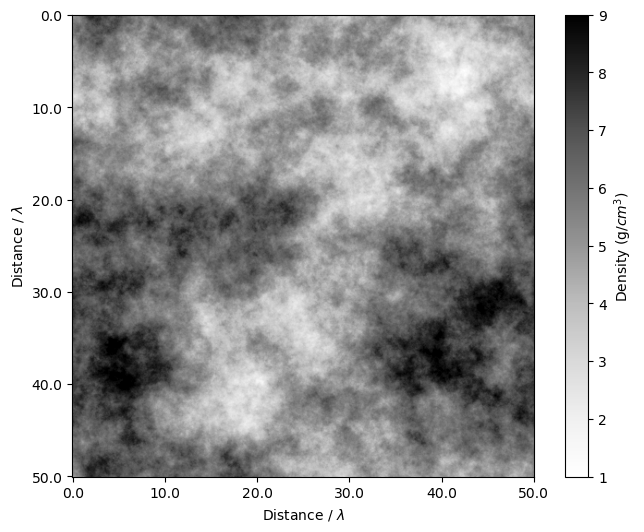

In [3]:
# Density model of random media : figure 9(a) 
Velocity  = 2                         #  Background velocity 2km/s 
frequency = 20                        #  Dominant frequency 20Hz
Lambda    = Velocity/frequency        #  Wavelength

xpos=np.arange(0,Nx);xaxis = np.arange(Nx)*dx/Lambda
ypos=np.arange(0,Nz);yaxis = np.arange(Nz)*dz/Lambda
fig_size = (8, 6);fontsz = 15
for im in range(Nmodel-1,Nmodel):
    f, ax = plt.subplots(1,1, figsize=fig_size)
    plt.imshow(Density[im].T,vmin=1,vmax=9,  cmap='Greys')
    plt.colorbar(label='Density (g/$cm^3$)')
    ax.set_xticks(xpos[0:Nx:100], labels=xaxis[0:Nx:100])
    ax.set_yticks(ypos[0:Nz:100], labels=yaxis[0:Nz:100])
    plt.xlabel('Distance / ' r'$\lambda$',);plt.ylabel('Distance / ' r'$\lambda$');
#    plt.savefig('./Pic/rho_random'+".png", bbox_inches='tight')

# Acquiation geometry for single point scatter and planar interface

In [4]:
nx=601;nz=601                                                # Full model size, boundarys (50) are included

r_min=1.99                                                   # The radius distance from source to the model center 
r_max=2.01
source_sele = np.zeros((nx,nz))
for ix in range (0, nx):
    for iz in range (0, int(nz/2)):
        r = np.sqrt( (ix*dx-3.0)**2 + (iz*dz-3.0)**2 )
        if( r>r_min and r<r_max ): 
            source_sele[ix,iz] = 1
for ix in range (Nx, 0, -1):
    for iz in range (int(Nz/2), Nz):
        r = np.sqrt( (ix*dx-3.0)**2 + (iz*dz-3.0)**2 )
        if( r>r_min and r<r_max ): 
            source_sele[ix,iz] = 1

ns = np.sum(source_sele)
print('the number of selected source is',ns)
Ns = int(ns)
coord=np.zeros((Ns,2))

#      determin the coordinates for every single source 
ir=0
for ix in range (0, nx):
    for iz in range (0, int(nz/2)):
        if(source_sele[ix,iz]==1):            
            coord[ir,0]=ix
            coord[ir,1]=iz
            ir = ir + 1
for ix in range (nx-1, -1, -1):
    for iz in range (int(nz/2), Nz):
        if(source_sele[ix,iz]==1):            
            coord[ir,0]=ix
            coord[ir,1]=iz
            ir = ir + 1            
print(ir)

the number of selected source is 2526.0
2526


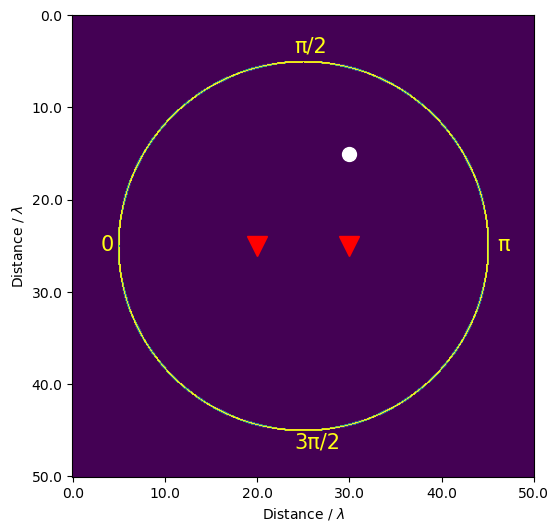

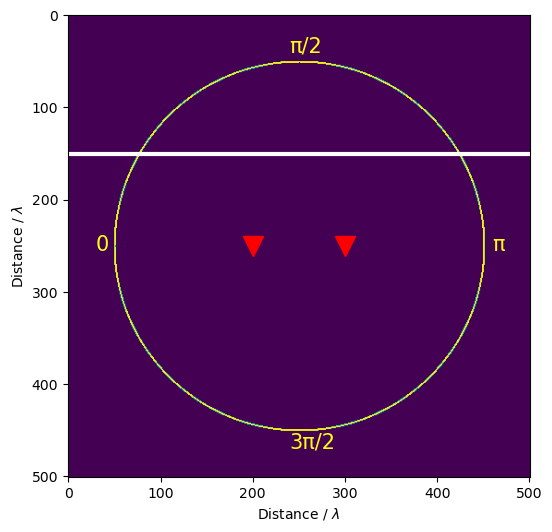

In [5]:
# Geometry for single point scatter in a homogeneous medium : Figure 5(a) 
from html.entities import entitydefs
plotsele = source_sele[50:551,50:551]
fig_size = (6, 6);fontsz = 10
xpos=np.arange(0,502);xaxis = np.arange(0,502)*0.01/(2/20)
ypos=np.arange(0,502);yaxis = np.arange(0,502)*0.01/(2/20) 

fig, ax = plt.subplots(figsize=fig_size)
plt.imshow(plotsele.T,vmin=0,vmax=1)

ax.set_xticks(xpos[0:501:100], labels=xaxis[0:501:100])
ax.set_yticks(ypos[0:501:100], labels=yaxis[0:501:100])
plt.xlabel('Distance / ' r'$\lambda$');plt.ylabel('Distance / ' r'$\lambda$');
plt.text(30,255,'0',color='#FFFF14',size=15)
plt.text(240,40,entitydefs['pi']+'/2',color='#FFFF14',size=15)
plt.text(460,255,entitydefs['pi'],color='#FFFF14',size=15)
plt.text(240,470,'3'+entitydefs['pi']+'/2',color='#FFFF14',size=15)
plt.plot(300,150,'o',color='w',markersize=10.0)
plt.plot(200,250,'v',color='r',markersize=15.0)
plt.plot(300,250,'v',color='r',markersize=15.0)

# Geometry for planar interface in a homogeneous medium : Figure 8(a)
fig, ax = plt.subplots(figsize=fig_size)
plt.imshow(plotsele.T,vmin=0,vmax=1)

plt.xlabel('Distance / ' r'$\lambda$');plt.ylabel('Distance / ' r'$\lambda$');
plt.text(30,255,'0',color='#FFFF14',size=15)
plt.text(240,40,entitydefs['pi']+'/2',color='#FFFF14',size=15)
plt.text(460,255,entitydefs['pi'],color='#FFFF14',size=15)
plt.text(240,470,'3'+entitydefs['pi']+'/2',color='#FFFF14',size=15)
plt.plot(200,250,'v',color='r',markersize=15.0)
plt.plot(300,250,'v',color='r',markersize=15.0)
x = [0, 500] 
y = [150, 150] 
plt.plot(x, y, color="white", linewidth=3)

# Input simulated data 

In [6]:
filename = ['homogeneous','singlepoint','singlelayer','random']
GreenA = np.zeros([Nmodel,Ns,Nt])
GreenB = np.zeros([Nmodel,Ns,Nt])

for im in range(0,Nmodel):  
    tmpdata = np.fromfile('./Data/Green/GreenA_'+filename[im]+'.dat', dtype=np.float32) 
    tmpdata.shape=(Ns, Nt); GreenA[im] = tmpdata
    tmpdata = np.fromfile('./Data/Green/GreenB_'+filename[im]+'.dat', dtype=np.float32) 
    tmpdata.shape=(Ns, Nt); GreenB[im] = tmpdata

# Cross-correlation functions for active sources

In [7]:
CrossAB = np.zeros((Nmodel,Ns,Nt))        # Cross-correlation functions
ASCCFAB = np.zeros((Nmodel,Nt))           # Stacked cross-correlation functions

ir=0
for ir in range (0,Ns):
    for im in range (0,Nmodel):
        CrossAB[im,ir] = np.correlate(GreenA[im,ir], GreenB[im,ir], mode='same')
for im in range (0,Nmodel):
    ASCCFAB[im] = np.sum(CrossAB[im], axis=0)

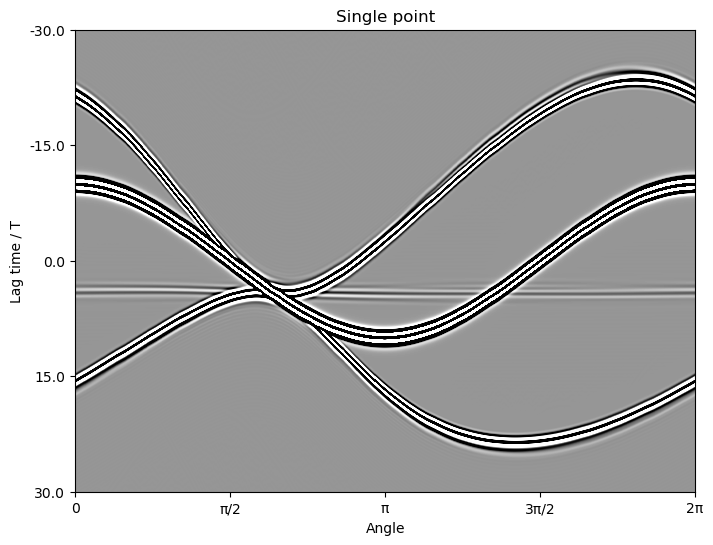

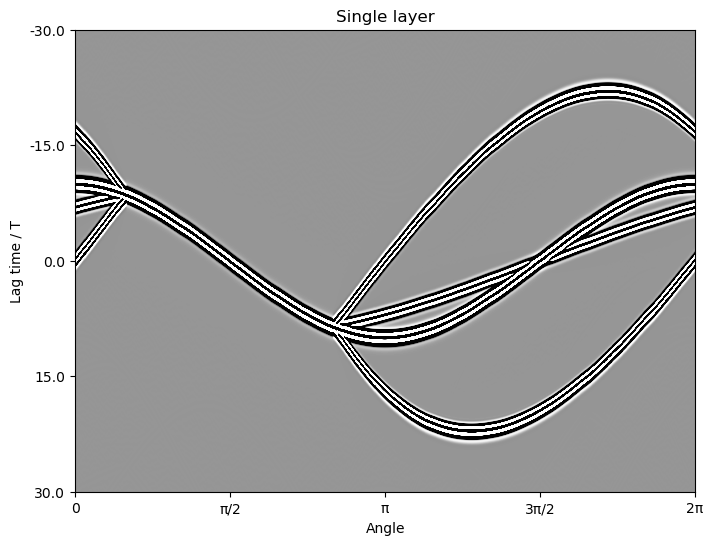

In [8]:
# Cross-correlation functions for individual impulsive sources from 0 to 2π 
# respect to single point scatter and single planar reflecto models : figure 5(b) and 8(b)
TT = ['Homogeneous medium', 'Single point','Single layer','Random medium']
fig_size = (8, 6)
fontsz = 14
xpos=np.arange(0,int(ns))
xaxis = ['0', entitydefs['pi']+'/2',entitydefs['pi'],'3'+entitydefs['pi']+'/2','2'+entitydefs['pi']]
ypos=np.arange(0,int(nt+1));yaxis = (np.arange(nt+1)*0.002-1.5)*20

for iv in (1,2):
    f, ax = plt.subplots(1,1, figsize=fig_size)
    ax.imshow(CrossAB[iv,:,750:2250].T/np.max(CrossAB[iv]),vmin=-0.01, vmax=0.01, cmap='Greys',aspect='auto')
    ax.set_xticks(xpos[0:int(ns):int(ns/4)], labels=xaxis)
    ax.set_yticks(ypos[0:int(nt/2+1):int(nt/8)], labels=yaxis[0:int(nt/2+1):int(nt/8)])
    ax.set_xlabel('Angle');ax.set_ylabel('Lag time / T')
    ax.set_title(TT[iv])

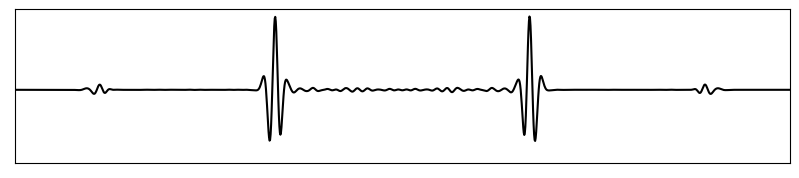

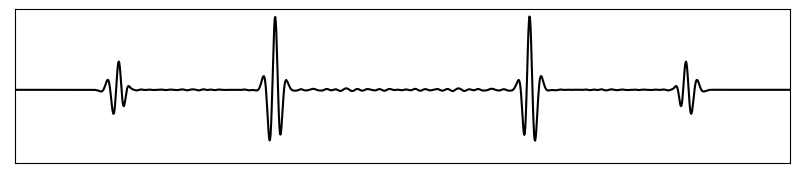

In [9]:
# Stacked cross-correlation functions for single point scatter and single planar reflecto : figure 5(c) and 8(c)
fig_size = (10, 2)
fontsz = 14
ypos=np.arange(0,int(nt)+1);yaxis = (np.arange(nt+1)*0.002-1.5)*20

for iv in  (1,2):
    f, ax = plt.subplots(1,1, figsize=fig_size)
    ax.plot((ASCCFAB[iv]/np.max(ASCCFAB[iv])),'k')
    ax.set_ylim(-1,1.1); ax.set_xlim(750,2250) 
    plt.xticks([]);plt.yticks([])

# Cross-correlation functions for passive sources

In [10]:
# Parametes used to simulate ambient noises
delta= 0.002                               # Time sampling interval (s)
hour = 2*3600                              # Recording time : 2 hour
autoc_winlen = int(hour/delta)             # Samping numbers
autoc_len    = int(6/delta)                # Time window (6 s) to calculate cross-correlation functions
nstack       = int(hour/6)                 # Stacking numbers

seis_len     = 3000

In [11]:
randomnoiseA = np.zeros((Nmodel, autoc_winlen))
randomnoiseB = np.zeros((Nmodel, autoc_winlen))

##Time consuming of random noises simulation is heavy

# for ir in range(0, int(ns)):
#     print(ir,int(ns),ir/ns)
#     ampli   = np.random.randn(autoc_winlen)

#     for im in range(0,Nmodel):
#         randomtmp   = np.convolve(ampli, GreenA[im,ir], mode='same')
#         randomnoiseA[im] = randomnoiseA[im] + randomtmp
#         randomtmp   = np.convolve(ampli, GreenB[im,ir], mode='same')
#         randomnoiseB[im] = randomnoiseB[im] + randomtmp

# np.float32(randomnoiseA).tofile('./Data/RandnoiseA'+'.dat')
# np.float32(randomnoiseB).tofile('./Data/RandnoiseB'+'.dat')  

#For efficiency you can directly read in the results with:
tmpdata = np.fromfile('./Data/RandnoiseA'+'.dat', dtype=np.float32) 
tmpdata.shape=(Nmodel, autoc_winlen); randomnoiseA = tmpdata
tmpdata = np.fromfile('./Data/RandnoiseB'+'.dat', dtype=np.float32) 
tmpdata.shape=(Nmodel, autoc_winlen); randomnoiseB = tmpdata

In [12]:
# Calculate cross-correlation functions and stack them together
nauto     = int(autoc_len) 
auto_allAB = np.zeros((Nmodel,nauto))

overlap_len    = int(0.05/delta)
nstack       = int(hour/0.05)
nshow        = 1200
nstmp        = int(nstack/nshow)
win_autocorr = np.zeros((Nmodel,nshow,nauto))

ifwhiten = 0
Nw_frac = 5
epsilon = 1e-10


for iv in range(0,Nmodel):
    ist=0
    for iit in range(0, nstack):
        
    #ntime stacks 
    # slice out the data within a short window
        endtime = autoc_winlen
        win_bgn = iit*overlap_len 
        win_end = win_bgn+autoc_len
        st_sliceA = randomnoiseA[iv, win_bgn:min(win_end,endtime)]
        st_sliceB = randomnoiseB[iv, win_bgn:min(win_end,endtime)]                 
        
        if endtime < win_end:
            break
             
    # perform FFT
        spA = np.fft.fft(st_sliceA)
        spB = np.fft.fft(st_sliceB)
                
    # spectral whitening, if required
        if ifwhiten == 1:
            ampA = np.abs(spA)
            ampB = np.abs(spB)
            Nw = int((autoc_len)/Nw_frac)
            amp_smA = np.convolve(ampA, np.ones(Nw)/Nw, mode='same')
            amp_smB = np.convolve(ampB, np.ones(Nw)/Nw, mode='same')
            spA = spA / (amp_smA + epsilon*max(amp_smA))
            spB = spB / (amp_smB + epsilon*max(amp_smB))
                
    # calculate crosscorrelation fun in freq domain
        auto_funfAB = (spA*np.conj(spB)) 
        auto_funtAB = np.fft.ifft(auto_funfAB)
        tempAB = auto_funtAB.real[0: nauto]
        tempAB = tempAB / max(tempAB)
        auto_allAB[iv] = auto_allAB[iv] +tempAB
        win_autocorr[iv,ist] = win_autocorr[iv,ist]+tempAB
        if ((iit+1)%nstmp == 0): 
            ist = ist+1
            if (ist>=nshow): ist=nshow-1
            print(iv, ist, iit,nstmp, nshow, nstack)
        
    auto_allAB[iv] = auto_allAB[iv]/(iit+1)
print(nstack)

0 1 119 120 1200 144000
0 2 239 120 1200 144000
0 3 359 120 1200 144000
0 4 479 120 1200 144000
0 5 599 120 1200 144000
0 6 719 120 1200 144000
0 7 839 120 1200 144000
0 8 959 120 1200 144000
0 9 1079 120 1200 144000
0 10 1199 120 1200 144000
0 11 1319 120 1200 144000
0 12 1439 120 1200 144000
0 13 1559 120 1200 144000
0 14 1679 120 1200 144000
0 15 1799 120 1200 144000
0 16 1919 120 1200 144000
0 17 2039 120 1200 144000
0 18 2159 120 1200 144000
0 19 2279 120 1200 144000
0 20 2399 120 1200 144000
0 21 2519 120 1200 144000
0 22 2639 120 1200 144000
0 23 2759 120 1200 144000
0 24 2879 120 1200 144000
0 25 2999 120 1200 144000
0 26 3119 120 1200 144000
0 27 3239 120 1200 144000
0 28 3359 120 1200 144000
0 29 3479 120 1200 144000
0 30 3599 120 1200 144000
0 31 3719 120 1200 144000
0 32 3839 120 1200 144000
0 33 3959 120 1200 144000
0 34 4079 120 1200 144000
0 35 4199 120 1200 144000
0 36 4319 120 1200 144000
0 37 4439 120 1200 144000
0 38 4559 120 1200 144000
0 39 4679 120 1200 144000
0 4

0 309 37079 120 1200 144000
0 310 37199 120 1200 144000
0 311 37319 120 1200 144000
0 312 37439 120 1200 144000
0 313 37559 120 1200 144000
0 314 37679 120 1200 144000
0 315 37799 120 1200 144000
0 316 37919 120 1200 144000
0 317 38039 120 1200 144000
0 318 38159 120 1200 144000
0 319 38279 120 1200 144000
0 320 38399 120 1200 144000
0 321 38519 120 1200 144000
0 322 38639 120 1200 144000
0 323 38759 120 1200 144000
0 324 38879 120 1200 144000
0 325 38999 120 1200 144000
0 326 39119 120 1200 144000
0 327 39239 120 1200 144000
0 328 39359 120 1200 144000
0 329 39479 120 1200 144000
0 330 39599 120 1200 144000
0 331 39719 120 1200 144000
0 332 39839 120 1200 144000
0 333 39959 120 1200 144000
0 334 40079 120 1200 144000
0 335 40199 120 1200 144000
0 336 40319 120 1200 144000
0 337 40439 120 1200 144000
0 338 40559 120 1200 144000
0 339 40679 120 1200 144000
0 340 40799 120 1200 144000
0 341 40919 120 1200 144000
0 342 41039 120 1200 144000
0 343 41159 120 1200 144000
0 344 41279 120 1200

0 604 72479 120 1200 144000
0 605 72599 120 1200 144000
0 606 72719 120 1200 144000
0 607 72839 120 1200 144000
0 608 72959 120 1200 144000
0 609 73079 120 1200 144000
0 610 73199 120 1200 144000
0 611 73319 120 1200 144000
0 612 73439 120 1200 144000
0 613 73559 120 1200 144000
0 614 73679 120 1200 144000
0 615 73799 120 1200 144000
0 616 73919 120 1200 144000
0 617 74039 120 1200 144000
0 618 74159 120 1200 144000
0 619 74279 120 1200 144000
0 620 74399 120 1200 144000
0 621 74519 120 1200 144000
0 622 74639 120 1200 144000
0 623 74759 120 1200 144000
0 624 74879 120 1200 144000
0 625 74999 120 1200 144000
0 626 75119 120 1200 144000
0 627 75239 120 1200 144000
0 628 75359 120 1200 144000
0 629 75479 120 1200 144000
0 630 75599 120 1200 144000
0 631 75719 120 1200 144000
0 632 75839 120 1200 144000
0 633 75959 120 1200 144000
0 634 76079 120 1200 144000
0 635 76199 120 1200 144000
0 636 76319 120 1200 144000
0 637 76439 120 1200 144000
0 638 76559 120 1200 144000
0 639 76679 120 1200

0 898 107759 120 1200 144000
0 899 107879 120 1200 144000
0 900 107999 120 1200 144000
0 901 108119 120 1200 144000
0 902 108239 120 1200 144000
0 903 108359 120 1200 144000
0 904 108479 120 1200 144000
0 905 108599 120 1200 144000
0 906 108719 120 1200 144000
0 907 108839 120 1200 144000
0 908 108959 120 1200 144000
0 909 109079 120 1200 144000
0 910 109199 120 1200 144000
0 911 109319 120 1200 144000
0 912 109439 120 1200 144000
0 913 109559 120 1200 144000
0 914 109679 120 1200 144000
0 915 109799 120 1200 144000
0 916 109919 120 1200 144000
0 917 110039 120 1200 144000
0 918 110159 120 1200 144000
0 919 110279 120 1200 144000
0 920 110399 120 1200 144000
0 921 110519 120 1200 144000
0 922 110639 120 1200 144000
0 923 110759 120 1200 144000
0 924 110879 120 1200 144000
0 925 110999 120 1200 144000
0 926 111119 120 1200 144000
0 927 111239 120 1200 144000
0 928 111359 120 1200 144000
0 929 111479 120 1200 144000
0 930 111599 120 1200 144000
0 931 111719 120 1200 144000
0 932 111839 1

0 1178 141359 120 1200 144000
0 1179 141479 120 1200 144000
0 1180 141599 120 1200 144000
0 1181 141719 120 1200 144000
0 1182 141839 120 1200 144000
0 1183 141959 120 1200 144000
0 1184 142079 120 1200 144000
0 1185 142199 120 1200 144000
0 1186 142319 120 1200 144000
0 1187 142439 120 1200 144000
0 1188 142559 120 1200 144000
0 1189 142679 120 1200 144000
0 1190 142799 120 1200 144000
0 1191 142919 120 1200 144000
0 1192 143039 120 1200 144000
0 1193 143159 120 1200 144000
0 1194 143279 120 1200 144000
0 1195 143399 120 1200 144000
0 1196 143519 120 1200 144000
0 1197 143639 120 1200 144000
0 1198 143759 120 1200 144000
0 1199 143879 120 1200 144000
1 1 119 120 1200 144000
1 2 239 120 1200 144000
1 3 359 120 1200 144000
1 4 479 120 1200 144000
1 5 599 120 1200 144000
1 6 719 120 1200 144000
1 7 839 120 1200 144000
1 8 959 120 1200 144000
1 9 1079 120 1200 144000
1 10 1199 120 1200 144000
1 11 1319 120 1200 144000
1 12 1439 120 1200 144000
1 13 1559 120 1200 144000
1 14 1679 120 1200 

1 278 33359 120 1200 144000
1 279 33479 120 1200 144000
1 280 33599 120 1200 144000
1 281 33719 120 1200 144000
1 282 33839 120 1200 144000
1 283 33959 120 1200 144000
1 284 34079 120 1200 144000
1 285 34199 120 1200 144000
1 286 34319 120 1200 144000
1 287 34439 120 1200 144000
1 288 34559 120 1200 144000
1 289 34679 120 1200 144000
1 290 34799 120 1200 144000
1 291 34919 120 1200 144000
1 292 35039 120 1200 144000
1 293 35159 120 1200 144000
1 294 35279 120 1200 144000
1 295 35399 120 1200 144000
1 296 35519 120 1200 144000
1 297 35639 120 1200 144000
1 298 35759 120 1200 144000
1 299 35879 120 1200 144000
1 300 35999 120 1200 144000
1 301 36119 120 1200 144000
1 302 36239 120 1200 144000
1 303 36359 120 1200 144000
1 304 36479 120 1200 144000
1 305 36599 120 1200 144000
1 306 36719 120 1200 144000
1 307 36839 120 1200 144000
1 308 36959 120 1200 144000
1 309 37079 120 1200 144000
1 310 37199 120 1200 144000
1 311 37319 120 1200 144000
1 312 37439 120 1200 144000
1 313 37559 120 1200

1 576 69119 120 1200 144000
1 577 69239 120 1200 144000
1 578 69359 120 1200 144000
1 579 69479 120 1200 144000
1 580 69599 120 1200 144000
1 581 69719 120 1200 144000
1 582 69839 120 1200 144000
1 583 69959 120 1200 144000
1 584 70079 120 1200 144000
1 585 70199 120 1200 144000
1 586 70319 120 1200 144000
1 587 70439 120 1200 144000
1 588 70559 120 1200 144000
1 589 70679 120 1200 144000
1 590 70799 120 1200 144000
1 591 70919 120 1200 144000
1 592 71039 120 1200 144000
1 593 71159 120 1200 144000
1 594 71279 120 1200 144000
1 595 71399 120 1200 144000
1 596 71519 120 1200 144000
1 597 71639 120 1200 144000
1 598 71759 120 1200 144000
1 599 71879 120 1200 144000
1 600 71999 120 1200 144000
1 601 72119 120 1200 144000
1 602 72239 120 1200 144000
1 603 72359 120 1200 144000
1 604 72479 120 1200 144000
1 605 72599 120 1200 144000
1 606 72719 120 1200 144000
1 607 72839 120 1200 144000
1 608 72959 120 1200 144000
1 609 73079 120 1200 144000
1 610 73199 120 1200 144000
1 611 73319 120 1200

1 877 105239 120 1200 144000
1 878 105359 120 1200 144000
1 879 105479 120 1200 144000
1 880 105599 120 1200 144000
1 881 105719 120 1200 144000
1 882 105839 120 1200 144000
1 883 105959 120 1200 144000
1 884 106079 120 1200 144000
1 885 106199 120 1200 144000
1 886 106319 120 1200 144000
1 887 106439 120 1200 144000
1 888 106559 120 1200 144000
1 889 106679 120 1200 144000
1 890 106799 120 1200 144000
1 891 106919 120 1200 144000
1 892 107039 120 1200 144000
1 893 107159 120 1200 144000
1 894 107279 120 1200 144000
1 895 107399 120 1200 144000
1 896 107519 120 1200 144000
1 897 107639 120 1200 144000
1 898 107759 120 1200 144000
1 899 107879 120 1200 144000
1 900 107999 120 1200 144000
1 901 108119 120 1200 144000
1 902 108239 120 1200 144000
1 903 108359 120 1200 144000
1 904 108479 120 1200 144000
1 905 108599 120 1200 144000
1 906 108719 120 1200 144000
1 907 108839 120 1200 144000
1 908 108959 120 1200 144000
1 909 109079 120 1200 144000
1 910 109199 120 1200 144000
1 911 109319 1

1 1157 138839 120 1200 144000
1 1158 138959 120 1200 144000
1 1159 139079 120 1200 144000
1 1160 139199 120 1200 144000
1 1161 139319 120 1200 144000
1 1162 139439 120 1200 144000
1 1163 139559 120 1200 144000
1 1164 139679 120 1200 144000
1 1165 139799 120 1200 144000
1 1166 139919 120 1200 144000
1 1167 140039 120 1200 144000
1 1168 140159 120 1200 144000
1 1169 140279 120 1200 144000
1 1170 140399 120 1200 144000
1 1171 140519 120 1200 144000
1 1172 140639 120 1200 144000
1 1173 140759 120 1200 144000
1 1174 140879 120 1200 144000
1 1175 140999 120 1200 144000
1 1176 141119 120 1200 144000
1 1177 141239 120 1200 144000
1 1178 141359 120 1200 144000
1 1179 141479 120 1200 144000
1 1180 141599 120 1200 144000
1 1181 141719 120 1200 144000
1 1182 141839 120 1200 144000
1 1183 141959 120 1200 144000
1 1184 142079 120 1200 144000
1 1185 142199 120 1200 144000
1 1186 142319 120 1200 144000
1 1187 142439 120 1200 144000
1 1188 142559 120 1200 144000
1 1189 142679 120 1200 144000
1 1190 142

2 261 31319 120 1200 144000
2 262 31439 120 1200 144000
2 263 31559 120 1200 144000
2 264 31679 120 1200 144000
2 265 31799 120 1200 144000
2 266 31919 120 1200 144000
2 267 32039 120 1200 144000
2 268 32159 120 1200 144000
2 269 32279 120 1200 144000
2 270 32399 120 1200 144000
2 271 32519 120 1200 144000
2 272 32639 120 1200 144000
2 273 32759 120 1200 144000
2 274 32879 120 1200 144000
2 275 32999 120 1200 144000
2 276 33119 120 1200 144000
2 277 33239 120 1200 144000
2 278 33359 120 1200 144000
2 279 33479 120 1200 144000
2 280 33599 120 1200 144000
2 281 33719 120 1200 144000
2 282 33839 120 1200 144000
2 283 33959 120 1200 144000
2 284 34079 120 1200 144000
2 285 34199 120 1200 144000
2 286 34319 120 1200 144000
2 287 34439 120 1200 144000
2 288 34559 120 1200 144000
2 289 34679 120 1200 144000
2 290 34799 120 1200 144000
2 291 34919 120 1200 144000
2 292 35039 120 1200 144000
2 293 35159 120 1200 144000
2 294 35279 120 1200 144000
2 295 35399 120 1200 144000
2 296 35519 120 1200

2 556 66719 120 1200 144000
2 557 66839 120 1200 144000
2 558 66959 120 1200 144000
2 559 67079 120 1200 144000
2 560 67199 120 1200 144000
2 561 67319 120 1200 144000
2 562 67439 120 1200 144000
2 563 67559 120 1200 144000
2 564 67679 120 1200 144000
2 565 67799 120 1200 144000
2 566 67919 120 1200 144000
2 567 68039 120 1200 144000
2 568 68159 120 1200 144000
2 569 68279 120 1200 144000
2 570 68399 120 1200 144000
2 571 68519 120 1200 144000
2 572 68639 120 1200 144000
2 573 68759 120 1200 144000
2 574 68879 120 1200 144000
2 575 68999 120 1200 144000
2 576 69119 120 1200 144000
2 577 69239 120 1200 144000
2 578 69359 120 1200 144000
2 579 69479 120 1200 144000
2 580 69599 120 1200 144000
2 581 69719 120 1200 144000
2 582 69839 120 1200 144000
2 583 69959 120 1200 144000
2 584 70079 120 1200 144000
2 585 70199 120 1200 144000
2 586 70319 120 1200 144000
2 587 70439 120 1200 144000
2 588 70559 120 1200 144000
2 589 70679 120 1200 144000
2 590 70799 120 1200 144000
2 591 70919 120 1200

2 857 102839 120 1200 144000
2 858 102959 120 1200 144000
2 859 103079 120 1200 144000
2 860 103199 120 1200 144000
2 861 103319 120 1200 144000
2 862 103439 120 1200 144000
2 863 103559 120 1200 144000
2 864 103679 120 1200 144000
2 865 103799 120 1200 144000
2 866 103919 120 1200 144000
2 867 104039 120 1200 144000
2 868 104159 120 1200 144000
2 869 104279 120 1200 144000
2 870 104399 120 1200 144000
2 871 104519 120 1200 144000
2 872 104639 120 1200 144000
2 873 104759 120 1200 144000
2 874 104879 120 1200 144000
2 875 104999 120 1200 144000
2 876 105119 120 1200 144000
2 877 105239 120 1200 144000
2 878 105359 120 1200 144000
2 879 105479 120 1200 144000
2 880 105599 120 1200 144000
2 881 105719 120 1200 144000
2 882 105839 120 1200 144000
2 883 105959 120 1200 144000
2 884 106079 120 1200 144000
2 885 106199 120 1200 144000
2 886 106319 120 1200 144000
2 887 106439 120 1200 144000
2 888 106559 120 1200 144000
2 889 106679 120 1200 144000
2 890 106799 120 1200 144000
2 891 106919 1

2 1143 137159 120 1200 144000
2 1144 137279 120 1200 144000
2 1145 137399 120 1200 144000
2 1146 137519 120 1200 144000
2 1147 137639 120 1200 144000
2 1148 137759 120 1200 144000
2 1149 137879 120 1200 144000
2 1150 137999 120 1200 144000
2 1151 138119 120 1200 144000
2 1152 138239 120 1200 144000
2 1153 138359 120 1200 144000
2 1154 138479 120 1200 144000
2 1155 138599 120 1200 144000
2 1156 138719 120 1200 144000
2 1157 138839 120 1200 144000
2 1158 138959 120 1200 144000
2 1159 139079 120 1200 144000
2 1160 139199 120 1200 144000
2 1161 139319 120 1200 144000
2 1162 139439 120 1200 144000
2 1163 139559 120 1200 144000
2 1164 139679 120 1200 144000
2 1165 139799 120 1200 144000
2 1166 139919 120 1200 144000
2 1167 140039 120 1200 144000
2 1168 140159 120 1200 144000
2 1169 140279 120 1200 144000
2 1170 140399 120 1200 144000
2 1171 140519 120 1200 144000
2 1172 140639 120 1200 144000
2 1173 140759 120 1200 144000
2 1174 140879 120 1200 144000
2 1175 140999 120 1200 144000
2 1176 141

3 246 29519 120 1200 144000
3 247 29639 120 1200 144000
3 248 29759 120 1200 144000
3 249 29879 120 1200 144000
3 250 29999 120 1200 144000
3 251 30119 120 1200 144000
3 252 30239 120 1200 144000
3 253 30359 120 1200 144000
3 254 30479 120 1200 144000
3 255 30599 120 1200 144000
3 256 30719 120 1200 144000
3 257 30839 120 1200 144000
3 258 30959 120 1200 144000
3 259 31079 120 1200 144000
3 260 31199 120 1200 144000
3 261 31319 120 1200 144000
3 262 31439 120 1200 144000
3 263 31559 120 1200 144000
3 264 31679 120 1200 144000
3 265 31799 120 1200 144000
3 266 31919 120 1200 144000
3 267 32039 120 1200 144000
3 268 32159 120 1200 144000
3 269 32279 120 1200 144000
3 270 32399 120 1200 144000
3 271 32519 120 1200 144000
3 272 32639 120 1200 144000
3 273 32759 120 1200 144000
3 274 32879 120 1200 144000
3 275 32999 120 1200 144000
3 276 33119 120 1200 144000
3 277 33239 120 1200 144000
3 278 33359 120 1200 144000
3 279 33479 120 1200 144000
3 280 33599 120 1200 144000
3 281 33719 120 1200

3 542 65039 120 1200 144000
3 543 65159 120 1200 144000
3 544 65279 120 1200 144000
3 545 65399 120 1200 144000
3 546 65519 120 1200 144000
3 547 65639 120 1200 144000
3 548 65759 120 1200 144000
3 549 65879 120 1200 144000
3 550 65999 120 1200 144000
3 551 66119 120 1200 144000
3 552 66239 120 1200 144000
3 553 66359 120 1200 144000
3 554 66479 120 1200 144000
3 555 66599 120 1200 144000
3 556 66719 120 1200 144000
3 557 66839 120 1200 144000
3 558 66959 120 1200 144000
3 559 67079 120 1200 144000
3 560 67199 120 1200 144000
3 561 67319 120 1200 144000
3 562 67439 120 1200 144000
3 563 67559 120 1200 144000
3 564 67679 120 1200 144000
3 565 67799 120 1200 144000
3 566 67919 120 1200 144000
3 567 68039 120 1200 144000
3 568 68159 120 1200 144000
3 569 68279 120 1200 144000
3 570 68399 120 1200 144000
3 571 68519 120 1200 144000
3 572 68639 120 1200 144000
3 573 68759 120 1200 144000
3 574 68879 120 1200 144000
3 575 68999 120 1200 144000
3 576 69119 120 1200 144000
3 577 69239 120 1200

3 844 101279 120 1200 144000
3 845 101399 120 1200 144000
3 846 101519 120 1200 144000
3 847 101639 120 1200 144000
3 848 101759 120 1200 144000
3 849 101879 120 1200 144000
3 850 101999 120 1200 144000
3 851 102119 120 1200 144000
3 852 102239 120 1200 144000
3 853 102359 120 1200 144000
3 854 102479 120 1200 144000
3 855 102599 120 1200 144000
3 856 102719 120 1200 144000
3 857 102839 120 1200 144000
3 858 102959 120 1200 144000
3 859 103079 120 1200 144000
3 860 103199 120 1200 144000
3 861 103319 120 1200 144000
3 862 103439 120 1200 144000
3 863 103559 120 1200 144000
3 864 103679 120 1200 144000
3 865 103799 120 1200 144000
3 866 103919 120 1200 144000
3 867 104039 120 1200 144000
3 868 104159 120 1200 144000
3 869 104279 120 1200 144000
3 870 104399 120 1200 144000
3 871 104519 120 1200 144000
3 872 104639 120 1200 144000
3 873 104759 120 1200 144000
3 874 104879 120 1200 144000
3 875 104999 120 1200 144000
3 876 105119 120 1200 144000
3 877 105239 120 1200 144000
3 878 105359 1

3 1128 135359 120 1200 144000
3 1129 135479 120 1200 144000
3 1130 135599 120 1200 144000
3 1131 135719 120 1200 144000
3 1132 135839 120 1200 144000
3 1133 135959 120 1200 144000
3 1134 136079 120 1200 144000
3 1135 136199 120 1200 144000
3 1136 136319 120 1200 144000
3 1137 136439 120 1200 144000
3 1138 136559 120 1200 144000
3 1139 136679 120 1200 144000
3 1140 136799 120 1200 144000
3 1141 136919 120 1200 144000
3 1142 137039 120 1200 144000
3 1143 137159 120 1200 144000
3 1144 137279 120 1200 144000
3 1145 137399 120 1200 144000
3 1146 137519 120 1200 144000
3 1147 137639 120 1200 144000
3 1148 137759 120 1200 144000
3 1149 137879 120 1200 144000
3 1150 137999 120 1200 144000
3 1151 138119 120 1200 144000
3 1152 138239 120 1200 144000
3 1153 138359 120 1200 144000
3 1154 138479 120 1200 144000
3 1155 138599 120 1200 144000
3 1156 138719 120 1200 144000
3 1157 138839 120 1200 144000
3 1158 138959 120 1200 144000
3 1159 139079 120 1200 144000
3 1160 139199 120 1200 144000
3 1161 139

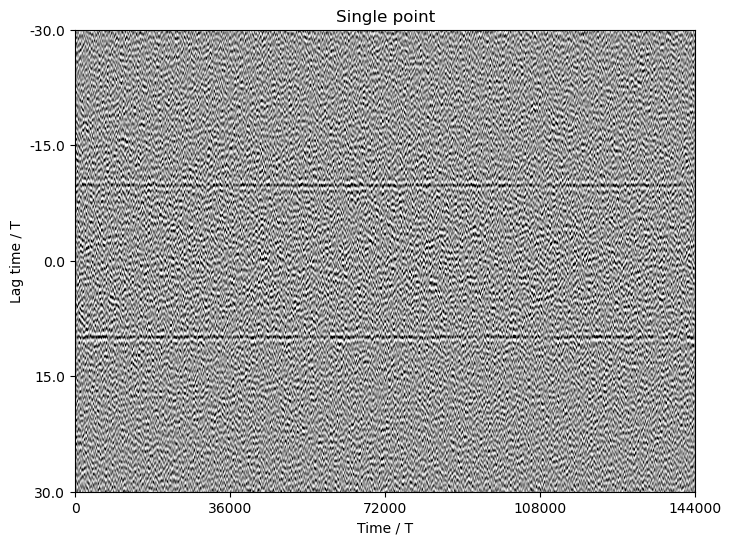

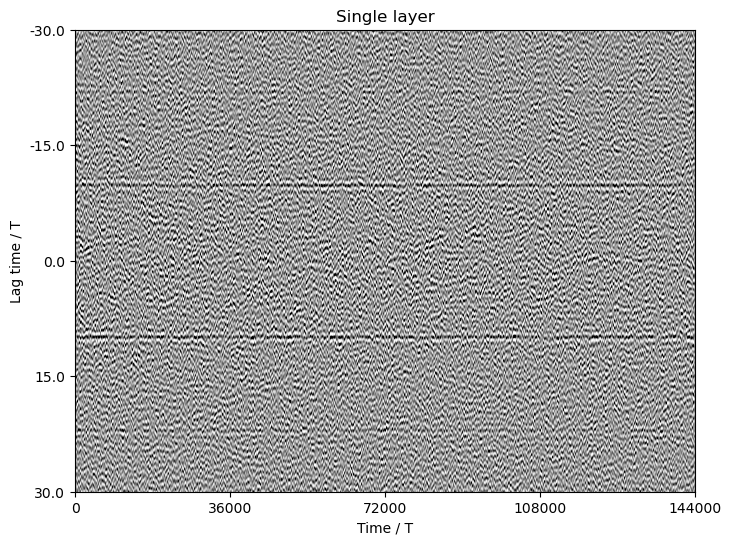

In [13]:
# Cross-correlation functions for random, uncorrelated, and continuous sources 
# recorded at different times respect to single point scatter and single planar reflecto :
# figure 5(d) and 8(d)

fig_size = (8, 6)
fontsz = 14
xpos=np.arange(0,int(nshow+1))
xaxis = ['0', '36000','72000','108000','144000'] #*3600*20
ypos=np.arange(0,int(nt+1));yaxis = (np.arange(nt+1)*0.002-1.5)*20
plottmp = np.zeros((nshow,nt))
plottmp2 = np.zeros((nshow,nt))
for iv in (1,2):
    f, ax = plt.subplots(1,1, figsize=fig_size)

    plottmp[:,0:int(nt/2)] = win_autocorr[iv,:,int(nt/2):nt]
    plottmp[:,int(nt/2):nt] = win_autocorr[iv,:,0:int(nt/2)]
    for it in range(0,nt):    
        plottmp2[:,it]=plottmp[:,nt-it-1]
    ax.imshow(plottmp[:,750:2250].T/np.max(plottmp),vmin=-0.4, vmax=0.4, cmap='Greys',aspect='auto')

    ax.set_xticks(xpos[0:int(nshow+1):int(nshow/4)], labels=xaxis)
    ax.set_yticks(ypos[0:int(nt/2+1):int(nt/8)], labels=yaxis[0:int(nt/2+1):int(nt/8)])
    ax.set_xlabel('Time / T');ax.set_ylabel('Lag time / T')
    ax.set_title(TT[iv])

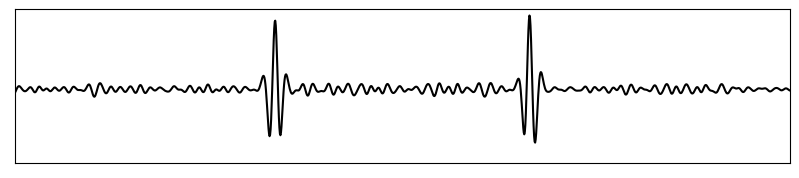

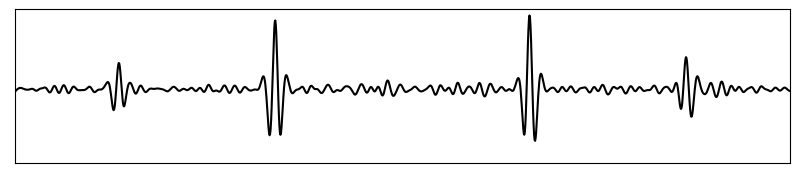

In [14]:
# The stacked cross-correlation function for single point scatter and single planar reflecto : figure 5(e) and 8(e)
Gplottmp = np.zeros([Nmodel, nt])

for iv in range(0, Nmodel):
 
    Gplottmp[iv,0:int(nt/2)] = auto_allAB[iv,int(nt/2):nt]/np.max(auto_allAB[iv])
    Gplottmp[iv,int(nt/2):nt] = auto_allAB[iv,0:int(nt/2)]/np.max(auto_allAB[iv])

fig_size = (10, 2)
fontsz = 14
ypos=np.arange(0,int(nt)+1);yaxis = (np.arange(nt+1)*0.002-1.5)*20

for iv in (1,2):
    f, ax = plt.subplots(1,1, figsize=fig_size)

    ax.plot(Gplottmp[iv,750:2250],'k') #'#F97306')

    ax.set_xticks(ypos[0:int(nt/2+1):int(nt/8)], labels=yaxis[0:int(nt/2+1):int(nt/8)])
    ax.set_yticks([1,-1], )

    ax.set_xlim(0,1500)

    plt.xticks([]);plt.yticks([])

# Comparison between the actual Green’s function and the normalized XCFs after different stacks

In [15]:
nauto     = int(autoc_len/2)
auto_staAB = np.zeros((4,nauto))
overlap_time = [0.05, 0.2, 0.8, 3.2]

overlap_len    = int(0.05/delta) 
nstack       = int(hour/0.05)


ifwhiten = 0
Nw_frac = 5
epsilon = 1e-10


for iv in range(0,4):
    ist=0
    for iit in range(0, nstack):
        
    #ntime stacks 
    # slice out the data within a short window
        endtime = autoc_winlen
        win_bgn = iit*overlap_len 
        win_end = win_bgn+autoc_len
        st_sliceA = randomnoiseA[3, win_bgn:min(win_end,endtime)]
        st_sliceB = randomnoiseB[3, win_bgn:min(win_end,endtime)]                 
        
        if endtime < win_end:
            break
             
    # perform FFT
        spA = np.fft.fft(st_sliceA)
        spB = np.fft.fft(st_sliceB)
                
    # spectral whitening, if required
        if ifwhiten == 1:
            ampA = np.abs(spA)
            ampB = np.abs(spB)
            Nw = int((autoc_len)/Nw_frac)
            amp_smA = np.convolve(ampA, np.ones(Nw)/Nw, mode='same')
            amp_smB = np.convolve(ampB, np.ones(Nw)/Nw, mode='same')
            spA = spA / (amp_smA + epsilon*max(amp_smA))
            spB = spB / (amp_smB + epsilon*max(amp_smB))
                
    # calculate autocorrelation fun in freq domain
        auto_funfAB = (spA*np.conj(spB)) 
        auto_funtAB = np.fft.ifft(auto_funfAB)
        tempAB = auto_funtAB.real[0: nauto]
        tempAB = tempAB / max(tempAB)
        auto_staAB[iv] = auto_staAB[iv] +tempAB

        
    auto_staAB[iv] = auto_staAB[iv]/(iit+1)
    print(nstack)
    nstack = int(nstack/4)
    

144000
36000
9000
2250


In [16]:
sArB = np.fromfile('./Data/sArB.dat', dtype=np.float32); sArB.shape=(Nmodel, nt) # Input Green's function

Text(0.5, 1.0, 'XCFs for random media')

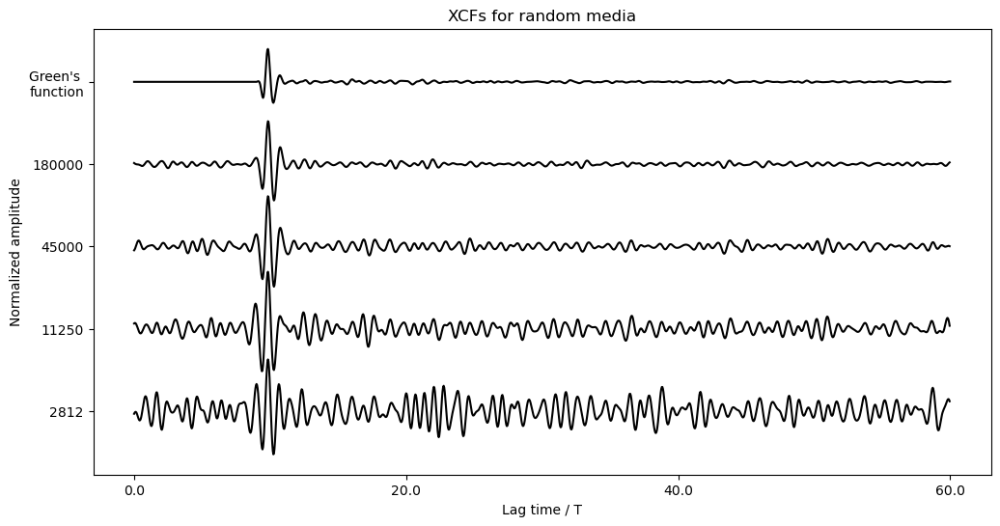

In [17]:
# Comparison between the actual Green’s function and the normalized XCFs after different stacks : figure 9(b)
fig_size = (12, 6)
fontsz = 14
ypos=np.arange(0,int(nt/2+1));yaxis = np.arange(nt/2+1)*0.002*20

f, ax = plt.subplots(1,1, figsize=fig_size)
wavelet_delay=30
ax.plot(sArB[3,wavelet_delay:int(nt/2+1)+wavelet_delay]/max(sArB[3,wavelet_delay:int(nt/2+1)+wavelet_delay]),'k')
for iv in range(0,4):
    ax.plot(auto_staAB[iv]*5-(iv+1)*2.5,'k')

ax.set_xticks(ypos[0:int(nt/2+1):int(nt/6)], labels=yaxis[0:int(nt/2+1):int(nt/6)])
ax.set_yticks([0,-2.5,-5,-7.5,-10], labels=['Green\'s \nfunction','180000','45000','11250','2812'])
ax.set_ylabel('Normalized amplitude');ax.set_xlabel('Lag time / T')
ax.set_title('XCFs for random media')

# On the ambiguities between the source and medium effects

## Actual Green’s function and the stacked cross-correlation function (XCF) in different media

0 0
0 1
3 0
3 1


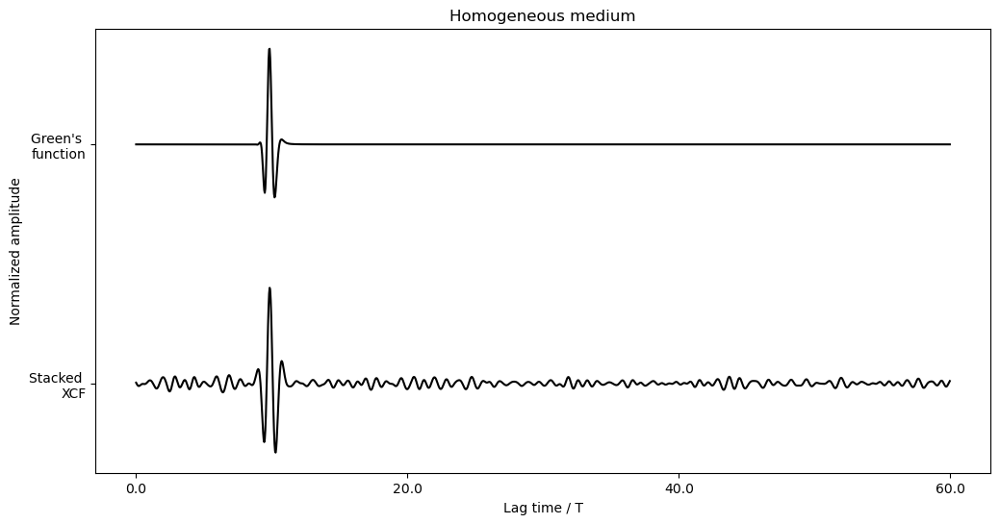

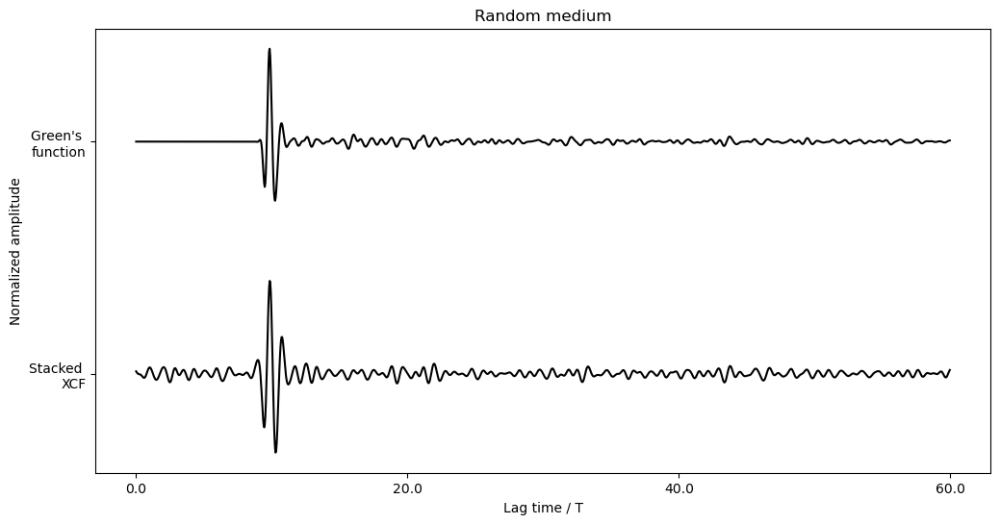

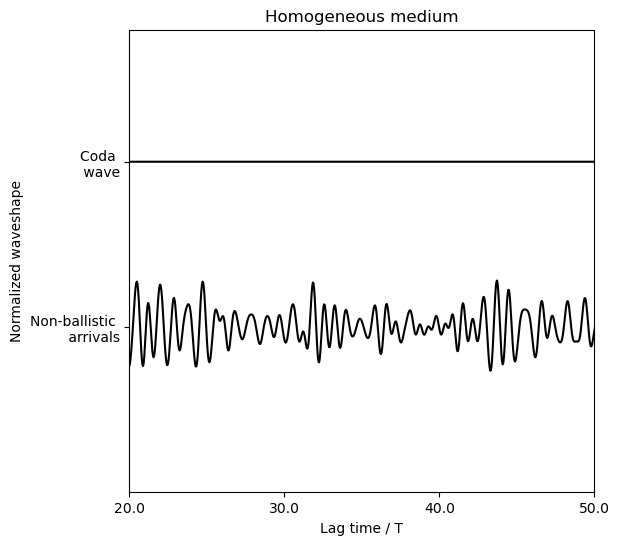

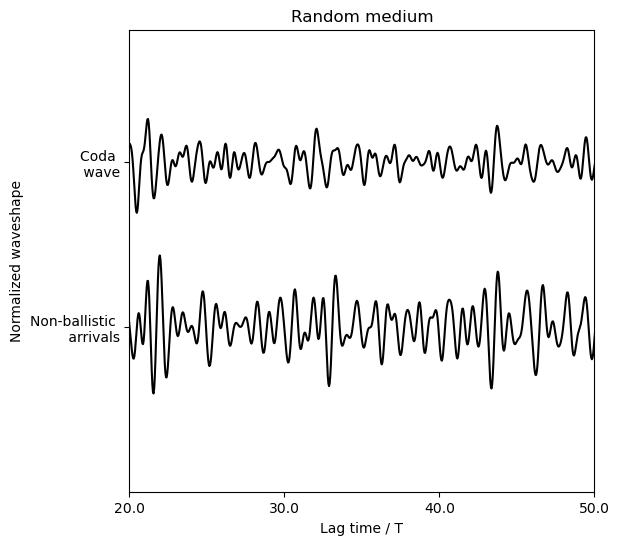

In [18]:
# For figure 10
Gplot = np.zeros([Nmodel, 2, int(nt/2)])
for iv in range(0, Nmodel):
    Gplot[iv,0,:] = sArB[iv,30:1530]/np.max(sArB[iv,30:1530])              # 30 : time delay for source wavelet
    Gplot[iv,1,:] = auto_allAB[iv,0:1500]/np.max(auto_allAB[iv,0:1500]) 

fig_size = (12, 6)
fontsz = 14
ypos=np.arange(0,int(nt/2+1));yaxis = (np.arange(nt/2+1)*0.002)*20

for iv in (0,3):
    f, ax = plt.subplots(1,1, figsize=fig_size)
    for ip in (0,1):
        ax.plot(Gplot[iv,ip]-ip*2.5,'k')

    ax.set_xticks(ypos[0:int(nt/2+1):int(nt/6)], labels=yaxis[0:int(nt/2+1):int(nt/6)])
    ax.set_yticks([0,-2.5], labels=['Green\'s \nfunction','Stacked \nXCF'])
    ax.set_ylabel('Normalized amplitude');ax.set_xlabel('Lag time / T')
    ax.set_title(TT[iv])

fig_size = (6, 6)
fontsz = 14
ypos=np.arange(0,int(nt/2+1));yaxis = (np.arange(nt/2+1)*0.002)*20

for iv in (0,3):
    f, ax = plt.subplots(1,1, figsize=fig_size)
    for ip in (0, 1):
        print(iv,ip)
        ax.plot(Gplot[iv,ip]*10-ip*2.5,'k')

    ax.set_xticks(ypos[0:int(nt/2+1):int(nt/12)], labels=yaxis[0:int(nt/2+1):int(nt/12)])
    ax.set_yticks([0,-2.5], labels=['Coda \n wave','Non-ballistic \n arrivals'])
    ax.set_ylabel('Normalized waveshape');ax.set_xlabel('Lag time / T')
    ax.set_xlim([500,1250]);ax.set_ylim([-5,2])
    ax.set_title(TT[iv])

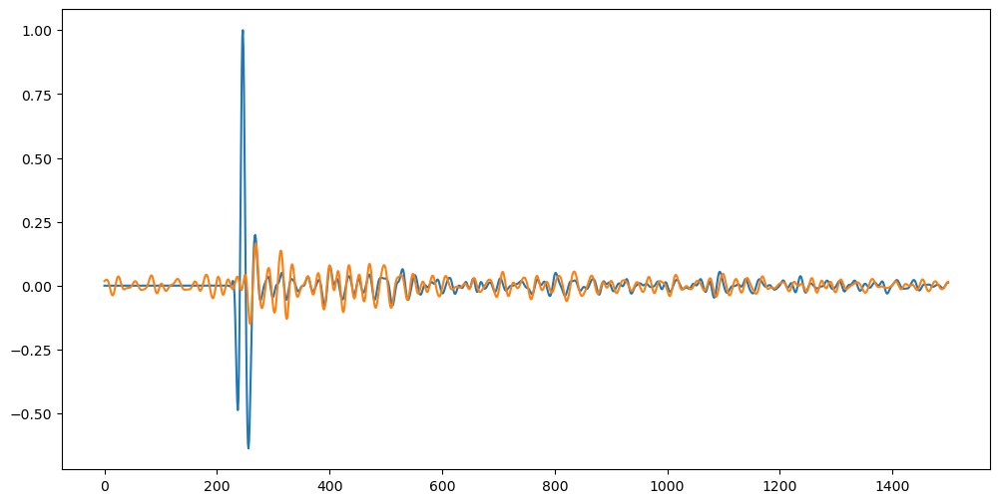

In [31]:
# For figure 10
Gplot = np.zeros([Nmodel+1, 2, int(nt/2)])
for iv in range(0, Nmodel):
    Gplot[iv,0,:] = sArB[iv,30:1530]/np.max(sArB[iv,30:1530])              # 30 : time delay for source wavelet
    Gplot[iv,1,:] = auto_allAB[iv,0:1500]/np.max(auto_allAB[iv,0:1500]) 

fig_size = (12, 6)
fontsz = 14
ypos=np.arange(0,int(nt/2+1));yaxis = (np.arange(nt/2+1)*0.002)*20

# # for iv in (0,3):
f, ax = plt.subplots(1,1, figsize=fig_size)
# #     for ip in (0,1):
# # #        ax.plot(Gplot[iv,ip]-ip*2.5,'k')
# ax.plot(Gplot[0,1]*1-0*2.5,'k')
# ax.plot(Gplot[3,1]*1-1*2.5,'k')
# ax.plot((Gplot[3,1]-Gplot[0,1])*1-2*2.5,'k')
# ax.set_xticks(ypos[0:int(nt/2+1):int(nt/6)], labels=yaxis[0:int(nt/2+1):int(nt/6)])
# ax.set_yticks([0,-2.5], labels=['Green\'s \nfunction','Stacked \nXCF'])
# ax.set_ylabel('Normalized amplitude');ax.set_xlabel('Lag time / T')
# ax.set_title(TT[iv])

ax.plot(Gplot[3,0]*1-0*2.5)
ax.plot((Gplot[3,1]-Gplot[0,1])-0*2.5)
# fig_size = (6, 6)
# fontsz = 14
# ypos=np.arange(0,int(nt/2+1));yaxis = (np.arange(nt/2+1)*0.002)*20

# # for iv in (0,3):
# #     f, ax = plt.subplots(1,1, figsize=fig_size)
# #     for ip in (0, 1):
# #         print(iv,ip)
# #         ax.plot(Gplot[iv,ip]*10-ip*2.5,'k')
# ax.plot(Gplot[1,0]*10-0*2.5,'k')
# ax.plot(Gplot[1,1]*10-1*2.5,'k')
# ax.plot((Gplot[1,1]-Gplot[1,0])*10-2*2.5,'k')
# ax.set_xticks(ypos[0:int(nt/2+1):int(nt/12)], labels=yaxis[0:int(nt/2+1):int(nt/12)])
# ax.set_yticks([0,-2.5], labels=['Coda \n wave','Non-ballistic \n arrivals'])
# ax.set_ylabel('Normalized waveshape');ax.set_xlabel('Lag time / T')
# ax.set_xlim([500,1250]);ax.set_ylim([-5,2])
# ax.set_title(TT[iv])

## Stacked XCFs with time-correlated noise source in homogeneous medium

In [20]:
import math
Nshift=8

fm=20
dt=0.002
timedelay = int(1/20/dt)*25              

GreenA2 = np.zeros((Nshift,Ns,nt))
GreenB2 = np.zeros((Nshift,Ns,nt))
for iv in range (0,Nshift):
    shiftnt = timedelay+(iv*10)
    for it in range(0,int(nt/2)):
        GreenA2[iv,:,it+shiftnt] = GreenA[0,:,it]
        GreenB2[iv,:,it+shiftnt] = GreenB[0,:,it]

GreenA2=0.4*GreenA2+GreenA[0]
GreenB2=0.4*GreenB2+GreenB[0] 

In [21]:

shiftnoiseA = np.zeros((Nshift, autoc_winlen))
shiftnoiseB = np.zeros((Nshift, autoc_winlen))

# for ir in range(0, int(ns)):
#     print(ir,int(ns),ir/ns)

#     for im in range(0,Nshift):
#         ampli   = np.random.randn(autoc_winlen)
#         randomtmp   = np.convolve(ampli, GreenA2[im,ir], mode='same')
#         shiftnoiseA[im] = shiftnoiseA[im] + randomtmp
#         randomtmp   = np.convolve(ampli, GreenB2[im,ir], mode='same')
#         shiftnoiseB[im] = shiftnoiseB[im] + randomtmp
        
# np.float32(shiftnoiseA).tofile('./Data/ShiftnoiseA'+'.dat')
# np.float32(shiftnoiseB).tofile('./Data/ShiftnoiseB'+'.dat')

#Time cost for random noises simulation is heavy you can directly read in data with:
tmpdata = np.fromfile('./Data/ShiftnoiseA'+'.dat', dtype=np.float32) 
tmpdata.shape=(Nshift, autoc_winlen); shiftnoiseA = tmpdata
tmpdata = np.fromfile('./Data/ShiftnoiseB'+'.dat', dtype=np.float32) 
tmpdata.shape=(Nshift, autoc_winlen); shiftnoiseB = tmpdata

In [22]:
nauto     = int(autoc_len) 
shift_allAB = np.zeros((Nshift,nauto))

overlap_len    = int(0.05/delta)
nstack       = int(hour/0.05)
nshow        = 1200

ifwhiten = 0
Nw_frac = 5
epsilon = 1e-10


for iv in range(0,Nshift):
    ist=0
    for iit in range(0, nstack):
        
    #ntime stacks 
    # slice out the data within a short window
        endtime = autoc_winlen
        win_bgn = iit*overlap_len 
        win_end = win_bgn+autoc_len
        st_sliceA = shiftnoiseA[iv, win_bgn:min(win_end,endtime)]
        st_sliceB = shiftnoiseB[iv, win_bgn:min(win_end,endtime)]                 
        
        if endtime < win_end:
            break
             
    # perform FFT
        spA = np.fft.fft(st_sliceA)
        spB = np.fft.fft(st_sliceB)
                
    # spectral whitening, if required
        if ifwhiten == 1:
            ampA = np.abs(spA)
            ampB = np.abs(spB)
            Nw = int((autoc_len)/Nw_frac)
            amp_smA = np.convolve(ampA, np.ones(Nw)/Nw, mode='same')
            amp_smB = np.convolve(ampB, np.ones(Nw)/Nw, mode='same')
            spA = spA / (amp_smA + epsilon*max(amp_smA))
            spB = spB / (amp_smB + epsilon*max(amp_smB))
                
    # calculate crosscorrelation fun in freq domain
        auto_funfAB = (spA*np.conj(spB)) 
        auto_funtAB = np.fft.ifft(auto_funfAB)
        tempAB = auto_funtAB.real[0: nauto]
        tempAB = tempAB / max(tempAB)
        shift_allAB[iv] = shift_allAB[iv] +tempAB

        print(iv, iit, nstack)
        
    shift_allAB[iv] = shift_allAB[iv]/(iit+1)
print(nstack)

0 0 144000
0 1 144000
0 2 144000
0 3 144000
0 4 144000
0 5 144000
0 6 144000
0 7 144000
0 8 144000
0 9 144000
0 10 144000
0 11 144000
0 12 144000
0 13 144000
0 14 144000
0 15 144000
0 16 144000
0 17 144000
0 18 144000
0 19 144000
0 20 144000
0 21 144000
0 22 144000
0 23 144000
0 24 144000
0 25 144000
0 26 144000
0 27 144000
0 28 144000
0 29 144000
0 30 144000
0 31 144000
0 32 144000
0 33 144000
0 34 144000
0 35 144000
0 36 144000
0 37 144000
0 38 144000
0 39 144000
0 40 144000
0 41 144000
0 42 144000
0 43 144000
0 44 144000
0 45 144000
0 46 144000
0 47 144000
0 48 144000
0 49 144000
0 50 144000
0 51 144000
0 52 144000
0 53 144000
0 54 144000
0 55 144000
0 56 144000
0 57 144000
0 58 144000
0 59 144000
0 60 144000
0 61 144000
0 62 144000
0 63 144000
0 64 144000
0 65 144000
0 66 144000
0 67 144000
0 68 144000
0 69 144000
0 70 144000
0 71 144000
0 72 144000
0 73 144000
0 74 144000
0 75 144000
0 76 144000
0 77 144000
0 78 144000
0 79 144000
0 80 144000
0 81 144000
0 82 144000
0 83 144000
0 

0 824 144000
0 825 144000
0 826 144000
0 827 144000
0 828 144000
0 829 144000
0 830 144000
0 831 144000
0 832 144000
0 833 144000
0 834 144000
0 835 144000
0 836 144000
0 837 144000
0 838 144000
0 839 144000
0 840 144000
0 841 144000
0 842 144000
0 843 144000
0 844 144000
0 845 144000
0 846 144000
0 847 144000
0 848 144000
0 849 144000
0 850 144000
0 851 144000
0 852 144000
0 853 144000
0 854 144000
0 855 144000
0 856 144000
0 857 144000
0 858 144000
0 859 144000
0 860 144000
0 861 144000
0 862 144000
0 863 144000
0 864 144000
0 865 144000
0 866 144000
0 867 144000
0 868 144000
0 869 144000
0 870 144000
0 871 144000
0 872 144000
0 873 144000
0 874 144000
0 875 144000
0 876 144000
0 877 144000
0 878 144000
0 879 144000
0 880 144000
0 881 144000
0 882 144000
0 883 144000
0 884 144000
0 885 144000
0 886 144000
0 887 144000
0 888 144000
0 889 144000
0 890 144000
0 891 144000
0 892 144000
0 893 144000
0 894 144000
0 895 144000
0 896 144000
0 897 144000
0 898 144000
0 899 144000
0 900 144000

0 1614 144000
0 1615 144000
0 1616 144000
0 1617 144000
0 1618 144000
0 1619 144000
0 1620 144000
0 1621 144000
0 1622 144000
0 1623 144000
0 1624 144000
0 1625 144000
0 1626 144000
0 1627 144000
0 1628 144000
0 1629 144000
0 1630 144000
0 1631 144000
0 1632 144000
0 1633 144000
0 1634 144000
0 1635 144000
0 1636 144000
0 1637 144000
0 1638 144000
0 1639 144000
0 1640 144000
0 1641 144000
0 1642 144000
0 1643 144000
0 1644 144000
0 1645 144000
0 1646 144000
0 1647 144000
0 1648 144000
0 1649 144000
0 1650 144000
0 1651 144000
0 1652 144000
0 1653 144000
0 1654 144000
0 1655 144000
0 1656 144000
0 1657 144000
0 1658 144000
0 1659 144000
0 1660 144000
0 1661 144000
0 1662 144000
0 1663 144000
0 1664 144000
0 1665 144000
0 1666 144000
0 1667 144000
0 1668 144000
0 1669 144000
0 1670 144000
0 1671 144000
0 1672 144000
0 1673 144000
0 1674 144000
0 1675 144000
0 1676 144000
0 1677 144000
0 1678 144000
0 1679 144000
0 1680 144000
0 1681 144000
0 1682 144000
0 1683 144000
0 1684 144000
0 1685

0 2406 144000
0 2407 144000
0 2408 144000
0 2409 144000
0 2410 144000
0 2411 144000
0 2412 144000
0 2413 144000
0 2414 144000
0 2415 144000
0 2416 144000
0 2417 144000
0 2418 144000
0 2419 144000
0 2420 144000
0 2421 144000
0 2422 144000
0 2423 144000
0 2424 144000
0 2425 144000
0 2426 144000
0 2427 144000
0 2428 144000
0 2429 144000
0 2430 144000
0 2431 144000
0 2432 144000
0 2433 144000
0 2434 144000
0 2435 144000
0 2436 144000
0 2437 144000
0 2438 144000
0 2439 144000
0 2440 144000
0 2441 144000
0 2442 144000
0 2443 144000
0 2444 144000
0 2445 144000
0 2446 144000
0 2447 144000
0 2448 144000
0 2449 144000
0 2450 144000
0 2451 144000
0 2452 144000
0 2453 144000
0 2454 144000
0 2455 144000
0 2456 144000
0 2457 144000
0 2458 144000
0 2459 144000
0 2460 144000
0 2461 144000
0 2462 144000
0 2463 144000
0 2464 144000
0 2465 144000
0 2466 144000
0 2467 144000
0 2468 144000
0 2469 144000
0 2470 144000
0 2471 144000
0 2472 144000
0 2473 144000
0 2474 144000
0 2475 144000
0 2476 144000
0 2477

0 3264 144000
0 3265 144000
0 3266 144000
0 3267 144000
0 3268 144000
0 3269 144000
0 3270 144000
0 3271 144000
0 3272 144000
0 3273 144000
0 3274 144000
0 3275 144000
0 3276 144000
0 3277 144000
0 3278 144000
0 3279 144000
0 3280 144000
0 3281 144000
0 3282 144000
0 3283 144000
0 3284 144000
0 3285 144000
0 3286 144000
0 3287 144000
0 3288 144000
0 3289 144000
0 3290 144000
0 3291 144000
0 3292 144000
0 3293 144000
0 3294 144000
0 3295 144000
0 3296 144000
0 3297 144000
0 3298 144000
0 3299 144000
0 3300 144000
0 3301 144000
0 3302 144000
0 3303 144000
0 3304 144000
0 3305 144000
0 3306 144000
0 3307 144000
0 3308 144000
0 3309 144000
0 3310 144000
0 3311 144000
0 3312 144000
0 3313 144000
0 3314 144000
0 3315 144000
0 3316 144000
0 3317 144000
0 3318 144000
0 3319 144000
0 3320 144000
0 3321 144000
0 3322 144000
0 3323 144000
0 3324 144000
0 3325 144000
0 3326 144000
0 3327 144000
0 3328 144000
0 3329 144000
0 3330 144000
0 3331 144000
0 3332 144000
0 3333 144000
0 3334 144000
0 3335

0 4104 144000
0 4105 144000
0 4106 144000
0 4107 144000
0 4108 144000
0 4109 144000
0 4110 144000
0 4111 144000
0 4112 144000
0 4113 144000
0 4114 144000
0 4115 144000
0 4116 144000
0 4117 144000
0 4118 144000
0 4119 144000
0 4120 144000
0 4121 144000
0 4122 144000
0 4123 144000
0 4124 144000
0 4125 144000
0 4126 144000
0 4127 144000
0 4128 144000
0 4129 144000
0 4130 144000
0 4131 144000
0 4132 144000
0 4133 144000
0 4134 144000
0 4135 144000
0 4136 144000
0 4137 144000
0 4138 144000
0 4139 144000
0 4140 144000
0 4141 144000
0 4142 144000
0 4143 144000
0 4144 144000
0 4145 144000
0 4146 144000
0 4147 144000
0 4148 144000
0 4149 144000
0 4150 144000
0 4151 144000
0 4152 144000
0 4153 144000
0 4154 144000
0 4155 144000
0 4156 144000
0 4157 144000
0 4158 144000
0 4159 144000
0 4160 144000
0 4161 144000
0 4162 144000
0 4163 144000
0 4164 144000
0 4165 144000
0 4166 144000
0 4167 144000
0 4168 144000
0 4169 144000
0 4170 144000
0 4171 144000
0 4172 144000
0 4173 144000
0 4174 144000
0 4175

0 4843 144000
0 4844 144000
0 4845 144000
0 4846 144000
0 4847 144000
0 4848 144000
0 4849 144000
0 4850 144000
0 4851 144000
0 4852 144000
0 4853 144000
0 4854 144000
0 4855 144000
0 4856 144000
0 4857 144000
0 4858 144000
0 4859 144000
0 4860 144000
0 4861 144000
0 4862 144000
0 4863 144000
0 4864 144000
0 4865 144000
0 4866 144000
0 4867 144000
0 4868 144000
0 4869 144000
0 4870 144000
0 4871 144000
0 4872 144000
0 4873 144000
0 4874 144000
0 4875 144000
0 4876 144000
0 4877 144000
0 4878 144000
0 4879 144000
0 4880 144000
0 4881 144000
0 4882 144000
0 4883 144000
0 4884 144000
0 4885 144000
0 4886 144000
0 4887 144000
0 4888 144000
0 4889 144000
0 4890 144000
0 4891 144000
0 4892 144000
0 4893 144000
0 4894 144000
0 4895 144000
0 4896 144000
0 4897 144000
0 4898 144000
0 4899 144000
0 4900 144000
0 4901 144000
0 4902 144000
0 4903 144000
0 4904 144000
0 4905 144000
0 4906 144000
0 4907 144000
0 4908 144000
0 4909 144000
0 4910 144000
0 4911 144000
0 4912 144000
0 4913 144000
0 4914

0 5699 144000
0 5700 144000
0 5701 144000
0 5702 144000
0 5703 144000
0 5704 144000
0 5705 144000
0 5706 144000
0 5707 144000
0 5708 144000
0 5709 144000
0 5710 144000
0 5711 144000
0 5712 144000
0 5713 144000
0 5714 144000
0 5715 144000
0 5716 144000
0 5717 144000
0 5718 144000
0 5719 144000
0 5720 144000
0 5721 144000
0 5722 144000
0 5723 144000
0 5724 144000
0 5725 144000
0 5726 144000
0 5727 144000
0 5728 144000
0 5729 144000
0 5730 144000
0 5731 144000
0 5732 144000
0 5733 144000
0 5734 144000
0 5735 144000
0 5736 144000
0 5737 144000
0 5738 144000
0 5739 144000
0 5740 144000
0 5741 144000
0 5742 144000
0 5743 144000
0 5744 144000
0 5745 144000
0 5746 144000
0 5747 144000
0 5748 144000
0 5749 144000
0 5750 144000
0 5751 144000
0 5752 144000
0 5753 144000
0 5754 144000
0 5755 144000
0 5756 144000
0 5757 144000
0 5758 144000
0 5759 144000
0 5760 144000
0 5761 144000
0 5762 144000
0 5763 144000
0 5764 144000
0 5765 144000
0 5766 144000
0 5767 144000
0 5768 144000
0 5769 144000
0 5770

0 6453 144000
0 6454 144000
0 6455 144000
0 6456 144000
0 6457 144000
0 6458 144000
0 6459 144000
0 6460 144000
0 6461 144000
0 6462 144000
0 6463 144000
0 6464 144000
0 6465 144000
0 6466 144000
0 6467 144000
0 6468 144000
0 6469 144000
0 6470 144000
0 6471 144000
0 6472 144000
0 6473 144000
0 6474 144000
0 6475 144000
0 6476 144000
0 6477 144000
0 6478 144000
0 6479 144000
0 6480 144000
0 6481 144000
0 6482 144000
0 6483 144000
0 6484 144000
0 6485 144000
0 6486 144000
0 6487 144000
0 6488 144000
0 6489 144000
0 6490 144000
0 6491 144000
0 6492 144000
0 6493 144000
0 6494 144000
0 6495 144000
0 6496 144000
0 6497 144000
0 6498 144000
0 6499 144000
0 6500 144000
0 6501 144000
0 6502 144000
0 6503 144000
0 6504 144000
0 6505 144000
0 6506 144000
0 6507 144000
0 6508 144000
0 6509 144000
0 6510 144000
0 6511 144000
0 6512 144000
0 6513 144000
0 6514 144000
0 6515 144000
0 6516 144000
0 6517 144000
0 6518 144000
0 6519 144000
0 6520 144000
0 6521 144000
0 6522 144000
0 6523 144000
0 6524

0 7253 144000
0 7254 144000
0 7255 144000
0 7256 144000
0 7257 144000
0 7258 144000
0 7259 144000
0 7260 144000
0 7261 144000
0 7262 144000
0 7263 144000
0 7264 144000
0 7265 144000
0 7266 144000
0 7267 144000
0 7268 144000
0 7269 144000
0 7270 144000
0 7271 144000
0 7272 144000
0 7273 144000
0 7274 144000
0 7275 144000
0 7276 144000
0 7277 144000
0 7278 144000
0 7279 144000
0 7280 144000
0 7281 144000
0 7282 144000
0 7283 144000
0 7284 144000
0 7285 144000
0 7286 144000
0 7287 144000
0 7288 144000
0 7289 144000
0 7290 144000
0 7291 144000
0 7292 144000
0 7293 144000
0 7294 144000
0 7295 144000
0 7296 144000
0 7297 144000
0 7298 144000
0 7299 144000
0 7300 144000
0 7301 144000
0 7302 144000
0 7303 144000
0 7304 144000
0 7305 144000
0 7306 144000
0 7307 144000
0 7308 144000
0 7309 144000
0 7310 144000
0 7311 144000
0 7312 144000
0 7313 144000
0 7314 144000
0 7315 144000
0 7316 144000
0 7317 144000
0 7318 144000
0 7319 144000
0 7320 144000
0 7321 144000
0 7322 144000
0 7323 144000
0 7324

0 8107 144000
0 8108 144000
0 8109 144000
0 8110 144000
0 8111 144000
0 8112 144000
0 8113 144000
0 8114 144000
0 8115 144000
0 8116 144000
0 8117 144000
0 8118 144000
0 8119 144000
0 8120 144000
0 8121 144000
0 8122 144000
0 8123 144000
0 8124 144000
0 8125 144000
0 8126 144000
0 8127 144000
0 8128 144000
0 8129 144000
0 8130 144000
0 8131 144000
0 8132 144000
0 8133 144000
0 8134 144000
0 8135 144000
0 8136 144000
0 8137 144000
0 8138 144000
0 8139 144000
0 8140 144000
0 8141 144000
0 8142 144000
0 8143 144000
0 8144 144000
0 8145 144000
0 8146 144000
0 8147 144000
0 8148 144000
0 8149 144000
0 8150 144000
0 8151 144000
0 8152 144000
0 8153 144000
0 8154 144000
0 8155 144000
0 8156 144000
0 8157 144000
0 8158 144000
0 8159 144000
0 8160 144000
0 8161 144000
0 8162 144000
0 8163 144000
0 8164 144000
0 8165 144000
0 8166 144000
0 8167 144000
0 8168 144000
0 8169 144000
0 8170 144000
0 8171 144000
0 8172 144000
0 8173 144000
0 8174 144000
0 8175 144000
0 8176 144000
0 8177 144000
0 8178

0 8960 144000
0 8961 144000
0 8962 144000
0 8963 144000
0 8964 144000
0 8965 144000
0 8966 144000
0 8967 144000
0 8968 144000
0 8969 144000
0 8970 144000
0 8971 144000
0 8972 144000
0 8973 144000
0 8974 144000
0 8975 144000
0 8976 144000
0 8977 144000
0 8978 144000
0 8979 144000
0 8980 144000
0 8981 144000
0 8982 144000
0 8983 144000
0 8984 144000
0 8985 144000
0 8986 144000
0 8987 144000
0 8988 144000
0 8989 144000
0 8990 144000
0 8991 144000
0 8992 144000
0 8993 144000
0 8994 144000
0 8995 144000
0 8996 144000
0 8997 144000
0 8998 144000
0 8999 144000
0 9000 144000
0 9001 144000
0 9002 144000
0 9003 144000
0 9004 144000
0 9005 144000
0 9006 144000
0 9007 144000
0 9008 144000
0 9009 144000
0 9010 144000
0 9011 144000
0 9012 144000
0 9013 144000
0 9014 144000
0 9015 144000
0 9016 144000
0 9017 144000
0 9018 144000
0 9019 144000
0 9020 144000
0 9021 144000
0 9022 144000
0 9023 144000
0 9024 144000
0 9025 144000
0 9026 144000
0 9027 144000
0 9028 144000
0 9029 144000
0 9030 144000
0 9031

0 9782 144000
0 9783 144000
0 9784 144000
0 9785 144000
0 9786 144000
0 9787 144000
0 9788 144000
0 9789 144000
0 9790 144000
0 9791 144000
0 9792 144000
0 9793 144000
0 9794 144000
0 9795 144000
0 9796 144000
0 9797 144000
0 9798 144000
0 9799 144000
0 9800 144000
0 9801 144000
0 9802 144000
0 9803 144000
0 9804 144000
0 9805 144000
0 9806 144000
0 9807 144000
0 9808 144000
0 9809 144000
0 9810 144000
0 9811 144000
0 9812 144000
0 9813 144000
0 9814 144000
0 9815 144000
0 9816 144000
0 9817 144000
0 9818 144000
0 9819 144000
0 9820 144000
0 9821 144000
0 9822 144000
0 9823 144000
0 9824 144000
0 9825 144000
0 9826 144000
0 9827 144000
0 9828 144000
0 9829 144000
0 9830 144000
0 9831 144000
0 9832 144000
0 9833 144000
0 9834 144000
0 9835 144000
0 9836 144000
0 9837 144000
0 9838 144000
0 9839 144000
0 9840 144000
0 9841 144000
0 9842 144000
0 9843 144000
0 9844 144000
0 9845 144000
0 9846 144000
0 9847 144000
0 9848 144000
0 9849 144000
0 9850 144000
0 9851 144000
0 9852 144000
0 9853

0 10661 144000
0 10662 144000
0 10663 144000
0 10664 144000
0 10665 144000
0 10666 144000
0 10667 144000
0 10668 144000
0 10669 144000
0 10670 144000
0 10671 144000
0 10672 144000
0 10673 144000
0 10674 144000
0 10675 144000
0 10676 144000
0 10677 144000
0 10678 144000
0 10679 144000
0 10680 144000
0 10681 144000
0 10682 144000
0 10683 144000
0 10684 144000
0 10685 144000
0 10686 144000
0 10687 144000
0 10688 144000
0 10689 144000
0 10690 144000
0 10691 144000
0 10692 144000
0 10693 144000
0 10694 144000
0 10695 144000
0 10696 144000
0 10697 144000
0 10698 144000
0 10699 144000
0 10700 144000
0 10701 144000
0 10702 144000
0 10703 144000
0 10704 144000
0 10705 144000
0 10706 144000
0 10707 144000
0 10708 144000
0 10709 144000
0 10710 144000
0 10711 144000
0 10712 144000
0 10713 144000
0 10714 144000
0 10715 144000
0 10716 144000
0 10717 144000
0 10718 144000
0 10719 144000
0 10720 144000
0 10721 144000
0 10722 144000
0 10723 144000
0 10724 144000
0 10725 144000
0 10726 144000
0 10727 14

0 11426 144000
0 11427 144000
0 11428 144000
0 11429 144000
0 11430 144000
0 11431 144000
0 11432 144000
0 11433 144000
0 11434 144000
0 11435 144000
0 11436 144000
0 11437 144000
0 11438 144000
0 11439 144000
0 11440 144000
0 11441 144000
0 11442 144000
0 11443 144000
0 11444 144000
0 11445 144000
0 11446 144000
0 11447 144000
0 11448 144000
0 11449 144000
0 11450 144000
0 11451 144000
0 11452 144000
0 11453 144000
0 11454 144000
0 11455 144000
0 11456 144000
0 11457 144000
0 11458 144000
0 11459 144000
0 11460 144000
0 11461 144000
0 11462 144000
0 11463 144000
0 11464 144000
0 11465 144000
0 11466 144000
0 11467 144000
0 11468 144000
0 11469 144000
0 11470 144000
0 11471 144000
0 11472 144000
0 11473 144000
0 11474 144000
0 11475 144000
0 11476 144000
0 11477 144000
0 11478 144000
0 11479 144000
0 11480 144000
0 11481 144000
0 11482 144000
0 11483 144000
0 11484 144000
0 11485 144000
0 11486 144000
0 11487 144000
0 11488 144000
0 11489 144000
0 11490 144000
0 11491 144000
0 11492 14

0 12233 144000
0 12234 144000
0 12235 144000
0 12236 144000
0 12237 144000
0 12238 144000
0 12239 144000
0 12240 144000
0 12241 144000
0 12242 144000
0 12243 144000
0 12244 144000
0 12245 144000
0 12246 144000
0 12247 144000
0 12248 144000
0 12249 144000
0 12250 144000
0 12251 144000
0 12252 144000
0 12253 144000
0 12254 144000
0 12255 144000
0 12256 144000
0 12257 144000
0 12258 144000
0 12259 144000
0 12260 144000
0 12261 144000
0 12262 144000
0 12263 144000
0 12264 144000
0 12265 144000
0 12266 144000
0 12267 144000
0 12268 144000
0 12269 144000
0 12270 144000
0 12271 144000
0 12272 144000
0 12273 144000
0 12274 144000
0 12275 144000
0 12276 144000
0 12277 144000
0 12278 144000
0 12279 144000
0 12280 144000
0 12281 144000
0 12282 144000
0 12283 144000
0 12284 144000
0 12285 144000
0 12286 144000
0 12287 144000
0 12288 144000
0 12289 144000
0 12290 144000
0 12291 144000
0 12292 144000
0 12293 144000
0 12294 144000
0 12295 144000
0 12296 144000
0 12297 144000
0 12298 144000
0 12299 14

0 13117 144000
0 13118 144000
0 13119 144000
0 13120 144000
0 13121 144000
0 13122 144000
0 13123 144000
0 13124 144000
0 13125 144000
0 13126 144000
0 13127 144000
0 13128 144000
0 13129 144000
0 13130 144000
0 13131 144000
0 13132 144000
0 13133 144000
0 13134 144000
0 13135 144000
0 13136 144000
0 13137 144000
0 13138 144000
0 13139 144000
0 13140 144000
0 13141 144000
0 13142 144000
0 13143 144000
0 13144 144000
0 13145 144000
0 13146 144000
0 13147 144000
0 13148 144000
0 13149 144000
0 13150 144000
0 13151 144000
0 13152 144000
0 13153 144000
0 13154 144000
0 13155 144000
0 13156 144000
0 13157 144000
0 13158 144000
0 13159 144000
0 13160 144000
0 13161 144000
0 13162 144000
0 13163 144000
0 13164 144000
0 13165 144000
0 13166 144000
0 13167 144000
0 13168 144000
0 13169 144000
0 13170 144000
0 13171 144000
0 13172 144000
0 13173 144000
0 13174 144000
0 13175 144000
0 13176 144000
0 13177 144000
0 13178 144000
0 13179 144000
0 13180 144000
0 13181 144000
0 13182 144000
0 13183 14

0 13926 144000
0 13927 144000
0 13928 144000
0 13929 144000
0 13930 144000
0 13931 144000
0 13932 144000
0 13933 144000
0 13934 144000
0 13935 144000
0 13936 144000
0 13937 144000
0 13938 144000
0 13939 144000
0 13940 144000
0 13941 144000
0 13942 144000
0 13943 144000
0 13944 144000
0 13945 144000
0 13946 144000
0 13947 144000
0 13948 144000
0 13949 144000
0 13950 144000
0 13951 144000
0 13952 144000
0 13953 144000
0 13954 144000
0 13955 144000
0 13956 144000
0 13957 144000
0 13958 144000
0 13959 144000
0 13960 144000
0 13961 144000
0 13962 144000
0 13963 144000
0 13964 144000
0 13965 144000
0 13966 144000
0 13967 144000
0 13968 144000
0 13969 144000
0 13970 144000
0 13971 144000
0 13972 144000
0 13973 144000
0 13974 144000
0 13975 144000
0 13976 144000
0 13977 144000
0 13978 144000
0 13979 144000
0 13980 144000
0 13981 144000
0 13982 144000
0 13983 144000
0 13984 144000
0 13985 144000
0 13986 144000
0 13987 144000
0 13988 144000
0 13989 144000
0 13990 144000
0 13991 144000
0 13992 14

0 14703 144000
0 14704 144000
0 14705 144000
0 14706 144000
0 14707 144000
0 14708 144000
0 14709 144000
0 14710 144000
0 14711 144000
0 14712 144000
0 14713 144000
0 14714 144000
0 14715 144000
0 14716 144000
0 14717 144000
0 14718 144000
0 14719 144000
0 14720 144000
0 14721 144000
0 14722 144000
0 14723 144000
0 14724 144000
0 14725 144000
0 14726 144000
0 14727 144000
0 14728 144000
0 14729 144000
0 14730 144000
0 14731 144000
0 14732 144000
0 14733 144000
0 14734 144000
0 14735 144000
0 14736 144000
0 14737 144000
0 14738 144000
0 14739 144000
0 14740 144000
0 14741 144000
0 14742 144000
0 14743 144000
0 14744 144000
0 14745 144000
0 14746 144000
0 14747 144000
0 14748 144000
0 14749 144000
0 14750 144000
0 14751 144000
0 14752 144000
0 14753 144000
0 14754 144000
0 14755 144000
0 14756 144000
0 14757 144000
0 14758 144000
0 14759 144000
0 14760 144000
0 14761 144000
0 14762 144000
0 14763 144000
0 14764 144000
0 14765 144000
0 14766 144000
0 14767 144000
0 14768 144000
0 14769 14

0 15439 144000
0 15440 144000
0 15441 144000
0 15442 144000
0 15443 144000
0 15444 144000
0 15445 144000
0 15446 144000
0 15447 144000
0 15448 144000
0 15449 144000
0 15450 144000
0 15451 144000
0 15452 144000
0 15453 144000
0 15454 144000
0 15455 144000
0 15456 144000
0 15457 144000
0 15458 144000
0 15459 144000
0 15460 144000
0 15461 144000
0 15462 144000
0 15463 144000
0 15464 144000
0 15465 144000
0 15466 144000
0 15467 144000
0 15468 144000
0 15469 144000
0 15470 144000
0 15471 144000
0 15472 144000
0 15473 144000
0 15474 144000
0 15475 144000
0 15476 144000
0 15477 144000
0 15478 144000
0 15479 144000
0 15480 144000
0 15481 144000
0 15482 144000
0 15483 144000
0 15484 144000
0 15485 144000
0 15486 144000
0 15487 144000
0 15488 144000
0 15489 144000
0 15490 144000
0 15491 144000
0 15492 144000
0 15493 144000
0 15494 144000
0 15495 144000
0 15496 144000
0 15497 144000
0 15498 144000
0 15499 144000
0 15500 144000
0 15501 144000
0 15502 144000
0 15503 144000
0 15504 144000
0 15505 14

0 16194 144000
0 16195 144000
0 16196 144000
0 16197 144000
0 16198 144000
0 16199 144000
0 16200 144000
0 16201 144000
0 16202 144000
0 16203 144000
0 16204 144000
0 16205 144000
0 16206 144000
0 16207 144000
0 16208 144000
0 16209 144000
0 16210 144000
0 16211 144000
0 16212 144000
0 16213 144000
0 16214 144000
0 16215 144000
0 16216 144000
0 16217 144000
0 16218 144000
0 16219 144000
0 16220 144000
0 16221 144000
0 16222 144000
0 16223 144000
0 16224 144000
0 16225 144000
0 16226 144000
0 16227 144000
0 16228 144000
0 16229 144000
0 16230 144000
0 16231 144000
0 16232 144000
0 16233 144000
0 16234 144000
0 16235 144000
0 16236 144000
0 16237 144000
0 16238 144000
0 16239 144000
0 16240 144000
0 16241 144000
0 16242 144000
0 16243 144000
0 16244 144000
0 16245 144000
0 16246 144000
0 16247 144000
0 16248 144000
0 16249 144000
0 16250 144000
0 16251 144000
0 16252 144000
0 16253 144000
0 16254 144000
0 16255 144000
0 16256 144000
0 16257 144000
0 16258 144000
0 16259 144000
0 16260 14

0 17005 144000
0 17006 144000
0 17007 144000
0 17008 144000
0 17009 144000
0 17010 144000
0 17011 144000
0 17012 144000
0 17013 144000
0 17014 144000
0 17015 144000
0 17016 144000
0 17017 144000
0 17018 144000
0 17019 144000
0 17020 144000
0 17021 144000
0 17022 144000
0 17023 144000
0 17024 144000
0 17025 144000
0 17026 144000
0 17027 144000
0 17028 144000
0 17029 144000
0 17030 144000
0 17031 144000
0 17032 144000
0 17033 144000
0 17034 144000
0 17035 144000
0 17036 144000
0 17037 144000
0 17038 144000
0 17039 144000
0 17040 144000
0 17041 144000
0 17042 144000
0 17043 144000
0 17044 144000
0 17045 144000
0 17046 144000
0 17047 144000
0 17048 144000
0 17049 144000
0 17050 144000
0 17051 144000
0 17052 144000
0 17053 144000
0 17054 144000
0 17055 144000
0 17056 144000
0 17057 144000
0 17058 144000
0 17059 144000
0 17060 144000
0 17061 144000
0 17062 144000
0 17063 144000
0 17064 144000
0 17065 144000
0 17066 144000
0 17067 144000
0 17068 144000
0 17069 144000
0 17070 144000
0 17071 14

0 17687 144000
0 17688 144000
0 17689 144000
0 17690 144000
0 17691 144000
0 17692 144000
0 17693 144000
0 17694 144000
0 17695 144000
0 17696 144000
0 17697 144000
0 17698 144000
0 17699 144000
0 17700 144000
0 17701 144000
0 17702 144000
0 17703 144000
0 17704 144000
0 17705 144000
0 17706 144000
0 17707 144000
0 17708 144000
0 17709 144000
0 17710 144000
0 17711 144000
0 17712 144000
0 17713 144000
0 17714 144000
0 17715 144000
0 17716 144000
0 17717 144000
0 17718 144000
0 17719 144000
0 17720 144000
0 17721 144000
0 17722 144000
0 17723 144000
0 17724 144000
0 17725 144000
0 17726 144000
0 17727 144000
0 17728 144000
0 17729 144000
0 17730 144000
0 17731 144000
0 17732 144000
0 17733 144000
0 17734 144000
0 17735 144000
0 17736 144000
0 17737 144000
0 17738 144000
0 17739 144000
0 17740 144000
0 17741 144000
0 17742 144000
0 17743 144000
0 17744 144000
0 17745 144000
0 17746 144000
0 17747 144000
0 17748 144000
0 17749 144000
0 17750 144000
0 17751 144000
0 17752 144000
0 17753 14

0 18327 144000
0 18328 144000
0 18329 144000
0 18330 144000
0 18331 144000
0 18332 144000
0 18333 144000
0 18334 144000
0 18335 144000
0 18336 144000
0 18337 144000
0 18338 144000
0 18339 144000
0 18340 144000
0 18341 144000
0 18342 144000
0 18343 144000
0 18344 144000
0 18345 144000
0 18346 144000
0 18347 144000
0 18348 144000
0 18349 144000
0 18350 144000
0 18351 144000
0 18352 144000
0 18353 144000
0 18354 144000
0 18355 144000
0 18356 144000
0 18357 144000
0 18358 144000
0 18359 144000
0 18360 144000
0 18361 144000
0 18362 144000
0 18363 144000
0 18364 144000
0 18365 144000
0 18366 144000
0 18367 144000
0 18368 144000
0 18369 144000
0 18370 144000
0 18371 144000
0 18372 144000
0 18373 144000
0 18374 144000
0 18375 144000
0 18376 144000
0 18377 144000
0 18378 144000
0 18379 144000
0 18380 144000
0 18381 144000
0 18382 144000
0 18383 144000
0 18384 144000
0 18385 144000
0 18386 144000
0 18387 144000
0 18388 144000
0 18389 144000
0 18390 144000
0 18391 144000
0 18392 144000
0 18393 14

0 19125 144000
0 19126 144000
0 19127 144000
0 19128 144000
0 19129 144000
0 19130 144000
0 19131 144000
0 19132 144000
0 19133 144000
0 19134 144000
0 19135 144000
0 19136 144000
0 19137 144000
0 19138 144000
0 19139 144000
0 19140 144000
0 19141 144000
0 19142 144000
0 19143 144000
0 19144 144000
0 19145 144000
0 19146 144000
0 19147 144000
0 19148 144000
0 19149 144000
0 19150 144000
0 19151 144000
0 19152 144000
0 19153 144000
0 19154 144000
0 19155 144000
0 19156 144000
0 19157 144000
0 19158 144000
0 19159 144000
0 19160 144000
0 19161 144000
0 19162 144000
0 19163 144000
0 19164 144000
0 19165 144000
0 19166 144000
0 19167 144000
0 19168 144000
0 19169 144000
0 19170 144000
0 19171 144000
0 19172 144000
0 19173 144000
0 19174 144000
0 19175 144000
0 19176 144000
0 19177 144000
0 19178 144000
0 19179 144000
0 19180 144000
0 19181 144000
0 19182 144000
0 19183 144000
0 19184 144000
0 19185 144000
0 19186 144000
0 19187 144000
0 19188 144000
0 19189 144000
0 19190 144000
0 19191 14

0 19882 144000
0 19883 144000
0 19884 144000
0 19885 144000
0 19886 144000
0 19887 144000
0 19888 144000
0 19889 144000
0 19890 144000
0 19891 144000
0 19892 144000
0 19893 144000
0 19894 144000
0 19895 144000
0 19896 144000
0 19897 144000
0 19898 144000
0 19899 144000
0 19900 144000
0 19901 144000
0 19902 144000
0 19903 144000
0 19904 144000
0 19905 144000
0 19906 144000
0 19907 144000
0 19908 144000
0 19909 144000
0 19910 144000
0 19911 144000
0 19912 144000
0 19913 144000
0 19914 144000
0 19915 144000
0 19916 144000
0 19917 144000
0 19918 144000
0 19919 144000
0 19920 144000
0 19921 144000
0 19922 144000
0 19923 144000
0 19924 144000
0 19925 144000
0 19926 144000
0 19927 144000
0 19928 144000
0 19929 144000
0 19930 144000
0 19931 144000
0 19932 144000
0 19933 144000
0 19934 144000
0 19935 144000
0 19936 144000
0 19937 144000
0 19938 144000
0 19939 144000
0 19940 144000
0 19941 144000
0 19942 144000
0 19943 144000
0 19944 144000
0 19945 144000
0 19946 144000
0 19947 144000
0 19948 14

0 20611 144000
0 20612 144000
0 20613 144000
0 20614 144000
0 20615 144000
0 20616 144000
0 20617 144000
0 20618 144000
0 20619 144000
0 20620 144000
0 20621 144000
0 20622 144000
0 20623 144000
0 20624 144000
0 20625 144000
0 20626 144000
0 20627 144000
0 20628 144000
0 20629 144000
0 20630 144000
0 20631 144000
0 20632 144000
0 20633 144000
0 20634 144000
0 20635 144000
0 20636 144000
0 20637 144000
0 20638 144000
0 20639 144000
0 20640 144000
0 20641 144000
0 20642 144000
0 20643 144000
0 20644 144000
0 20645 144000
0 20646 144000
0 20647 144000
0 20648 144000
0 20649 144000
0 20650 144000
0 20651 144000
0 20652 144000
0 20653 144000
0 20654 144000
0 20655 144000
0 20656 144000
0 20657 144000
0 20658 144000
0 20659 144000
0 20660 144000
0 20661 144000
0 20662 144000
0 20663 144000
0 20664 144000
0 20665 144000
0 20666 144000
0 20667 144000
0 20668 144000
0 20669 144000
0 20670 144000
0 20671 144000
0 20672 144000
0 20673 144000
0 20674 144000
0 20675 144000
0 20676 144000
0 20677 14

0 21481 144000
0 21482 144000
0 21483 144000
0 21484 144000
0 21485 144000
0 21486 144000
0 21487 144000
0 21488 144000
0 21489 144000
0 21490 144000
0 21491 144000
0 21492 144000
0 21493 144000
0 21494 144000
0 21495 144000
0 21496 144000
0 21497 144000
0 21498 144000
0 21499 144000
0 21500 144000
0 21501 144000
0 21502 144000
0 21503 144000
0 21504 144000
0 21505 144000
0 21506 144000
0 21507 144000
0 21508 144000
0 21509 144000
0 21510 144000
0 21511 144000
0 21512 144000
0 21513 144000
0 21514 144000
0 21515 144000
0 21516 144000
0 21517 144000
0 21518 144000
0 21519 144000
0 21520 144000
0 21521 144000
0 21522 144000
0 21523 144000
0 21524 144000
0 21525 144000
0 21526 144000
0 21527 144000
0 21528 144000
0 21529 144000
0 21530 144000
0 21531 144000
0 21532 144000
0 21533 144000
0 21534 144000
0 21535 144000
0 21536 144000
0 21537 144000
0 21538 144000
0 21539 144000
0 21540 144000
0 21541 144000
0 21542 144000
0 21543 144000
0 21544 144000
0 21545 144000
0 21546 144000
0 21547 14

0 22320 144000
0 22321 144000
0 22322 144000
0 22323 144000
0 22324 144000
0 22325 144000
0 22326 144000
0 22327 144000
0 22328 144000
0 22329 144000
0 22330 144000
0 22331 144000
0 22332 144000
0 22333 144000
0 22334 144000
0 22335 144000
0 22336 144000
0 22337 144000
0 22338 144000
0 22339 144000
0 22340 144000
0 22341 144000
0 22342 144000
0 22343 144000
0 22344 144000
0 22345 144000
0 22346 144000
0 22347 144000
0 22348 144000
0 22349 144000
0 22350 144000
0 22351 144000
0 22352 144000
0 22353 144000
0 22354 144000
0 22355 144000
0 22356 144000
0 22357 144000
0 22358 144000
0 22359 144000
0 22360 144000
0 22361 144000
0 22362 144000
0 22363 144000
0 22364 144000
0 22365 144000
0 22366 144000
0 22367 144000
0 22368 144000
0 22369 144000
0 22370 144000
0 22371 144000
0 22372 144000
0 22373 144000
0 22374 144000
0 22375 144000
0 22376 144000
0 22377 144000
0 22378 144000
0 22379 144000
0 22380 144000
0 22381 144000
0 22382 144000
0 22383 144000
0 22384 144000
0 22385 144000
0 22386 14

0 23115 144000
0 23116 144000
0 23117 144000
0 23118 144000
0 23119 144000
0 23120 144000
0 23121 144000
0 23122 144000
0 23123 144000
0 23124 144000
0 23125 144000
0 23126 144000
0 23127 144000
0 23128 144000
0 23129 144000
0 23130 144000
0 23131 144000
0 23132 144000
0 23133 144000
0 23134 144000
0 23135 144000
0 23136 144000
0 23137 144000
0 23138 144000
0 23139 144000
0 23140 144000
0 23141 144000
0 23142 144000
0 23143 144000
0 23144 144000
0 23145 144000
0 23146 144000
0 23147 144000
0 23148 144000
0 23149 144000
0 23150 144000
0 23151 144000
0 23152 144000
0 23153 144000
0 23154 144000
0 23155 144000
0 23156 144000
0 23157 144000
0 23158 144000
0 23159 144000
0 23160 144000
0 23161 144000
0 23162 144000
0 23163 144000
0 23164 144000
0 23165 144000
0 23166 144000
0 23167 144000
0 23168 144000
0 23169 144000
0 23170 144000
0 23171 144000
0 23172 144000
0 23173 144000
0 23174 144000
0 23175 144000
0 23176 144000
0 23177 144000
0 23178 144000
0 23179 144000
0 23180 144000
0 23181 14

0 23973 144000
0 23974 144000
0 23975 144000
0 23976 144000
0 23977 144000
0 23978 144000
0 23979 144000
0 23980 144000
0 23981 144000
0 23982 144000
0 23983 144000
0 23984 144000
0 23985 144000
0 23986 144000
0 23987 144000
0 23988 144000
0 23989 144000
0 23990 144000
0 23991 144000
0 23992 144000
0 23993 144000
0 23994 144000
0 23995 144000
0 23996 144000
0 23997 144000
0 23998 144000
0 23999 144000
0 24000 144000
0 24001 144000
0 24002 144000
0 24003 144000
0 24004 144000
0 24005 144000
0 24006 144000
0 24007 144000
0 24008 144000
0 24009 144000
0 24010 144000
0 24011 144000
0 24012 144000
0 24013 144000
0 24014 144000
0 24015 144000
0 24016 144000
0 24017 144000
0 24018 144000
0 24019 144000
0 24020 144000
0 24021 144000
0 24022 144000
0 24023 144000
0 24024 144000
0 24025 144000
0 24026 144000
0 24027 144000
0 24028 144000
0 24029 144000
0 24030 144000
0 24031 144000
0 24032 144000
0 24033 144000
0 24034 144000
0 24035 144000
0 24036 144000
0 24037 144000
0 24038 144000
0 24039 14

0 24761 144000
0 24762 144000
0 24763 144000
0 24764 144000
0 24765 144000
0 24766 144000
0 24767 144000
0 24768 144000
0 24769 144000
0 24770 144000
0 24771 144000
0 24772 144000
0 24773 144000
0 24774 144000
0 24775 144000
0 24776 144000
0 24777 144000
0 24778 144000
0 24779 144000
0 24780 144000
0 24781 144000
0 24782 144000
0 24783 144000
0 24784 144000
0 24785 144000
0 24786 144000
0 24787 144000
0 24788 144000
0 24789 144000
0 24790 144000
0 24791 144000
0 24792 144000
0 24793 144000
0 24794 144000
0 24795 144000
0 24796 144000
0 24797 144000
0 24798 144000
0 24799 144000
0 24800 144000
0 24801 144000
0 24802 144000
0 24803 144000
0 24804 144000
0 24805 144000
0 24806 144000
0 24807 144000
0 24808 144000
0 24809 144000
0 24810 144000
0 24811 144000
0 24812 144000
0 24813 144000
0 24814 144000
0 24815 144000
0 24816 144000
0 24817 144000
0 24818 144000
0 24819 144000
0 24820 144000
0 24821 144000
0 24822 144000
0 24823 144000
0 24824 144000
0 24825 144000
0 24826 144000
0 24827 14

0 25625 144000
0 25626 144000
0 25627 144000
0 25628 144000
0 25629 144000
0 25630 144000
0 25631 144000
0 25632 144000
0 25633 144000
0 25634 144000
0 25635 144000
0 25636 144000
0 25637 144000
0 25638 144000
0 25639 144000
0 25640 144000
0 25641 144000
0 25642 144000
0 25643 144000
0 25644 144000
0 25645 144000
0 25646 144000
0 25647 144000
0 25648 144000
0 25649 144000
0 25650 144000
0 25651 144000
0 25652 144000
0 25653 144000
0 25654 144000
0 25655 144000
0 25656 144000
0 25657 144000
0 25658 144000
0 25659 144000
0 25660 144000
0 25661 144000
0 25662 144000
0 25663 144000
0 25664 144000
0 25665 144000
0 25666 144000
0 25667 144000
0 25668 144000
0 25669 144000
0 25670 144000
0 25671 144000
0 25672 144000
0 25673 144000
0 25674 144000
0 25675 144000
0 25676 144000
0 25677 144000
0 25678 144000
0 25679 144000
0 25680 144000
0 25681 144000
0 25682 144000
0 25683 144000
0 25684 144000
0 25685 144000
0 25686 144000
0 25687 144000
0 25688 144000
0 25689 144000
0 25690 144000
0 25691 14

0 26411 144000
0 26412 144000
0 26413 144000
0 26414 144000
0 26415 144000
0 26416 144000
0 26417 144000
0 26418 144000
0 26419 144000
0 26420 144000
0 26421 144000
0 26422 144000
0 26423 144000
0 26424 144000
0 26425 144000
0 26426 144000
0 26427 144000
0 26428 144000
0 26429 144000
0 26430 144000
0 26431 144000
0 26432 144000
0 26433 144000
0 26434 144000
0 26435 144000
0 26436 144000
0 26437 144000
0 26438 144000
0 26439 144000
0 26440 144000
0 26441 144000
0 26442 144000
0 26443 144000
0 26444 144000
0 26445 144000
0 26446 144000
0 26447 144000
0 26448 144000
0 26449 144000
0 26450 144000
0 26451 144000
0 26452 144000
0 26453 144000
0 26454 144000
0 26455 144000
0 26456 144000
0 26457 144000
0 26458 144000
0 26459 144000
0 26460 144000
0 26461 144000
0 26462 144000
0 26463 144000
0 26464 144000
0 26465 144000
0 26466 144000
0 26467 144000
0 26468 144000
0 26469 144000
0 26470 144000
0 26471 144000
0 26472 144000
0 26473 144000
0 26474 144000
0 26475 144000
0 26476 144000
0 26477 14

0 27324 144000
0 27325 144000
0 27326 144000
0 27327 144000
0 27328 144000
0 27329 144000
0 27330 144000
0 27331 144000
0 27332 144000
0 27333 144000
0 27334 144000
0 27335 144000
0 27336 144000
0 27337 144000
0 27338 144000
0 27339 144000
0 27340 144000
0 27341 144000
0 27342 144000
0 27343 144000
0 27344 144000
0 27345 144000
0 27346 144000
0 27347 144000
0 27348 144000
0 27349 144000
0 27350 144000
0 27351 144000
0 27352 144000
0 27353 144000
0 27354 144000
0 27355 144000
0 27356 144000
0 27357 144000
0 27358 144000
0 27359 144000
0 27360 144000
0 27361 144000
0 27362 144000
0 27363 144000
0 27364 144000
0 27365 144000
0 27366 144000
0 27367 144000
0 27368 144000
0 27369 144000
0 27370 144000
0 27371 144000
0 27372 144000
0 27373 144000
0 27374 144000
0 27375 144000
0 27376 144000
0 27377 144000
0 27378 144000
0 27379 144000
0 27380 144000
0 27381 144000
0 27382 144000
0 27383 144000
0 27384 144000
0 27385 144000
0 27386 144000
0 27387 144000
0 27388 144000
0 27389 144000
0 27390 14

0 28252 144000
0 28253 144000
0 28254 144000
0 28255 144000
0 28256 144000
0 28257 144000
0 28258 144000
0 28259 144000
0 28260 144000
0 28261 144000
0 28262 144000
0 28263 144000
0 28264 144000
0 28265 144000
0 28266 144000
0 28267 144000
0 28268 144000
0 28269 144000
0 28270 144000
0 28271 144000
0 28272 144000
0 28273 144000
0 28274 144000
0 28275 144000
0 28276 144000
0 28277 144000
0 28278 144000
0 28279 144000
0 28280 144000
0 28281 144000
0 28282 144000
0 28283 144000
0 28284 144000
0 28285 144000
0 28286 144000
0 28287 144000
0 28288 144000
0 28289 144000
0 28290 144000
0 28291 144000
0 28292 144000
0 28293 144000
0 28294 144000
0 28295 144000
0 28296 144000
0 28297 144000
0 28298 144000
0 28299 144000
0 28300 144000
0 28301 144000
0 28302 144000
0 28303 144000
0 28304 144000
0 28305 144000
0 28306 144000
0 28307 144000
0 28308 144000
0 28309 144000
0 28310 144000
0 28311 144000
0 28312 144000
0 28313 144000
0 28314 144000
0 28315 144000
0 28316 144000
0 28317 144000
0 28318 14

0 29093 144000
0 29094 144000
0 29095 144000
0 29096 144000
0 29097 144000
0 29098 144000
0 29099 144000
0 29100 144000
0 29101 144000
0 29102 144000
0 29103 144000
0 29104 144000
0 29105 144000
0 29106 144000
0 29107 144000
0 29108 144000
0 29109 144000
0 29110 144000
0 29111 144000
0 29112 144000
0 29113 144000
0 29114 144000
0 29115 144000
0 29116 144000
0 29117 144000
0 29118 144000
0 29119 144000
0 29120 144000
0 29121 144000
0 29122 144000
0 29123 144000
0 29124 144000
0 29125 144000
0 29126 144000
0 29127 144000
0 29128 144000
0 29129 144000
0 29130 144000
0 29131 144000
0 29132 144000
0 29133 144000
0 29134 144000
0 29135 144000
0 29136 144000
0 29137 144000
0 29138 144000
0 29139 144000
0 29140 144000
0 29141 144000
0 29142 144000
0 29143 144000
0 29144 144000
0 29145 144000
0 29146 144000
0 29147 144000
0 29148 144000
0 29149 144000
0 29150 144000
0 29151 144000
0 29152 144000
0 29153 144000
0 29154 144000
0 29155 144000
0 29156 144000
0 29157 144000
0 29158 144000
0 29159 14

0 29987 144000
0 29988 144000
0 29989 144000
0 29990 144000
0 29991 144000
0 29992 144000
0 29993 144000
0 29994 144000
0 29995 144000
0 29996 144000
0 29997 144000
0 29998 144000
0 29999 144000
0 30000 144000
0 30001 144000
0 30002 144000
0 30003 144000
0 30004 144000
0 30005 144000
0 30006 144000
0 30007 144000
0 30008 144000
0 30009 144000
0 30010 144000
0 30011 144000
0 30012 144000
0 30013 144000
0 30014 144000
0 30015 144000
0 30016 144000
0 30017 144000
0 30018 144000
0 30019 144000
0 30020 144000
0 30021 144000
0 30022 144000
0 30023 144000
0 30024 144000
0 30025 144000
0 30026 144000
0 30027 144000
0 30028 144000
0 30029 144000
0 30030 144000
0 30031 144000
0 30032 144000
0 30033 144000
0 30034 144000
0 30035 144000
0 30036 144000
0 30037 144000
0 30038 144000
0 30039 144000
0 30040 144000
0 30041 144000
0 30042 144000
0 30043 144000
0 30044 144000
0 30045 144000
0 30046 144000
0 30047 144000
0 30048 144000
0 30049 144000
0 30050 144000
0 30051 144000
0 30052 144000
0 30053 14

0 30821 144000
0 30822 144000
0 30823 144000
0 30824 144000
0 30825 144000
0 30826 144000
0 30827 144000
0 30828 144000
0 30829 144000
0 30830 144000
0 30831 144000
0 30832 144000
0 30833 144000
0 30834 144000
0 30835 144000
0 30836 144000
0 30837 144000
0 30838 144000
0 30839 144000
0 30840 144000
0 30841 144000
0 30842 144000
0 30843 144000
0 30844 144000
0 30845 144000
0 30846 144000
0 30847 144000
0 30848 144000
0 30849 144000
0 30850 144000
0 30851 144000
0 30852 144000
0 30853 144000
0 30854 144000
0 30855 144000
0 30856 144000
0 30857 144000
0 30858 144000
0 30859 144000
0 30860 144000
0 30861 144000
0 30862 144000
0 30863 144000
0 30864 144000
0 30865 144000
0 30866 144000
0 30867 144000
0 30868 144000
0 30869 144000
0 30870 144000
0 30871 144000
0 30872 144000
0 30873 144000
0 30874 144000
0 30875 144000
0 30876 144000
0 30877 144000
0 30878 144000
0 30879 144000
0 30880 144000
0 30881 144000
0 30882 144000
0 30883 144000
0 30884 144000
0 30885 144000
0 30886 144000
0 30887 14

0 31552 144000
0 31553 144000
0 31554 144000
0 31555 144000
0 31556 144000
0 31557 144000
0 31558 144000
0 31559 144000
0 31560 144000
0 31561 144000
0 31562 144000
0 31563 144000
0 31564 144000
0 31565 144000
0 31566 144000
0 31567 144000
0 31568 144000
0 31569 144000
0 31570 144000
0 31571 144000
0 31572 144000
0 31573 144000
0 31574 144000
0 31575 144000
0 31576 144000
0 31577 144000
0 31578 144000
0 31579 144000
0 31580 144000
0 31581 144000
0 31582 144000
0 31583 144000
0 31584 144000
0 31585 144000
0 31586 144000
0 31587 144000
0 31588 144000
0 31589 144000
0 31590 144000
0 31591 144000
0 31592 144000
0 31593 144000
0 31594 144000
0 31595 144000
0 31596 144000
0 31597 144000
0 31598 144000
0 31599 144000
0 31600 144000
0 31601 144000
0 31602 144000
0 31603 144000
0 31604 144000
0 31605 144000
0 31606 144000
0 31607 144000
0 31608 144000
0 31609 144000
0 31610 144000
0 31611 144000
0 31612 144000
0 31613 144000
0 31614 144000
0 31615 144000
0 31616 144000
0 31617 144000
0 31618 14

0 32272 144000
0 32273 144000
0 32274 144000
0 32275 144000
0 32276 144000
0 32277 144000
0 32278 144000
0 32279 144000
0 32280 144000
0 32281 144000
0 32282 144000
0 32283 144000
0 32284 144000
0 32285 144000
0 32286 144000
0 32287 144000
0 32288 144000
0 32289 144000
0 32290 144000
0 32291 144000
0 32292 144000
0 32293 144000
0 32294 144000
0 32295 144000
0 32296 144000
0 32297 144000
0 32298 144000
0 32299 144000
0 32300 144000
0 32301 144000
0 32302 144000
0 32303 144000
0 32304 144000
0 32305 144000
0 32306 144000
0 32307 144000
0 32308 144000
0 32309 144000
0 32310 144000
0 32311 144000
0 32312 144000
0 32313 144000
0 32314 144000
0 32315 144000
0 32316 144000
0 32317 144000
0 32318 144000
0 32319 144000
0 32320 144000
0 32321 144000
0 32322 144000
0 32323 144000
0 32324 144000
0 32325 144000
0 32326 144000
0 32327 144000
0 32328 144000
0 32329 144000
0 32330 144000
0 32331 144000
0 32332 144000
0 32333 144000
0 32334 144000
0 32335 144000
0 32336 144000
0 32337 144000
0 32338 14

0 32918 144000
0 32919 144000
0 32920 144000
0 32921 144000
0 32922 144000
0 32923 144000
0 32924 144000
0 32925 144000
0 32926 144000
0 32927 144000
0 32928 144000
0 32929 144000
0 32930 144000
0 32931 144000
0 32932 144000
0 32933 144000
0 32934 144000
0 32935 144000
0 32936 144000
0 32937 144000
0 32938 144000
0 32939 144000
0 32940 144000
0 32941 144000
0 32942 144000
0 32943 144000
0 32944 144000
0 32945 144000
0 32946 144000
0 32947 144000
0 32948 144000
0 32949 144000
0 32950 144000
0 32951 144000
0 32952 144000
0 32953 144000
0 32954 144000
0 32955 144000
0 32956 144000
0 32957 144000
0 32958 144000
0 32959 144000
0 32960 144000
0 32961 144000
0 32962 144000
0 32963 144000
0 32964 144000
0 32965 144000
0 32966 144000
0 32967 144000
0 32968 144000
0 32969 144000
0 32970 144000
0 32971 144000
0 32972 144000
0 32973 144000
0 32974 144000
0 32975 144000
0 32976 144000
0 32977 144000
0 32978 144000
0 32979 144000
0 32980 144000
0 32981 144000
0 32982 144000
0 32983 144000
0 32984 14

0 33545 144000
0 33546 144000
0 33547 144000
0 33548 144000
0 33549 144000
0 33550 144000
0 33551 144000
0 33552 144000
0 33553 144000
0 33554 144000
0 33555 144000
0 33556 144000
0 33557 144000
0 33558 144000
0 33559 144000
0 33560 144000
0 33561 144000
0 33562 144000
0 33563 144000
0 33564 144000
0 33565 144000
0 33566 144000
0 33567 144000
0 33568 144000
0 33569 144000
0 33570 144000
0 33571 144000
0 33572 144000
0 33573 144000
0 33574 144000
0 33575 144000
0 33576 144000
0 33577 144000
0 33578 144000
0 33579 144000
0 33580 144000
0 33581 144000
0 33582 144000
0 33583 144000
0 33584 144000
0 33585 144000
0 33586 144000
0 33587 144000
0 33588 144000
0 33589 144000
0 33590 144000
0 33591 144000
0 33592 144000
0 33593 144000
0 33594 144000
0 33595 144000
0 33596 144000
0 33597 144000
0 33598 144000
0 33599 144000
0 33600 144000
0 33601 144000
0 33602 144000
0 33603 144000
0 33604 144000
0 33605 144000
0 33606 144000
0 33607 144000
0 33608 144000
0 33609 144000
0 33610 144000
0 33611 14

0 34263 144000
0 34264 144000
0 34265 144000
0 34266 144000
0 34267 144000
0 34268 144000
0 34269 144000
0 34270 144000
0 34271 144000
0 34272 144000
0 34273 144000
0 34274 144000
0 34275 144000
0 34276 144000
0 34277 144000
0 34278 144000
0 34279 144000
0 34280 144000
0 34281 144000
0 34282 144000
0 34283 144000
0 34284 144000
0 34285 144000
0 34286 144000
0 34287 144000
0 34288 144000
0 34289 144000
0 34290 144000
0 34291 144000
0 34292 144000
0 34293 144000
0 34294 144000
0 34295 144000
0 34296 144000
0 34297 144000
0 34298 144000
0 34299 144000
0 34300 144000
0 34301 144000
0 34302 144000
0 34303 144000
0 34304 144000
0 34305 144000
0 34306 144000
0 34307 144000
0 34308 144000
0 34309 144000
0 34310 144000
0 34311 144000
0 34312 144000
0 34313 144000
0 34314 144000
0 34315 144000
0 34316 144000
0 34317 144000
0 34318 144000
0 34319 144000
0 34320 144000
0 34321 144000
0 34322 144000
0 34323 144000
0 34324 144000
0 34325 144000
0 34326 144000
0 34327 144000
0 34328 144000
0 34329 14

0 35039 144000
0 35040 144000
0 35041 144000
0 35042 144000
0 35043 144000
0 35044 144000
0 35045 144000
0 35046 144000
0 35047 144000
0 35048 144000
0 35049 144000
0 35050 144000
0 35051 144000
0 35052 144000
0 35053 144000
0 35054 144000
0 35055 144000
0 35056 144000
0 35057 144000
0 35058 144000
0 35059 144000
0 35060 144000
0 35061 144000
0 35062 144000
0 35063 144000
0 35064 144000
0 35065 144000
0 35066 144000
0 35067 144000
0 35068 144000
0 35069 144000
0 35070 144000
0 35071 144000
0 35072 144000
0 35073 144000
0 35074 144000
0 35075 144000
0 35076 144000
0 35077 144000
0 35078 144000
0 35079 144000
0 35080 144000
0 35081 144000
0 35082 144000
0 35083 144000
0 35084 144000
0 35085 144000
0 35086 144000
0 35087 144000
0 35088 144000
0 35089 144000
0 35090 144000
0 35091 144000
0 35092 144000
0 35093 144000
0 35094 144000
0 35095 144000
0 35096 144000
0 35097 144000
0 35098 144000
0 35099 144000
0 35100 144000
0 35101 144000
0 35102 144000
0 35103 144000
0 35104 144000
0 35105 14

0 35847 144000
0 35848 144000
0 35849 144000
0 35850 144000
0 35851 144000
0 35852 144000
0 35853 144000
0 35854 144000
0 35855 144000
0 35856 144000
0 35857 144000
0 35858 144000
0 35859 144000
0 35860 144000
0 35861 144000
0 35862 144000
0 35863 144000
0 35864 144000
0 35865 144000
0 35866 144000
0 35867 144000
0 35868 144000
0 35869 144000
0 35870 144000
0 35871 144000
0 35872 144000
0 35873 144000
0 35874 144000
0 35875 144000
0 35876 144000
0 35877 144000
0 35878 144000
0 35879 144000
0 35880 144000
0 35881 144000
0 35882 144000
0 35883 144000
0 35884 144000
0 35885 144000
0 35886 144000
0 35887 144000
0 35888 144000
0 35889 144000
0 35890 144000
0 35891 144000
0 35892 144000
0 35893 144000
0 35894 144000
0 35895 144000
0 35896 144000
0 35897 144000
0 35898 144000
0 35899 144000
0 35900 144000
0 35901 144000
0 35902 144000
0 35903 144000
0 35904 144000
0 35905 144000
0 35906 144000
0 35907 144000
0 35908 144000
0 35909 144000
0 35910 144000
0 35911 144000
0 35912 144000
0 35913 14

0 36614 144000
0 36615 144000
0 36616 144000
0 36617 144000
0 36618 144000
0 36619 144000
0 36620 144000
0 36621 144000
0 36622 144000
0 36623 144000
0 36624 144000
0 36625 144000
0 36626 144000
0 36627 144000
0 36628 144000
0 36629 144000
0 36630 144000
0 36631 144000
0 36632 144000
0 36633 144000
0 36634 144000
0 36635 144000
0 36636 144000
0 36637 144000
0 36638 144000
0 36639 144000
0 36640 144000
0 36641 144000
0 36642 144000
0 36643 144000
0 36644 144000
0 36645 144000
0 36646 144000
0 36647 144000
0 36648 144000
0 36649 144000
0 36650 144000
0 36651 144000
0 36652 144000
0 36653 144000
0 36654 144000
0 36655 144000
0 36656 144000
0 36657 144000
0 36658 144000
0 36659 144000
0 36660 144000
0 36661 144000
0 36662 144000
0 36663 144000
0 36664 144000
0 36665 144000
0 36666 144000
0 36667 144000
0 36668 144000
0 36669 144000
0 36670 144000
0 36671 144000
0 36672 144000
0 36673 144000
0 36674 144000
0 36675 144000
0 36676 144000
0 36677 144000
0 36678 144000
0 36679 144000
0 36680 14

0 37477 144000
0 37478 144000
0 37479 144000
0 37480 144000
0 37481 144000
0 37482 144000
0 37483 144000
0 37484 144000
0 37485 144000
0 37486 144000
0 37487 144000
0 37488 144000
0 37489 144000
0 37490 144000
0 37491 144000
0 37492 144000
0 37493 144000
0 37494 144000
0 37495 144000
0 37496 144000
0 37497 144000
0 37498 144000
0 37499 144000
0 37500 144000
0 37501 144000
0 37502 144000
0 37503 144000
0 37504 144000
0 37505 144000
0 37506 144000
0 37507 144000
0 37508 144000
0 37509 144000
0 37510 144000
0 37511 144000
0 37512 144000
0 37513 144000
0 37514 144000
0 37515 144000
0 37516 144000
0 37517 144000
0 37518 144000
0 37519 144000
0 37520 144000
0 37521 144000
0 37522 144000
0 37523 144000
0 37524 144000
0 37525 144000
0 37526 144000
0 37527 144000
0 37528 144000
0 37529 144000
0 37530 144000
0 37531 144000
0 37532 144000
0 37533 144000
0 37534 144000
0 37535 144000
0 37536 144000
0 37537 144000
0 37538 144000
0 37539 144000
0 37540 144000
0 37541 144000
0 37542 144000
0 37543 14

0 38204 144000
0 38205 144000
0 38206 144000
0 38207 144000
0 38208 144000
0 38209 144000
0 38210 144000
0 38211 144000
0 38212 144000
0 38213 144000
0 38214 144000
0 38215 144000
0 38216 144000
0 38217 144000
0 38218 144000
0 38219 144000
0 38220 144000
0 38221 144000
0 38222 144000
0 38223 144000
0 38224 144000
0 38225 144000
0 38226 144000
0 38227 144000
0 38228 144000
0 38229 144000
0 38230 144000
0 38231 144000
0 38232 144000
0 38233 144000
0 38234 144000
0 38235 144000
0 38236 144000
0 38237 144000
0 38238 144000
0 38239 144000
0 38240 144000
0 38241 144000
0 38242 144000
0 38243 144000
0 38244 144000
0 38245 144000
0 38246 144000
0 38247 144000
0 38248 144000
0 38249 144000
0 38250 144000
0 38251 144000
0 38252 144000
0 38253 144000
0 38254 144000
0 38255 144000
0 38256 144000
0 38257 144000
0 38258 144000
0 38259 144000
0 38260 144000
0 38261 144000
0 38262 144000
0 38263 144000
0 38264 144000
0 38265 144000
0 38266 144000
0 38267 144000
0 38268 144000
0 38269 144000
0 38270 14

0 39060 144000
0 39061 144000
0 39062 144000
0 39063 144000
0 39064 144000
0 39065 144000
0 39066 144000
0 39067 144000
0 39068 144000
0 39069 144000
0 39070 144000
0 39071 144000
0 39072 144000
0 39073 144000
0 39074 144000
0 39075 144000
0 39076 144000
0 39077 144000
0 39078 144000
0 39079 144000
0 39080 144000
0 39081 144000
0 39082 144000
0 39083 144000
0 39084 144000
0 39085 144000
0 39086 144000
0 39087 144000
0 39088 144000
0 39089 144000
0 39090 144000
0 39091 144000
0 39092 144000
0 39093 144000
0 39094 144000
0 39095 144000
0 39096 144000
0 39097 144000
0 39098 144000
0 39099 144000
0 39100 144000
0 39101 144000
0 39102 144000
0 39103 144000
0 39104 144000
0 39105 144000
0 39106 144000
0 39107 144000
0 39108 144000
0 39109 144000
0 39110 144000
0 39111 144000
0 39112 144000
0 39113 144000
0 39114 144000
0 39115 144000
0 39116 144000
0 39117 144000
0 39118 144000
0 39119 144000
0 39120 144000
0 39121 144000
0 39122 144000
0 39123 144000
0 39124 144000
0 39125 144000
0 39126 14

0 39852 144000
0 39853 144000
0 39854 144000
0 39855 144000
0 39856 144000
0 39857 144000
0 39858 144000
0 39859 144000
0 39860 144000
0 39861 144000
0 39862 144000
0 39863 144000
0 39864 144000
0 39865 144000
0 39866 144000
0 39867 144000
0 39868 144000
0 39869 144000
0 39870 144000
0 39871 144000
0 39872 144000
0 39873 144000
0 39874 144000
0 39875 144000
0 39876 144000
0 39877 144000
0 39878 144000
0 39879 144000
0 39880 144000
0 39881 144000
0 39882 144000
0 39883 144000
0 39884 144000
0 39885 144000
0 39886 144000
0 39887 144000
0 39888 144000
0 39889 144000
0 39890 144000
0 39891 144000
0 39892 144000
0 39893 144000
0 39894 144000
0 39895 144000
0 39896 144000
0 39897 144000
0 39898 144000
0 39899 144000
0 39900 144000
0 39901 144000
0 39902 144000
0 39903 144000
0 39904 144000
0 39905 144000
0 39906 144000
0 39907 144000
0 39908 144000
0 39909 144000
0 39910 144000
0 39911 144000
0 39912 144000
0 39913 144000
0 39914 144000
0 39915 144000
0 39916 144000
0 39917 144000
0 39918 14

0 40684 144000
0 40685 144000
0 40686 144000
0 40687 144000
0 40688 144000
0 40689 144000
0 40690 144000
0 40691 144000
0 40692 144000
0 40693 144000
0 40694 144000
0 40695 144000
0 40696 144000
0 40697 144000
0 40698 144000
0 40699 144000
0 40700 144000
0 40701 144000
0 40702 144000
0 40703 144000
0 40704 144000
0 40705 144000
0 40706 144000
0 40707 144000
0 40708 144000
0 40709 144000
0 40710 144000
0 40711 144000
0 40712 144000
0 40713 144000
0 40714 144000
0 40715 144000
0 40716 144000
0 40717 144000
0 40718 144000
0 40719 144000
0 40720 144000
0 40721 144000
0 40722 144000
0 40723 144000
0 40724 144000
0 40725 144000
0 40726 144000
0 40727 144000
0 40728 144000
0 40729 144000
0 40730 144000
0 40731 144000
0 40732 144000
0 40733 144000
0 40734 144000
0 40735 144000
0 40736 144000
0 40737 144000
0 40738 144000
0 40739 144000
0 40740 144000
0 40741 144000
0 40742 144000
0 40743 144000
0 40744 144000
0 40745 144000
0 40746 144000
0 40747 144000
0 40748 144000
0 40749 144000
0 40750 14

0 41552 144000
0 41553 144000
0 41554 144000
0 41555 144000
0 41556 144000
0 41557 144000
0 41558 144000
0 41559 144000
0 41560 144000
0 41561 144000
0 41562 144000
0 41563 144000
0 41564 144000
0 41565 144000
0 41566 144000
0 41567 144000
0 41568 144000
0 41569 144000
0 41570 144000
0 41571 144000
0 41572 144000
0 41573 144000
0 41574 144000
0 41575 144000
0 41576 144000
0 41577 144000
0 41578 144000
0 41579 144000
0 41580 144000
0 41581 144000
0 41582 144000
0 41583 144000
0 41584 144000
0 41585 144000
0 41586 144000
0 41587 144000
0 41588 144000
0 41589 144000
0 41590 144000
0 41591 144000
0 41592 144000
0 41593 144000
0 41594 144000
0 41595 144000
0 41596 144000
0 41597 144000
0 41598 144000
0 41599 144000
0 41600 144000
0 41601 144000
0 41602 144000
0 41603 144000
0 41604 144000
0 41605 144000
0 41606 144000
0 41607 144000
0 41608 144000
0 41609 144000
0 41610 144000
0 41611 144000
0 41612 144000
0 41613 144000
0 41614 144000
0 41615 144000
0 41616 144000
0 41617 144000
0 41618 14

0 42503 144000
0 42504 144000
0 42505 144000
0 42506 144000
0 42507 144000
0 42508 144000
0 42509 144000
0 42510 144000
0 42511 144000
0 42512 144000
0 42513 144000
0 42514 144000
0 42515 144000
0 42516 144000
0 42517 144000
0 42518 144000
0 42519 144000
0 42520 144000
0 42521 144000
0 42522 144000
0 42523 144000
0 42524 144000
0 42525 144000
0 42526 144000
0 42527 144000
0 42528 144000
0 42529 144000
0 42530 144000
0 42531 144000
0 42532 144000
0 42533 144000
0 42534 144000
0 42535 144000
0 42536 144000
0 42537 144000
0 42538 144000
0 42539 144000
0 42540 144000
0 42541 144000
0 42542 144000
0 42543 144000
0 42544 144000
0 42545 144000
0 42546 144000
0 42547 144000
0 42548 144000
0 42549 144000
0 42550 144000
0 42551 144000
0 42552 144000
0 42553 144000
0 42554 144000
0 42555 144000
0 42556 144000
0 42557 144000
0 42558 144000
0 42559 144000
0 42560 144000
0 42561 144000
0 42562 144000
0 42563 144000
0 42564 144000
0 42565 144000
0 42566 144000
0 42567 144000
0 42568 144000
0 42569 14

0 43370 144000
0 43371 144000
0 43372 144000
0 43373 144000
0 43374 144000
0 43375 144000
0 43376 144000
0 43377 144000
0 43378 144000
0 43379 144000
0 43380 144000
0 43381 144000
0 43382 144000
0 43383 144000
0 43384 144000
0 43385 144000
0 43386 144000
0 43387 144000
0 43388 144000
0 43389 144000
0 43390 144000
0 43391 144000
0 43392 144000
0 43393 144000
0 43394 144000
0 43395 144000
0 43396 144000
0 43397 144000
0 43398 144000
0 43399 144000
0 43400 144000
0 43401 144000
0 43402 144000
0 43403 144000
0 43404 144000
0 43405 144000
0 43406 144000
0 43407 144000
0 43408 144000
0 43409 144000
0 43410 144000
0 43411 144000
0 43412 144000
0 43413 144000
0 43414 144000
0 43415 144000
0 43416 144000
0 43417 144000
0 43418 144000
0 43419 144000
0 43420 144000
0 43421 144000
0 43422 144000
0 43423 144000
0 43424 144000
0 43425 144000
0 43426 144000
0 43427 144000
0 43428 144000
0 43429 144000
0 43430 144000
0 43431 144000
0 43432 144000
0 43433 144000
0 43434 144000
0 43435 144000
0 43436 14

0 44108 144000
0 44109 144000
0 44110 144000
0 44111 144000
0 44112 144000
0 44113 144000
0 44114 144000
0 44115 144000
0 44116 144000
0 44117 144000
0 44118 144000
0 44119 144000
0 44120 144000
0 44121 144000
0 44122 144000
0 44123 144000
0 44124 144000
0 44125 144000
0 44126 144000
0 44127 144000
0 44128 144000
0 44129 144000
0 44130 144000
0 44131 144000
0 44132 144000
0 44133 144000
0 44134 144000
0 44135 144000
0 44136 144000
0 44137 144000
0 44138 144000
0 44139 144000
0 44140 144000
0 44141 144000
0 44142 144000
0 44143 144000
0 44144 144000
0 44145 144000
0 44146 144000
0 44147 144000
0 44148 144000
0 44149 144000
0 44150 144000
0 44151 144000
0 44152 144000
0 44153 144000
0 44154 144000
0 44155 144000
0 44156 144000
0 44157 144000
0 44158 144000
0 44159 144000
0 44160 144000
0 44161 144000
0 44162 144000
0 44163 144000
0 44164 144000
0 44165 144000
0 44166 144000
0 44167 144000
0 44168 144000
0 44169 144000
0 44170 144000
0 44171 144000
0 44172 144000
0 44173 144000
0 44174 14

0 45010 144000
0 45011 144000
0 45012 144000
0 45013 144000
0 45014 144000
0 45015 144000
0 45016 144000
0 45017 144000
0 45018 144000
0 45019 144000
0 45020 144000
0 45021 144000
0 45022 144000
0 45023 144000
0 45024 144000
0 45025 144000
0 45026 144000
0 45027 144000
0 45028 144000
0 45029 144000
0 45030 144000
0 45031 144000
0 45032 144000
0 45033 144000
0 45034 144000
0 45035 144000
0 45036 144000
0 45037 144000
0 45038 144000
0 45039 144000
0 45040 144000
0 45041 144000
0 45042 144000
0 45043 144000
0 45044 144000
0 45045 144000
0 45046 144000
0 45047 144000
0 45048 144000
0 45049 144000
0 45050 144000
0 45051 144000
0 45052 144000
0 45053 144000
0 45054 144000
0 45055 144000
0 45056 144000
0 45057 144000
0 45058 144000
0 45059 144000
0 45060 144000
0 45061 144000
0 45062 144000
0 45063 144000
0 45064 144000
0 45065 144000
0 45066 144000
0 45067 144000
0 45068 144000
0 45069 144000
0 45070 144000
0 45071 144000
0 45072 144000
0 45073 144000
0 45074 144000
0 45075 144000
0 45076 14

0 45876 144000
0 45877 144000
0 45878 144000
0 45879 144000
0 45880 144000
0 45881 144000
0 45882 144000
0 45883 144000
0 45884 144000
0 45885 144000
0 45886 144000
0 45887 144000
0 45888 144000
0 45889 144000
0 45890 144000
0 45891 144000
0 45892 144000
0 45893 144000
0 45894 144000
0 45895 144000
0 45896 144000
0 45897 144000
0 45898 144000
0 45899 144000
0 45900 144000
0 45901 144000
0 45902 144000
0 45903 144000
0 45904 144000
0 45905 144000
0 45906 144000
0 45907 144000
0 45908 144000
0 45909 144000
0 45910 144000
0 45911 144000
0 45912 144000
0 45913 144000
0 45914 144000
0 45915 144000
0 45916 144000
0 45917 144000
0 45918 144000
0 45919 144000
0 45920 144000
0 45921 144000
0 45922 144000
0 45923 144000
0 45924 144000
0 45925 144000
0 45926 144000
0 45927 144000
0 45928 144000
0 45929 144000
0 45930 144000
0 45931 144000
0 45932 144000
0 45933 144000
0 45934 144000
0 45935 144000
0 45936 144000
0 45937 144000
0 45938 144000
0 45939 144000
0 45940 144000
0 45941 144000
0 45942 14

0 46695 144000
0 46696 144000
0 46697 144000
0 46698 144000
0 46699 144000
0 46700 144000
0 46701 144000
0 46702 144000
0 46703 144000
0 46704 144000
0 46705 144000
0 46706 144000
0 46707 144000
0 46708 144000
0 46709 144000
0 46710 144000
0 46711 144000
0 46712 144000
0 46713 144000
0 46714 144000
0 46715 144000
0 46716 144000
0 46717 144000
0 46718 144000
0 46719 144000
0 46720 144000
0 46721 144000
0 46722 144000
0 46723 144000
0 46724 144000
0 46725 144000
0 46726 144000
0 46727 144000
0 46728 144000
0 46729 144000
0 46730 144000
0 46731 144000
0 46732 144000
0 46733 144000
0 46734 144000
0 46735 144000
0 46736 144000
0 46737 144000
0 46738 144000
0 46739 144000
0 46740 144000
0 46741 144000
0 46742 144000
0 46743 144000
0 46744 144000
0 46745 144000
0 46746 144000
0 46747 144000
0 46748 144000
0 46749 144000
0 46750 144000
0 46751 144000
0 46752 144000
0 46753 144000
0 46754 144000
0 46755 144000
0 46756 144000
0 46757 144000
0 46758 144000
0 46759 144000
0 46760 144000
0 46761 14

0 47389 144000
0 47390 144000
0 47391 144000
0 47392 144000
0 47393 144000
0 47394 144000
0 47395 144000
0 47396 144000
0 47397 144000
0 47398 144000
0 47399 144000
0 47400 144000
0 47401 144000
0 47402 144000
0 47403 144000
0 47404 144000
0 47405 144000
0 47406 144000
0 47407 144000
0 47408 144000
0 47409 144000
0 47410 144000
0 47411 144000
0 47412 144000
0 47413 144000
0 47414 144000
0 47415 144000
0 47416 144000
0 47417 144000
0 47418 144000
0 47419 144000
0 47420 144000
0 47421 144000
0 47422 144000
0 47423 144000
0 47424 144000
0 47425 144000
0 47426 144000
0 47427 144000
0 47428 144000
0 47429 144000
0 47430 144000
0 47431 144000
0 47432 144000
0 47433 144000
0 47434 144000
0 47435 144000
0 47436 144000
0 47437 144000
0 47438 144000
0 47439 144000
0 47440 144000
0 47441 144000
0 47442 144000
0 47443 144000
0 47444 144000
0 47445 144000
0 47446 144000
0 47447 144000
0 47448 144000
0 47449 144000
0 47450 144000
0 47451 144000
0 47452 144000
0 47453 144000
0 47454 144000
0 47455 14

0 48171 144000
0 48172 144000
0 48173 144000
0 48174 144000
0 48175 144000
0 48176 144000
0 48177 144000
0 48178 144000
0 48179 144000
0 48180 144000
0 48181 144000
0 48182 144000
0 48183 144000
0 48184 144000
0 48185 144000
0 48186 144000
0 48187 144000
0 48188 144000
0 48189 144000
0 48190 144000
0 48191 144000
0 48192 144000
0 48193 144000
0 48194 144000
0 48195 144000
0 48196 144000
0 48197 144000
0 48198 144000
0 48199 144000
0 48200 144000
0 48201 144000
0 48202 144000
0 48203 144000
0 48204 144000
0 48205 144000
0 48206 144000
0 48207 144000
0 48208 144000
0 48209 144000
0 48210 144000
0 48211 144000
0 48212 144000
0 48213 144000
0 48214 144000
0 48215 144000
0 48216 144000
0 48217 144000
0 48218 144000
0 48219 144000
0 48220 144000
0 48221 144000
0 48222 144000
0 48223 144000
0 48224 144000
0 48225 144000
0 48226 144000
0 48227 144000
0 48228 144000
0 48229 144000
0 48230 144000
0 48231 144000
0 48232 144000
0 48233 144000
0 48234 144000
0 48235 144000
0 48236 144000
0 48237 14

0 48949 144000
0 48950 144000
0 48951 144000
0 48952 144000
0 48953 144000
0 48954 144000
0 48955 144000
0 48956 144000
0 48957 144000
0 48958 144000
0 48959 144000
0 48960 144000
0 48961 144000
0 48962 144000
0 48963 144000
0 48964 144000
0 48965 144000
0 48966 144000
0 48967 144000
0 48968 144000
0 48969 144000
0 48970 144000
0 48971 144000
0 48972 144000
0 48973 144000
0 48974 144000
0 48975 144000
0 48976 144000
0 48977 144000
0 48978 144000
0 48979 144000
0 48980 144000
0 48981 144000
0 48982 144000
0 48983 144000
0 48984 144000
0 48985 144000
0 48986 144000
0 48987 144000
0 48988 144000
0 48989 144000
0 48990 144000
0 48991 144000
0 48992 144000
0 48993 144000
0 48994 144000
0 48995 144000
0 48996 144000
0 48997 144000
0 48998 144000
0 48999 144000
0 49000 144000
0 49001 144000
0 49002 144000
0 49003 144000
0 49004 144000
0 49005 144000
0 49006 144000
0 49007 144000
0 49008 144000
0 49009 144000
0 49010 144000
0 49011 144000
0 49012 144000
0 49013 144000
0 49014 144000
0 49015 14

0 49873 144000
0 49874 144000
0 49875 144000
0 49876 144000
0 49877 144000
0 49878 144000
0 49879 144000
0 49880 144000
0 49881 144000
0 49882 144000
0 49883 144000
0 49884 144000
0 49885 144000
0 49886 144000
0 49887 144000
0 49888 144000
0 49889 144000
0 49890 144000
0 49891 144000
0 49892 144000
0 49893 144000
0 49894 144000
0 49895 144000
0 49896 144000
0 49897 144000
0 49898 144000
0 49899 144000
0 49900 144000
0 49901 144000
0 49902 144000
0 49903 144000
0 49904 144000
0 49905 144000
0 49906 144000
0 49907 144000
0 49908 144000
0 49909 144000
0 49910 144000
0 49911 144000
0 49912 144000
0 49913 144000
0 49914 144000
0 49915 144000
0 49916 144000
0 49917 144000
0 49918 144000
0 49919 144000
0 49920 144000
0 49921 144000
0 49922 144000
0 49923 144000
0 49924 144000
0 49925 144000
0 49926 144000
0 49927 144000
0 49928 144000
0 49929 144000
0 49930 144000
0 49931 144000
0 49932 144000
0 49933 144000
0 49934 144000
0 49935 144000
0 49936 144000
0 49937 144000
0 49938 144000
0 49939 14

0 50693 144000
0 50694 144000
0 50695 144000
0 50696 144000
0 50697 144000
0 50698 144000
0 50699 144000
0 50700 144000
0 50701 144000
0 50702 144000
0 50703 144000
0 50704 144000
0 50705 144000
0 50706 144000
0 50707 144000
0 50708 144000
0 50709 144000
0 50710 144000
0 50711 144000
0 50712 144000
0 50713 144000
0 50714 144000
0 50715 144000
0 50716 144000
0 50717 144000
0 50718 144000
0 50719 144000
0 50720 144000
0 50721 144000
0 50722 144000
0 50723 144000
0 50724 144000
0 50725 144000
0 50726 144000
0 50727 144000
0 50728 144000
0 50729 144000
0 50730 144000
0 50731 144000
0 50732 144000
0 50733 144000
0 50734 144000
0 50735 144000
0 50736 144000
0 50737 144000
0 50738 144000
0 50739 144000
0 50740 144000
0 50741 144000
0 50742 144000
0 50743 144000
0 50744 144000
0 50745 144000
0 50746 144000
0 50747 144000
0 50748 144000
0 50749 144000
0 50750 144000
0 50751 144000
0 50752 144000
0 50753 144000
0 50754 144000
0 50755 144000
0 50756 144000
0 50757 144000
0 50758 144000
0 50759 14

0 51460 144000
0 51461 144000
0 51462 144000
0 51463 144000
0 51464 144000
0 51465 144000
0 51466 144000
0 51467 144000
0 51468 144000
0 51469 144000
0 51470 144000
0 51471 144000
0 51472 144000
0 51473 144000
0 51474 144000
0 51475 144000
0 51476 144000
0 51477 144000
0 51478 144000
0 51479 144000
0 51480 144000
0 51481 144000
0 51482 144000
0 51483 144000
0 51484 144000
0 51485 144000
0 51486 144000
0 51487 144000
0 51488 144000
0 51489 144000
0 51490 144000
0 51491 144000
0 51492 144000
0 51493 144000
0 51494 144000
0 51495 144000
0 51496 144000
0 51497 144000
0 51498 144000
0 51499 144000
0 51500 144000
0 51501 144000
0 51502 144000
0 51503 144000
0 51504 144000
0 51505 144000
0 51506 144000
0 51507 144000
0 51508 144000
0 51509 144000
0 51510 144000
0 51511 144000
0 51512 144000
0 51513 144000
0 51514 144000
0 51515 144000
0 51516 144000
0 51517 144000
0 51518 144000
0 51519 144000
0 51520 144000
0 51521 144000
0 51522 144000
0 51523 144000
0 51524 144000
0 51525 144000
0 51526 14

0 52154 144000
0 52155 144000
0 52156 144000
0 52157 144000
0 52158 144000
0 52159 144000
0 52160 144000
0 52161 144000
0 52162 144000
0 52163 144000
0 52164 144000
0 52165 144000
0 52166 144000
0 52167 144000
0 52168 144000
0 52169 144000
0 52170 144000
0 52171 144000
0 52172 144000
0 52173 144000
0 52174 144000
0 52175 144000
0 52176 144000
0 52177 144000
0 52178 144000
0 52179 144000
0 52180 144000
0 52181 144000
0 52182 144000
0 52183 144000
0 52184 144000
0 52185 144000
0 52186 144000
0 52187 144000
0 52188 144000
0 52189 144000
0 52190 144000
0 52191 144000
0 52192 144000
0 52193 144000
0 52194 144000
0 52195 144000
0 52196 144000
0 52197 144000
0 52198 144000
0 52199 144000
0 52200 144000
0 52201 144000
0 52202 144000
0 52203 144000
0 52204 144000
0 52205 144000
0 52206 144000
0 52207 144000
0 52208 144000
0 52209 144000
0 52210 144000
0 52211 144000
0 52212 144000
0 52213 144000
0 52214 144000
0 52215 144000
0 52216 144000
0 52217 144000
0 52218 144000
0 52219 144000
0 52220 14

0 53031 144000
0 53032 144000
0 53033 144000
0 53034 144000
0 53035 144000
0 53036 144000
0 53037 144000
0 53038 144000
0 53039 144000
0 53040 144000
0 53041 144000
0 53042 144000
0 53043 144000
0 53044 144000
0 53045 144000
0 53046 144000
0 53047 144000
0 53048 144000
0 53049 144000
0 53050 144000
0 53051 144000
0 53052 144000
0 53053 144000
0 53054 144000
0 53055 144000
0 53056 144000
0 53057 144000
0 53058 144000
0 53059 144000
0 53060 144000
0 53061 144000
0 53062 144000
0 53063 144000
0 53064 144000
0 53065 144000
0 53066 144000
0 53067 144000
0 53068 144000
0 53069 144000
0 53070 144000
0 53071 144000
0 53072 144000
0 53073 144000
0 53074 144000
0 53075 144000
0 53076 144000
0 53077 144000
0 53078 144000
0 53079 144000
0 53080 144000
0 53081 144000
0 53082 144000
0 53083 144000
0 53084 144000
0 53085 144000
0 53086 144000
0 53087 144000
0 53088 144000
0 53089 144000
0 53090 144000
0 53091 144000
0 53092 144000
0 53093 144000
0 53094 144000
0 53095 144000
0 53096 144000
0 53097 14

0 53955 144000
0 53956 144000
0 53957 144000
0 53958 144000
0 53959 144000
0 53960 144000
0 53961 144000
0 53962 144000
0 53963 144000
0 53964 144000
0 53965 144000
0 53966 144000
0 53967 144000
0 53968 144000
0 53969 144000
0 53970 144000
0 53971 144000
0 53972 144000
0 53973 144000
0 53974 144000
0 53975 144000
0 53976 144000
0 53977 144000
0 53978 144000
0 53979 144000
0 53980 144000
0 53981 144000
0 53982 144000
0 53983 144000
0 53984 144000
0 53985 144000
0 53986 144000
0 53987 144000
0 53988 144000
0 53989 144000
0 53990 144000
0 53991 144000
0 53992 144000
0 53993 144000
0 53994 144000
0 53995 144000
0 53996 144000
0 53997 144000
0 53998 144000
0 53999 144000
0 54000 144000
0 54001 144000
0 54002 144000
0 54003 144000
0 54004 144000
0 54005 144000
0 54006 144000
0 54007 144000
0 54008 144000
0 54009 144000
0 54010 144000
0 54011 144000
0 54012 144000
0 54013 144000
0 54014 144000
0 54015 144000
0 54016 144000
0 54017 144000
0 54018 144000
0 54019 144000
0 54020 144000
0 54021 14

0 54775 144000
0 54776 144000
0 54777 144000
0 54778 144000
0 54779 144000
0 54780 144000
0 54781 144000
0 54782 144000
0 54783 144000
0 54784 144000
0 54785 144000
0 54786 144000
0 54787 144000
0 54788 144000
0 54789 144000
0 54790 144000
0 54791 144000
0 54792 144000
0 54793 144000
0 54794 144000
0 54795 144000
0 54796 144000
0 54797 144000
0 54798 144000
0 54799 144000
0 54800 144000
0 54801 144000
0 54802 144000
0 54803 144000
0 54804 144000
0 54805 144000
0 54806 144000
0 54807 144000
0 54808 144000
0 54809 144000
0 54810 144000
0 54811 144000
0 54812 144000
0 54813 144000
0 54814 144000
0 54815 144000
0 54816 144000
0 54817 144000
0 54818 144000
0 54819 144000
0 54820 144000
0 54821 144000
0 54822 144000
0 54823 144000
0 54824 144000
0 54825 144000
0 54826 144000
0 54827 144000
0 54828 144000
0 54829 144000
0 54830 144000
0 54831 144000
0 54832 144000
0 54833 144000
0 54834 144000
0 54835 144000
0 54836 144000
0 54837 144000
0 54838 144000
0 54839 144000
0 54840 144000
0 54841 14

0 55598 144000
0 55599 144000
0 55600 144000
0 55601 144000
0 55602 144000
0 55603 144000
0 55604 144000
0 55605 144000
0 55606 144000
0 55607 144000
0 55608 144000
0 55609 144000
0 55610 144000
0 55611 144000
0 55612 144000
0 55613 144000
0 55614 144000
0 55615 144000
0 55616 144000
0 55617 144000
0 55618 144000
0 55619 144000
0 55620 144000
0 55621 144000
0 55622 144000
0 55623 144000
0 55624 144000
0 55625 144000
0 55626 144000
0 55627 144000
0 55628 144000
0 55629 144000
0 55630 144000
0 55631 144000
0 55632 144000
0 55633 144000
0 55634 144000
0 55635 144000
0 55636 144000
0 55637 144000
0 55638 144000
0 55639 144000
0 55640 144000
0 55641 144000
0 55642 144000
0 55643 144000
0 55644 144000
0 55645 144000
0 55646 144000
0 55647 144000
0 55648 144000
0 55649 144000
0 55650 144000
0 55651 144000
0 55652 144000
0 55653 144000
0 55654 144000
0 55655 144000
0 55656 144000
0 55657 144000
0 55658 144000
0 55659 144000
0 55660 144000
0 55661 144000
0 55662 144000
0 55663 144000
0 55664 14

0 56428 144000
0 56429 144000
0 56430 144000
0 56431 144000
0 56432 144000
0 56433 144000
0 56434 144000
0 56435 144000
0 56436 144000
0 56437 144000
0 56438 144000
0 56439 144000
0 56440 144000
0 56441 144000
0 56442 144000
0 56443 144000
0 56444 144000
0 56445 144000
0 56446 144000
0 56447 144000
0 56448 144000
0 56449 144000
0 56450 144000
0 56451 144000
0 56452 144000
0 56453 144000
0 56454 144000
0 56455 144000
0 56456 144000
0 56457 144000
0 56458 144000
0 56459 144000
0 56460 144000
0 56461 144000
0 56462 144000
0 56463 144000
0 56464 144000
0 56465 144000
0 56466 144000
0 56467 144000
0 56468 144000
0 56469 144000
0 56470 144000
0 56471 144000
0 56472 144000
0 56473 144000
0 56474 144000
0 56475 144000
0 56476 144000
0 56477 144000
0 56478 144000
0 56479 144000
0 56480 144000
0 56481 144000
0 56482 144000
0 56483 144000
0 56484 144000
0 56485 144000
0 56486 144000
0 56487 144000
0 56488 144000
0 56489 144000
0 56490 144000
0 56491 144000
0 56492 144000
0 56493 144000
0 56494 14

0 57259 144000
0 57260 144000
0 57261 144000
0 57262 144000
0 57263 144000
0 57264 144000
0 57265 144000
0 57266 144000
0 57267 144000
0 57268 144000
0 57269 144000
0 57270 144000
0 57271 144000
0 57272 144000
0 57273 144000
0 57274 144000
0 57275 144000
0 57276 144000
0 57277 144000
0 57278 144000
0 57279 144000
0 57280 144000
0 57281 144000
0 57282 144000
0 57283 144000
0 57284 144000
0 57285 144000
0 57286 144000
0 57287 144000
0 57288 144000
0 57289 144000
0 57290 144000
0 57291 144000
0 57292 144000
0 57293 144000
0 57294 144000
0 57295 144000
0 57296 144000
0 57297 144000
0 57298 144000
0 57299 144000
0 57300 144000
0 57301 144000
0 57302 144000
0 57303 144000
0 57304 144000
0 57305 144000
0 57306 144000
0 57307 144000
0 57308 144000
0 57309 144000
0 57310 144000
0 57311 144000
0 57312 144000
0 57313 144000
0 57314 144000
0 57315 144000
0 57316 144000
0 57317 144000
0 57318 144000
0 57319 144000
0 57320 144000
0 57321 144000
0 57322 144000
0 57323 144000
0 57324 144000
0 57325 14

0 58197 144000
0 58198 144000
0 58199 144000
0 58200 144000
0 58201 144000
0 58202 144000
0 58203 144000
0 58204 144000
0 58205 144000
0 58206 144000
0 58207 144000
0 58208 144000
0 58209 144000
0 58210 144000
0 58211 144000
0 58212 144000
0 58213 144000
0 58214 144000
0 58215 144000
0 58216 144000
0 58217 144000
0 58218 144000
0 58219 144000
0 58220 144000
0 58221 144000
0 58222 144000
0 58223 144000
0 58224 144000
0 58225 144000
0 58226 144000
0 58227 144000
0 58228 144000
0 58229 144000
0 58230 144000
0 58231 144000
0 58232 144000
0 58233 144000
0 58234 144000
0 58235 144000
0 58236 144000
0 58237 144000
0 58238 144000
0 58239 144000
0 58240 144000
0 58241 144000
0 58242 144000
0 58243 144000
0 58244 144000
0 58245 144000
0 58246 144000
0 58247 144000
0 58248 144000
0 58249 144000
0 58250 144000
0 58251 144000
0 58252 144000
0 58253 144000
0 58254 144000
0 58255 144000
0 58256 144000
0 58257 144000
0 58258 144000
0 58259 144000
0 58260 144000
0 58261 144000
0 58262 144000
0 58263 14

0 59081 144000
0 59082 144000
0 59083 144000
0 59084 144000
0 59085 144000
0 59086 144000
0 59087 144000
0 59088 144000
0 59089 144000
0 59090 144000
0 59091 144000
0 59092 144000
0 59093 144000
0 59094 144000
0 59095 144000
0 59096 144000
0 59097 144000
0 59098 144000
0 59099 144000
0 59100 144000
0 59101 144000
0 59102 144000
0 59103 144000
0 59104 144000
0 59105 144000
0 59106 144000
0 59107 144000
0 59108 144000
0 59109 144000
0 59110 144000
0 59111 144000
0 59112 144000
0 59113 144000
0 59114 144000
0 59115 144000
0 59116 144000
0 59117 144000
0 59118 144000
0 59119 144000
0 59120 144000
0 59121 144000
0 59122 144000
0 59123 144000
0 59124 144000
0 59125 144000
0 59126 144000
0 59127 144000
0 59128 144000
0 59129 144000
0 59130 144000
0 59131 144000
0 59132 144000
0 59133 144000
0 59134 144000
0 59135 144000
0 59136 144000
0 59137 144000
0 59138 144000
0 59139 144000
0 59140 144000
0 59141 144000
0 59142 144000
0 59143 144000
0 59144 144000
0 59145 144000
0 59146 144000
0 59147 14

0 59961 144000
0 59962 144000
0 59963 144000
0 59964 144000
0 59965 144000
0 59966 144000
0 59967 144000
0 59968 144000
0 59969 144000
0 59970 144000
0 59971 144000
0 59972 144000
0 59973 144000
0 59974 144000
0 59975 144000
0 59976 144000
0 59977 144000
0 59978 144000
0 59979 144000
0 59980 144000
0 59981 144000
0 59982 144000
0 59983 144000
0 59984 144000
0 59985 144000
0 59986 144000
0 59987 144000
0 59988 144000
0 59989 144000
0 59990 144000
0 59991 144000
0 59992 144000
0 59993 144000
0 59994 144000
0 59995 144000
0 59996 144000
0 59997 144000
0 59998 144000
0 59999 144000
0 60000 144000
0 60001 144000
0 60002 144000
0 60003 144000
0 60004 144000
0 60005 144000
0 60006 144000
0 60007 144000
0 60008 144000
0 60009 144000
0 60010 144000
0 60011 144000
0 60012 144000
0 60013 144000
0 60014 144000
0 60015 144000
0 60016 144000
0 60017 144000
0 60018 144000
0 60019 144000
0 60020 144000
0 60021 144000
0 60022 144000
0 60023 144000
0 60024 144000
0 60025 144000
0 60026 144000
0 60027 14

0 60854 144000
0 60855 144000
0 60856 144000
0 60857 144000
0 60858 144000
0 60859 144000
0 60860 144000
0 60861 144000
0 60862 144000
0 60863 144000
0 60864 144000
0 60865 144000
0 60866 144000
0 60867 144000
0 60868 144000
0 60869 144000
0 60870 144000
0 60871 144000
0 60872 144000
0 60873 144000
0 60874 144000
0 60875 144000
0 60876 144000
0 60877 144000
0 60878 144000
0 60879 144000
0 60880 144000
0 60881 144000
0 60882 144000
0 60883 144000
0 60884 144000
0 60885 144000
0 60886 144000
0 60887 144000
0 60888 144000
0 60889 144000
0 60890 144000
0 60891 144000
0 60892 144000
0 60893 144000
0 60894 144000
0 60895 144000
0 60896 144000
0 60897 144000
0 60898 144000
0 60899 144000
0 60900 144000
0 60901 144000
0 60902 144000
0 60903 144000
0 60904 144000
0 60905 144000
0 60906 144000
0 60907 144000
0 60908 144000
0 60909 144000
0 60910 144000
0 60911 144000
0 60912 144000
0 60913 144000
0 60914 144000
0 60915 144000
0 60916 144000
0 60917 144000
0 60918 144000
0 60919 144000
0 60920 14

0 61739 144000
0 61740 144000
0 61741 144000
0 61742 144000
0 61743 144000
0 61744 144000
0 61745 144000
0 61746 144000
0 61747 144000
0 61748 144000
0 61749 144000
0 61750 144000
0 61751 144000
0 61752 144000
0 61753 144000
0 61754 144000
0 61755 144000
0 61756 144000
0 61757 144000
0 61758 144000
0 61759 144000
0 61760 144000
0 61761 144000
0 61762 144000
0 61763 144000
0 61764 144000
0 61765 144000
0 61766 144000
0 61767 144000
0 61768 144000
0 61769 144000
0 61770 144000
0 61771 144000
0 61772 144000
0 61773 144000
0 61774 144000
0 61775 144000
0 61776 144000
0 61777 144000
0 61778 144000
0 61779 144000
0 61780 144000
0 61781 144000
0 61782 144000
0 61783 144000
0 61784 144000
0 61785 144000
0 61786 144000
0 61787 144000
0 61788 144000
0 61789 144000
0 61790 144000
0 61791 144000
0 61792 144000
0 61793 144000
0 61794 144000
0 61795 144000
0 61796 144000
0 61797 144000
0 61798 144000
0 61799 144000
0 61800 144000
0 61801 144000
0 61802 144000
0 61803 144000
0 61804 144000
0 61805 14

0 62623 144000
0 62624 144000
0 62625 144000
0 62626 144000
0 62627 144000
0 62628 144000
0 62629 144000
0 62630 144000
0 62631 144000
0 62632 144000
0 62633 144000
0 62634 144000
0 62635 144000
0 62636 144000
0 62637 144000
0 62638 144000
0 62639 144000
0 62640 144000
0 62641 144000
0 62642 144000
0 62643 144000
0 62644 144000
0 62645 144000
0 62646 144000
0 62647 144000
0 62648 144000
0 62649 144000
0 62650 144000
0 62651 144000
0 62652 144000
0 62653 144000
0 62654 144000
0 62655 144000
0 62656 144000
0 62657 144000
0 62658 144000
0 62659 144000
0 62660 144000
0 62661 144000
0 62662 144000
0 62663 144000
0 62664 144000
0 62665 144000
0 62666 144000
0 62667 144000
0 62668 144000
0 62669 144000
0 62670 144000
0 62671 144000
0 62672 144000
0 62673 144000
0 62674 144000
0 62675 144000
0 62676 144000
0 62677 144000
0 62678 144000
0 62679 144000
0 62680 144000
0 62681 144000
0 62682 144000
0 62683 144000
0 62684 144000
0 62685 144000
0 62686 144000
0 62687 144000
0 62688 144000
0 62689 14

0 63417 144000
0 63418 144000
0 63419 144000
0 63420 144000
0 63421 144000
0 63422 144000
0 63423 144000
0 63424 144000
0 63425 144000
0 63426 144000
0 63427 144000
0 63428 144000
0 63429 144000
0 63430 144000
0 63431 144000
0 63432 144000
0 63433 144000
0 63434 144000
0 63435 144000
0 63436 144000
0 63437 144000
0 63438 144000
0 63439 144000
0 63440 144000
0 63441 144000
0 63442 144000
0 63443 144000
0 63444 144000
0 63445 144000
0 63446 144000
0 63447 144000
0 63448 144000
0 63449 144000
0 63450 144000
0 63451 144000
0 63452 144000
0 63453 144000
0 63454 144000
0 63455 144000
0 63456 144000
0 63457 144000
0 63458 144000
0 63459 144000
0 63460 144000
0 63461 144000
0 63462 144000
0 63463 144000
0 63464 144000
0 63465 144000
0 63466 144000
0 63467 144000
0 63468 144000
0 63469 144000
0 63470 144000
0 63471 144000
0 63472 144000
0 63473 144000
0 63474 144000
0 63475 144000
0 63476 144000
0 63477 144000
0 63478 144000
0 63479 144000
0 63480 144000
0 63481 144000
0 63482 144000
0 63483 14

0 64152 144000
0 64153 144000
0 64154 144000
0 64155 144000
0 64156 144000
0 64157 144000
0 64158 144000
0 64159 144000
0 64160 144000
0 64161 144000
0 64162 144000
0 64163 144000
0 64164 144000
0 64165 144000
0 64166 144000
0 64167 144000
0 64168 144000
0 64169 144000
0 64170 144000
0 64171 144000
0 64172 144000
0 64173 144000
0 64174 144000
0 64175 144000
0 64176 144000
0 64177 144000
0 64178 144000
0 64179 144000
0 64180 144000
0 64181 144000
0 64182 144000
0 64183 144000
0 64184 144000
0 64185 144000
0 64186 144000
0 64187 144000
0 64188 144000
0 64189 144000
0 64190 144000
0 64191 144000
0 64192 144000
0 64193 144000
0 64194 144000
0 64195 144000
0 64196 144000
0 64197 144000
0 64198 144000
0 64199 144000
0 64200 144000
0 64201 144000
0 64202 144000
0 64203 144000
0 64204 144000
0 64205 144000
0 64206 144000
0 64207 144000
0 64208 144000
0 64209 144000
0 64210 144000
0 64211 144000
0 64212 144000
0 64213 144000
0 64214 144000
0 64215 144000
0 64216 144000
0 64217 144000
0 64218 14

0 64977 144000
0 64978 144000
0 64979 144000
0 64980 144000
0 64981 144000
0 64982 144000
0 64983 144000
0 64984 144000
0 64985 144000
0 64986 144000
0 64987 144000
0 64988 144000
0 64989 144000
0 64990 144000
0 64991 144000
0 64992 144000
0 64993 144000
0 64994 144000
0 64995 144000
0 64996 144000
0 64997 144000
0 64998 144000
0 64999 144000
0 65000 144000
0 65001 144000
0 65002 144000
0 65003 144000
0 65004 144000
0 65005 144000
0 65006 144000
0 65007 144000
0 65008 144000
0 65009 144000
0 65010 144000
0 65011 144000
0 65012 144000
0 65013 144000
0 65014 144000
0 65015 144000
0 65016 144000
0 65017 144000
0 65018 144000
0 65019 144000
0 65020 144000
0 65021 144000
0 65022 144000
0 65023 144000
0 65024 144000
0 65025 144000
0 65026 144000
0 65027 144000
0 65028 144000
0 65029 144000
0 65030 144000
0 65031 144000
0 65032 144000
0 65033 144000
0 65034 144000
0 65035 144000
0 65036 144000
0 65037 144000
0 65038 144000
0 65039 144000
0 65040 144000
0 65041 144000
0 65042 144000
0 65043 14

0 65855 144000
0 65856 144000
0 65857 144000
0 65858 144000
0 65859 144000
0 65860 144000
0 65861 144000
0 65862 144000
0 65863 144000
0 65864 144000
0 65865 144000
0 65866 144000
0 65867 144000
0 65868 144000
0 65869 144000
0 65870 144000
0 65871 144000
0 65872 144000
0 65873 144000
0 65874 144000
0 65875 144000
0 65876 144000
0 65877 144000
0 65878 144000
0 65879 144000
0 65880 144000
0 65881 144000
0 65882 144000
0 65883 144000
0 65884 144000
0 65885 144000
0 65886 144000
0 65887 144000
0 65888 144000
0 65889 144000
0 65890 144000
0 65891 144000
0 65892 144000
0 65893 144000
0 65894 144000
0 65895 144000
0 65896 144000
0 65897 144000
0 65898 144000
0 65899 144000
0 65900 144000
0 65901 144000
0 65902 144000
0 65903 144000
0 65904 144000
0 65905 144000
0 65906 144000
0 65907 144000
0 65908 144000
0 65909 144000
0 65910 144000
0 65911 144000
0 65912 144000
0 65913 144000
0 65914 144000
0 65915 144000
0 65916 144000
0 65917 144000
0 65918 144000
0 65919 144000
0 65920 144000
0 65921 14

0 66687 144000
0 66688 144000
0 66689 144000
0 66690 144000
0 66691 144000
0 66692 144000
0 66693 144000
0 66694 144000
0 66695 144000
0 66696 144000
0 66697 144000
0 66698 144000
0 66699 144000
0 66700 144000
0 66701 144000
0 66702 144000
0 66703 144000
0 66704 144000
0 66705 144000
0 66706 144000
0 66707 144000
0 66708 144000
0 66709 144000
0 66710 144000
0 66711 144000
0 66712 144000
0 66713 144000
0 66714 144000
0 66715 144000
0 66716 144000
0 66717 144000
0 66718 144000
0 66719 144000
0 66720 144000
0 66721 144000
0 66722 144000
0 66723 144000
0 66724 144000
0 66725 144000
0 66726 144000
0 66727 144000
0 66728 144000
0 66729 144000
0 66730 144000
0 66731 144000
0 66732 144000
0 66733 144000
0 66734 144000
0 66735 144000
0 66736 144000
0 66737 144000
0 66738 144000
0 66739 144000
0 66740 144000
0 66741 144000
0 66742 144000
0 66743 144000
0 66744 144000
0 66745 144000
0 66746 144000
0 66747 144000
0 66748 144000
0 66749 144000
0 66750 144000
0 66751 144000
0 66752 144000
0 66753 14

0 67539 144000
0 67540 144000
0 67541 144000
0 67542 144000
0 67543 144000
0 67544 144000
0 67545 144000
0 67546 144000
0 67547 144000
0 67548 144000
0 67549 144000
0 67550 144000
0 67551 144000
0 67552 144000
0 67553 144000
0 67554 144000
0 67555 144000
0 67556 144000
0 67557 144000
0 67558 144000
0 67559 144000
0 67560 144000
0 67561 144000
0 67562 144000
0 67563 144000
0 67564 144000
0 67565 144000
0 67566 144000
0 67567 144000
0 67568 144000
0 67569 144000
0 67570 144000
0 67571 144000
0 67572 144000
0 67573 144000
0 67574 144000
0 67575 144000
0 67576 144000
0 67577 144000
0 67578 144000
0 67579 144000
0 67580 144000
0 67581 144000
0 67582 144000
0 67583 144000
0 67584 144000
0 67585 144000
0 67586 144000
0 67587 144000
0 67588 144000
0 67589 144000
0 67590 144000
0 67591 144000
0 67592 144000
0 67593 144000
0 67594 144000
0 67595 144000
0 67596 144000
0 67597 144000
0 67598 144000
0 67599 144000
0 67600 144000
0 67601 144000
0 67602 144000
0 67603 144000
0 67604 144000
0 67605 14

0 68359 144000
0 68360 144000
0 68361 144000
0 68362 144000
0 68363 144000
0 68364 144000
0 68365 144000
0 68366 144000
0 68367 144000
0 68368 144000
0 68369 144000
0 68370 144000
0 68371 144000
0 68372 144000
0 68373 144000
0 68374 144000
0 68375 144000
0 68376 144000
0 68377 144000
0 68378 144000
0 68379 144000
0 68380 144000
0 68381 144000
0 68382 144000
0 68383 144000
0 68384 144000
0 68385 144000
0 68386 144000
0 68387 144000
0 68388 144000
0 68389 144000
0 68390 144000
0 68391 144000
0 68392 144000
0 68393 144000
0 68394 144000
0 68395 144000
0 68396 144000
0 68397 144000
0 68398 144000
0 68399 144000
0 68400 144000
0 68401 144000
0 68402 144000
0 68403 144000
0 68404 144000
0 68405 144000
0 68406 144000
0 68407 144000
0 68408 144000
0 68409 144000
0 68410 144000
0 68411 144000
0 68412 144000
0 68413 144000
0 68414 144000
0 68415 144000
0 68416 144000
0 68417 144000
0 68418 144000
0 68419 144000
0 68420 144000
0 68421 144000
0 68422 144000
0 68423 144000
0 68424 144000
0 68425 14

0 69091 144000
0 69092 144000
0 69093 144000
0 69094 144000
0 69095 144000
0 69096 144000
0 69097 144000
0 69098 144000
0 69099 144000
0 69100 144000
0 69101 144000
0 69102 144000
0 69103 144000
0 69104 144000
0 69105 144000
0 69106 144000
0 69107 144000
0 69108 144000
0 69109 144000
0 69110 144000
0 69111 144000
0 69112 144000
0 69113 144000
0 69114 144000
0 69115 144000
0 69116 144000
0 69117 144000
0 69118 144000
0 69119 144000
0 69120 144000
0 69121 144000
0 69122 144000
0 69123 144000
0 69124 144000
0 69125 144000
0 69126 144000
0 69127 144000
0 69128 144000
0 69129 144000
0 69130 144000
0 69131 144000
0 69132 144000
0 69133 144000
0 69134 144000
0 69135 144000
0 69136 144000
0 69137 144000
0 69138 144000
0 69139 144000
0 69140 144000
0 69141 144000
0 69142 144000
0 69143 144000
0 69144 144000
0 69145 144000
0 69146 144000
0 69147 144000
0 69148 144000
0 69149 144000
0 69150 144000
0 69151 144000
0 69152 144000
0 69153 144000
0 69154 144000
0 69155 144000
0 69156 144000
0 69157 14

0 69940 144000
0 69941 144000
0 69942 144000
0 69943 144000
0 69944 144000
0 69945 144000
0 69946 144000
0 69947 144000
0 69948 144000
0 69949 144000
0 69950 144000
0 69951 144000
0 69952 144000
0 69953 144000
0 69954 144000
0 69955 144000
0 69956 144000
0 69957 144000
0 69958 144000
0 69959 144000
0 69960 144000
0 69961 144000
0 69962 144000
0 69963 144000
0 69964 144000
0 69965 144000
0 69966 144000
0 69967 144000
0 69968 144000
0 69969 144000
0 69970 144000
0 69971 144000
0 69972 144000
0 69973 144000
0 69974 144000
0 69975 144000
0 69976 144000
0 69977 144000
0 69978 144000
0 69979 144000
0 69980 144000
0 69981 144000
0 69982 144000
0 69983 144000
0 69984 144000
0 69985 144000
0 69986 144000
0 69987 144000
0 69988 144000
0 69989 144000
0 69990 144000
0 69991 144000
0 69992 144000
0 69993 144000
0 69994 144000
0 69995 144000
0 69996 144000
0 69997 144000
0 69998 144000
0 69999 144000
0 70000 144000
0 70001 144000
0 70002 144000
0 70003 144000
0 70004 144000
0 70005 144000
0 70006 14

0 70766 144000
0 70767 144000
0 70768 144000
0 70769 144000
0 70770 144000
0 70771 144000
0 70772 144000
0 70773 144000
0 70774 144000
0 70775 144000
0 70776 144000
0 70777 144000
0 70778 144000
0 70779 144000
0 70780 144000
0 70781 144000
0 70782 144000
0 70783 144000
0 70784 144000
0 70785 144000
0 70786 144000
0 70787 144000
0 70788 144000
0 70789 144000
0 70790 144000
0 70791 144000
0 70792 144000
0 70793 144000
0 70794 144000
0 70795 144000
0 70796 144000
0 70797 144000
0 70798 144000
0 70799 144000
0 70800 144000
0 70801 144000
0 70802 144000
0 70803 144000
0 70804 144000
0 70805 144000
0 70806 144000
0 70807 144000
0 70808 144000
0 70809 144000
0 70810 144000
0 70811 144000
0 70812 144000
0 70813 144000
0 70814 144000
0 70815 144000
0 70816 144000
0 70817 144000
0 70818 144000
0 70819 144000
0 70820 144000
0 70821 144000
0 70822 144000
0 70823 144000
0 70824 144000
0 70825 144000
0 70826 144000
0 70827 144000
0 70828 144000
0 70829 144000
0 70830 144000
0 70831 144000
0 70832 14

0 71531 144000
0 71532 144000
0 71533 144000
0 71534 144000
0 71535 144000
0 71536 144000
0 71537 144000
0 71538 144000
0 71539 144000
0 71540 144000
0 71541 144000
0 71542 144000
0 71543 144000
0 71544 144000
0 71545 144000
0 71546 144000
0 71547 144000
0 71548 144000
0 71549 144000
0 71550 144000
0 71551 144000
0 71552 144000
0 71553 144000
0 71554 144000
0 71555 144000
0 71556 144000
0 71557 144000
0 71558 144000
0 71559 144000
0 71560 144000
0 71561 144000
0 71562 144000
0 71563 144000
0 71564 144000
0 71565 144000
0 71566 144000
0 71567 144000
0 71568 144000
0 71569 144000
0 71570 144000
0 71571 144000
0 71572 144000
0 71573 144000
0 71574 144000
0 71575 144000
0 71576 144000
0 71577 144000
0 71578 144000
0 71579 144000
0 71580 144000
0 71581 144000
0 71582 144000
0 71583 144000
0 71584 144000
0 71585 144000
0 71586 144000
0 71587 144000
0 71588 144000
0 71589 144000
0 71590 144000
0 71591 144000
0 71592 144000
0 71593 144000
0 71594 144000
0 71595 144000
0 71596 144000
0 71597 14

0 72460 144000
0 72461 144000
0 72462 144000
0 72463 144000
0 72464 144000
0 72465 144000
0 72466 144000
0 72467 144000
0 72468 144000
0 72469 144000
0 72470 144000
0 72471 144000
0 72472 144000
0 72473 144000
0 72474 144000
0 72475 144000
0 72476 144000
0 72477 144000
0 72478 144000
0 72479 144000
0 72480 144000
0 72481 144000
0 72482 144000
0 72483 144000
0 72484 144000
0 72485 144000
0 72486 144000
0 72487 144000
0 72488 144000
0 72489 144000
0 72490 144000
0 72491 144000
0 72492 144000
0 72493 144000
0 72494 144000
0 72495 144000
0 72496 144000
0 72497 144000
0 72498 144000
0 72499 144000
0 72500 144000
0 72501 144000
0 72502 144000
0 72503 144000
0 72504 144000
0 72505 144000
0 72506 144000
0 72507 144000
0 72508 144000
0 72509 144000
0 72510 144000
0 72511 144000
0 72512 144000
0 72513 144000
0 72514 144000
0 72515 144000
0 72516 144000
0 72517 144000
0 72518 144000
0 72519 144000
0 72520 144000
0 72521 144000
0 72522 144000
0 72523 144000
0 72524 144000
0 72525 144000
0 72526 14

0 73262 144000
0 73263 144000
0 73264 144000
0 73265 144000
0 73266 144000
0 73267 144000
0 73268 144000
0 73269 144000
0 73270 144000
0 73271 144000
0 73272 144000
0 73273 144000
0 73274 144000
0 73275 144000
0 73276 144000
0 73277 144000
0 73278 144000
0 73279 144000
0 73280 144000
0 73281 144000
0 73282 144000
0 73283 144000
0 73284 144000
0 73285 144000
0 73286 144000
0 73287 144000
0 73288 144000
0 73289 144000
0 73290 144000
0 73291 144000
0 73292 144000
0 73293 144000
0 73294 144000
0 73295 144000
0 73296 144000
0 73297 144000
0 73298 144000
0 73299 144000
0 73300 144000
0 73301 144000
0 73302 144000
0 73303 144000
0 73304 144000
0 73305 144000
0 73306 144000
0 73307 144000
0 73308 144000
0 73309 144000
0 73310 144000
0 73311 144000
0 73312 144000
0 73313 144000
0 73314 144000
0 73315 144000
0 73316 144000
0 73317 144000
0 73318 144000
0 73319 144000
0 73320 144000
0 73321 144000
0 73322 144000
0 73323 144000
0 73324 144000
0 73325 144000
0 73326 144000
0 73327 144000
0 73328 14

0 73952 144000
0 73953 144000
0 73954 144000
0 73955 144000
0 73956 144000
0 73957 144000
0 73958 144000
0 73959 144000
0 73960 144000
0 73961 144000
0 73962 144000
0 73963 144000
0 73964 144000
0 73965 144000
0 73966 144000
0 73967 144000
0 73968 144000
0 73969 144000
0 73970 144000
0 73971 144000
0 73972 144000
0 73973 144000
0 73974 144000
0 73975 144000
0 73976 144000
0 73977 144000
0 73978 144000
0 73979 144000
0 73980 144000
0 73981 144000
0 73982 144000
0 73983 144000
0 73984 144000
0 73985 144000
0 73986 144000
0 73987 144000
0 73988 144000
0 73989 144000
0 73990 144000
0 73991 144000
0 73992 144000
0 73993 144000
0 73994 144000
0 73995 144000
0 73996 144000
0 73997 144000
0 73998 144000
0 73999 144000
0 74000 144000
0 74001 144000
0 74002 144000
0 74003 144000
0 74004 144000
0 74005 144000
0 74006 144000
0 74007 144000
0 74008 144000
0 74009 144000
0 74010 144000
0 74011 144000
0 74012 144000
0 74013 144000
0 74014 144000
0 74015 144000
0 74016 144000
0 74017 144000
0 74018 14

0 74755 144000
0 74756 144000
0 74757 144000
0 74758 144000
0 74759 144000
0 74760 144000
0 74761 144000
0 74762 144000
0 74763 144000
0 74764 144000
0 74765 144000
0 74766 144000
0 74767 144000
0 74768 144000
0 74769 144000
0 74770 144000
0 74771 144000
0 74772 144000
0 74773 144000
0 74774 144000
0 74775 144000
0 74776 144000
0 74777 144000
0 74778 144000
0 74779 144000
0 74780 144000
0 74781 144000
0 74782 144000
0 74783 144000
0 74784 144000
0 74785 144000
0 74786 144000
0 74787 144000
0 74788 144000
0 74789 144000
0 74790 144000
0 74791 144000
0 74792 144000
0 74793 144000
0 74794 144000
0 74795 144000
0 74796 144000
0 74797 144000
0 74798 144000
0 74799 144000
0 74800 144000
0 74801 144000
0 74802 144000
0 74803 144000
0 74804 144000
0 74805 144000
0 74806 144000
0 74807 144000
0 74808 144000
0 74809 144000
0 74810 144000
0 74811 144000
0 74812 144000
0 74813 144000
0 74814 144000
0 74815 144000
0 74816 144000
0 74817 144000
0 74818 144000
0 74819 144000
0 74820 144000
0 74821 14

0 75581 144000
0 75582 144000
0 75583 144000
0 75584 144000
0 75585 144000
0 75586 144000
0 75587 144000
0 75588 144000
0 75589 144000
0 75590 144000
0 75591 144000
0 75592 144000
0 75593 144000
0 75594 144000
0 75595 144000
0 75596 144000
0 75597 144000
0 75598 144000
0 75599 144000
0 75600 144000
0 75601 144000
0 75602 144000
0 75603 144000
0 75604 144000
0 75605 144000
0 75606 144000
0 75607 144000
0 75608 144000
0 75609 144000
0 75610 144000
0 75611 144000
0 75612 144000
0 75613 144000
0 75614 144000
0 75615 144000
0 75616 144000
0 75617 144000
0 75618 144000
0 75619 144000
0 75620 144000
0 75621 144000
0 75622 144000
0 75623 144000
0 75624 144000
0 75625 144000
0 75626 144000
0 75627 144000
0 75628 144000
0 75629 144000
0 75630 144000
0 75631 144000
0 75632 144000
0 75633 144000
0 75634 144000
0 75635 144000
0 75636 144000
0 75637 144000
0 75638 144000
0 75639 144000
0 75640 144000
0 75641 144000
0 75642 144000
0 75643 144000
0 75644 144000
0 75645 144000
0 75646 144000
0 75647 14

0 76432 144000
0 76433 144000
0 76434 144000
0 76435 144000
0 76436 144000
0 76437 144000
0 76438 144000
0 76439 144000
0 76440 144000
0 76441 144000
0 76442 144000
0 76443 144000
0 76444 144000
0 76445 144000
0 76446 144000
0 76447 144000
0 76448 144000
0 76449 144000
0 76450 144000
0 76451 144000
0 76452 144000
0 76453 144000
0 76454 144000
0 76455 144000
0 76456 144000
0 76457 144000
0 76458 144000
0 76459 144000
0 76460 144000
0 76461 144000
0 76462 144000
0 76463 144000
0 76464 144000
0 76465 144000
0 76466 144000
0 76467 144000
0 76468 144000
0 76469 144000
0 76470 144000
0 76471 144000
0 76472 144000
0 76473 144000
0 76474 144000
0 76475 144000
0 76476 144000
0 76477 144000
0 76478 144000
0 76479 144000
0 76480 144000
0 76481 144000
0 76482 144000
0 76483 144000
0 76484 144000
0 76485 144000
0 76486 144000
0 76487 144000
0 76488 144000
0 76489 144000
0 76490 144000
0 76491 144000
0 76492 144000
0 76493 144000
0 76494 144000
0 76495 144000
0 76496 144000
0 76497 144000
0 76498 14

0 77202 144000
0 77203 144000
0 77204 144000
0 77205 144000
0 77206 144000
0 77207 144000
0 77208 144000
0 77209 144000
0 77210 144000
0 77211 144000
0 77212 144000
0 77213 144000
0 77214 144000
0 77215 144000
0 77216 144000
0 77217 144000
0 77218 144000
0 77219 144000
0 77220 144000
0 77221 144000
0 77222 144000
0 77223 144000
0 77224 144000
0 77225 144000
0 77226 144000
0 77227 144000
0 77228 144000
0 77229 144000
0 77230 144000
0 77231 144000
0 77232 144000
0 77233 144000
0 77234 144000
0 77235 144000
0 77236 144000
0 77237 144000
0 77238 144000
0 77239 144000
0 77240 144000
0 77241 144000
0 77242 144000
0 77243 144000
0 77244 144000
0 77245 144000
0 77246 144000
0 77247 144000
0 77248 144000
0 77249 144000
0 77250 144000
0 77251 144000
0 77252 144000
0 77253 144000
0 77254 144000
0 77255 144000
0 77256 144000
0 77257 144000
0 77258 144000
0 77259 144000
0 77260 144000
0 77261 144000
0 77262 144000
0 77263 144000
0 77264 144000
0 77265 144000
0 77266 144000
0 77267 144000
0 77268 14

0 78054 144000
0 78055 144000
0 78056 144000
0 78057 144000
0 78058 144000
0 78059 144000
0 78060 144000
0 78061 144000
0 78062 144000
0 78063 144000
0 78064 144000
0 78065 144000
0 78066 144000
0 78067 144000
0 78068 144000
0 78069 144000
0 78070 144000
0 78071 144000
0 78072 144000
0 78073 144000
0 78074 144000
0 78075 144000
0 78076 144000
0 78077 144000
0 78078 144000
0 78079 144000
0 78080 144000
0 78081 144000
0 78082 144000
0 78083 144000
0 78084 144000
0 78085 144000
0 78086 144000
0 78087 144000
0 78088 144000
0 78089 144000
0 78090 144000
0 78091 144000
0 78092 144000
0 78093 144000
0 78094 144000
0 78095 144000
0 78096 144000
0 78097 144000
0 78098 144000
0 78099 144000
0 78100 144000
0 78101 144000
0 78102 144000
0 78103 144000
0 78104 144000
0 78105 144000
0 78106 144000
0 78107 144000
0 78108 144000
0 78109 144000
0 78110 144000
0 78111 144000
0 78112 144000
0 78113 144000
0 78114 144000
0 78115 144000
0 78116 144000
0 78117 144000
0 78118 144000
0 78119 144000
0 78120 14

0 78842 144000
0 78843 144000
0 78844 144000
0 78845 144000
0 78846 144000
0 78847 144000
0 78848 144000
0 78849 144000
0 78850 144000
0 78851 144000
0 78852 144000
0 78853 144000
0 78854 144000
0 78855 144000
0 78856 144000
0 78857 144000
0 78858 144000
0 78859 144000
0 78860 144000
0 78861 144000
0 78862 144000
0 78863 144000
0 78864 144000
0 78865 144000
0 78866 144000
0 78867 144000
0 78868 144000
0 78869 144000
0 78870 144000
0 78871 144000
0 78872 144000
0 78873 144000
0 78874 144000
0 78875 144000
0 78876 144000
0 78877 144000
0 78878 144000
0 78879 144000
0 78880 144000
0 78881 144000
0 78882 144000
0 78883 144000
0 78884 144000
0 78885 144000
0 78886 144000
0 78887 144000
0 78888 144000
0 78889 144000
0 78890 144000
0 78891 144000
0 78892 144000
0 78893 144000
0 78894 144000
0 78895 144000
0 78896 144000
0 78897 144000
0 78898 144000
0 78899 144000
0 78900 144000
0 78901 144000
0 78902 144000
0 78903 144000
0 78904 144000
0 78905 144000
0 78906 144000
0 78907 144000
0 78908 14

0 79639 144000
0 79640 144000
0 79641 144000
0 79642 144000
0 79643 144000
0 79644 144000
0 79645 144000
0 79646 144000
0 79647 144000
0 79648 144000
0 79649 144000
0 79650 144000
0 79651 144000
0 79652 144000
0 79653 144000
0 79654 144000
0 79655 144000
0 79656 144000
0 79657 144000
0 79658 144000
0 79659 144000
0 79660 144000
0 79661 144000
0 79662 144000
0 79663 144000
0 79664 144000
0 79665 144000
0 79666 144000
0 79667 144000
0 79668 144000
0 79669 144000
0 79670 144000
0 79671 144000
0 79672 144000
0 79673 144000
0 79674 144000
0 79675 144000
0 79676 144000
0 79677 144000
0 79678 144000
0 79679 144000
0 79680 144000
0 79681 144000
0 79682 144000
0 79683 144000
0 79684 144000
0 79685 144000
0 79686 144000
0 79687 144000
0 79688 144000
0 79689 144000
0 79690 144000
0 79691 144000
0 79692 144000
0 79693 144000
0 79694 144000
0 79695 144000
0 79696 144000
0 79697 144000
0 79698 144000
0 79699 144000
0 79700 144000
0 79701 144000
0 79702 144000
0 79703 144000
0 79704 144000
0 79705 14

0 80531 144000
0 80532 144000
0 80533 144000
0 80534 144000
0 80535 144000
0 80536 144000
0 80537 144000
0 80538 144000
0 80539 144000
0 80540 144000
0 80541 144000
0 80542 144000
0 80543 144000
0 80544 144000
0 80545 144000
0 80546 144000
0 80547 144000
0 80548 144000
0 80549 144000
0 80550 144000
0 80551 144000
0 80552 144000
0 80553 144000
0 80554 144000
0 80555 144000
0 80556 144000
0 80557 144000
0 80558 144000
0 80559 144000
0 80560 144000
0 80561 144000
0 80562 144000
0 80563 144000
0 80564 144000
0 80565 144000
0 80566 144000
0 80567 144000
0 80568 144000
0 80569 144000
0 80570 144000
0 80571 144000
0 80572 144000
0 80573 144000
0 80574 144000
0 80575 144000
0 80576 144000
0 80577 144000
0 80578 144000
0 80579 144000
0 80580 144000
0 80581 144000
0 80582 144000
0 80583 144000
0 80584 144000
0 80585 144000
0 80586 144000
0 80587 144000
0 80588 144000
0 80589 144000
0 80590 144000
0 80591 144000
0 80592 144000
0 80593 144000
0 80594 144000
0 80595 144000
0 80596 144000
0 80597 14

0 81455 144000
0 81456 144000
0 81457 144000
0 81458 144000
0 81459 144000
0 81460 144000
0 81461 144000
0 81462 144000
0 81463 144000
0 81464 144000
0 81465 144000
0 81466 144000
0 81467 144000
0 81468 144000
0 81469 144000
0 81470 144000
0 81471 144000
0 81472 144000
0 81473 144000
0 81474 144000
0 81475 144000
0 81476 144000
0 81477 144000
0 81478 144000
0 81479 144000
0 81480 144000
0 81481 144000
0 81482 144000
0 81483 144000
0 81484 144000
0 81485 144000
0 81486 144000
0 81487 144000
0 81488 144000
0 81489 144000
0 81490 144000
0 81491 144000
0 81492 144000
0 81493 144000
0 81494 144000
0 81495 144000
0 81496 144000
0 81497 144000
0 81498 144000
0 81499 144000
0 81500 144000
0 81501 144000
0 81502 144000
0 81503 144000
0 81504 144000
0 81505 144000
0 81506 144000
0 81507 144000
0 81508 144000
0 81509 144000
0 81510 144000
0 81511 144000
0 81512 144000
0 81513 144000
0 81514 144000
0 81515 144000
0 81516 144000
0 81517 144000
0 81518 144000
0 81519 144000
0 81520 144000
0 81521 14

0 82400 144000
0 82401 144000
0 82402 144000
0 82403 144000
0 82404 144000
0 82405 144000
0 82406 144000
0 82407 144000
0 82408 144000
0 82409 144000
0 82410 144000
0 82411 144000
0 82412 144000
0 82413 144000
0 82414 144000
0 82415 144000
0 82416 144000
0 82417 144000
0 82418 144000
0 82419 144000
0 82420 144000
0 82421 144000
0 82422 144000
0 82423 144000
0 82424 144000
0 82425 144000
0 82426 144000
0 82427 144000
0 82428 144000
0 82429 144000
0 82430 144000
0 82431 144000
0 82432 144000
0 82433 144000
0 82434 144000
0 82435 144000
0 82436 144000
0 82437 144000
0 82438 144000
0 82439 144000
0 82440 144000
0 82441 144000
0 82442 144000
0 82443 144000
0 82444 144000
0 82445 144000
0 82446 144000
0 82447 144000
0 82448 144000
0 82449 144000
0 82450 144000
0 82451 144000
0 82452 144000
0 82453 144000
0 82454 144000
0 82455 144000
0 82456 144000
0 82457 144000
0 82458 144000
0 82459 144000
0 82460 144000
0 82461 144000
0 82462 144000
0 82463 144000
0 82464 144000
0 82465 144000
0 82466 14

0 83270 144000
0 83271 144000
0 83272 144000
0 83273 144000
0 83274 144000
0 83275 144000
0 83276 144000
0 83277 144000
0 83278 144000
0 83279 144000
0 83280 144000
0 83281 144000
0 83282 144000
0 83283 144000
0 83284 144000
0 83285 144000
0 83286 144000
0 83287 144000
0 83288 144000
0 83289 144000
0 83290 144000
0 83291 144000
0 83292 144000
0 83293 144000
0 83294 144000
0 83295 144000
0 83296 144000
0 83297 144000
0 83298 144000
0 83299 144000
0 83300 144000
0 83301 144000
0 83302 144000
0 83303 144000
0 83304 144000
0 83305 144000
0 83306 144000
0 83307 144000
0 83308 144000
0 83309 144000
0 83310 144000
0 83311 144000
0 83312 144000
0 83313 144000
0 83314 144000
0 83315 144000
0 83316 144000
0 83317 144000
0 83318 144000
0 83319 144000
0 83320 144000
0 83321 144000
0 83322 144000
0 83323 144000
0 83324 144000
0 83325 144000
0 83326 144000
0 83327 144000
0 83328 144000
0 83329 144000
0 83330 144000
0 83331 144000
0 83332 144000
0 83333 144000
0 83334 144000
0 83335 144000
0 83336 14

0 84150 144000
0 84151 144000
0 84152 144000
0 84153 144000
0 84154 144000
0 84155 144000
0 84156 144000
0 84157 144000
0 84158 144000
0 84159 144000
0 84160 144000
0 84161 144000
0 84162 144000
0 84163 144000
0 84164 144000
0 84165 144000
0 84166 144000
0 84167 144000
0 84168 144000
0 84169 144000
0 84170 144000
0 84171 144000
0 84172 144000
0 84173 144000
0 84174 144000
0 84175 144000
0 84176 144000
0 84177 144000
0 84178 144000
0 84179 144000
0 84180 144000
0 84181 144000
0 84182 144000
0 84183 144000
0 84184 144000
0 84185 144000
0 84186 144000
0 84187 144000
0 84188 144000
0 84189 144000
0 84190 144000
0 84191 144000
0 84192 144000
0 84193 144000
0 84194 144000
0 84195 144000
0 84196 144000
0 84197 144000
0 84198 144000
0 84199 144000
0 84200 144000
0 84201 144000
0 84202 144000
0 84203 144000
0 84204 144000
0 84205 144000
0 84206 144000
0 84207 144000
0 84208 144000
0 84209 144000
0 84210 144000
0 84211 144000
0 84212 144000
0 84213 144000
0 84214 144000
0 84215 144000
0 84216 14

0 84986 144000
0 84987 144000
0 84988 144000
0 84989 144000
0 84990 144000
0 84991 144000
0 84992 144000
0 84993 144000
0 84994 144000
0 84995 144000
0 84996 144000
0 84997 144000
0 84998 144000
0 84999 144000
0 85000 144000
0 85001 144000
0 85002 144000
0 85003 144000
0 85004 144000
0 85005 144000
0 85006 144000
0 85007 144000
0 85008 144000
0 85009 144000
0 85010 144000
0 85011 144000
0 85012 144000
0 85013 144000
0 85014 144000
0 85015 144000
0 85016 144000
0 85017 144000
0 85018 144000
0 85019 144000
0 85020 144000
0 85021 144000
0 85022 144000
0 85023 144000
0 85024 144000
0 85025 144000
0 85026 144000
0 85027 144000
0 85028 144000
0 85029 144000
0 85030 144000
0 85031 144000
0 85032 144000
0 85033 144000
0 85034 144000
0 85035 144000
0 85036 144000
0 85037 144000
0 85038 144000
0 85039 144000
0 85040 144000
0 85041 144000
0 85042 144000
0 85043 144000
0 85044 144000
0 85045 144000
0 85046 144000
0 85047 144000
0 85048 144000
0 85049 144000
0 85050 144000
0 85051 144000
0 85052 14

0 85676 144000
0 85677 144000
0 85678 144000
0 85679 144000
0 85680 144000
0 85681 144000
0 85682 144000
0 85683 144000
0 85684 144000
0 85685 144000
0 85686 144000
0 85687 144000
0 85688 144000
0 85689 144000
0 85690 144000
0 85691 144000
0 85692 144000
0 85693 144000
0 85694 144000
0 85695 144000
0 85696 144000
0 85697 144000
0 85698 144000
0 85699 144000
0 85700 144000
0 85701 144000
0 85702 144000
0 85703 144000
0 85704 144000
0 85705 144000
0 85706 144000
0 85707 144000
0 85708 144000
0 85709 144000
0 85710 144000
0 85711 144000
0 85712 144000
0 85713 144000
0 85714 144000
0 85715 144000
0 85716 144000
0 85717 144000
0 85718 144000
0 85719 144000
0 85720 144000
0 85721 144000
0 85722 144000
0 85723 144000
0 85724 144000
0 85725 144000
0 85726 144000
0 85727 144000
0 85728 144000
0 85729 144000
0 85730 144000
0 85731 144000
0 85732 144000
0 85733 144000
0 85734 144000
0 85735 144000
0 85736 144000
0 85737 144000
0 85738 144000
0 85739 144000
0 85740 144000
0 85741 144000
0 85742 14

0 86327 144000
0 86328 144000
0 86329 144000
0 86330 144000
0 86331 144000
0 86332 144000
0 86333 144000
0 86334 144000
0 86335 144000
0 86336 144000
0 86337 144000
0 86338 144000
0 86339 144000
0 86340 144000
0 86341 144000
0 86342 144000
0 86343 144000
0 86344 144000
0 86345 144000
0 86346 144000
0 86347 144000
0 86348 144000
0 86349 144000
0 86350 144000
0 86351 144000
0 86352 144000
0 86353 144000
0 86354 144000
0 86355 144000
0 86356 144000
0 86357 144000
0 86358 144000
0 86359 144000
0 86360 144000
0 86361 144000
0 86362 144000
0 86363 144000
0 86364 144000
0 86365 144000
0 86366 144000
0 86367 144000
0 86368 144000
0 86369 144000
0 86370 144000
0 86371 144000
0 86372 144000
0 86373 144000
0 86374 144000
0 86375 144000
0 86376 144000
0 86377 144000
0 86378 144000
0 86379 144000
0 86380 144000
0 86381 144000
0 86382 144000
0 86383 144000
0 86384 144000
0 86385 144000
0 86386 144000
0 86387 144000
0 86388 144000
0 86389 144000
0 86390 144000
0 86391 144000
0 86392 144000
0 86393 14

0 87236 144000
0 87237 144000
0 87238 144000
0 87239 144000
0 87240 144000
0 87241 144000
0 87242 144000
0 87243 144000
0 87244 144000
0 87245 144000
0 87246 144000
0 87247 144000
0 87248 144000
0 87249 144000
0 87250 144000
0 87251 144000
0 87252 144000
0 87253 144000
0 87254 144000
0 87255 144000
0 87256 144000
0 87257 144000
0 87258 144000
0 87259 144000
0 87260 144000
0 87261 144000
0 87262 144000
0 87263 144000
0 87264 144000
0 87265 144000
0 87266 144000
0 87267 144000
0 87268 144000
0 87269 144000
0 87270 144000
0 87271 144000
0 87272 144000
0 87273 144000
0 87274 144000
0 87275 144000
0 87276 144000
0 87277 144000
0 87278 144000
0 87279 144000
0 87280 144000
0 87281 144000
0 87282 144000
0 87283 144000
0 87284 144000
0 87285 144000
0 87286 144000
0 87287 144000
0 87288 144000
0 87289 144000
0 87290 144000
0 87291 144000
0 87292 144000
0 87293 144000
0 87294 144000
0 87295 144000
0 87296 144000
0 87297 144000
0 87298 144000
0 87299 144000
0 87300 144000
0 87301 144000
0 87302 14

0 88121 144000
0 88122 144000
0 88123 144000
0 88124 144000
0 88125 144000
0 88126 144000
0 88127 144000
0 88128 144000
0 88129 144000
0 88130 144000
0 88131 144000
0 88132 144000
0 88133 144000
0 88134 144000
0 88135 144000
0 88136 144000
0 88137 144000
0 88138 144000
0 88139 144000
0 88140 144000
0 88141 144000
0 88142 144000
0 88143 144000
0 88144 144000
0 88145 144000
0 88146 144000
0 88147 144000
0 88148 144000
0 88149 144000
0 88150 144000
0 88151 144000
0 88152 144000
0 88153 144000
0 88154 144000
0 88155 144000
0 88156 144000
0 88157 144000
0 88158 144000
0 88159 144000
0 88160 144000
0 88161 144000
0 88162 144000
0 88163 144000
0 88164 144000
0 88165 144000
0 88166 144000
0 88167 144000
0 88168 144000
0 88169 144000
0 88170 144000
0 88171 144000
0 88172 144000
0 88173 144000
0 88174 144000
0 88175 144000
0 88176 144000
0 88177 144000
0 88178 144000
0 88179 144000
0 88180 144000
0 88181 144000
0 88182 144000
0 88183 144000
0 88184 144000
0 88185 144000
0 88186 144000
0 88187 14

0 88912 144000
0 88913 144000
0 88914 144000
0 88915 144000
0 88916 144000
0 88917 144000
0 88918 144000
0 88919 144000
0 88920 144000
0 88921 144000
0 88922 144000
0 88923 144000
0 88924 144000
0 88925 144000
0 88926 144000
0 88927 144000
0 88928 144000
0 88929 144000
0 88930 144000
0 88931 144000
0 88932 144000
0 88933 144000
0 88934 144000
0 88935 144000
0 88936 144000
0 88937 144000
0 88938 144000
0 88939 144000
0 88940 144000
0 88941 144000
0 88942 144000
0 88943 144000
0 88944 144000
0 88945 144000
0 88946 144000
0 88947 144000
0 88948 144000
0 88949 144000
0 88950 144000
0 88951 144000
0 88952 144000
0 88953 144000
0 88954 144000
0 88955 144000
0 88956 144000
0 88957 144000
0 88958 144000
0 88959 144000
0 88960 144000
0 88961 144000
0 88962 144000
0 88963 144000
0 88964 144000
0 88965 144000
0 88966 144000
0 88967 144000
0 88968 144000
0 88969 144000
0 88970 144000
0 88971 144000
0 88972 144000
0 88973 144000
0 88974 144000
0 88975 144000
0 88976 144000
0 88977 144000
0 88978 14

0 89802 144000
0 89803 144000
0 89804 144000
0 89805 144000
0 89806 144000
0 89807 144000
0 89808 144000
0 89809 144000
0 89810 144000
0 89811 144000
0 89812 144000
0 89813 144000
0 89814 144000
0 89815 144000
0 89816 144000
0 89817 144000
0 89818 144000
0 89819 144000
0 89820 144000
0 89821 144000
0 89822 144000
0 89823 144000
0 89824 144000
0 89825 144000
0 89826 144000
0 89827 144000
0 89828 144000
0 89829 144000
0 89830 144000
0 89831 144000
0 89832 144000
0 89833 144000
0 89834 144000
0 89835 144000
0 89836 144000
0 89837 144000
0 89838 144000
0 89839 144000
0 89840 144000
0 89841 144000
0 89842 144000
0 89843 144000
0 89844 144000
0 89845 144000
0 89846 144000
0 89847 144000
0 89848 144000
0 89849 144000
0 89850 144000
0 89851 144000
0 89852 144000
0 89853 144000
0 89854 144000
0 89855 144000
0 89856 144000
0 89857 144000
0 89858 144000
0 89859 144000
0 89860 144000
0 89861 144000
0 89862 144000
0 89863 144000
0 89864 144000
0 89865 144000
0 89866 144000
0 89867 144000
0 89868 14

0 90672 144000
0 90673 144000
0 90674 144000
0 90675 144000
0 90676 144000
0 90677 144000
0 90678 144000
0 90679 144000
0 90680 144000
0 90681 144000
0 90682 144000
0 90683 144000
0 90684 144000
0 90685 144000
0 90686 144000
0 90687 144000
0 90688 144000
0 90689 144000
0 90690 144000
0 90691 144000
0 90692 144000
0 90693 144000
0 90694 144000
0 90695 144000
0 90696 144000
0 90697 144000
0 90698 144000
0 90699 144000
0 90700 144000
0 90701 144000
0 90702 144000
0 90703 144000
0 90704 144000
0 90705 144000
0 90706 144000
0 90707 144000
0 90708 144000
0 90709 144000
0 90710 144000
0 90711 144000
0 90712 144000
0 90713 144000
0 90714 144000
0 90715 144000
0 90716 144000
0 90717 144000
0 90718 144000
0 90719 144000
0 90720 144000
0 90721 144000
0 90722 144000
0 90723 144000
0 90724 144000
0 90725 144000
0 90726 144000
0 90727 144000
0 90728 144000
0 90729 144000
0 90730 144000
0 90731 144000
0 90732 144000
0 90733 144000
0 90734 144000
0 90735 144000
0 90736 144000
0 90737 144000
0 90738 14

0 91358 144000
0 91359 144000
0 91360 144000
0 91361 144000
0 91362 144000
0 91363 144000
0 91364 144000
0 91365 144000
0 91366 144000
0 91367 144000
0 91368 144000
0 91369 144000
0 91370 144000
0 91371 144000
0 91372 144000
0 91373 144000
0 91374 144000
0 91375 144000
0 91376 144000
0 91377 144000
0 91378 144000
0 91379 144000
0 91380 144000
0 91381 144000
0 91382 144000
0 91383 144000
0 91384 144000
0 91385 144000
0 91386 144000
0 91387 144000
0 91388 144000
0 91389 144000
0 91390 144000
0 91391 144000
0 91392 144000
0 91393 144000
0 91394 144000
0 91395 144000
0 91396 144000
0 91397 144000
0 91398 144000
0 91399 144000
0 91400 144000
0 91401 144000
0 91402 144000
0 91403 144000
0 91404 144000
0 91405 144000
0 91406 144000
0 91407 144000
0 91408 144000
0 91409 144000
0 91410 144000
0 91411 144000
0 91412 144000
0 91413 144000
0 91414 144000
0 91415 144000
0 91416 144000
0 91417 144000
0 91418 144000
0 91419 144000
0 91420 144000
0 91421 144000
0 91422 144000
0 91423 144000
0 91424 14

0 92230 144000
0 92231 144000
0 92232 144000
0 92233 144000
0 92234 144000
0 92235 144000
0 92236 144000
0 92237 144000
0 92238 144000
0 92239 144000
0 92240 144000
0 92241 144000
0 92242 144000
0 92243 144000
0 92244 144000
0 92245 144000
0 92246 144000
0 92247 144000
0 92248 144000
0 92249 144000
0 92250 144000
0 92251 144000
0 92252 144000
0 92253 144000
0 92254 144000
0 92255 144000
0 92256 144000
0 92257 144000
0 92258 144000
0 92259 144000
0 92260 144000
0 92261 144000
0 92262 144000
0 92263 144000
0 92264 144000
0 92265 144000
0 92266 144000
0 92267 144000
0 92268 144000
0 92269 144000
0 92270 144000
0 92271 144000
0 92272 144000
0 92273 144000
0 92274 144000
0 92275 144000
0 92276 144000
0 92277 144000
0 92278 144000
0 92279 144000
0 92280 144000
0 92281 144000
0 92282 144000
0 92283 144000
0 92284 144000
0 92285 144000
0 92286 144000
0 92287 144000
0 92288 144000
0 92289 144000
0 92290 144000
0 92291 144000
0 92292 144000
0 92293 144000
0 92294 144000
0 92295 144000
0 92296 14

0 93050 144000
0 93051 144000
0 93052 144000
0 93053 144000
0 93054 144000
0 93055 144000
0 93056 144000
0 93057 144000
0 93058 144000
0 93059 144000
0 93060 144000
0 93061 144000
0 93062 144000
0 93063 144000
0 93064 144000
0 93065 144000
0 93066 144000
0 93067 144000
0 93068 144000
0 93069 144000
0 93070 144000
0 93071 144000
0 93072 144000
0 93073 144000
0 93074 144000
0 93075 144000
0 93076 144000
0 93077 144000
0 93078 144000
0 93079 144000
0 93080 144000
0 93081 144000
0 93082 144000
0 93083 144000
0 93084 144000
0 93085 144000
0 93086 144000
0 93087 144000
0 93088 144000
0 93089 144000
0 93090 144000
0 93091 144000
0 93092 144000
0 93093 144000
0 93094 144000
0 93095 144000
0 93096 144000
0 93097 144000
0 93098 144000
0 93099 144000
0 93100 144000
0 93101 144000
0 93102 144000
0 93103 144000
0 93104 144000
0 93105 144000
0 93106 144000
0 93107 144000
0 93108 144000
0 93109 144000
0 93110 144000
0 93111 144000
0 93112 144000
0 93113 144000
0 93114 144000
0 93115 144000
0 93116 14

0 93942 144000
0 93943 144000
0 93944 144000
0 93945 144000
0 93946 144000
0 93947 144000
0 93948 144000
0 93949 144000
0 93950 144000
0 93951 144000
0 93952 144000
0 93953 144000
0 93954 144000
0 93955 144000
0 93956 144000
0 93957 144000
0 93958 144000
0 93959 144000
0 93960 144000
0 93961 144000
0 93962 144000
0 93963 144000
0 93964 144000
0 93965 144000
0 93966 144000
0 93967 144000
0 93968 144000
0 93969 144000
0 93970 144000
0 93971 144000
0 93972 144000
0 93973 144000
0 93974 144000
0 93975 144000
0 93976 144000
0 93977 144000
0 93978 144000
0 93979 144000
0 93980 144000
0 93981 144000
0 93982 144000
0 93983 144000
0 93984 144000
0 93985 144000
0 93986 144000
0 93987 144000
0 93988 144000
0 93989 144000
0 93990 144000
0 93991 144000
0 93992 144000
0 93993 144000
0 93994 144000
0 93995 144000
0 93996 144000
0 93997 144000
0 93998 144000
0 93999 144000
0 94000 144000
0 94001 144000
0 94002 144000
0 94003 144000
0 94004 144000
0 94005 144000
0 94006 144000
0 94007 144000
0 94008 14

0 94677 144000
0 94678 144000
0 94679 144000
0 94680 144000
0 94681 144000
0 94682 144000
0 94683 144000
0 94684 144000
0 94685 144000
0 94686 144000
0 94687 144000
0 94688 144000
0 94689 144000
0 94690 144000
0 94691 144000
0 94692 144000
0 94693 144000
0 94694 144000
0 94695 144000
0 94696 144000
0 94697 144000
0 94698 144000
0 94699 144000
0 94700 144000
0 94701 144000
0 94702 144000
0 94703 144000
0 94704 144000
0 94705 144000
0 94706 144000
0 94707 144000
0 94708 144000
0 94709 144000
0 94710 144000
0 94711 144000
0 94712 144000
0 94713 144000
0 94714 144000
0 94715 144000
0 94716 144000
0 94717 144000
0 94718 144000
0 94719 144000
0 94720 144000
0 94721 144000
0 94722 144000
0 94723 144000
0 94724 144000
0 94725 144000
0 94726 144000
0 94727 144000
0 94728 144000
0 94729 144000
0 94730 144000
0 94731 144000
0 94732 144000
0 94733 144000
0 94734 144000
0 94735 144000
0 94736 144000
0 94737 144000
0 94738 144000
0 94739 144000
0 94740 144000
0 94741 144000
0 94742 144000
0 94743 14

0 95363 144000
0 95364 144000
0 95365 144000
0 95366 144000
0 95367 144000
0 95368 144000
0 95369 144000
0 95370 144000
0 95371 144000
0 95372 144000
0 95373 144000
0 95374 144000
0 95375 144000
0 95376 144000
0 95377 144000
0 95378 144000
0 95379 144000
0 95380 144000
0 95381 144000
0 95382 144000
0 95383 144000
0 95384 144000
0 95385 144000
0 95386 144000
0 95387 144000
0 95388 144000
0 95389 144000
0 95390 144000
0 95391 144000
0 95392 144000
0 95393 144000
0 95394 144000
0 95395 144000
0 95396 144000
0 95397 144000
0 95398 144000
0 95399 144000
0 95400 144000
0 95401 144000
0 95402 144000
0 95403 144000
0 95404 144000
0 95405 144000
0 95406 144000
0 95407 144000
0 95408 144000
0 95409 144000
0 95410 144000
0 95411 144000
0 95412 144000
0 95413 144000
0 95414 144000
0 95415 144000
0 95416 144000
0 95417 144000
0 95418 144000
0 95419 144000
0 95420 144000
0 95421 144000
0 95422 144000
0 95423 144000
0 95424 144000
0 95425 144000
0 95426 144000
0 95427 144000
0 95428 144000
0 95429 14

0 96197 144000
0 96198 144000
0 96199 144000
0 96200 144000
0 96201 144000
0 96202 144000
0 96203 144000
0 96204 144000
0 96205 144000
0 96206 144000
0 96207 144000
0 96208 144000
0 96209 144000
0 96210 144000
0 96211 144000
0 96212 144000
0 96213 144000
0 96214 144000
0 96215 144000
0 96216 144000
0 96217 144000
0 96218 144000
0 96219 144000
0 96220 144000
0 96221 144000
0 96222 144000
0 96223 144000
0 96224 144000
0 96225 144000
0 96226 144000
0 96227 144000
0 96228 144000
0 96229 144000
0 96230 144000
0 96231 144000
0 96232 144000
0 96233 144000
0 96234 144000
0 96235 144000
0 96236 144000
0 96237 144000
0 96238 144000
0 96239 144000
0 96240 144000
0 96241 144000
0 96242 144000
0 96243 144000
0 96244 144000
0 96245 144000
0 96246 144000
0 96247 144000
0 96248 144000
0 96249 144000
0 96250 144000
0 96251 144000
0 96252 144000
0 96253 144000
0 96254 144000
0 96255 144000
0 96256 144000
0 96257 144000
0 96258 144000
0 96259 144000
0 96260 144000
0 96261 144000
0 96262 144000
0 96263 14

0 96960 144000
0 96961 144000
0 96962 144000
0 96963 144000
0 96964 144000
0 96965 144000
0 96966 144000
0 96967 144000
0 96968 144000
0 96969 144000
0 96970 144000
0 96971 144000
0 96972 144000
0 96973 144000
0 96974 144000
0 96975 144000
0 96976 144000
0 96977 144000
0 96978 144000
0 96979 144000
0 96980 144000
0 96981 144000
0 96982 144000
0 96983 144000
0 96984 144000
0 96985 144000
0 96986 144000
0 96987 144000
0 96988 144000
0 96989 144000
0 96990 144000
0 96991 144000
0 96992 144000
0 96993 144000
0 96994 144000
0 96995 144000
0 96996 144000
0 96997 144000
0 96998 144000
0 96999 144000
0 97000 144000
0 97001 144000
0 97002 144000
0 97003 144000
0 97004 144000
0 97005 144000
0 97006 144000
0 97007 144000
0 97008 144000
0 97009 144000
0 97010 144000
0 97011 144000
0 97012 144000
0 97013 144000
0 97014 144000
0 97015 144000
0 97016 144000
0 97017 144000
0 97018 144000
0 97019 144000
0 97020 144000
0 97021 144000
0 97022 144000
0 97023 144000
0 97024 144000
0 97025 144000
0 97026 14

0 97798 144000
0 97799 144000
0 97800 144000
0 97801 144000
0 97802 144000
0 97803 144000
0 97804 144000
0 97805 144000
0 97806 144000
0 97807 144000
0 97808 144000
0 97809 144000
0 97810 144000
0 97811 144000
0 97812 144000
0 97813 144000
0 97814 144000
0 97815 144000
0 97816 144000
0 97817 144000
0 97818 144000
0 97819 144000
0 97820 144000
0 97821 144000
0 97822 144000
0 97823 144000
0 97824 144000
0 97825 144000
0 97826 144000
0 97827 144000
0 97828 144000
0 97829 144000
0 97830 144000
0 97831 144000
0 97832 144000
0 97833 144000
0 97834 144000
0 97835 144000
0 97836 144000
0 97837 144000
0 97838 144000
0 97839 144000
0 97840 144000
0 97841 144000
0 97842 144000
0 97843 144000
0 97844 144000
0 97845 144000
0 97846 144000
0 97847 144000
0 97848 144000
0 97849 144000
0 97850 144000
0 97851 144000
0 97852 144000
0 97853 144000
0 97854 144000
0 97855 144000
0 97856 144000
0 97857 144000
0 97858 144000
0 97859 144000
0 97860 144000
0 97861 144000
0 97862 144000
0 97863 144000
0 97864 14

0 98497 144000
0 98498 144000
0 98499 144000
0 98500 144000
0 98501 144000
0 98502 144000
0 98503 144000
0 98504 144000
0 98505 144000
0 98506 144000
0 98507 144000
0 98508 144000
0 98509 144000
0 98510 144000
0 98511 144000
0 98512 144000
0 98513 144000
0 98514 144000
0 98515 144000
0 98516 144000
0 98517 144000
0 98518 144000
0 98519 144000
0 98520 144000
0 98521 144000
0 98522 144000
0 98523 144000
0 98524 144000
0 98525 144000
0 98526 144000
0 98527 144000
0 98528 144000
0 98529 144000
0 98530 144000
0 98531 144000
0 98532 144000
0 98533 144000
0 98534 144000
0 98535 144000
0 98536 144000
0 98537 144000
0 98538 144000
0 98539 144000
0 98540 144000
0 98541 144000
0 98542 144000
0 98543 144000
0 98544 144000
0 98545 144000
0 98546 144000
0 98547 144000
0 98548 144000
0 98549 144000
0 98550 144000
0 98551 144000
0 98552 144000
0 98553 144000
0 98554 144000
0 98555 144000
0 98556 144000
0 98557 144000
0 98558 144000
0 98559 144000
0 98560 144000
0 98561 144000
0 98562 144000
0 98563 14

0 99245 144000
0 99246 144000
0 99247 144000
0 99248 144000
0 99249 144000
0 99250 144000
0 99251 144000
0 99252 144000
0 99253 144000
0 99254 144000
0 99255 144000
0 99256 144000
0 99257 144000
0 99258 144000
0 99259 144000
0 99260 144000
0 99261 144000
0 99262 144000
0 99263 144000
0 99264 144000
0 99265 144000
0 99266 144000
0 99267 144000
0 99268 144000
0 99269 144000
0 99270 144000
0 99271 144000
0 99272 144000
0 99273 144000
0 99274 144000
0 99275 144000
0 99276 144000
0 99277 144000
0 99278 144000
0 99279 144000
0 99280 144000
0 99281 144000
0 99282 144000
0 99283 144000
0 99284 144000
0 99285 144000
0 99286 144000
0 99287 144000
0 99288 144000
0 99289 144000
0 99290 144000
0 99291 144000
0 99292 144000
0 99293 144000
0 99294 144000
0 99295 144000
0 99296 144000
0 99297 144000
0 99298 144000
0 99299 144000
0 99300 144000
0 99301 144000
0 99302 144000
0 99303 144000
0 99304 144000
0 99305 144000
0 99306 144000
0 99307 144000
0 99308 144000
0 99309 144000
0 99310 144000
0 99311 14

0 100081 144000
0 100082 144000
0 100083 144000
0 100084 144000
0 100085 144000
0 100086 144000
0 100087 144000
0 100088 144000
0 100089 144000
0 100090 144000
0 100091 144000
0 100092 144000
0 100093 144000
0 100094 144000
0 100095 144000
0 100096 144000
0 100097 144000
0 100098 144000
0 100099 144000
0 100100 144000
0 100101 144000
0 100102 144000
0 100103 144000
0 100104 144000
0 100105 144000
0 100106 144000
0 100107 144000
0 100108 144000
0 100109 144000
0 100110 144000
0 100111 144000
0 100112 144000
0 100113 144000
0 100114 144000
0 100115 144000
0 100116 144000
0 100117 144000
0 100118 144000
0 100119 144000
0 100120 144000
0 100121 144000
0 100122 144000
0 100123 144000
0 100124 144000
0 100125 144000
0 100126 144000
0 100127 144000
0 100128 144000
0 100129 144000
0 100130 144000
0 100131 144000
0 100132 144000
0 100133 144000
0 100134 144000
0 100135 144000
0 100136 144000
0 100137 144000
0 100138 144000
0 100139 144000
0 100140 144000
0 100141 144000
0 100142 144000
0 100143

0 100926 144000
0 100927 144000
0 100928 144000
0 100929 144000
0 100930 144000
0 100931 144000
0 100932 144000
0 100933 144000
0 100934 144000
0 100935 144000
0 100936 144000
0 100937 144000
0 100938 144000
0 100939 144000
0 100940 144000
0 100941 144000
0 100942 144000
0 100943 144000
0 100944 144000
0 100945 144000
0 100946 144000
0 100947 144000
0 100948 144000
0 100949 144000
0 100950 144000
0 100951 144000
0 100952 144000
0 100953 144000
0 100954 144000
0 100955 144000
0 100956 144000
0 100957 144000
0 100958 144000
0 100959 144000
0 100960 144000
0 100961 144000
0 100962 144000
0 100963 144000
0 100964 144000
0 100965 144000
0 100966 144000
0 100967 144000
0 100968 144000
0 100969 144000
0 100970 144000
0 100971 144000
0 100972 144000
0 100973 144000
0 100974 144000
0 100975 144000
0 100976 144000
0 100977 144000
0 100978 144000
0 100979 144000
0 100980 144000
0 100981 144000
0 100982 144000
0 100983 144000
0 100984 144000
0 100985 144000
0 100986 144000
0 100987 144000
0 100988

0 101838 144000
0 101839 144000
0 101840 144000
0 101841 144000
0 101842 144000
0 101843 144000
0 101844 144000
0 101845 144000
0 101846 144000
0 101847 144000
0 101848 144000
0 101849 144000
0 101850 144000
0 101851 144000
0 101852 144000
0 101853 144000
0 101854 144000
0 101855 144000
0 101856 144000
0 101857 144000
0 101858 144000
0 101859 144000
0 101860 144000
0 101861 144000
0 101862 144000
0 101863 144000
0 101864 144000
0 101865 144000
0 101866 144000
0 101867 144000
0 101868 144000
0 101869 144000
0 101870 144000
0 101871 144000
0 101872 144000
0 101873 144000
0 101874 144000
0 101875 144000
0 101876 144000
0 101877 144000
0 101878 144000
0 101879 144000
0 101880 144000
0 101881 144000
0 101882 144000
0 101883 144000
0 101884 144000
0 101885 144000
0 101886 144000
0 101887 144000
0 101888 144000
0 101889 144000
0 101890 144000
0 101891 144000
0 101892 144000
0 101893 144000
0 101894 144000
0 101895 144000
0 101896 144000
0 101897 144000
0 101898 144000
0 101899 144000
0 101900

0 102526 144000
0 102527 144000
0 102528 144000
0 102529 144000
0 102530 144000
0 102531 144000
0 102532 144000
0 102533 144000
0 102534 144000
0 102535 144000
0 102536 144000
0 102537 144000
0 102538 144000
0 102539 144000
0 102540 144000
0 102541 144000
0 102542 144000
0 102543 144000
0 102544 144000
0 102545 144000
0 102546 144000
0 102547 144000
0 102548 144000
0 102549 144000
0 102550 144000
0 102551 144000
0 102552 144000
0 102553 144000
0 102554 144000
0 102555 144000
0 102556 144000
0 102557 144000
0 102558 144000
0 102559 144000
0 102560 144000
0 102561 144000
0 102562 144000
0 102563 144000
0 102564 144000
0 102565 144000
0 102566 144000
0 102567 144000
0 102568 144000
0 102569 144000
0 102570 144000
0 102571 144000
0 102572 144000
0 102573 144000
0 102574 144000
0 102575 144000
0 102576 144000
0 102577 144000
0 102578 144000
0 102579 144000
0 102580 144000
0 102581 144000
0 102582 144000
0 102583 144000
0 102584 144000
0 102585 144000
0 102586 144000
0 102587 144000
0 102588

0 103343 144000
0 103344 144000
0 103345 144000
0 103346 144000
0 103347 144000
0 103348 144000
0 103349 144000
0 103350 144000
0 103351 144000
0 103352 144000
0 103353 144000
0 103354 144000
0 103355 144000
0 103356 144000
0 103357 144000
0 103358 144000
0 103359 144000
0 103360 144000
0 103361 144000
0 103362 144000
0 103363 144000
0 103364 144000
0 103365 144000
0 103366 144000
0 103367 144000
0 103368 144000
0 103369 144000
0 103370 144000
0 103371 144000
0 103372 144000
0 103373 144000
0 103374 144000
0 103375 144000
0 103376 144000
0 103377 144000
0 103378 144000
0 103379 144000
0 103380 144000
0 103381 144000
0 103382 144000
0 103383 144000
0 103384 144000
0 103385 144000
0 103386 144000
0 103387 144000
0 103388 144000
0 103389 144000
0 103390 144000
0 103391 144000
0 103392 144000
0 103393 144000
0 103394 144000
0 103395 144000
0 103396 144000
0 103397 144000
0 103398 144000
0 103399 144000
0 103400 144000
0 103401 144000
0 103402 144000
0 103403 144000
0 103404 144000
0 103405

0 104142 144000
0 104143 144000
0 104144 144000
0 104145 144000
0 104146 144000
0 104147 144000
0 104148 144000
0 104149 144000
0 104150 144000
0 104151 144000
0 104152 144000
0 104153 144000
0 104154 144000
0 104155 144000
0 104156 144000
0 104157 144000
0 104158 144000
0 104159 144000
0 104160 144000
0 104161 144000
0 104162 144000
0 104163 144000
0 104164 144000
0 104165 144000
0 104166 144000
0 104167 144000
0 104168 144000
0 104169 144000
0 104170 144000
0 104171 144000
0 104172 144000
0 104173 144000
0 104174 144000
0 104175 144000
0 104176 144000
0 104177 144000
0 104178 144000
0 104179 144000
0 104180 144000
0 104181 144000
0 104182 144000
0 104183 144000
0 104184 144000
0 104185 144000
0 104186 144000
0 104187 144000
0 104188 144000
0 104189 144000
0 104190 144000
0 104191 144000
0 104192 144000
0 104193 144000
0 104194 144000
0 104195 144000
0 104196 144000
0 104197 144000
0 104198 144000
0 104199 144000
0 104200 144000
0 104201 144000
0 104202 144000
0 104203 144000
0 104204

0 104979 144000
0 104980 144000
0 104981 144000
0 104982 144000
0 104983 144000
0 104984 144000
0 104985 144000
0 104986 144000
0 104987 144000
0 104988 144000
0 104989 144000
0 104990 144000
0 104991 144000
0 104992 144000
0 104993 144000
0 104994 144000
0 104995 144000
0 104996 144000
0 104997 144000
0 104998 144000
0 104999 144000
0 105000 144000
0 105001 144000
0 105002 144000
0 105003 144000
0 105004 144000
0 105005 144000
0 105006 144000
0 105007 144000
0 105008 144000
0 105009 144000
0 105010 144000
0 105011 144000
0 105012 144000
0 105013 144000
0 105014 144000
0 105015 144000
0 105016 144000
0 105017 144000
0 105018 144000
0 105019 144000
0 105020 144000
0 105021 144000
0 105022 144000
0 105023 144000
0 105024 144000
0 105025 144000
0 105026 144000
0 105027 144000
0 105028 144000
0 105029 144000
0 105030 144000
0 105031 144000
0 105032 144000
0 105033 144000
0 105034 144000
0 105035 144000
0 105036 144000
0 105037 144000
0 105038 144000
0 105039 144000
0 105040 144000
0 105041

0 105699 144000
0 105700 144000
0 105701 144000
0 105702 144000
0 105703 144000
0 105704 144000
0 105705 144000
0 105706 144000
0 105707 144000
0 105708 144000
0 105709 144000
0 105710 144000
0 105711 144000
0 105712 144000
0 105713 144000
0 105714 144000
0 105715 144000
0 105716 144000
0 105717 144000
0 105718 144000
0 105719 144000
0 105720 144000
0 105721 144000
0 105722 144000
0 105723 144000
0 105724 144000
0 105725 144000
0 105726 144000
0 105727 144000
0 105728 144000
0 105729 144000
0 105730 144000
0 105731 144000
0 105732 144000
0 105733 144000
0 105734 144000
0 105735 144000
0 105736 144000
0 105737 144000
0 105738 144000
0 105739 144000
0 105740 144000
0 105741 144000
0 105742 144000
0 105743 144000
0 105744 144000
0 105745 144000
0 105746 144000
0 105747 144000
0 105748 144000
0 105749 144000
0 105750 144000
0 105751 144000
0 105752 144000
0 105753 144000
0 105754 144000
0 105755 144000
0 105756 144000
0 105757 144000
0 105758 144000
0 105759 144000
0 105760 144000
0 105761

0 106466 144000
0 106467 144000
0 106468 144000
0 106469 144000
0 106470 144000
0 106471 144000
0 106472 144000
0 106473 144000
0 106474 144000
0 106475 144000
0 106476 144000
0 106477 144000
0 106478 144000
0 106479 144000
0 106480 144000
0 106481 144000
0 106482 144000
0 106483 144000
0 106484 144000
0 106485 144000
0 106486 144000
0 106487 144000
0 106488 144000
0 106489 144000
0 106490 144000
0 106491 144000
0 106492 144000
0 106493 144000
0 106494 144000
0 106495 144000
0 106496 144000
0 106497 144000
0 106498 144000
0 106499 144000
0 106500 144000
0 106501 144000
0 106502 144000
0 106503 144000
0 106504 144000
0 106505 144000
0 106506 144000
0 106507 144000
0 106508 144000
0 106509 144000
0 106510 144000
0 106511 144000
0 106512 144000
0 106513 144000
0 106514 144000
0 106515 144000
0 106516 144000
0 106517 144000
0 106518 144000
0 106519 144000
0 106520 144000
0 106521 144000
0 106522 144000
0 106523 144000
0 106524 144000
0 106525 144000
0 106526 144000
0 106527 144000
0 106528

0 107233 144000
0 107234 144000
0 107235 144000
0 107236 144000
0 107237 144000
0 107238 144000
0 107239 144000
0 107240 144000
0 107241 144000
0 107242 144000
0 107243 144000
0 107244 144000
0 107245 144000
0 107246 144000
0 107247 144000
0 107248 144000
0 107249 144000
0 107250 144000
0 107251 144000
0 107252 144000
0 107253 144000
0 107254 144000
0 107255 144000
0 107256 144000
0 107257 144000
0 107258 144000
0 107259 144000
0 107260 144000
0 107261 144000
0 107262 144000
0 107263 144000
0 107264 144000
0 107265 144000
0 107266 144000
0 107267 144000
0 107268 144000
0 107269 144000
0 107270 144000
0 107271 144000
0 107272 144000
0 107273 144000
0 107274 144000
0 107275 144000
0 107276 144000
0 107277 144000
0 107278 144000
0 107279 144000
0 107280 144000
0 107281 144000
0 107282 144000
0 107283 144000
0 107284 144000
0 107285 144000
0 107286 144000
0 107287 144000
0 107288 144000
0 107289 144000
0 107290 144000
0 107291 144000
0 107292 144000
0 107293 144000
0 107294 144000
0 107295

0 108065 144000
0 108066 144000
0 108067 144000
0 108068 144000
0 108069 144000
0 108070 144000
0 108071 144000
0 108072 144000
0 108073 144000
0 108074 144000
0 108075 144000
0 108076 144000
0 108077 144000
0 108078 144000
0 108079 144000
0 108080 144000
0 108081 144000
0 108082 144000
0 108083 144000
0 108084 144000
0 108085 144000
0 108086 144000
0 108087 144000
0 108088 144000
0 108089 144000
0 108090 144000
0 108091 144000
0 108092 144000
0 108093 144000
0 108094 144000
0 108095 144000
0 108096 144000
0 108097 144000
0 108098 144000
0 108099 144000
0 108100 144000
0 108101 144000
0 108102 144000
0 108103 144000
0 108104 144000
0 108105 144000
0 108106 144000
0 108107 144000
0 108108 144000
0 108109 144000
0 108110 144000
0 108111 144000
0 108112 144000
0 108113 144000
0 108114 144000
0 108115 144000
0 108116 144000
0 108117 144000
0 108118 144000
0 108119 144000
0 108120 144000
0 108121 144000
0 108122 144000
0 108123 144000
0 108124 144000
0 108125 144000
0 108126 144000
0 108127

0 108894 144000
0 108895 144000
0 108896 144000
0 108897 144000
0 108898 144000
0 108899 144000
0 108900 144000
0 108901 144000
0 108902 144000
0 108903 144000
0 108904 144000
0 108905 144000
0 108906 144000
0 108907 144000
0 108908 144000
0 108909 144000
0 108910 144000
0 108911 144000
0 108912 144000
0 108913 144000
0 108914 144000
0 108915 144000
0 108916 144000
0 108917 144000
0 108918 144000
0 108919 144000
0 108920 144000
0 108921 144000
0 108922 144000
0 108923 144000
0 108924 144000
0 108925 144000
0 108926 144000
0 108927 144000
0 108928 144000
0 108929 144000
0 108930 144000
0 108931 144000
0 108932 144000
0 108933 144000
0 108934 144000
0 108935 144000
0 108936 144000
0 108937 144000
0 108938 144000
0 108939 144000
0 108940 144000
0 108941 144000
0 108942 144000
0 108943 144000
0 108944 144000
0 108945 144000
0 108946 144000
0 108947 144000
0 108948 144000
0 108949 144000
0 108950 144000
0 108951 144000
0 108952 144000
0 108953 144000
0 108954 144000
0 108955 144000
0 108956

0 109710 144000
0 109711 144000
0 109712 144000
0 109713 144000
0 109714 144000
0 109715 144000
0 109716 144000
0 109717 144000
0 109718 144000
0 109719 144000
0 109720 144000
0 109721 144000
0 109722 144000
0 109723 144000
0 109724 144000
0 109725 144000
0 109726 144000
0 109727 144000
0 109728 144000
0 109729 144000
0 109730 144000
0 109731 144000
0 109732 144000
0 109733 144000
0 109734 144000
0 109735 144000
0 109736 144000
0 109737 144000
0 109738 144000
0 109739 144000
0 109740 144000
0 109741 144000
0 109742 144000
0 109743 144000
0 109744 144000
0 109745 144000
0 109746 144000
0 109747 144000
0 109748 144000
0 109749 144000
0 109750 144000
0 109751 144000
0 109752 144000
0 109753 144000
0 109754 144000
0 109755 144000
0 109756 144000
0 109757 144000
0 109758 144000
0 109759 144000
0 109760 144000
0 109761 144000
0 109762 144000
0 109763 144000
0 109764 144000
0 109765 144000
0 109766 144000
0 109767 144000
0 109768 144000
0 109769 144000
0 109770 144000
0 109771 144000
0 109772

0 110491 144000
0 110492 144000
0 110493 144000
0 110494 144000
0 110495 144000
0 110496 144000
0 110497 144000
0 110498 144000
0 110499 144000
0 110500 144000
0 110501 144000
0 110502 144000
0 110503 144000
0 110504 144000
0 110505 144000
0 110506 144000
0 110507 144000
0 110508 144000
0 110509 144000
0 110510 144000
0 110511 144000
0 110512 144000
0 110513 144000
0 110514 144000
0 110515 144000
0 110516 144000
0 110517 144000
0 110518 144000
0 110519 144000
0 110520 144000
0 110521 144000
0 110522 144000
0 110523 144000
0 110524 144000
0 110525 144000
0 110526 144000
0 110527 144000
0 110528 144000
0 110529 144000
0 110530 144000
0 110531 144000
0 110532 144000
0 110533 144000
0 110534 144000
0 110535 144000
0 110536 144000
0 110537 144000
0 110538 144000
0 110539 144000
0 110540 144000
0 110541 144000
0 110542 144000
0 110543 144000
0 110544 144000
0 110545 144000
0 110546 144000
0 110547 144000
0 110548 144000
0 110549 144000
0 110550 144000
0 110551 144000
0 110552 144000
0 110553

0 111280 144000
0 111281 144000
0 111282 144000
0 111283 144000
0 111284 144000
0 111285 144000
0 111286 144000
0 111287 144000
0 111288 144000
0 111289 144000
0 111290 144000
0 111291 144000
0 111292 144000
0 111293 144000
0 111294 144000
0 111295 144000
0 111296 144000
0 111297 144000
0 111298 144000
0 111299 144000
0 111300 144000
0 111301 144000
0 111302 144000
0 111303 144000
0 111304 144000
0 111305 144000
0 111306 144000
0 111307 144000
0 111308 144000
0 111309 144000
0 111310 144000
0 111311 144000
0 111312 144000
0 111313 144000
0 111314 144000
0 111315 144000
0 111316 144000
0 111317 144000
0 111318 144000
0 111319 144000
0 111320 144000
0 111321 144000
0 111322 144000
0 111323 144000
0 111324 144000
0 111325 144000
0 111326 144000
0 111327 144000
0 111328 144000
0 111329 144000
0 111330 144000
0 111331 144000
0 111332 144000
0 111333 144000
0 111334 144000
0 111335 144000
0 111336 144000
0 111337 144000
0 111338 144000
0 111339 144000
0 111340 144000
0 111341 144000
0 111342

0 112148 144000
0 112149 144000
0 112150 144000
0 112151 144000
0 112152 144000
0 112153 144000
0 112154 144000
0 112155 144000
0 112156 144000
0 112157 144000
0 112158 144000
0 112159 144000
0 112160 144000
0 112161 144000
0 112162 144000
0 112163 144000
0 112164 144000
0 112165 144000
0 112166 144000
0 112167 144000
0 112168 144000
0 112169 144000
0 112170 144000
0 112171 144000
0 112172 144000
0 112173 144000
0 112174 144000
0 112175 144000
0 112176 144000
0 112177 144000
0 112178 144000
0 112179 144000
0 112180 144000
0 112181 144000
0 112182 144000
0 112183 144000
0 112184 144000
0 112185 144000
0 112186 144000
0 112187 144000
0 112188 144000
0 112189 144000
0 112190 144000
0 112191 144000
0 112192 144000
0 112193 144000
0 112194 144000
0 112195 144000
0 112196 144000
0 112197 144000
0 112198 144000
0 112199 144000
0 112200 144000
0 112201 144000
0 112202 144000
0 112203 144000
0 112204 144000
0 112205 144000
0 112206 144000
0 112207 144000
0 112208 144000
0 112209 144000
0 112210

0 113008 144000
0 113009 144000
0 113010 144000
0 113011 144000
0 113012 144000
0 113013 144000
0 113014 144000
0 113015 144000
0 113016 144000
0 113017 144000
0 113018 144000
0 113019 144000
0 113020 144000
0 113021 144000
0 113022 144000
0 113023 144000
0 113024 144000
0 113025 144000
0 113026 144000
0 113027 144000
0 113028 144000
0 113029 144000
0 113030 144000
0 113031 144000
0 113032 144000
0 113033 144000
0 113034 144000
0 113035 144000
0 113036 144000
0 113037 144000
0 113038 144000
0 113039 144000
0 113040 144000
0 113041 144000
0 113042 144000
0 113043 144000
0 113044 144000
0 113045 144000
0 113046 144000
0 113047 144000
0 113048 144000
0 113049 144000
0 113050 144000
0 113051 144000
0 113052 144000
0 113053 144000
0 113054 144000
0 113055 144000
0 113056 144000
0 113057 144000
0 113058 144000
0 113059 144000
0 113060 144000
0 113061 144000
0 113062 144000
0 113063 144000
0 113064 144000
0 113065 144000
0 113066 144000
0 113067 144000
0 113068 144000
0 113069 144000
0 113070

0 113852 144000
0 113853 144000
0 113854 144000
0 113855 144000
0 113856 144000
0 113857 144000
0 113858 144000
0 113859 144000
0 113860 144000
0 113861 144000
0 113862 144000
0 113863 144000
0 113864 144000
0 113865 144000
0 113866 144000
0 113867 144000
0 113868 144000
0 113869 144000
0 113870 144000
0 113871 144000
0 113872 144000
0 113873 144000
0 113874 144000
0 113875 144000
0 113876 144000
0 113877 144000
0 113878 144000
0 113879 144000
0 113880 144000
0 113881 144000
0 113882 144000
0 113883 144000
0 113884 144000
0 113885 144000
0 113886 144000
0 113887 144000
0 113888 144000
0 113889 144000
0 113890 144000
0 113891 144000
0 113892 144000
0 113893 144000
0 113894 144000
0 113895 144000
0 113896 144000
0 113897 144000
0 113898 144000
0 113899 144000
0 113900 144000
0 113901 144000
0 113902 144000
0 113903 144000
0 113904 144000
0 113905 144000
0 113906 144000
0 113907 144000
0 113908 144000
0 113909 144000
0 113910 144000
0 113911 144000
0 113912 144000
0 113913 144000
0 113914

0 114698 144000
0 114699 144000
0 114700 144000
0 114701 144000
0 114702 144000
0 114703 144000
0 114704 144000
0 114705 144000
0 114706 144000
0 114707 144000
0 114708 144000
0 114709 144000
0 114710 144000
0 114711 144000
0 114712 144000
0 114713 144000
0 114714 144000
0 114715 144000
0 114716 144000
0 114717 144000
0 114718 144000
0 114719 144000
0 114720 144000
0 114721 144000
0 114722 144000
0 114723 144000
0 114724 144000
0 114725 144000
0 114726 144000
0 114727 144000
0 114728 144000
0 114729 144000
0 114730 144000
0 114731 144000
0 114732 144000
0 114733 144000
0 114734 144000
0 114735 144000
0 114736 144000
0 114737 144000
0 114738 144000
0 114739 144000
0 114740 144000
0 114741 144000
0 114742 144000
0 114743 144000
0 114744 144000
0 114745 144000
0 114746 144000
0 114747 144000
0 114748 144000
0 114749 144000
0 114750 144000
0 114751 144000
0 114752 144000
0 114753 144000
0 114754 144000
0 114755 144000
0 114756 144000
0 114757 144000
0 114758 144000
0 114759 144000
0 114760

0 115405 144000
0 115406 144000
0 115407 144000
0 115408 144000
0 115409 144000
0 115410 144000
0 115411 144000
0 115412 144000
0 115413 144000
0 115414 144000
0 115415 144000
0 115416 144000
0 115417 144000
0 115418 144000
0 115419 144000
0 115420 144000
0 115421 144000
0 115422 144000
0 115423 144000
0 115424 144000
0 115425 144000
0 115426 144000
0 115427 144000
0 115428 144000
0 115429 144000
0 115430 144000
0 115431 144000
0 115432 144000
0 115433 144000
0 115434 144000
0 115435 144000
0 115436 144000
0 115437 144000
0 115438 144000
0 115439 144000
0 115440 144000
0 115441 144000
0 115442 144000
0 115443 144000
0 115444 144000
0 115445 144000
0 115446 144000
0 115447 144000
0 115448 144000
0 115449 144000
0 115450 144000
0 115451 144000
0 115452 144000
0 115453 144000
0 115454 144000
0 115455 144000
0 115456 144000
0 115457 144000
0 115458 144000
0 115459 144000
0 115460 144000
0 115461 144000
0 115462 144000
0 115463 144000
0 115464 144000
0 115465 144000
0 115466 144000
0 115467

0 116235 144000
0 116236 144000
0 116237 144000
0 116238 144000
0 116239 144000
0 116240 144000
0 116241 144000
0 116242 144000
0 116243 144000
0 116244 144000
0 116245 144000
0 116246 144000
0 116247 144000
0 116248 144000
0 116249 144000
0 116250 144000
0 116251 144000
0 116252 144000
0 116253 144000
0 116254 144000
0 116255 144000
0 116256 144000
0 116257 144000
0 116258 144000
0 116259 144000
0 116260 144000
0 116261 144000
0 116262 144000
0 116263 144000
0 116264 144000
0 116265 144000
0 116266 144000
0 116267 144000
0 116268 144000
0 116269 144000
0 116270 144000
0 116271 144000
0 116272 144000
0 116273 144000
0 116274 144000
0 116275 144000
0 116276 144000
0 116277 144000
0 116278 144000
0 116279 144000
0 116280 144000
0 116281 144000
0 116282 144000
0 116283 144000
0 116284 144000
0 116285 144000
0 116286 144000
0 116287 144000
0 116288 144000
0 116289 144000
0 116290 144000
0 116291 144000
0 116292 144000
0 116293 144000
0 116294 144000
0 116295 144000
0 116296 144000
0 116297

0 117033 144000
0 117034 144000
0 117035 144000
0 117036 144000
0 117037 144000
0 117038 144000
0 117039 144000
0 117040 144000
0 117041 144000
0 117042 144000
0 117043 144000
0 117044 144000
0 117045 144000
0 117046 144000
0 117047 144000
0 117048 144000
0 117049 144000
0 117050 144000
0 117051 144000
0 117052 144000
0 117053 144000
0 117054 144000
0 117055 144000
0 117056 144000
0 117057 144000
0 117058 144000
0 117059 144000
0 117060 144000
0 117061 144000
0 117062 144000
0 117063 144000
0 117064 144000
0 117065 144000
0 117066 144000
0 117067 144000
0 117068 144000
0 117069 144000
0 117070 144000
0 117071 144000
0 117072 144000
0 117073 144000
0 117074 144000
0 117075 144000
0 117076 144000
0 117077 144000
0 117078 144000
0 117079 144000
0 117080 144000
0 117081 144000
0 117082 144000
0 117083 144000
0 117084 144000
0 117085 144000
0 117086 144000
0 117087 144000
0 117088 144000
0 117089 144000
0 117090 144000
0 117091 144000
0 117092 144000
0 117093 144000
0 117094 144000
0 117095

0 117798 144000
0 117799 144000
0 117800 144000
0 117801 144000
0 117802 144000
0 117803 144000
0 117804 144000
0 117805 144000
0 117806 144000
0 117807 144000
0 117808 144000
0 117809 144000
0 117810 144000
0 117811 144000
0 117812 144000
0 117813 144000
0 117814 144000
0 117815 144000
0 117816 144000
0 117817 144000
0 117818 144000
0 117819 144000
0 117820 144000
0 117821 144000
0 117822 144000
0 117823 144000
0 117824 144000
0 117825 144000
0 117826 144000
0 117827 144000
0 117828 144000
0 117829 144000
0 117830 144000
0 117831 144000
0 117832 144000
0 117833 144000
0 117834 144000
0 117835 144000
0 117836 144000
0 117837 144000
0 117838 144000
0 117839 144000
0 117840 144000
0 117841 144000
0 117842 144000
0 117843 144000
0 117844 144000
0 117845 144000
0 117846 144000
0 117847 144000
0 117848 144000
0 117849 144000
0 117850 144000
0 117851 144000
0 117852 144000
0 117853 144000
0 117854 144000
0 117855 144000
0 117856 144000
0 117857 144000
0 117858 144000
0 117859 144000
0 117860

0 118636 144000
0 118637 144000
0 118638 144000
0 118639 144000
0 118640 144000
0 118641 144000
0 118642 144000
0 118643 144000
0 118644 144000
0 118645 144000
0 118646 144000
0 118647 144000
0 118648 144000
0 118649 144000
0 118650 144000
0 118651 144000
0 118652 144000
0 118653 144000
0 118654 144000
0 118655 144000
0 118656 144000
0 118657 144000
0 118658 144000
0 118659 144000
0 118660 144000
0 118661 144000
0 118662 144000
0 118663 144000
0 118664 144000
0 118665 144000
0 118666 144000
0 118667 144000
0 118668 144000
0 118669 144000
0 118670 144000
0 118671 144000
0 118672 144000
0 118673 144000
0 118674 144000
0 118675 144000
0 118676 144000
0 118677 144000
0 118678 144000
0 118679 144000
0 118680 144000
0 118681 144000
0 118682 144000
0 118683 144000
0 118684 144000
0 118685 144000
0 118686 144000
0 118687 144000
0 118688 144000
0 118689 144000
0 118690 144000
0 118691 144000
0 118692 144000
0 118693 144000
0 118694 144000
0 118695 144000
0 118696 144000
0 118697 144000
0 118698

0 119437 144000
0 119438 144000
0 119439 144000
0 119440 144000
0 119441 144000
0 119442 144000
0 119443 144000
0 119444 144000
0 119445 144000
0 119446 144000
0 119447 144000
0 119448 144000
0 119449 144000
0 119450 144000
0 119451 144000
0 119452 144000
0 119453 144000
0 119454 144000
0 119455 144000
0 119456 144000
0 119457 144000
0 119458 144000
0 119459 144000
0 119460 144000
0 119461 144000
0 119462 144000
0 119463 144000
0 119464 144000
0 119465 144000
0 119466 144000
0 119467 144000
0 119468 144000
0 119469 144000
0 119470 144000
0 119471 144000
0 119472 144000
0 119473 144000
0 119474 144000
0 119475 144000
0 119476 144000
0 119477 144000
0 119478 144000
0 119479 144000
0 119480 144000
0 119481 144000
0 119482 144000
0 119483 144000
0 119484 144000
0 119485 144000
0 119486 144000
0 119487 144000
0 119488 144000
0 119489 144000
0 119490 144000
0 119491 144000
0 119492 144000
0 119493 144000
0 119494 144000
0 119495 144000
0 119496 144000
0 119497 144000
0 119498 144000
0 119499

0 120170 144000
0 120171 144000
0 120172 144000
0 120173 144000
0 120174 144000
0 120175 144000
0 120176 144000
0 120177 144000
0 120178 144000
0 120179 144000
0 120180 144000
0 120181 144000
0 120182 144000
0 120183 144000
0 120184 144000
0 120185 144000
0 120186 144000
0 120187 144000
0 120188 144000
0 120189 144000
0 120190 144000
0 120191 144000
0 120192 144000
0 120193 144000
0 120194 144000
0 120195 144000
0 120196 144000
0 120197 144000
0 120198 144000
0 120199 144000
0 120200 144000
0 120201 144000
0 120202 144000
0 120203 144000
0 120204 144000
0 120205 144000
0 120206 144000
0 120207 144000
0 120208 144000
0 120209 144000
0 120210 144000
0 120211 144000
0 120212 144000
0 120213 144000
0 120214 144000
0 120215 144000
0 120216 144000
0 120217 144000
0 120218 144000
0 120219 144000
0 120220 144000
0 120221 144000
0 120222 144000
0 120223 144000
0 120224 144000
0 120225 144000
0 120226 144000
0 120227 144000
0 120228 144000
0 120229 144000
0 120230 144000
0 120231 144000
0 120232

0 121019 144000
0 121020 144000
0 121021 144000
0 121022 144000
0 121023 144000
0 121024 144000
0 121025 144000
0 121026 144000
0 121027 144000
0 121028 144000
0 121029 144000
0 121030 144000
0 121031 144000
0 121032 144000
0 121033 144000
0 121034 144000
0 121035 144000
0 121036 144000
0 121037 144000
0 121038 144000
0 121039 144000
0 121040 144000
0 121041 144000
0 121042 144000
0 121043 144000
0 121044 144000
0 121045 144000
0 121046 144000
0 121047 144000
0 121048 144000
0 121049 144000
0 121050 144000
0 121051 144000
0 121052 144000
0 121053 144000
0 121054 144000
0 121055 144000
0 121056 144000
0 121057 144000
0 121058 144000
0 121059 144000
0 121060 144000
0 121061 144000
0 121062 144000
0 121063 144000
0 121064 144000
0 121065 144000
0 121066 144000
0 121067 144000
0 121068 144000
0 121069 144000
0 121070 144000
0 121071 144000
0 121072 144000
0 121073 144000
0 121074 144000
0 121075 144000
0 121076 144000
0 121077 144000
0 121078 144000
0 121079 144000
0 121080 144000
0 121081

0 121849 144000
0 121850 144000
0 121851 144000
0 121852 144000
0 121853 144000
0 121854 144000
0 121855 144000
0 121856 144000
0 121857 144000
0 121858 144000
0 121859 144000
0 121860 144000
0 121861 144000
0 121862 144000
0 121863 144000
0 121864 144000
0 121865 144000
0 121866 144000
0 121867 144000
0 121868 144000
0 121869 144000
0 121870 144000
0 121871 144000
0 121872 144000
0 121873 144000
0 121874 144000
0 121875 144000
0 121876 144000
0 121877 144000
0 121878 144000
0 121879 144000
0 121880 144000
0 121881 144000
0 121882 144000
0 121883 144000
0 121884 144000
0 121885 144000
0 121886 144000
0 121887 144000
0 121888 144000
0 121889 144000
0 121890 144000
0 121891 144000
0 121892 144000
0 121893 144000
0 121894 144000
0 121895 144000
0 121896 144000
0 121897 144000
0 121898 144000
0 121899 144000
0 121900 144000
0 121901 144000
0 121902 144000
0 121903 144000
0 121904 144000
0 121905 144000
0 121906 144000
0 121907 144000
0 121908 144000
0 121909 144000
0 121910 144000
0 121911

0 122788 144000
0 122789 144000
0 122790 144000
0 122791 144000
0 122792 144000
0 122793 144000
0 122794 144000
0 122795 144000
0 122796 144000
0 122797 144000
0 122798 144000
0 122799 144000
0 122800 144000
0 122801 144000
0 122802 144000
0 122803 144000
0 122804 144000
0 122805 144000
0 122806 144000
0 122807 144000
0 122808 144000
0 122809 144000
0 122810 144000
0 122811 144000
0 122812 144000
0 122813 144000
0 122814 144000
0 122815 144000
0 122816 144000
0 122817 144000
0 122818 144000
0 122819 144000
0 122820 144000
0 122821 144000
0 122822 144000
0 122823 144000
0 122824 144000
0 122825 144000
0 122826 144000
0 122827 144000
0 122828 144000
0 122829 144000
0 122830 144000
0 122831 144000
0 122832 144000
0 122833 144000
0 122834 144000
0 122835 144000
0 122836 144000
0 122837 144000
0 122838 144000
0 122839 144000
0 122840 144000
0 122841 144000
0 122842 144000
0 122843 144000
0 122844 144000
0 122845 144000
0 122846 144000
0 122847 144000
0 122848 144000
0 122849 144000
0 122850

0 123709 144000
0 123710 144000
0 123711 144000
0 123712 144000
0 123713 144000
0 123714 144000
0 123715 144000
0 123716 144000
0 123717 144000
0 123718 144000
0 123719 144000
0 123720 144000
0 123721 144000
0 123722 144000
0 123723 144000
0 123724 144000
0 123725 144000
0 123726 144000
0 123727 144000
0 123728 144000
0 123729 144000
0 123730 144000
0 123731 144000
0 123732 144000
0 123733 144000
0 123734 144000
0 123735 144000
0 123736 144000
0 123737 144000
0 123738 144000
0 123739 144000
0 123740 144000
0 123741 144000
0 123742 144000
0 123743 144000
0 123744 144000
0 123745 144000
0 123746 144000
0 123747 144000
0 123748 144000
0 123749 144000
0 123750 144000
0 123751 144000
0 123752 144000
0 123753 144000
0 123754 144000
0 123755 144000
0 123756 144000
0 123757 144000
0 123758 144000
0 123759 144000
0 123760 144000
0 123761 144000
0 123762 144000
0 123763 144000
0 123764 144000
0 123765 144000
0 123766 144000
0 123767 144000
0 123768 144000
0 123769 144000
0 123770 144000
0 123771

0 124504 144000
0 124505 144000
0 124506 144000
0 124507 144000
0 124508 144000
0 124509 144000
0 124510 144000
0 124511 144000
0 124512 144000
0 124513 144000
0 124514 144000
0 124515 144000
0 124516 144000
0 124517 144000
0 124518 144000
0 124519 144000
0 124520 144000
0 124521 144000
0 124522 144000
0 124523 144000
0 124524 144000
0 124525 144000
0 124526 144000
0 124527 144000
0 124528 144000
0 124529 144000
0 124530 144000
0 124531 144000
0 124532 144000
0 124533 144000
0 124534 144000
0 124535 144000
0 124536 144000
0 124537 144000
0 124538 144000
0 124539 144000
0 124540 144000
0 124541 144000
0 124542 144000
0 124543 144000
0 124544 144000
0 124545 144000
0 124546 144000
0 124547 144000
0 124548 144000
0 124549 144000
0 124550 144000
0 124551 144000
0 124552 144000
0 124553 144000
0 124554 144000
0 124555 144000
0 124556 144000
0 124557 144000
0 124558 144000
0 124559 144000
0 124560 144000
0 124561 144000
0 124562 144000
0 124563 144000
0 124564 144000
0 124565 144000
0 124566

0 125228 144000
0 125229 144000
0 125230 144000
0 125231 144000
0 125232 144000
0 125233 144000
0 125234 144000
0 125235 144000
0 125236 144000
0 125237 144000
0 125238 144000
0 125239 144000
0 125240 144000
0 125241 144000
0 125242 144000
0 125243 144000
0 125244 144000
0 125245 144000
0 125246 144000
0 125247 144000
0 125248 144000
0 125249 144000
0 125250 144000
0 125251 144000
0 125252 144000
0 125253 144000
0 125254 144000
0 125255 144000
0 125256 144000
0 125257 144000
0 125258 144000
0 125259 144000
0 125260 144000
0 125261 144000
0 125262 144000
0 125263 144000
0 125264 144000
0 125265 144000
0 125266 144000
0 125267 144000
0 125268 144000
0 125269 144000
0 125270 144000
0 125271 144000
0 125272 144000
0 125273 144000
0 125274 144000
0 125275 144000
0 125276 144000
0 125277 144000
0 125278 144000
0 125279 144000
0 125280 144000
0 125281 144000
0 125282 144000
0 125283 144000
0 125284 144000
0 125285 144000
0 125286 144000
0 125287 144000
0 125288 144000
0 125289 144000
0 125290

0 126068 144000
0 126069 144000
0 126070 144000
0 126071 144000
0 126072 144000
0 126073 144000
0 126074 144000
0 126075 144000
0 126076 144000
0 126077 144000
0 126078 144000
0 126079 144000
0 126080 144000
0 126081 144000
0 126082 144000
0 126083 144000
0 126084 144000
0 126085 144000
0 126086 144000
0 126087 144000
0 126088 144000
0 126089 144000
0 126090 144000
0 126091 144000
0 126092 144000
0 126093 144000
0 126094 144000
0 126095 144000
0 126096 144000
0 126097 144000
0 126098 144000
0 126099 144000
0 126100 144000
0 126101 144000
0 126102 144000
0 126103 144000
0 126104 144000
0 126105 144000
0 126106 144000
0 126107 144000
0 126108 144000
0 126109 144000
0 126110 144000
0 126111 144000
0 126112 144000
0 126113 144000
0 126114 144000
0 126115 144000
0 126116 144000
0 126117 144000
0 126118 144000
0 126119 144000
0 126120 144000
0 126121 144000
0 126122 144000
0 126123 144000
0 126124 144000
0 126125 144000
0 126126 144000
0 126127 144000
0 126128 144000
0 126129 144000
0 126130

0 126833 144000
0 126834 144000
0 126835 144000
0 126836 144000
0 126837 144000
0 126838 144000
0 126839 144000
0 126840 144000
0 126841 144000
0 126842 144000
0 126843 144000
0 126844 144000
0 126845 144000
0 126846 144000
0 126847 144000
0 126848 144000
0 126849 144000
0 126850 144000
0 126851 144000
0 126852 144000
0 126853 144000
0 126854 144000
0 126855 144000
0 126856 144000
0 126857 144000
0 126858 144000
0 126859 144000
0 126860 144000
0 126861 144000
0 126862 144000
0 126863 144000
0 126864 144000
0 126865 144000
0 126866 144000
0 126867 144000
0 126868 144000
0 126869 144000
0 126870 144000
0 126871 144000
0 126872 144000
0 126873 144000
0 126874 144000
0 126875 144000
0 126876 144000
0 126877 144000
0 126878 144000
0 126879 144000
0 126880 144000
0 126881 144000
0 126882 144000
0 126883 144000
0 126884 144000
0 126885 144000
0 126886 144000
0 126887 144000
0 126888 144000
0 126889 144000
0 126890 144000
0 126891 144000
0 126892 144000
0 126893 144000
0 126894 144000
0 126895

0 127553 144000
0 127554 144000
0 127555 144000
0 127556 144000
0 127557 144000
0 127558 144000
0 127559 144000
0 127560 144000
0 127561 144000
0 127562 144000
0 127563 144000
0 127564 144000
0 127565 144000
0 127566 144000
0 127567 144000
0 127568 144000
0 127569 144000
0 127570 144000
0 127571 144000
0 127572 144000
0 127573 144000
0 127574 144000
0 127575 144000
0 127576 144000
0 127577 144000
0 127578 144000
0 127579 144000
0 127580 144000
0 127581 144000
0 127582 144000
0 127583 144000
0 127584 144000
0 127585 144000
0 127586 144000
0 127587 144000
0 127588 144000
0 127589 144000
0 127590 144000
0 127591 144000
0 127592 144000
0 127593 144000
0 127594 144000
0 127595 144000
0 127596 144000
0 127597 144000
0 127598 144000
0 127599 144000
0 127600 144000
0 127601 144000
0 127602 144000
0 127603 144000
0 127604 144000
0 127605 144000
0 127606 144000
0 127607 144000
0 127608 144000
0 127609 144000
0 127610 144000
0 127611 144000
0 127612 144000
0 127613 144000
0 127614 144000
0 127615

0 128240 144000
0 128241 144000
0 128242 144000
0 128243 144000
0 128244 144000
0 128245 144000
0 128246 144000
0 128247 144000
0 128248 144000
0 128249 144000
0 128250 144000
0 128251 144000
0 128252 144000
0 128253 144000
0 128254 144000
0 128255 144000
0 128256 144000
0 128257 144000
0 128258 144000
0 128259 144000
0 128260 144000
0 128261 144000
0 128262 144000
0 128263 144000
0 128264 144000
0 128265 144000
0 128266 144000
0 128267 144000
0 128268 144000
0 128269 144000
0 128270 144000
0 128271 144000
0 128272 144000
0 128273 144000
0 128274 144000
0 128275 144000
0 128276 144000
0 128277 144000
0 128278 144000
0 128279 144000
0 128280 144000
0 128281 144000
0 128282 144000
0 128283 144000
0 128284 144000
0 128285 144000
0 128286 144000
0 128287 144000
0 128288 144000
0 128289 144000
0 128290 144000
0 128291 144000
0 128292 144000
0 128293 144000
0 128294 144000
0 128295 144000
0 128296 144000
0 128297 144000
0 128298 144000
0 128299 144000
0 128300 144000
0 128301 144000
0 128302

0 128879 144000
0 128880 144000
0 128881 144000
0 128882 144000
0 128883 144000
0 128884 144000
0 128885 144000
0 128886 144000
0 128887 144000
0 128888 144000
0 128889 144000
0 128890 144000
0 128891 144000
0 128892 144000
0 128893 144000
0 128894 144000
0 128895 144000
0 128896 144000
0 128897 144000
0 128898 144000
0 128899 144000
0 128900 144000
0 128901 144000
0 128902 144000
0 128903 144000
0 128904 144000
0 128905 144000
0 128906 144000
0 128907 144000
0 128908 144000
0 128909 144000
0 128910 144000
0 128911 144000
0 128912 144000
0 128913 144000
0 128914 144000
0 128915 144000
0 128916 144000
0 128917 144000
0 128918 144000
0 128919 144000
0 128920 144000
0 128921 144000
0 128922 144000
0 128923 144000
0 128924 144000
0 128925 144000
0 128926 144000
0 128927 144000
0 128928 144000
0 128929 144000
0 128930 144000
0 128931 144000
0 128932 144000
0 128933 144000
0 128934 144000
0 128935 144000
0 128936 144000
0 128937 144000
0 128938 144000
0 128939 144000
0 128940 144000
0 128941

0 129537 144000
0 129538 144000
0 129539 144000
0 129540 144000
0 129541 144000
0 129542 144000
0 129543 144000
0 129544 144000
0 129545 144000
0 129546 144000
0 129547 144000
0 129548 144000
0 129549 144000
0 129550 144000
0 129551 144000
0 129552 144000
0 129553 144000
0 129554 144000
0 129555 144000
0 129556 144000
0 129557 144000
0 129558 144000
0 129559 144000
0 129560 144000
0 129561 144000
0 129562 144000
0 129563 144000
0 129564 144000
0 129565 144000
0 129566 144000
0 129567 144000
0 129568 144000
0 129569 144000
0 129570 144000
0 129571 144000
0 129572 144000
0 129573 144000
0 129574 144000
0 129575 144000
0 129576 144000
0 129577 144000
0 129578 144000
0 129579 144000
0 129580 144000
0 129581 144000
0 129582 144000
0 129583 144000
0 129584 144000
0 129585 144000
0 129586 144000
0 129587 144000
0 129588 144000
0 129589 144000
0 129590 144000
0 129591 144000
0 129592 144000
0 129593 144000
0 129594 144000
0 129595 144000
0 129596 144000
0 129597 144000
0 129598 144000
0 129599

0 130398 144000
0 130399 144000
0 130400 144000
0 130401 144000
0 130402 144000
0 130403 144000
0 130404 144000
0 130405 144000
0 130406 144000
0 130407 144000
0 130408 144000
0 130409 144000
0 130410 144000
0 130411 144000
0 130412 144000
0 130413 144000
0 130414 144000
0 130415 144000
0 130416 144000
0 130417 144000
0 130418 144000
0 130419 144000
0 130420 144000
0 130421 144000
0 130422 144000
0 130423 144000
0 130424 144000
0 130425 144000
0 130426 144000
0 130427 144000
0 130428 144000
0 130429 144000
0 130430 144000
0 130431 144000
0 130432 144000
0 130433 144000
0 130434 144000
0 130435 144000
0 130436 144000
0 130437 144000
0 130438 144000
0 130439 144000
0 130440 144000
0 130441 144000
0 130442 144000
0 130443 144000
0 130444 144000
0 130445 144000
0 130446 144000
0 130447 144000
0 130448 144000
0 130449 144000
0 130450 144000
0 130451 144000
0 130452 144000
0 130453 144000
0 130454 144000
0 130455 144000
0 130456 144000
0 130457 144000
0 130458 144000
0 130459 144000
0 130460

0 131172 144000
0 131173 144000
0 131174 144000
0 131175 144000
0 131176 144000
0 131177 144000
0 131178 144000
0 131179 144000
0 131180 144000
0 131181 144000
0 131182 144000
0 131183 144000
0 131184 144000
0 131185 144000
0 131186 144000
0 131187 144000
0 131188 144000
0 131189 144000
0 131190 144000
0 131191 144000
0 131192 144000
0 131193 144000
0 131194 144000
0 131195 144000
0 131196 144000
0 131197 144000
0 131198 144000
0 131199 144000
0 131200 144000
0 131201 144000
0 131202 144000
0 131203 144000
0 131204 144000
0 131205 144000
0 131206 144000
0 131207 144000
0 131208 144000
0 131209 144000
0 131210 144000
0 131211 144000
0 131212 144000
0 131213 144000
0 131214 144000
0 131215 144000
0 131216 144000
0 131217 144000
0 131218 144000
0 131219 144000
0 131220 144000
0 131221 144000
0 131222 144000
0 131223 144000
0 131224 144000
0 131225 144000
0 131226 144000
0 131227 144000
0 131228 144000
0 131229 144000
0 131230 144000
0 131231 144000
0 131232 144000
0 131233 144000
0 131234

0 132057 144000
0 132058 144000
0 132059 144000
0 132060 144000
0 132061 144000
0 132062 144000
0 132063 144000
0 132064 144000
0 132065 144000
0 132066 144000
0 132067 144000
0 132068 144000
0 132069 144000
0 132070 144000
0 132071 144000
0 132072 144000
0 132073 144000
0 132074 144000
0 132075 144000
0 132076 144000
0 132077 144000
0 132078 144000
0 132079 144000
0 132080 144000
0 132081 144000
0 132082 144000
0 132083 144000
0 132084 144000
0 132085 144000
0 132086 144000
0 132087 144000
0 132088 144000
0 132089 144000
0 132090 144000
0 132091 144000
0 132092 144000
0 132093 144000
0 132094 144000
0 132095 144000
0 132096 144000
0 132097 144000
0 132098 144000
0 132099 144000
0 132100 144000
0 132101 144000
0 132102 144000
0 132103 144000
0 132104 144000
0 132105 144000
0 132106 144000
0 132107 144000
0 132108 144000
0 132109 144000
0 132110 144000
0 132111 144000
0 132112 144000
0 132113 144000
0 132114 144000
0 132115 144000
0 132116 144000
0 132117 144000
0 132118 144000
0 132119

0 132877 144000
0 132878 144000
0 132879 144000
0 132880 144000
0 132881 144000
0 132882 144000
0 132883 144000
0 132884 144000
0 132885 144000
0 132886 144000
0 132887 144000
0 132888 144000
0 132889 144000
0 132890 144000
0 132891 144000
0 132892 144000
0 132893 144000
0 132894 144000
0 132895 144000
0 132896 144000
0 132897 144000
0 132898 144000
0 132899 144000
0 132900 144000
0 132901 144000
0 132902 144000
0 132903 144000
0 132904 144000
0 132905 144000
0 132906 144000
0 132907 144000
0 132908 144000
0 132909 144000
0 132910 144000
0 132911 144000
0 132912 144000
0 132913 144000
0 132914 144000
0 132915 144000
0 132916 144000
0 132917 144000
0 132918 144000
0 132919 144000
0 132920 144000
0 132921 144000
0 132922 144000
0 132923 144000
0 132924 144000
0 132925 144000
0 132926 144000
0 132927 144000
0 132928 144000
0 132929 144000
0 132930 144000
0 132931 144000
0 132932 144000
0 132933 144000
0 132934 144000
0 132935 144000
0 132936 144000
0 132937 144000
0 132938 144000
0 132939

0 133628 144000
0 133629 144000
0 133630 144000
0 133631 144000
0 133632 144000
0 133633 144000
0 133634 144000
0 133635 144000
0 133636 144000
0 133637 144000
0 133638 144000
0 133639 144000
0 133640 144000
0 133641 144000
0 133642 144000
0 133643 144000
0 133644 144000
0 133645 144000
0 133646 144000
0 133647 144000
0 133648 144000
0 133649 144000
0 133650 144000
0 133651 144000
0 133652 144000
0 133653 144000
0 133654 144000
0 133655 144000
0 133656 144000
0 133657 144000
0 133658 144000
0 133659 144000
0 133660 144000
0 133661 144000
0 133662 144000
0 133663 144000
0 133664 144000
0 133665 144000
0 133666 144000
0 133667 144000
0 133668 144000
0 133669 144000
0 133670 144000
0 133671 144000
0 133672 144000
0 133673 144000
0 133674 144000
0 133675 144000
0 133676 144000
0 133677 144000
0 133678 144000
0 133679 144000
0 133680 144000
0 133681 144000
0 133682 144000
0 133683 144000
0 133684 144000
0 133685 144000
0 133686 144000
0 133687 144000
0 133688 144000
0 133689 144000
0 133690

0 134374 144000
0 134375 144000
0 134376 144000
0 134377 144000
0 134378 144000
0 134379 144000
0 134380 144000
0 134381 144000
0 134382 144000
0 134383 144000
0 134384 144000
0 134385 144000
0 134386 144000
0 134387 144000
0 134388 144000
0 134389 144000
0 134390 144000
0 134391 144000
0 134392 144000
0 134393 144000
0 134394 144000
0 134395 144000
0 134396 144000
0 134397 144000
0 134398 144000
0 134399 144000
0 134400 144000
0 134401 144000
0 134402 144000
0 134403 144000
0 134404 144000
0 134405 144000
0 134406 144000
0 134407 144000
0 134408 144000
0 134409 144000
0 134410 144000
0 134411 144000
0 134412 144000
0 134413 144000
0 134414 144000
0 134415 144000
0 134416 144000
0 134417 144000
0 134418 144000
0 134419 144000
0 134420 144000
0 134421 144000
0 134422 144000
0 134423 144000
0 134424 144000
0 134425 144000
0 134426 144000
0 134427 144000
0 134428 144000
0 134429 144000
0 134430 144000
0 134431 144000
0 134432 144000
0 134433 144000
0 134434 144000
0 134435 144000
0 134436

0 135157 144000
0 135158 144000
0 135159 144000
0 135160 144000
0 135161 144000
0 135162 144000
0 135163 144000
0 135164 144000
0 135165 144000
0 135166 144000
0 135167 144000
0 135168 144000
0 135169 144000
0 135170 144000
0 135171 144000
0 135172 144000
0 135173 144000
0 135174 144000
0 135175 144000
0 135176 144000
0 135177 144000
0 135178 144000
0 135179 144000
0 135180 144000
0 135181 144000
0 135182 144000
0 135183 144000
0 135184 144000
0 135185 144000
0 135186 144000
0 135187 144000
0 135188 144000
0 135189 144000
0 135190 144000
0 135191 144000
0 135192 144000
0 135193 144000
0 135194 144000
0 135195 144000
0 135196 144000
0 135197 144000
0 135198 144000
0 135199 144000
0 135200 144000
0 135201 144000
0 135202 144000
0 135203 144000
0 135204 144000
0 135205 144000
0 135206 144000
0 135207 144000
0 135208 144000
0 135209 144000
0 135210 144000
0 135211 144000
0 135212 144000
0 135213 144000
0 135214 144000
0 135215 144000
0 135216 144000
0 135217 144000
0 135218 144000
0 135219

0 135968 144000
0 135969 144000
0 135970 144000
0 135971 144000
0 135972 144000
0 135973 144000
0 135974 144000
0 135975 144000
0 135976 144000
0 135977 144000
0 135978 144000
0 135979 144000
0 135980 144000
0 135981 144000
0 135982 144000
0 135983 144000
0 135984 144000
0 135985 144000
0 135986 144000
0 135987 144000
0 135988 144000
0 135989 144000
0 135990 144000
0 135991 144000
0 135992 144000
0 135993 144000
0 135994 144000
0 135995 144000
0 135996 144000
0 135997 144000
0 135998 144000
0 135999 144000
0 136000 144000
0 136001 144000
0 136002 144000
0 136003 144000
0 136004 144000
0 136005 144000
0 136006 144000
0 136007 144000
0 136008 144000
0 136009 144000
0 136010 144000
0 136011 144000
0 136012 144000
0 136013 144000
0 136014 144000
0 136015 144000
0 136016 144000
0 136017 144000
0 136018 144000
0 136019 144000
0 136020 144000
0 136021 144000
0 136022 144000
0 136023 144000
0 136024 144000
0 136025 144000
0 136026 144000
0 136027 144000
0 136028 144000
0 136029 144000
0 136030

0 136766 144000
0 136767 144000
0 136768 144000
0 136769 144000
0 136770 144000
0 136771 144000
0 136772 144000
0 136773 144000
0 136774 144000
0 136775 144000
0 136776 144000
0 136777 144000
0 136778 144000
0 136779 144000
0 136780 144000
0 136781 144000
0 136782 144000
0 136783 144000
0 136784 144000
0 136785 144000
0 136786 144000
0 136787 144000
0 136788 144000
0 136789 144000
0 136790 144000
0 136791 144000
0 136792 144000
0 136793 144000
0 136794 144000
0 136795 144000
0 136796 144000
0 136797 144000
0 136798 144000
0 136799 144000
0 136800 144000
0 136801 144000
0 136802 144000
0 136803 144000
0 136804 144000
0 136805 144000
0 136806 144000
0 136807 144000
0 136808 144000
0 136809 144000
0 136810 144000
0 136811 144000
0 136812 144000
0 136813 144000
0 136814 144000
0 136815 144000
0 136816 144000
0 136817 144000
0 136818 144000
0 136819 144000
0 136820 144000
0 136821 144000
0 136822 144000
0 136823 144000
0 136824 144000
0 136825 144000
0 136826 144000
0 136827 144000
0 136828

0 137546 144000
0 137547 144000
0 137548 144000
0 137549 144000
0 137550 144000
0 137551 144000
0 137552 144000
0 137553 144000
0 137554 144000
0 137555 144000
0 137556 144000
0 137557 144000
0 137558 144000
0 137559 144000
0 137560 144000
0 137561 144000
0 137562 144000
0 137563 144000
0 137564 144000
0 137565 144000
0 137566 144000
0 137567 144000
0 137568 144000
0 137569 144000
0 137570 144000
0 137571 144000
0 137572 144000
0 137573 144000
0 137574 144000
0 137575 144000
0 137576 144000
0 137577 144000
0 137578 144000
0 137579 144000
0 137580 144000
0 137581 144000
0 137582 144000
0 137583 144000
0 137584 144000
0 137585 144000
0 137586 144000
0 137587 144000
0 137588 144000
0 137589 144000
0 137590 144000
0 137591 144000
0 137592 144000
0 137593 144000
0 137594 144000
0 137595 144000
0 137596 144000
0 137597 144000
0 137598 144000
0 137599 144000
0 137600 144000
0 137601 144000
0 137602 144000
0 137603 144000
0 137604 144000
0 137605 144000
0 137606 144000
0 137607 144000
0 137608

0 138237 144000
0 138238 144000
0 138239 144000
0 138240 144000
0 138241 144000
0 138242 144000
0 138243 144000
0 138244 144000
0 138245 144000
0 138246 144000
0 138247 144000
0 138248 144000
0 138249 144000
0 138250 144000
0 138251 144000
0 138252 144000
0 138253 144000
0 138254 144000
0 138255 144000
0 138256 144000
0 138257 144000
0 138258 144000
0 138259 144000
0 138260 144000
0 138261 144000
0 138262 144000
0 138263 144000
0 138264 144000
0 138265 144000
0 138266 144000
0 138267 144000
0 138268 144000
0 138269 144000
0 138270 144000
0 138271 144000
0 138272 144000
0 138273 144000
0 138274 144000
0 138275 144000
0 138276 144000
0 138277 144000
0 138278 144000
0 138279 144000
0 138280 144000
0 138281 144000
0 138282 144000
0 138283 144000
0 138284 144000
0 138285 144000
0 138286 144000
0 138287 144000
0 138288 144000
0 138289 144000
0 138290 144000
0 138291 144000
0 138292 144000
0 138293 144000
0 138294 144000
0 138295 144000
0 138296 144000
0 138297 144000
0 138298 144000
0 138299

0 139134 144000
0 139135 144000
0 139136 144000
0 139137 144000
0 139138 144000
0 139139 144000
0 139140 144000
0 139141 144000
0 139142 144000
0 139143 144000
0 139144 144000
0 139145 144000
0 139146 144000
0 139147 144000
0 139148 144000
0 139149 144000
0 139150 144000
0 139151 144000
0 139152 144000
0 139153 144000
0 139154 144000
0 139155 144000
0 139156 144000
0 139157 144000
0 139158 144000
0 139159 144000
0 139160 144000
0 139161 144000
0 139162 144000
0 139163 144000
0 139164 144000
0 139165 144000
0 139166 144000
0 139167 144000
0 139168 144000
0 139169 144000
0 139170 144000
0 139171 144000
0 139172 144000
0 139173 144000
0 139174 144000
0 139175 144000
0 139176 144000
0 139177 144000
0 139178 144000
0 139179 144000
0 139180 144000
0 139181 144000
0 139182 144000
0 139183 144000
0 139184 144000
0 139185 144000
0 139186 144000
0 139187 144000
0 139188 144000
0 139189 144000
0 139190 144000
0 139191 144000
0 139192 144000
0 139193 144000
0 139194 144000
0 139195 144000
0 139196

0 139867 144000
0 139868 144000
0 139869 144000
0 139870 144000
0 139871 144000
0 139872 144000
0 139873 144000
0 139874 144000
0 139875 144000
0 139876 144000
0 139877 144000
0 139878 144000
0 139879 144000
0 139880 144000
0 139881 144000
0 139882 144000
0 139883 144000
0 139884 144000
0 139885 144000
0 139886 144000
0 139887 144000
0 139888 144000
0 139889 144000
0 139890 144000
0 139891 144000
0 139892 144000
0 139893 144000
0 139894 144000
0 139895 144000
0 139896 144000
0 139897 144000
0 139898 144000
0 139899 144000
0 139900 144000
0 139901 144000
0 139902 144000
0 139903 144000
0 139904 144000
0 139905 144000
0 139906 144000
0 139907 144000
0 139908 144000
0 139909 144000
0 139910 144000
0 139911 144000
0 139912 144000
0 139913 144000
0 139914 144000
0 139915 144000
0 139916 144000
0 139917 144000
0 139918 144000
0 139919 144000
0 139920 144000
0 139921 144000
0 139922 144000
0 139923 144000
0 139924 144000
0 139925 144000
0 139926 144000
0 139927 144000
0 139928 144000
0 139929

0 140688 144000
0 140689 144000
0 140690 144000
0 140691 144000
0 140692 144000
0 140693 144000
0 140694 144000
0 140695 144000
0 140696 144000
0 140697 144000
0 140698 144000
0 140699 144000
0 140700 144000
0 140701 144000
0 140702 144000
0 140703 144000
0 140704 144000
0 140705 144000
0 140706 144000
0 140707 144000
0 140708 144000
0 140709 144000
0 140710 144000
0 140711 144000
0 140712 144000
0 140713 144000
0 140714 144000
0 140715 144000
0 140716 144000
0 140717 144000
0 140718 144000
0 140719 144000
0 140720 144000
0 140721 144000
0 140722 144000
0 140723 144000
0 140724 144000
0 140725 144000
0 140726 144000
0 140727 144000
0 140728 144000
0 140729 144000
0 140730 144000
0 140731 144000
0 140732 144000
0 140733 144000
0 140734 144000
0 140735 144000
0 140736 144000
0 140737 144000
0 140738 144000
0 140739 144000
0 140740 144000
0 140741 144000
0 140742 144000
0 140743 144000
0 140744 144000
0 140745 144000
0 140746 144000
0 140747 144000
0 140748 144000
0 140749 144000
0 140750

0 141460 144000
0 141461 144000
0 141462 144000
0 141463 144000
0 141464 144000
0 141465 144000
0 141466 144000
0 141467 144000
0 141468 144000
0 141469 144000
0 141470 144000
0 141471 144000
0 141472 144000
0 141473 144000
0 141474 144000
0 141475 144000
0 141476 144000
0 141477 144000
0 141478 144000
0 141479 144000
0 141480 144000
0 141481 144000
0 141482 144000
0 141483 144000
0 141484 144000
0 141485 144000
0 141486 144000
0 141487 144000
0 141488 144000
0 141489 144000
0 141490 144000
0 141491 144000
0 141492 144000
0 141493 144000
0 141494 144000
0 141495 144000
0 141496 144000
0 141497 144000
0 141498 144000
0 141499 144000
0 141500 144000
0 141501 144000
0 141502 144000
0 141503 144000
0 141504 144000
0 141505 144000
0 141506 144000
0 141507 144000
0 141508 144000
0 141509 144000
0 141510 144000
0 141511 144000
0 141512 144000
0 141513 144000
0 141514 144000
0 141515 144000
0 141516 144000
0 141517 144000
0 141518 144000
0 141519 144000
0 141520 144000
0 141521 144000
0 141522

0 142353 144000
0 142354 144000
0 142355 144000
0 142356 144000
0 142357 144000
0 142358 144000
0 142359 144000
0 142360 144000
0 142361 144000
0 142362 144000
0 142363 144000
0 142364 144000
0 142365 144000
0 142366 144000
0 142367 144000
0 142368 144000
0 142369 144000
0 142370 144000
0 142371 144000
0 142372 144000
0 142373 144000
0 142374 144000
0 142375 144000
0 142376 144000
0 142377 144000
0 142378 144000
0 142379 144000
0 142380 144000
0 142381 144000
0 142382 144000
0 142383 144000
0 142384 144000
0 142385 144000
0 142386 144000
0 142387 144000
0 142388 144000
0 142389 144000
0 142390 144000
0 142391 144000
0 142392 144000
0 142393 144000
0 142394 144000
0 142395 144000
0 142396 144000
0 142397 144000
0 142398 144000
0 142399 144000
0 142400 144000
0 142401 144000
0 142402 144000
0 142403 144000
0 142404 144000
0 142405 144000
0 142406 144000
0 142407 144000
0 142408 144000
0 142409 144000
0 142410 144000
0 142411 144000
0 142412 144000
0 142413 144000
0 142414 144000
0 142415

0 143260 144000
0 143261 144000
0 143262 144000
0 143263 144000
0 143264 144000
0 143265 144000
0 143266 144000
0 143267 144000
0 143268 144000
0 143269 144000
0 143270 144000
0 143271 144000
0 143272 144000
0 143273 144000
0 143274 144000
0 143275 144000
0 143276 144000
0 143277 144000
0 143278 144000
0 143279 144000
0 143280 144000
0 143281 144000
0 143282 144000
0 143283 144000
0 143284 144000
0 143285 144000
0 143286 144000
0 143287 144000
0 143288 144000
0 143289 144000
0 143290 144000
0 143291 144000
0 143292 144000
0 143293 144000
0 143294 144000
0 143295 144000
0 143296 144000
0 143297 144000
0 143298 144000
0 143299 144000
0 143300 144000
0 143301 144000
0 143302 144000
0 143303 144000
0 143304 144000
0 143305 144000
0 143306 144000
0 143307 144000
0 143308 144000
0 143309 144000
0 143310 144000
0 143311 144000
0 143312 144000
0 143313 144000
0 143314 144000
0 143315 144000
0 143316 144000
0 143317 144000
0 143318 144000
0 143319 144000
0 143320 144000
0 143321 144000
0 143322

1 109 144000
1 110 144000
1 111 144000
1 112 144000
1 113 144000
1 114 144000
1 115 144000
1 116 144000
1 117 144000
1 118 144000
1 119 144000
1 120 144000
1 121 144000
1 122 144000
1 123 144000
1 124 144000
1 125 144000
1 126 144000
1 127 144000
1 128 144000
1 129 144000
1 130 144000
1 131 144000
1 132 144000
1 133 144000
1 134 144000
1 135 144000
1 136 144000
1 137 144000
1 138 144000
1 139 144000
1 140 144000
1 141 144000
1 142 144000
1 143 144000
1 144 144000
1 145 144000
1 146 144000
1 147 144000
1 148 144000
1 149 144000
1 150 144000
1 151 144000
1 152 144000
1 153 144000
1 154 144000
1 155 144000
1 156 144000
1 157 144000
1 158 144000
1 159 144000
1 160 144000
1 161 144000
1 162 144000
1 163 144000
1 164 144000
1 165 144000
1 166 144000
1 167 144000
1 168 144000
1 169 144000
1 170 144000
1 171 144000
1 172 144000
1 173 144000
1 174 144000
1 175 144000
1 176 144000
1 177 144000
1 178 144000
1 179 144000
1 180 144000
1 181 144000
1 182 144000
1 183 144000
1 184 144000
1 185 144000

1 855 144000
1 856 144000
1 857 144000
1 858 144000
1 859 144000
1 860 144000
1 861 144000
1 862 144000
1 863 144000
1 864 144000
1 865 144000
1 866 144000
1 867 144000
1 868 144000
1 869 144000
1 870 144000
1 871 144000
1 872 144000
1 873 144000
1 874 144000
1 875 144000
1 876 144000
1 877 144000
1 878 144000
1 879 144000
1 880 144000
1 881 144000
1 882 144000
1 883 144000
1 884 144000
1 885 144000
1 886 144000
1 887 144000
1 888 144000
1 889 144000
1 890 144000
1 891 144000
1 892 144000
1 893 144000
1 894 144000
1 895 144000
1 896 144000
1 897 144000
1 898 144000
1 899 144000
1 900 144000
1 901 144000
1 902 144000
1 903 144000
1 904 144000
1 905 144000
1 906 144000
1 907 144000
1 908 144000
1 909 144000
1 910 144000
1 911 144000
1 912 144000
1 913 144000
1 914 144000
1 915 144000
1 916 144000
1 917 144000
1 918 144000
1 919 144000
1 920 144000
1 921 144000
1 922 144000
1 923 144000
1 924 144000
1 925 144000
1 926 144000
1 927 144000
1 928 144000
1 929 144000
1 930 144000
1 931 144000

1 1639 144000
1 1640 144000
1 1641 144000
1 1642 144000
1 1643 144000
1 1644 144000
1 1645 144000
1 1646 144000
1 1647 144000
1 1648 144000
1 1649 144000
1 1650 144000
1 1651 144000
1 1652 144000
1 1653 144000
1 1654 144000
1 1655 144000
1 1656 144000
1 1657 144000
1 1658 144000
1 1659 144000
1 1660 144000
1 1661 144000
1 1662 144000
1 1663 144000
1 1664 144000
1 1665 144000
1 1666 144000
1 1667 144000
1 1668 144000
1 1669 144000
1 1670 144000
1 1671 144000
1 1672 144000
1 1673 144000
1 1674 144000
1 1675 144000
1 1676 144000
1 1677 144000
1 1678 144000
1 1679 144000
1 1680 144000
1 1681 144000
1 1682 144000
1 1683 144000
1 1684 144000
1 1685 144000
1 1686 144000
1 1687 144000
1 1688 144000
1 1689 144000
1 1690 144000
1 1691 144000
1 1692 144000
1 1693 144000
1 1694 144000
1 1695 144000
1 1696 144000
1 1697 144000
1 1698 144000
1 1699 144000
1 1700 144000
1 1701 144000
1 1702 144000
1 1703 144000
1 1704 144000
1 1705 144000
1 1706 144000
1 1707 144000
1 1708 144000
1 1709 144000
1 1710

1 2451 144000
1 2452 144000
1 2453 144000
1 2454 144000
1 2455 144000
1 2456 144000
1 2457 144000
1 2458 144000
1 2459 144000
1 2460 144000
1 2461 144000
1 2462 144000
1 2463 144000
1 2464 144000
1 2465 144000
1 2466 144000
1 2467 144000
1 2468 144000
1 2469 144000
1 2470 144000
1 2471 144000
1 2472 144000
1 2473 144000
1 2474 144000
1 2475 144000
1 2476 144000
1 2477 144000
1 2478 144000
1 2479 144000
1 2480 144000
1 2481 144000
1 2482 144000
1 2483 144000
1 2484 144000
1 2485 144000
1 2486 144000
1 2487 144000
1 2488 144000
1 2489 144000
1 2490 144000
1 2491 144000
1 2492 144000
1 2493 144000
1 2494 144000
1 2495 144000
1 2496 144000
1 2497 144000
1 2498 144000
1 2499 144000
1 2500 144000
1 2501 144000
1 2502 144000
1 2503 144000
1 2504 144000
1 2505 144000
1 2506 144000
1 2507 144000
1 2508 144000
1 2509 144000
1 2510 144000
1 2511 144000
1 2512 144000
1 2513 144000
1 2514 144000
1 2515 144000
1 2516 144000
1 2517 144000
1 2518 144000
1 2519 144000
1 2520 144000
1 2521 144000
1 2522

1 3233 144000
1 3234 144000
1 3235 144000
1 3236 144000
1 3237 144000
1 3238 144000
1 3239 144000
1 3240 144000
1 3241 144000
1 3242 144000
1 3243 144000
1 3244 144000
1 3245 144000
1 3246 144000
1 3247 144000
1 3248 144000
1 3249 144000
1 3250 144000
1 3251 144000
1 3252 144000
1 3253 144000
1 3254 144000
1 3255 144000
1 3256 144000
1 3257 144000
1 3258 144000
1 3259 144000
1 3260 144000
1 3261 144000
1 3262 144000
1 3263 144000
1 3264 144000
1 3265 144000
1 3266 144000
1 3267 144000
1 3268 144000
1 3269 144000
1 3270 144000
1 3271 144000
1 3272 144000
1 3273 144000
1 3274 144000
1 3275 144000
1 3276 144000
1 3277 144000
1 3278 144000
1 3279 144000
1 3280 144000
1 3281 144000
1 3282 144000
1 3283 144000
1 3284 144000
1 3285 144000
1 3286 144000
1 3287 144000
1 3288 144000
1 3289 144000
1 3290 144000
1 3291 144000
1 3292 144000
1 3293 144000
1 3294 144000
1 3295 144000
1 3296 144000
1 3297 144000
1 3298 144000
1 3299 144000
1 3300 144000
1 3301 144000
1 3302 144000
1 3303 144000
1 3304

1 4107 144000
1 4108 144000
1 4109 144000
1 4110 144000
1 4111 144000
1 4112 144000
1 4113 144000
1 4114 144000
1 4115 144000
1 4116 144000
1 4117 144000
1 4118 144000
1 4119 144000
1 4120 144000
1 4121 144000
1 4122 144000
1 4123 144000
1 4124 144000
1 4125 144000
1 4126 144000
1 4127 144000
1 4128 144000
1 4129 144000
1 4130 144000
1 4131 144000
1 4132 144000
1 4133 144000
1 4134 144000
1 4135 144000
1 4136 144000
1 4137 144000
1 4138 144000
1 4139 144000
1 4140 144000
1 4141 144000
1 4142 144000
1 4143 144000
1 4144 144000
1 4145 144000
1 4146 144000
1 4147 144000
1 4148 144000
1 4149 144000
1 4150 144000
1 4151 144000
1 4152 144000
1 4153 144000
1 4154 144000
1 4155 144000
1 4156 144000
1 4157 144000
1 4158 144000
1 4159 144000
1 4160 144000
1 4161 144000
1 4162 144000
1 4163 144000
1 4164 144000
1 4165 144000
1 4166 144000
1 4167 144000
1 4168 144000
1 4169 144000
1 4170 144000
1 4171 144000
1 4172 144000
1 4173 144000
1 4174 144000
1 4175 144000
1 4176 144000
1 4177 144000
1 4178

1 4967 144000
1 4968 144000
1 4969 144000
1 4970 144000
1 4971 144000
1 4972 144000
1 4973 144000
1 4974 144000
1 4975 144000
1 4976 144000
1 4977 144000
1 4978 144000
1 4979 144000
1 4980 144000
1 4981 144000
1 4982 144000
1 4983 144000
1 4984 144000
1 4985 144000
1 4986 144000
1 4987 144000
1 4988 144000
1 4989 144000
1 4990 144000
1 4991 144000
1 4992 144000
1 4993 144000
1 4994 144000
1 4995 144000
1 4996 144000
1 4997 144000
1 4998 144000
1 4999 144000
1 5000 144000
1 5001 144000
1 5002 144000
1 5003 144000
1 5004 144000
1 5005 144000
1 5006 144000
1 5007 144000
1 5008 144000
1 5009 144000
1 5010 144000
1 5011 144000
1 5012 144000
1 5013 144000
1 5014 144000
1 5015 144000
1 5016 144000
1 5017 144000
1 5018 144000
1 5019 144000
1 5020 144000
1 5021 144000
1 5022 144000
1 5023 144000
1 5024 144000
1 5025 144000
1 5026 144000
1 5027 144000
1 5028 144000
1 5029 144000
1 5030 144000
1 5031 144000
1 5032 144000
1 5033 144000
1 5034 144000
1 5035 144000
1 5036 144000
1 5037 144000
1 5038

1 5760 144000
1 5761 144000
1 5762 144000
1 5763 144000
1 5764 144000
1 5765 144000
1 5766 144000
1 5767 144000
1 5768 144000
1 5769 144000
1 5770 144000
1 5771 144000
1 5772 144000
1 5773 144000
1 5774 144000
1 5775 144000
1 5776 144000
1 5777 144000
1 5778 144000
1 5779 144000
1 5780 144000
1 5781 144000
1 5782 144000
1 5783 144000
1 5784 144000
1 5785 144000
1 5786 144000
1 5787 144000
1 5788 144000
1 5789 144000
1 5790 144000
1 5791 144000
1 5792 144000
1 5793 144000
1 5794 144000
1 5795 144000
1 5796 144000
1 5797 144000
1 5798 144000
1 5799 144000
1 5800 144000
1 5801 144000
1 5802 144000
1 5803 144000
1 5804 144000
1 5805 144000
1 5806 144000
1 5807 144000
1 5808 144000
1 5809 144000
1 5810 144000
1 5811 144000
1 5812 144000
1 5813 144000
1 5814 144000
1 5815 144000
1 5816 144000
1 5817 144000
1 5818 144000
1 5819 144000
1 5820 144000
1 5821 144000
1 5822 144000
1 5823 144000
1 5824 144000
1 5825 144000
1 5826 144000
1 5827 144000
1 5828 144000
1 5829 144000
1 5830 144000
1 5831

1 6577 144000
1 6578 144000
1 6579 144000
1 6580 144000
1 6581 144000
1 6582 144000
1 6583 144000
1 6584 144000
1 6585 144000
1 6586 144000
1 6587 144000
1 6588 144000
1 6589 144000
1 6590 144000
1 6591 144000
1 6592 144000
1 6593 144000
1 6594 144000
1 6595 144000
1 6596 144000
1 6597 144000
1 6598 144000
1 6599 144000
1 6600 144000
1 6601 144000
1 6602 144000
1 6603 144000
1 6604 144000
1 6605 144000
1 6606 144000
1 6607 144000
1 6608 144000
1 6609 144000
1 6610 144000
1 6611 144000
1 6612 144000
1 6613 144000
1 6614 144000
1 6615 144000
1 6616 144000
1 6617 144000
1 6618 144000
1 6619 144000
1 6620 144000
1 6621 144000
1 6622 144000
1 6623 144000
1 6624 144000
1 6625 144000
1 6626 144000
1 6627 144000
1 6628 144000
1 6629 144000
1 6630 144000
1 6631 144000
1 6632 144000
1 6633 144000
1 6634 144000
1 6635 144000
1 6636 144000
1 6637 144000
1 6638 144000
1 6639 144000
1 6640 144000
1 6641 144000
1 6642 144000
1 6643 144000
1 6644 144000
1 6645 144000
1 6646 144000
1 6647 144000
1 6648

1 7288 144000
1 7289 144000
1 7290 144000
1 7291 144000
1 7292 144000
1 7293 144000
1 7294 144000
1 7295 144000
1 7296 144000
1 7297 144000
1 7298 144000
1 7299 144000
1 7300 144000
1 7301 144000
1 7302 144000
1 7303 144000
1 7304 144000
1 7305 144000
1 7306 144000
1 7307 144000
1 7308 144000
1 7309 144000
1 7310 144000
1 7311 144000
1 7312 144000
1 7313 144000
1 7314 144000
1 7315 144000
1 7316 144000
1 7317 144000
1 7318 144000
1 7319 144000
1 7320 144000
1 7321 144000
1 7322 144000
1 7323 144000
1 7324 144000
1 7325 144000
1 7326 144000
1 7327 144000
1 7328 144000
1 7329 144000
1 7330 144000
1 7331 144000
1 7332 144000
1 7333 144000
1 7334 144000
1 7335 144000
1 7336 144000
1 7337 144000
1 7338 144000
1 7339 144000
1 7340 144000
1 7341 144000
1 7342 144000
1 7343 144000
1 7344 144000
1 7345 144000
1 7346 144000
1 7347 144000
1 7348 144000
1 7349 144000
1 7350 144000
1 7351 144000
1 7352 144000
1 7353 144000
1 7354 144000
1 7355 144000
1 7356 144000
1 7357 144000
1 7358 144000
1 7359

1 8111 144000
1 8112 144000
1 8113 144000
1 8114 144000
1 8115 144000
1 8116 144000
1 8117 144000
1 8118 144000
1 8119 144000
1 8120 144000
1 8121 144000
1 8122 144000
1 8123 144000
1 8124 144000
1 8125 144000
1 8126 144000
1 8127 144000
1 8128 144000
1 8129 144000
1 8130 144000
1 8131 144000
1 8132 144000
1 8133 144000
1 8134 144000
1 8135 144000
1 8136 144000
1 8137 144000
1 8138 144000
1 8139 144000
1 8140 144000
1 8141 144000
1 8142 144000
1 8143 144000
1 8144 144000
1 8145 144000
1 8146 144000
1 8147 144000
1 8148 144000
1 8149 144000
1 8150 144000
1 8151 144000
1 8152 144000
1 8153 144000
1 8154 144000
1 8155 144000
1 8156 144000
1 8157 144000
1 8158 144000
1 8159 144000
1 8160 144000
1 8161 144000
1 8162 144000
1 8163 144000
1 8164 144000
1 8165 144000
1 8166 144000
1 8167 144000
1 8168 144000
1 8169 144000
1 8170 144000
1 8171 144000
1 8172 144000
1 8173 144000
1 8174 144000
1 8175 144000
1 8176 144000
1 8177 144000
1 8178 144000
1 8179 144000
1 8180 144000
1 8181 144000
1 8182

1 8934 144000
1 8935 144000
1 8936 144000
1 8937 144000
1 8938 144000
1 8939 144000
1 8940 144000
1 8941 144000
1 8942 144000
1 8943 144000
1 8944 144000
1 8945 144000
1 8946 144000
1 8947 144000
1 8948 144000
1 8949 144000
1 8950 144000
1 8951 144000
1 8952 144000
1 8953 144000
1 8954 144000
1 8955 144000
1 8956 144000
1 8957 144000
1 8958 144000
1 8959 144000
1 8960 144000
1 8961 144000
1 8962 144000
1 8963 144000
1 8964 144000
1 8965 144000
1 8966 144000
1 8967 144000
1 8968 144000
1 8969 144000
1 8970 144000
1 8971 144000
1 8972 144000
1 8973 144000
1 8974 144000
1 8975 144000
1 8976 144000
1 8977 144000
1 8978 144000
1 8979 144000
1 8980 144000
1 8981 144000
1 8982 144000
1 8983 144000
1 8984 144000
1 8985 144000
1 8986 144000
1 8987 144000
1 8988 144000
1 8989 144000
1 8990 144000
1 8991 144000
1 8992 144000
1 8993 144000
1 8994 144000
1 8995 144000
1 8996 144000
1 8997 144000
1 8998 144000
1 8999 144000
1 9000 144000
1 9001 144000
1 9002 144000
1 9003 144000
1 9004 144000
1 9005

1 9783 144000
1 9784 144000
1 9785 144000
1 9786 144000
1 9787 144000
1 9788 144000
1 9789 144000
1 9790 144000
1 9791 144000
1 9792 144000
1 9793 144000
1 9794 144000
1 9795 144000
1 9796 144000
1 9797 144000
1 9798 144000
1 9799 144000
1 9800 144000
1 9801 144000
1 9802 144000
1 9803 144000
1 9804 144000
1 9805 144000
1 9806 144000
1 9807 144000
1 9808 144000
1 9809 144000
1 9810 144000
1 9811 144000
1 9812 144000
1 9813 144000
1 9814 144000
1 9815 144000
1 9816 144000
1 9817 144000
1 9818 144000
1 9819 144000
1 9820 144000
1 9821 144000
1 9822 144000
1 9823 144000
1 9824 144000
1 9825 144000
1 9826 144000
1 9827 144000
1 9828 144000
1 9829 144000
1 9830 144000
1 9831 144000
1 9832 144000
1 9833 144000
1 9834 144000
1 9835 144000
1 9836 144000
1 9837 144000
1 9838 144000
1 9839 144000
1 9840 144000
1 9841 144000
1 9842 144000
1 9843 144000
1 9844 144000
1 9845 144000
1 9846 144000
1 9847 144000
1 9848 144000
1 9849 144000
1 9850 144000
1 9851 144000
1 9852 144000
1 9853 144000
1 9854

1 10630 144000
1 10631 144000
1 10632 144000
1 10633 144000
1 10634 144000
1 10635 144000
1 10636 144000
1 10637 144000
1 10638 144000
1 10639 144000
1 10640 144000
1 10641 144000
1 10642 144000
1 10643 144000
1 10644 144000
1 10645 144000
1 10646 144000
1 10647 144000
1 10648 144000
1 10649 144000
1 10650 144000
1 10651 144000
1 10652 144000
1 10653 144000
1 10654 144000
1 10655 144000
1 10656 144000
1 10657 144000
1 10658 144000
1 10659 144000
1 10660 144000
1 10661 144000
1 10662 144000
1 10663 144000
1 10664 144000
1 10665 144000
1 10666 144000
1 10667 144000
1 10668 144000
1 10669 144000
1 10670 144000
1 10671 144000
1 10672 144000
1 10673 144000
1 10674 144000
1 10675 144000
1 10676 144000
1 10677 144000
1 10678 144000
1 10679 144000
1 10680 144000
1 10681 144000
1 10682 144000
1 10683 144000
1 10684 144000
1 10685 144000
1 10686 144000
1 10687 144000
1 10688 144000
1 10689 144000
1 10690 144000
1 10691 144000
1 10692 144000
1 10693 144000
1 10694 144000
1 10695 144000
1 10696 14

1 11452 144000
1 11453 144000
1 11454 144000
1 11455 144000
1 11456 144000
1 11457 144000
1 11458 144000
1 11459 144000
1 11460 144000
1 11461 144000
1 11462 144000
1 11463 144000
1 11464 144000
1 11465 144000
1 11466 144000
1 11467 144000
1 11468 144000
1 11469 144000
1 11470 144000
1 11471 144000
1 11472 144000
1 11473 144000
1 11474 144000
1 11475 144000
1 11476 144000
1 11477 144000
1 11478 144000
1 11479 144000
1 11480 144000
1 11481 144000
1 11482 144000
1 11483 144000
1 11484 144000
1 11485 144000
1 11486 144000
1 11487 144000
1 11488 144000
1 11489 144000
1 11490 144000
1 11491 144000
1 11492 144000
1 11493 144000
1 11494 144000
1 11495 144000
1 11496 144000
1 11497 144000
1 11498 144000
1 11499 144000
1 11500 144000
1 11501 144000
1 11502 144000
1 11503 144000
1 11504 144000
1 11505 144000
1 11506 144000
1 11507 144000
1 11508 144000
1 11509 144000
1 11510 144000
1 11511 144000
1 11512 144000
1 11513 144000
1 11514 144000
1 11515 144000
1 11516 144000
1 11517 144000
1 11518 14

1 12324 144000
1 12325 144000
1 12326 144000
1 12327 144000
1 12328 144000
1 12329 144000
1 12330 144000
1 12331 144000
1 12332 144000
1 12333 144000
1 12334 144000
1 12335 144000
1 12336 144000
1 12337 144000
1 12338 144000
1 12339 144000
1 12340 144000
1 12341 144000
1 12342 144000
1 12343 144000
1 12344 144000
1 12345 144000
1 12346 144000
1 12347 144000
1 12348 144000
1 12349 144000
1 12350 144000
1 12351 144000
1 12352 144000
1 12353 144000
1 12354 144000
1 12355 144000
1 12356 144000
1 12357 144000
1 12358 144000
1 12359 144000
1 12360 144000
1 12361 144000
1 12362 144000
1 12363 144000
1 12364 144000
1 12365 144000
1 12366 144000
1 12367 144000
1 12368 144000
1 12369 144000
1 12370 144000
1 12371 144000
1 12372 144000
1 12373 144000
1 12374 144000
1 12375 144000
1 12376 144000
1 12377 144000
1 12378 144000
1 12379 144000
1 12380 144000
1 12381 144000
1 12382 144000
1 12383 144000
1 12384 144000
1 12385 144000
1 12386 144000
1 12387 144000
1 12388 144000
1 12389 144000
1 12390 14

1 13229 144000
1 13230 144000
1 13231 144000
1 13232 144000
1 13233 144000
1 13234 144000
1 13235 144000
1 13236 144000
1 13237 144000
1 13238 144000
1 13239 144000
1 13240 144000
1 13241 144000
1 13242 144000
1 13243 144000
1 13244 144000
1 13245 144000
1 13246 144000
1 13247 144000
1 13248 144000
1 13249 144000
1 13250 144000
1 13251 144000
1 13252 144000
1 13253 144000
1 13254 144000
1 13255 144000
1 13256 144000
1 13257 144000
1 13258 144000
1 13259 144000
1 13260 144000
1 13261 144000
1 13262 144000
1 13263 144000
1 13264 144000
1 13265 144000
1 13266 144000
1 13267 144000
1 13268 144000
1 13269 144000
1 13270 144000
1 13271 144000
1 13272 144000
1 13273 144000
1 13274 144000
1 13275 144000
1 13276 144000
1 13277 144000
1 13278 144000
1 13279 144000
1 13280 144000
1 13281 144000
1 13282 144000
1 13283 144000
1 13284 144000
1 13285 144000
1 13286 144000
1 13287 144000
1 13288 144000
1 13289 144000
1 13290 144000
1 13291 144000
1 13292 144000
1 13293 144000
1 13294 144000
1 13295 14

1 14050 144000
1 14051 144000
1 14052 144000
1 14053 144000
1 14054 144000
1 14055 144000
1 14056 144000
1 14057 144000
1 14058 144000
1 14059 144000
1 14060 144000
1 14061 144000
1 14062 144000
1 14063 144000
1 14064 144000
1 14065 144000
1 14066 144000
1 14067 144000
1 14068 144000
1 14069 144000
1 14070 144000
1 14071 144000
1 14072 144000
1 14073 144000
1 14074 144000
1 14075 144000
1 14076 144000
1 14077 144000
1 14078 144000
1 14079 144000
1 14080 144000
1 14081 144000
1 14082 144000
1 14083 144000
1 14084 144000
1 14085 144000
1 14086 144000
1 14087 144000
1 14088 144000
1 14089 144000
1 14090 144000
1 14091 144000
1 14092 144000
1 14093 144000
1 14094 144000
1 14095 144000
1 14096 144000
1 14097 144000
1 14098 144000
1 14099 144000
1 14100 144000
1 14101 144000
1 14102 144000
1 14103 144000
1 14104 144000
1 14105 144000
1 14106 144000
1 14107 144000
1 14108 144000
1 14109 144000
1 14110 144000
1 14111 144000
1 14112 144000
1 14113 144000
1 14114 144000
1 14115 144000
1 14116 14

1 14785 144000
1 14786 144000
1 14787 144000
1 14788 144000
1 14789 144000
1 14790 144000
1 14791 144000
1 14792 144000
1 14793 144000
1 14794 144000
1 14795 144000
1 14796 144000
1 14797 144000
1 14798 144000
1 14799 144000
1 14800 144000
1 14801 144000
1 14802 144000
1 14803 144000
1 14804 144000
1 14805 144000
1 14806 144000
1 14807 144000
1 14808 144000
1 14809 144000
1 14810 144000
1 14811 144000
1 14812 144000
1 14813 144000
1 14814 144000
1 14815 144000
1 14816 144000
1 14817 144000
1 14818 144000
1 14819 144000
1 14820 144000
1 14821 144000
1 14822 144000
1 14823 144000
1 14824 144000
1 14825 144000
1 14826 144000
1 14827 144000
1 14828 144000
1 14829 144000
1 14830 144000
1 14831 144000
1 14832 144000
1 14833 144000
1 14834 144000
1 14835 144000
1 14836 144000
1 14837 144000
1 14838 144000
1 14839 144000
1 14840 144000
1 14841 144000
1 14842 144000
1 14843 144000
1 14844 144000
1 14845 144000
1 14846 144000
1 14847 144000
1 14848 144000
1 14849 144000
1 14850 144000
1 14851 14

1 15589 144000
1 15590 144000
1 15591 144000
1 15592 144000
1 15593 144000
1 15594 144000
1 15595 144000
1 15596 144000
1 15597 144000
1 15598 144000
1 15599 144000
1 15600 144000
1 15601 144000
1 15602 144000
1 15603 144000
1 15604 144000
1 15605 144000
1 15606 144000
1 15607 144000
1 15608 144000
1 15609 144000
1 15610 144000
1 15611 144000
1 15612 144000
1 15613 144000
1 15614 144000
1 15615 144000
1 15616 144000
1 15617 144000
1 15618 144000
1 15619 144000
1 15620 144000
1 15621 144000
1 15622 144000
1 15623 144000
1 15624 144000
1 15625 144000
1 15626 144000
1 15627 144000
1 15628 144000
1 15629 144000
1 15630 144000
1 15631 144000
1 15632 144000
1 15633 144000
1 15634 144000
1 15635 144000
1 15636 144000
1 15637 144000
1 15638 144000
1 15639 144000
1 15640 144000
1 15641 144000
1 15642 144000
1 15643 144000
1 15644 144000
1 15645 144000
1 15646 144000
1 15647 144000
1 15648 144000
1 15649 144000
1 15650 144000
1 15651 144000
1 15652 144000
1 15653 144000
1 15654 144000
1 15655 14

1 16350 144000
1 16351 144000
1 16352 144000
1 16353 144000
1 16354 144000
1 16355 144000
1 16356 144000
1 16357 144000
1 16358 144000
1 16359 144000
1 16360 144000
1 16361 144000
1 16362 144000
1 16363 144000
1 16364 144000
1 16365 144000
1 16366 144000
1 16367 144000
1 16368 144000
1 16369 144000
1 16370 144000
1 16371 144000
1 16372 144000
1 16373 144000
1 16374 144000
1 16375 144000
1 16376 144000
1 16377 144000
1 16378 144000
1 16379 144000
1 16380 144000
1 16381 144000
1 16382 144000
1 16383 144000
1 16384 144000
1 16385 144000
1 16386 144000
1 16387 144000
1 16388 144000
1 16389 144000
1 16390 144000
1 16391 144000
1 16392 144000
1 16393 144000
1 16394 144000
1 16395 144000
1 16396 144000
1 16397 144000
1 16398 144000
1 16399 144000
1 16400 144000
1 16401 144000
1 16402 144000
1 16403 144000
1 16404 144000
1 16405 144000
1 16406 144000
1 16407 144000
1 16408 144000
1 16409 144000
1 16410 144000
1 16411 144000
1 16412 144000
1 16413 144000
1 16414 144000
1 16415 144000
1 16416 14

1 17180 144000
1 17181 144000
1 17182 144000
1 17183 144000
1 17184 144000
1 17185 144000
1 17186 144000
1 17187 144000
1 17188 144000
1 17189 144000
1 17190 144000
1 17191 144000
1 17192 144000
1 17193 144000
1 17194 144000
1 17195 144000
1 17196 144000
1 17197 144000
1 17198 144000
1 17199 144000
1 17200 144000
1 17201 144000
1 17202 144000
1 17203 144000
1 17204 144000
1 17205 144000
1 17206 144000
1 17207 144000
1 17208 144000
1 17209 144000
1 17210 144000
1 17211 144000
1 17212 144000
1 17213 144000
1 17214 144000
1 17215 144000
1 17216 144000
1 17217 144000
1 17218 144000
1 17219 144000
1 17220 144000
1 17221 144000
1 17222 144000
1 17223 144000
1 17224 144000
1 17225 144000
1 17226 144000
1 17227 144000
1 17228 144000
1 17229 144000
1 17230 144000
1 17231 144000
1 17232 144000
1 17233 144000
1 17234 144000
1 17235 144000
1 17236 144000
1 17237 144000
1 17238 144000
1 17239 144000
1 17240 144000
1 17241 144000
1 17242 144000
1 17243 144000
1 17244 144000
1 17245 144000
1 17246 14

1 18080 144000
1 18081 144000
1 18082 144000
1 18083 144000
1 18084 144000
1 18085 144000
1 18086 144000
1 18087 144000
1 18088 144000
1 18089 144000
1 18090 144000
1 18091 144000
1 18092 144000
1 18093 144000
1 18094 144000
1 18095 144000
1 18096 144000
1 18097 144000
1 18098 144000
1 18099 144000
1 18100 144000
1 18101 144000
1 18102 144000
1 18103 144000
1 18104 144000
1 18105 144000
1 18106 144000
1 18107 144000
1 18108 144000
1 18109 144000
1 18110 144000
1 18111 144000
1 18112 144000
1 18113 144000
1 18114 144000
1 18115 144000
1 18116 144000
1 18117 144000
1 18118 144000
1 18119 144000
1 18120 144000
1 18121 144000
1 18122 144000
1 18123 144000
1 18124 144000
1 18125 144000
1 18126 144000
1 18127 144000
1 18128 144000
1 18129 144000
1 18130 144000
1 18131 144000
1 18132 144000
1 18133 144000
1 18134 144000
1 18135 144000
1 18136 144000
1 18137 144000
1 18138 144000
1 18139 144000
1 18140 144000
1 18141 144000
1 18142 144000
1 18143 144000
1 18144 144000
1 18145 144000
1 18146 14

1 18889 144000
1 18890 144000
1 18891 144000
1 18892 144000
1 18893 144000
1 18894 144000
1 18895 144000
1 18896 144000
1 18897 144000
1 18898 144000
1 18899 144000
1 18900 144000
1 18901 144000
1 18902 144000
1 18903 144000
1 18904 144000
1 18905 144000
1 18906 144000
1 18907 144000
1 18908 144000
1 18909 144000
1 18910 144000
1 18911 144000
1 18912 144000
1 18913 144000
1 18914 144000
1 18915 144000
1 18916 144000
1 18917 144000
1 18918 144000
1 18919 144000
1 18920 144000
1 18921 144000
1 18922 144000
1 18923 144000
1 18924 144000
1 18925 144000
1 18926 144000
1 18927 144000
1 18928 144000
1 18929 144000
1 18930 144000
1 18931 144000
1 18932 144000
1 18933 144000
1 18934 144000
1 18935 144000
1 18936 144000
1 18937 144000
1 18938 144000
1 18939 144000
1 18940 144000
1 18941 144000
1 18942 144000
1 18943 144000
1 18944 144000
1 18945 144000
1 18946 144000
1 18947 144000
1 18948 144000
1 18949 144000
1 18950 144000
1 18951 144000
1 18952 144000
1 18953 144000
1 18954 144000
1 18955 14

1 19642 144000
1 19643 144000
1 19644 144000
1 19645 144000
1 19646 144000
1 19647 144000
1 19648 144000
1 19649 144000
1 19650 144000
1 19651 144000
1 19652 144000
1 19653 144000
1 19654 144000
1 19655 144000
1 19656 144000
1 19657 144000
1 19658 144000
1 19659 144000
1 19660 144000
1 19661 144000
1 19662 144000
1 19663 144000
1 19664 144000
1 19665 144000
1 19666 144000
1 19667 144000
1 19668 144000
1 19669 144000
1 19670 144000
1 19671 144000
1 19672 144000
1 19673 144000
1 19674 144000
1 19675 144000
1 19676 144000
1 19677 144000
1 19678 144000
1 19679 144000
1 19680 144000
1 19681 144000
1 19682 144000
1 19683 144000
1 19684 144000
1 19685 144000
1 19686 144000
1 19687 144000
1 19688 144000
1 19689 144000
1 19690 144000
1 19691 144000
1 19692 144000
1 19693 144000
1 19694 144000
1 19695 144000
1 19696 144000
1 19697 144000
1 19698 144000
1 19699 144000
1 19700 144000
1 19701 144000
1 19702 144000
1 19703 144000
1 19704 144000
1 19705 144000
1 19706 144000
1 19707 144000
1 19708 14

1 20463 144000
1 20464 144000
1 20465 144000
1 20466 144000
1 20467 144000
1 20468 144000
1 20469 144000
1 20470 144000
1 20471 144000
1 20472 144000
1 20473 144000
1 20474 144000
1 20475 144000
1 20476 144000
1 20477 144000
1 20478 144000
1 20479 144000
1 20480 144000
1 20481 144000
1 20482 144000
1 20483 144000
1 20484 144000
1 20485 144000
1 20486 144000
1 20487 144000
1 20488 144000
1 20489 144000
1 20490 144000
1 20491 144000
1 20492 144000
1 20493 144000
1 20494 144000
1 20495 144000
1 20496 144000
1 20497 144000
1 20498 144000
1 20499 144000
1 20500 144000
1 20501 144000
1 20502 144000
1 20503 144000
1 20504 144000
1 20505 144000
1 20506 144000
1 20507 144000
1 20508 144000
1 20509 144000
1 20510 144000
1 20511 144000
1 20512 144000
1 20513 144000
1 20514 144000
1 20515 144000
1 20516 144000
1 20517 144000
1 20518 144000
1 20519 144000
1 20520 144000
1 20521 144000
1 20522 144000
1 20523 144000
1 20524 144000
1 20525 144000
1 20526 144000
1 20527 144000
1 20528 144000
1 20529 14

1 21325 144000
1 21326 144000
1 21327 144000
1 21328 144000
1 21329 144000
1 21330 144000
1 21331 144000
1 21332 144000
1 21333 144000
1 21334 144000
1 21335 144000
1 21336 144000
1 21337 144000
1 21338 144000
1 21339 144000
1 21340 144000
1 21341 144000
1 21342 144000
1 21343 144000
1 21344 144000
1 21345 144000
1 21346 144000
1 21347 144000
1 21348 144000
1 21349 144000
1 21350 144000
1 21351 144000
1 21352 144000
1 21353 144000
1 21354 144000
1 21355 144000
1 21356 144000
1 21357 144000
1 21358 144000
1 21359 144000
1 21360 144000
1 21361 144000
1 21362 144000
1 21363 144000
1 21364 144000
1 21365 144000
1 21366 144000
1 21367 144000
1 21368 144000
1 21369 144000
1 21370 144000
1 21371 144000
1 21372 144000
1 21373 144000
1 21374 144000
1 21375 144000
1 21376 144000
1 21377 144000
1 21378 144000
1 21379 144000
1 21380 144000
1 21381 144000
1 21382 144000
1 21383 144000
1 21384 144000
1 21385 144000
1 21386 144000
1 21387 144000
1 21388 144000
1 21389 144000
1 21390 144000
1 21391 14

1 22039 144000
1 22040 144000
1 22041 144000
1 22042 144000
1 22043 144000
1 22044 144000
1 22045 144000
1 22046 144000
1 22047 144000
1 22048 144000
1 22049 144000
1 22050 144000
1 22051 144000
1 22052 144000
1 22053 144000
1 22054 144000
1 22055 144000
1 22056 144000
1 22057 144000
1 22058 144000
1 22059 144000
1 22060 144000
1 22061 144000
1 22062 144000
1 22063 144000
1 22064 144000
1 22065 144000
1 22066 144000
1 22067 144000
1 22068 144000
1 22069 144000
1 22070 144000
1 22071 144000
1 22072 144000
1 22073 144000
1 22074 144000
1 22075 144000
1 22076 144000
1 22077 144000
1 22078 144000
1 22079 144000
1 22080 144000
1 22081 144000
1 22082 144000
1 22083 144000
1 22084 144000
1 22085 144000
1 22086 144000
1 22087 144000
1 22088 144000
1 22089 144000
1 22090 144000
1 22091 144000
1 22092 144000
1 22093 144000
1 22094 144000
1 22095 144000
1 22096 144000
1 22097 144000
1 22098 144000
1 22099 144000
1 22100 144000
1 22101 144000
1 22102 144000
1 22103 144000
1 22104 144000
1 22105 14

1 22860 144000
1 22861 144000
1 22862 144000
1 22863 144000
1 22864 144000
1 22865 144000
1 22866 144000
1 22867 144000
1 22868 144000
1 22869 144000
1 22870 144000
1 22871 144000
1 22872 144000
1 22873 144000
1 22874 144000
1 22875 144000
1 22876 144000
1 22877 144000
1 22878 144000
1 22879 144000
1 22880 144000
1 22881 144000
1 22882 144000
1 22883 144000
1 22884 144000
1 22885 144000
1 22886 144000
1 22887 144000
1 22888 144000
1 22889 144000
1 22890 144000
1 22891 144000
1 22892 144000
1 22893 144000
1 22894 144000
1 22895 144000
1 22896 144000
1 22897 144000
1 22898 144000
1 22899 144000
1 22900 144000
1 22901 144000
1 22902 144000
1 22903 144000
1 22904 144000
1 22905 144000
1 22906 144000
1 22907 144000
1 22908 144000
1 22909 144000
1 22910 144000
1 22911 144000
1 22912 144000
1 22913 144000
1 22914 144000
1 22915 144000
1 22916 144000
1 22917 144000
1 22918 144000
1 22919 144000
1 22920 144000
1 22921 144000
1 22922 144000
1 22923 144000
1 22924 144000
1 22925 144000
1 22926 14

1 23510 144000
1 23511 144000
1 23512 144000
1 23513 144000
1 23514 144000
1 23515 144000
1 23516 144000
1 23517 144000
1 23518 144000
1 23519 144000
1 23520 144000
1 23521 144000
1 23522 144000
1 23523 144000
1 23524 144000
1 23525 144000
1 23526 144000
1 23527 144000
1 23528 144000
1 23529 144000
1 23530 144000
1 23531 144000
1 23532 144000
1 23533 144000
1 23534 144000
1 23535 144000
1 23536 144000
1 23537 144000
1 23538 144000
1 23539 144000
1 23540 144000
1 23541 144000
1 23542 144000
1 23543 144000
1 23544 144000
1 23545 144000
1 23546 144000
1 23547 144000
1 23548 144000
1 23549 144000
1 23550 144000
1 23551 144000
1 23552 144000
1 23553 144000
1 23554 144000
1 23555 144000
1 23556 144000
1 23557 144000
1 23558 144000
1 23559 144000
1 23560 144000
1 23561 144000
1 23562 144000
1 23563 144000
1 23564 144000
1 23565 144000
1 23566 144000
1 23567 144000
1 23568 144000
1 23569 144000
1 23570 144000
1 23571 144000
1 23572 144000
1 23573 144000
1 23574 144000
1 23575 144000
1 23576 14

1 24265 144000
1 24266 144000
1 24267 144000
1 24268 144000
1 24269 144000
1 24270 144000
1 24271 144000
1 24272 144000
1 24273 144000
1 24274 144000
1 24275 144000
1 24276 144000
1 24277 144000
1 24278 144000
1 24279 144000
1 24280 144000
1 24281 144000
1 24282 144000
1 24283 144000
1 24284 144000
1 24285 144000
1 24286 144000
1 24287 144000
1 24288 144000
1 24289 144000
1 24290 144000
1 24291 144000
1 24292 144000
1 24293 144000
1 24294 144000
1 24295 144000
1 24296 144000
1 24297 144000
1 24298 144000
1 24299 144000
1 24300 144000
1 24301 144000
1 24302 144000
1 24303 144000
1 24304 144000
1 24305 144000
1 24306 144000
1 24307 144000
1 24308 144000
1 24309 144000
1 24310 144000
1 24311 144000
1 24312 144000
1 24313 144000
1 24314 144000
1 24315 144000
1 24316 144000
1 24317 144000
1 24318 144000
1 24319 144000
1 24320 144000
1 24321 144000
1 24322 144000
1 24323 144000
1 24324 144000
1 24325 144000
1 24326 144000
1 24327 144000
1 24328 144000
1 24329 144000
1 24330 144000
1 24331 14

1 25022 144000
1 25023 144000
1 25024 144000
1 25025 144000
1 25026 144000
1 25027 144000
1 25028 144000
1 25029 144000
1 25030 144000
1 25031 144000
1 25032 144000
1 25033 144000
1 25034 144000
1 25035 144000
1 25036 144000
1 25037 144000
1 25038 144000
1 25039 144000
1 25040 144000
1 25041 144000
1 25042 144000
1 25043 144000
1 25044 144000
1 25045 144000
1 25046 144000
1 25047 144000
1 25048 144000
1 25049 144000
1 25050 144000
1 25051 144000
1 25052 144000
1 25053 144000
1 25054 144000
1 25055 144000
1 25056 144000
1 25057 144000
1 25058 144000
1 25059 144000
1 25060 144000
1 25061 144000
1 25062 144000
1 25063 144000
1 25064 144000
1 25065 144000
1 25066 144000
1 25067 144000
1 25068 144000
1 25069 144000
1 25070 144000
1 25071 144000
1 25072 144000
1 25073 144000
1 25074 144000
1 25075 144000
1 25076 144000
1 25077 144000
1 25078 144000
1 25079 144000
1 25080 144000
1 25081 144000
1 25082 144000
1 25083 144000
1 25084 144000
1 25085 144000
1 25086 144000
1 25087 144000
1 25088 14

1 25738 144000
1 25739 144000
1 25740 144000
1 25741 144000
1 25742 144000
1 25743 144000
1 25744 144000
1 25745 144000
1 25746 144000
1 25747 144000
1 25748 144000
1 25749 144000
1 25750 144000
1 25751 144000
1 25752 144000
1 25753 144000
1 25754 144000
1 25755 144000
1 25756 144000
1 25757 144000
1 25758 144000
1 25759 144000
1 25760 144000
1 25761 144000
1 25762 144000
1 25763 144000
1 25764 144000
1 25765 144000
1 25766 144000
1 25767 144000
1 25768 144000
1 25769 144000
1 25770 144000
1 25771 144000
1 25772 144000
1 25773 144000
1 25774 144000
1 25775 144000
1 25776 144000
1 25777 144000
1 25778 144000
1 25779 144000
1 25780 144000
1 25781 144000
1 25782 144000
1 25783 144000
1 25784 144000
1 25785 144000
1 25786 144000
1 25787 144000
1 25788 144000
1 25789 144000
1 25790 144000
1 25791 144000
1 25792 144000
1 25793 144000
1 25794 144000
1 25795 144000
1 25796 144000
1 25797 144000
1 25798 144000
1 25799 144000
1 25800 144000
1 25801 144000
1 25802 144000
1 25803 144000
1 25804 14

1 26545 144000
1 26546 144000
1 26547 144000
1 26548 144000
1 26549 144000
1 26550 144000
1 26551 144000
1 26552 144000
1 26553 144000
1 26554 144000
1 26555 144000
1 26556 144000
1 26557 144000
1 26558 144000
1 26559 144000
1 26560 144000
1 26561 144000
1 26562 144000
1 26563 144000
1 26564 144000
1 26565 144000
1 26566 144000
1 26567 144000
1 26568 144000
1 26569 144000
1 26570 144000
1 26571 144000
1 26572 144000
1 26573 144000
1 26574 144000
1 26575 144000
1 26576 144000
1 26577 144000
1 26578 144000
1 26579 144000
1 26580 144000
1 26581 144000
1 26582 144000
1 26583 144000
1 26584 144000
1 26585 144000
1 26586 144000
1 26587 144000
1 26588 144000
1 26589 144000
1 26590 144000
1 26591 144000
1 26592 144000
1 26593 144000
1 26594 144000
1 26595 144000
1 26596 144000
1 26597 144000
1 26598 144000
1 26599 144000
1 26600 144000
1 26601 144000
1 26602 144000
1 26603 144000
1 26604 144000
1 26605 144000
1 26606 144000
1 26607 144000
1 26608 144000
1 26609 144000
1 26610 144000
1 26611 14

1 27374 144000
1 27375 144000
1 27376 144000
1 27377 144000
1 27378 144000
1 27379 144000
1 27380 144000
1 27381 144000
1 27382 144000
1 27383 144000
1 27384 144000
1 27385 144000
1 27386 144000
1 27387 144000
1 27388 144000
1 27389 144000
1 27390 144000
1 27391 144000
1 27392 144000
1 27393 144000
1 27394 144000
1 27395 144000
1 27396 144000
1 27397 144000
1 27398 144000
1 27399 144000
1 27400 144000
1 27401 144000
1 27402 144000
1 27403 144000
1 27404 144000
1 27405 144000
1 27406 144000
1 27407 144000
1 27408 144000
1 27409 144000
1 27410 144000
1 27411 144000
1 27412 144000
1 27413 144000
1 27414 144000
1 27415 144000
1 27416 144000
1 27417 144000
1 27418 144000
1 27419 144000
1 27420 144000
1 27421 144000
1 27422 144000
1 27423 144000
1 27424 144000
1 27425 144000
1 27426 144000
1 27427 144000
1 27428 144000
1 27429 144000
1 27430 144000
1 27431 144000
1 27432 144000
1 27433 144000
1 27434 144000
1 27435 144000
1 27436 144000
1 27437 144000
1 27438 144000
1 27439 144000
1 27440 14

1 28246 144000
1 28247 144000
1 28248 144000
1 28249 144000
1 28250 144000
1 28251 144000
1 28252 144000
1 28253 144000
1 28254 144000
1 28255 144000
1 28256 144000
1 28257 144000
1 28258 144000
1 28259 144000
1 28260 144000
1 28261 144000
1 28262 144000
1 28263 144000
1 28264 144000
1 28265 144000
1 28266 144000
1 28267 144000
1 28268 144000
1 28269 144000
1 28270 144000
1 28271 144000
1 28272 144000
1 28273 144000
1 28274 144000
1 28275 144000
1 28276 144000
1 28277 144000
1 28278 144000
1 28279 144000
1 28280 144000
1 28281 144000
1 28282 144000
1 28283 144000
1 28284 144000
1 28285 144000
1 28286 144000
1 28287 144000
1 28288 144000
1 28289 144000
1 28290 144000
1 28291 144000
1 28292 144000
1 28293 144000
1 28294 144000
1 28295 144000
1 28296 144000
1 28297 144000
1 28298 144000
1 28299 144000
1 28300 144000
1 28301 144000
1 28302 144000
1 28303 144000
1 28304 144000
1 28305 144000
1 28306 144000
1 28307 144000
1 28308 144000
1 28309 144000
1 28310 144000
1 28311 144000
1 28312 14

1 29016 144000
1 29017 144000
1 29018 144000
1 29019 144000
1 29020 144000
1 29021 144000
1 29022 144000
1 29023 144000
1 29024 144000
1 29025 144000
1 29026 144000
1 29027 144000
1 29028 144000
1 29029 144000
1 29030 144000
1 29031 144000
1 29032 144000
1 29033 144000
1 29034 144000
1 29035 144000
1 29036 144000
1 29037 144000
1 29038 144000
1 29039 144000
1 29040 144000
1 29041 144000
1 29042 144000
1 29043 144000
1 29044 144000
1 29045 144000
1 29046 144000
1 29047 144000
1 29048 144000
1 29049 144000
1 29050 144000
1 29051 144000
1 29052 144000
1 29053 144000
1 29054 144000
1 29055 144000
1 29056 144000
1 29057 144000
1 29058 144000
1 29059 144000
1 29060 144000
1 29061 144000
1 29062 144000
1 29063 144000
1 29064 144000
1 29065 144000
1 29066 144000
1 29067 144000
1 29068 144000
1 29069 144000
1 29070 144000
1 29071 144000
1 29072 144000
1 29073 144000
1 29074 144000
1 29075 144000
1 29076 144000
1 29077 144000
1 29078 144000
1 29079 144000
1 29080 144000
1 29081 144000
1 29082 14

1 29927 144000
1 29928 144000
1 29929 144000
1 29930 144000
1 29931 144000
1 29932 144000
1 29933 144000
1 29934 144000
1 29935 144000
1 29936 144000
1 29937 144000
1 29938 144000
1 29939 144000
1 29940 144000
1 29941 144000
1 29942 144000
1 29943 144000
1 29944 144000
1 29945 144000
1 29946 144000
1 29947 144000
1 29948 144000
1 29949 144000
1 29950 144000
1 29951 144000
1 29952 144000
1 29953 144000
1 29954 144000
1 29955 144000
1 29956 144000
1 29957 144000
1 29958 144000
1 29959 144000
1 29960 144000
1 29961 144000
1 29962 144000
1 29963 144000
1 29964 144000
1 29965 144000
1 29966 144000
1 29967 144000
1 29968 144000
1 29969 144000
1 29970 144000
1 29971 144000
1 29972 144000
1 29973 144000
1 29974 144000
1 29975 144000
1 29976 144000
1 29977 144000
1 29978 144000
1 29979 144000
1 29980 144000
1 29981 144000
1 29982 144000
1 29983 144000
1 29984 144000
1 29985 144000
1 29986 144000
1 29987 144000
1 29988 144000
1 29989 144000
1 29990 144000
1 29991 144000
1 29992 144000
1 29993 14

1 30604 144000
1 30605 144000
1 30606 144000
1 30607 144000
1 30608 144000
1 30609 144000
1 30610 144000
1 30611 144000
1 30612 144000
1 30613 144000
1 30614 144000
1 30615 144000
1 30616 144000
1 30617 144000
1 30618 144000
1 30619 144000
1 30620 144000
1 30621 144000
1 30622 144000
1 30623 144000
1 30624 144000
1 30625 144000
1 30626 144000
1 30627 144000
1 30628 144000
1 30629 144000
1 30630 144000
1 30631 144000
1 30632 144000
1 30633 144000
1 30634 144000
1 30635 144000
1 30636 144000
1 30637 144000
1 30638 144000
1 30639 144000
1 30640 144000
1 30641 144000
1 30642 144000
1 30643 144000
1 30644 144000
1 30645 144000
1 30646 144000
1 30647 144000
1 30648 144000
1 30649 144000
1 30650 144000
1 30651 144000
1 30652 144000
1 30653 144000
1 30654 144000
1 30655 144000
1 30656 144000
1 30657 144000
1 30658 144000
1 30659 144000
1 30660 144000
1 30661 144000
1 30662 144000
1 30663 144000
1 30664 144000
1 30665 144000
1 30666 144000
1 30667 144000
1 30668 144000
1 30669 144000
1 30670 14

1 31462 144000
1 31463 144000
1 31464 144000
1 31465 144000
1 31466 144000
1 31467 144000
1 31468 144000
1 31469 144000
1 31470 144000
1 31471 144000
1 31472 144000
1 31473 144000
1 31474 144000
1 31475 144000
1 31476 144000
1 31477 144000
1 31478 144000
1 31479 144000
1 31480 144000
1 31481 144000
1 31482 144000
1 31483 144000
1 31484 144000
1 31485 144000
1 31486 144000
1 31487 144000
1 31488 144000
1 31489 144000
1 31490 144000
1 31491 144000
1 31492 144000
1 31493 144000
1 31494 144000
1 31495 144000
1 31496 144000
1 31497 144000
1 31498 144000
1 31499 144000
1 31500 144000
1 31501 144000
1 31502 144000
1 31503 144000
1 31504 144000
1 31505 144000
1 31506 144000
1 31507 144000
1 31508 144000
1 31509 144000
1 31510 144000
1 31511 144000
1 31512 144000
1 31513 144000
1 31514 144000
1 31515 144000
1 31516 144000
1 31517 144000
1 31518 144000
1 31519 144000
1 31520 144000
1 31521 144000
1 31522 144000
1 31523 144000
1 31524 144000
1 31525 144000
1 31526 144000
1 31527 144000
1 31528 14

1 32208 144000
1 32209 144000
1 32210 144000
1 32211 144000
1 32212 144000
1 32213 144000
1 32214 144000
1 32215 144000
1 32216 144000
1 32217 144000
1 32218 144000
1 32219 144000
1 32220 144000
1 32221 144000
1 32222 144000
1 32223 144000
1 32224 144000
1 32225 144000
1 32226 144000
1 32227 144000
1 32228 144000
1 32229 144000
1 32230 144000
1 32231 144000
1 32232 144000
1 32233 144000
1 32234 144000
1 32235 144000
1 32236 144000
1 32237 144000
1 32238 144000
1 32239 144000
1 32240 144000
1 32241 144000
1 32242 144000
1 32243 144000
1 32244 144000
1 32245 144000
1 32246 144000
1 32247 144000
1 32248 144000
1 32249 144000
1 32250 144000
1 32251 144000
1 32252 144000
1 32253 144000
1 32254 144000
1 32255 144000
1 32256 144000
1 32257 144000
1 32258 144000
1 32259 144000
1 32260 144000
1 32261 144000
1 32262 144000
1 32263 144000
1 32264 144000
1 32265 144000
1 32266 144000
1 32267 144000
1 32268 144000
1 32269 144000
1 32270 144000
1 32271 144000
1 32272 144000
1 32273 144000
1 32274 14

1 33072 144000
1 33073 144000
1 33074 144000
1 33075 144000
1 33076 144000
1 33077 144000
1 33078 144000
1 33079 144000
1 33080 144000
1 33081 144000
1 33082 144000
1 33083 144000
1 33084 144000
1 33085 144000
1 33086 144000
1 33087 144000
1 33088 144000
1 33089 144000
1 33090 144000
1 33091 144000
1 33092 144000
1 33093 144000
1 33094 144000
1 33095 144000
1 33096 144000
1 33097 144000
1 33098 144000
1 33099 144000
1 33100 144000
1 33101 144000
1 33102 144000
1 33103 144000
1 33104 144000
1 33105 144000
1 33106 144000
1 33107 144000
1 33108 144000
1 33109 144000
1 33110 144000
1 33111 144000
1 33112 144000
1 33113 144000
1 33114 144000
1 33115 144000
1 33116 144000
1 33117 144000
1 33118 144000
1 33119 144000
1 33120 144000
1 33121 144000
1 33122 144000
1 33123 144000
1 33124 144000
1 33125 144000
1 33126 144000
1 33127 144000
1 33128 144000
1 33129 144000
1 33130 144000
1 33131 144000
1 33132 144000
1 33133 144000
1 33134 144000
1 33135 144000
1 33136 144000
1 33137 144000
1 33138 14

1 33749 144000
1 33750 144000
1 33751 144000
1 33752 144000
1 33753 144000
1 33754 144000
1 33755 144000
1 33756 144000
1 33757 144000
1 33758 144000
1 33759 144000
1 33760 144000
1 33761 144000
1 33762 144000
1 33763 144000
1 33764 144000
1 33765 144000
1 33766 144000
1 33767 144000
1 33768 144000
1 33769 144000
1 33770 144000
1 33771 144000
1 33772 144000
1 33773 144000
1 33774 144000
1 33775 144000
1 33776 144000
1 33777 144000
1 33778 144000
1 33779 144000
1 33780 144000
1 33781 144000
1 33782 144000
1 33783 144000
1 33784 144000
1 33785 144000
1 33786 144000
1 33787 144000
1 33788 144000
1 33789 144000
1 33790 144000
1 33791 144000
1 33792 144000
1 33793 144000
1 33794 144000
1 33795 144000
1 33796 144000
1 33797 144000
1 33798 144000
1 33799 144000
1 33800 144000
1 33801 144000
1 33802 144000
1 33803 144000
1 33804 144000
1 33805 144000
1 33806 144000
1 33807 144000
1 33808 144000
1 33809 144000
1 33810 144000
1 33811 144000
1 33812 144000
1 33813 144000
1 33814 144000
1 33815 14

1 34418 144000
1 34419 144000
1 34420 144000
1 34421 144000
1 34422 144000
1 34423 144000
1 34424 144000
1 34425 144000
1 34426 144000
1 34427 144000
1 34428 144000
1 34429 144000
1 34430 144000
1 34431 144000
1 34432 144000
1 34433 144000
1 34434 144000
1 34435 144000
1 34436 144000
1 34437 144000
1 34438 144000
1 34439 144000
1 34440 144000
1 34441 144000
1 34442 144000
1 34443 144000
1 34444 144000
1 34445 144000
1 34446 144000
1 34447 144000
1 34448 144000
1 34449 144000
1 34450 144000
1 34451 144000
1 34452 144000
1 34453 144000
1 34454 144000
1 34455 144000
1 34456 144000
1 34457 144000
1 34458 144000
1 34459 144000
1 34460 144000
1 34461 144000
1 34462 144000
1 34463 144000
1 34464 144000
1 34465 144000
1 34466 144000
1 34467 144000
1 34468 144000
1 34469 144000
1 34470 144000
1 34471 144000
1 34472 144000
1 34473 144000
1 34474 144000
1 34475 144000
1 34476 144000
1 34477 144000
1 34478 144000
1 34479 144000
1 34480 144000
1 34481 144000
1 34482 144000
1 34483 144000
1 34484 14

1 35165 144000
1 35166 144000
1 35167 144000
1 35168 144000
1 35169 144000
1 35170 144000
1 35171 144000
1 35172 144000
1 35173 144000
1 35174 144000
1 35175 144000
1 35176 144000
1 35177 144000
1 35178 144000
1 35179 144000
1 35180 144000
1 35181 144000
1 35182 144000
1 35183 144000
1 35184 144000
1 35185 144000
1 35186 144000
1 35187 144000
1 35188 144000
1 35189 144000
1 35190 144000
1 35191 144000
1 35192 144000
1 35193 144000
1 35194 144000
1 35195 144000
1 35196 144000
1 35197 144000
1 35198 144000
1 35199 144000
1 35200 144000
1 35201 144000
1 35202 144000
1 35203 144000
1 35204 144000
1 35205 144000
1 35206 144000
1 35207 144000
1 35208 144000
1 35209 144000
1 35210 144000
1 35211 144000
1 35212 144000
1 35213 144000
1 35214 144000
1 35215 144000
1 35216 144000
1 35217 144000
1 35218 144000
1 35219 144000
1 35220 144000
1 35221 144000
1 35222 144000
1 35223 144000
1 35224 144000
1 35225 144000
1 35226 144000
1 35227 144000
1 35228 144000
1 35229 144000
1 35230 144000
1 35231 14

1 35887 144000
1 35888 144000
1 35889 144000
1 35890 144000
1 35891 144000
1 35892 144000
1 35893 144000
1 35894 144000
1 35895 144000
1 35896 144000
1 35897 144000
1 35898 144000
1 35899 144000
1 35900 144000
1 35901 144000
1 35902 144000
1 35903 144000
1 35904 144000
1 35905 144000
1 35906 144000
1 35907 144000
1 35908 144000
1 35909 144000
1 35910 144000
1 35911 144000
1 35912 144000
1 35913 144000
1 35914 144000
1 35915 144000
1 35916 144000
1 35917 144000
1 35918 144000
1 35919 144000
1 35920 144000
1 35921 144000
1 35922 144000
1 35923 144000
1 35924 144000
1 35925 144000
1 35926 144000
1 35927 144000
1 35928 144000
1 35929 144000
1 35930 144000
1 35931 144000
1 35932 144000
1 35933 144000
1 35934 144000
1 35935 144000
1 35936 144000
1 35937 144000
1 35938 144000
1 35939 144000
1 35940 144000
1 35941 144000
1 35942 144000
1 35943 144000
1 35944 144000
1 35945 144000
1 35946 144000
1 35947 144000
1 35948 144000
1 35949 144000
1 35950 144000
1 35951 144000
1 35952 144000
1 35953 14

1 36585 144000
1 36586 144000
1 36587 144000
1 36588 144000
1 36589 144000
1 36590 144000
1 36591 144000
1 36592 144000
1 36593 144000
1 36594 144000
1 36595 144000
1 36596 144000
1 36597 144000
1 36598 144000
1 36599 144000
1 36600 144000
1 36601 144000
1 36602 144000
1 36603 144000
1 36604 144000
1 36605 144000
1 36606 144000
1 36607 144000
1 36608 144000
1 36609 144000
1 36610 144000
1 36611 144000
1 36612 144000
1 36613 144000
1 36614 144000
1 36615 144000
1 36616 144000
1 36617 144000
1 36618 144000
1 36619 144000
1 36620 144000
1 36621 144000
1 36622 144000
1 36623 144000
1 36624 144000
1 36625 144000
1 36626 144000
1 36627 144000
1 36628 144000
1 36629 144000
1 36630 144000
1 36631 144000
1 36632 144000
1 36633 144000
1 36634 144000
1 36635 144000
1 36636 144000
1 36637 144000
1 36638 144000
1 36639 144000
1 36640 144000
1 36641 144000
1 36642 144000
1 36643 144000
1 36644 144000
1 36645 144000
1 36646 144000
1 36647 144000
1 36648 144000
1 36649 144000
1 36650 144000
1 36651 14

1 37294 144000
1 37295 144000
1 37296 144000
1 37297 144000
1 37298 144000
1 37299 144000
1 37300 144000
1 37301 144000
1 37302 144000
1 37303 144000
1 37304 144000
1 37305 144000
1 37306 144000
1 37307 144000
1 37308 144000
1 37309 144000
1 37310 144000
1 37311 144000
1 37312 144000
1 37313 144000
1 37314 144000
1 37315 144000
1 37316 144000
1 37317 144000
1 37318 144000
1 37319 144000
1 37320 144000
1 37321 144000
1 37322 144000
1 37323 144000
1 37324 144000
1 37325 144000
1 37326 144000
1 37327 144000
1 37328 144000
1 37329 144000
1 37330 144000
1 37331 144000
1 37332 144000
1 37333 144000
1 37334 144000
1 37335 144000
1 37336 144000
1 37337 144000
1 37338 144000
1 37339 144000
1 37340 144000
1 37341 144000
1 37342 144000
1 37343 144000
1 37344 144000
1 37345 144000
1 37346 144000
1 37347 144000
1 37348 144000
1 37349 144000
1 37350 144000
1 37351 144000
1 37352 144000
1 37353 144000
1 37354 144000
1 37355 144000
1 37356 144000
1 37357 144000
1 37358 144000
1 37359 144000
1 37360 14

1 38073 144000
1 38074 144000
1 38075 144000
1 38076 144000
1 38077 144000
1 38078 144000
1 38079 144000
1 38080 144000
1 38081 144000
1 38082 144000
1 38083 144000
1 38084 144000
1 38085 144000
1 38086 144000
1 38087 144000
1 38088 144000
1 38089 144000
1 38090 144000
1 38091 144000
1 38092 144000
1 38093 144000
1 38094 144000
1 38095 144000
1 38096 144000
1 38097 144000
1 38098 144000
1 38099 144000
1 38100 144000
1 38101 144000
1 38102 144000
1 38103 144000
1 38104 144000
1 38105 144000
1 38106 144000
1 38107 144000
1 38108 144000
1 38109 144000
1 38110 144000
1 38111 144000
1 38112 144000
1 38113 144000
1 38114 144000
1 38115 144000
1 38116 144000
1 38117 144000
1 38118 144000
1 38119 144000
1 38120 144000
1 38121 144000
1 38122 144000
1 38123 144000
1 38124 144000
1 38125 144000
1 38126 144000
1 38127 144000
1 38128 144000
1 38129 144000
1 38130 144000
1 38131 144000
1 38132 144000
1 38133 144000
1 38134 144000
1 38135 144000
1 38136 144000
1 38137 144000
1 38138 144000
1 38139 14

1 38829 144000
1 38830 144000
1 38831 144000
1 38832 144000
1 38833 144000
1 38834 144000
1 38835 144000
1 38836 144000
1 38837 144000
1 38838 144000
1 38839 144000
1 38840 144000
1 38841 144000
1 38842 144000
1 38843 144000
1 38844 144000
1 38845 144000
1 38846 144000
1 38847 144000
1 38848 144000
1 38849 144000
1 38850 144000
1 38851 144000
1 38852 144000
1 38853 144000
1 38854 144000
1 38855 144000
1 38856 144000
1 38857 144000
1 38858 144000
1 38859 144000
1 38860 144000
1 38861 144000
1 38862 144000
1 38863 144000
1 38864 144000
1 38865 144000
1 38866 144000
1 38867 144000
1 38868 144000
1 38869 144000
1 38870 144000
1 38871 144000
1 38872 144000
1 38873 144000
1 38874 144000
1 38875 144000
1 38876 144000
1 38877 144000
1 38878 144000
1 38879 144000
1 38880 144000
1 38881 144000
1 38882 144000
1 38883 144000
1 38884 144000
1 38885 144000
1 38886 144000
1 38887 144000
1 38888 144000
1 38889 144000
1 38890 144000
1 38891 144000
1 38892 144000
1 38893 144000
1 38894 144000
1 38895 14

1 39582 144000
1 39583 144000
1 39584 144000
1 39585 144000
1 39586 144000
1 39587 144000
1 39588 144000
1 39589 144000
1 39590 144000
1 39591 144000
1 39592 144000
1 39593 144000
1 39594 144000
1 39595 144000
1 39596 144000
1 39597 144000
1 39598 144000
1 39599 144000
1 39600 144000
1 39601 144000
1 39602 144000
1 39603 144000
1 39604 144000
1 39605 144000
1 39606 144000
1 39607 144000
1 39608 144000
1 39609 144000
1 39610 144000
1 39611 144000
1 39612 144000
1 39613 144000
1 39614 144000
1 39615 144000
1 39616 144000
1 39617 144000
1 39618 144000
1 39619 144000
1 39620 144000
1 39621 144000
1 39622 144000
1 39623 144000
1 39624 144000
1 39625 144000
1 39626 144000
1 39627 144000
1 39628 144000
1 39629 144000
1 39630 144000
1 39631 144000
1 39632 144000
1 39633 144000
1 39634 144000
1 39635 144000
1 39636 144000
1 39637 144000
1 39638 144000
1 39639 144000
1 39640 144000
1 39641 144000
1 39642 144000
1 39643 144000
1 39644 144000
1 39645 144000
1 39646 144000
1 39647 144000
1 39648 14

1 40492 144000
1 40493 144000
1 40494 144000
1 40495 144000
1 40496 144000
1 40497 144000
1 40498 144000
1 40499 144000
1 40500 144000
1 40501 144000
1 40502 144000
1 40503 144000
1 40504 144000
1 40505 144000
1 40506 144000
1 40507 144000
1 40508 144000
1 40509 144000
1 40510 144000
1 40511 144000
1 40512 144000
1 40513 144000
1 40514 144000
1 40515 144000
1 40516 144000
1 40517 144000
1 40518 144000
1 40519 144000
1 40520 144000
1 40521 144000
1 40522 144000
1 40523 144000
1 40524 144000
1 40525 144000
1 40526 144000
1 40527 144000
1 40528 144000
1 40529 144000
1 40530 144000
1 40531 144000
1 40532 144000
1 40533 144000
1 40534 144000
1 40535 144000
1 40536 144000
1 40537 144000
1 40538 144000
1 40539 144000
1 40540 144000
1 40541 144000
1 40542 144000
1 40543 144000
1 40544 144000
1 40545 144000
1 40546 144000
1 40547 144000
1 40548 144000
1 40549 144000
1 40550 144000
1 40551 144000
1 40552 144000
1 40553 144000
1 40554 144000
1 40555 144000
1 40556 144000
1 40557 144000
1 40558 14

1 41342 144000
1 41343 144000
1 41344 144000
1 41345 144000
1 41346 144000
1 41347 144000
1 41348 144000
1 41349 144000
1 41350 144000
1 41351 144000
1 41352 144000
1 41353 144000
1 41354 144000
1 41355 144000
1 41356 144000
1 41357 144000
1 41358 144000
1 41359 144000
1 41360 144000
1 41361 144000
1 41362 144000
1 41363 144000
1 41364 144000
1 41365 144000
1 41366 144000
1 41367 144000
1 41368 144000
1 41369 144000
1 41370 144000
1 41371 144000
1 41372 144000
1 41373 144000
1 41374 144000
1 41375 144000
1 41376 144000
1 41377 144000
1 41378 144000
1 41379 144000
1 41380 144000
1 41381 144000
1 41382 144000
1 41383 144000
1 41384 144000
1 41385 144000
1 41386 144000
1 41387 144000
1 41388 144000
1 41389 144000
1 41390 144000
1 41391 144000
1 41392 144000
1 41393 144000
1 41394 144000
1 41395 144000
1 41396 144000
1 41397 144000
1 41398 144000
1 41399 144000
1 41400 144000
1 41401 144000
1 41402 144000
1 41403 144000
1 41404 144000
1 41405 144000
1 41406 144000
1 41407 144000
1 41408 14

1 42119 144000
1 42120 144000
1 42121 144000
1 42122 144000
1 42123 144000
1 42124 144000
1 42125 144000
1 42126 144000
1 42127 144000
1 42128 144000
1 42129 144000
1 42130 144000
1 42131 144000
1 42132 144000
1 42133 144000
1 42134 144000
1 42135 144000
1 42136 144000
1 42137 144000
1 42138 144000
1 42139 144000
1 42140 144000
1 42141 144000
1 42142 144000
1 42143 144000
1 42144 144000
1 42145 144000
1 42146 144000
1 42147 144000
1 42148 144000
1 42149 144000
1 42150 144000
1 42151 144000
1 42152 144000
1 42153 144000
1 42154 144000
1 42155 144000
1 42156 144000
1 42157 144000
1 42158 144000
1 42159 144000
1 42160 144000
1 42161 144000
1 42162 144000
1 42163 144000
1 42164 144000
1 42165 144000
1 42166 144000
1 42167 144000
1 42168 144000
1 42169 144000
1 42170 144000
1 42171 144000
1 42172 144000
1 42173 144000
1 42174 144000
1 42175 144000
1 42176 144000
1 42177 144000
1 42178 144000
1 42179 144000
1 42180 144000
1 42181 144000
1 42182 144000
1 42183 144000
1 42184 144000
1 42185 14

1 42885 144000
1 42886 144000
1 42887 144000
1 42888 144000
1 42889 144000
1 42890 144000
1 42891 144000
1 42892 144000
1 42893 144000
1 42894 144000
1 42895 144000
1 42896 144000
1 42897 144000
1 42898 144000
1 42899 144000
1 42900 144000
1 42901 144000
1 42902 144000
1 42903 144000
1 42904 144000
1 42905 144000
1 42906 144000
1 42907 144000
1 42908 144000
1 42909 144000
1 42910 144000
1 42911 144000
1 42912 144000
1 42913 144000
1 42914 144000
1 42915 144000
1 42916 144000
1 42917 144000
1 42918 144000
1 42919 144000
1 42920 144000
1 42921 144000
1 42922 144000
1 42923 144000
1 42924 144000
1 42925 144000
1 42926 144000
1 42927 144000
1 42928 144000
1 42929 144000
1 42930 144000
1 42931 144000
1 42932 144000
1 42933 144000
1 42934 144000
1 42935 144000
1 42936 144000
1 42937 144000
1 42938 144000
1 42939 144000
1 42940 144000
1 42941 144000
1 42942 144000
1 42943 144000
1 42944 144000
1 42945 144000
1 42946 144000
1 42947 144000
1 42948 144000
1 42949 144000
1 42950 144000
1 42951 14

1 43658 144000
1 43659 144000
1 43660 144000
1 43661 144000
1 43662 144000
1 43663 144000
1 43664 144000
1 43665 144000
1 43666 144000
1 43667 144000
1 43668 144000
1 43669 144000
1 43670 144000
1 43671 144000
1 43672 144000
1 43673 144000
1 43674 144000
1 43675 144000
1 43676 144000
1 43677 144000
1 43678 144000
1 43679 144000
1 43680 144000
1 43681 144000
1 43682 144000
1 43683 144000
1 43684 144000
1 43685 144000
1 43686 144000
1 43687 144000
1 43688 144000
1 43689 144000
1 43690 144000
1 43691 144000
1 43692 144000
1 43693 144000
1 43694 144000
1 43695 144000
1 43696 144000
1 43697 144000
1 43698 144000
1 43699 144000
1 43700 144000
1 43701 144000
1 43702 144000
1 43703 144000
1 43704 144000
1 43705 144000
1 43706 144000
1 43707 144000
1 43708 144000
1 43709 144000
1 43710 144000
1 43711 144000
1 43712 144000
1 43713 144000
1 43714 144000
1 43715 144000
1 43716 144000
1 43717 144000
1 43718 144000
1 43719 144000
1 43720 144000
1 43721 144000
1 43722 144000
1 43723 144000
1 43724 14

1 44541 144000
1 44542 144000
1 44543 144000
1 44544 144000
1 44545 144000
1 44546 144000
1 44547 144000
1 44548 144000
1 44549 144000
1 44550 144000
1 44551 144000
1 44552 144000
1 44553 144000
1 44554 144000
1 44555 144000
1 44556 144000
1 44557 144000
1 44558 144000
1 44559 144000
1 44560 144000
1 44561 144000
1 44562 144000
1 44563 144000
1 44564 144000
1 44565 144000
1 44566 144000
1 44567 144000
1 44568 144000
1 44569 144000
1 44570 144000
1 44571 144000
1 44572 144000
1 44573 144000
1 44574 144000
1 44575 144000
1 44576 144000
1 44577 144000
1 44578 144000
1 44579 144000
1 44580 144000
1 44581 144000
1 44582 144000
1 44583 144000
1 44584 144000
1 44585 144000
1 44586 144000
1 44587 144000
1 44588 144000
1 44589 144000
1 44590 144000
1 44591 144000
1 44592 144000
1 44593 144000
1 44594 144000
1 44595 144000
1 44596 144000
1 44597 144000
1 44598 144000
1 44599 144000
1 44600 144000
1 44601 144000
1 44602 144000
1 44603 144000
1 44604 144000
1 44605 144000
1 44606 144000
1 44607 14

1 45362 144000
1 45363 144000
1 45364 144000
1 45365 144000
1 45366 144000
1 45367 144000
1 45368 144000
1 45369 144000
1 45370 144000
1 45371 144000
1 45372 144000
1 45373 144000
1 45374 144000
1 45375 144000
1 45376 144000
1 45377 144000
1 45378 144000
1 45379 144000
1 45380 144000
1 45381 144000
1 45382 144000
1 45383 144000
1 45384 144000
1 45385 144000
1 45386 144000
1 45387 144000
1 45388 144000
1 45389 144000
1 45390 144000
1 45391 144000
1 45392 144000
1 45393 144000
1 45394 144000
1 45395 144000
1 45396 144000
1 45397 144000
1 45398 144000
1 45399 144000
1 45400 144000
1 45401 144000
1 45402 144000
1 45403 144000
1 45404 144000
1 45405 144000
1 45406 144000
1 45407 144000
1 45408 144000
1 45409 144000
1 45410 144000
1 45411 144000
1 45412 144000
1 45413 144000
1 45414 144000
1 45415 144000
1 45416 144000
1 45417 144000
1 45418 144000
1 45419 144000
1 45420 144000
1 45421 144000
1 45422 144000
1 45423 144000
1 45424 144000
1 45425 144000
1 45426 144000
1 45427 144000
1 45428 14

1 46031 144000
1 46032 144000
1 46033 144000
1 46034 144000
1 46035 144000
1 46036 144000
1 46037 144000
1 46038 144000
1 46039 144000
1 46040 144000
1 46041 144000
1 46042 144000
1 46043 144000
1 46044 144000
1 46045 144000
1 46046 144000
1 46047 144000
1 46048 144000
1 46049 144000
1 46050 144000
1 46051 144000
1 46052 144000
1 46053 144000
1 46054 144000
1 46055 144000
1 46056 144000
1 46057 144000
1 46058 144000
1 46059 144000
1 46060 144000
1 46061 144000
1 46062 144000
1 46063 144000
1 46064 144000
1 46065 144000
1 46066 144000
1 46067 144000
1 46068 144000
1 46069 144000
1 46070 144000
1 46071 144000
1 46072 144000
1 46073 144000
1 46074 144000
1 46075 144000
1 46076 144000
1 46077 144000
1 46078 144000
1 46079 144000
1 46080 144000
1 46081 144000
1 46082 144000
1 46083 144000
1 46084 144000
1 46085 144000
1 46086 144000
1 46087 144000
1 46088 144000
1 46089 144000
1 46090 144000
1 46091 144000
1 46092 144000
1 46093 144000
1 46094 144000
1 46095 144000
1 46096 144000
1 46097 14

1 46804 144000
1 46805 144000
1 46806 144000
1 46807 144000
1 46808 144000
1 46809 144000
1 46810 144000
1 46811 144000
1 46812 144000
1 46813 144000
1 46814 144000
1 46815 144000
1 46816 144000
1 46817 144000
1 46818 144000
1 46819 144000
1 46820 144000
1 46821 144000
1 46822 144000
1 46823 144000
1 46824 144000
1 46825 144000
1 46826 144000
1 46827 144000
1 46828 144000
1 46829 144000
1 46830 144000
1 46831 144000
1 46832 144000
1 46833 144000
1 46834 144000
1 46835 144000
1 46836 144000
1 46837 144000
1 46838 144000
1 46839 144000
1 46840 144000
1 46841 144000
1 46842 144000
1 46843 144000
1 46844 144000
1 46845 144000
1 46846 144000
1 46847 144000
1 46848 144000
1 46849 144000
1 46850 144000
1 46851 144000
1 46852 144000
1 46853 144000
1 46854 144000
1 46855 144000
1 46856 144000
1 46857 144000
1 46858 144000
1 46859 144000
1 46860 144000
1 46861 144000
1 46862 144000
1 46863 144000
1 46864 144000
1 46865 144000
1 46866 144000
1 46867 144000
1 46868 144000
1 46869 144000
1 46870 14

1 47613 144000
1 47614 144000
1 47615 144000
1 47616 144000
1 47617 144000
1 47618 144000
1 47619 144000
1 47620 144000
1 47621 144000
1 47622 144000
1 47623 144000
1 47624 144000
1 47625 144000
1 47626 144000
1 47627 144000
1 47628 144000
1 47629 144000
1 47630 144000
1 47631 144000
1 47632 144000
1 47633 144000
1 47634 144000
1 47635 144000
1 47636 144000
1 47637 144000
1 47638 144000
1 47639 144000
1 47640 144000
1 47641 144000
1 47642 144000
1 47643 144000
1 47644 144000
1 47645 144000
1 47646 144000
1 47647 144000
1 47648 144000
1 47649 144000
1 47650 144000
1 47651 144000
1 47652 144000
1 47653 144000
1 47654 144000
1 47655 144000
1 47656 144000
1 47657 144000
1 47658 144000
1 47659 144000
1 47660 144000
1 47661 144000
1 47662 144000
1 47663 144000
1 47664 144000
1 47665 144000
1 47666 144000
1 47667 144000
1 47668 144000
1 47669 144000
1 47670 144000
1 47671 144000
1 47672 144000
1 47673 144000
1 47674 144000
1 47675 144000
1 47676 144000
1 47677 144000
1 47678 144000
1 47679 14

1 48445 144000
1 48446 144000
1 48447 144000
1 48448 144000
1 48449 144000
1 48450 144000
1 48451 144000
1 48452 144000
1 48453 144000
1 48454 144000
1 48455 144000
1 48456 144000
1 48457 144000
1 48458 144000
1 48459 144000
1 48460 144000
1 48461 144000
1 48462 144000
1 48463 144000
1 48464 144000
1 48465 144000
1 48466 144000
1 48467 144000
1 48468 144000
1 48469 144000
1 48470 144000
1 48471 144000
1 48472 144000
1 48473 144000
1 48474 144000
1 48475 144000
1 48476 144000
1 48477 144000
1 48478 144000
1 48479 144000
1 48480 144000
1 48481 144000
1 48482 144000
1 48483 144000
1 48484 144000
1 48485 144000
1 48486 144000
1 48487 144000
1 48488 144000
1 48489 144000
1 48490 144000
1 48491 144000
1 48492 144000
1 48493 144000
1 48494 144000
1 48495 144000
1 48496 144000
1 48497 144000
1 48498 144000
1 48499 144000
1 48500 144000
1 48501 144000
1 48502 144000
1 48503 144000
1 48504 144000
1 48505 144000
1 48506 144000
1 48507 144000
1 48508 144000
1 48509 144000
1 48510 144000
1 48511 14

1 49330 144000
1 49331 144000
1 49332 144000
1 49333 144000
1 49334 144000
1 49335 144000
1 49336 144000
1 49337 144000
1 49338 144000
1 49339 144000
1 49340 144000
1 49341 144000
1 49342 144000
1 49343 144000
1 49344 144000
1 49345 144000
1 49346 144000
1 49347 144000
1 49348 144000
1 49349 144000
1 49350 144000
1 49351 144000
1 49352 144000
1 49353 144000
1 49354 144000
1 49355 144000
1 49356 144000
1 49357 144000
1 49358 144000
1 49359 144000
1 49360 144000
1 49361 144000
1 49362 144000
1 49363 144000
1 49364 144000
1 49365 144000
1 49366 144000
1 49367 144000
1 49368 144000
1 49369 144000
1 49370 144000
1 49371 144000
1 49372 144000
1 49373 144000
1 49374 144000
1 49375 144000
1 49376 144000
1 49377 144000
1 49378 144000
1 49379 144000
1 49380 144000
1 49381 144000
1 49382 144000
1 49383 144000
1 49384 144000
1 49385 144000
1 49386 144000
1 49387 144000
1 49388 144000
1 49389 144000
1 49390 144000
1 49391 144000
1 49392 144000
1 49393 144000
1 49394 144000
1 49395 144000
1 49396 14

1 50106 144000
1 50107 144000
1 50108 144000
1 50109 144000
1 50110 144000
1 50111 144000
1 50112 144000
1 50113 144000
1 50114 144000
1 50115 144000
1 50116 144000
1 50117 144000
1 50118 144000
1 50119 144000
1 50120 144000
1 50121 144000
1 50122 144000
1 50123 144000
1 50124 144000
1 50125 144000
1 50126 144000
1 50127 144000
1 50128 144000
1 50129 144000
1 50130 144000
1 50131 144000
1 50132 144000
1 50133 144000
1 50134 144000
1 50135 144000
1 50136 144000
1 50137 144000
1 50138 144000
1 50139 144000
1 50140 144000
1 50141 144000
1 50142 144000
1 50143 144000
1 50144 144000
1 50145 144000
1 50146 144000
1 50147 144000
1 50148 144000
1 50149 144000
1 50150 144000
1 50151 144000
1 50152 144000
1 50153 144000
1 50154 144000
1 50155 144000
1 50156 144000
1 50157 144000
1 50158 144000
1 50159 144000
1 50160 144000
1 50161 144000
1 50162 144000
1 50163 144000
1 50164 144000
1 50165 144000
1 50166 144000
1 50167 144000
1 50168 144000
1 50169 144000
1 50170 144000
1 50171 144000
1 50172 14

1 50980 144000
1 50981 144000
1 50982 144000
1 50983 144000
1 50984 144000
1 50985 144000
1 50986 144000
1 50987 144000
1 50988 144000
1 50989 144000
1 50990 144000
1 50991 144000
1 50992 144000
1 50993 144000
1 50994 144000
1 50995 144000
1 50996 144000
1 50997 144000
1 50998 144000
1 50999 144000
1 51000 144000
1 51001 144000
1 51002 144000
1 51003 144000
1 51004 144000
1 51005 144000
1 51006 144000
1 51007 144000
1 51008 144000
1 51009 144000
1 51010 144000
1 51011 144000
1 51012 144000
1 51013 144000
1 51014 144000
1 51015 144000
1 51016 144000
1 51017 144000
1 51018 144000
1 51019 144000
1 51020 144000
1 51021 144000
1 51022 144000
1 51023 144000
1 51024 144000
1 51025 144000
1 51026 144000
1 51027 144000
1 51028 144000
1 51029 144000
1 51030 144000
1 51031 144000
1 51032 144000
1 51033 144000
1 51034 144000
1 51035 144000
1 51036 144000
1 51037 144000
1 51038 144000
1 51039 144000
1 51040 144000
1 51041 144000
1 51042 144000
1 51043 144000
1 51044 144000
1 51045 144000
1 51046 14

1 51845 144000
1 51846 144000
1 51847 144000
1 51848 144000
1 51849 144000
1 51850 144000
1 51851 144000
1 51852 144000
1 51853 144000
1 51854 144000
1 51855 144000
1 51856 144000
1 51857 144000
1 51858 144000
1 51859 144000
1 51860 144000
1 51861 144000
1 51862 144000
1 51863 144000
1 51864 144000
1 51865 144000
1 51866 144000
1 51867 144000
1 51868 144000
1 51869 144000
1 51870 144000
1 51871 144000
1 51872 144000
1 51873 144000
1 51874 144000
1 51875 144000
1 51876 144000
1 51877 144000
1 51878 144000
1 51879 144000
1 51880 144000
1 51881 144000
1 51882 144000
1 51883 144000
1 51884 144000
1 51885 144000
1 51886 144000
1 51887 144000
1 51888 144000
1 51889 144000
1 51890 144000
1 51891 144000
1 51892 144000
1 51893 144000
1 51894 144000
1 51895 144000
1 51896 144000
1 51897 144000
1 51898 144000
1 51899 144000
1 51900 144000
1 51901 144000
1 51902 144000
1 51903 144000
1 51904 144000
1 51905 144000
1 51906 144000
1 51907 144000
1 51908 144000
1 51909 144000
1 51910 144000
1 51911 14

1 52694 144000
1 52695 144000
1 52696 144000
1 52697 144000
1 52698 144000
1 52699 144000
1 52700 144000
1 52701 144000
1 52702 144000
1 52703 144000
1 52704 144000
1 52705 144000
1 52706 144000
1 52707 144000
1 52708 144000
1 52709 144000
1 52710 144000
1 52711 144000
1 52712 144000
1 52713 144000
1 52714 144000
1 52715 144000
1 52716 144000
1 52717 144000
1 52718 144000
1 52719 144000
1 52720 144000
1 52721 144000
1 52722 144000
1 52723 144000
1 52724 144000
1 52725 144000
1 52726 144000
1 52727 144000
1 52728 144000
1 52729 144000
1 52730 144000
1 52731 144000
1 52732 144000
1 52733 144000
1 52734 144000
1 52735 144000
1 52736 144000
1 52737 144000
1 52738 144000
1 52739 144000
1 52740 144000
1 52741 144000
1 52742 144000
1 52743 144000
1 52744 144000
1 52745 144000
1 52746 144000
1 52747 144000
1 52748 144000
1 52749 144000
1 52750 144000
1 52751 144000
1 52752 144000
1 52753 144000
1 52754 144000
1 52755 144000
1 52756 144000
1 52757 144000
1 52758 144000
1 52759 144000
1 52760 14

1 53543 144000
1 53544 144000
1 53545 144000
1 53546 144000
1 53547 144000
1 53548 144000
1 53549 144000
1 53550 144000
1 53551 144000
1 53552 144000
1 53553 144000
1 53554 144000
1 53555 144000
1 53556 144000
1 53557 144000
1 53558 144000
1 53559 144000
1 53560 144000
1 53561 144000
1 53562 144000
1 53563 144000
1 53564 144000
1 53565 144000
1 53566 144000
1 53567 144000
1 53568 144000
1 53569 144000
1 53570 144000
1 53571 144000
1 53572 144000
1 53573 144000
1 53574 144000
1 53575 144000
1 53576 144000
1 53577 144000
1 53578 144000
1 53579 144000
1 53580 144000
1 53581 144000
1 53582 144000
1 53583 144000
1 53584 144000
1 53585 144000
1 53586 144000
1 53587 144000
1 53588 144000
1 53589 144000
1 53590 144000
1 53591 144000
1 53592 144000
1 53593 144000
1 53594 144000
1 53595 144000
1 53596 144000
1 53597 144000
1 53598 144000
1 53599 144000
1 53600 144000
1 53601 144000
1 53602 144000
1 53603 144000
1 53604 144000
1 53605 144000
1 53606 144000
1 53607 144000
1 53608 144000
1 53609 14

1 54338 144000
1 54339 144000
1 54340 144000
1 54341 144000
1 54342 144000
1 54343 144000
1 54344 144000
1 54345 144000
1 54346 144000
1 54347 144000
1 54348 144000
1 54349 144000
1 54350 144000
1 54351 144000
1 54352 144000
1 54353 144000
1 54354 144000
1 54355 144000
1 54356 144000
1 54357 144000
1 54358 144000
1 54359 144000
1 54360 144000
1 54361 144000
1 54362 144000
1 54363 144000
1 54364 144000
1 54365 144000
1 54366 144000
1 54367 144000
1 54368 144000
1 54369 144000
1 54370 144000
1 54371 144000
1 54372 144000
1 54373 144000
1 54374 144000
1 54375 144000
1 54376 144000
1 54377 144000
1 54378 144000
1 54379 144000
1 54380 144000
1 54381 144000
1 54382 144000
1 54383 144000
1 54384 144000
1 54385 144000
1 54386 144000
1 54387 144000
1 54388 144000
1 54389 144000
1 54390 144000
1 54391 144000
1 54392 144000
1 54393 144000
1 54394 144000
1 54395 144000
1 54396 144000
1 54397 144000
1 54398 144000
1 54399 144000
1 54400 144000
1 54401 144000
1 54402 144000
1 54403 144000
1 54404 14

1 55103 144000
1 55104 144000
1 55105 144000
1 55106 144000
1 55107 144000
1 55108 144000
1 55109 144000
1 55110 144000
1 55111 144000
1 55112 144000
1 55113 144000
1 55114 144000
1 55115 144000
1 55116 144000
1 55117 144000
1 55118 144000
1 55119 144000
1 55120 144000
1 55121 144000
1 55122 144000
1 55123 144000
1 55124 144000
1 55125 144000
1 55126 144000
1 55127 144000
1 55128 144000
1 55129 144000
1 55130 144000
1 55131 144000
1 55132 144000
1 55133 144000
1 55134 144000
1 55135 144000
1 55136 144000
1 55137 144000
1 55138 144000
1 55139 144000
1 55140 144000
1 55141 144000
1 55142 144000
1 55143 144000
1 55144 144000
1 55145 144000
1 55146 144000
1 55147 144000
1 55148 144000
1 55149 144000
1 55150 144000
1 55151 144000
1 55152 144000
1 55153 144000
1 55154 144000
1 55155 144000
1 55156 144000
1 55157 144000
1 55158 144000
1 55159 144000
1 55160 144000
1 55161 144000
1 55162 144000
1 55163 144000
1 55164 144000
1 55165 144000
1 55166 144000
1 55167 144000
1 55168 144000
1 55169 14

1 56003 144000
1 56004 144000
1 56005 144000
1 56006 144000
1 56007 144000
1 56008 144000
1 56009 144000
1 56010 144000
1 56011 144000
1 56012 144000
1 56013 144000
1 56014 144000
1 56015 144000
1 56016 144000
1 56017 144000
1 56018 144000
1 56019 144000
1 56020 144000
1 56021 144000
1 56022 144000
1 56023 144000
1 56024 144000
1 56025 144000
1 56026 144000
1 56027 144000
1 56028 144000
1 56029 144000
1 56030 144000
1 56031 144000
1 56032 144000
1 56033 144000
1 56034 144000
1 56035 144000
1 56036 144000
1 56037 144000
1 56038 144000
1 56039 144000
1 56040 144000
1 56041 144000
1 56042 144000
1 56043 144000
1 56044 144000
1 56045 144000
1 56046 144000
1 56047 144000
1 56048 144000
1 56049 144000
1 56050 144000
1 56051 144000
1 56052 144000
1 56053 144000
1 56054 144000
1 56055 144000
1 56056 144000
1 56057 144000
1 56058 144000
1 56059 144000
1 56060 144000
1 56061 144000
1 56062 144000
1 56063 144000
1 56064 144000
1 56065 144000
1 56066 144000
1 56067 144000
1 56068 144000
1 56069 14

1 56694 144000
1 56695 144000
1 56696 144000
1 56697 144000
1 56698 144000
1 56699 144000
1 56700 144000
1 56701 144000
1 56702 144000
1 56703 144000
1 56704 144000
1 56705 144000
1 56706 144000
1 56707 144000
1 56708 144000
1 56709 144000
1 56710 144000
1 56711 144000
1 56712 144000
1 56713 144000
1 56714 144000
1 56715 144000
1 56716 144000
1 56717 144000
1 56718 144000
1 56719 144000
1 56720 144000
1 56721 144000
1 56722 144000
1 56723 144000
1 56724 144000
1 56725 144000
1 56726 144000
1 56727 144000
1 56728 144000
1 56729 144000
1 56730 144000
1 56731 144000
1 56732 144000
1 56733 144000
1 56734 144000
1 56735 144000
1 56736 144000
1 56737 144000
1 56738 144000
1 56739 144000
1 56740 144000
1 56741 144000
1 56742 144000
1 56743 144000
1 56744 144000
1 56745 144000
1 56746 144000
1 56747 144000
1 56748 144000
1 56749 144000
1 56750 144000
1 56751 144000
1 56752 144000
1 56753 144000
1 56754 144000
1 56755 144000
1 56756 144000
1 56757 144000
1 56758 144000
1 56759 144000
1 56760 14

1 57498 144000
1 57499 144000
1 57500 144000
1 57501 144000
1 57502 144000
1 57503 144000
1 57504 144000
1 57505 144000
1 57506 144000
1 57507 144000
1 57508 144000
1 57509 144000
1 57510 144000
1 57511 144000
1 57512 144000
1 57513 144000
1 57514 144000
1 57515 144000
1 57516 144000
1 57517 144000
1 57518 144000
1 57519 144000
1 57520 144000
1 57521 144000
1 57522 144000
1 57523 144000
1 57524 144000
1 57525 144000
1 57526 144000
1 57527 144000
1 57528 144000
1 57529 144000
1 57530 144000
1 57531 144000
1 57532 144000
1 57533 144000
1 57534 144000
1 57535 144000
1 57536 144000
1 57537 144000
1 57538 144000
1 57539 144000
1 57540 144000
1 57541 144000
1 57542 144000
1 57543 144000
1 57544 144000
1 57545 144000
1 57546 144000
1 57547 144000
1 57548 144000
1 57549 144000
1 57550 144000
1 57551 144000
1 57552 144000
1 57553 144000
1 57554 144000
1 57555 144000
1 57556 144000
1 57557 144000
1 57558 144000
1 57559 144000
1 57560 144000
1 57561 144000
1 57562 144000
1 57563 144000
1 57564 14

1 58287 144000
1 58288 144000
1 58289 144000
1 58290 144000
1 58291 144000
1 58292 144000
1 58293 144000
1 58294 144000
1 58295 144000
1 58296 144000
1 58297 144000
1 58298 144000
1 58299 144000
1 58300 144000
1 58301 144000
1 58302 144000
1 58303 144000
1 58304 144000
1 58305 144000
1 58306 144000
1 58307 144000
1 58308 144000
1 58309 144000
1 58310 144000
1 58311 144000
1 58312 144000
1 58313 144000
1 58314 144000
1 58315 144000
1 58316 144000
1 58317 144000
1 58318 144000
1 58319 144000
1 58320 144000
1 58321 144000
1 58322 144000
1 58323 144000
1 58324 144000
1 58325 144000
1 58326 144000
1 58327 144000
1 58328 144000
1 58329 144000
1 58330 144000
1 58331 144000
1 58332 144000
1 58333 144000
1 58334 144000
1 58335 144000
1 58336 144000
1 58337 144000
1 58338 144000
1 58339 144000
1 58340 144000
1 58341 144000
1 58342 144000
1 58343 144000
1 58344 144000
1 58345 144000
1 58346 144000
1 58347 144000
1 58348 144000
1 58349 144000
1 58350 144000
1 58351 144000
1 58352 144000
1 58353 14

1 59176 144000
1 59177 144000
1 59178 144000
1 59179 144000
1 59180 144000
1 59181 144000
1 59182 144000
1 59183 144000
1 59184 144000
1 59185 144000
1 59186 144000
1 59187 144000
1 59188 144000
1 59189 144000
1 59190 144000
1 59191 144000
1 59192 144000
1 59193 144000
1 59194 144000
1 59195 144000
1 59196 144000
1 59197 144000
1 59198 144000
1 59199 144000
1 59200 144000
1 59201 144000
1 59202 144000
1 59203 144000
1 59204 144000
1 59205 144000
1 59206 144000
1 59207 144000
1 59208 144000
1 59209 144000
1 59210 144000
1 59211 144000
1 59212 144000
1 59213 144000
1 59214 144000
1 59215 144000
1 59216 144000
1 59217 144000
1 59218 144000
1 59219 144000
1 59220 144000
1 59221 144000
1 59222 144000
1 59223 144000
1 59224 144000
1 59225 144000
1 59226 144000
1 59227 144000
1 59228 144000
1 59229 144000
1 59230 144000
1 59231 144000
1 59232 144000
1 59233 144000
1 59234 144000
1 59235 144000
1 59236 144000
1 59237 144000
1 59238 144000
1 59239 144000
1 59240 144000
1 59241 144000
1 59242 14

1 59971 144000
1 59972 144000
1 59973 144000
1 59974 144000
1 59975 144000
1 59976 144000
1 59977 144000
1 59978 144000
1 59979 144000
1 59980 144000
1 59981 144000
1 59982 144000
1 59983 144000
1 59984 144000
1 59985 144000
1 59986 144000
1 59987 144000
1 59988 144000
1 59989 144000
1 59990 144000
1 59991 144000
1 59992 144000
1 59993 144000
1 59994 144000
1 59995 144000
1 59996 144000
1 59997 144000
1 59998 144000
1 59999 144000
1 60000 144000
1 60001 144000
1 60002 144000
1 60003 144000
1 60004 144000
1 60005 144000
1 60006 144000
1 60007 144000
1 60008 144000
1 60009 144000
1 60010 144000
1 60011 144000
1 60012 144000
1 60013 144000
1 60014 144000
1 60015 144000
1 60016 144000
1 60017 144000
1 60018 144000
1 60019 144000
1 60020 144000
1 60021 144000
1 60022 144000
1 60023 144000
1 60024 144000
1 60025 144000
1 60026 144000
1 60027 144000
1 60028 144000
1 60029 144000
1 60030 144000
1 60031 144000
1 60032 144000
1 60033 144000
1 60034 144000
1 60035 144000
1 60036 144000
1 60037 14

1 60849 144000
1 60850 144000
1 60851 144000
1 60852 144000
1 60853 144000
1 60854 144000
1 60855 144000
1 60856 144000
1 60857 144000
1 60858 144000
1 60859 144000
1 60860 144000
1 60861 144000
1 60862 144000
1 60863 144000
1 60864 144000
1 60865 144000
1 60866 144000
1 60867 144000
1 60868 144000
1 60869 144000
1 60870 144000
1 60871 144000
1 60872 144000
1 60873 144000
1 60874 144000
1 60875 144000
1 60876 144000
1 60877 144000
1 60878 144000
1 60879 144000
1 60880 144000
1 60881 144000
1 60882 144000
1 60883 144000
1 60884 144000
1 60885 144000
1 60886 144000
1 60887 144000
1 60888 144000
1 60889 144000
1 60890 144000
1 60891 144000
1 60892 144000
1 60893 144000
1 60894 144000
1 60895 144000
1 60896 144000
1 60897 144000
1 60898 144000
1 60899 144000
1 60900 144000
1 60901 144000
1 60902 144000
1 60903 144000
1 60904 144000
1 60905 144000
1 60906 144000
1 60907 144000
1 60908 144000
1 60909 144000
1 60910 144000
1 60911 144000
1 60912 144000
1 60913 144000
1 60914 144000
1 60915 14

1 61689 144000
1 61690 144000
1 61691 144000
1 61692 144000
1 61693 144000
1 61694 144000
1 61695 144000
1 61696 144000
1 61697 144000
1 61698 144000
1 61699 144000
1 61700 144000
1 61701 144000
1 61702 144000
1 61703 144000
1 61704 144000
1 61705 144000
1 61706 144000
1 61707 144000
1 61708 144000
1 61709 144000
1 61710 144000
1 61711 144000
1 61712 144000
1 61713 144000
1 61714 144000
1 61715 144000
1 61716 144000
1 61717 144000
1 61718 144000
1 61719 144000
1 61720 144000
1 61721 144000
1 61722 144000
1 61723 144000
1 61724 144000
1 61725 144000
1 61726 144000
1 61727 144000
1 61728 144000
1 61729 144000
1 61730 144000
1 61731 144000
1 61732 144000
1 61733 144000
1 61734 144000
1 61735 144000
1 61736 144000
1 61737 144000
1 61738 144000
1 61739 144000
1 61740 144000
1 61741 144000
1 61742 144000
1 61743 144000
1 61744 144000
1 61745 144000
1 61746 144000
1 61747 144000
1 61748 144000
1 61749 144000
1 61750 144000
1 61751 144000
1 61752 144000
1 61753 144000
1 61754 144000
1 61755 14

1 62600 144000
1 62601 144000
1 62602 144000
1 62603 144000
1 62604 144000
1 62605 144000
1 62606 144000
1 62607 144000
1 62608 144000
1 62609 144000
1 62610 144000
1 62611 144000
1 62612 144000
1 62613 144000
1 62614 144000
1 62615 144000
1 62616 144000
1 62617 144000
1 62618 144000
1 62619 144000
1 62620 144000
1 62621 144000
1 62622 144000
1 62623 144000
1 62624 144000
1 62625 144000
1 62626 144000
1 62627 144000
1 62628 144000
1 62629 144000
1 62630 144000
1 62631 144000
1 62632 144000
1 62633 144000
1 62634 144000
1 62635 144000
1 62636 144000
1 62637 144000
1 62638 144000
1 62639 144000
1 62640 144000
1 62641 144000
1 62642 144000
1 62643 144000
1 62644 144000
1 62645 144000
1 62646 144000
1 62647 144000
1 62648 144000
1 62649 144000
1 62650 144000
1 62651 144000
1 62652 144000
1 62653 144000
1 62654 144000
1 62655 144000
1 62656 144000
1 62657 144000
1 62658 144000
1 62659 144000
1 62660 144000
1 62661 144000
1 62662 144000
1 62663 144000
1 62664 144000
1 62665 144000
1 62666 14

1 63527 144000
1 63528 144000
1 63529 144000
1 63530 144000
1 63531 144000
1 63532 144000
1 63533 144000
1 63534 144000
1 63535 144000
1 63536 144000
1 63537 144000
1 63538 144000
1 63539 144000
1 63540 144000
1 63541 144000
1 63542 144000
1 63543 144000
1 63544 144000
1 63545 144000
1 63546 144000
1 63547 144000
1 63548 144000
1 63549 144000
1 63550 144000
1 63551 144000
1 63552 144000
1 63553 144000
1 63554 144000
1 63555 144000
1 63556 144000
1 63557 144000
1 63558 144000
1 63559 144000
1 63560 144000
1 63561 144000
1 63562 144000
1 63563 144000
1 63564 144000
1 63565 144000
1 63566 144000
1 63567 144000
1 63568 144000
1 63569 144000
1 63570 144000
1 63571 144000
1 63572 144000
1 63573 144000
1 63574 144000
1 63575 144000
1 63576 144000
1 63577 144000
1 63578 144000
1 63579 144000
1 63580 144000
1 63581 144000
1 63582 144000
1 63583 144000
1 63584 144000
1 63585 144000
1 63586 144000
1 63587 144000
1 63588 144000
1 63589 144000
1 63590 144000
1 63591 144000
1 63592 144000
1 63593 14

1 64272 144000
1 64273 144000
1 64274 144000
1 64275 144000
1 64276 144000
1 64277 144000
1 64278 144000
1 64279 144000
1 64280 144000
1 64281 144000
1 64282 144000
1 64283 144000
1 64284 144000
1 64285 144000
1 64286 144000
1 64287 144000
1 64288 144000
1 64289 144000
1 64290 144000
1 64291 144000
1 64292 144000
1 64293 144000
1 64294 144000
1 64295 144000
1 64296 144000
1 64297 144000
1 64298 144000
1 64299 144000
1 64300 144000
1 64301 144000
1 64302 144000
1 64303 144000
1 64304 144000
1 64305 144000
1 64306 144000
1 64307 144000
1 64308 144000
1 64309 144000
1 64310 144000
1 64311 144000
1 64312 144000
1 64313 144000
1 64314 144000
1 64315 144000
1 64316 144000
1 64317 144000
1 64318 144000
1 64319 144000
1 64320 144000
1 64321 144000
1 64322 144000
1 64323 144000
1 64324 144000
1 64325 144000
1 64326 144000
1 64327 144000
1 64328 144000
1 64329 144000
1 64330 144000
1 64331 144000
1 64332 144000
1 64333 144000
1 64334 144000
1 64335 144000
1 64336 144000
1 64337 144000
1 64338 14

1 65053 144000
1 65054 144000
1 65055 144000
1 65056 144000
1 65057 144000
1 65058 144000
1 65059 144000
1 65060 144000
1 65061 144000
1 65062 144000
1 65063 144000
1 65064 144000
1 65065 144000
1 65066 144000
1 65067 144000
1 65068 144000
1 65069 144000
1 65070 144000
1 65071 144000
1 65072 144000
1 65073 144000
1 65074 144000
1 65075 144000
1 65076 144000
1 65077 144000
1 65078 144000
1 65079 144000
1 65080 144000
1 65081 144000
1 65082 144000
1 65083 144000
1 65084 144000
1 65085 144000
1 65086 144000
1 65087 144000
1 65088 144000
1 65089 144000
1 65090 144000
1 65091 144000
1 65092 144000
1 65093 144000
1 65094 144000
1 65095 144000
1 65096 144000
1 65097 144000
1 65098 144000
1 65099 144000
1 65100 144000
1 65101 144000
1 65102 144000
1 65103 144000
1 65104 144000
1 65105 144000
1 65106 144000
1 65107 144000
1 65108 144000
1 65109 144000
1 65110 144000
1 65111 144000
1 65112 144000
1 65113 144000
1 65114 144000
1 65115 144000
1 65116 144000
1 65117 144000
1 65118 144000
1 65119 14

1 65954 144000
1 65955 144000
1 65956 144000
1 65957 144000
1 65958 144000
1 65959 144000
1 65960 144000
1 65961 144000
1 65962 144000
1 65963 144000
1 65964 144000
1 65965 144000
1 65966 144000
1 65967 144000
1 65968 144000
1 65969 144000
1 65970 144000
1 65971 144000
1 65972 144000
1 65973 144000
1 65974 144000
1 65975 144000
1 65976 144000
1 65977 144000
1 65978 144000
1 65979 144000
1 65980 144000
1 65981 144000
1 65982 144000
1 65983 144000
1 65984 144000
1 65985 144000
1 65986 144000
1 65987 144000
1 65988 144000
1 65989 144000
1 65990 144000
1 65991 144000
1 65992 144000
1 65993 144000
1 65994 144000
1 65995 144000
1 65996 144000
1 65997 144000
1 65998 144000
1 65999 144000
1 66000 144000
1 66001 144000
1 66002 144000
1 66003 144000
1 66004 144000
1 66005 144000
1 66006 144000
1 66007 144000
1 66008 144000
1 66009 144000
1 66010 144000
1 66011 144000
1 66012 144000
1 66013 144000
1 66014 144000
1 66015 144000
1 66016 144000
1 66017 144000
1 66018 144000
1 66019 144000
1 66020 14

1 66865 144000
1 66866 144000
1 66867 144000
1 66868 144000
1 66869 144000
1 66870 144000
1 66871 144000
1 66872 144000
1 66873 144000
1 66874 144000
1 66875 144000
1 66876 144000
1 66877 144000
1 66878 144000
1 66879 144000
1 66880 144000
1 66881 144000
1 66882 144000
1 66883 144000
1 66884 144000
1 66885 144000
1 66886 144000
1 66887 144000
1 66888 144000
1 66889 144000
1 66890 144000
1 66891 144000
1 66892 144000
1 66893 144000
1 66894 144000
1 66895 144000
1 66896 144000
1 66897 144000
1 66898 144000
1 66899 144000
1 66900 144000
1 66901 144000
1 66902 144000
1 66903 144000
1 66904 144000
1 66905 144000
1 66906 144000
1 66907 144000
1 66908 144000
1 66909 144000
1 66910 144000
1 66911 144000
1 66912 144000
1 66913 144000
1 66914 144000
1 66915 144000
1 66916 144000
1 66917 144000
1 66918 144000
1 66919 144000
1 66920 144000
1 66921 144000
1 66922 144000
1 66923 144000
1 66924 144000
1 66925 144000
1 66926 144000
1 66927 144000
1 66928 144000
1 66929 144000
1 66930 144000
1 66931 14

1 67683 144000
1 67684 144000
1 67685 144000
1 67686 144000
1 67687 144000
1 67688 144000
1 67689 144000
1 67690 144000
1 67691 144000
1 67692 144000
1 67693 144000
1 67694 144000
1 67695 144000
1 67696 144000
1 67697 144000
1 67698 144000
1 67699 144000
1 67700 144000
1 67701 144000
1 67702 144000
1 67703 144000
1 67704 144000
1 67705 144000
1 67706 144000
1 67707 144000
1 67708 144000
1 67709 144000
1 67710 144000
1 67711 144000
1 67712 144000
1 67713 144000
1 67714 144000
1 67715 144000
1 67716 144000
1 67717 144000
1 67718 144000
1 67719 144000
1 67720 144000
1 67721 144000
1 67722 144000
1 67723 144000
1 67724 144000
1 67725 144000
1 67726 144000
1 67727 144000
1 67728 144000
1 67729 144000
1 67730 144000
1 67731 144000
1 67732 144000
1 67733 144000
1 67734 144000
1 67735 144000
1 67736 144000
1 67737 144000
1 67738 144000
1 67739 144000
1 67740 144000
1 67741 144000
1 67742 144000
1 67743 144000
1 67744 144000
1 67745 144000
1 67746 144000
1 67747 144000
1 67748 144000
1 67749 14

1 68464 144000
1 68465 144000
1 68466 144000
1 68467 144000
1 68468 144000
1 68469 144000
1 68470 144000
1 68471 144000
1 68472 144000
1 68473 144000
1 68474 144000
1 68475 144000
1 68476 144000
1 68477 144000
1 68478 144000
1 68479 144000
1 68480 144000
1 68481 144000
1 68482 144000
1 68483 144000
1 68484 144000
1 68485 144000
1 68486 144000
1 68487 144000
1 68488 144000
1 68489 144000
1 68490 144000
1 68491 144000
1 68492 144000
1 68493 144000
1 68494 144000
1 68495 144000
1 68496 144000
1 68497 144000
1 68498 144000
1 68499 144000
1 68500 144000
1 68501 144000
1 68502 144000
1 68503 144000
1 68504 144000
1 68505 144000
1 68506 144000
1 68507 144000
1 68508 144000
1 68509 144000
1 68510 144000
1 68511 144000
1 68512 144000
1 68513 144000
1 68514 144000
1 68515 144000
1 68516 144000
1 68517 144000
1 68518 144000
1 68519 144000
1 68520 144000
1 68521 144000
1 68522 144000
1 68523 144000
1 68524 144000
1 68525 144000
1 68526 144000
1 68527 144000
1 68528 144000
1 68529 144000
1 68530 14

1 69294 144000
1 69295 144000
1 69296 144000
1 69297 144000
1 69298 144000
1 69299 144000
1 69300 144000
1 69301 144000
1 69302 144000
1 69303 144000
1 69304 144000
1 69305 144000
1 69306 144000
1 69307 144000
1 69308 144000
1 69309 144000
1 69310 144000
1 69311 144000
1 69312 144000
1 69313 144000
1 69314 144000
1 69315 144000
1 69316 144000
1 69317 144000
1 69318 144000
1 69319 144000
1 69320 144000
1 69321 144000
1 69322 144000
1 69323 144000
1 69324 144000
1 69325 144000
1 69326 144000
1 69327 144000
1 69328 144000
1 69329 144000
1 69330 144000
1 69331 144000
1 69332 144000
1 69333 144000
1 69334 144000
1 69335 144000
1 69336 144000
1 69337 144000
1 69338 144000
1 69339 144000
1 69340 144000
1 69341 144000
1 69342 144000
1 69343 144000
1 69344 144000
1 69345 144000
1 69346 144000
1 69347 144000
1 69348 144000
1 69349 144000
1 69350 144000
1 69351 144000
1 69352 144000
1 69353 144000
1 69354 144000
1 69355 144000
1 69356 144000
1 69357 144000
1 69358 144000
1 69359 144000
1 69360 14

1 70224 144000
1 70225 144000
1 70226 144000
1 70227 144000
1 70228 144000
1 70229 144000
1 70230 144000
1 70231 144000
1 70232 144000
1 70233 144000
1 70234 144000
1 70235 144000
1 70236 144000
1 70237 144000
1 70238 144000
1 70239 144000
1 70240 144000
1 70241 144000
1 70242 144000
1 70243 144000
1 70244 144000
1 70245 144000
1 70246 144000
1 70247 144000
1 70248 144000
1 70249 144000
1 70250 144000
1 70251 144000
1 70252 144000
1 70253 144000
1 70254 144000
1 70255 144000
1 70256 144000
1 70257 144000
1 70258 144000
1 70259 144000
1 70260 144000
1 70261 144000
1 70262 144000
1 70263 144000
1 70264 144000
1 70265 144000
1 70266 144000
1 70267 144000
1 70268 144000
1 70269 144000
1 70270 144000
1 70271 144000
1 70272 144000
1 70273 144000
1 70274 144000
1 70275 144000
1 70276 144000
1 70277 144000
1 70278 144000
1 70279 144000
1 70280 144000
1 70281 144000
1 70282 144000
1 70283 144000
1 70284 144000
1 70285 144000
1 70286 144000
1 70287 144000
1 70288 144000
1 70289 144000
1 70290 14

1 71023 144000
1 71024 144000
1 71025 144000
1 71026 144000
1 71027 144000
1 71028 144000
1 71029 144000
1 71030 144000
1 71031 144000
1 71032 144000
1 71033 144000
1 71034 144000
1 71035 144000
1 71036 144000
1 71037 144000
1 71038 144000
1 71039 144000
1 71040 144000
1 71041 144000
1 71042 144000
1 71043 144000
1 71044 144000
1 71045 144000
1 71046 144000
1 71047 144000
1 71048 144000
1 71049 144000
1 71050 144000
1 71051 144000
1 71052 144000
1 71053 144000
1 71054 144000
1 71055 144000
1 71056 144000
1 71057 144000
1 71058 144000
1 71059 144000
1 71060 144000
1 71061 144000
1 71062 144000
1 71063 144000
1 71064 144000
1 71065 144000
1 71066 144000
1 71067 144000
1 71068 144000
1 71069 144000
1 71070 144000
1 71071 144000
1 71072 144000
1 71073 144000
1 71074 144000
1 71075 144000
1 71076 144000
1 71077 144000
1 71078 144000
1 71079 144000
1 71080 144000
1 71081 144000
1 71082 144000
1 71083 144000
1 71084 144000
1 71085 144000
1 71086 144000
1 71087 144000
1 71088 144000
1 71089 14

1 71799 144000
1 71800 144000
1 71801 144000
1 71802 144000
1 71803 144000
1 71804 144000
1 71805 144000
1 71806 144000
1 71807 144000
1 71808 144000
1 71809 144000
1 71810 144000
1 71811 144000
1 71812 144000
1 71813 144000
1 71814 144000
1 71815 144000
1 71816 144000
1 71817 144000
1 71818 144000
1 71819 144000
1 71820 144000
1 71821 144000
1 71822 144000
1 71823 144000
1 71824 144000
1 71825 144000
1 71826 144000
1 71827 144000
1 71828 144000
1 71829 144000
1 71830 144000
1 71831 144000
1 71832 144000
1 71833 144000
1 71834 144000
1 71835 144000
1 71836 144000
1 71837 144000
1 71838 144000
1 71839 144000
1 71840 144000
1 71841 144000
1 71842 144000
1 71843 144000
1 71844 144000
1 71845 144000
1 71846 144000
1 71847 144000
1 71848 144000
1 71849 144000
1 71850 144000
1 71851 144000
1 71852 144000
1 71853 144000
1 71854 144000
1 71855 144000
1 71856 144000
1 71857 144000
1 71858 144000
1 71859 144000
1 71860 144000
1 71861 144000
1 71862 144000
1 71863 144000
1 71864 144000
1 71865 14

1 72708 144000
1 72709 144000
1 72710 144000
1 72711 144000
1 72712 144000
1 72713 144000
1 72714 144000
1 72715 144000
1 72716 144000
1 72717 144000
1 72718 144000
1 72719 144000
1 72720 144000
1 72721 144000
1 72722 144000
1 72723 144000
1 72724 144000
1 72725 144000
1 72726 144000
1 72727 144000
1 72728 144000
1 72729 144000
1 72730 144000
1 72731 144000
1 72732 144000
1 72733 144000
1 72734 144000
1 72735 144000
1 72736 144000
1 72737 144000
1 72738 144000
1 72739 144000
1 72740 144000
1 72741 144000
1 72742 144000
1 72743 144000
1 72744 144000
1 72745 144000
1 72746 144000
1 72747 144000
1 72748 144000
1 72749 144000
1 72750 144000
1 72751 144000
1 72752 144000
1 72753 144000
1 72754 144000
1 72755 144000
1 72756 144000
1 72757 144000
1 72758 144000
1 72759 144000
1 72760 144000
1 72761 144000
1 72762 144000
1 72763 144000
1 72764 144000
1 72765 144000
1 72766 144000
1 72767 144000
1 72768 144000
1 72769 144000
1 72770 144000
1 72771 144000
1 72772 144000
1 72773 144000
1 72774 14

1 73554 144000
1 73555 144000
1 73556 144000
1 73557 144000
1 73558 144000
1 73559 144000
1 73560 144000
1 73561 144000
1 73562 144000
1 73563 144000
1 73564 144000
1 73565 144000
1 73566 144000
1 73567 144000
1 73568 144000
1 73569 144000
1 73570 144000
1 73571 144000
1 73572 144000
1 73573 144000
1 73574 144000
1 73575 144000
1 73576 144000
1 73577 144000
1 73578 144000
1 73579 144000
1 73580 144000
1 73581 144000
1 73582 144000
1 73583 144000
1 73584 144000
1 73585 144000
1 73586 144000
1 73587 144000
1 73588 144000
1 73589 144000
1 73590 144000
1 73591 144000
1 73592 144000
1 73593 144000
1 73594 144000
1 73595 144000
1 73596 144000
1 73597 144000
1 73598 144000
1 73599 144000
1 73600 144000
1 73601 144000
1 73602 144000
1 73603 144000
1 73604 144000
1 73605 144000
1 73606 144000
1 73607 144000
1 73608 144000
1 73609 144000
1 73610 144000
1 73611 144000
1 73612 144000
1 73613 144000
1 73614 144000
1 73615 144000
1 73616 144000
1 73617 144000
1 73618 144000
1 73619 144000
1 73620 14

1 74377 144000
1 74378 144000
1 74379 144000
1 74380 144000
1 74381 144000
1 74382 144000
1 74383 144000
1 74384 144000
1 74385 144000
1 74386 144000
1 74387 144000
1 74388 144000
1 74389 144000
1 74390 144000
1 74391 144000
1 74392 144000
1 74393 144000
1 74394 144000
1 74395 144000
1 74396 144000
1 74397 144000
1 74398 144000
1 74399 144000
1 74400 144000
1 74401 144000
1 74402 144000
1 74403 144000
1 74404 144000
1 74405 144000
1 74406 144000
1 74407 144000
1 74408 144000
1 74409 144000
1 74410 144000
1 74411 144000
1 74412 144000
1 74413 144000
1 74414 144000
1 74415 144000
1 74416 144000
1 74417 144000
1 74418 144000
1 74419 144000
1 74420 144000
1 74421 144000
1 74422 144000
1 74423 144000
1 74424 144000
1 74425 144000
1 74426 144000
1 74427 144000
1 74428 144000
1 74429 144000
1 74430 144000
1 74431 144000
1 74432 144000
1 74433 144000
1 74434 144000
1 74435 144000
1 74436 144000
1 74437 144000
1 74438 144000
1 74439 144000
1 74440 144000
1 74441 144000
1 74442 144000
1 74443 14

1 75176 144000
1 75177 144000
1 75178 144000
1 75179 144000
1 75180 144000
1 75181 144000
1 75182 144000
1 75183 144000
1 75184 144000
1 75185 144000
1 75186 144000
1 75187 144000
1 75188 144000
1 75189 144000
1 75190 144000
1 75191 144000
1 75192 144000
1 75193 144000
1 75194 144000
1 75195 144000
1 75196 144000
1 75197 144000
1 75198 144000
1 75199 144000
1 75200 144000
1 75201 144000
1 75202 144000
1 75203 144000
1 75204 144000
1 75205 144000
1 75206 144000
1 75207 144000
1 75208 144000
1 75209 144000
1 75210 144000
1 75211 144000
1 75212 144000
1 75213 144000
1 75214 144000
1 75215 144000
1 75216 144000
1 75217 144000
1 75218 144000
1 75219 144000
1 75220 144000
1 75221 144000
1 75222 144000
1 75223 144000
1 75224 144000
1 75225 144000
1 75226 144000
1 75227 144000
1 75228 144000
1 75229 144000
1 75230 144000
1 75231 144000
1 75232 144000
1 75233 144000
1 75234 144000
1 75235 144000
1 75236 144000
1 75237 144000
1 75238 144000
1 75239 144000
1 75240 144000
1 75241 144000
1 75242 14

1 75951 144000
1 75952 144000
1 75953 144000
1 75954 144000
1 75955 144000
1 75956 144000
1 75957 144000
1 75958 144000
1 75959 144000
1 75960 144000
1 75961 144000
1 75962 144000
1 75963 144000
1 75964 144000
1 75965 144000
1 75966 144000
1 75967 144000
1 75968 144000
1 75969 144000
1 75970 144000
1 75971 144000
1 75972 144000
1 75973 144000
1 75974 144000
1 75975 144000
1 75976 144000
1 75977 144000
1 75978 144000
1 75979 144000
1 75980 144000
1 75981 144000
1 75982 144000
1 75983 144000
1 75984 144000
1 75985 144000
1 75986 144000
1 75987 144000
1 75988 144000
1 75989 144000
1 75990 144000
1 75991 144000
1 75992 144000
1 75993 144000
1 75994 144000
1 75995 144000
1 75996 144000
1 75997 144000
1 75998 144000
1 75999 144000
1 76000 144000
1 76001 144000
1 76002 144000
1 76003 144000
1 76004 144000
1 76005 144000
1 76006 144000
1 76007 144000
1 76008 144000
1 76009 144000
1 76010 144000
1 76011 144000
1 76012 144000
1 76013 144000
1 76014 144000
1 76015 144000
1 76016 144000
1 76017 14

1 76688 144000
1 76689 144000
1 76690 144000
1 76691 144000
1 76692 144000
1 76693 144000
1 76694 144000
1 76695 144000
1 76696 144000
1 76697 144000
1 76698 144000
1 76699 144000
1 76700 144000
1 76701 144000
1 76702 144000
1 76703 144000
1 76704 144000
1 76705 144000
1 76706 144000
1 76707 144000
1 76708 144000
1 76709 144000
1 76710 144000
1 76711 144000
1 76712 144000
1 76713 144000
1 76714 144000
1 76715 144000
1 76716 144000
1 76717 144000
1 76718 144000
1 76719 144000
1 76720 144000
1 76721 144000
1 76722 144000
1 76723 144000
1 76724 144000
1 76725 144000
1 76726 144000
1 76727 144000
1 76728 144000
1 76729 144000
1 76730 144000
1 76731 144000
1 76732 144000
1 76733 144000
1 76734 144000
1 76735 144000
1 76736 144000
1 76737 144000
1 76738 144000
1 76739 144000
1 76740 144000
1 76741 144000
1 76742 144000
1 76743 144000
1 76744 144000
1 76745 144000
1 76746 144000
1 76747 144000
1 76748 144000
1 76749 144000
1 76750 144000
1 76751 144000
1 76752 144000
1 76753 144000
1 76754 14

1 77513 144000
1 77514 144000
1 77515 144000
1 77516 144000
1 77517 144000
1 77518 144000
1 77519 144000
1 77520 144000
1 77521 144000
1 77522 144000
1 77523 144000
1 77524 144000
1 77525 144000
1 77526 144000
1 77527 144000
1 77528 144000
1 77529 144000
1 77530 144000
1 77531 144000
1 77532 144000
1 77533 144000
1 77534 144000
1 77535 144000
1 77536 144000
1 77537 144000
1 77538 144000
1 77539 144000
1 77540 144000
1 77541 144000
1 77542 144000
1 77543 144000
1 77544 144000
1 77545 144000
1 77546 144000
1 77547 144000
1 77548 144000
1 77549 144000
1 77550 144000
1 77551 144000
1 77552 144000
1 77553 144000
1 77554 144000
1 77555 144000
1 77556 144000
1 77557 144000
1 77558 144000
1 77559 144000
1 77560 144000
1 77561 144000
1 77562 144000
1 77563 144000
1 77564 144000
1 77565 144000
1 77566 144000
1 77567 144000
1 77568 144000
1 77569 144000
1 77570 144000
1 77571 144000
1 77572 144000
1 77573 144000
1 77574 144000
1 77575 144000
1 77576 144000
1 77577 144000
1 77578 144000
1 77579 14

1 78344 144000
1 78345 144000
1 78346 144000
1 78347 144000
1 78348 144000
1 78349 144000
1 78350 144000
1 78351 144000
1 78352 144000
1 78353 144000
1 78354 144000
1 78355 144000
1 78356 144000
1 78357 144000
1 78358 144000
1 78359 144000
1 78360 144000
1 78361 144000
1 78362 144000
1 78363 144000
1 78364 144000
1 78365 144000
1 78366 144000
1 78367 144000
1 78368 144000
1 78369 144000
1 78370 144000
1 78371 144000
1 78372 144000
1 78373 144000
1 78374 144000
1 78375 144000
1 78376 144000
1 78377 144000
1 78378 144000
1 78379 144000
1 78380 144000
1 78381 144000
1 78382 144000
1 78383 144000
1 78384 144000
1 78385 144000
1 78386 144000
1 78387 144000
1 78388 144000
1 78389 144000
1 78390 144000
1 78391 144000
1 78392 144000
1 78393 144000
1 78394 144000
1 78395 144000
1 78396 144000
1 78397 144000
1 78398 144000
1 78399 144000
1 78400 144000
1 78401 144000
1 78402 144000
1 78403 144000
1 78404 144000
1 78405 144000
1 78406 144000
1 78407 144000
1 78408 144000
1 78409 144000
1 78410 14

1 79072 144000
1 79073 144000
1 79074 144000
1 79075 144000
1 79076 144000
1 79077 144000
1 79078 144000
1 79079 144000
1 79080 144000
1 79081 144000
1 79082 144000
1 79083 144000
1 79084 144000
1 79085 144000
1 79086 144000
1 79087 144000
1 79088 144000
1 79089 144000
1 79090 144000
1 79091 144000
1 79092 144000
1 79093 144000
1 79094 144000
1 79095 144000
1 79096 144000
1 79097 144000
1 79098 144000
1 79099 144000
1 79100 144000
1 79101 144000
1 79102 144000
1 79103 144000
1 79104 144000
1 79105 144000
1 79106 144000
1 79107 144000
1 79108 144000
1 79109 144000
1 79110 144000
1 79111 144000
1 79112 144000
1 79113 144000
1 79114 144000
1 79115 144000
1 79116 144000
1 79117 144000
1 79118 144000
1 79119 144000
1 79120 144000
1 79121 144000
1 79122 144000
1 79123 144000
1 79124 144000
1 79125 144000
1 79126 144000
1 79127 144000
1 79128 144000
1 79129 144000
1 79130 144000
1 79131 144000
1 79132 144000
1 79133 144000
1 79134 144000
1 79135 144000
1 79136 144000
1 79137 144000
1 79138 14

1 79924 144000
1 79925 144000
1 79926 144000
1 79927 144000
1 79928 144000
1 79929 144000
1 79930 144000
1 79931 144000
1 79932 144000
1 79933 144000
1 79934 144000
1 79935 144000
1 79936 144000
1 79937 144000
1 79938 144000
1 79939 144000
1 79940 144000
1 79941 144000
1 79942 144000
1 79943 144000
1 79944 144000
1 79945 144000
1 79946 144000
1 79947 144000
1 79948 144000
1 79949 144000
1 79950 144000
1 79951 144000
1 79952 144000
1 79953 144000
1 79954 144000
1 79955 144000
1 79956 144000
1 79957 144000
1 79958 144000
1 79959 144000
1 79960 144000
1 79961 144000
1 79962 144000
1 79963 144000
1 79964 144000
1 79965 144000
1 79966 144000
1 79967 144000
1 79968 144000
1 79969 144000
1 79970 144000
1 79971 144000
1 79972 144000
1 79973 144000
1 79974 144000
1 79975 144000
1 79976 144000
1 79977 144000
1 79978 144000
1 79979 144000
1 79980 144000
1 79981 144000
1 79982 144000
1 79983 144000
1 79984 144000
1 79985 144000
1 79986 144000
1 79987 144000
1 79988 144000
1 79989 144000
1 79990 14

1 80652 144000
1 80653 144000
1 80654 144000
1 80655 144000
1 80656 144000
1 80657 144000
1 80658 144000
1 80659 144000
1 80660 144000
1 80661 144000
1 80662 144000
1 80663 144000
1 80664 144000
1 80665 144000
1 80666 144000
1 80667 144000
1 80668 144000
1 80669 144000
1 80670 144000
1 80671 144000
1 80672 144000
1 80673 144000
1 80674 144000
1 80675 144000
1 80676 144000
1 80677 144000
1 80678 144000
1 80679 144000
1 80680 144000
1 80681 144000
1 80682 144000
1 80683 144000
1 80684 144000
1 80685 144000
1 80686 144000
1 80687 144000
1 80688 144000
1 80689 144000
1 80690 144000
1 80691 144000
1 80692 144000
1 80693 144000
1 80694 144000
1 80695 144000
1 80696 144000
1 80697 144000
1 80698 144000
1 80699 144000
1 80700 144000
1 80701 144000
1 80702 144000
1 80703 144000
1 80704 144000
1 80705 144000
1 80706 144000
1 80707 144000
1 80708 144000
1 80709 144000
1 80710 144000
1 80711 144000
1 80712 144000
1 80713 144000
1 80714 144000
1 80715 144000
1 80716 144000
1 80717 144000
1 80718 14

1 81437 144000
1 81438 144000
1 81439 144000
1 81440 144000
1 81441 144000
1 81442 144000
1 81443 144000
1 81444 144000
1 81445 144000
1 81446 144000
1 81447 144000
1 81448 144000
1 81449 144000
1 81450 144000
1 81451 144000
1 81452 144000
1 81453 144000
1 81454 144000
1 81455 144000
1 81456 144000
1 81457 144000
1 81458 144000
1 81459 144000
1 81460 144000
1 81461 144000
1 81462 144000
1 81463 144000
1 81464 144000
1 81465 144000
1 81466 144000
1 81467 144000
1 81468 144000
1 81469 144000
1 81470 144000
1 81471 144000
1 81472 144000
1 81473 144000
1 81474 144000
1 81475 144000
1 81476 144000
1 81477 144000
1 81478 144000
1 81479 144000
1 81480 144000
1 81481 144000
1 81482 144000
1 81483 144000
1 81484 144000
1 81485 144000
1 81486 144000
1 81487 144000
1 81488 144000
1 81489 144000
1 81490 144000
1 81491 144000
1 81492 144000
1 81493 144000
1 81494 144000
1 81495 144000
1 81496 144000
1 81497 144000
1 81498 144000
1 81499 144000
1 81500 144000
1 81501 144000
1 81502 144000
1 81503 14

1 82315 144000
1 82316 144000
1 82317 144000
1 82318 144000
1 82319 144000
1 82320 144000
1 82321 144000
1 82322 144000
1 82323 144000
1 82324 144000
1 82325 144000
1 82326 144000
1 82327 144000
1 82328 144000
1 82329 144000
1 82330 144000
1 82331 144000
1 82332 144000
1 82333 144000
1 82334 144000
1 82335 144000
1 82336 144000
1 82337 144000
1 82338 144000
1 82339 144000
1 82340 144000
1 82341 144000
1 82342 144000
1 82343 144000
1 82344 144000
1 82345 144000
1 82346 144000
1 82347 144000
1 82348 144000
1 82349 144000
1 82350 144000
1 82351 144000
1 82352 144000
1 82353 144000
1 82354 144000
1 82355 144000
1 82356 144000
1 82357 144000
1 82358 144000
1 82359 144000
1 82360 144000
1 82361 144000
1 82362 144000
1 82363 144000
1 82364 144000
1 82365 144000
1 82366 144000
1 82367 144000
1 82368 144000
1 82369 144000
1 82370 144000
1 82371 144000
1 82372 144000
1 82373 144000
1 82374 144000
1 82375 144000
1 82376 144000
1 82377 144000
1 82378 144000
1 82379 144000
1 82380 144000
1 82381 14

1 83124 144000
1 83125 144000
1 83126 144000
1 83127 144000
1 83128 144000
1 83129 144000
1 83130 144000
1 83131 144000
1 83132 144000
1 83133 144000
1 83134 144000
1 83135 144000
1 83136 144000
1 83137 144000
1 83138 144000
1 83139 144000
1 83140 144000
1 83141 144000
1 83142 144000
1 83143 144000
1 83144 144000
1 83145 144000
1 83146 144000
1 83147 144000
1 83148 144000
1 83149 144000
1 83150 144000
1 83151 144000
1 83152 144000
1 83153 144000
1 83154 144000
1 83155 144000
1 83156 144000
1 83157 144000
1 83158 144000
1 83159 144000
1 83160 144000
1 83161 144000
1 83162 144000
1 83163 144000
1 83164 144000
1 83165 144000
1 83166 144000
1 83167 144000
1 83168 144000
1 83169 144000
1 83170 144000
1 83171 144000
1 83172 144000
1 83173 144000
1 83174 144000
1 83175 144000
1 83176 144000
1 83177 144000
1 83178 144000
1 83179 144000
1 83180 144000
1 83181 144000
1 83182 144000
1 83183 144000
1 83184 144000
1 83185 144000
1 83186 144000
1 83187 144000
1 83188 144000
1 83189 144000
1 83190 14

1 83967 144000
1 83968 144000
1 83969 144000
1 83970 144000
1 83971 144000
1 83972 144000
1 83973 144000
1 83974 144000
1 83975 144000
1 83976 144000
1 83977 144000
1 83978 144000
1 83979 144000
1 83980 144000
1 83981 144000
1 83982 144000
1 83983 144000
1 83984 144000
1 83985 144000
1 83986 144000
1 83987 144000
1 83988 144000
1 83989 144000
1 83990 144000
1 83991 144000
1 83992 144000
1 83993 144000
1 83994 144000
1 83995 144000
1 83996 144000
1 83997 144000
1 83998 144000
1 83999 144000
1 84000 144000
1 84001 144000
1 84002 144000
1 84003 144000
1 84004 144000
1 84005 144000
1 84006 144000
1 84007 144000
1 84008 144000
1 84009 144000
1 84010 144000
1 84011 144000
1 84012 144000
1 84013 144000
1 84014 144000
1 84015 144000
1 84016 144000
1 84017 144000
1 84018 144000
1 84019 144000
1 84020 144000
1 84021 144000
1 84022 144000
1 84023 144000
1 84024 144000
1 84025 144000
1 84026 144000
1 84027 144000
1 84028 144000
1 84029 144000
1 84030 144000
1 84031 144000
1 84032 144000
1 84033 14

1 84751 144000
1 84752 144000
1 84753 144000
1 84754 144000
1 84755 144000
1 84756 144000
1 84757 144000
1 84758 144000
1 84759 144000
1 84760 144000
1 84761 144000
1 84762 144000
1 84763 144000
1 84764 144000
1 84765 144000
1 84766 144000
1 84767 144000
1 84768 144000
1 84769 144000
1 84770 144000
1 84771 144000
1 84772 144000
1 84773 144000
1 84774 144000
1 84775 144000
1 84776 144000
1 84777 144000
1 84778 144000
1 84779 144000
1 84780 144000
1 84781 144000
1 84782 144000
1 84783 144000
1 84784 144000
1 84785 144000
1 84786 144000
1 84787 144000
1 84788 144000
1 84789 144000
1 84790 144000
1 84791 144000
1 84792 144000
1 84793 144000
1 84794 144000
1 84795 144000
1 84796 144000
1 84797 144000
1 84798 144000
1 84799 144000
1 84800 144000
1 84801 144000
1 84802 144000
1 84803 144000
1 84804 144000
1 84805 144000
1 84806 144000
1 84807 144000
1 84808 144000
1 84809 144000
1 84810 144000
1 84811 144000
1 84812 144000
1 84813 144000
1 84814 144000
1 84815 144000
1 84816 144000
1 84817 14

1 85535 144000
1 85536 144000
1 85537 144000
1 85538 144000
1 85539 144000
1 85540 144000
1 85541 144000
1 85542 144000
1 85543 144000
1 85544 144000
1 85545 144000
1 85546 144000
1 85547 144000
1 85548 144000
1 85549 144000
1 85550 144000
1 85551 144000
1 85552 144000
1 85553 144000
1 85554 144000
1 85555 144000
1 85556 144000
1 85557 144000
1 85558 144000
1 85559 144000
1 85560 144000
1 85561 144000
1 85562 144000
1 85563 144000
1 85564 144000
1 85565 144000
1 85566 144000
1 85567 144000
1 85568 144000
1 85569 144000
1 85570 144000
1 85571 144000
1 85572 144000
1 85573 144000
1 85574 144000
1 85575 144000
1 85576 144000
1 85577 144000
1 85578 144000
1 85579 144000
1 85580 144000
1 85581 144000
1 85582 144000
1 85583 144000
1 85584 144000
1 85585 144000
1 85586 144000
1 85587 144000
1 85588 144000
1 85589 144000
1 85590 144000
1 85591 144000
1 85592 144000
1 85593 144000
1 85594 144000
1 85595 144000
1 85596 144000
1 85597 144000
1 85598 144000
1 85599 144000
1 85600 144000
1 85601 14

1 86388 144000
1 86389 144000
1 86390 144000
1 86391 144000
1 86392 144000
1 86393 144000
1 86394 144000
1 86395 144000
1 86396 144000
1 86397 144000
1 86398 144000
1 86399 144000
1 86400 144000
1 86401 144000
1 86402 144000
1 86403 144000
1 86404 144000
1 86405 144000
1 86406 144000
1 86407 144000
1 86408 144000
1 86409 144000
1 86410 144000
1 86411 144000
1 86412 144000
1 86413 144000
1 86414 144000
1 86415 144000
1 86416 144000
1 86417 144000
1 86418 144000
1 86419 144000
1 86420 144000
1 86421 144000
1 86422 144000
1 86423 144000
1 86424 144000
1 86425 144000
1 86426 144000
1 86427 144000
1 86428 144000
1 86429 144000
1 86430 144000
1 86431 144000
1 86432 144000
1 86433 144000
1 86434 144000
1 86435 144000
1 86436 144000
1 86437 144000
1 86438 144000
1 86439 144000
1 86440 144000
1 86441 144000
1 86442 144000
1 86443 144000
1 86444 144000
1 86445 144000
1 86446 144000
1 86447 144000
1 86448 144000
1 86449 144000
1 86450 144000
1 86451 144000
1 86452 144000
1 86453 144000
1 86454 14

1 87252 144000
1 87253 144000
1 87254 144000
1 87255 144000
1 87256 144000
1 87257 144000
1 87258 144000
1 87259 144000
1 87260 144000
1 87261 144000
1 87262 144000
1 87263 144000
1 87264 144000
1 87265 144000
1 87266 144000
1 87267 144000
1 87268 144000
1 87269 144000
1 87270 144000
1 87271 144000
1 87272 144000
1 87273 144000
1 87274 144000
1 87275 144000
1 87276 144000
1 87277 144000
1 87278 144000
1 87279 144000
1 87280 144000
1 87281 144000
1 87282 144000
1 87283 144000
1 87284 144000
1 87285 144000
1 87286 144000
1 87287 144000
1 87288 144000
1 87289 144000
1 87290 144000
1 87291 144000
1 87292 144000
1 87293 144000
1 87294 144000
1 87295 144000
1 87296 144000
1 87297 144000
1 87298 144000
1 87299 144000
1 87300 144000
1 87301 144000
1 87302 144000
1 87303 144000
1 87304 144000
1 87305 144000
1 87306 144000
1 87307 144000
1 87308 144000
1 87309 144000
1 87310 144000
1 87311 144000
1 87312 144000
1 87313 144000
1 87314 144000
1 87315 144000
1 87316 144000
1 87317 144000
1 87318 14

1 88088 144000
1 88089 144000
1 88090 144000
1 88091 144000
1 88092 144000
1 88093 144000
1 88094 144000
1 88095 144000
1 88096 144000
1 88097 144000
1 88098 144000
1 88099 144000
1 88100 144000
1 88101 144000
1 88102 144000
1 88103 144000
1 88104 144000
1 88105 144000
1 88106 144000
1 88107 144000
1 88108 144000
1 88109 144000
1 88110 144000
1 88111 144000
1 88112 144000
1 88113 144000
1 88114 144000
1 88115 144000
1 88116 144000
1 88117 144000
1 88118 144000
1 88119 144000
1 88120 144000
1 88121 144000
1 88122 144000
1 88123 144000
1 88124 144000
1 88125 144000
1 88126 144000
1 88127 144000
1 88128 144000
1 88129 144000
1 88130 144000
1 88131 144000
1 88132 144000
1 88133 144000
1 88134 144000
1 88135 144000
1 88136 144000
1 88137 144000
1 88138 144000
1 88139 144000
1 88140 144000
1 88141 144000
1 88142 144000
1 88143 144000
1 88144 144000
1 88145 144000
1 88146 144000
1 88147 144000
1 88148 144000
1 88149 144000
1 88150 144000
1 88151 144000
1 88152 144000
1 88153 144000
1 88154 14

1 88954 144000
1 88955 144000
1 88956 144000
1 88957 144000
1 88958 144000
1 88959 144000
1 88960 144000
1 88961 144000
1 88962 144000
1 88963 144000
1 88964 144000
1 88965 144000
1 88966 144000
1 88967 144000
1 88968 144000
1 88969 144000
1 88970 144000
1 88971 144000
1 88972 144000
1 88973 144000
1 88974 144000
1 88975 144000
1 88976 144000
1 88977 144000
1 88978 144000
1 88979 144000
1 88980 144000
1 88981 144000
1 88982 144000
1 88983 144000
1 88984 144000
1 88985 144000
1 88986 144000
1 88987 144000
1 88988 144000
1 88989 144000
1 88990 144000
1 88991 144000
1 88992 144000
1 88993 144000
1 88994 144000
1 88995 144000
1 88996 144000
1 88997 144000
1 88998 144000
1 88999 144000
1 89000 144000
1 89001 144000
1 89002 144000
1 89003 144000
1 89004 144000
1 89005 144000
1 89006 144000
1 89007 144000
1 89008 144000
1 89009 144000
1 89010 144000
1 89011 144000
1 89012 144000
1 89013 144000
1 89014 144000
1 89015 144000
1 89016 144000
1 89017 144000
1 89018 144000
1 89019 144000
1 89020 14

1 89660 144000
1 89661 144000
1 89662 144000
1 89663 144000
1 89664 144000
1 89665 144000
1 89666 144000
1 89667 144000
1 89668 144000
1 89669 144000
1 89670 144000
1 89671 144000
1 89672 144000
1 89673 144000
1 89674 144000
1 89675 144000
1 89676 144000
1 89677 144000
1 89678 144000
1 89679 144000
1 89680 144000
1 89681 144000
1 89682 144000
1 89683 144000
1 89684 144000
1 89685 144000
1 89686 144000
1 89687 144000
1 89688 144000
1 89689 144000
1 89690 144000
1 89691 144000
1 89692 144000
1 89693 144000
1 89694 144000
1 89695 144000
1 89696 144000
1 89697 144000
1 89698 144000
1 89699 144000
1 89700 144000
1 89701 144000
1 89702 144000
1 89703 144000
1 89704 144000
1 89705 144000
1 89706 144000
1 89707 144000
1 89708 144000
1 89709 144000
1 89710 144000
1 89711 144000
1 89712 144000
1 89713 144000
1 89714 144000
1 89715 144000
1 89716 144000
1 89717 144000
1 89718 144000
1 89719 144000
1 89720 144000
1 89721 144000
1 89722 144000
1 89723 144000
1 89724 144000
1 89725 144000
1 89726 14

1 90476 144000
1 90477 144000
1 90478 144000
1 90479 144000
1 90480 144000
1 90481 144000
1 90482 144000
1 90483 144000
1 90484 144000
1 90485 144000
1 90486 144000
1 90487 144000
1 90488 144000
1 90489 144000
1 90490 144000
1 90491 144000
1 90492 144000
1 90493 144000
1 90494 144000
1 90495 144000
1 90496 144000
1 90497 144000
1 90498 144000
1 90499 144000
1 90500 144000
1 90501 144000
1 90502 144000
1 90503 144000
1 90504 144000
1 90505 144000
1 90506 144000
1 90507 144000
1 90508 144000
1 90509 144000
1 90510 144000
1 90511 144000
1 90512 144000
1 90513 144000
1 90514 144000
1 90515 144000
1 90516 144000
1 90517 144000
1 90518 144000
1 90519 144000
1 90520 144000
1 90521 144000
1 90522 144000
1 90523 144000
1 90524 144000
1 90525 144000
1 90526 144000
1 90527 144000
1 90528 144000
1 90529 144000
1 90530 144000
1 90531 144000
1 90532 144000
1 90533 144000
1 90534 144000
1 90535 144000
1 90536 144000
1 90537 144000
1 90538 144000
1 90539 144000
1 90540 144000
1 90541 144000
1 90542 14

1 91250 144000
1 91251 144000
1 91252 144000
1 91253 144000
1 91254 144000
1 91255 144000
1 91256 144000
1 91257 144000
1 91258 144000
1 91259 144000
1 91260 144000
1 91261 144000
1 91262 144000
1 91263 144000
1 91264 144000
1 91265 144000
1 91266 144000
1 91267 144000
1 91268 144000
1 91269 144000
1 91270 144000
1 91271 144000
1 91272 144000
1 91273 144000
1 91274 144000
1 91275 144000
1 91276 144000
1 91277 144000
1 91278 144000
1 91279 144000
1 91280 144000
1 91281 144000
1 91282 144000
1 91283 144000
1 91284 144000
1 91285 144000
1 91286 144000
1 91287 144000
1 91288 144000
1 91289 144000
1 91290 144000
1 91291 144000
1 91292 144000
1 91293 144000
1 91294 144000
1 91295 144000
1 91296 144000
1 91297 144000
1 91298 144000
1 91299 144000
1 91300 144000
1 91301 144000
1 91302 144000
1 91303 144000
1 91304 144000
1 91305 144000
1 91306 144000
1 91307 144000
1 91308 144000
1 91309 144000
1 91310 144000
1 91311 144000
1 91312 144000
1 91313 144000
1 91314 144000
1 91315 144000
1 91316 14

1 92003 144000
1 92004 144000
1 92005 144000
1 92006 144000
1 92007 144000
1 92008 144000
1 92009 144000
1 92010 144000
1 92011 144000
1 92012 144000
1 92013 144000
1 92014 144000
1 92015 144000
1 92016 144000
1 92017 144000
1 92018 144000
1 92019 144000
1 92020 144000
1 92021 144000
1 92022 144000
1 92023 144000
1 92024 144000
1 92025 144000
1 92026 144000
1 92027 144000
1 92028 144000
1 92029 144000
1 92030 144000
1 92031 144000
1 92032 144000
1 92033 144000
1 92034 144000
1 92035 144000
1 92036 144000
1 92037 144000
1 92038 144000
1 92039 144000
1 92040 144000
1 92041 144000
1 92042 144000
1 92043 144000
1 92044 144000
1 92045 144000
1 92046 144000
1 92047 144000
1 92048 144000
1 92049 144000
1 92050 144000
1 92051 144000
1 92052 144000
1 92053 144000
1 92054 144000
1 92055 144000
1 92056 144000
1 92057 144000
1 92058 144000
1 92059 144000
1 92060 144000
1 92061 144000
1 92062 144000
1 92063 144000
1 92064 144000
1 92065 144000
1 92066 144000
1 92067 144000
1 92068 144000
1 92069 14

1 92832 144000
1 92833 144000
1 92834 144000
1 92835 144000
1 92836 144000
1 92837 144000
1 92838 144000
1 92839 144000
1 92840 144000
1 92841 144000
1 92842 144000
1 92843 144000
1 92844 144000
1 92845 144000
1 92846 144000
1 92847 144000
1 92848 144000
1 92849 144000
1 92850 144000
1 92851 144000
1 92852 144000
1 92853 144000
1 92854 144000
1 92855 144000
1 92856 144000
1 92857 144000
1 92858 144000
1 92859 144000
1 92860 144000
1 92861 144000
1 92862 144000
1 92863 144000
1 92864 144000
1 92865 144000
1 92866 144000
1 92867 144000
1 92868 144000
1 92869 144000
1 92870 144000
1 92871 144000
1 92872 144000
1 92873 144000
1 92874 144000
1 92875 144000
1 92876 144000
1 92877 144000
1 92878 144000
1 92879 144000
1 92880 144000
1 92881 144000
1 92882 144000
1 92883 144000
1 92884 144000
1 92885 144000
1 92886 144000
1 92887 144000
1 92888 144000
1 92889 144000
1 92890 144000
1 92891 144000
1 92892 144000
1 92893 144000
1 92894 144000
1 92895 144000
1 92896 144000
1 92897 144000
1 92898 14

1 93717 144000
1 93718 144000
1 93719 144000
1 93720 144000
1 93721 144000
1 93722 144000
1 93723 144000
1 93724 144000
1 93725 144000
1 93726 144000
1 93727 144000
1 93728 144000
1 93729 144000
1 93730 144000
1 93731 144000
1 93732 144000
1 93733 144000
1 93734 144000
1 93735 144000
1 93736 144000
1 93737 144000
1 93738 144000
1 93739 144000
1 93740 144000
1 93741 144000
1 93742 144000
1 93743 144000
1 93744 144000
1 93745 144000
1 93746 144000
1 93747 144000
1 93748 144000
1 93749 144000
1 93750 144000
1 93751 144000
1 93752 144000
1 93753 144000
1 93754 144000
1 93755 144000
1 93756 144000
1 93757 144000
1 93758 144000
1 93759 144000
1 93760 144000
1 93761 144000
1 93762 144000
1 93763 144000
1 93764 144000
1 93765 144000
1 93766 144000
1 93767 144000
1 93768 144000
1 93769 144000
1 93770 144000
1 93771 144000
1 93772 144000
1 93773 144000
1 93774 144000
1 93775 144000
1 93776 144000
1 93777 144000
1 93778 144000
1 93779 144000
1 93780 144000
1 93781 144000
1 93782 144000
1 93783 14

1 94547 144000
1 94548 144000
1 94549 144000
1 94550 144000
1 94551 144000
1 94552 144000
1 94553 144000
1 94554 144000
1 94555 144000
1 94556 144000
1 94557 144000
1 94558 144000
1 94559 144000
1 94560 144000
1 94561 144000
1 94562 144000
1 94563 144000
1 94564 144000
1 94565 144000
1 94566 144000
1 94567 144000
1 94568 144000
1 94569 144000
1 94570 144000
1 94571 144000
1 94572 144000
1 94573 144000
1 94574 144000
1 94575 144000
1 94576 144000
1 94577 144000
1 94578 144000
1 94579 144000
1 94580 144000
1 94581 144000
1 94582 144000
1 94583 144000
1 94584 144000
1 94585 144000
1 94586 144000
1 94587 144000
1 94588 144000
1 94589 144000
1 94590 144000
1 94591 144000
1 94592 144000
1 94593 144000
1 94594 144000
1 94595 144000
1 94596 144000
1 94597 144000
1 94598 144000
1 94599 144000
1 94600 144000
1 94601 144000
1 94602 144000
1 94603 144000
1 94604 144000
1 94605 144000
1 94606 144000
1 94607 144000
1 94608 144000
1 94609 144000
1 94610 144000
1 94611 144000
1 94612 144000
1 94613 14

1 95197 144000
1 95198 144000
1 95199 144000
1 95200 144000
1 95201 144000
1 95202 144000
1 95203 144000
1 95204 144000
1 95205 144000
1 95206 144000
1 95207 144000
1 95208 144000
1 95209 144000
1 95210 144000
1 95211 144000
1 95212 144000
1 95213 144000
1 95214 144000
1 95215 144000
1 95216 144000
1 95217 144000
1 95218 144000
1 95219 144000
1 95220 144000
1 95221 144000
1 95222 144000
1 95223 144000
1 95224 144000
1 95225 144000
1 95226 144000
1 95227 144000
1 95228 144000
1 95229 144000
1 95230 144000
1 95231 144000
1 95232 144000
1 95233 144000
1 95234 144000
1 95235 144000
1 95236 144000
1 95237 144000
1 95238 144000
1 95239 144000
1 95240 144000
1 95241 144000
1 95242 144000
1 95243 144000
1 95244 144000
1 95245 144000
1 95246 144000
1 95247 144000
1 95248 144000
1 95249 144000
1 95250 144000
1 95251 144000
1 95252 144000
1 95253 144000
1 95254 144000
1 95255 144000
1 95256 144000
1 95257 144000
1 95258 144000
1 95259 144000
1 95260 144000
1 95261 144000
1 95262 144000
1 95263 14

1 95954 144000
1 95955 144000
1 95956 144000
1 95957 144000
1 95958 144000
1 95959 144000
1 95960 144000
1 95961 144000
1 95962 144000
1 95963 144000
1 95964 144000
1 95965 144000
1 95966 144000
1 95967 144000
1 95968 144000
1 95969 144000
1 95970 144000
1 95971 144000
1 95972 144000
1 95973 144000
1 95974 144000
1 95975 144000
1 95976 144000
1 95977 144000
1 95978 144000
1 95979 144000
1 95980 144000
1 95981 144000
1 95982 144000
1 95983 144000
1 95984 144000
1 95985 144000
1 95986 144000
1 95987 144000
1 95988 144000
1 95989 144000
1 95990 144000
1 95991 144000
1 95992 144000
1 95993 144000
1 95994 144000
1 95995 144000
1 95996 144000
1 95997 144000
1 95998 144000
1 95999 144000
1 96000 144000
1 96001 144000
1 96002 144000
1 96003 144000
1 96004 144000
1 96005 144000
1 96006 144000
1 96007 144000
1 96008 144000
1 96009 144000
1 96010 144000
1 96011 144000
1 96012 144000
1 96013 144000
1 96014 144000
1 96015 144000
1 96016 144000
1 96017 144000
1 96018 144000
1 96019 144000
1 96020 14

1 96735 144000
1 96736 144000
1 96737 144000
1 96738 144000
1 96739 144000
1 96740 144000
1 96741 144000
1 96742 144000
1 96743 144000
1 96744 144000
1 96745 144000
1 96746 144000
1 96747 144000
1 96748 144000
1 96749 144000
1 96750 144000
1 96751 144000
1 96752 144000
1 96753 144000
1 96754 144000
1 96755 144000
1 96756 144000
1 96757 144000
1 96758 144000
1 96759 144000
1 96760 144000
1 96761 144000
1 96762 144000
1 96763 144000
1 96764 144000
1 96765 144000
1 96766 144000
1 96767 144000
1 96768 144000
1 96769 144000
1 96770 144000
1 96771 144000
1 96772 144000
1 96773 144000
1 96774 144000
1 96775 144000
1 96776 144000
1 96777 144000
1 96778 144000
1 96779 144000
1 96780 144000
1 96781 144000
1 96782 144000
1 96783 144000
1 96784 144000
1 96785 144000
1 96786 144000
1 96787 144000
1 96788 144000
1 96789 144000
1 96790 144000
1 96791 144000
1 96792 144000
1 96793 144000
1 96794 144000
1 96795 144000
1 96796 144000
1 96797 144000
1 96798 144000
1 96799 144000
1 96800 144000
1 96801 14

1 97590 144000
1 97591 144000
1 97592 144000
1 97593 144000
1 97594 144000
1 97595 144000
1 97596 144000
1 97597 144000
1 97598 144000
1 97599 144000
1 97600 144000
1 97601 144000
1 97602 144000
1 97603 144000
1 97604 144000
1 97605 144000
1 97606 144000
1 97607 144000
1 97608 144000
1 97609 144000
1 97610 144000
1 97611 144000
1 97612 144000
1 97613 144000
1 97614 144000
1 97615 144000
1 97616 144000
1 97617 144000
1 97618 144000
1 97619 144000
1 97620 144000
1 97621 144000
1 97622 144000
1 97623 144000
1 97624 144000
1 97625 144000
1 97626 144000
1 97627 144000
1 97628 144000
1 97629 144000
1 97630 144000
1 97631 144000
1 97632 144000
1 97633 144000
1 97634 144000
1 97635 144000
1 97636 144000
1 97637 144000
1 97638 144000
1 97639 144000
1 97640 144000
1 97641 144000
1 97642 144000
1 97643 144000
1 97644 144000
1 97645 144000
1 97646 144000
1 97647 144000
1 97648 144000
1 97649 144000
1 97650 144000
1 97651 144000
1 97652 144000
1 97653 144000
1 97654 144000
1 97655 144000
1 97656 14

1 98460 144000
1 98461 144000
1 98462 144000
1 98463 144000
1 98464 144000
1 98465 144000
1 98466 144000
1 98467 144000
1 98468 144000
1 98469 144000
1 98470 144000
1 98471 144000
1 98472 144000
1 98473 144000
1 98474 144000
1 98475 144000
1 98476 144000
1 98477 144000
1 98478 144000
1 98479 144000
1 98480 144000
1 98481 144000
1 98482 144000
1 98483 144000
1 98484 144000
1 98485 144000
1 98486 144000
1 98487 144000
1 98488 144000
1 98489 144000
1 98490 144000
1 98491 144000
1 98492 144000
1 98493 144000
1 98494 144000
1 98495 144000
1 98496 144000
1 98497 144000
1 98498 144000
1 98499 144000
1 98500 144000
1 98501 144000
1 98502 144000
1 98503 144000
1 98504 144000
1 98505 144000
1 98506 144000
1 98507 144000
1 98508 144000
1 98509 144000
1 98510 144000
1 98511 144000
1 98512 144000
1 98513 144000
1 98514 144000
1 98515 144000
1 98516 144000
1 98517 144000
1 98518 144000
1 98519 144000
1 98520 144000
1 98521 144000
1 98522 144000
1 98523 144000
1 98524 144000
1 98525 144000
1 98526 14

1 99147 144000
1 99148 144000
1 99149 144000
1 99150 144000
1 99151 144000
1 99152 144000
1 99153 144000
1 99154 144000
1 99155 144000
1 99156 144000
1 99157 144000
1 99158 144000
1 99159 144000
1 99160 144000
1 99161 144000
1 99162 144000
1 99163 144000
1 99164 144000
1 99165 144000
1 99166 144000
1 99167 144000
1 99168 144000
1 99169 144000
1 99170 144000
1 99171 144000
1 99172 144000
1 99173 144000
1 99174 144000
1 99175 144000
1 99176 144000
1 99177 144000
1 99178 144000
1 99179 144000
1 99180 144000
1 99181 144000
1 99182 144000
1 99183 144000
1 99184 144000
1 99185 144000
1 99186 144000
1 99187 144000
1 99188 144000
1 99189 144000
1 99190 144000
1 99191 144000
1 99192 144000
1 99193 144000
1 99194 144000
1 99195 144000
1 99196 144000
1 99197 144000
1 99198 144000
1 99199 144000
1 99200 144000
1 99201 144000
1 99202 144000
1 99203 144000
1 99204 144000
1 99205 144000
1 99206 144000
1 99207 144000
1 99208 144000
1 99209 144000
1 99210 144000
1 99211 144000
1 99212 144000
1 99213 14

1 99996 144000
1 99997 144000
1 99998 144000
1 99999 144000
1 100000 144000
1 100001 144000
1 100002 144000
1 100003 144000
1 100004 144000
1 100005 144000
1 100006 144000
1 100007 144000
1 100008 144000
1 100009 144000
1 100010 144000
1 100011 144000
1 100012 144000
1 100013 144000
1 100014 144000
1 100015 144000
1 100016 144000
1 100017 144000
1 100018 144000
1 100019 144000
1 100020 144000
1 100021 144000
1 100022 144000
1 100023 144000
1 100024 144000
1 100025 144000
1 100026 144000
1 100027 144000
1 100028 144000
1 100029 144000
1 100030 144000
1 100031 144000
1 100032 144000
1 100033 144000
1 100034 144000
1 100035 144000
1 100036 144000
1 100037 144000
1 100038 144000
1 100039 144000
1 100040 144000
1 100041 144000
1 100042 144000
1 100043 144000
1 100044 144000
1 100045 144000
1 100046 144000
1 100047 144000
1 100048 144000
1 100049 144000
1 100050 144000
1 100051 144000
1 100052 144000
1 100053 144000
1 100054 144000
1 100055 144000
1 100056 144000
1 100057 144000
1 100058 144

1 100912 144000
1 100913 144000
1 100914 144000
1 100915 144000
1 100916 144000
1 100917 144000
1 100918 144000
1 100919 144000
1 100920 144000
1 100921 144000
1 100922 144000
1 100923 144000
1 100924 144000
1 100925 144000
1 100926 144000
1 100927 144000
1 100928 144000
1 100929 144000
1 100930 144000
1 100931 144000
1 100932 144000
1 100933 144000
1 100934 144000
1 100935 144000
1 100936 144000
1 100937 144000
1 100938 144000
1 100939 144000
1 100940 144000
1 100941 144000
1 100942 144000
1 100943 144000
1 100944 144000
1 100945 144000
1 100946 144000
1 100947 144000
1 100948 144000
1 100949 144000
1 100950 144000
1 100951 144000
1 100952 144000
1 100953 144000
1 100954 144000
1 100955 144000
1 100956 144000
1 100957 144000
1 100958 144000
1 100959 144000
1 100960 144000
1 100961 144000
1 100962 144000
1 100963 144000
1 100964 144000
1 100965 144000
1 100966 144000
1 100967 144000
1 100968 144000
1 100969 144000
1 100970 144000
1 100971 144000
1 100972 144000
1 100973 144000
1 100974

1 101692 144000
1 101693 144000
1 101694 144000
1 101695 144000
1 101696 144000
1 101697 144000
1 101698 144000
1 101699 144000
1 101700 144000
1 101701 144000
1 101702 144000
1 101703 144000
1 101704 144000
1 101705 144000
1 101706 144000
1 101707 144000
1 101708 144000
1 101709 144000
1 101710 144000
1 101711 144000
1 101712 144000
1 101713 144000
1 101714 144000
1 101715 144000
1 101716 144000
1 101717 144000
1 101718 144000
1 101719 144000
1 101720 144000
1 101721 144000
1 101722 144000
1 101723 144000
1 101724 144000
1 101725 144000
1 101726 144000
1 101727 144000
1 101728 144000
1 101729 144000
1 101730 144000
1 101731 144000
1 101732 144000
1 101733 144000
1 101734 144000
1 101735 144000
1 101736 144000
1 101737 144000
1 101738 144000
1 101739 144000
1 101740 144000
1 101741 144000
1 101742 144000
1 101743 144000
1 101744 144000
1 101745 144000
1 101746 144000
1 101747 144000
1 101748 144000
1 101749 144000
1 101750 144000
1 101751 144000
1 101752 144000
1 101753 144000
1 101754

1 102476 144000
1 102477 144000
1 102478 144000
1 102479 144000
1 102480 144000
1 102481 144000
1 102482 144000
1 102483 144000
1 102484 144000
1 102485 144000
1 102486 144000
1 102487 144000
1 102488 144000
1 102489 144000
1 102490 144000
1 102491 144000
1 102492 144000
1 102493 144000
1 102494 144000
1 102495 144000
1 102496 144000
1 102497 144000
1 102498 144000
1 102499 144000
1 102500 144000
1 102501 144000
1 102502 144000
1 102503 144000
1 102504 144000
1 102505 144000
1 102506 144000
1 102507 144000
1 102508 144000
1 102509 144000
1 102510 144000
1 102511 144000
1 102512 144000
1 102513 144000
1 102514 144000
1 102515 144000
1 102516 144000
1 102517 144000
1 102518 144000
1 102519 144000
1 102520 144000
1 102521 144000
1 102522 144000
1 102523 144000
1 102524 144000
1 102525 144000
1 102526 144000
1 102527 144000
1 102528 144000
1 102529 144000
1 102530 144000
1 102531 144000
1 102532 144000
1 102533 144000
1 102534 144000
1 102535 144000
1 102536 144000
1 102537 144000
1 102538

1 103268 144000
1 103269 144000
1 103270 144000
1 103271 144000
1 103272 144000
1 103273 144000
1 103274 144000
1 103275 144000
1 103276 144000
1 103277 144000
1 103278 144000
1 103279 144000
1 103280 144000
1 103281 144000
1 103282 144000
1 103283 144000
1 103284 144000
1 103285 144000
1 103286 144000
1 103287 144000
1 103288 144000
1 103289 144000
1 103290 144000
1 103291 144000
1 103292 144000
1 103293 144000
1 103294 144000
1 103295 144000
1 103296 144000
1 103297 144000
1 103298 144000
1 103299 144000
1 103300 144000
1 103301 144000
1 103302 144000
1 103303 144000
1 103304 144000
1 103305 144000
1 103306 144000
1 103307 144000
1 103308 144000
1 103309 144000
1 103310 144000
1 103311 144000
1 103312 144000
1 103313 144000
1 103314 144000
1 103315 144000
1 103316 144000
1 103317 144000
1 103318 144000
1 103319 144000
1 103320 144000
1 103321 144000
1 103322 144000
1 103323 144000
1 103324 144000
1 103325 144000
1 103326 144000
1 103327 144000
1 103328 144000
1 103329 144000
1 103330

1 104038 144000
1 104039 144000
1 104040 144000
1 104041 144000
1 104042 144000
1 104043 144000
1 104044 144000
1 104045 144000
1 104046 144000
1 104047 144000
1 104048 144000
1 104049 144000
1 104050 144000
1 104051 144000
1 104052 144000
1 104053 144000
1 104054 144000
1 104055 144000
1 104056 144000
1 104057 144000
1 104058 144000
1 104059 144000
1 104060 144000
1 104061 144000
1 104062 144000
1 104063 144000
1 104064 144000
1 104065 144000
1 104066 144000
1 104067 144000
1 104068 144000
1 104069 144000
1 104070 144000
1 104071 144000
1 104072 144000
1 104073 144000
1 104074 144000
1 104075 144000
1 104076 144000
1 104077 144000
1 104078 144000
1 104079 144000
1 104080 144000
1 104081 144000
1 104082 144000
1 104083 144000
1 104084 144000
1 104085 144000
1 104086 144000
1 104087 144000
1 104088 144000
1 104089 144000
1 104090 144000
1 104091 144000
1 104092 144000
1 104093 144000
1 104094 144000
1 104095 144000
1 104096 144000
1 104097 144000
1 104098 144000
1 104099 144000
1 104100

1 104952 144000
1 104953 144000
1 104954 144000
1 104955 144000
1 104956 144000
1 104957 144000
1 104958 144000
1 104959 144000
1 104960 144000
1 104961 144000
1 104962 144000
1 104963 144000
1 104964 144000
1 104965 144000
1 104966 144000
1 104967 144000
1 104968 144000
1 104969 144000
1 104970 144000
1 104971 144000
1 104972 144000
1 104973 144000
1 104974 144000
1 104975 144000
1 104976 144000
1 104977 144000
1 104978 144000
1 104979 144000
1 104980 144000
1 104981 144000
1 104982 144000
1 104983 144000
1 104984 144000
1 104985 144000
1 104986 144000
1 104987 144000
1 104988 144000
1 104989 144000
1 104990 144000
1 104991 144000
1 104992 144000
1 104993 144000
1 104994 144000
1 104995 144000
1 104996 144000
1 104997 144000
1 104998 144000
1 104999 144000
1 105000 144000
1 105001 144000
1 105002 144000
1 105003 144000
1 105004 144000
1 105005 144000
1 105006 144000
1 105007 144000
1 105008 144000
1 105009 144000
1 105010 144000
1 105011 144000
1 105012 144000
1 105013 144000
1 105014

1 105824 144000
1 105825 144000
1 105826 144000
1 105827 144000
1 105828 144000
1 105829 144000
1 105830 144000
1 105831 144000
1 105832 144000
1 105833 144000
1 105834 144000
1 105835 144000
1 105836 144000
1 105837 144000
1 105838 144000
1 105839 144000
1 105840 144000
1 105841 144000
1 105842 144000
1 105843 144000
1 105844 144000
1 105845 144000
1 105846 144000
1 105847 144000
1 105848 144000
1 105849 144000
1 105850 144000
1 105851 144000
1 105852 144000
1 105853 144000
1 105854 144000
1 105855 144000
1 105856 144000
1 105857 144000
1 105858 144000
1 105859 144000
1 105860 144000
1 105861 144000
1 105862 144000
1 105863 144000
1 105864 144000
1 105865 144000
1 105866 144000
1 105867 144000
1 105868 144000
1 105869 144000
1 105870 144000
1 105871 144000
1 105872 144000
1 105873 144000
1 105874 144000
1 105875 144000
1 105876 144000
1 105877 144000
1 105878 144000
1 105879 144000
1 105880 144000
1 105881 144000
1 105882 144000
1 105883 144000
1 105884 144000
1 105885 144000
1 105886

1 106697 144000
1 106698 144000
1 106699 144000
1 106700 144000
1 106701 144000
1 106702 144000
1 106703 144000
1 106704 144000
1 106705 144000
1 106706 144000
1 106707 144000
1 106708 144000
1 106709 144000
1 106710 144000
1 106711 144000
1 106712 144000
1 106713 144000
1 106714 144000
1 106715 144000
1 106716 144000
1 106717 144000
1 106718 144000
1 106719 144000
1 106720 144000
1 106721 144000
1 106722 144000
1 106723 144000
1 106724 144000
1 106725 144000
1 106726 144000
1 106727 144000
1 106728 144000
1 106729 144000
1 106730 144000
1 106731 144000
1 106732 144000
1 106733 144000
1 106734 144000
1 106735 144000
1 106736 144000
1 106737 144000
1 106738 144000
1 106739 144000
1 106740 144000
1 106741 144000
1 106742 144000
1 106743 144000
1 106744 144000
1 106745 144000
1 106746 144000
1 106747 144000
1 106748 144000
1 106749 144000
1 106750 144000
1 106751 144000
1 106752 144000
1 106753 144000
1 106754 144000
1 106755 144000
1 106756 144000
1 106757 144000
1 106758 144000
1 106759

1 107476 144000
1 107477 144000
1 107478 144000
1 107479 144000
1 107480 144000
1 107481 144000
1 107482 144000
1 107483 144000
1 107484 144000
1 107485 144000
1 107486 144000
1 107487 144000
1 107488 144000
1 107489 144000
1 107490 144000
1 107491 144000
1 107492 144000
1 107493 144000
1 107494 144000
1 107495 144000
1 107496 144000
1 107497 144000
1 107498 144000
1 107499 144000
1 107500 144000
1 107501 144000
1 107502 144000
1 107503 144000
1 107504 144000
1 107505 144000
1 107506 144000
1 107507 144000
1 107508 144000
1 107509 144000
1 107510 144000
1 107511 144000
1 107512 144000
1 107513 144000
1 107514 144000
1 107515 144000
1 107516 144000
1 107517 144000
1 107518 144000
1 107519 144000
1 107520 144000
1 107521 144000
1 107522 144000
1 107523 144000
1 107524 144000
1 107525 144000
1 107526 144000
1 107527 144000
1 107528 144000
1 107529 144000
1 107530 144000
1 107531 144000
1 107532 144000
1 107533 144000
1 107534 144000
1 107535 144000
1 107536 144000
1 107537 144000
1 107538

1 108221 144000
1 108222 144000
1 108223 144000
1 108224 144000
1 108225 144000
1 108226 144000
1 108227 144000
1 108228 144000
1 108229 144000
1 108230 144000
1 108231 144000
1 108232 144000
1 108233 144000
1 108234 144000
1 108235 144000
1 108236 144000
1 108237 144000
1 108238 144000
1 108239 144000
1 108240 144000
1 108241 144000
1 108242 144000
1 108243 144000
1 108244 144000
1 108245 144000
1 108246 144000
1 108247 144000
1 108248 144000
1 108249 144000
1 108250 144000
1 108251 144000
1 108252 144000
1 108253 144000
1 108254 144000
1 108255 144000
1 108256 144000
1 108257 144000
1 108258 144000
1 108259 144000
1 108260 144000
1 108261 144000
1 108262 144000
1 108263 144000
1 108264 144000
1 108265 144000
1 108266 144000
1 108267 144000
1 108268 144000
1 108269 144000
1 108270 144000
1 108271 144000
1 108272 144000
1 108273 144000
1 108274 144000
1 108275 144000
1 108276 144000
1 108277 144000
1 108278 144000
1 108279 144000
1 108280 144000
1 108281 144000
1 108282 144000
1 108283

1 108997 144000
1 108998 144000
1 108999 144000
1 109000 144000
1 109001 144000
1 109002 144000
1 109003 144000
1 109004 144000
1 109005 144000
1 109006 144000
1 109007 144000
1 109008 144000
1 109009 144000
1 109010 144000
1 109011 144000
1 109012 144000
1 109013 144000
1 109014 144000
1 109015 144000
1 109016 144000
1 109017 144000
1 109018 144000
1 109019 144000
1 109020 144000
1 109021 144000
1 109022 144000
1 109023 144000
1 109024 144000
1 109025 144000
1 109026 144000
1 109027 144000
1 109028 144000
1 109029 144000
1 109030 144000
1 109031 144000
1 109032 144000
1 109033 144000
1 109034 144000
1 109035 144000
1 109036 144000
1 109037 144000
1 109038 144000
1 109039 144000
1 109040 144000
1 109041 144000
1 109042 144000
1 109043 144000
1 109044 144000
1 109045 144000
1 109046 144000
1 109047 144000
1 109048 144000
1 109049 144000
1 109050 144000
1 109051 144000
1 109052 144000
1 109053 144000
1 109054 144000
1 109055 144000
1 109056 144000
1 109057 144000
1 109058 144000
1 109059

1 109789 144000
1 109790 144000
1 109791 144000
1 109792 144000
1 109793 144000
1 109794 144000
1 109795 144000
1 109796 144000
1 109797 144000
1 109798 144000
1 109799 144000
1 109800 144000
1 109801 144000
1 109802 144000
1 109803 144000
1 109804 144000
1 109805 144000
1 109806 144000
1 109807 144000
1 109808 144000
1 109809 144000
1 109810 144000
1 109811 144000
1 109812 144000
1 109813 144000
1 109814 144000
1 109815 144000
1 109816 144000
1 109817 144000
1 109818 144000
1 109819 144000
1 109820 144000
1 109821 144000
1 109822 144000
1 109823 144000
1 109824 144000
1 109825 144000
1 109826 144000
1 109827 144000
1 109828 144000
1 109829 144000
1 109830 144000
1 109831 144000
1 109832 144000
1 109833 144000
1 109834 144000
1 109835 144000
1 109836 144000
1 109837 144000
1 109838 144000
1 109839 144000
1 109840 144000
1 109841 144000
1 109842 144000
1 109843 144000
1 109844 144000
1 109845 144000
1 109846 144000
1 109847 144000
1 109848 144000
1 109849 144000
1 109850 144000
1 109851

1 110632 144000
1 110633 144000
1 110634 144000
1 110635 144000
1 110636 144000
1 110637 144000
1 110638 144000
1 110639 144000
1 110640 144000
1 110641 144000
1 110642 144000
1 110643 144000
1 110644 144000
1 110645 144000
1 110646 144000
1 110647 144000
1 110648 144000
1 110649 144000
1 110650 144000
1 110651 144000
1 110652 144000
1 110653 144000
1 110654 144000
1 110655 144000
1 110656 144000
1 110657 144000
1 110658 144000
1 110659 144000
1 110660 144000
1 110661 144000
1 110662 144000
1 110663 144000
1 110664 144000
1 110665 144000
1 110666 144000
1 110667 144000
1 110668 144000
1 110669 144000
1 110670 144000
1 110671 144000
1 110672 144000
1 110673 144000
1 110674 144000
1 110675 144000
1 110676 144000
1 110677 144000
1 110678 144000
1 110679 144000
1 110680 144000
1 110681 144000
1 110682 144000
1 110683 144000
1 110684 144000
1 110685 144000
1 110686 144000
1 110687 144000
1 110688 144000
1 110689 144000
1 110690 144000
1 110691 144000
1 110692 144000
1 110693 144000
1 110694

1 111431 144000
1 111432 144000
1 111433 144000
1 111434 144000
1 111435 144000
1 111436 144000
1 111437 144000
1 111438 144000
1 111439 144000
1 111440 144000
1 111441 144000
1 111442 144000
1 111443 144000
1 111444 144000
1 111445 144000
1 111446 144000
1 111447 144000
1 111448 144000
1 111449 144000
1 111450 144000
1 111451 144000
1 111452 144000
1 111453 144000
1 111454 144000
1 111455 144000
1 111456 144000
1 111457 144000
1 111458 144000
1 111459 144000
1 111460 144000
1 111461 144000
1 111462 144000
1 111463 144000
1 111464 144000
1 111465 144000
1 111466 144000
1 111467 144000
1 111468 144000
1 111469 144000
1 111470 144000
1 111471 144000
1 111472 144000
1 111473 144000
1 111474 144000
1 111475 144000
1 111476 144000
1 111477 144000
1 111478 144000
1 111479 144000
1 111480 144000
1 111481 144000
1 111482 144000
1 111483 144000
1 111484 144000
1 111485 144000
1 111486 144000
1 111487 144000
1 111488 144000
1 111489 144000
1 111490 144000
1 111491 144000
1 111492 144000
1 111493

1 112241 144000
1 112242 144000
1 112243 144000
1 112244 144000
1 112245 144000
1 112246 144000
1 112247 144000
1 112248 144000
1 112249 144000
1 112250 144000
1 112251 144000
1 112252 144000
1 112253 144000
1 112254 144000
1 112255 144000
1 112256 144000
1 112257 144000
1 112258 144000
1 112259 144000
1 112260 144000
1 112261 144000
1 112262 144000
1 112263 144000
1 112264 144000
1 112265 144000
1 112266 144000
1 112267 144000
1 112268 144000
1 112269 144000
1 112270 144000
1 112271 144000
1 112272 144000
1 112273 144000
1 112274 144000
1 112275 144000
1 112276 144000
1 112277 144000
1 112278 144000
1 112279 144000
1 112280 144000
1 112281 144000
1 112282 144000
1 112283 144000
1 112284 144000
1 112285 144000
1 112286 144000
1 112287 144000
1 112288 144000
1 112289 144000
1 112290 144000
1 112291 144000
1 112292 144000
1 112293 144000
1 112294 144000
1 112295 144000
1 112296 144000
1 112297 144000
1 112298 144000
1 112299 144000
1 112300 144000
1 112301 144000
1 112302 144000
1 112303

1 113142 144000
1 113143 144000
1 113144 144000
1 113145 144000
1 113146 144000
1 113147 144000
1 113148 144000
1 113149 144000
1 113150 144000
1 113151 144000
1 113152 144000
1 113153 144000
1 113154 144000
1 113155 144000
1 113156 144000
1 113157 144000
1 113158 144000
1 113159 144000
1 113160 144000
1 113161 144000
1 113162 144000
1 113163 144000
1 113164 144000
1 113165 144000
1 113166 144000
1 113167 144000
1 113168 144000
1 113169 144000
1 113170 144000
1 113171 144000
1 113172 144000
1 113173 144000
1 113174 144000
1 113175 144000
1 113176 144000
1 113177 144000
1 113178 144000
1 113179 144000
1 113180 144000
1 113181 144000
1 113182 144000
1 113183 144000
1 113184 144000
1 113185 144000
1 113186 144000
1 113187 144000
1 113188 144000
1 113189 144000
1 113190 144000
1 113191 144000
1 113192 144000
1 113193 144000
1 113194 144000
1 113195 144000
1 113196 144000
1 113197 144000
1 113198 144000
1 113199 144000
1 113200 144000
1 113201 144000
1 113202 144000
1 113203 144000
1 113204

1 113999 144000
1 114000 144000
1 114001 144000
1 114002 144000
1 114003 144000
1 114004 144000
1 114005 144000
1 114006 144000
1 114007 144000
1 114008 144000
1 114009 144000
1 114010 144000
1 114011 144000
1 114012 144000
1 114013 144000
1 114014 144000
1 114015 144000
1 114016 144000
1 114017 144000
1 114018 144000
1 114019 144000
1 114020 144000
1 114021 144000
1 114022 144000
1 114023 144000
1 114024 144000
1 114025 144000
1 114026 144000
1 114027 144000
1 114028 144000
1 114029 144000
1 114030 144000
1 114031 144000
1 114032 144000
1 114033 144000
1 114034 144000
1 114035 144000
1 114036 144000
1 114037 144000
1 114038 144000
1 114039 144000
1 114040 144000
1 114041 144000
1 114042 144000
1 114043 144000
1 114044 144000
1 114045 144000
1 114046 144000
1 114047 144000
1 114048 144000
1 114049 144000
1 114050 144000
1 114051 144000
1 114052 144000
1 114053 144000
1 114054 144000
1 114055 144000
1 114056 144000
1 114057 144000
1 114058 144000
1 114059 144000
1 114060 144000
1 114061

1 114854 144000
1 114855 144000
1 114856 144000
1 114857 144000
1 114858 144000
1 114859 144000
1 114860 144000
1 114861 144000
1 114862 144000
1 114863 144000
1 114864 144000
1 114865 144000
1 114866 144000
1 114867 144000
1 114868 144000
1 114869 144000
1 114870 144000
1 114871 144000
1 114872 144000
1 114873 144000
1 114874 144000
1 114875 144000
1 114876 144000
1 114877 144000
1 114878 144000
1 114879 144000
1 114880 144000
1 114881 144000
1 114882 144000
1 114883 144000
1 114884 144000
1 114885 144000
1 114886 144000
1 114887 144000
1 114888 144000
1 114889 144000
1 114890 144000
1 114891 144000
1 114892 144000
1 114893 144000
1 114894 144000
1 114895 144000
1 114896 144000
1 114897 144000
1 114898 144000
1 114899 144000
1 114900 144000
1 114901 144000
1 114902 144000
1 114903 144000
1 114904 144000
1 114905 144000
1 114906 144000
1 114907 144000
1 114908 144000
1 114909 144000
1 114910 144000
1 114911 144000
1 114912 144000
1 114913 144000
1 114914 144000
1 114915 144000
1 114916

1 115807 144000
1 115808 144000
1 115809 144000
1 115810 144000
1 115811 144000
1 115812 144000
1 115813 144000
1 115814 144000
1 115815 144000
1 115816 144000
1 115817 144000
1 115818 144000
1 115819 144000
1 115820 144000
1 115821 144000
1 115822 144000
1 115823 144000
1 115824 144000
1 115825 144000
1 115826 144000
1 115827 144000
1 115828 144000
1 115829 144000
1 115830 144000
1 115831 144000
1 115832 144000
1 115833 144000
1 115834 144000
1 115835 144000
1 115836 144000
1 115837 144000
1 115838 144000
1 115839 144000
1 115840 144000
1 115841 144000
1 115842 144000
1 115843 144000
1 115844 144000
1 115845 144000
1 115846 144000
1 115847 144000
1 115848 144000
1 115849 144000
1 115850 144000
1 115851 144000
1 115852 144000
1 115853 144000
1 115854 144000
1 115855 144000
1 115856 144000
1 115857 144000
1 115858 144000
1 115859 144000
1 115860 144000
1 115861 144000
1 115862 144000
1 115863 144000
1 115864 144000
1 115865 144000
1 115866 144000
1 115867 144000
1 115868 144000
1 115869

1 116706 144000
1 116707 144000
1 116708 144000
1 116709 144000
1 116710 144000
1 116711 144000
1 116712 144000
1 116713 144000
1 116714 144000
1 116715 144000
1 116716 144000
1 116717 144000
1 116718 144000
1 116719 144000
1 116720 144000
1 116721 144000
1 116722 144000
1 116723 144000
1 116724 144000
1 116725 144000
1 116726 144000
1 116727 144000
1 116728 144000
1 116729 144000
1 116730 144000
1 116731 144000
1 116732 144000
1 116733 144000
1 116734 144000
1 116735 144000
1 116736 144000
1 116737 144000
1 116738 144000
1 116739 144000
1 116740 144000
1 116741 144000
1 116742 144000
1 116743 144000
1 116744 144000
1 116745 144000
1 116746 144000
1 116747 144000
1 116748 144000
1 116749 144000
1 116750 144000
1 116751 144000
1 116752 144000
1 116753 144000
1 116754 144000
1 116755 144000
1 116756 144000
1 116757 144000
1 116758 144000
1 116759 144000
1 116760 144000
1 116761 144000
1 116762 144000
1 116763 144000
1 116764 144000
1 116765 144000
1 116766 144000
1 116767 144000
1 116768

1 117522 144000
1 117523 144000
1 117524 144000
1 117525 144000
1 117526 144000
1 117527 144000
1 117528 144000
1 117529 144000
1 117530 144000
1 117531 144000
1 117532 144000
1 117533 144000
1 117534 144000
1 117535 144000
1 117536 144000
1 117537 144000
1 117538 144000
1 117539 144000
1 117540 144000
1 117541 144000
1 117542 144000
1 117543 144000
1 117544 144000
1 117545 144000
1 117546 144000
1 117547 144000
1 117548 144000
1 117549 144000
1 117550 144000
1 117551 144000
1 117552 144000
1 117553 144000
1 117554 144000
1 117555 144000
1 117556 144000
1 117557 144000
1 117558 144000
1 117559 144000
1 117560 144000
1 117561 144000
1 117562 144000
1 117563 144000
1 117564 144000
1 117565 144000
1 117566 144000
1 117567 144000
1 117568 144000
1 117569 144000
1 117570 144000
1 117571 144000
1 117572 144000
1 117573 144000
1 117574 144000
1 117575 144000
1 117576 144000
1 117577 144000
1 117578 144000
1 117579 144000
1 117580 144000
1 117581 144000
1 117582 144000
1 117583 144000
1 117584

1 118342 144000
1 118343 144000
1 118344 144000
1 118345 144000
1 118346 144000
1 118347 144000
1 118348 144000
1 118349 144000
1 118350 144000
1 118351 144000
1 118352 144000
1 118353 144000
1 118354 144000
1 118355 144000
1 118356 144000
1 118357 144000
1 118358 144000
1 118359 144000
1 118360 144000
1 118361 144000
1 118362 144000
1 118363 144000
1 118364 144000
1 118365 144000
1 118366 144000
1 118367 144000
1 118368 144000
1 118369 144000
1 118370 144000
1 118371 144000
1 118372 144000
1 118373 144000
1 118374 144000
1 118375 144000
1 118376 144000
1 118377 144000
1 118378 144000
1 118379 144000
1 118380 144000
1 118381 144000
1 118382 144000
1 118383 144000
1 118384 144000
1 118385 144000
1 118386 144000
1 118387 144000
1 118388 144000
1 118389 144000
1 118390 144000
1 118391 144000
1 118392 144000
1 118393 144000
1 118394 144000
1 118395 144000
1 118396 144000
1 118397 144000
1 118398 144000
1 118399 144000
1 118400 144000
1 118401 144000
1 118402 144000
1 118403 144000
1 118404

1 119121 144000
1 119122 144000
1 119123 144000
1 119124 144000
1 119125 144000
1 119126 144000
1 119127 144000
1 119128 144000
1 119129 144000
1 119130 144000
1 119131 144000
1 119132 144000
1 119133 144000
1 119134 144000
1 119135 144000
1 119136 144000
1 119137 144000
1 119138 144000
1 119139 144000
1 119140 144000
1 119141 144000
1 119142 144000
1 119143 144000
1 119144 144000
1 119145 144000
1 119146 144000
1 119147 144000
1 119148 144000
1 119149 144000
1 119150 144000
1 119151 144000
1 119152 144000
1 119153 144000
1 119154 144000
1 119155 144000
1 119156 144000
1 119157 144000
1 119158 144000
1 119159 144000
1 119160 144000
1 119161 144000
1 119162 144000
1 119163 144000
1 119164 144000
1 119165 144000
1 119166 144000
1 119167 144000
1 119168 144000
1 119169 144000
1 119170 144000
1 119171 144000
1 119172 144000
1 119173 144000
1 119174 144000
1 119175 144000
1 119176 144000
1 119177 144000
1 119178 144000
1 119179 144000
1 119180 144000
1 119181 144000
1 119182 144000
1 119183

1 120014 144000
1 120015 144000
1 120016 144000
1 120017 144000
1 120018 144000
1 120019 144000
1 120020 144000
1 120021 144000
1 120022 144000
1 120023 144000
1 120024 144000
1 120025 144000
1 120026 144000
1 120027 144000
1 120028 144000
1 120029 144000
1 120030 144000
1 120031 144000
1 120032 144000
1 120033 144000
1 120034 144000
1 120035 144000
1 120036 144000
1 120037 144000
1 120038 144000
1 120039 144000
1 120040 144000
1 120041 144000
1 120042 144000
1 120043 144000
1 120044 144000
1 120045 144000
1 120046 144000
1 120047 144000
1 120048 144000
1 120049 144000
1 120050 144000
1 120051 144000
1 120052 144000
1 120053 144000
1 120054 144000
1 120055 144000
1 120056 144000
1 120057 144000
1 120058 144000
1 120059 144000
1 120060 144000
1 120061 144000
1 120062 144000
1 120063 144000
1 120064 144000
1 120065 144000
1 120066 144000
1 120067 144000
1 120068 144000
1 120069 144000
1 120070 144000
1 120071 144000
1 120072 144000
1 120073 144000
1 120074 144000
1 120075 144000
1 120076

1 120779 144000
1 120780 144000
1 120781 144000
1 120782 144000
1 120783 144000
1 120784 144000
1 120785 144000
1 120786 144000
1 120787 144000
1 120788 144000
1 120789 144000
1 120790 144000
1 120791 144000
1 120792 144000
1 120793 144000
1 120794 144000
1 120795 144000
1 120796 144000
1 120797 144000
1 120798 144000
1 120799 144000
1 120800 144000
1 120801 144000
1 120802 144000
1 120803 144000
1 120804 144000
1 120805 144000
1 120806 144000
1 120807 144000
1 120808 144000
1 120809 144000
1 120810 144000
1 120811 144000
1 120812 144000
1 120813 144000
1 120814 144000
1 120815 144000
1 120816 144000
1 120817 144000
1 120818 144000
1 120819 144000
1 120820 144000
1 120821 144000
1 120822 144000
1 120823 144000
1 120824 144000
1 120825 144000
1 120826 144000
1 120827 144000
1 120828 144000
1 120829 144000
1 120830 144000
1 120831 144000
1 120832 144000
1 120833 144000
1 120834 144000
1 120835 144000
1 120836 144000
1 120837 144000
1 120838 144000
1 120839 144000
1 120840 144000
1 120841

1 121594 144000
1 121595 144000
1 121596 144000
1 121597 144000
1 121598 144000
1 121599 144000
1 121600 144000
1 121601 144000
1 121602 144000
1 121603 144000
1 121604 144000
1 121605 144000
1 121606 144000
1 121607 144000
1 121608 144000
1 121609 144000
1 121610 144000
1 121611 144000
1 121612 144000
1 121613 144000
1 121614 144000
1 121615 144000
1 121616 144000
1 121617 144000
1 121618 144000
1 121619 144000
1 121620 144000
1 121621 144000
1 121622 144000
1 121623 144000
1 121624 144000
1 121625 144000
1 121626 144000
1 121627 144000
1 121628 144000
1 121629 144000
1 121630 144000
1 121631 144000
1 121632 144000
1 121633 144000
1 121634 144000
1 121635 144000
1 121636 144000
1 121637 144000
1 121638 144000
1 121639 144000
1 121640 144000
1 121641 144000
1 121642 144000
1 121643 144000
1 121644 144000
1 121645 144000
1 121646 144000
1 121647 144000
1 121648 144000
1 121649 144000
1 121650 144000
1 121651 144000
1 121652 144000
1 121653 144000
1 121654 144000
1 121655 144000
1 121656

1 122421 144000
1 122422 144000
1 122423 144000
1 122424 144000
1 122425 144000
1 122426 144000
1 122427 144000
1 122428 144000
1 122429 144000
1 122430 144000
1 122431 144000
1 122432 144000
1 122433 144000
1 122434 144000
1 122435 144000
1 122436 144000
1 122437 144000
1 122438 144000
1 122439 144000
1 122440 144000
1 122441 144000
1 122442 144000
1 122443 144000
1 122444 144000
1 122445 144000
1 122446 144000
1 122447 144000
1 122448 144000
1 122449 144000
1 122450 144000
1 122451 144000
1 122452 144000
1 122453 144000
1 122454 144000
1 122455 144000
1 122456 144000
1 122457 144000
1 122458 144000
1 122459 144000
1 122460 144000
1 122461 144000
1 122462 144000
1 122463 144000
1 122464 144000
1 122465 144000
1 122466 144000
1 122467 144000
1 122468 144000
1 122469 144000
1 122470 144000
1 122471 144000
1 122472 144000
1 122473 144000
1 122474 144000
1 122475 144000
1 122476 144000
1 122477 144000
1 122478 144000
1 122479 144000
1 122480 144000
1 122481 144000
1 122482 144000
1 122483

1 123293 144000
1 123294 144000
1 123295 144000
1 123296 144000
1 123297 144000
1 123298 144000
1 123299 144000
1 123300 144000
1 123301 144000
1 123302 144000
1 123303 144000
1 123304 144000
1 123305 144000
1 123306 144000
1 123307 144000
1 123308 144000
1 123309 144000
1 123310 144000
1 123311 144000
1 123312 144000
1 123313 144000
1 123314 144000
1 123315 144000
1 123316 144000
1 123317 144000
1 123318 144000
1 123319 144000
1 123320 144000
1 123321 144000
1 123322 144000
1 123323 144000
1 123324 144000
1 123325 144000
1 123326 144000
1 123327 144000
1 123328 144000
1 123329 144000
1 123330 144000
1 123331 144000
1 123332 144000
1 123333 144000
1 123334 144000
1 123335 144000
1 123336 144000
1 123337 144000
1 123338 144000
1 123339 144000
1 123340 144000
1 123341 144000
1 123342 144000
1 123343 144000
1 123344 144000
1 123345 144000
1 123346 144000
1 123347 144000
1 123348 144000
1 123349 144000
1 123350 144000
1 123351 144000
1 123352 144000
1 123353 144000
1 123354 144000
1 123355

1 124191 144000
1 124192 144000
1 124193 144000
1 124194 144000
1 124195 144000
1 124196 144000
1 124197 144000
1 124198 144000
1 124199 144000
1 124200 144000
1 124201 144000
1 124202 144000
1 124203 144000
1 124204 144000
1 124205 144000
1 124206 144000
1 124207 144000
1 124208 144000
1 124209 144000
1 124210 144000
1 124211 144000
1 124212 144000
1 124213 144000
1 124214 144000
1 124215 144000
1 124216 144000
1 124217 144000
1 124218 144000
1 124219 144000
1 124220 144000
1 124221 144000
1 124222 144000
1 124223 144000
1 124224 144000
1 124225 144000
1 124226 144000
1 124227 144000
1 124228 144000
1 124229 144000
1 124230 144000
1 124231 144000
1 124232 144000
1 124233 144000
1 124234 144000
1 124235 144000
1 124236 144000
1 124237 144000
1 124238 144000
1 124239 144000
1 124240 144000
1 124241 144000
1 124242 144000
1 124243 144000
1 124244 144000
1 124245 144000
1 124246 144000
1 124247 144000
1 124248 144000
1 124249 144000
1 124250 144000
1 124251 144000
1 124252 144000
1 124253

1 124990 144000
1 124991 144000
1 124992 144000
1 124993 144000
1 124994 144000
1 124995 144000
1 124996 144000
1 124997 144000
1 124998 144000
1 124999 144000
1 125000 144000
1 125001 144000
1 125002 144000
1 125003 144000
1 125004 144000
1 125005 144000
1 125006 144000
1 125007 144000
1 125008 144000
1 125009 144000
1 125010 144000
1 125011 144000
1 125012 144000
1 125013 144000
1 125014 144000
1 125015 144000
1 125016 144000
1 125017 144000
1 125018 144000
1 125019 144000
1 125020 144000
1 125021 144000
1 125022 144000
1 125023 144000
1 125024 144000
1 125025 144000
1 125026 144000
1 125027 144000
1 125028 144000
1 125029 144000
1 125030 144000
1 125031 144000
1 125032 144000
1 125033 144000
1 125034 144000
1 125035 144000
1 125036 144000
1 125037 144000
1 125038 144000
1 125039 144000
1 125040 144000
1 125041 144000
1 125042 144000
1 125043 144000
1 125044 144000
1 125045 144000
1 125046 144000
1 125047 144000
1 125048 144000
1 125049 144000
1 125050 144000
1 125051 144000
1 125052

1 125826 144000
1 125827 144000
1 125828 144000
1 125829 144000
1 125830 144000
1 125831 144000
1 125832 144000
1 125833 144000
1 125834 144000
1 125835 144000
1 125836 144000
1 125837 144000
1 125838 144000
1 125839 144000
1 125840 144000
1 125841 144000
1 125842 144000
1 125843 144000
1 125844 144000
1 125845 144000
1 125846 144000
1 125847 144000
1 125848 144000
1 125849 144000
1 125850 144000
1 125851 144000
1 125852 144000
1 125853 144000
1 125854 144000
1 125855 144000
1 125856 144000
1 125857 144000
1 125858 144000
1 125859 144000
1 125860 144000
1 125861 144000
1 125862 144000
1 125863 144000
1 125864 144000
1 125865 144000
1 125866 144000
1 125867 144000
1 125868 144000
1 125869 144000
1 125870 144000
1 125871 144000
1 125872 144000
1 125873 144000
1 125874 144000
1 125875 144000
1 125876 144000
1 125877 144000
1 125878 144000
1 125879 144000
1 125880 144000
1 125881 144000
1 125882 144000
1 125883 144000
1 125884 144000
1 125885 144000
1 125886 144000
1 125887 144000
1 125888

1 126568 144000
1 126569 144000
1 126570 144000
1 126571 144000
1 126572 144000
1 126573 144000
1 126574 144000
1 126575 144000
1 126576 144000
1 126577 144000
1 126578 144000
1 126579 144000
1 126580 144000
1 126581 144000
1 126582 144000
1 126583 144000
1 126584 144000
1 126585 144000
1 126586 144000
1 126587 144000
1 126588 144000
1 126589 144000
1 126590 144000
1 126591 144000
1 126592 144000
1 126593 144000
1 126594 144000
1 126595 144000
1 126596 144000
1 126597 144000
1 126598 144000
1 126599 144000
1 126600 144000
1 126601 144000
1 126602 144000
1 126603 144000
1 126604 144000
1 126605 144000
1 126606 144000
1 126607 144000
1 126608 144000
1 126609 144000
1 126610 144000
1 126611 144000
1 126612 144000
1 126613 144000
1 126614 144000
1 126615 144000
1 126616 144000
1 126617 144000
1 126618 144000
1 126619 144000
1 126620 144000
1 126621 144000
1 126622 144000
1 126623 144000
1 126624 144000
1 126625 144000
1 126626 144000
1 126627 144000
1 126628 144000
1 126629 144000
1 126630

1 127317 144000
1 127318 144000
1 127319 144000
1 127320 144000
1 127321 144000
1 127322 144000
1 127323 144000
1 127324 144000
1 127325 144000
1 127326 144000
1 127327 144000
1 127328 144000
1 127329 144000
1 127330 144000
1 127331 144000
1 127332 144000
1 127333 144000
1 127334 144000
1 127335 144000
1 127336 144000
1 127337 144000
1 127338 144000
1 127339 144000
1 127340 144000
1 127341 144000
1 127342 144000
1 127343 144000
1 127344 144000
1 127345 144000
1 127346 144000
1 127347 144000
1 127348 144000
1 127349 144000
1 127350 144000
1 127351 144000
1 127352 144000
1 127353 144000
1 127354 144000
1 127355 144000
1 127356 144000
1 127357 144000
1 127358 144000
1 127359 144000
1 127360 144000
1 127361 144000
1 127362 144000
1 127363 144000
1 127364 144000
1 127365 144000
1 127366 144000
1 127367 144000
1 127368 144000
1 127369 144000
1 127370 144000
1 127371 144000
1 127372 144000
1 127373 144000
1 127374 144000
1 127375 144000
1 127376 144000
1 127377 144000
1 127378 144000
1 127379

1 128145 144000
1 128146 144000
1 128147 144000
1 128148 144000
1 128149 144000
1 128150 144000
1 128151 144000
1 128152 144000
1 128153 144000
1 128154 144000
1 128155 144000
1 128156 144000
1 128157 144000
1 128158 144000
1 128159 144000
1 128160 144000
1 128161 144000
1 128162 144000
1 128163 144000
1 128164 144000
1 128165 144000
1 128166 144000
1 128167 144000
1 128168 144000
1 128169 144000
1 128170 144000
1 128171 144000
1 128172 144000
1 128173 144000
1 128174 144000
1 128175 144000
1 128176 144000
1 128177 144000
1 128178 144000
1 128179 144000
1 128180 144000
1 128181 144000
1 128182 144000
1 128183 144000
1 128184 144000
1 128185 144000
1 128186 144000
1 128187 144000
1 128188 144000
1 128189 144000
1 128190 144000
1 128191 144000
1 128192 144000
1 128193 144000
1 128194 144000
1 128195 144000
1 128196 144000
1 128197 144000
1 128198 144000
1 128199 144000
1 128200 144000
1 128201 144000
1 128202 144000
1 128203 144000
1 128204 144000
1 128205 144000
1 128206 144000
1 128207

1 128908 144000
1 128909 144000
1 128910 144000
1 128911 144000
1 128912 144000
1 128913 144000
1 128914 144000
1 128915 144000
1 128916 144000
1 128917 144000
1 128918 144000
1 128919 144000
1 128920 144000
1 128921 144000
1 128922 144000
1 128923 144000
1 128924 144000
1 128925 144000
1 128926 144000
1 128927 144000
1 128928 144000
1 128929 144000
1 128930 144000
1 128931 144000
1 128932 144000
1 128933 144000
1 128934 144000
1 128935 144000
1 128936 144000
1 128937 144000
1 128938 144000
1 128939 144000
1 128940 144000
1 128941 144000
1 128942 144000
1 128943 144000
1 128944 144000
1 128945 144000
1 128946 144000
1 128947 144000
1 128948 144000
1 128949 144000
1 128950 144000
1 128951 144000
1 128952 144000
1 128953 144000
1 128954 144000
1 128955 144000
1 128956 144000
1 128957 144000
1 128958 144000
1 128959 144000
1 128960 144000
1 128961 144000
1 128962 144000
1 128963 144000
1 128964 144000
1 128965 144000
1 128966 144000
1 128967 144000
1 128968 144000
1 128969 144000
1 128970

1 129732 144000
1 129733 144000
1 129734 144000
1 129735 144000
1 129736 144000
1 129737 144000
1 129738 144000
1 129739 144000
1 129740 144000
1 129741 144000
1 129742 144000
1 129743 144000
1 129744 144000
1 129745 144000
1 129746 144000
1 129747 144000
1 129748 144000
1 129749 144000
1 129750 144000
1 129751 144000
1 129752 144000
1 129753 144000
1 129754 144000
1 129755 144000
1 129756 144000
1 129757 144000
1 129758 144000
1 129759 144000
1 129760 144000
1 129761 144000
1 129762 144000
1 129763 144000
1 129764 144000
1 129765 144000
1 129766 144000
1 129767 144000
1 129768 144000
1 129769 144000
1 129770 144000
1 129771 144000
1 129772 144000
1 129773 144000
1 129774 144000
1 129775 144000
1 129776 144000
1 129777 144000
1 129778 144000
1 129779 144000
1 129780 144000
1 129781 144000
1 129782 144000
1 129783 144000
1 129784 144000
1 129785 144000
1 129786 144000
1 129787 144000
1 129788 144000
1 129789 144000
1 129790 144000
1 129791 144000
1 129792 144000
1 129793 144000
1 129794

1 130493 144000
1 130494 144000
1 130495 144000
1 130496 144000
1 130497 144000
1 130498 144000
1 130499 144000
1 130500 144000
1 130501 144000
1 130502 144000
1 130503 144000
1 130504 144000
1 130505 144000
1 130506 144000
1 130507 144000
1 130508 144000
1 130509 144000
1 130510 144000
1 130511 144000
1 130512 144000
1 130513 144000
1 130514 144000
1 130515 144000
1 130516 144000
1 130517 144000
1 130518 144000
1 130519 144000
1 130520 144000
1 130521 144000
1 130522 144000
1 130523 144000
1 130524 144000
1 130525 144000
1 130526 144000
1 130527 144000
1 130528 144000
1 130529 144000
1 130530 144000
1 130531 144000
1 130532 144000
1 130533 144000
1 130534 144000
1 130535 144000
1 130536 144000
1 130537 144000
1 130538 144000
1 130539 144000
1 130540 144000
1 130541 144000
1 130542 144000
1 130543 144000
1 130544 144000
1 130545 144000
1 130546 144000
1 130547 144000
1 130548 144000
1 130549 144000
1 130550 144000
1 130551 144000
1 130552 144000
1 130553 144000
1 130554 144000
1 130555

1 131318 144000
1 131319 144000
1 131320 144000
1 131321 144000
1 131322 144000
1 131323 144000
1 131324 144000
1 131325 144000
1 131326 144000
1 131327 144000
1 131328 144000
1 131329 144000
1 131330 144000
1 131331 144000
1 131332 144000
1 131333 144000
1 131334 144000
1 131335 144000
1 131336 144000
1 131337 144000
1 131338 144000
1 131339 144000
1 131340 144000
1 131341 144000
1 131342 144000
1 131343 144000
1 131344 144000
1 131345 144000
1 131346 144000
1 131347 144000
1 131348 144000
1 131349 144000
1 131350 144000
1 131351 144000
1 131352 144000
1 131353 144000
1 131354 144000
1 131355 144000
1 131356 144000
1 131357 144000
1 131358 144000
1 131359 144000
1 131360 144000
1 131361 144000
1 131362 144000
1 131363 144000
1 131364 144000
1 131365 144000
1 131366 144000
1 131367 144000
1 131368 144000
1 131369 144000
1 131370 144000
1 131371 144000
1 131372 144000
1 131373 144000
1 131374 144000
1 131375 144000
1 131376 144000
1 131377 144000
1 131378 144000
1 131379 144000
1 131380

1 132233 144000
1 132234 144000
1 132235 144000
1 132236 144000
1 132237 144000
1 132238 144000
1 132239 144000
1 132240 144000
1 132241 144000
1 132242 144000
1 132243 144000
1 132244 144000
1 132245 144000
1 132246 144000
1 132247 144000
1 132248 144000
1 132249 144000
1 132250 144000
1 132251 144000
1 132252 144000
1 132253 144000
1 132254 144000
1 132255 144000
1 132256 144000
1 132257 144000
1 132258 144000
1 132259 144000
1 132260 144000
1 132261 144000
1 132262 144000
1 132263 144000
1 132264 144000
1 132265 144000
1 132266 144000
1 132267 144000
1 132268 144000
1 132269 144000
1 132270 144000
1 132271 144000
1 132272 144000
1 132273 144000
1 132274 144000
1 132275 144000
1 132276 144000
1 132277 144000
1 132278 144000
1 132279 144000
1 132280 144000
1 132281 144000
1 132282 144000
1 132283 144000
1 132284 144000
1 132285 144000
1 132286 144000
1 132287 144000
1 132288 144000
1 132289 144000
1 132290 144000
1 132291 144000
1 132292 144000
1 132293 144000
1 132294 144000
1 132295

1 133114 144000
1 133115 144000
1 133116 144000
1 133117 144000
1 133118 144000
1 133119 144000
1 133120 144000
1 133121 144000
1 133122 144000
1 133123 144000
1 133124 144000
1 133125 144000
1 133126 144000
1 133127 144000
1 133128 144000
1 133129 144000
1 133130 144000
1 133131 144000
1 133132 144000
1 133133 144000
1 133134 144000
1 133135 144000
1 133136 144000
1 133137 144000
1 133138 144000
1 133139 144000
1 133140 144000
1 133141 144000
1 133142 144000
1 133143 144000
1 133144 144000
1 133145 144000
1 133146 144000
1 133147 144000
1 133148 144000
1 133149 144000
1 133150 144000
1 133151 144000
1 133152 144000
1 133153 144000
1 133154 144000
1 133155 144000
1 133156 144000
1 133157 144000
1 133158 144000
1 133159 144000
1 133160 144000
1 133161 144000
1 133162 144000
1 133163 144000
1 133164 144000
1 133165 144000
1 133166 144000
1 133167 144000
1 133168 144000
1 133169 144000
1 133170 144000
1 133171 144000
1 133172 144000
1 133173 144000
1 133174 144000
1 133175 144000
1 133176

1 133855 144000
1 133856 144000
1 133857 144000
1 133858 144000
1 133859 144000
1 133860 144000
1 133861 144000
1 133862 144000
1 133863 144000
1 133864 144000
1 133865 144000
1 133866 144000
1 133867 144000
1 133868 144000
1 133869 144000
1 133870 144000
1 133871 144000
1 133872 144000
1 133873 144000
1 133874 144000
1 133875 144000
1 133876 144000
1 133877 144000
1 133878 144000
1 133879 144000
1 133880 144000
1 133881 144000
1 133882 144000
1 133883 144000
1 133884 144000
1 133885 144000
1 133886 144000
1 133887 144000
1 133888 144000
1 133889 144000
1 133890 144000
1 133891 144000
1 133892 144000
1 133893 144000
1 133894 144000
1 133895 144000
1 133896 144000
1 133897 144000
1 133898 144000
1 133899 144000
1 133900 144000
1 133901 144000
1 133902 144000
1 133903 144000
1 133904 144000
1 133905 144000
1 133906 144000
1 133907 144000
1 133908 144000
1 133909 144000
1 133910 144000
1 133911 144000
1 133912 144000
1 133913 144000
1 133914 144000
1 133915 144000
1 133916 144000
1 133917

1 134754 144000
1 134755 144000
1 134756 144000
1 134757 144000
1 134758 144000
1 134759 144000
1 134760 144000
1 134761 144000
1 134762 144000
1 134763 144000
1 134764 144000
1 134765 144000
1 134766 144000
1 134767 144000
1 134768 144000
1 134769 144000
1 134770 144000
1 134771 144000
1 134772 144000
1 134773 144000
1 134774 144000
1 134775 144000
1 134776 144000
1 134777 144000
1 134778 144000
1 134779 144000
1 134780 144000
1 134781 144000
1 134782 144000
1 134783 144000
1 134784 144000
1 134785 144000
1 134786 144000
1 134787 144000
1 134788 144000
1 134789 144000
1 134790 144000
1 134791 144000
1 134792 144000
1 134793 144000
1 134794 144000
1 134795 144000
1 134796 144000
1 134797 144000
1 134798 144000
1 134799 144000
1 134800 144000
1 134801 144000
1 134802 144000
1 134803 144000
1 134804 144000
1 134805 144000
1 134806 144000
1 134807 144000
1 134808 144000
1 134809 144000
1 134810 144000
1 134811 144000
1 134812 144000
1 134813 144000
1 134814 144000
1 134815 144000
1 134816

1 135594 144000
1 135595 144000
1 135596 144000
1 135597 144000
1 135598 144000
1 135599 144000
1 135600 144000
1 135601 144000
1 135602 144000
1 135603 144000
1 135604 144000
1 135605 144000
1 135606 144000
1 135607 144000
1 135608 144000
1 135609 144000
1 135610 144000
1 135611 144000
1 135612 144000
1 135613 144000
1 135614 144000
1 135615 144000
1 135616 144000
1 135617 144000
1 135618 144000
1 135619 144000
1 135620 144000
1 135621 144000
1 135622 144000
1 135623 144000
1 135624 144000
1 135625 144000
1 135626 144000
1 135627 144000
1 135628 144000
1 135629 144000
1 135630 144000
1 135631 144000
1 135632 144000
1 135633 144000
1 135634 144000
1 135635 144000
1 135636 144000
1 135637 144000
1 135638 144000
1 135639 144000
1 135640 144000
1 135641 144000
1 135642 144000
1 135643 144000
1 135644 144000
1 135645 144000
1 135646 144000
1 135647 144000
1 135648 144000
1 135649 144000
1 135650 144000
1 135651 144000
1 135652 144000
1 135653 144000
1 135654 144000
1 135655 144000
1 135656

1 136440 144000
1 136441 144000
1 136442 144000
1 136443 144000
1 136444 144000
1 136445 144000
1 136446 144000
1 136447 144000
1 136448 144000
1 136449 144000
1 136450 144000
1 136451 144000
1 136452 144000
1 136453 144000
1 136454 144000
1 136455 144000
1 136456 144000
1 136457 144000
1 136458 144000
1 136459 144000
1 136460 144000
1 136461 144000
1 136462 144000
1 136463 144000
1 136464 144000
1 136465 144000
1 136466 144000
1 136467 144000
1 136468 144000
1 136469 144000
1 136470 144000
1 136471 144000
1 136472 144000
1 136473 144000
1 136474 144000
1 136475 144000
1 136476 144000
1 136477 144000
1 136478 144000
1 136479 144000
1 136480 144000
1 136481 144000
1 136482 144000
1 136483 144000
1 136484 144000
1 136485 144000
1 136486 144000
1 136487 144000
1 136488 144000
1 136489 144000
1 136490 144000
1 136491 144000
1 136492 144000
1 136493 144000
1 136494 144000
1 136495 144000
1 136496 144000
1 136497 144000
1 136498 144000
1 136499 144000
1 136500 144000
1 136501 144000
1 136502

1 137355 144000
1 137356 144000
1 137357 144000
1 137358 144000
1 137359 144000
1 137360 144000
1 137361 144000
1 137362 144000
1 137363 144000
1 137364 144000
1 137365 144000
1 137366 144000
1 137367 144000
1 137368 144000
1 137369 144000
1 137370 144000
1 137371 144000
1 137372 144000
1 137373 144000
1 137374 144000
1 137375 144000
1 137376 144000
1 137377 144000
1 137378 144000
1 137379 144000
1 137380 144000
1 137381 144000
1 137382 144000
1 137383 144000
1 137384 144000
1 137385 144000
1 137386 144000
1 137387 144000
1 137388 144000
1 137389 144000
1 137390 144000
1 137391 144000
1 137392 144000
1 137393 144000
1 137394 144000
1 137395 144000
1 137396 144000
1 137397 144000
1 137398 144000
1 137399 144000
1 137400 144000
1 137401 144000
1 137402 144000
1 137403 144000
1 137404 144000
1 137405 144000
1 137406 144000
1 137407 144000
1 137408 144000
1 137409 144000
1 137410 144000
1 137411 144000
1 137412 144000
1 137413 144000
1 137414 144000
1 137415 144000
1 137416 144000
1 137417

1 138064 144000
1 138065 144000
1 138066 144000
1 138067 144000
1 138068 144000
1 138069 144000
1 138070 144000
1 138071 144000
1 138072 144000
1 138073 144000
1 138074 144000
1 138075 144000
1 138076 144000
1 138077 144000
1 138078 144000
1 138079 144000
1 138080 144000
1 138081 144000
1 138082 144000
1 138083 144000
1 138084 144000
1 138085 144000
1 138086 144000
1 138087 144000
1 138088 144000
1 138089 144000
1 138090 144000
1 138091 144000
1 138092 144000
1 138093 144000
1 138094 144000
1 138095 144000
1 138096 144000
1 138097 144000
1 138098 144000
1 138099 144000
1 138100 144000
1 138101 144000
1 138102 144000
1 138103 144000
1 138104 144000
1 138105 144000
1 138106 144000
1 138107 144000
1 138108 144000
1 138109 144000
1 138110 144000
1 138111 144000
1 138112 144000
1 138113 144000
1 138114 144000
1 138115 144000
1 138116 144000
1 138117 144000
1 138118 144000
1 138119 144000
1 138120 144000
1 138121 144000
1 138122 144000
1 138123 144000
1 138124 144000
1 138125 144000
1 138126

1 138864 144000
1 138865 144000
1 138866 144000
1 138867 144000
1 138868 144000
1 138869 144000
1 138870 144000
1 138871 144000
1 138872 144000
1 138873 144000
1 138874 144000
1 138875 144000
1 138876 144000
1 138877 144000
1 138878 144000
1 138879 144000
1 138880 144000
1 138881 144000
1 138882 144000
1 138883 144000
1 138884 144000
1 138885 144000
1 138886 144000
1 138887 144000
1 138888 144000
1 138889 144000
1 138890 144000
1 138891 144000
1 138892 144000
1 138893 144000
1 138894 144000
1 138895 144000
1 138896 144000
1 138897 144000
1 138898 144000
1 138899 144000
1 138900 144000
1 138901 144000
1 138902 144000
1 138903 144000
1 138904 144000
1 138905 144000
1 138906 144000
1 138907 144000
1 138908 144000
1 138909 144000
1 138910 144000
1 138911 144000
1 138912 144000
1 138913 144000
1 138914 144000
1 138915 144000
1 138916 144000
1 138917 144000
1 138918 144000
1 138919 144000
1 138920 144000
1 138921 144000
1 138922 144000
1 138923 144000
1 138924 144000
1 138925 144000
1 138926

1 139698 144000
1 139699 144000
1 139700 144000
1 139701 144000
1 139702 144000
1 139703 144000
1 139704 144000
1 139705 144000
1 139706 144000
1 139707 144000
1 139708 144000
1 139709 144000
1 139710 144000
1 139711 144000
1 139712 144000
1 139713 144000
1 139714 144000
1 139715 144000
1 139716 144000
1 139717 144000
1 139718 144000
1 139719 144000
1 139720 144000
1 139721 144000
1 139722 144000
1 139723 144000
1 139724 144000
1 139725 144000
1 139726 144000
1 139727 144000
1 139728 144000
1 139729 144000
1 139730 144000
1 139731 144000
1 139732 144000
1 139733 144000
1 139734 144000
1 139735 144000
1 139736 144000
1 139737 144000
1 139738 144000
1 139739 144000
1 139740 144000
1 139741 144000
1 139742 144000
1 139743 144000
1 139744 144000
1 139745 144000
1 139746 144000
1 139747 144000
1 139748 144000
1 139749 144000
1 139750 144000
1 139751 144000
1 139752 144000
1 139753 144000
1 139754 144000
1 139755 144000
1 139756 144000
1 139757 144000
1 139758 144000
1 139759 144000
1 139760

1 140465 144000
1 140466 144000
1 140467 144000
1 140468 144000
1 140469 144000
1 140470 144000
1 140471 144000
1 140472 144000
1 140473 144000
1 140474 144000
1 140475 144000
1 140476 144000
1 140477 144000
1 140478 144000
1 140479 144000
1 140480 144000
1 140481 144000
1 140482 144000
1 140483 144000
1 140484 144000
1 140485 144000
1 140486 144000
1 140487 144000
1 140488 144000
1 140489 144000
1 140490 144000
1 140491 144000
1 140492 144000
1 140493 144000
1 140494 144000
1 140495 144000
1 140496 144000
1 140497 144000
1 140498 144000
1 140499 144000
1 140500 144000
1 140501 144000
1 140502 144000
1 140503 144000
1 140504 144000
1 140505 144000
1 140506 144000
1 140507 144000
1 140508 144000
1 140509 144000
1 140510 144000
1 140511 144000
1 140512 144000
1 140513 144000
1 140514 144000
1 140515 144000
1 140516 144000
1 140517 144000
1 140518 144000
1 140519 144000
1 140520 144000
1 140521 144000
1 140522 144000
1 140523 144000
1 140524 144000
1 140525 144000
1 140526 144000
1 140527

1 141251 144000
1 141252 144000
1 141253 144000
1 141254 144000
1 141255 144000
1 141256 144000
1 141257 144000
1 141258 144000
1 141259 144000
1 141260 144000
1 141261 144000
1 141262 144000
1 141263 144000
1 141264 144000
1 141265 144000
1 141266 144000
1 141267 144000
1 141268 144000
1 141269 144000
1 141270 144000
1 141271 144000
1 141272 144000
1 141273 144000
1 141274 144000
1 141275 144000
1 141276 144000
1 141277 144000
1 141278 144000
1 141279 144000
1 141280 144000
1 141281 144000
1 141282 144000
1 141283 144000
1 141284 144000
1 141285 144000
1 141286 144000
1 141287 144000
1 141288 144000
1 141289 144000
1 141290 144000
1 141291 144000
1 141292 144000
1 141293 144000
1 141294 144000
1 141295 144000
1 141296 144000
1 141297 144000
1 141298 144000
1 141299 144000
1 141300 144000
1 141301 144000
1 141302 144000
1 141303 144000
1 141304 144000
1 141305 144000
1 141306 144000
1 141307 144000
1 141308 144000
1 141309 144000
1 141310 144000
1 141311 144000
1 141312 144000
1 141313

1 142082 144000
1 142083 144000
1 142084 144000
1 142085 144000
1 142086 144000
1 142087 144000
1 142088 144000
1 142089 144000
1 142090 144000
1 142091 144000
1 142092 144000
1 142093 144000
1 142094 144000
1 142095 144000
1 142096 144000
1 142097 144000
1 142098 144000
1 142099 144000
1 142100 144000
1 142101 144000
1 142102 144000
1 142103 144000
1 142104 144000
1 142105 144000
1 142106 144000
1 142107 144000
1 142108 144000
1 142109 144000
1 142110 144000
1 142111 144000
1 142112 144000
1 142113 144000
1 142114 144000
1 142115 144000
1 142116 144000
1 142117 144000
1 142118 144000
1 142119 144000
1 142120 144000
1 142121 144000
1 142122 144000
1 142123 144000
1 142124 144000
1 142125 144000
1 142126 144000
1 142127 144000
1 142128 144000
1 142129 144000
1 142130 144000
1 142131 144000
1 142132 144000
1 142133 144000
1 142134 144000
1 142135 144000
1 142136 144000
1 142137 144000
1 142138 144000
1 142139 144000
1 142140 144000
1 142141 144000
1 142142 144000
1 142143 144000
1 142144

1 142825 144000
1 142826 144000
1 142827 144000
1 142828 144000
1 142829 144000
1 142830 144000
1 142831 144000
1 142832 144000
1 142833 144000
1 142834 144000
1 142835 144000
1 142836 144000
1 142837 144000
1 142838 144000
1 142839 144000
1 142840 144000
1 142841 144000
1 142842 144000
1 142843 144000
1 142844 144000
1 142845 144000
1 142846 144000
1 142847 144000
1 142848 144000
1 142849 144000
1 142850 144000
1 142851 144000
1 142852 144000
1 142853 144000
1 142854 144000
1 142855 144000
1 142856 144000
1 142857 144000
1 142858 144000
1 142859 144000
1 142860 144000
1 142861 144000
1 142862 144000
1 142863 144000
1 142864 144000
1 142865 144000
1 142866 144000
1 142867 144000
1 142868 144000
1 142869 144000
1 142870 144000
1 142871 144000
1 142872 144000
1 142873 144000
1 142874 144000
1 142875 144000
1 142876 144000
1 142877 144000
1 142878 144000
1 142879 144000
1 142880 144000
1 142881 144000
1 142882 144000
1 142883 144000
1 142884 144000
1 142885 144000
1 142886 144000
1 142887

1 143696 144000
1 143697 144000
1 143698 144000
1 143699 144000
1 143700 144000
1 143701 144000
1 143702 144000
1 143703 144000
1 143704 144000
1 143705 144000
1 143706 144000
1 143707 144000
1 143708 144000
1 143709 144000
1 143710 144000
1 143711 144000
1 143712 144000
1 143713 144000
1 143714 144000
1 143715 144000
1 143716 144000
1 143717 144000
1 143718 144000
1 143719 144000
1 143720 144000
1 143721 144000
1 143722 144000
1 143723 144000
1 143724 144000
1 143725 144000
1 143726 144000
1 143727 144000
1 143728 144000
1 143729 144000
1 143730 144000
1 143731 144000
1 143732 144000
1 143733 144000
1 143734 144000
1 143735 144000
1 143736 144000
1 143737 144000
1 143738 144000
1 143739 144000
1 143740 144000
1 143741 144000
1 143742 144000
1 143743 144000
1 143744 144000
1 143745 144000
1 143746 144000
1 143747 144000
1 143748 144000
1 143749 144000
1 143750 144000
1 143751 144000
1 143752 144000
1 143753 144000
1 143754 144000
1 143755 144000
1 143756 144000
1 143757 144000
1 143758

2 588 144000
2 589 144000
2 590 144000
2 591 144000
2 592 144000
2 593 144000
2 594 144000
2 595 144000
2 596 144000
2 597 144000
2 598 144000
2 599 144000
2 600 144000
2 601 144000
2 602 144000
2 603 144000
2 604 144000
2 605 144000
2 606 144000
2 607 144000
2 608 144000
2 609 144000
2 610 144000
2 611 144000
2 612 144000
2 613 144000
2 614 144000
2 615 144000
2 616 144000
2 617 144000
2 618 144000
2 619 144000
2 620 144000
2 621 144000
2 622 144000
2 623 144000
2 624 144000
2 625 144000
2 626 144000
2 627 144000
2 628 144000
2 629 144000
2 630 144000
2 631 144000
2 632 144000
2 633 144000
2 634 144000
2 635 144000
2 636 144000
2 637 144000
2 638 144000
2 639 144000
2 640 144000
2 641 144000
2 642 144000
2 643 144000
2 644 144000
2 645 144000
2 646 144000
2 647 144000
2 648 144000
2 649 144000
2 650 144000
2 651 144000
2 652 144000
2 653 144000
2 654 144000
2 655 144000
2 656 144000
2 657 144000
2 658 144000
2 659 144000
2 660 144000
2 661 144000
2 662 144000
2 663 144000
2 664 144000

2 1384 144000
2 1385 144000
2 1386 144000
2 1387 144000
2 1388 144000
2 1389 144000
2 1390 144000
2 1391 144000
2 1392 144000
2 1393 144000
2 1394 144000
2 1395 144000
2 1396 144000
2 1397 144000
2 1398 144000
2 1399 144000
2 1400 144000
2 1401 144000
2 1402 144000
2 1403 144000
2 1404 144000
2 1405 144000
2 1406 144000
2 1407 144000
2 1408 144000
2 1409 144000
2 1410 144000
2 1411 144000
2 1412 144000
2 1413 144000
2 1414 144000
2 1415 144000
2 1416 144000
2 1417 144000
2 1418 144000
2 1419 144000
2 1420 144000
2 1421 144000
2 1422 144000
2 1423 144000
2 1424 144000
2 1425 144000
2 1426 144000
2 1427 144000
2 1428 144000
2 1429 144000
2 1430 144000
2 1431 144000
2 1432 144000
2 1433 144000
2 1434 144000
2 1435 144000
2 1436 144000
2 1437 144000
2 1438 144000
2 1439 144000
2 1440 144000
2 1441 144000
2 1442 144000
2 1443 144000
2 1444 144000
2 1445 144000
2 1446 144000
2 1447 144000
2 1448 144000
2 1449 144000
2 1450 144000
2 1451 144000
2 1452 144000
2 1453 144000
2 1454 144000
2 1455

2 2262 144000
2 2263 144000
2 2264 144000
2 2265 144000
2 2266 144000
2 2267 144000
2 2268 144000
2 2269 144000
2 2270 144000
2 2271 144000
2 2272 144000
2 2273 144000
2 2274 144000
2 2275 144000
2 2276 144000
2 2277 144000
2 2278 144000
2 2279 144000
2 2280 144000
2 2281 144000
2 2282 144000
2 2283 144000
2 2284 144000
2 2285 144000
2 2286 144000
2 2287 144000
2 2288 144000
2 2289 144000
2 2290 144000
2 2291 144000
2 2292 144000
2 2293 144000
2 2294 144000
2 2295 144000
2 2296 144000
2 2297 144000
2 2298 144000
2 2299 144000
2 2300 144000
2 2301 144000
2 2302 144000
2 2303 144000
2 2304 144000
2 2305 144000
2 2306 144000
2 2307 144000
2 2308 144000
2 2309 144000
2 2310 144000
2 2311 144000
2 2312 144000
2 2313 144000
2 2314 144000
2 2315 144000
2 2316 144000
2 2317 144000
2 2318 144000
2 2319 144000
2 2320 144000
2 2321 144000
2 2322 144000
2 2323 144000
2 2324 144000
2 2325 144000
2 2326 144000
2 2327 144000
2 2328 144000
2 2329 144000
2 2330 144000
2 2331 144000
2 2332 144000
2 2333

2 3058 144000
2 3059 144000
2 3060 144000
2 3061 144000
2 3062 144000
2 3063 144000
2 3064 144000
2 3065 144000
2 3066 144000
2 3067 144000
2 3068 144000
2 3069 144000
2 3070 144000
2 3071 144000
2 3072 144000
2 3073 144000
2 3074 144000
2 3075 144000
2 3076 144000
2 3077 144000
2 3078 144000
2 3079 144000
2 3080 144000
2 3081 144000
2 3082 144000
2 3083 144000
2 3084 144000
2 3085 144000
2 3086 144000
2 3087 144000
2 3088 144000
2 3089 144000
2 3090 144000
2 3091 144000
2 3092 144000
2 3093 144000
2 3094 144000
2 3095 144000
2 3096 144000
2 3097 144000
2 3098 144000
2 3099 144000
2 3100 144000
2 3101 144000
2 3102 144000
2 3103 144000
2 3104 144000
2 3105 144000
2 3106 144000
2 3107 144000
2 3108 144000
2 3109 144000
2 3110 144000
2 3111 144000
2 3112 144000
2 3113 144000
2 3114 144000
2 3115 144000
2 3116 144000
2 3117 144000
2 3118 144000
2 3119 144000
2 3120 144000
2 3121 144000
2 3122 144000
2 3123 144000
2 3124 144000
2 3125 144000
2 3126 144000
2 3127 144000
2 3128 144000
2 3129

2 3995 144000
2 3996 144000
2 3997 144000
2 3998 144000
2 3999 144000
2 4000 144000
2 4001 144000
2 4002 144000
2 4003 144000
2 4004 144000
2 4005 144000
2 4006 144000
2 4007 144000
2 4008 144000
2 4009 144000
2 4010 144000
2 4011 144000
2 4012 144000
2 4013 144000
2 4014 144000
2 4015 144000
2 4016 144000
2 4017 144000
2 4018 144000
2 4019 144000
2 4020 144000
2 4021 144000
2 4022 144000
2 4023 144000
2 4024 144000
2 4025 144000
2 4026 144000
2 4027 144000
2 4028 144000
2 4029 144000
2 4030 144000
2 4031 144000
2 4032 144000
2 4033 144000
2 4034 144000
2 4035 144000
2 4036 144000
2 4037 144000
2 4038 144000
2 4039 144000
2 4040 144000
2 4041 144000
2 4042 144000
2 4043 144000
2 4044 144000
2 4045 144000
2 4046 144000
2 4047 144000
2 4048 144000
2 4049 144000
2 4050 144000
2 4051 144000
2 4052 144000
2 4053 144000
2 4054 144000
2 4055 144000
2 4056 144000
2 4057 144000
2 4058 144000
2 4059 144000
2 4060 144000
2 4061 144000
2 4062 144000
2 4063 144000
2 4064 144000
2 4065 144000
2 4066

2 4866 144000
2 4867 144000
2 4868 144000
2 4869 144000
2 4870 144000
2 4871 144000
2 4872 144000
2 4873 144000
2 4874 144000
2 4875 144000
2 4876 144000
2 4877 144000
2 4878 144000
2 4879 144000
2 4880 144000
2 4881 144000
2 4882 144000
2 4883 144000
2 4884 144000
2 4885 144000
2 4886 144000
2 4887 144000
2 4888 144000
2 4889 144000
2 4890 144000
2 4891 144000
2 4892 144000
2 4893 144000
2 4894 144000
2 4895 144000
2 4896 144000
2 4897 144000
2 4898 144000
2 4899 144000
2 4900 144000
2 4901 144000
2 4902 144000
2 4903 144000
2 4904 144000
2 4905 144000
2 4906 144000
2 4907 144000
2 4908 144000
2 4909 144000
2 4910 144000
2 4911 144000
2 4912 144000
2 4913 144000
2 4914 144000
2 4915 144000
2 4916 144000
2 4917 144000
2 4918 144000
2 4919 144000
2 4920 144000
2 4921 144000
2 4922 144000
2 4923 144000
2 4924 144000
2 4925 144000
2 4926 144000
2 4927 144000
2 4928 144000
2 4929 144000
2 4930 144000
2 4931 144000
2 4932 144000
2 4933 144000
2 4934 144000
2 4935 144000
2 4936 144000
2 4937

2 5596 144000
2 5597 144000
2 5598 144000
2 5599 144000
2 5600 144000
2 5601 144000
2 5602 144000
2 5603 144000
2 5604 144000
2 5605 144000
2 5606 144000
2 5607 144000
2 5608 144000
2 5609 144000
2 5610 144000
2 5611 144000
2 5612 144000
2 5613 144000
2 5614 144000
2 5615 144000
2 5616 144000
2 5617 144000
2 5618 144000
2 5619 144000
2 5620 144000
2 5621 144000
2 5622 144000
2 5623 144000
2 5624 144000
2 5625 144000
2 5626 144000
2 5627 144000
2 5628 144000
2 5629 144000
2 5630 144000
2 5631 144000
2 5632 144000
2 5633 144000
2 5634 144000
2 5635 144000
2 5636 144000
2 5637 144000
2 5638 144000
2 5639 144000
2 5640 144000
2 5641 144000
2 5642 144000
2 5643 144000
2 5644 144000
2 5645 144000
2 5646 144000
2 5647 144000
2 5648 144000
2 5649 144000
2 5650 144000
2 5651 144000
2 5652 144000
2 5653 144000
2 5654 144000
2 5655 144000
2 5656 144000
2 5657 144000
2 5658 144000
2 5659 144000
2 5660 144000
2 5661 144000
2 5662 144000
2 5663 144000
2 5664 144000
2 5665 144000
2 5666 144000
2 5667

2 6448 144000
2 6449 144000
2 6450 144000
2 6451 144000
2 6452 144000
2 6453 144000
2 6454 144000
2 6455 144000
2 6456 144000
2 6457 144000
2 6458 144000
2 6459 144000
2 6460 144000
2 6461 144000
2 6462 144000
2 6463 144000
2 6464 144000
2 6465 144000
2 6466 144000
2 6467 144000
2 6468 144000
2 6469 144000
2 6470 144000
2 6471 144000
2 6472 144000
2 6473 144000
2 6474 144000
2 6475 144000
2 6476 144000
2 6477 144000
2 6478 144000
2 6479 144000
2 6480 144000
2 6481 144000
2 6482 144000
2 6483 144000
2 6484 144000
2 6485 144000
2 6486 144000
2 6487 144000
2 6488 144000
2 6489 144000
2 6490 144000
2 6491 144000
2 6492 144000
2 6493 144000
2 6494 144000
2 6495 144000
2 6496 144000
2 6497 144000
2 6498 144000
2 6499 144000
2 6500 144000
2 6501 144000
2 6502 144000
2 6503 144000
2 6504 144000
2 6505 144000
2 6506 144000
2 6507 144000
2 6508 144000
2 6509 144000
2 6510 144000
2 6511 144000
2 6512 144000
2 6513 144000
2 6514 144000
2 6515 144000
2 6516 144000
2 6517 144000
2 6518 144000
2 6519

2 7370 144000
2 7371 144000
2 7372 144000
2 7373 144000
2 7374 144000
2 7375 144000
2 7376 144000
2 7377 144000
2 7378 144000
2 7379 144000
2 7380 144000
2 7381 144000
2 7382 144000
2 7383 144000
2 7384 144000
2 7385 144000
2 7386 144000
2 7387 144000
2 7388 144000
2 7389 144000
2 7390 144000
2 7391 144000
2 7392 144000
2 7393 144000
2 7394 144000
2 7395 144000
2 7396 144000
2 7397 144000
2 7398 144000
2 7399 144000
2 7400 144000
2 7401 144000
2 7402 144000
2 7403 144000
2 7404 144000
2 7405 144000
2 7406 144000
2 7407 144000
2 7408 144000
2 7409 144000
2 7410 144000
2 7411 144000
2 7412 144000
2 7413 144000
2 7414 144000
2 7415 144000
2 7416 144000
2 7417 144000
2 7418 144000
2 7419 144000
2 7420 144000
2 7421 144000
2 7422 144000
2 7423 144000
2 7424 144000
2 7425 144000
2 7426 144000
2 7427 144000
2 7428 144000
2 7429 144000
2 7430 144000
2 7431 144000
2 7432 144000
2 7433 144000
2 7434 144000
2 7435 144000
2 7436 144000
2 7437 144000
2 7438 144000
2 7439 144000
2 7440 144000
2 7441

2 8258 144000
2 8259 144000
2 8260 144000
2 8261 144000
2 8262 144000
2 8263 144000
2 8264 144000
2 8265 144000
2 8266 144000
2 8267 144000
2 8268 144000
2 8269 144000
2 8270 144000
2 8271 144000
2 8272 144000
2 8273 144000
2 8274 144000
2 8275 144000
2 8276 144000
2 8277 144000
2 8278 144000
2 8279 144000
2 8280 144000
2 8281 144000
2 8282 144000
2 8283 144000
2 8284 144000
2 8285 144000
2 8286 144000
2 8287 144000
2 8288 144000
2 8289 144000
2 8290 144000
2 8291 144000
2 8292 144000
2 8293 144000
2 8294 144000
2 8295 144000
2 8296 144000
2 8297 144000
2 8298 144000
2 8299 144000
2 8300 144000
2 8301 144000
2 8302 144000
2 8303 144000
2 8304 144000
2 8305 144000
2 8306 144000
2 8307 144000
2 8308 144000
2 8309 144000
2 8310 144000
2 8311 144000
2 8312 144000
2 8313 144000
2 8314 144000
2 8315 144000
2 8316 144000
2 8317 144000
2 8318 144000
2 8319 144000
2 8320 144000
2 8321 144000
2 8322 144000
2 8323 144000
2 8324 144000
2 8325 144000
2 8326 144000
2 8327 144000
2 8328 144000
2 8329

2 8982 144000
2 8983 144000
2 8984 144000
2 8985 144000
2 8986 144000
2 8987 144000
2 8988 144000
2 8989 144000
2 8990 144000
2 8991 144000
2 8992 144000
2 8993 144000
2 8994 144000
2 8995 144000
2 8996 144000
2 8997 144000
2 8998 144000
2 8999 144000
2 9000 144000
2 9001 144000
2 9002 144000
2 9003 144000
2 9004 144000
2 9005 144000
2 9006 144000
2 9007 144000
2 9008 144000
2 9009 144000
2 9010 144000
2 9011 144000
2 9012 144000
2 9013 144000
2 9014 144000
2 9015 144000
2 9016 144000
2 9017 144000
2 9018 144000
2 9019 144000
2 9020 144000
2 9021 144000
2 9022 144000
2 9023 144000
2 9024 144000
2 9025 144000
2 9026 144000
2 9027 144000
2 9028 144000
2 9029 144000
2 9030 144000
2 9031 144000
2 9032 144000
2 9033 144000
2 9034 144000
2 9035 144000
2 9036 144000
2 9037 144000
2 9038 144000
2 9039 144000
2 9040 144000
2 9041 144000
2 9042 144000
2 9043 144000
2 9044 144000
2 9045 144000
2 9046 144000
2 9047 144000
2 9048 144000
2 9049 144000
2 9050 144000
2 9051 144000
2 9052 144000
2 9053

2 9812 144000
2 9813 144000
2 9814 144000
2 9815 144000
2 9816 144000
2 9817 144000
2 9818 144000
2 9819 144000
2 9820 144000
2 9821 144000
2 9822 144000
2 9823 144000
2 9824 144000
2 9825 144000
2 9826 144000
2 9827 144000
2 9828 144000
2 9829 144000
2 9830 144000
2 9831 144000
2 9832 144000
2 9833 144000
2 9834 144000
2 9835 144000
2 9836 144000
2 9837 144000
2 9838 144000
2 9839 144000
2 9840 144000
2 9841 144000
2 9842 144000
2 9843 144000
2 9844 144000
2 9845 144000
2 9846 144000
2 9847 144000
2 9848 144000
2 9849 144000
2 9850 144000
2 9851 144000
2 9852 144000
2 9853 144000
2 9854 144000
2 9855 144000
2 9856 144000
2 9857 144000
2 9858 144000
2 9859 144000
2 9860 144000
2 9861 144000
2 9862 144000
2 9863 144000
2 9864 144000
2 9865 144000
2 9866 144000
2 9867 144000
2 9868 144000
2 9869 144000
2 9870 144000
2 9871 144000
2 9872 144000
2 9873 144000
2 9874 144000
2 9875 144000
2 9876 144000
2 9877 144000
2 9878 144000
2 9879 144000
2 9880 144000
2 9881 144000
2 9882 144000
2 9883

2 10641 144000
2 10642 144000
2 10643 144000
2 10644 144000
2 10645 144000
2 10646 144000
2 10647 144000
2 10648 144000
2 10649 144000
2 10650 144000
2 10651 144000
2 10652 144000
2 10653 144000
2 10654 144000
2 10655 144000
2 10656 144000
2 10657 144000
2 10658 144000
2 10659 144000
2 10660 144000
2 10661 144000
2 10662 144000
2 10663 144000
2 10664 144000
2 10665 144000
2 10666 144000
2 10667 144000
2 10668 144000
2 10669 144000
2 10670 144000
2 10671 144000
2 10672 144000
2 10673 144000
2 10674 144000
2 10675 144000
2 10676 144000
2 10677 144000
2 10678 144000
2 10679 144000
2 10680 144000
2 10681 144000
2 10682 144000
2 10683 144000
2 10684 144000
2 10685 144000
2 10686 144000
2 10687 144000
2 10688 144000
2 10689 144000
2 10690 144000
2 10691 144000
2 10692 144000
2 10693 144000
2 10694 144000
2 10695 144000
2 10696 144000
2 10697 144000
2 10698 144000
2 10699 144000
2 10700 144000
2 10701 144000
2 10702 144000
2 10703 144000
2 10704 144000
2 10705 144000
2 10706 144000
2 10707 14

2 11426 144000
2 11427 144000
2 11428 144000
2 11429 144000
2 11430 144000
2 11431 144000
2 11432 144000
2 11433 144000
2 11434 144000
2 11435 144000
2 11436 144000
2 11437 144000
2 11438 144000
2 11439 144000
2 11440 144000
2 11441 144000
2 11442 144000
2 11443 144000
2 11444 144000
2 11445 144000
2 11446 144000
2 11447 144000
2 11448 144000
2 11449 144000
2 11450 144000
2 11451 144000
2 11452 144000
2 11453 144000
2 11454 144000
2 11455 144000
2 11456 144000
2 11457 144000
2 11458 144000
2 11459 144000
2 11460 144000
2 11461 144000
2 11462 144000
2 11463 144000
2 11464 144000
2 11465 144000
2 11466 144000
2 11467 144000
2 11468 144000
2 11469 144000
2 11470 144000
2 11471 144000
2 11472 144000
2 11473 144000
2 11474 144000
2 11475 144000
2 11476 144000
2 11477 144000
2 11478 144000
2 11479 144000
2 11480 144000
2 11481 144000
2 11482 144000
2 11483 144000
2 11484 144000
2 11485 144000
2 11486 144000
2 11487 144000
2 11488 144000
2 11489 144000
2 11490 144000
2 11491 144000
2 11492 14

2 12308 144000
2 12309 144000
2 12310 144000
2 12311 144000
2 12312 144000
2 12313 144000
2 12314 144000
2 12315 144000
2 12316 144000
2 12317 144000
2 12318 144000
2 12319 144000
2 12320 144000
2 12321 144000
2 12322 144000
2 12323 144000
2 12324 144000
2 12325 144000
2 12326 144000
2 12327 144000
2 12328 144000
2 12329 144000
2 12330 144000
2 12331 144000
2 12332 144000
2 12333 144000
2 12334 144000
2 12335 144000
2 12336 144000
2 12337 144000
2 12338 144000
2 12339 144000
2 12340 144000
2 12341 144000
2 12342 144000
2 12343 144000
2 12344 144000
2 12345 144000
2 12346 144000
2 12347 144000
2 12348 144000
2 12349 144000
2 12350 144000
2 12351 144000
2 12352 144000
2 12353 144000
2 12354 144000
2 12355 144000
2 12356 144000
2 12357 144000
2 12358 144000
2 12359 144000
2 12360 144000
2 12361 144000
2 12362 144000
2 12363 144000
2 12364 144000
2 12365 144000
2 12366 144000
2 12367 144000
2 12368 144000
2 12369 144000
2 12370 144000
2 12371 144000
2 12372 144000
2 12373 144000
2 12374 14

2 13137 144000
2 13138 144000
2 13139 144000
2 13140 144000
2 13141 144000
2 13142 144000
2 13143 144000
2 13144 144000
2 13145 144000
2 13146 144000
2 13147 144000
2 13148 144000
2 13149 144000
2 13150 144000
2 13151 144000
2 13152 144000
2 13153 144000
2 13154 144000
2 13155 144000
2 13156 144000
2 13157 144000
2 13158 144000
2 13159 144000
2 13160 144000
2 13161 144000
2 13162 144000
2 13163 144000
2 13164 144000
2 13165 144000
2 13166 144000
2 13167 144000
2 13168 144000
2 13169 144000
2 13170 144000
2 13171 144000
2 13172 144000
2 13173 144000
2 13174 144000
2 13175 144000
2 13176 144000
2 13177 144000
2 13178 144000
2 13179 144000
2 13180 144000
2 13181 144000
2 13182 144000
2 13183 144000
2 13184 144000
2 13185 144000
2 13186 144000
2 13187 144000
2 13188 144000
2 13189 144000
2 13190 144000
2 13191 144000
2 13192 144000
2 13193 144000
2 13194 144000
2 13195 144000
2 13196 144000
2 13197 144000
2 13198 144000
2 13199 144000
2 13200 144000
2 13201 144000
2 13202 144000
2 13203 14

2 13948 144000
2 13949 144000
2 13950 144000
2 13951 144000
2 13952 144000
2 13953 144000
2 13954 144000
2 13955 144000
2 13956 144000
2 13957 144000
2 13958 144000
2 13959 144000
2 13960 144000
2 13961 144000
2 13962 144000
2 13963 144000
2 13964 144000
2 13965 144000
2 13966 144000
2 13967 144000
2 13968 144000
2 13969 144000
2 13970 144000
2 13971 144000
2 13972 144000
2 13973 144000
2 13974 144000
2 13975 144000
2 13976 144000
2 13977 144000
2 13978 144000
2 13979 144000
2 13980 144000
2 13981 144000
2 13982 144000
2 13983 144000
2 13984 144000
2 13985 144000
2 13986 144000
2 13987 144000
2 13988 144000
2 13989 144000
2 13990 144000
2 13991 144000
2 13992 144000
2 13993 144000
2 13994 144000
2 13995 144000
2 13996 144000
2 13997 144000
2 13998 144000
2 13999 144000
2 14000 144000
2 14001 144000
2 14002 144000
2 14003 144000
2 14004 144000
2 14005 144000
2 14006 144000
2 14007 144000
2 14008 144000
2 14009 144000
2 14010 144000
2 14011 144000
2 14012 144000
2 14013 144000
2 14014 14

2 14703 144000
2 14704 144000
2 14705 144000
2 14706 144000
2 14707 144000
2 14708 144000
2 14709 144000
2 14710 144000
2 14711 144000
2 14712 144000
2 14713 144000
2 14714 144000
2 14715 144000
2 14716 144000
2 14717 144000
2 14718 144000
2 14719 144000
2 14720 144000
2 14721 144000
2 14722 144000
2 14723 144000
2 14724 144000
2 14725 144000
2 14726 144000
2 14727 144000
2 14728 144000
2 14729 144000
2 14730 144000
2 14731 144000
2 14732 144000
2 14733 144000
2 14734 144000
2 14735 144000
2 14736 144000
2 14737 144000
2 14738 144000
2 14739 144000
2 14740 144000
2 14741 144000
2 14742 144000
2 14743 144000
2 14744 144000
2 14745 144000
2 14746 144000
2 14747 144000
2 14748 144000
2 14749 144000
2 14750 144000
2 14751 144000
2 14752 144000
2 14753 144000
2 14754 144000
2 14755 144000
2 14756 144000
2 14757 144000
2 14758 144000
2 14759 144000
2 14760 144000
2 14761 144000
2 14762 144000
2 14763 144000
2 14764 144000
2 14765 144000
2 14766 144000
2 14767 144000
2 14768 144000
2 14769 14

2 15507 144000
2 15508 144000
2 15509 144000
2 15510 144000
2 15511 144000
2 15512 144000
2 15513 144000
2 15514 144000
2 15515 144000
2 15516 144000
2 15517 144000
2 15518 144000
2 15519 144000
2 15520 144000
2 15521 144000
2 15522 144000
2 15523 144000
2 15524 144000
2 15525 144000
2 15526 144000
2 15527 144000
2 15528 144000
2 15529 144000
2 15530 144000
2 15531 144000
2 15532 144000
2 15533 144000
2 15534 144000
2 15535 144000
2 15536 144000
2 15537 144000
2 15538 144000
2 15539 144000
2 15540 144000
2 15541 144000
2 15542 144000
2 15543 144000
2 15544 144000
2 15545 144000
2 15546 144000
2 15547 144000
2 15548 144000
2 15549 144000
2 15550 144000
2 15551 144000
2 15552 144000
2 15553 144000
2 15554 144000
2 15555 144000
2 15556 144000
2 15557 144000
2 15558 144000
2 15559 144000
2 15560 144000
2 15561 144000
2 15562 144000
2 15563 144000
2 15564 144000
2 15565 144000
2 15566 144000
2 15567 144000
2 15568 144000
2 15569 144000
2 15570 144000
2 15571 144000
2 15572 144000
2 15573 14

2 16355 144000
2 16356 144000
2 16357 144000
2 16358 144000
2 16359 144000
2 16360 144000
2 16361 144000
2 16362 144000
2 16363 144000
2 16364 144000
2 16365 144000
2 16366 144000
2 16367 144000
2 16368 144000
2 16369 144000
2 16370 144000
2 16371 144000
2 16372 144000
2 16373 144000
2 16374 144000
2 16375 144000
2 16376 144000
2 16377 144000
2 16378 144000
2 16379 144000
2 16380 144000
2 16381 144000
2 16382 144000
2 16383 144000
2 16384 144000
2 16385 144000
2 16386 144000
2 16387 144000
2 16388 144000
2 16389 144000
2 16390 144000
2 16391 144000
2 16392 144000
2 16393 144000
2 16394 144000
2 16395 144000
2 16396 144000
2 16397 144000
2 16398 144000
2 16399 144000
2 16400 144000
2 16401 144000
2 16402 144000
2 16403 144000
2 16404 144000
2 16405 144000
2 16406 144000
2 16407 144000
2 16408 144000
2 16409 144000
2 16410 144000
2 16411 144000
2 16412 144000
2 16413 144000
2 16414 144000
2 16415 144000
2 16416 144000
2 16417 144000
2 16418 144000
2 16419 144000
2 16420 144000
2 16421 14

2 17183 144000
2 17184 144000
2 17185 144000
2 17186 144000
2 17187 144000
2 17188 144000
2 17189 144000
2 17190 144000
2 17191 144000
2 17192 144000
2 17193 144000
2 17194 144000
2 17195 144000
2 17196 144000
2 17197 144000
2 17198 144000
2 17199 144000
2 17200 144000
2 17201 144000
2 17202 144000
2 17203 144000
2 17204 144000
2 17205 144000
2 17206 144000
2 17207 144000
2 17208 144000
2 17209 144000
2 17210 144000
2 17211 144000
2 17212 144000
2 17213 144000
2 17214 144000
2 17215 144000
2 17216 144000
2 17217 144000
2 17218 144000
2 17219 144000
2 17220 144000
2 17221 144000
2 17222 144000
2 17223 144000
2 17224 144000
2 17225 144000
2 17226 144000
2 17227 144000
2 17228 144000
2 17229 144000
2 17230 144000
2 17231 144000
2 17232 144000
2 17233 144000
2 17234 144000
2 17235 144000
2 17236 144000
2 17237 144000
2 17238 144000
2 17239 144000
2 17240 144000
2 17241 144000
2 17242 144000
2 17243 144000
2 17244 144000
2 17245 144000
2 17246 144000
2 17247 144000
2 17248 144000
2 17249 14

2 17973 144000
2 17974 144000
2 17975 144000
2 17976 144000
2 17977 144000
2 17978 144000
2 17979 144000
2 17980 144000
2 17981 144000
2 17982 144000
2 17983 144000
2 17984 144000
2 17985 144000
2 17986 144000
2 17987 144000
2 17988 144000
2 17989 144000
2 17990 144000
2 17991 144000
2 17992 144000
2 17993 144000
2 17994 144000
2 17995 144000
2 17996 144000
2 17997 144000
2 17998 144000
2 17999 144000
2 18000 144000
2 18001 144000
2 18002 144000
2 18003 144000
2 18004 144000
2 18005 144000
2 18006 144000
2 18007 144000
2 18008 144000
2 18009 144000
2 18010 144000
2 18011 144000
2 18012 144000
2 18013 144000
2 18014 144000
2 18015 144000
2 18016 144000
2 18017 144000
2 18018 144000
2 18019 144000
2 18020 144000
2 18021 144000
2 18022 144000
2 18023 144000
2 18024 144000
2 18025 144000
2 18026 144000
2 18027 144000
2 18028 144000
2 18029 144000
2 18030 144000
2 18031 144000
2 18032 144000
2 18033 144000
2 18034 144000
2 18035 144000
2 18036 144000
2 18037 144000
2 18038 144000
2 18039 14

2 18817 144000
2 18818 144000
2 18819 144000
2 18820 144000
2 18821 144000
2 18822 144000
2 18823 144000
2 18824 144000
2 18825 144000
2 18826 144000
2 18827 144000
2 18828 144000
2 18829 144000
2 18830 144000
2 18831 144000
2 18832 144000
2 18833 144000
2 18834 144000
2 18835 144000
2 18836 144000
2 18837 144000
2 18838 144000
2 18839 144000
2 18840 144000
2 18841 144000
2 18842 144000
2 18843 144000
2 18844 144000
2 18845 144000
2 18846 144000
2 18847 144000
2 18848 144000
2 18849 144000
2 18850 144000
2 18851 144000
2 18852 144000
2 18853 144000
2 18854 144000
2 18855 144000
2 18856 144000
2 18857 144000
2 18858 144000
2 18859 144000
2 18860 144000
2 18861 144000
2 18862 144000
2 18863 144000
2 18864 144000
2 18865 144000
2 18866 144000
2 18867 144000
2 18868 144000
2 18869 144000
2 18870 144000
2 18871 144000
2 18872 144000
2 18873 144000
2 18874 144000
2 18875 144000
2 18876 144000
2 18877 144000
2 18878 144000
2 18879 144000
2 18880 144000
2 18881 144000
2 18882 144000
2 18883 14

2 19716 144000
2 19717 144000
2 19718 144000
2 19719 144000
2 19720 144000
2 19721 144000
2 19722 144000
2 19723 144000
2 19724 144000
2 19725 144000
2 19726 144000
2 19727 144000
2 19728 144000
2 19729 144000
2 19730 144000
2 19731 144000
2 19732 144000
2 19733 144000
2 19734 144000
2 19735 144000
2 19736 144000
2 19737 144000
2 19738 144000
2 19739 144000
2 19740 144000
2 19741 144000
2 19742 144000
2 19743 144000
2 19744 144000
2 19745 144000
2 19746 144000
2 19747 144000
2 19748 144000
2 19749 144000
2 19750 144000
2 19751 144000
2 19752 144000
2 19753 144000
2 19754 144000
2 19755 144000
2 19756 144000
2 19757 144000
2 19758 144000
2 19759 144000
2 19760 144000
2 19761 144000
2 19762 144000
2 19763 144000
2 19764 144000
2 19765 144000
2 19766 144000
2 19767 144000
2 19768 144000
2 19769 144000
2 19770 144000
2 19771 144000
2 19772 144000
2 19773 144000
2 19774 144000
2 19775 144000
2 19776 144000
2 19777 144000
2 19778 144000
2 19779 144000
2 19780 144000
2 19781 144000
2 19782 14

2 20540 144000
2 20541 144000
2 20542 144000
2 20543 144000
2 20544 144000
2 20545 144000
2 20546 144000
2 20547 144000
2 20548 144000
2 20549 144000
2 20550 144000
2 20551 144000
2 20552 144000
2 20553 144000
2 20554 144000
2 20555 144000
2 20556 144000
2 20557 144000
2 20558 144000
2 20559 144000
2 20560 144000
2 20561 144000
2 20562 144000
2 20563 144000
2 20564 144000
2 20565 144000
2 20566 144000
2 20567 144000
2 20568 144000
2 20569 144000
2 20570 144000
2 20571 144000
2 20572 144000
2 20573 144000
2 20574 144000
2 20575 144000
2 20576 144000
2 20577 144000
2 20578 144000
2 20579 144000
2 20580 144000
2 20581 144000
2 20582 144000
2 20583 144000
2 20584 144000
2 20585 144000
2 20586 144000
2 20587 144000
2 20588 144000
2 20589 144000
2 20590 144000
2 20591 144000
2 20592 144000
2 20593 144000
2 20594 144000
2 20595 144000
2 20596 144000
2 20597 144000
2 20598 144000
2 20599 144000
2 20600 144000
2 20601 144000
2 20602 144000
2 20603 144000
2 20604 144000
2 20605 144000
2 20606 14

2 21431 144000
2 21432 144000
2 21433 144000
2 21434 144000
2 21435 144000
2 21436 144000
2 21437 144000
2 21438 144000
2 21439 144000
2 21440 144000
2 21441 144000
2 21442 144000
2 21443 144000
2 21444 144000
2 21445 144000
2 21446 144000
2 21447 144000
2 21448 144000
2 21449 144000
2 21450 144000
2 21451 144000
2 21452 144000
2 21453 144000
2 21454 144000
2 21455 144000
2 21456 144000
2 21457 144000
2 21458 144000
2 21459 144000
2 21460 144000
2 21461 144000
2 21462 144000
2 21463 144000
2 21464 144000
2 21465 144000
2 21466 144000
2 21467 144000
2 21468 144000
2 21469 144000
2 21470 144000
2 21471 144000
2 21472 144000
2 21473 144000
2 21474 144000
2 21475 144000
2 21476 144000
2 21477 144000
2 21478 144000
2 21479 144000
2 21480 144000
2 21481 144000
2 21482 144000
2 21483 144000
2 21484 144000
2 21485 144000
2 21486 144000
2 21487 144000
2 21488 144000
2 21489 144000
2 21490 144000
2 21491 144000
2 21492 144000
2 21493 144000
2 21494 144000
2 21495 144000
2 21496 144000
2 21497 14

2 22197 144000
2 22198 144000
2 22199 144000
2 22200 144000
2 22201 144000
2 22202 144000
2 22203 144000
2 22204 144000
2 22205 144000
2 22206 144000
2 22207 144000
2 22208 144000
2 22209 144000
2 22210 144000
2 22211 144000
2 22212 144000
2 22213 144000
2 22214 144000
2 22215 144000
2 22216 144000
2 22217 144000
2 22218 144000
2 22219 144000
2 22220 144000
2 22221 144000
2 22222 144000
2 22223 144000
2 22224 144000
2 22225 144000
2 22226 144000
2 22227 144000
2 22228 144000
2 22229 144000
2 22230 144000
2 22231 144000
2 22232 144000
2 22233 144000
2 22234 144000
2 22235 144000
2 22236 144000
2 22237 144000
2 22238 144000
2 22239 144000
2 22240 144000
2 22241 144000
2 22242 144000
2 22243 144000
2 22244 144000
2 22245 144000
2 22246 144000
2 22247 144000
2 22248 144000
2 22249 144000
2 22250 144000
2 22251 144000
2 22252 144000
2 22253 144000
2 22254 144000
2 22255 144000
2 22256 144000
2 22257 144000
2 22258 144000
2 22259 144000
2 22260 144000
2 22261 144000
2 22262 144000
2 22263 14

2 22969 144000
2 22970 144000
2 22971 144000
2 22972 144000
2 22973 144000
2 22974 144000
2 22975 144000
2 22976 144000
2 22977 144000
2 22978 144000
2 22979 144000
2 22980 144000
2 22981 144000
2 22982 144000
2 22983 144000
2 22984 144000
2 22985 144000
2 22986 144000
2 22987 144000
2 22988 144000
2 22989 144000
2 22990 144000
2 22991 144000
2 22992 144000
2 22993 144000
2 22994 144000
2 22995 144000
2 22996 144000
2 22997 144000
2 22998 144000
2 22999 144000
2 23000 144000
2 23001 144000
2 23002 144000
2 23003 144000
2 23004 144000
2 23005 144000
2 23006 144000
2 23007 144000
2 23008 144000
2 23009 144000
2 23010 144000
2 23011 144000
2 23012 144000
2 23013 144000
2 23014 144000
2 23015 144000
2 23016 144000
2 23017 144000
2 23018 144000
2 23019 144000
2 23020 144000
2 23021 144000
2 23022 144000
2 23023 144000
2 23024 144000
2 23025 144000
2 23026 144000
2 23027 144000
2 23028 144000
2 23029 144000
2 23030 144000
2 23031 144000
2 23032 144000
2 23033 144000
2 23034 144000
2 23035 14

2 23777 144000
2 23778 144000
2 23779 144000
2 23780 144000
2 23781 144000
2 23782 144000
2 23783 144000
2 23784 144000
2 23785 144000
2 23786 144000
2 23787 144000
2 23788 144000
2 23789 144000
2 23790 144000
2 23791 144000
2 23792 144000
2 23793 144000
2 23794 144000
2 23795 144000
2 23796 144000
2 23797 144000
2 23798 144000
2 23799 144000
2 23800 144000
2 23801 144000
2 23802 144000
2 23803 144000
2 23804 144000
2 23805 144000
2 23806 144000
2 23807 144000
2 23808 144000
2 23809 144000
2 23810 144000
2 23811 144000
2 23812 144000
2 23813 144000
2 23814 144000
2 23815 144000
2 23816 144000
2 23817 144000
2 23818 144000
2 23819 144000
2 23820 144000
2 23821 144000
2 23822 144000
2 23823 144000
2 23824 144000
2 23825 144000
2 23826 144000
2 23827 144000
2 23828 144000
2 23829 144000
2 23830 144000
2 23831 144000
2 23832 144000
2 23833 144000
2 23834 144000
2 23835 144000
2 23836 144000
2 23837 144000
2 23838 144000
2 23839 144000
2 23840 144000
2 23841 144000
2 23842 144000
2 23843 14

2 24591 144000
2 24592 144000
2 24593 144000
2 24594 144000
2 24595 144000
2 24596 144000
2 24597 144000
2 24598 144000
2 24599 144000
2 24600 144000
2 24601 144000
2 24602 144000
2 24603 144000
2 24604 144000
2 24605 144000
2 24606 144000
2 24607 144000
2 24608 144000
2 24609 144000
2 24610 144000
2 24611 144000
2 24612 144000
2 24613 144000
2 24614 144000
2 24615 144000
2 24616 144000
2 24617 144000
2 24618 144000
2 24619 144000
2 24620 144000
2 24621 144000
2 24622 144000
2 24623 144000
2 24624 144000
2 24625 144000
2 24626 144000
2 24627 144000
2 24628 144000
2 24629 144000
2 24630 144000
2 24631 144000
2 24632 144000
2 24633 144000
2 24634 144000
2 24635 144000
2 24636 144000
2 24637 144000
2 24638 144000
2 24639 144000
2 24640 144000
2 24641 144000
2 24642 144000
2 24643 144000
2 24644 144000
2 24645 144000
2 24646 144000
2 24647 144000
2 24648 144000
2 24649 144000
2 24650 144000
2 24651 144000
2 24652 144000
2 24653 144000
2 24654 144000
2 24655 144000
2 24656 144000
2 24657 14

2 25335 144000
2 25336 144000
2 25337 144000
2 25338 144000
2 25339 144000
2 25340 144000
2 25341 144000
2 25342 144000
2 25343 144000
2 25344 144000
2 25345 144000
2 25346 144000
2 25347 144000
2 25348 144000
2 25349 144000
2 25350 144000
2 25351 144000
2 25352 144000
2 25353 144000
2 25354 144000
2 25355 144000
2 25356 144000
2 25357 144000
2 25358 144000
2 25359 144000
2 25360 144000
2 25361 144000
2 25362 144000
2 25363 144000
2 25364 144000
2 25365 144000
2 25366 144000
2 25367 144000
2 25368 144000
2 25369 144000
2 25370 144000
2 25371 144000
2 25372 144000
2 25373 144000
2 25374 144000
2 25375 144000
2 25376 144000
2 25377 144000
2 25378 144000
2 25379 144000
2 25380 144000
2 25381 144000
2 25382 144000
2 25383 144000
2 25384 144000
2 25385 144000
2 25386 144000
2 25387 144000
2 25388 144000
2 25389 144000
2 25390 144000
2 25391 144000
2 25392 144000
2 25393 144000
2 25394 144000
2 25395 144000
2 25396 144000
2 25397 144000
2 25398 144000
2 25399 144000
2 25400 144000
2 25401 14

2 26186 144000
2 26187 144000
2 26188 144000
2 26189 144000
2 26190 144000
2 26191 144000
2 26192 144000
2 26193 144000
2 26194 144000
2 26195 144000
2 26196 144000
2 26197 144000
2 26198 144000
2 26199 144000
2 26200 144000
2 26201 144000
2 26202 144000
2 26203 144000
2 26204 144000
2 26205 144000
2 26206 144000
2 26207 144000
2 26208 144000
2 26209 144000
2 26210 144000
2 26211 144000
2 26212 144000
2 26213 144000
2 26214 144000
2 26215 144000
2 26216 144000
2 26217 144000
2 26218 144000
2 26219 144000
2 26220 144000
2 26221 144000
2 26222 144000
2 26223 144000
2 26224 144000
2 26225 144000
2 26226 144000
2 26227 144000
2 26228 144000
2 26229 144000
2 26230 144000
2 26231 144000
2 26232 144000
2 26233 144000
2 26234 144000
2 26235 144000
2 26236 144000
2 26237 144000
2 26238 144000
2 26239 144000
2 26240 144000
2 26241 144000
2 26242 144000
2 26243 144000
2 26244 144000
2 26245 144000
2 26246 144000
2 26247 144000
2 26248 144000
2 26249 144000
2 26250 144000
2 26251 144000
2 26252 14

2 26882 144000
2 26883 144000
2 26884 144000
2 26885 144000
2 26886 144000
2 26887 144000
2 26888 144000
2 26889 144000
2 26890 144000
2 26891 144000
2 26892 144000
2 26893 144000
2 26894 144000
2 26895 144000
2 26896 144000
2 26897 144000
2 26898 144000
2 26899 144000
2 26900 144000
2 26901 144000
2 26902 144000
2 26903 144000
2 26904 144000
2 26905 144000
2 26906 144000
2 26907 144000
2 26908 144000
2 26909 144000
2 26910 144000
2 26911 144000
2 26912 144000
2 26913 144000
2 26914 144000
2 26915 144000
2 26916 144000
2 26917 144000
2 26918 144000
2 26919 144000
2 26920 144000
2 26921 144000
2 26922 144000
2 26923 144000
2 26924 144000
2 26925 144000
2 26926 144000
2 26927 144000
2 26928 144000
2 26929 144000
2 26930 144000
2 26931 144000
2 26932 144000
2 26933 144000
2 26934 144000
2 26935 144000
2 26936 144000
2 26937 144000
2 26938 144000
2 26939 144000
2 26940 144000
2 26941 144000
2 26942 144000
2 26943 144000
2 26944 144000
2 26945 144000
2 26946 144000
2 26947 144000
2 26948 14

2 27693 144000
2 27694 144000
2 27695 144000
2 27696 144000
2 27697 144000
2 27698 144000
2 27699 144000
2 27700 144000
2 27701 144000
2 27702 144000
2 27703 144000
2 27704 144000
2 27705 144000
2 27706 144000
2 27707 144000
2 27708 144000
2 27709 144000
2 27710 144000
2 27711 144000
2 27712 144000
2 27713 144000
2 27714 144000
2 27715 144000
2 27716 144000
2 27717 144000
2 27718 144000
2 27719 144000
2 27720 144000
2 27721 144000
2 27722 144000
2 27723 144000
2 27724 144000
2 27725 144000
2 27726 144000
2 27727 144000
2 27728 144000
2 27729 144000
2 27730 144000
2 27731 144000
2 27732 144000
2 27733 144000
2 27734 144000
2 27735 144000
2 27736 144000
2 27737 144000
2 27738 144000
2 27739 144000
2 27740 144000
2 27741 144000
2 27742 144000
2 27743 144000
2 27744 144000
2 27745 144000
2 27746 144000
2 27747 144000
2 27748 144000
2 27749 144000
2 27750 144000
2 27751 144000
2 27752 144000
2 27753 144000
2 27754 144000
2 27755 144000
2 27756 144000
2 27757 144000
2 27758 144000
2 27759 14

2 28455 144000
2 28456 144000
2 28457 144000
2 28458 144000
2 28459 144000
2 28460 144000
2 28461 144000
2 28462 144000
2 28463 144000
2 28464 144000
2 28465 144000
2 28466 144000
2 28467 144000
2 28468 144000
2 28469 144000
2 28470 144000
2 28471 144000
2 28472 144000
2 28473 144000
2 28474 144000
2 28475 144000
2 28476 144000
2 28477 144000
2 28478 144000
2 28479 144000
2 28480 144000
2 28481 144000
2 28482 144000
2 28483 144000
2 28484 144000
2 28485 144000
2 28486 144000
2 28487 144000
2 28488 144000
2 28489 144000
2 28490 144000
2 28491 144000
2 28492 144000
2 28493 144000
2 28494 144000
2 28495 144000
2 28496 144000
2 28497 144000
2 28498 144000
2 28499 144000
2 28500 144000
2 28501 144000
2 28502 144000
2 28503 144000
2 28504 144000
2 28505 144000
2 28506 144000
2 28507 144000
2 28508 144000
2 28509 144000
2 28510 144000
2 28511 144000
2 28512 144000
2 28513 144000
2 28514 144000
2 28515 144000
2 28516 144000
2 28517 144000
2 28518 144000
2 28519 144000
2 28520 144000
2 28521 14

2 29137 144000
2 29138 144000
2 29139 144000
2 29140 144000
2 29141 144000
2 29142 144000
2 29143 144000
2 29144 144000
2 29145 144000
2 29146 144000
2 29147 144000
2 29148 144000
2 29149 144000
2 29150 144000
2 29151 144000
2 29152 144000
2 29153 144000
2 29154 144000
2 29155 144000
2 29156 144000
2 29157 144000
2 29158 144000
2 29159 144000
2 29160 144000
2 29161 144000
2 29162 144000
2 29163 144000
2 29164 144000
2 29165 144000
2 29166 144000
2 29167 144000
2 29168 144000
2 29169 144000
2 29170 144000
2 29171 144000
2 29172 144000
2 29173 144000
2 29174 144000
2 29175 144000
2 29176 144000
2 29177 144000
2 29178 144000
2 29179 144000
2 29180 144000
2 29181 144000
2 29182 144000
2 29183 144000
2 29184 144000
2 29185 144000
2 29186 144000
2 29187 144000
2 29188 144000
2 29189 144000
2 29190 144000
2 29191 144000
2 29192 144000
2 29193 144000
2 29194 144000
2 29195 144000
2 29196 144000
2 29197 144000
2 29198 144000
2 29199 144000
2 29200 144000
2 29201 144000
2 29202 144000
2 29203 14

2 29821 144000
2 29822 144000
2 29823 144000
2 29824 144000
2 29825 144000
2 29826 144000
2 29827 144000
2 29828 144000
2 29829 144000
2 29830 144000
2 29831 144000
2 29832 144000
2 29833 144000
2 29834 144000
2 29835 144000
2 29836 144000
2 29837 144000
2 29838 144000
2 29839 144000
2 29840 144000
2 29841 144000
2 29842 144000
2 29843 144000
2 29844 144000
2 29845 144000
2 29846 144000
2 29847 144000
2 29848 144000
2 29849 144000
2 29850 144000
2 29851 144000
2 29852 144000
2 29853 144000
2 29854 144000
2 29855 144000
2 29856 144000
2 29857 144000
2 29858 144000
2 29859 144000
2 29860 144000
2 29861 144000
2 29862 144000
2 29863 144000
2 29864 144000
2 29865 144000
2 29866 144000
2 29867 144000
2 29868 144000
2 29869 144000
2 29870 144000
2 29871 144000
2 29872 144000
2 29873 144000
2 29874 144000
2 29875 144000
2 29876 144000
2 29877 144000
2 29878 144000
2 29879 144000
2 29880 144000
2 29881 144000
2 29882 144000
2 29883 144000
2 29884 144000
2 29885 144000
2 29886 144000
2 29887 14

2 30704 144000
2 30705 144000
2 30706 144000
2 30707 144000
2 30708 144000
2 30709 144000
2 30710 144000
2 30711 144000
2 30712 144000
2 30713 144000
2 30714 144000
2 30715 144000
2 30716 144000
2 30717 144000
2 30718 144000
2 30719 144000
2 30720 144000
2 30721 144000
2 30722 144000
2 30723 144000
2 30724 144000
2 30725 144000
2 30726 144000
2 30727 144000
2 30728 144000
2 30729 144000
2 30730 144000
2 30731 144000
2 30732 144000
2 30733 144000
2 30734 144000
2 30735 144000
2 30736 144000
2 30737 144000
2 30738 144000
2 30739 144000
2 30740 144000
2 30741 144000
2 30742 144000
2 30743 144000
2 30744 144000
2 30745 144000
2 30746 144000
2 30747 144000
2 30748 144000
2 30749 144000
2 30750 144000
2 30751 144000
2 30752 144000
2 30753 144000
2 30754 144000
2 30755 144000
2 30756 144000
2 30757 144000
2 30758 144000
2 30759 144000
2 30760 144000
2 30761 144000
2 30762 144000
2 30763 144000
2 30764 144000
2 30765 144000
2 30766 144000
2 30767 144000
2 30768 144000
2 30769 144000
2 30770 14

2 31536 144000
2 31537 144000
2 31538 144000
2 31539 144000
2 31540 144000
2 31541 144000
2 31542 144000
2 31543 144000
2 31544 144000
2 31545 144000
2 31546 144000
2 31547 144000
2 31548 144000
2 31549 144000
2 31550 144000
2 31551 144000
2 31552 144000
2 31553 144000
2 31554 144000
2 31555 144000
2 31556 144000
2 31557 144000
2 31558 144000
2 31559 144000
2 31560 144000
2 31561 144000
2 31562 144000
2 31563 144000
2 31564 144000
2 31565 144000
2 31566 144000
2 31567 144000
2 31568 144000
2 31569 144000
2 31570 144000
2 31571 144000
2 31572 144000
2 31573 144000
2 31574 144000
2 31575 144000
2 31576 144000
2 31577 144000
2 31578 144000
2 31579 144000
2 31580 144000
2 31581 144000
2 31582 144000
2 31583 144000
2 31584 144000
2 31585 144000
2 31586 144000
2 31587 144000
2 31588 144000
2 31589 144000
2 31590 144000
2 31591 144000
2 31592 144000
2 31593 144000
2 31594 144000
2 31595 144000
2 31596 144000
2 31597 144000
2 31598 144000
2 31599 144000
2 31600 144000
2 31601 144000
2 31602 14

2 32319 144000
2 32320 144000
2 32321 144000
2 32322 144000
2 32323 144000
2 32324 144000
2 32325 144000
2 32326 144000
2 32327 144000
2 32328 144000
2 32329 144000
2 32330 144000
2 32331 144000
2 32332 144000
2 32333 144000
2 32334 144000
2 32335 144000
2 32336 144000
2 32337 144000
2 32338 144000
2 32339 144000
2 32340 144000
2 32341 144000
2 32342 144000
2 32343 144000
2 32344 144000
2 32345 144000
2 32346 144000
2 32347 144000
2 32348 144000
2 32349 144000
2 32350 144000
2 32351 144000
2 32352 144000
2 32353 144000
2 32354 144000
2 32355 144000
2 32356 144000
2 32357 144000
2 32358 144000
2 32359 144000
2 32360 144000
2 32361 144000
2 32362 144000
2 32363 144000
2 32364 144000
2 32365 144000
2 32366 144000
2 32367 144000
2 32368 144000
2 32369 144000
2 32370 144000
2 32371 144000
2 32372 144000
2 32373 144000
2 32374 144000
2 32375 144000
2 32376 144000
2 32377 144000
2 32378 144000
2 32379 144000
2 32380 144000
2 32381 144000
2 32382 144000
2 32383 144000
2 32384 144000
2 32385 14

2 33095 144000
2 33096 144000
2 33097 144000
2 33098 144000
2 33099 144000
2 33100 144000
2 33101 144000
2 33102 144000
2 33103 144000
2 33104 144000
2 33105 144000
2 33106 144000
2 33107 144000
2 33108 144000
2 33109 144000
2 33110 144000
2 33111 144000
2 33112 144000
2 33113 144000
2 33114 144000
2 33115 144000
2 33116 144000
2 33117 144000
2 33118 144000
2 33119 144000
2 33120 144000
2 33121 144000
2 33122 144000
2 33123 144000
2 33124 144000
2 33125 144000
2 33126 144000
2 33127 144000
2 33128 144000
2 33129 144000
2 33130 144000
2 33131 144000
2 33132 144000
2 33133 144000
2 33134 144000
2 33135 144000
2 33136 144000
2 33137 144000
2 33138 144000
2 33139 144000
2 33140 144000
2 33141 144000
2 33142 144000
2 33143 144000
2 33144 144000
2 33145 144000
2 33146 144000
2 33147 144000
2 33148 144000
2 33149 144000
2 33150 144000
2 33151 144000
2 33152 144000
2 33153 144000
2 33154 144000
2 33155 144000
2 33156 144000
2 33157 144000
2 33158 144000
2 33159 144000
2 33160 144000
2 33161 14

2 33898 144000
2 33899 144000
2 33900 144000
2 33901 144000
2 33902 144000
2 33903 144000
2 33904 144000
2 33905 144000
2 33906 144000
2 33907 144000
2 33908 144000
2 33909 144000
2 33910 144000
2 33911 144000
2 33912 144000
2 33913 144000
2 33914 144000
2 33915 144000
2 33916 144000
2 33917 144000
2 33918 144000
2 33919 144000
2 33920 144000
2 33921 144000
2 33922 144000
2 33923 144000
2 33924 144000
2 33925 144000
2 33926 144000
2 33927 144000
2 33928 144000
2 33929 144000
2 33930 144000
2 33931 144000
2 33932 144000
2 33933 144000
2 33934 144000
2 33935 144000
2 33936 144000
2 33937 144000
2 33938 144000
2 33939 144000
2 33940 144000
2 33941 144000
2 33942 144000
2 33943 144000
2 33944 144000
2 33945 144000
2 33946 144000
2 33947 144000
2 33948 144000
2 33949 144000
2 33950 144000
2 33951 144000
2 33952 144000
2 33953 144000
2 33954 144000
2 33955 144000
2 33956 144000
2 33957 144000
2 33958 144000
2 33959 144000
2 33960 144000
2 33961 144000
2 33962 144000
2 33963 144000
2 33964 14

2 34772 144000
2 34773 144000
2 34774 144000
2 34775 144000
2 34776 144000
2 34777 144000
2 34778 144000
2 34779 144000
2 34780 144000
2 34781 144000
2 34782 144000
2 34783 144000
2 34784 144000
2 34785 144000
2 34786 144000
2 34787 144000
2 34788 144000
2 34789 144000
2 34790 144000
2 34791 144000
2 34792 144000
2 34793 144000
2 34794 144000
2 34795 144000
2 34796 144000
2 34797 144000
2 34798 144000
2 34799 144000
2 34800 144000
2 34801 144000
2 34802 144000
2 34803 144000
2 34804 144000
2 34805 144000
2 34806 144000
2 34807 144000
2 34808 144000
2 34809 144000
2 34810 144000
2 34811 144000
2 34812 144000
2 34813 144000
2 34814 144000
2 34815 144000
2 34816 144000
2 34817 144000
2 34818 144000
2 34819 144000
2 34820 144000
2 34821 144000
2 34822 144000
2 34823 144000
2 34824 144000
2 34825 144000
2 34826 144000
2 34827 144000
2 34828 144000
2 34829 144000
2 34830 144000
2 34831 144000
2 34832 144000
2 34833 144000
2 34834 144000
2 34835 144000
2 34836 144000
2 34837 144000
2 34838 14

2 35627 144000
2 35628 144000
2 35629 144000
2 35630 144000
2 35631 144000
2 35632 144000
2 35633 144000
2 35634 144000
2 35635 144000
2 35636 144000
2 35637 144000
2 35638 144000
2 35639 144000
2 35640 144000
2 35641 144000
2 35642 144000
2 35643 144000
2 35644 144000
2 35645 144000
2 35646 144000
2 35647 144000
2 35648 144000
2 35649 144000
2 35650 144000
2 35651 144000
2 35652 144000
2 35653 144000
2 35654 144000
2 35655 144000
2 35656 144000
2 35657 144000
2 35658 144000
2 35659 144000
2 35660 144000
2 35661 144000
2 35662 144000
2 35663 144000
2 35664 144000
2 35665 144000
2 35666 144000
2 35667 144000
2 35668 144000
2 35669 144000
2 35670 144000
2 35671 144000
2 35672 144000
2 35673 144000
2 35674 144000
2 35675 144000
2 35676 144000
2 35677 144000
2 35678 144000
2 35679 144000
2 35680 144000
2 35681 144000
2 35682 144000
2 35683 144000
2 35684 144000
2 35685 144000
2 35686 144000
2 35687 144000
2 35688 144000
2 35689 144000
2 35690 144000
2 35691 144000
2 35692 144000
2 35693 14

2 36456 144000
2 36457 144000
2 36458 144000
2 36459 144000
2 36460 144000
2 36461 144000
2 36462 144000
2 36463 144000
2 36464 144000
2 36465 144000
2 36466 144000
2 36467 144000
2 36468 144000
2 36469 144000
2 36470 144000
2 36471 144000
2 36472 144000
2 36473 144000
2 36474 144000
2 36475 144000
2 36476 144000
2 36477 144000
2 36478 144000
2 36479 144000
2 36480 144000
2 36481 144000
2 36482 144000
2 36483 144000
2 36484 144000
2 36485 144000
2 36486 144000
2 36487 144000
2 36488 144000
2 36489 144000
2 36490 144000
2 36491 144000
2 36492 144000
2 36493 144000
2 36494 144000
2 36495 144000
2 36496 144000
2 36497 144000
2 36498 144000
2 36499 144000
2 36500 144000
2 36501 144000
2 36502 144000
2 36503 144000
2 36504 144000
2 36505 144000
2 36506 144000
2 36507 144000
2 36508 144000
2 36509 144000
2 36510 144000
2 36511 144000
2 36512 144000
2 36513 144000
2 36514 144000
2 36515 144000
2 36516 144000
2 36517 144000
2 36518 144000
2 36519 144000
2 36520 144000
2 36521 144000
2 36522 14

2 37120 144000
2 37121 144000
2 37122 144000
2 37123 144000
2 37124 144000
2 37125 144000
2 37126 144000
2 37127 144000
2 37128 144000
2 37129 144000
2 37130 144000
2 37131 144000
2 37132 144000
2 37133 144000
2 37134 144000
2 37135 144000
2 37136 144000
2 37137 144000
2 37138 144000
2 37139 144000
2 37140 144000
2 37141 144000
2 37142 144000
2 37143 144000
2 37144 144000
2 37145 144000
2 37146 144000
2 37147 144000
2 37148 144000
2 37149 144000
2 37150 144000
2 37151 144000
2 37152 144000
2 37153 144000
2 37154 144000
2 37155 144000
2 37156 144000
2 37157 144000
2 37158 144000
2 37159 144000
2 37160 144000
2 37161 144000
2 37162 144000
2 37163 144000
2 37164 144000
2 37165 144000
2 37166 144000
2 37167 144000
2 37168 144000
2 37169 144000
2 37170 144000
2 37171 144000
2 37172 144000
2 37173 144000
2 37174 144000
2 37175 144000
2 37176 144000
2 37177 144000
2 37178 144000
2 37179 144000
2 37180 144000
2 37181 144000
2 37182 144000
2 37183 144000
2 37184 144000
2 37185 144000
2 37186 14

2 37972 144000
2 37973 144000
2 37974 144000
2 37975 144000
2 37976 144000
2 37977 144000
2 37978 144000
2 37979 144000
2 37980 144000
2 37981 144000
2 37982 144000
2 37983 144000
2 37984 144000
2 37985 144000
2 37986 144000
2 37987 144000
2 37988 144000
2 37989 144000
2 37990 144000
2 37991 144000
2 37992 144000
2 37993 144000
2 37994 144000
2 37995 144000
2 37996 144000
2 37997 144000
2 37998 144000
2 37999 144000
2 38000 144000
2 38001 144000
2 38002 144000
2 38003 144000
2 38004 144000
2 38005 144000
2 38006 144000
2 38007 144000
2 38008 144000
2 38009 144000
2 38010 144000
2 38011 144000
2 38012 144000
2 38013 144000
2 38014 144000
2 38015 144000
2 38016 144000
2 38017 144000
2 38018 144000
2 38019 144000
2 38020 144000
2 38021 144000
2 38022 144000
2 38023 144000
2 38024 144000
2 38025 144000
2 38026 144000
2 38027 144000
2 38028 144000
2 38029 144000
2 38030 144000
2 38031 144000
2 38032 144000
2 38033 144000
2 38034 144000
2 38035 144000
2 38036 144000
2 38037 144000
2 38038 14

2 38645 144000
2 38646 144000
2 38647 144000
2 38648 144000
2 38649 144000
2 38650 144000
2 38651 144000
2 38652 144000
2 38653 144000
2 38654 144000
2 38655 144000
2 38656 144000
2 38657 144000
2 38658 144000
2 38659 144000
2 38660 144000
2 38661 144000
2 38662 144000
2 38663 144000
2 38664 144000
2 38665 144000
2 38666 144000
2 38667 144000
2 38668 144000
2 38669 144000
2 38670 144000
2 38671 144000
2 38672 144000
2 38673 144000
2 38674 144000
2 38675 144000
2 38676 144000
2 38677 144000
2 38678 144000
2 38679 144000
2 38680 144000
2 38681 144000
2 38682 144000
2 38683 144000
2 38684 144000
2 38685 144000
2 38686 144000
2 38687 144000
2 38688 144000
2 38689 144000
2 38690 144000
2 38691 144000
2 38692 144000
2 38693 144000
2 38694 144000
2 38695 144000
2 38696 144000
2 38697 144000
2 38698 144000
2 38699 144000
2 38700 144000
2 38701 144000
2 38702 144000
2 38703 144000
2 38704 144000
2 38705 144000
2 38706 144000
2 38707 144000
2 38708 144000
2 38709 144000
2 38710 144000
2 38711 14

2 39379 144000
2 39380 144000
2 39381 144000
2 39382 144000
2 39383 144000
2 39384 144000
2 39385 144000
2 39386 144000
2 39387 144000
2 39388 144000
2 39389 144000
2 39390 144000
2 39391 144000
2 39392 144000
2 39393 144000
2 39394 144000
2 39395 144000
2 39396 144000
2 39397 144000
2 39398 144000
2 39399 144000
2 39400 144000
2 39401 144000
2 39402 144000
2 39403 144000
2 39404 144000
2 39405 144000
2 39406 144000
2 39407 144000
2 39408 144000
2 39409 144000
2 39410 144000
2 39411 144000
2 39412 144000
2 39413 144000
2 39414 144000
2 39415 144000
2 39416 144000
2 39417 144000
2 39418 144000
2 39419 144000
2 39420 144000
2 39421 144000
2 39422 144000
2 39423 144000
2 39424 144000
2 39425 144000
2 39426 144000
2 39427 144000
2 39428 144000
2 39429 144000
2 39430 144000
2 39431 144000
2 39432 144000
2 39433 144000
2 39434 144000
2 39435 144000
2 39436 144000
2 39437 144000
2 39438 144000
2 39439 144000
2 39440 144000
2 39441 144000
2 39442 144000
2 39443 144000
2 39444 144000
2 39445 14

2 40097 144000
2 40098 144000
2 40099 144000
2 40100 144000
2 40101 144000
2 40102 144000
2 40103 144000
2 40104 144000
2 40105 144000
2 40106 144000
2 40107 144000
2 40108 144000
2 40109 144000
2 40110 144000
2 40111 144000
2 40112 144000
2 40113 144000
2 40114 144000
2 40115 144000
2 40116 144000
2 40117 144000
2 40118 144000
2 40119 144000
2 40120 144000
2 40121 144000
2 40122 144000
2 40123 144000
2 40124 144000
2 40125 144000
2 40126 144000
2 40127 144000
2 40128 144000
2 40129 144000
2 40130 144000
2 40131 144000
2 40132 144000
2 40133 144000
2 40134 144000
2 40135 144000
2 40136 144000
2 40137 144000
2 40138 144000
2 40139 144000
2 40140 144000
2 40141 144000
2 40142 144000
2 40143 144000
2 40144 144000
2 40145 144000
2 40146 144000
2 40147 144000
2 40148 144000
2 40149 144000
2 40150 144000
2 40151 144000
2 40152 144000
2 40153 144000
2 40154 144000
2 40155 144000
2 40156 144000
2 40157 144000
2 40158 144000
2 40159 144000
2 40160 144000
2 40161 144000
2 40162 144000
2 40163 14

2 40934 144000
2 40935 144000
2 40936 144000
2 40937 144000
2 40938 144000
2 40939 144000
2 40940 144000
2 40941 144000
2 40942 144000
2 40943 144000
2 40944 144000
2 40945 144000
2 40946 144000
2 40947 144000
2 40948 144000
2 40949 144000
2 40950 144000
2 40951 144000
2 40952 144000
2 40953 144000
2 40954 144000
2 40955 144000
2 40956 144000
2 40957 144000
2 40958 144000
2 40959 144000
2 40960 144000
2 40961 144000
2 40962 144000
2 40963 144000
2 40964 144000
2 40965 144000
2 40966 144000
2 40967 144000
2 40968 144000
2 40969 144000
2 40970 144000
2 40971 144000
2 40972 144000
2 40973 144000
2 40974 144000
2 40975 144000
2 40976 144000
2 40977 144000
2 40978 144000
2 40979 144000
2 40980 144000
2 40981 144000
2 40982 144000
2 40983 144000
2 40984 144000
2 40985 144000
2 40986 144000
2 40987 144000
2 40988 144000
2 40989 144000
2 40990 144000
2 40991 144000
2 40992 144000
2 40993 144000
2 40994 144000
2 40995 144000
2 40996 144000
2 40997 144000
2 40998 144000
2 40999 144000
2 41000 14

2 41588 144000
2 41589 144000
2 41590 144000
2 41591 144000
2 41592 144000
2 41593 144000
2 41594 144000
2 41595 144000
2 41596 144000
2 41597 144000
2 41598 144000
2 41599 144000
2 41600 144000
2 41601 144000
2 41602 144000
2 41603 144000
2 41604 144000
2 41605 144000
2 41606 144000
2 41607 144000
2 41608 144000
2 41609 144000
2 41610 144000
2 41611 144000
2 41612 144000
2 41613 144000
2 41614 144000
2 41615 144000
2 41616 144000
2 41617 144000
2 41618 144000
2 41619 144000
2 41620 144000
2 41621 144000
2 41622 144000
2 41623 144000
2 41624 144000
2 41625 144000
2 41626 144000
2 41627 144000
2 41628 144000
2 41629 144000
2 41630 144000
2 41631 144000
2 41632 144000
2 41633 144000
2 41634 144000
2 41635 144000
2 41636 144000
2 41637 144000
2 41638 144000
2 41639 144000
2 41640 144000
2 41641 144000
2 41642 144000
2 41643 144000
2 41644 144000
2 41645 144000
2 41646 144000
2 41647 144000
2 41648 144000
2 41649 144000
2 41650 144000
2 41651 144000
2 41652 144000
2 41653 144000
2 41654 14

2 42416 144000
2 42417 144000
2 42418 144000
2 42419 144000
2 42420 144000
2 42421 144000
2 42422 144000
2 42423 144000
2 42424 144000
2 42425 144000
2 42426 144000
2 42427 144000
2 42428 144000
2 42429 144000
2 42430 144000
2 42431 144000
2 42432 144000
2 42433 144000
2 42434 144000
2 42435 144000
2 42436 144000
2 42437 144000
2 42438 144000
2 42439 144000
2 42440 144000
2 42441 144000
2 42442 144000
2 42443 144000
2 42444 144000
2 42445 144000
2 42446 144000
2 42447 144000
2 42448 144000
2 42449 144000
2 42450 144000
2 42451 144000
2 42452 144000
2 42453 144000
2 42454 144000
2 42455 144000
2 42456 144000
2 42457 144000
2 42458 144000
2 42459 144000
2 42460 144000
2 42461 144000
2 42462 144000
2 42463 144000
2 42464 144000
2 42465 144000
2 42466 144000
2 42467 144000
2 42468 144000
2 42469 144000
2 42470 144000
2 42471 144000
2 42472 144000
2 42473 144000
2 42474 144000
2 42475 144000
2 42476 144000
2 42477 144000
2 42478 144000
2 42479 144000
2 42480 144000
2 42481 144000
2 42482 14

2 43074 144000
2 43075 144000
2 43076 144000
2 43077 144000
2 43078 144000
2 43079 144000
2 43080 144000
2 43081 144000
2 43082 144000
2 43083 144000
2 43084 144000
2 43085 144000
2 43086 144000
2 43087 144000
2 43088 144000
2 43089 144000
2 43090 144000
2 43091 144000
2 43092 144000
2 43093 144000
2 43094 144000
2 43095 144000
2 43096 144000
2 43097 144000
2 43098 144000
2 43099 144000
2 43100 144000
2 43101 144000
2 43102 144000
2 43103 144000
2 43104 144000
2 43105 144000
2 43106 144000
2 43107 144000
2 43108 144000
2 43109 144000
2 43110 144000
2 43111 144000
2 43112 144000
2 43113 144000
2 43114 144000
2 43115 144000
2 43116 144000
2 43117 144000
2 43118 144000
2 43119 144000
2 43120 144000
2 43121 144000
2 43122 144000
2 43123 144000
2 43124 144000
2 43125 144000
2 43126 144000
2 43127 144000
2 43128 144000
2 43129 144000
2 43130 144000
2 43131 144000
2 43132 144000
2 43133 144000
2 43134 144000
2 43135 144000
2 43136 144000
2 43137 144000
2 43138 144000
2 43139 144000
2 43140 14

2 43862 144000
2 43863 144000
2 43864 144000
2 43865 144000
2 43866 144000
2 43867 144000
2 43868 144000
2 43869 144000
2 43870 144000
2 43871 144000
2 43872 144000
2 43873 144000
2 43874 144000
2 43875 144000
2 43876 144000
2 43877 144000
2 43878 144000
2 43879 144000
2 43880 144000
2 43881 144000
2 43882 144000
2 43883 144000
2 43884 144000
2 43885 144000
2 43886 144000
2 43887 144000
2 43888 144000
2 43889 144000
2 43890 144000
2 43891 144000
2 43892 144000
2 43893 144000
2 43894 144000
2 43895 144000
2 43896 144000
2 43897 144000
2 43898 144000
2 43899 144000
2 43900 144000
2 43901 144000
2 43902 144000
2 43903 144000
2 43904 144000
2 43905 144000
2 43906 144000
2 43907 144000
2 43908 144000
2 43909 144000
2 43910 144000
2 43911 144000
2 43912 144000
2 43913 144000
2 43914 144000
2 43915 144000
2 43916 144000
2 43917 144000
2 43918 144000
2 43919 144000
2 43920 144000
2 43921 144000
2 43922 144000
2 43923 144000
2 43924 144000
2 43925 144000
2 43926 144000
2 43927 144000
2 43928 14

2 44614 144000
2 44615 144000
2 44616 144000
2 44617 144000
2 44618 144000
2 44619 144000
2 44620 144000
2 44621 144000
2 44622 144000
2 44623 144000
2 44624 144000
2 44625 144000
2 44626 144000
2 44627 144000
2 44628 144000
2 44629 144000
2 44630 144000
2 44631 144000
2 44632 144000
2 44633 144000
2 44634 144000
2 44635 144000
2 44636 144000
2 44637 144000
2 44638 144000
2 44639 144000
2 44640 144000
2 44641 144000
2 44642 144000
2 44643 144000
2 44644 144000
2 44645 144000
2 44646 144000
2 44647 144000
2 44648 144000
2 44649 144000
2 44650 144000
2 44651 144000
2 44652 144000
2 44653 144000
2 44654 144000
2 44655 144000
2 44656 144000
2 44657 144000
2 44658 144000
2 44659 144000
2 44660 144000
2 44661 144000
2 44662 144000
2 44663 144000
2 44664 144000
2 44665 144000
2 44666 144000
2 44667 144000
2 44668 144000
2 44669 144000
2 44670 144000
2 44671 144000
2 44672 144000
2 44673 144000
2 44674 144000
2 44675 144000
2 44676 144000
2 44677 144000
2 44678 144000
2 44679 144000
2 44680 14

2 45519 144000
2 45520 144000
2 45521 144000
2 45522 144000
2 45523 144000
2 45524 144000
2 45525 144000
2 45526 144000
2 45527 144000
2 45528 144000
2 45529 144000
2 45530 144000
2 45531 144000
2 45532 144000
2 45533 144000
2 45534 144000
2 45535 144000
2 45536 144000
2 45537 144000
2 45538 144000
2 45539 144000
2 45540 144000
2 45541 144000
2 45542 144000
2 45543 144000
2 45544 144000
2 45545 144000
2 45546 144000
2 45547 144000
2 45548 144000
2 45549 144000
2 45550 144000
2 45551 144000
2 45552 144000
2 45553 144000
2 45554 144000
2 45555 144000
2 45556 144000
2 45557 144000
2 45558 144000
2 45559 144000
2 45560 144000
2 45561 144000
2 45562 144000
2 45563 144000
2 45564 144000
2 45565 144000
2 45566 144000
2 45567 144000
2 45568 144000
2 45569 144000
2 45570 144000
2 45571 144000
2 45572 144000
2 45573 144000
2 45574 144000
2 45575 144000
2 45576 144000
2 45577 144000
2 45578 144000
2 45579 144000
2 45580 144000
2 45581 144000
2 45582 144000
2 45583 144000
2 45584 144000
2 45585 14

2 46226 144000
2 46227 144000
2 46228 144000
2 46229 144000
2 46230 144000
2 46231 144000
2 46232 144000
2 46233 144000
2 46234 144000
2 46235 144000
2 46236 144000
2 46237 144000
2 46238 144000
2 46239 144000
2 46240 144000
2 46241 144000
2 46242 144000
2 46243 144000
2 46244 144000
2 46245 144000
2 46246 144000
2 46247 144000
2 46248 144000
2 46249 144000
2 46250 144000
2 46251 144000
2 46252 144000
2 46253 144000
2 46254 144000
2 46255 144000
2 46256 144000
2 46257 144000
2 46258 144000
2 46259 144000
2 46260 144000
2 46261 144000
2 46262 144000
2 46263 144000
2 46264 144000
2 46265 144000
2 46266 144000
2 46267 144000
2 46268 144000
2 46269 144000
2 46270 144000
2 46271 144000
2 46272 144000
2 46273 144000
2 46274 144000
2 46275 144000
2 46276 144000
2 46277 144000
2 46278 144000
2 46279 144000
2 46280 144000
2 46281 144000
2 46282 144000
2 46283 144000
2 46284 144000
2 46285 144000
2 46286 144000
2 46287 144000
2 46288 144000
2 46289 144000
2 46290 144000
2 46291 144000
2 46292 14

2 46876 144000
2 46877 144000
2 46878 144000
2 46879 144000
2 46880 144000
2 46881 144000
2 46882 144000
2 46883 144000
2 46884 144000
2 46885 144000
2 46886 144000
2 46887 144000
2 46888 144000
2 46889 144000
2 46890 144000
2 46891 144000
2 46892 144000
2 46893 144000
2 46894 144000
2 46895 144000
2 46896 144000
2 46897 144000
2 46898 144000
2 46899 144000
2 46900 144000
2 46901 144000
2 46902 144000
2 46903 144000
2 46904 144000
2 46905 144000
2 46906 144000
2 46907 144000
2 46908 144000
2 46909 144000
2 46910 144000
2 46911 144000
2 46912 144000
2 46913 144000
2 46914 144000
2 46915 144000
2 46916 144000
2 46917 144000
2 46918 144000
2 46919 144000
2 46920 144000
2 46921 144000
2 46922 144000
2 46923 144000
2 46924 144000
2 46925 144000
2 46926 144000
2 46927 144000
2 46928 144000
2 46929 144000
2 46930 144000
2 46931 144000
2 46932 144000
2 46933 144000
2 46934 144000
2 46935 144000
2 46936 144000
2 46937 144000
2 46938 144000
2 46939 144000
2 46940 144000
2 46941 144000
2 46942 14

2 47619 144000
2 47620 144000
2 47621 144000
2 47622 144000
2 47623 144000
2 47624 144000
2 47625 144000
2 47626 144000
2 47627 144000
2 47628 144000
2 47629 144000
2 47630 144000
2 47631 144000
2 47632 144000
2 47633 144000
2 47634 144000
2 47635 144000
2 47636 144000
2 47637 144000
2 47638 144000
2 47639 144000
2 47640 144000
2 47641 144000
2 47642 144000
2 47643 144000
2 47644 144000
2 47645 144000
2 47646 144000
2 47647 144000
2 47648 144000
2 47649 144000
2 47650 144000
2 47651 144000
2 47652 144000
2 47653 144000
2 47654 144000
2 47655 144000
2 47656 144000
2 47657 144000
2 47658 144000
2 47659 144000
2 47660 144000
2 47661 144000
2 47662 144000
2 47663 144000
2 47664 144000
2 47665 144000
2 47666 144000
2 47667 144000
2 47668 144000
2 47669 144000
2 47670 144000
2 47671 144000
2 47672 144000
2 47673 144000
2 47674 144000
2 47675 144000
2 47676 144000
2 47677 144000
2 47678 144000
2 47679 144000
2 47680 144000
2 47681 144000
2 47682 144000
2 47683 144000
2 47684 144000
2 47685 14

2 48254 144000
2 48255 144000
2 48256 144000
2 48257 144000
2 48258 144000
2 48259 144000
2 48260 144000
2 48261 144000
2 48262 144000
2 48263 144000
2 48264 144000
2 48265 144000
2 48266 144000
2 48267 144000
2 48268 144000
2 48269 144000
2 48270 144000
2 48271 144000
2 48272 144000
2 48273 144000
2 48274 144000
2 48275 144000
2 48276 144000
2 48277 144000
2 48278 144000
2 48279 144000
2 48280 144000
2 48281 144000
2 48282 144000
2 48283 144000
2 48284 144000
2 48285 144000
2 48286 144000
2 48287 144000
2 48288 144000
2 48289 144000
2 48290 144000
2 48291 144000
2 48292 144000
2 48293 144000
2 48294 144000
2 48295 144000
2 48296 144000
2 48297 144000
2 48298 144000
2 48299 144000
2 48300 144000
2 48301 144000
2 48302 144000
2 48303 144000
2 48304 144000
2 48305 144000
2 48306 144000
2 48307 144000
2 48308 144000
2 48309 144000
2 48310 144000
2 48311 144000
2 48312 144000
2 48313 144000
2 48314 144000
2 48315 144000
2 48316 144000
2 48317 144000
2 48318 144000
2 48319 144000
2 48320 14

2 48947 144000
2 48948 144000
2 48949 144000
2 48950 144000
2 48951 144000
2 48952 144000
2 48953 144000
2 48954 144000
2 48955 144000
2 48956 144000
2 48957 144000
2 48958 144000
2 48959 144000
2 48960 144000
2 48961 144000
2 48962 144000
2 48963 144000
2 48964 144000
2 48965 144000
2 48966 144000
2 48967 144000
2 48968 144000
2 48969 144000
2 48970 144000
2 48971 144000
2 48972 144000
2 48973 144000
2 48974 144000
2 48975 144000
2 48976 144000
2 48977 144000
2 48978 144000
2 48979 144000
2 48980 144000
2 48981 144000
2 48982 144000
2 48983 144000
2 48984 144000
2 48985 144000
2 48986 144000
2 48987 144000
2 48988 144000
2 48989 144000
2 48990 144000
2 48991 144000
2 48992 144000
2 48993 144000
2 48994 144000
2 48995 144000
2 48996 144000
2 48997 144000
2 48998 144000
2 48999 144000
2 49000 144000
2 49001 144000
2 49002 144000
2 49003 144000
2 49004 144000
2 49005 144000
2 49006 144000
2 49007 144000
2 49008 144000
2 49009 144000
2 49010 144000
2 49011 144000
2 49012 144000
2 49013 14

2 49621 144000
2 49622 144000
2 49623 144000
2 49624 144000
2 49625 144000
2 49626 144000
2 49627 144000
2 49628 144000
2 49629 144000
2 49630 144000
2 49631 144000
2 49632 144000
2 49633 144000
2 49634 144000
2 49635 144000
2 49636 144000
2 49637 144000
2 49638 144000
2 49639 144000
2 49640 144000
2 49641 144000
2 49642 144000
2 49643 144000
2 49644 144000
2 49645 144000
2 49646 144000
2 49647 144000
2 49648 144000
2 49649 144000
2 49650 144000
2 49651 144000
2 49652 144000
2 49653 144000
2 49654 144000
2 49655 144000
2 49656 144000
2 49657 144000
2 49658 144000
2 49659 144000
2 49660 144000
2 49661 144000
2 49662 144000
2 49663 144000
2 49664 144000
2 49665 144000
2 49666 144000
2 49667 144000
2 49668 144000
2 49669 144000
2 49670 144000
2 49671 144000
2 49672 144000
2 49673 144000
2 49674 144000
2 49675 144000
2 49676 144000
2 49677 144000
2 49678 144000
2 49679 144000
2 49680 144000
2 49681 144000
2 49682 144000
2 49683 144000
2 49684 144000
2 49685 144000
2 49686 144000
2 49687 14

2 50306 144000
2 50307 144000
2 50308 144000
2 50309 144000
2 50310 144000
2 50311 144000
2 50312 144000
2 50313 144000
2 50314 144000
2 50315 144000
2 50316 144000
2 50317 144000
2 50318 144000
2 50319 144000
2 50320 144000
2 50321 144000
2 50322 144000
2 50323 144000
2 50324 144000
2 50325 144000
2 50326 144000
2 50327 144000
2 50328 144000
2 50329 144000
2 50330 144000
2 50331 144000
2 50332 144000
2 50333 144000
2 50334 144000
2 50335 144000
2 50336 144000
2 50337 144000
2 50338 144000
2 50339 144000
2 50340 144000
2 50341 144000
2 50342 144000
2 50343 144000
2 50344 144000
2 50345 144000
2 50346 144000
2 50347 144000
2 50348 144000
2 50349 144000
2 50350 144000
2 50351 144000
2 50352 144000
2 50353 144000
2 50354 144000
2 50355 144000
2 50356 144000
2 50357 144000
2 50358 144000
2 50359 144000
2 50360 144000
2 50361 144000
2 50362 144000
2 50363 144000
2 50364 144000
2 50365 144000
2 50366 144000
2 50367 144000
2 50368 144000
2 50369 144000
2 50370 144000
2 50371 144000
2 50372 14

2 51080 144000
2 51081 144000
2 51082 144000
2 51083 144000
2 51084 144000
2 51085 144000
2 51086 144000
2 51087 144000
2 51088 144000
2 51089 144000
2 51090 144000
2 51091 144000
2 51092 144000
2 51093 144000
2 51094 144000
2 51095 144000
2 51096 144000
2 51097 144000
2 51098 144000
2 51099 144000
2 51100 144000
2 51101 144000
2 51102 144000
2 51103 144000
2 51104 144000
2 51105 144000
2 51106 144000
2 51107 144000
2 51108 144000
2 51109 144000
2 51110 144000
2 51111 144000
2 51112 144000
2 51113 144000
2 51114 144000
2 51115 144000
2 51116 144000
2 51117 144000
2 51118 144000
2 51119 144000
2 51120 144000
2 51121 144000
2 51122 144000
2 51123 144000
2 51124 144000
2 51125 144000
2 51126 144000
2 51127 144000
2 51128 144000
2 51129 144000
2 51130 144000
2 51131 144000
2 51132 144000
2 51133 144000
2 51134 144000
2 51135 144000
2 51136 144000
2 51137 144000
2 51138 144000
2 51139 144000
2 51140 144000
2 51141 144000
2 51142 144000
2 51143 144000
2 51144 144000
2 51145 144000
2 51146 14

2 51827 144000
2 51828 144000
2 51829 144000
2 51830 144000
2 51831 144000
2 51832 144000
2 51833 144000
2 51834 144000
2 51835 144000
2 51836 144000
2 51837 144000
2 51838 144000
2 51839 144000
2 51840 144000
2 51841 144000
2 51842 144000
2 51843 144000
2 51844 144000
2 51845 144000
2 51846 144000
2 51847 144000
2 51848 144000
2 51849 144000
2 51850 144000
2 51851 144000
2 51852 144000
2 51853 144000
2 51854 144000
2 51855 144000
2 51856 144000
2 51857 144000
2 51858 144000
2 51859 144000
2 51860 144000
2 51861 144000
2 51862 144000
2 51863 144000
2 51864 144000
2 51865 144000
2 51866 144000
2 51867 144000
2 51868 144000
2 51869 144000
2 51870 144000
2 51871 144000
2 51872 144000
2 51873 144000
2 51874 144000
2 51875 144000
2 51876 144000
2 51877 144000
2 51878 144000
2 51879 144000
2 51880 144000
2 51881 144000
2 51882 144000
2 51883 144000
2 51884 144000
2 51885 144000
2 51886 144000
2 51887 144000
2 51888 144000
2 51889 144000
2 51890 144000
2 51891 144000
2 51892 144000
2 51893 14

2 52629 144000
2 52630 144000
2 52631 144000
2 52632 144000
2 52633 144000
2 52634 144000
2 52635 144000
2 52636 144000
2 52637 144000
2 52638 144000
2 52639 144000
2 52640 144000
2 52641 144000
2 52642 144000
2 52643 144000
2 52644 144000
2 52645 144000
2 52646 144000
2 52647 144000
2 52648 144000
2 52649 144000
2 52650 144000
2 52651 144000
2 52652 144000
2 52653 144000
2 52654 144000
2 52655 144000
2 52656 144000
2 52657 144000
2 52658 144000
2 52659 144000
2 52660 144000
2 52661 144000
2 52662 144000
2 52663 144000
2 52664 144000
2 52665 144000
2 52666 144000
2 52667 144000
2 52668 144000
2 52669 144000
2 52670 144000
2 52671 144000
2 52672 144000
2 52673 144000
2 52674 144000
2 52675 144000
2 52676 144000
2 52677 144000
2 52678 144000
2 52679 144000
2 52680 144000
2 52681 144000
2 52682 144000
2 52683 144000
2 52684 144000
2 52685 144000
2 52686 144000
2 52687 144000
2 52688 144000
2 52689 144000
2 52690 144000
2 52691 144000
2 52692 144000
2 52693 144000
2 52694 144000
2 52695 14

2 53521 144000
2 53522 144000
2 53523 144000
2 53524 144000
2 53525 144000
2 53526 144000
2 53527 144000
2 53528 144000
2 53529 144000
2 53530 144000
2 53531 144000
2 53532 144000
2 53533 144000
2 53534 144000
2 53535 144000
2 53536 144000
2 53537 144000
2 53538 144000
2 53539 144000
2 53540 144000
2 53541 144000
2 53542 144000
2 53543 144000
2 53544 144000
2 53545 144000
2 53546 144000
2 53547 144000
2 53548 144000
2 53549 144000
2 53550 144000
2 53551 144000
2 53552 144000
2 53553 144000
2 53554 144000
2 53555 144000
2 53556 144000
2 53557 144000
2 53558 144000
2 53559 144000
2 53560 144000
2 53561 144000
2 53562 144000
2 53563 144000
2 53564 144000
2 53565 144000
2 53566 144000
2 53567 144000
2 53568 144000
2 53569 144000
2 53570 144000
2 53571 144000
2 53572 144000
2 53573 144000
2 53574 144000
2 53575 144000
2 53576 144000
2 53577 144000
2 53578 144000
2 53579 144000
2 53580 144000
2 53581 144000
2 53582 144000
2 53583 144000
2 53584 144000
2 53585 144000
2 53586 144000
2 53587 14

2 54203 144000
2 54204 144000
2 54205 144000
2 54206 144000
2 54207 144000
2 54208 144000
2 54209 144000
2 54210 144000
2 54211 144000
2 54212 144000
2 54213 144000
2 54214 144000
2 54215 144000
2 54216 144000
2 54217 144000
2 54218 144000
2 54219 144000
2 54220 144000
2 54221 144000
2 54222 144000
2 54223 144000
2 54224 144000
2 54225 144000
2 54226 144000
2 54227 144000
2 54228 144000
2 54229 144000
2 54230 144000
2 54231 144000
2 54232 144000
2 54233 144000
2 54234 144000
2 54235 144000
2 54236 144000
2 54237 144000
2 54238 144000
2 54239 144000
2 54240 144000
2 54241 144000
2 54242 144000
2 54243 144000
2 54244 144000
2 54245 144000
2 54246 144000
2 54247 144000
2 54248 144000
2 54249 144000
2 54250 144000
2 54251 144000
2 54252 144000
2 54253 144000
2 54254 144000
2 54255 144000
2 54256 144000
2 54257 144000
2 54258 144000
2 54259 144000
2 54260 144000
2 54261 144000
2 54262 144000
2 54263 144000
2 54264 144000
2 54265 144000
2 54266 144000
2 54267 144000
2 54268 144000
2 54269 14

2 55040 144000
2 55041 144000
2 55042 144000
2 55043 144000
2 55044 144000
2 55045 144000
2 55046 144000
2 55047 144000
2 55048 144000
2 55049 144000
2 55050 144000
2 55051 144000
2 55052 144000
2 55053 144000
2 55054 144000
2 55055 144000
2 55056 144000
2 55057 144000
2 55058 144000
2 55059 144000
2 55060 144000
2 55061 144000
2 55062 144000
2 55063 144000
2 55064 144000
2 55065 144000
2 55066 144000
2 55067 144000
2 55068 144000
2 55069 144000
2 55070 144000
2 55071 144000
2 55072 144000
2 55073 144000
2 55074 144000
2 55075 144000
2 55076 144000
2 55077 144000
2 55078 144000
2 55079 144000
2 55080 144000
2 55081 144000
2 55082 144000
2 55083 144000
2 55084 144000
2 55085 144000
2 55086 144000
2 55087 144000
2 55088 144000
2 55089 144000
2 55090 144000
2 55091 144000
2 55092 144000
2 55093 144000
2 55094 144000
2 55095 144000
2 55096 144000
2 55097 144000
2 55098 144000
2 55099 144000
2 55100 144000
2 55101 144000
2 55102 144000
2 55103 144000
2 55104 144000
2 55105 144000
2 55106 14

2 55908 144000
2 55909 144000
2 55910 144000
2 55911 144000
2 55912 144000
2 55913 144000
2 55914 144000
2 55915 144000
2 55916 144000
2 55917 144000
2 55918 144000
2 55919 144000
2 55920 144000
2 55921 144000
2 55922 144000
2 55923 144000
2 55924 144000
2 55925 144000
2 55926 144000
2 55927 144000
2 55928 144000
2 55929 144000
2 55930 144000
2 55931 144000
2 55932 144000
2 55933 144000
2 55934 144000
2 55935 144000
2 55936 144000
2 55937 144000
2 55938 144000
2 55939 144000
2 55940 144000
2 55941 144000
2 55942 144000
2 55943 144000
2 55944 144000
2 55945 144000
2 55946 144000
2 55947 144000
2 55948 144000
2 55949 144000
2 55950 144000
2 55951 144000
2 55952 144000
2 55953 144000
2 55954 144000
2 55955 144000
2 55956 144000
2 55957 144000
2 55958 144000
2 55959 144000
2 55960 144000
2 55961 144000
2 55962 144000
2 55963 144000
2 55964 144000
2 55965 144000
2 55966 144000
2 55967 144000
2 55968 144000
2 55969 144000
2 55970 144000
2 55971 144000
2 55972 144000
2 55973 144000
2 55974 14

2 56628 144000
2 56629 144000
2 56630 144000
2 56631 144000
2 56632 144000
2 56633 144000
2 56634 144000
2 56635 144000
2 56636 144000
2 56637 144000
2 56638 144000
2 56639 144000
2 56640 144000
2 56641 144000
2 56642 144000
2 56643 144000
2 56644 144000
2 56645 144000
2 56646 144000
2 56647 144000
2 56648 144000
2 56649 144000
2 56650 144000
2 56651 144000
2 56652 144000
2 56653 144000
2 56654 144000
2 56655 144000
2 56656 144000
2 56657 144000
2 56658 144000
2 56659 144000
2 56660 144000
2 56661 144000
2 56662 144000
2 56663 144000
2 56664 144000
2 56665 144000
2 56666 144000
2 56667 144000
2 56668 144000
2 56669 144000
2 56670 144000
2 56671 144000
2 56672 144000
2 56673 144000
2 56674 144000
2 56675 144000
2 56676 144000
2 56677 144000
2 56678 144000
2 56679 144000
2 56680 144000
2 56681 144000
2 56682 144000
2 56683 144000
2 56684 144000
2 56685 144000
2 56686 144000
2 56687 144000
2 56688 144000
2 56689 144000
2 56690 144000
2 56691 144000
2 56692 144000
2 56693 144000
2 56694 14

2 57470 144000
2 57471 144000
2 57472 144000
2 57473 144000
2 57474 144000
2 57475 144000
2 57476 144000
2 57477 144000
2 57478 144000
2 57479 144000
2 57480 144000
2 57481 144000
2 57482 144000
2 57483 144000
2 57484 144000
2 57485 144000
2 57486 144000
2 57487 144000
2 57488 144000
2 57489 144000
2 57490 144000
2 57491 144000
2 57492 144000
2 57493 144000
2 57494 144000
2 57495 144000
2 57496 144000
2 57497 144000
2 57498 144000
2 57499 144000
2 57500 144000
2 57501 144000
2 57502 144000
2 57503 144000
2 57504 144000
2 57505 144000
2 57506 144000
2 57507 144000
2 57508 144000
2 57509 144000
2 57510 144000
2 57511 144000
2 57512 144000
2 57513 144000
2 57514 144000
2 57515 144000
2 57516 144000
2 57517 144000
2 57518 144000
2 57519 144000
2 57520 144000
2 57521 144000
2 57522 144000
2 57523 144000
2 57524 144000
2 57525 144000
2 57526 144000
2 57527 144000
2 57528 144000
2 57529 144000
2 57530 144000
2 57531 144000
2 57532 144000
2 57533 144000
2 57534 144000
2 57535 144000
2 57536 14

2 58245 144000
2 58246 144000
2 58247 144000
2 58248 144000
2 58249 144000
2 58250 144000
2 58251 144000
2 58252 144000
2 58253 144000
2 58254 144000
2 58255 144000
2 58256 144000
2 58257 144000
2 58258 144000
2 58259 144000
2 58260 144000
2 58261 144000
2 58262 144000
2 58263 144000
2 58264 144000
2 58265 144000
2 58266 144000
2 58267 144000
2 58268 144000
2 58269 144000
2 58270 144000
2 58271 144000
2 58272 144000
2 58273 144000
2 58274 144000
2 58275 144000
2 58276 144000
2 58277 144000
2 58278 144000
2 58279 144000
2 58280 144000
2 58281 144000
2 58282 144000
2 58283 144000
2 58284 144000
2 58285 144000
2 58286 144000
2 58287 144000
2 58288 144000
2 58289 144000
2 58290 144000
2 58291 144000
2 58292 144000
2 58293 144000
2 58294 144000
2 58295 144000
2 58296 144000
2 58297 144000
2 58298 144000
2 58299 144000
2 58300 144000
2 58301 144000
2 58302 144000
2 58303 144000
2 58304 144000
2 58305 144000
2 58306 144000
2 58307 144000
2 58308 144000
2 58309 144000
2 58310 144000
2 58311 14

2 58993 144000
2 58994 144000
2 58995 144000
2 58996 144000
2 58997 144000
2 58998 144000
2 58999 144000
2 59000 144000
2 59001 144000
2 59002 144000
2 59003 144000
2 59004 144000
2 59005 144000
2 59006 144000
2 59007 144000
2 59008 144000
2 59009 144000
2 59010 144000
2 59011 144000
2 59012 144000
2 59013 144000
2 59014 144000
2 59015 144000
2 59016 144000
2 59017 144000
2 59018 144000
2 59019 144000
2 59020 144000
2 59021 144000
2 59022 144000
2 59023 144000
2 59024 144000
2 59025 144000
2 59026 144000
2 59027 144000
2 59028 144000
2 59029 144000
2 59030 144000
2 59031 144000
2 59032 144000
2 59033 144000
2 59034 144000
2 59035 144000
2 59036 144000
2 59037 144000
2 59038 144000
2 59039 144000
2 59040 144000
2 59041 144000
2 59042 144000
2 59043 144000
2 59044 144000
2 59045 144000
2 59046 144000
2 59047 144000
2 59048 144000
2 59049 144000
2 59050 144000
2 59051 144000
2 59052 144000
2 59053 144000
2 59054 144000
2 59055 144000
2 59056 144000
2 59057 144000
2 59058 144000
2 59059 14

2 59821 144000
2 59822 144000
2 59823 144000
2 59824 144000
2 59825 144000
2 59826 144000
2 59827 144000
2 59828 144000
2 59829 144000
2 59830 144000
2 59831 144000
2 59832 144000
2 59833 144000
2 59834 144000
2 59835 144000
2 59836 144000
2 59837 144000
2 59838 144000
2 59839 144000
2 59840 144000
2 59841 144000
2 59842 144000
2 59843 144000
2 59844 144000
2 59845 144000
2 59846 144000
2 59847 144000
2 59848 144000
2 59849 144000
2 59850 144000
2 59851 144000
2 59852 144000
2 59853 144000
2 59854 144000
2 59855 144000
2 59856 144000
2 59857 144000
2 59858 144000
2 59859 144000
2 59860 144000
2 59861 144000
2 59862 144000
2 59863 144000
2 59864 144000
2 59865 144000
2 59866 144000
2 59867 144000
2 59868 144000
2 59869 144000
2 59870 144000
2 59871 144000
2 59872 144000
2 59873 144000
2 59874 144000
2 59875 144000
2 59876 144000
2 59877 144000
2 59878 144000
2 59879 144000
2 59880 144000
2 59881 144000
2 59882 144000
2 59883 144000
2 59884 144000
2 59885 144000
2 59886 144000
2 59887 14

2 60684 144000
2 60685 144000
2 60686 144000
2 60687 144000
2 60688 144000
2 60689 144000
2 60690 144000
2 60691 144000
2 60692 144000
2 60693 144000
2 60694 144000
2 60695 144000
2 60696 144000
2 60697 144000
2 60698 144000
2 60699 144000
2 60700 144000
2 60701 144000
2 60702 144000
2 60703 144000
2 60704 144000
2 60705 144000
2 60706 144000
2 60707 144000
2 60708 144000
2 60709 144000
2 60710 144000
2 60711 144000
2 60712 144000
2 60713 144000
2 60714 144000
2 60715 144000
2 60716 144000
2 60717 144000
2 60718 144000
2 60719 144000
2 60720 144000
2 60721 144000
2 60722 144000
2 60723 144000
2 60724 144000
2 60725 144000
2 60726 144000
2 60727 144000
2 60728 144000
2 60729 144000
2 60730 144000
2 60731 144000
2 60732 144000
2 60733 144000
2 60734 144000
2 60735 144000
2 60736 144000
2 60737 144000
2 60738 144000
2 60739 144000
2 60740 144000
2 60741 144000
2 60742 144000
2 60743 144000
2 60744 144000
2 60745 144000
2 60746 144000
2 60747 144000
2 60748 144000
2 60749 144000
2 60750 14

2 61428 144000
2 61429 144000
2 61430 144000
2 61431 144000
2 61432 144000
2 61433 144000
2 61434 144000
2 61435 144000
2 61436 144000
2 61437 144000
2 61438 144000
2 61439 144000
2 61440 144000
2 61441 144000
2 61442 144000
2 61443 144000
2 61444 144000
2 61445 144000
2 61446 144000
2 61447 144000
2 61448 144000
2 61449 144000
2 61450 144000
2 61451 144000
2 61452 144000
2 61453 144000
2 61454 144000
2 61455 144000
2 61456 144000
2 61457 144000
2 61458 144000
2 61459 144000
2 61460 144000
2 61461 144000
2 61462 144000
2 61463 144000
2 61464 144000
2 61465 144000
2 61466 144000
2 61467 144000
2 61468 144000
2 61469 144000
2 61470 144000
2 61471 144000
2 61472 144000
2 61473 144000
2 61474 144000
2 61475 144000
2 61476 144000
2 61477 144000
2 61478 144000
2 61479 144000
2 61480 144000
2 61481 144000
2 61482 144000
2 61483 144000
2 61484 144000
2 61485 144000
2 61486 144000
2 61487 144000
2 61488 144000
2 61489 144000
2 61490 144000
2 61491 144000
2 61492 144000
2 61493 144000
2 61494 14

2 62351 144000
2 62352 144000
2 62353 144000
2 62354 144000
2 62355 144000
2 62356 144000
2 62357 144000
2 62358 144000
2 62359 144000
2 62360 144000
2 62361 144000
2 62362 144000
2 62363 144000
2 62364 144000
2 62365 144000
2 62366 144000
2 62367 144000
2 62368 144000
2 62369 144000
2 62370 144000
2 62371 144000
2 62372 144000
2 62373 144000
2 62374 144000
2 62375 144000
2 62376 144000
2 62377 144000
2 62378 144000
2 62379 144000
2 62380 144000
2 62381 144000
2 62382 144000
2 62383 144000
2 62384 144000
2 62385 144000
2 62386 144000
2 62387 144000
2 62388 144000
2 62389 144000
2 62390 144000
2 62391 144000
2 62392 144000
2 62393 144000
2 62394 144000
2 62395 144000
2 62396 144000
2 62397 144000
2 62398 144000
2 62399 144000
2 62400 144000
2 62401 144000
2 62402 144000
2 62403 144000
2 62404 144000
2 62405 144000
2 62406 144000
2 62407 144000
2 62408 144000
2 62409 144000
2 62410 144000
2 62411 144000
2 62412 144000
2 62413 144000
2 62414 144000
2 62415 144000
2 62416 144000
2 62417 14

2 63250 144000
2 63251 144000
2 63252 144000
2 63253 144000
2 63254 144000
2 63255 144000
2 63256 144000
2 63257 144000
2 63258 144000
2 63259 144000
2 63260 144000
2 63261 144000
2 63262 144000
2 63263 144000
2 63264 144000
2 63265 144000
2 63266 144000
2 63267 144000
2 63268 144000
2 63269 144000
2 63270 144000
2 63271 144000
2 63272 144000
2 63273 144000
2 63274 144000
2 63275 144000
2 63276 144000
2 63277 144000
2 63278 144000
2 63279 144000
2 63280 144000
2 63281 144000
2 63282 144000
2 63283 144000
2 63284 144000
2 63285 144000
2 63286 144000
2 63287 144000
2 63288 144000
2 63289 144000
2 63290 144000
2 63291 144000
2 63292 144000
2 63293 144000
2 63294 144000
2 63295 144000
2 63296 144000
2 63297 144000
2 63298 144000
2 63299 144000
2 63300 144000
2 63301 144000
2 63302 144000
2 63303 144000
2 63304 144000
2 63305 144000
2 63306 144000
2 63307 144000
2 63308 144000
2 63309 144000
2 63310 144000
2 63311 144000
2 63312 144000
2 63313 144000
2 63314 144000
2 63315 144000
2 63316 14

2 64046 144000
2 64047 144000
2 64048 144000
2 64049 144000
2 64050 144000
2 64051 144000
2 64052 144000
2 64053 144000
2 64054 144000
2 64055 144000
2 64056 144000
2 64057 144000
2 64058 144000
2 64059 144000
2 64060 144000
2 64061 144000
2 64062 144000
2 64063 144000
2 64064 144000
2 64065 144000
2 64066 144000
2 64067 144000
2 64068 144000
2 64069 144000
2 64070 144000
2 64071 144000
2 64072 144000
2 64073 144000
2 64074 144000
2 64075 144000
2 64076 144000
2 64077 144000
2 64078 144000
2 64079 144000
2 64080 144000
2 64081 144000
2 64082 144000
2 64083 144000
2 64084 144000
2 64085 144000
2 64086 144000
2 64087 144000
2 64088 144000
2 64089 144000
2 64090 144000
2 64091 144000
2 64092 144000
2 64093 144000
2 64094 144000
2 64095 144000
2 64096 144000
2 64097 144000
2 64098 144000
2 64099 144000
2 64100 144000
2 64101 144000
2 64102 144000
2 64103 144000
2 64104 144000
2 64105 144000
2 64106 144000
2 64107 144000
2 64108 144000
2 64109 144000
2 64110 144000
2 64111 144000
2 64112 14

2 64759 144000
2 64760 144000
2 64761 144000
2 64762 144000
2 64763 144000
2 64764 144000
2 64765 144000
2 64766 144000
2 64767 144000
2 64768 144000
2 64769 144000
2 64770 144000
2 64771 144000
2 64772 144000
2 64773 144000
2 64774 144000
2 64775 144000
2 64776 144000
2 64777 144000
2 64778 144000
2 64779 144000
2 64780 144000
2 64781 144000
2 64782 144000
2 64783 144000
2 64784 144000
2 64785 144000
2 64786 144000
2 64787 144000
2 64788 144000
2 64789 144000
2 64790 144000
2 64791 144000
2 64792 144000
2 64793 144000
2 64794 144000
2 64795 144000
2 64796 144000
2 64797 144000
2 64798 144000
2 64799 144000
2 64800 144000
2 64801 144000
2 64802 144000
2 64803 144000
2 64804 144000
2 64805 144000
2 64806 144000
2 64807 144000
2 64808 144000
2 64809 144000
2 64810 144000
2 64811 144000
2 64812 144000
2 64813 144000
2 64814 144000
2 64815 144000
2 64816 144000
2 64817 144000
2 64818 144000
2 64819 144000
2 64820 144000
2 64821 144000
2 64822 144000
2 64823 144000
2 64824 144000
2 64825 14

2 65433 144000
2 65434 144000
2 65435 144000
2 65436 144000
2 65437 144000
2 65438 144000
2 65439 144000
2 65440 144000
2 65441 144000
2 65442 144000
2 65443 144000
2 65444 144000
2 65445 144000
2 65446 144000
2 65447 144000
2 65448 144000
2 65449 144000
2 65450 144000
2 65451 144000
2 65452 144000
2 65453 144000
2 65454 144000
2 65455 144000
2 65456 144000
2 65457 144000
2 65458 144000
2 65459 144000
2 65460 144000
2 65461 144000
2 65462 144000
2 65463 144000
2 65464 144000
2 65465 144000
2 65466 144000
2 65467 144000
2 65468 144000
2 65469 144000
2 65470 144000
2 65471 144000
2 65472 144000
2 65473 144000
2 65474 144000
2 65475 144000
2 65476 144000
2 65477 144000
2 65478 144000
2 65479 144000
2 65480 144000
2 65481 144000
2 65482 144000
2 65483 144000
2 65484 144000
2 65485 144000
2 65486 144000
2 65487 144000
2 65488 144000
2 65489 144000
2 65490 144000
2 65491 144000
2 65492 144000
2 65493 144000
2 65494 144000
2 65495 144000
2 65496 144000
2 65497 144000
2 65498 144000
2 65499 14

2 66252 144000
2 66253 144000
2 66254 144000
2 66255 144000
2 66256 144000
2 66257 144000
2 66258 144000
2 66259 144000
2 66260 144000
2 66261 144000
2 66262 144000
2 66263 144000
2 66264 144000
2 66265 144000
2 66266 144000
2 66267 144000
2 66268 144000
2 66269 144000
2 66270 144000
2 66271 144000
2 66272 144000
2 66273 144000
2 66274 144000
2 66275 144000
2 66276 144000
2 66277 144000
2 66278 144000
2 66279 144000
2 66280 144000
2 66281 144000
2 66282 144000
2 66283 144000
2 66284 144000
2 66285 144000
2 66286 144000
2 66287 144000
2 66288 144000
2 66289 144000
2 66290 144000
2 66291 144000
2 66292 144000
2 66293 144000
2 66294 144000
2 66295 144000
2 66296 144000
2 66297 144000
2 66298 144000
2 66299 144000
2 66300 144000
2 66301 144000
2 66302 144000
2 66303 144000
2 66304 144000
2 66305 144000
2 66306 144000
2 66307 144000
2 66308 144000
2 66309 144000
2 66310 144000
2 66311 144000
2 66312 144000
2 66313 144000
2 66314 144000
2 66315 144000
2 66316 144000
2 66317 144000
2 66318 14

2 67000 144000
2 67001 144000
2 67002 144000
2 67003 144000
2 67004 144000
2 67005 144000
2 67006 144000
2 67007 144000
2 67008 144000
2 67009 144000
2 67010 144000
2 67011 144000
2 67012 144000
2 67013 144000
2 67014 144000
2 67015 144000
2 67016 144000
2 67017 144000
2 67018 144000
2 67019 144000
2 67020 144000
2 67021 144000
2 67022 144000
2 67023 144000
2 67024 144000
2 67025 144000
2 67026 144000
2 67027 144000
2 67028 144000
2 67029 144000
2 67030 144000
2 67031 144000
2 67032 144000
2 67033 144000
2 67034 144000
2 67035 144000
2 67036 144000
2 67037 144000
2 67038 144000
2 67039 144000
2 67040 144000
2 67041 144000
2 67042 144000
2 67043 144000
2 67044 144000
2 67045 144000
2 67046 144000
2 67047 144000
2 67048 144000
2 67049 144000
2 67050 144000
2 67051 144000
2 67052 144000
2 67053 144000
2 67054 144000
2 67055 144000
2 67056 144000
2 67057 144000
2 67058 144000
2 67059 144000
2 67060 144000
2 67061 144000
2 67062 144000
2 67063 144000
2 67064 144000
2 67065 144000
2 67066 14

2 67834 144000
2 67835 144000
2 67836 144000
2 67837 144000
2 67838 144000
2 67839 144000
2 67840 144000
2 67841 144000
2 67842 144000
2 67843 144000
2 67844 144000
2 67845 144000
2 67846 144000
2 67847 144000
2 67848 144000
2 67849 144000
2 67850 144000
2 67851 144000
2 67852 144000
2 67853 144000
2 67854 144000
2 67855 144000
2 67856 144000
2 67857 144000
2 67858 144000
2 67859 144000
2 67860 144000
2 67861 144000
2 67862 144000
2 67863 144000
2 67864 144000
2 67865 144000
2 67866 144000
2 67867 144000
2 67868 144000
2 67869 144000
2 67870 144000
2 67871 144000
2 67872 144000
2 67873 144000
2 67874 144000
2 67875 144000
2 67876 144000
2 67877 144000
2 67878 144000
2 67879 144000
2 67880 144000
2 67881 144000
2 67882 144000
2 67883 144000
2 67884 144000
2 67885 144000
2 67886 144000
2 67887 144000
2 67888 144000
2 67889 144000
2 67890 144000
2 67891 144000
2 67892 144000
2 67893 144000
2 67894 144000
2 67895 144000
2 67896 144000
2 67897 144000
2 67898 144000
2 67899 144000
2 67900 14

2 68641 144000
2 68642 144000
2 68643 144000
2 68644 144000
2 68645 144000
2 68646 144000
2 68647 144000
2 68648 144000
2 68649 144000
2 68650 144000
2 68651 144000
2 68652 144000
2 68653 144000
2 68654 144000
2 68655 144000
2 68656 144000
2 68657 144000
2 68658 144000
2 68659 144000
2 68660 144000
2 68661 144000
2 68662 144000
2 68663 144000
2 68664 144000
2 68665 144000
2 68666 144000
2 68667 144000
2 68668 144000
2 68669 144000
2 68670 144000
2 68671 144000
2 68672 144000
2 68673 144000
2 68674 144000
2 68675 144000
2 68676 144000
2 68677 144000
2 68678 144000
2 68679 144000
2 68680 144000
2 68681 144000
2 68682 144000
2 68683 144000
2 68684 144000
2 68685 144000
2 68686 144000
2 68687 144000
2 68688 144000
2 68689 144000
2 68690 144000
2 68691 144000
2 68692 144000
2 68693 144000
2 68694 144000
2 68695 144000
2 68696 144000
2 68697 144000
2 68698 144000
2 68699 144000
2 68700 144000
2 68701 144000
2 68702 144000
2 68703 144000
2 68704 144000
2 68705 144000
2 68706 144000
2 68707 14

2 69444 144000
2 69445 144000
2 69446 144000
2 69447 144000
2 69448 144000
2 69449 144000
2 69450 144000
2 69451 144000
2 69452 144000
2 69453 144000
2 69454 144000
2 69455 144000
2 69456 144000
2 69457 144000
2 69458 144000
2 69459 144000
2 69460 144000
2 69461 144000
2 69462 144000
2 69463 144000
2 69464 144000
2 69465 144000
2 69466 144000
2 69467 144000
2 69468 144000
2 69469 144000
2 69470 144000
2 69471 144000
2 69472 144000
2 69473 144000
2 69474 144000
2 69475 144000
2 69476 144000
2 69477 144000
2 69478 144000
2 69479 144000
2 69480 144000
2 69481 144000
2 69482 144000
2 69483 144000
2 69484 144000
2 69485 144000
2 69486 144000
2 69487 144000
2 69488 144000
2 69489 144000
2 69490 144000
2 69491 144000
2 69492 144000
2 69493 144000
2 69494 144000
2 69495 144000
2 69496 144000
2 69497 144000
2 69498 144000
2 69499 144000
2 69500 144000
2 69501 144000
2 69502 144000
2 69503 144000
2 69504 144000
2 69505 144000
2 69506 144000
2 69507 144000
2 69508 144000
2 69509 144000
2 69510 14

2 70234 144000
2 70235 144000
2 70236 144000
2 70237 144000
2 70238 144000
2 70239 144000
2 70240 144000
2 70241 144000
2 70242 144000
2 70243 144000
2 70244 144000
2 70245 144000
2 70246 144000
2 70247 144000
2 70248 144000
2 70249 144000
2 70250 144000
2 70251 144000
2 70252 144000
2 70253 144000
2 70254 144000
2 70255 144000
2 70256 144000
2 70257 144000
2 70258 144000
2 70259 144000
2 70260 144000
2 70261 144000
2 70262 144000
2 70263 144000
2 70264 144000
2 70265 144000
2 70266 144000
2 70267 144000
2 70268 144000
2 70269 144000
2 70270 144000
2 70271 144000
2 70272 144000
2 70273 144000
2 70274 144000
2 70275 144000
2 70276 144000
2 70277 144000
2 70278 144000
2 70279 144000
2 70280 144000
2 70281 144000
2 70282 144000
2 70283 144000
2 70284 144000
2 70285 144000
2 70286 144000
2 70287 144000
2 70288 144000
2 70289 144000
2 70290 144000
2 70291 144000
2 70292 144000
2 70293 144000
2 70294 144000
2 70295 144000
2 70296 144000
2 70297 144000
2 70298 144000
2 70299 144000
2 70300 14

2 71015 144000
2 71016 144000
2 71017 144000
2 71018 144000
2 71019 144000
2 71020 144000
2 71021 144000
2 71022 144000
2 71023 144000
2 71024 144000
2 71025 144000
2 71026 144000
2 71027 144000
2 71028 144000
2 71029 144000
2 71030 144000
2 71031 144000
2 71032 144000
2 71033 144000
2 71034 144000
2 71035 144000
2 71036 144000
2 71037 144000
2 71038 144000
2 71039 144000
2 71040 144000
2 71041 144000
2 71042 144000
2 71043 144000
2 71044 144000
2 71045 144000
2 71046 144000
2 71047 144000
2 71048 144000
2 71049 144000
2 71050 144000
2 71051 144000
2 71052 144000
2 71053 144000
2 71054 144000
2 71055 144000
2 71056 144000
2 71057 144000
2 71058 144000
2 71059 144000
2 71060 144000
2 71061 144000
2 71062 144000
2 71063 144000
2 71064 144000
2 71065 144000
2 71066 144000
2 71067 144000
2 71068 144000
2 71069 144000
2 71070 144000
2 71071 144000
2 71072 144000
2 71073 144000
2 71074 144000
2 71075 144000
2 71076 144000
2 71077 144000
2 71078 144000
2 71079 144000
2 71080 144000
2 71081 14

2 71783 144000
2 71784 144000
2 71785 144000
2 71786 144000
2 71787 144000
2 71788 144000
2 71789 144000
2 71790 144000
2 71791 144000
2 71792 144000
2 71793 144000
2 71794 144000
2 71795 144000
2 71796 144000
2 71797 144000
2 71798 144000
2 71799 144000
2 71800 144000
2 71801 144000
2 71802 144000
2 71803 144000
2 71804 144000
2 71805 144000
2 71806 144000
2 71807 144000
2 71808 144000
2 71809 144000
2 71810 144000
2 71811 144000
2 71812 144000
2 71813 144000
2 71814 144000
2 71815 144000
2 71816 144000
2 71817 144000
2 71818 144000
2 71819 144000
2 71820 144000
2 71821 144000
2 71822 144000
2 71823 144000
2 71824 144000
2 71825 144000
2 71826 144000
2 71827 144000
2 71828 144000
2 71829 144000
2 71830 144000
2 71831 144000
2 71832 144000
2 71833 144000
2 71834 144000
2 71835 144000
2 71836 144000
2 71837 144000
2 71838 144000
2 71839 144000
2 71840 144000
2 71841 144000
2 71842 144000
2 71843 144000
2 71844 144000
2 71845 144000
2 71846 144000
2 71847 144000
2 71848 144000
2 71849 14

2 72590 144000
2 72591 144000
2 72592 144000
2 72593 144000
2 72594 144000
2 72595 144000
2 72596 144000
2 72597 144000
2 72598 144000
2 72599 144000
2 72600 144000
2 72601 144000
2 72602 144000
2 72603 144000
2 72604 144000
2 72605 144000
2 72606 144000
2 72607 144000
2 72608 144000
2 72609 144000
2 72610 144000
2 72611 144000
2 72612 144000
2 72613 144000
2 72614 144000
2 72615 144000
2 72616 144000
2 72617 144000
2 72618 144000
2 72619 144000
2 72620 144000
2 72621 144000
2 72622 144000
2 72623 144000
2 72624 144000
2 72625 144000
2 72626 144000
2 72627 144000
2 72628 144000
2 72629 144000
2 72630 144000
2 72631 144000
2 72632 144000
2 72633 144000
2 72634 144000
2 72635 144000
2 72636 144000
2 72637 144000
2 72638 144000
2 72639 144000
2 72640 144000
2 72641 144000
2 72642 144000
2 72643 144000
2 72644 144000
2 72645 144000
2 72646 144000
2 72647 144000
2 72648 144000
2 72649 144000
2 72650 144000
2 72651 144000
2 72652 144000
2 72653 144000
2 72654 144000
2 72655 144000
2 72656 14

2 73289 144000
2 73290 144000
2 73291 144000
2 73292 144000
2 73293 144000
2 73294 144000
2 73295 144000
2 73296 144000
2 73297 144000
2 73298 144000
2 73299 144000
2 73300 144000
2 73301 144000
2 73302 144000
2 73303 144000
2 73304 144000
2 73305 144000
2 73306 144000
2 73307 144000
2 73308 144000
2 73309 144000
2 73310 144000
2 73311 144000
2 73312 144000
2 73313 144000
2 73314 144000
2 73315 144000
2 73316 144000
2 73317 144000
2 73318 144000
2 73319 144000
2 73320 144000
2 73321 144000
2 73322 144000
2 73323 144000
2 73324 144000
2 73325 144000
2 73326 144000
2 73327 144000
2 73328 144000
2 73329 144000
2 73330 144000
2 73331 144000
2 73332 144000
2 73333 144000
2 73334 144000
2 73335 144000
2 73336 144000
2 73337 144000
2 73338 144000
2 73339 144000
2 73340 144000
2 73341 144000
2 73342 144000
2 73343 144000
2 73344 144000
2 73345 144000
2 73346 144000
2 73347 144000
2 73348 144000
2 73349 144000
2 73350 144000
2 73351 144000
2 73352 144000
2 73353 144000
2 73354 144000
2 73355 14

2 74087 144000
2 74088 144000
2 74089 144000
2 74090 144000
2 74091 144000
2 74092 144000
2 74093 144000
2 74094 144000
2 74095 144000
2 74096 144000
2 74097 144000
2 74098 144000
2 74099 144000
2 74100 144000
2 74101 144000
2 74102 144000
2 74103 144000
2 74104 144000
2 74105 144000
2 74106 144000
2 74107 144000
2 74108 144000
2 74109 144000
2 74110 144000
2 74111 144000
2 74112 144000
2 74113 144000
2 74114 144000
2 74115 144000
2 74116 144000
2 74117 144000
2 74118 144000
2 74119 144000
2 74120 144000
2 74121 144000
2 74122 144000
2 74123 144000
2 74124 144000
2 74125 144000
2 74126 144000
2 74127 144000
2 74128 144000
2 74129 144000
2 74130 144000
2 74131 144000
2 74132 144000
2 74133 144000
2 74134 144000
2 74135 144000
2 74136 144000
2 74137 144000
2 74138 144000
2 74139 144000
2 74140 144000
2 74141 144000
2 74142 144000
2 74143 144000
2 74144 144000
2 74145 144000
2 74146 144000
2 74147 144000
2 74148 144000
2 74149 144000
2 74150 144000
2 74151 144000
2 74152 144000
2 74153 14

2 74976 144000
2 74977 144000
2 74978 144000
2 74979 144000
2 74980 144000
2 74981 144000
2 74982 144000
2 74983 144000
2 74984 144000
2 74985 144000
2 74986 144000
2 74987 144000
2 74988 144000
2 74989 144000
2 74990 144000
2 74991 144000
2 74992 144000
2 74993 144000
2 74994 144000
2 74995 144000
2 74996 144000
2 74997 144000
2 74998 144000
2 74999 144000
2 75000 144000
2 75001 144000
2 75002 144000
2 75003 144000
2 75004 144000
2 75005 144000
2 75006 144000
2 75007 144000
2 75008 144000
2 75009 144000
2 75010 144000
2 75011 144000
2 75012 144000
2 75013 144000
2 75014 144000
2 75015 144000
2 75016 144000
2 75017 144000
2 75018 144000
2 75019 144000
2 75020 144000
2 75021 144000
2 75022 144000
2 75023 144000
2 75024 144000
2 75025 144000
2 75026 144000
2 75027 144000
2 75028 144000
2 75029 144000
2 75030 144000
2 75031 144000
2 75032 144000
2 75033 144000
2 75034 144000
2 75035 144000
2 75036 144000
2 75037 144000
2 75038 144000
2 75039 144000
2 75040 144000
2 75041 144000
2 75042 14

2 75791 144000
2 75792 144000
2 75793 144000
2 75794 144000
2 75795 144000
2 75796 144000
2 75797 144000
2 75798 144000
2 75799 144000
2 75800 144000
2 75801 144000
2 75802 144000
2 75803 144000
2 75804 144000
2 75805 144000
2 75806 144000
2 75807 144000
2 75808 144000
2 75809 144000
2 75810 144000
2 75811 144000
2 75812 144000
2 75813 144000
2 75814 144000
2 75815 144000
2 75816 144000
2 75817 144000
2 75818 144000
2 75819 144000
2 75820 144000
2 75821 144000
2 75822 144000
2 75823 144000
2 75824 144000
2 75825 144000
2 75826 144000
2 75827 144000
2 75828 144000
2 75829 144000
2 75830 144000
2 75831 144000
2 75832 144000
2 75833 144000
2 75834 144000
2 75835 144000
2 75836 144000
2 75837 144000
2 75838 144000
2 75839 144000
2 75840 144000
2 75841 144000
2 75842 144000
2 75843 144000
2 75844 144000
2 75845 144000
2 75846 144000
2 75847 144000
2 75848 144000
2 75849 144000
2 75850 144000
2 75851 144000
2 75852 144000
2 75853 144000
2 75854 144000
2 75855 144000
2 75856 144000
2 75857 14

2 76595 144000
2 76596 144000
2 76597 144000
2 76598 144000
2 76599 144000
2 76600 144000
2 76601 144000
2 76602 144000
2 76603 144000
2 76604 144000
2 76605 144000
2 76606 144000
2 76607 144000
2 76608 144000
2 76609 144000
2 76610 144000
2 76611 144000
2 76612 144000
2 76613 144000
2 76614 144000
2 76615 144000
2 76616 144000
2 76617 144000
2 76618 144000
2 76619 144000
2 76620 144000
2 76621 144000
2 76622 144000
2 76623 144000
2 76624 144000
2 76625 144000
2 76626 144000
2 76627 144000
2 76628 144000
2 76629 144000
2 76630 144000
2 76631 144000
2 76632 144000
2 76633 144000
2 76634 144000
2 76635 144000
2 76636 144000
2 76637 144000
2 76638 144000
2 76639 144000
2 76640 144000
2 76641 144000
2 76642 144000
2 76643 144000
2 76644 144000
2 76645 144000
2 76646 144000
2 76647 144000
2 76648 144000
2 76649 144000
2 76650 144000
2 76651 144000
2 76652 144000
2 76653 144000
2 76654 144000
2 76655 144000
2 76656 144000
2 76657 144000
2 76658 144000
2 76659 144000
2 76660 144000
2 76661 14

2 77327 144000
2 77328 144000
2 77329 144000
2 77330 144000
2 77331 144000
2 77332 144000
2 77333 144000
2 77334 144000
2 77335 144000
2 77336 144000
2 77337 144000
2 77338 144000
2 77339 144000
2 77340 144000
2 77341 144000
2 77342 144000
2 77343 144000
2 77344 144000
2 77345 144000
2 77346 144000
2 77347 144000
2 77348 144000
2 77349 144000
2 77350 144000
2 77351 144000
2 77352 144000
2 77353 144000
2 77354 144000
2 77355 144000
2 77356 144000
2 77357 144000
2 77358 144000
2 77359 144000
2 77360 144000
2 77361 144000
2 77362 144000
2 77363 144000
2 77364 144000
2 77365 144000
2 77366 144000
2 77367 144000
2 77368 144000
2 77369 144000
2 77370 144000
2 77371 144000
2 77372 144000
2 77373 144000
2 77374 144000
2 77375 144000
2 77376 144000
2 77377 144000
2 77378 144000
2 77379 144000
2 77380 144000
2 77381 144000
2 77382 144000
2 77383 144000
2 77384 144000
2 77385 144000
2 77386 144000
2 77387 144000
2 77388 144000
2 77389 144000
2 77390 144000
2 77391 144000
2 77392 144000
2 77393 14

2 78064 144000
2 78065 144000
2 78066 144000
2 78067 144000
2 78068 144000
2 78069 144000
2 78070 144000
2 78071 144000
2 78072 144000
2 78073 144000
2 78074 144000
2 78075 144000
2 78076 144000
2 78077 144000
2 78078 144000
2 78079 144000
2 78080 144000
2 78081 144000
2 78082 144000
2 78083 144000
2 78084 144000
2 78085 144000
2 78086 144000
2 78087 144000
2 78088 144000
2 78089 144000
2 78090 144000
2 78091 144000
2 78092 144000
2 78093 144000
2 78094 144000
2 78095 144000
2 78096 144000
2 78097 144000
2 78098 144000
2 78099 144000
2 78100 144000
2 78101 144000
2 78102 144000
2 78103 144000
2 78104 144000
2 78105 144000
2 78106 144000
2 78107 144000
2 78108 144000
2 78109 144000
2 78110 144000
2 78111 144000
2 78112 144000
2 78113 144000
2 78114 144000
2 78115 144000
2 78116 144000
2 78117 144000
2 78118 144000
2 78119 144000
2 78120 144000
2 78121 144000
2 78122 144000
2 78123 144000
2 78124 144000
2 78125 144000
2 78126 144000
2 78127 144000
2 78128 144000
2 78129 144000
2 78130 14

2 78973 144000
2 78974 144000
2 78975 144000
2 78976 144000
2 78977 144000
2 78978 144000
2 78979 144000
2 78980 144000
2 78981 144000
2 78982 144000
2 78983 144000
2 78984 144000
2 78985 144000
2 78986 144000
2 78987 144000
2 78988 144000
2 78989 144000
2 78990 144000
2 78991 144000
2 78992 144000
2 78993 144000
2 78994 144000
2 78995 144000
2 78996 144000
2 78997 144000
2 78998 144000
2 78999 144000
2 79000 144000
2 79001 144000
2 79002 144000
2 79003 144000
2 79004 144000
2 79005 144000
2 79006 144000
2 79007 144000
2 79008 144000
2 79009 144000
2 79010 144000
2 79011 144000
2 79012 144000
2 79013 144000
2 79014 144000
2 79015 144000
2 79016 144000
2 79017 144000
2 79018 144000
2 79019 144000
2 79020 144000
2 79021 144000
2 79022 144000
2 79023 144000
2 79024 144000
2 79025 144000
2 79026 144000
2 79027 144000
2 79028 144000
2 79029 144000
2 79030 144000
2 79031 144000
2 79032 144000
2 79033 144000
2 79034 144000
2 79035 144000
2 79036 144000
2 79037 144000
2 79038 144000
2 79039 14

2 79835 144000
2 79836 144000
2 79837 144000
2 79838 144000
2 79839 144000
2 79840 144000
2 79841 144000
2 79842 144000
2 79843 144000
2 79844 144000
2 79845 144000
2 79846 144000
2 79847 144000
2 79848 144000
2 79849 144000
2 79850 144000
2 79851 144000
2 79852 144000
2 79853 144000
2 79854 144000
2 79855 144000
2 79856 144000
2 79857 144000
2 79858 144000
2 79859 144000
2 79860 144000
2 79861 144000
2 79862 144000
2 79863 144000
2 79864 144000
2 79865 144000
2 79866 144000
2 79867 144000
2 79868 144000
2 79869 144000
2 79870 144000
2 79871 144000
2 79872 144000
2 79873 144000
2 79874 144000
2 79875 144000
2 79876 144000
2 79877 144000
2 79878 144000
2 79879 144000
2 79880 144000
2 79881 144000
2 79882 144000
2 79883 144000
2 79884 144000
2 79885 144000
2 79886 144000
2 79887 144000
2 79888 144000
2 79889 144000
2 79890 144000
2 79891 144000
2 79892 144000
2 79893 144000
2 79894 144000
2 79895 144000
2 79896 144000
2 79897 144000
2 79898 144000
2 79899 144000
2 79900 144000
2 79901 14

2 80682 144000
2 80683 144000
2 80684 144000
2 80685 144000
2 80686 144000
2 80687 144000
2 80688 144000
2 80689 144000
2 80690 144000
2 80691 144000
2 80692 144000
2 80693 144000
2 80694 144000
2 80695 144000
2 80696 144000
2 80697 144000
2 80698 144000
2 80699 144000
2 80700 144000
2 80701 144000
2 80702 144000
2 80703 144000
2 80704 144000
2 80705 144000
2 80706 144000
2 80707 144000
2 80708 144000
2 80709 144000
2 80710 144000
2 80711 144000
2 80712 144000
2 80713 144000
2 80714 144000
2 80715 144000
2 80716 144000
2 80717 144000
2 80718 144000
2 80719 144000
2 80720 144000
2 80721 144000
2 80722 144000
2 80723 144000
2 80724 144000
2 80725 144000
2 80726 144000
2 80727 144000
2 80728 144000
2 80729 144000
2 80730 144000
2 80731 144000
2 80732 144000
2 80733 144000
2 80734 144000
2 80735 144000
2 80736 144000
2 80737 144000
2 80738 144000
2 80739 144000
2 80740 144000
2 80741 144000
2 80742 144000
2 80743 144000
2 80744 144000
2 80745 144000
2 80746 144000
2 80747 144000
2 80748 14

2 81552 144000
2 81553 144000
2 81554 144000
2 81555 144000
2 81556 144000
2 81557 144000
2 81558 144000
2 81559 144000
2 81560 144000
2 81561 144000
2 81562 144000
2 81563 144000
2 81564 144000
2 81565 144000
2 81566 144000
2 81567 144000
2 81568 144000
2 81569 144000
2 81570 144000
2 81571 144000
2 81572 144000
2 81573 144000
2 81574 144000
2 81575 144000
2 81576 144000
2 81577 144000
2 81578 144000
2 81579 144000
2 81580 144000
2 81581 144000
2 81582 144000
2 81583 144000
2 81584 144000
2 81585 144000
2 81586 144000
2 81587 144000
2 81588 144000
2 81589 144000
2 81590 144000
2 81591 144000
2 81592 144000
2 81593 144000
2 81594 144000
2 81595 144000
2 81596 144000
2 81597 144000
2 81598 144000
2 81599 144000
2 81600 144000
2 81601 144000
2 81602 144000
2 81603 144000
2 81604 144000
2 81605 144000
2 81606 144000
2 81607 144000
2 81608 144000
2 81609 144000
2 81610 144000
2 81611 144000
2 81612 144000
2 81613 144000
2 81614 144000
2 81615 144000
2 81616 144000
2 81617 144000
2 81618 14

2 82359 144000
2 82360 144000
2 82361 144000
2 82362 144000
2 82363 144000
2 82364 144000
2 82365 144000
2 82366 144000
2 82367 144000
2 82368 144000
2 82369 144000
2 82370 144000
2 82371 144000
2 82372 144000
2 82373 144000
2 82374 144000
2 82375 144000
2 82376 144000
2 82377 144000
2 82378 144000
2 82379 144000
2 82380 144000
2 82381 144000
2 82382 144000
2 82383 144000
2 82384 144000
2 82385 144000
2 82386 144000
2 82387 144000
2 82388 144000
2 82389 144000
2 82390 144000
2 82391 144000
2 82392 144000
2 82393 144000
2 82394 144000
2 82395 144000
2 82396 144000
2 82397 144000
2 82398 144000
2 82399 144000
2 82400 144000
2 82401 144000
2 82402 144000
2 82403 144000
2 82404 144000
2 82405 144000
2 82406 144000
2 82407 144000
2 82408 144000
2 82409 144000
2 82410 144000
2 82411 144000
2 82412 144000
2 82413 144000
2 82414 144000
2 82415 144000
2 82416 144000
2 82417 144000
2 82418 144000
2 82419 144000
2 82420 144000
2 82421 144000
2 82422 144000
2 82423 144000
2 82424 144000
2 82425 14

2 83006 144000
2 83007 144000
2 83008 144000
2 83009 144000
2 83010 144000
2 83011 144000
2 83012 144000
2 83013 144000
2 83014 144000
2 83015 144000
2 83016 144000
2 83017 144000
2 83018 144000
2 83019 144000
2 83020 144000
2 83021 144000
2 83022 144000
2 83023 144000
2 83024 144000
2 83025 144000
2 83026 144000
2 83027 144000
2 83028 144000
2 83029 144000
2 83030 144000
2 83031 144000
2 83032 144000
2 83033 144000
2 83034 144000
2 83035 144000
2 83036 144000
2 83037 144000
2 83038 144000
2 83039 144000
2 83040 144000
2 83041 144000
2 83042 144000
2 83043 144000
2 83044 144000
2 83045 144000
2 83046 144000
2 83047 144000
2 83048 144000
2 83049 144000
2 83050 144000
2 83051 144000
2 83052 144000
2 83053 144000
2 83054 144000
2 83055 144000
2 83056 144000
2 83057 144000
2 83058 144000
2 83059 144000
2 83060 144000
2 83061 144000
2 83062 144000
2 83063 144000
2 83064 144000
2 83065 144000
2 83066 144000
2 83067 144000
2 83068 144000
2 83069 144000
2 83070 144000
2 83071 144000
2 83072 14

2 83875 144000
2 83876 144000
2 83877 144000
2 83878 144000
2 83879 144000
2 83880 144000
2 83881 144000
2 83882 144000
2 83883 144000
2 83884 144000
2 83885 144000
2 83886 144000
2 83887 144000
2 83888 144000
2 83889 144000
2 83890 144000
2 83891 144000
2 83892 144000
2 83893 144000
2 83894 144000
2 83895 144000
2 83896 144000
2 83897 144000
2 83898 144000
2 83899 144000
2 83900 144000
2 83901 144000
2 83902 144000
2 83903 144000
2 83904 144000
2 83905 144000
2 83906 144000
2 83907 144000
2 83908 144000
2 83909 144000
2 83910 144000
2 83911 144000
2 83912 144000
2 83913 144000
2 83914 144000
2 83915 144000
2 83916 144000
2 83917 144000
2 83918 144000
2 83919 144000
2 83920 144000
2 83921 144000
2 83922 144000
2 83923 144000
2 83924 144000
2 83925 144000
2 83926 144000
2 83927 144000
2 83928 144000
2 83929 144000
2 83930 144000
2 83931 144000
2 83932 144000
2 83933 144000
2 83934 144000
2 83935 144000
2 83936 144000
2 83937 144000
2 83938 144000
2 83939 144000
2 83940 144000
2 83941 14

2 84586 144000
2 84587 144000
2 84588 144000
2 84589 144000
2 84590 144000
2 84591 144000
2 84592 144000
2 84593 144000
2 84594 144000
2 84595 144000
2 84596 144000
2 84597 144000
2 84598 144000
2 84599 144000
2 84600 144000
2 84601 144000
2 84602 144000
2 84603 144000
2 84604 144000
2 84605 144000
2 84606 144000
2 84607 144000
2 84608 144000
2 84609 144000
2 84610 144000
2 84611 144000
2 84612 144000
2 84613 144000
2 84614 144000
2 84615 144000
2 84616 144000
2 84617 144000
2 84618 144000
2 84619 144000
2 84620 144000
2 84621 144000
2 84622 144000
2 84623 144000
2 84624 144000
2 84625 144000
2 84626 144000
2 84627 144000
2 84628 144000
2 84629 144000
2 84630 144000
2 84631 144000
2 84632 144000
2 84633 144000
2 84634 144000
2 84635 144000
2 84636 144000
2 84637 144000
2 84638 144000
2 84639 144000
2 84640 144000
2 84641 144000
2 84642 144000
2 84643 144000
2 84644 144000
2 84645 144000
2 84646 144000
2 84647 144000
2 84648 144000
2 84649 144000
2 84650 144000
2 84651 144000
2 84652 14

2 85361 144000
2 85362 144000
2 85363 144000
2 85364 144000
2 85365 144000
2 85366 144000
2 85367 144000
2 85368 144000
2 85369 144000
2 85370 144000
2 85371 144000
2 85372 144000
2 85373 144000
2 85374 144000
2 85375 144000
2 85376 144000
2 85377 144000
2 85378 144000
2 85379 144000
2 85380 144000
2 85381 144000
2 85382 144000
2 85383 144000
2 85384 144000
2 85385 144000
2 85386 144000
2 85387 144000
2 85388 144000
2 85389 144000
2 85390 144000
2 85391 144000
2 85392 144000
2 85393 144000
2 85394 144000
2 85395 144000
2 85396 144000
2 85397 144000
2 85398 144000
2 85399 144000
2 85400 144000
2 85401 144000
2 85402 144000
2 85403 144000
2 85404 144000
2 85405 144000
2 85406 144000
2 85407 144000
2 85408 144000
2 85409 144000
2 85410 144000
2 85411 144000
2 85412 144000
2 85413 144000
2 85414 144000
2 85415 144000
2 85416 144000
2 85417 144000
2 85418 144000
2 85419 144000
2 85420 144000
2 85421 144000
2 85422 144000
2 85423 144000
2 85424 144000
2 85425 144000
2 85426 144000
2 85427 14

2 86190 144000
2 86191 144000
2 86192 144000
2 86193 144000
2 86194 144000
2 86195 144000
2 86196 144000
2 86197 144000
2 86198 144000
2 86199 144000
2 86200 144000
2 86201 144000
2 86202 144000
2 86203 144000
2 86204 144000
2 86205 144000
2 86206 144000
2 86207 144000
2 86208 144000
2 86209 144000
2 86210 144000
2 86211 144000
2 86212 144000
2 86213 144000
2 86214 144000
2 86215 144000
2 86216 144000
2 86217 144000
2 86218 144000
2 86219 144000
2 86220 144000
2 86221 144000
2 86222 144000
2 86223 144000
2 86224 144000
2 86225 144000
2 86226 144000
2 86227 144000
2 86228 144000
2 86229 144000
2 86230 144000
2 86231 144000
2 86232 144000
2 86233 144000
2 86234 144000
2 86235 144000
2 86236 144000
2 86237 144000
2 86238 144000
2 86239 144000
2 86240 144000
2 86241 144000
2 86242 144000
2 86243 144000
2 86244 144000
2 86245 144000
2 86246 144000
2 86247 144000
2 86248 144000
2 86249 144000
2 86250 144000
2 86251 144000
2 86252 144000
2 86253 144000
2 86254 144000
2 86255 144000
2 86256 14

2 87037 144000
2 87038 144000
2 87039 144000
2 87040 144000
2 87041 144000
2 87042 144000
2 87043 144000
2 87044 144000
2 87045 144000
2 87046 144000
2 87047 144000
2 87048 144000
2 87049 144000
2 87050 144000
2 87051 144000
2 87052 144000
2 87053 144000
2 87054 144000
2 87055 144000
2 87056 144000
2 87057 144000
2 87058 144000
2 87059 144000
2 87060 144000
2 87061 144000
2 87062 144000
2 87063 144000
2 87064 144000
2 87065 144000
2 87066 144000
2 87067 144000
2 87068 144000
2 87069 144000
2 87070 144000
2 87071 144000
2 87072 144000
2 87073 144000
2 87074 144000
2 87075 144000
2 87076 144000
2 87077 144000
2 87078 144000
2 87079 144000
2 87080 144000
2 87081 144000
2 87082 144000
2 87083 144000
2 87084 144000
2 87085 144000
2 87086 144000
2 87087 144000
2 87088 144000
2 87089 144000
2 87090 144000
2 87091 144000
2 87092 144000
2 87093 144000
2 87094 144000
2 87095 144000
2 87096 144000
2 87097 144000
2 87098 144000
2 87099 144000
2 87100 144000
2 87101 144000
2 87102 144000
2 87103 14

2 87665 144000
2 87666 144000
2 87667 144000
2 87668 144000
2 87669 144000
2 87670 144000
2 87671 144000
2 87672 144000
2 87673 144000
2 87674 144000
2 87675 144000
2 87676 144000
2 87677 144000
2 87678 144000
2 87679 144000
2 87680 144000
2 87681 144000
2 87682 144000
2 87683 144000
2 87684 144000
2 87685 144000
2 87686 144000
2 87687 144000
2 87688 144000
2 87689 144000
2 87690 144000
2 87691 144000
2 87692 144000
2 87693 144000
2 87694 144000
2 87695 144000
2 87696 144000
2 87697 144000
2 87698 144000
2 87699 144000
2 87700 144000
2 87701 144000
2 87702 144000
2 87703 144000
2 87704 144000
2 87705 144000
2 87706 144000
2 87707 144000
2 87708 144000
2 87709 144000
2 87710 144000
2 87711 144000
2 87712 144000
2 87713 144000
2 87714 144000
2 87715 144000
2 87716 144000
2 87717 144000
2 87718 144000
2 87719 144000
2 87720 144000
2 87721 144000
2 87722 144000
2 87723 144000
2 87724 144000
2 87725 144000
2 87726 144000
2 87727 144000
2 87728 144000
2 87729 144000
2 87730 144000
2 87731 14

2 88288 144000
2 88289 144000
2 88290 144000
2 88291 144000
2 88292 144000
2 88293 144000
2 88294 144000
2 88295 144000
2 88296 144000
2 88297 144000
2 88298 144000
2 88299 144000
2 88300 144000
2 88301 144000
2 88302 144000
2 88303 144000
2 88304 144000
2 88305 144000
2 88306 144000
2 88307 144000
2 88308 144000
2 88309 144000
2 88310 144000
2 88311 144000
2 88312 144000
2 88313 144000
2 88314 144000
2 88315 144000
2 88316 144000
2 88317 144000
2 88318 144000
2 88319 144000
2 88320 144000
2 88321 144000
2 88322 144000
2 88323 144000
2 88324 144000
2 88325 144000
2 88326 144000
2 88327 144000
2 88328 144000
2 88329 144000
2 88330 144000
2 88331 144000
2 88332 144000
2 88333 144000
2 88334 144000
2 88335 144000
2 88336 144000
2 88337 144000
2 88338 144000
2 88339 144000
2 88340 144000
2 88341 144000
2 88342 144000
2 88343 144000
2 88344 144000
2 88345 144000
2 88346 144000
2 88347 144000
2 88348 144000
2 88349 144000
2 88350 144000
2 88351 144000
2 88352 144000
2 88353 144000
2 88354 14

2 88962 144000
2 88963 144000
2 88964 144000
2 88965 144000
2 88966 144000
2 88967 144000
2 88968 144000
2 88969 144000
2 88970 144000
2 88971 144000
2 88972 144000
2 88973 144000
2 88974 144000
2 88975 144000
2 88976 144000
2 88977 144000
2 88978 144000
2 88979 144000
2 88980 144000
2 88981 144000
2 88982 144000
2 88983 144000
2 88984 144000
2 88985 144000
2 88986 144000
2 88987 144000
2 88988 144000
2 88989 144000
2 88990 144000
2 88991 144000
2 88992 144000
2 88993 144000
2 88994 144000
2 88995 144000
2 88996 144000
2 88997 144000
2 88998 144000
2 88999 144000
2 89000 144000
2 89001 144000
2 89002 144000
2 89003 144000
2 89004 144000
2 89005 144000
2 89006 144000
2 89007 144000
2 89008 144000
2 89009 144000
2 89010 144000
2 89011 144000
2 89012 144000
2 89013 144000
2 89014 144000
2 89015 144000
2 89016 144000
2 89017 144000
2 89018 144000
2 89019 144000
2 89020 144000
2 89021 144000
2 89022 144000
2 89023 144000
2 89024 144000
2 89025 144000
2 89026 144000
2 89027 144000
2 89028 14

2 89591 144000
2 89592 144000
2 89593 144000
2 89594 144000
2 89595 144000
2 89596 144000
2 89597 144000
2 89598 144000
2 89599 144000
2 89600 144000
2 89601 144000
2 89602 144000
2 89603 144000
2 89604 144000
2 89605 144000
2 89606 144000
2 89607 144000
2 89608 144000
2 89609 144000
2 89610 144000
2 89611 144000
2 89612 144000
2 89613 144000
2 89614 144000
2 89615 144000
2 89616 144000
2 89617 144000
2 89618 144000
2 89619 144000
2 89620 144000
2 89621 144000
2 89622 144000
2 89623 144000
2 89624 144000
2 89625 144000
2 89626 144000
2 89627 144000
2 89628 144000
2 89629 144000
2 89630 144000
2 89631 144000
2 89632 144000
2 89633 144000
2 89634 144000
2 89635 144000
2 89636 144000
2 89637 144000
2 89638 144000
2 89639 144000
2 89640 144000
2 89641 144000
2 89642 144000
2 89643 144000
2 89644 144000
2 89645 144000
2 89646 144000
2 89647 144000
2 89648 144000
2 89649 144000
2 89650 144000
2 89651 144000
2 89652 144000
2 89653 144000
2 89654 144000
2 89655 144000
2 89656 144000
2 89657 14

2 90344 144000
2 90345 144000
2 90346 144000
2 90347 144000
2 90348 144000
2 90349 144000
2 90350 144000
2 90351 144000
2 90352 144000
2 90353 144000
2 90354 144000
2 90355 144000
2 90356 144000
2 90357 144000
2 90358 144000
2 90359 144000
2 90360 144000
2 90361 144000
2 90362 144000
2 90363 144000
2 90364 144000
2 90365 144000
2 90366 144000
2 90367 144000
2 90368 144000
2 90369 144000
2 90370 144000
2 90371 144000
2 90372 144000
2 90373 144000
2 90374 144000
2 90375 144000
2 90376 144000
2 90377 144000
2 90378 144000
2 90379 144000
2 90380 144000
2 90381 144000
2 90382 144000
2 90383 144000
2 90384 144000
2 90385 144000
2 90386 144000
2 90387 144000
2 90388 144000
2 90389 144000
2 90390 144000
2 90391 144000
2 90392 144000
2 90393 144000
2 90394 144000
2 90395 144000
2 90396 144000
2 90397 144000
2 90398 144000
2 90399 144000
2 90400 144000
2 90401 144000
2 90402 144000
2 90403 144000
2 90404 144000
2 90405 144000
2 90406 144000
2 90407 144000
2 90408 144000
2 90409 144000
2 90410 14

2 91109 144000
2 91110 144000
2 91111 144000
2 91112 144000
2 91113 144000
2 91114 144000
2 91115 144000
2 91116 144000
2 91117 144000
2 91118 144000
2 91119 144000
2 91120 144000
2 91121 144000
2 91122 144000
2 91123 144000
2 91124 144000
2 91125 144000
2 91126 144000
2 91127 144000
2 91128 144000
2 91129 144000
2 91130 144000
2 91131 144000
2 91132 144000
2 91133 144000
2 91134 144000
2 91135 144000
2 91136 144000
2 91137 144000
2 91138 144000
2 91139 144000
2 91140 144000
2 91141 144000
2 91142 144000
2 91143 144000
2 91144 144000
2 91145 144000
2 91146 144000
2 91147 144000
2 91148 144000
2 91149 144000
2 91150 144000
2 91151 144000
2 91152 144000
2 91153 144000
2 91154 144000
2 91155 144000
2 91156 144000
2 91157 144000
2 91158 144000
2 91159 144000
2 91160 144000
2 91161 144000
2 91162 144000
2 91163 144000
2 91164 144000
2 91165 144000
2 91166 144000
2 91167 144000
2 91168 144000
2 91169 144000
2 91170 144000
2 91171 144000
2 91172 144000
2 91173 144000
2 91174 144000
2 91175 14

2 91823 144000
2 91824 144000
2 91825 144000
2 91826 144000
2 91827 144000
2 91828 144000
2 91829 144000
2 91830 144000
2 91831 144000
2 91832 144000
2 91833 144000
2 91834 144000
2 91835 144000
2 91836 144000
2 91837 144000
2 91838 144000
2 91839 144000
2 91840 144000
2 91841 144000
2 91842 144000
2 91843 144000
2 91844 144000
2 91845 144000
2 91846 144000
2 91847 144000
2 91848 144000
2 91849 144000
2 91850 144000
2 91851 144000
2 91852 144000
2 91853 144000
2 91854 144000
2 91855 144000
2 91856 144000
2 91857 144000
2 91858 144000
2 91859 144000
2 91860 144000
2 91861 144000
2 91862 144000
2 91863 144000
2 91864 144000
2 91865 144000
2 91866 144000
2 91867 144000
2 91868 144000
2 91869 144000
2 91870 144000
2 91871 144000
2 91872 144000
2 91873 144000
2 91874 144000
2 91875 144000
2 91876 144000
2 91877 144000
2 91878 144000
2 91879 144000
2 91880 144000
2 91881 144000
2 91882 144000
2 91883 144000
2 91884 144000
2 91885 144000
2 91886 144000
2 91887 144000
2 91888 144000
2 91889 14

2 92426 144000
2 92427 144000
2 92428 144000
2 92429 144000
2 92430 144000
2 92431 144000
2 92432 144000
2 92433 144000
2 92434 144000
2 92435 144000
2 92436 144000
2 92437 144000
2 92438 144000
2 92439 144000
2 92440 144000
2 92441 144000
2 92442 144000
2 92443 144000
2 92444 144000
2 92445 144000
2 92446 144000
2 92447 144000
2 92448 144000
2 92449 144000
2 92450 144000
2 92451 144000
2 92452 144000
2 92453 144000
2 92454 144000
2 92455 144000
2 92456 144000
2 92457 144000
2 92458 144000
2 92459 144000
2 92460 144000
2 92461 144000
2 92462 144000
2 92463 144000
2 92464 144000
2 92465 144000
2 92466 144000
2 92467 144000
2 92468 144000
2 92469 144000
2 92470 144000
2 92471 144000
2 92472 144000
2 92473 144000
2 92474 144000
2 92475 144000
2 92476 144000
2 92477 144000
2 92478 144000
2 92479 144000
2 92480 144000
2 92481 144000
2 92482 144000
2 92483 144000
2 92484 144000
2 92485 144000
2 92486 144000
2 92487 144000
2 92488 144000
2 92489 144000
2 92490 144000
2 92491 144000
2 92492 14

2 92981 144000
2 92982 144000
2 92983 144000
2 92984 144000
2 92985 144000
2 92986 144000
2 92987 144000
2 92988 144000
2 92989 144000
2 92990 144000
2 92991 144000
2 92992 144000
2 92993 144000
2 92994 144000
2 92995 144000
2 92996 144000
2 92997 144000
2 92998 144000
2 92999 144000
2 93000 144000
2 93001 144000
2 93002 144000
2 93003 144000
2 93004 144000
2 93005 144000
2 93006 144000
2 93007 144000
2 93008 144000
2 93009 144000
2 93010 144000
2 93011 144000
2 93012 144000
2 93013 144000
2 93014 144000
2 93015 144000
2 93016 144000
2 93017 144000
2 93018 144000
2 93019 144000
2 93020 144000
2 93021 144000
2 93022 144000
2 93023 144000
2 93024 144000
2 93025 144000
2 93026 144000
2 93027 144000
2 93028 144000
2 93029 144000
2 93030 144000
2 93031 144000
2 93032 144000
2 93033 144000
2 93034 144000
2 93035 144000
2 93036 144000
2 93037 144000
2 93038 144000
2 93039 144000
2 93040 144000
2 93041 144000
2 93042 144000
2 93043 144000
2 93044 144000
2 93045 144000
2 93046 144000
2 93047 14

2 93714 144000
2 93715 144000
2 93716 144000
2 93717 144000
2 93718 144000
2 93719 144000
2 93720 144000
2 93721 144000
2 93722 144000
2 93723 144000
2 93724 144000
2 93725 144000
2 93726 144000
2 93727 144000
2 93728 144000
2 93729 144000
2 93730 144000
2 93731 144000
2 93732 144000
2 93733 144000
2 93734 144000
2 93735 144000
2 93736 144000
2 93737 144000
2 93738 144000
2 93739 144000
2 93740 144000
2 93741 144000
2 93742 144000
2 93743 144000
2 93744 144000
2 93745 144000
2 93746 144000
2 93747 144000
2 93748 144000
2 93749 144000
2 93750 144000
2 93751 144000
2 93752 144000
2 93753 144000
2 93754 144000
2 93755 144000
2 93756 144000
2 93757 144000
2 93758 144000
2 93759 144000
2 93760 144000
2 93761 144000
2 93762 144000
2 93763 144000
2 93764 144000
2 93765 144000
2 93766 144000
2 93767 144000
2 93768 144000
2 93769 144000
2 93770 144000
2 93771 144000
2 93772 144000
2 93773 144000
2 93774 144000
2 93775 144000
2 93776 144000
2 93777 144000
2 93778 144000
2 93779 144000
2 93780 14

2 94401 144000
2 94402 144000
2 94403 144000
2 94404 144000
2 94405 144000
2 94406 144000
2 94407 144000
2 94408 144000
2 94409 144000
2 94410 144000
2 94411 144000
2 94412 144000
2 94413 144000
2 94414 144000
2 94415 144000
2 94416 144000
2 94417 144000
2 94418 144000
2 94419 144000
2 94420 144000
2 94421 144000
2 94422 144000
2 94423 144000
2 94424 144000
2 94425 144000
2 94426 144000
2 94427 144000
2 94428 144000
2 94429 144000
2 94430 144000
2 94431 144000
2 94432 144000
2 94433 144000
2 94434 144000
2 94435 144000
2 94436 144000
2 94437 144000
2 94438 144000
2 94439 144000
2 94440 144000
2 94441 144000
2 94442 144000
2 94443 144000
2 94444 144000
2 94445 144000
2 94446 144000
2 94447 144000
2 94448 144000
2 94449 144000
2 94450 144000
2 94451 144000
2 94452 144000
2 94453 144000
2 94454 144000
2 94455 144000
2 94456 144000
2 94457 144000
2 94458 144000
2 94459 144000
2 94460 144000
2 94461 144000
2 94462 144000
2 94463 144000
2 94464 144000
2 94465 144000
2 94466 144000
2 94467 14

2 95125 144000
2 95126 144000
2 95127 144000
2 95128 144000
2 95129 144000
2 95130 144000
2 95131 144000
2 95132 144000
2 95133 144000
2 95134 144000
2 95135 144000
2 95136 144000
2 95137 144000
2 95138 144000
2 95139 144000
2 95140 144000
2 95141 144000
2 95142 144000
2 95143 144000
2 95144 144000
2 95145 144000
2 95146 144000
2 95147 144000
2 95148 144000
2 95149 144000
2 95150 144000
2 95151 144000
2 95152 144000
2 95153 144000
2 95154 144000
2 95155 144000
2 95156 144000
2 95157 144000
2 95158 144000
2 95159 144000
2 95160 144000
2 95161 144000
2 95162 144000
2 95163 144000
2 95164 144000
2 95165 144000
2 95166 144000
2 95167 144000
2 95168 144000
2 95169 144000
2 95170 144000
2 95171 144000
2 95172 144000
2 95173 144000
2 95174 144000
2 95175 144000
2 95176 144000
2 95177 144000
2 95178 144000
2 95179 144000
2 95180 144000
2 95181 144000
2 95182 144000
2 95183 144000
2 95184 144000
2 95185 144000
2 95186 144000
2 95187 144000
2 95188 144000
2 95189 144000
2 95190 144000
2 95191 14

2 95831 144000
2 95832 144000
2 95833 144000
2 95834 144000
2 95835 144000
2 95836 144000
2 95837 144000
2 95838 144000
2 95839 144000
2 95840 144000
2 95841 144000
2 95842 144000
2 95843 144000
2 95844 144000
2 95845 144000
2 95846 144000
2 95847 144000
2 95848 144000
2 95849 144000
2 95850 144000
2 95851 144000
2 95852 144000
2 95853 144000
2 95854 144000
2 95855 144000
2 95856 144000
2 95857 144000
2 95858 144000
2 95859 144000
2 95860 144000
2 95861 144000
2 95862 144000
2 95863 144000
2 95864 144000
2 95865 144000
2 95866 144000
2 95867 144000
2 95868 144000
2 95869 144000
2 95870 144000
2 95871 144000
2 95872 144000
2 95873 144000
2 95874 144000
2 95875 144000
2 95876 144000
2 95877 144000
2 95878 144000
2 95879 144000
2 95880 144000
2 95881 144000
2 95882 144000
2 95883 144000
2 95884 144000
2 95885 144000
2 95886 144000
2 95887 144000
2 95888 144000
2 95889 144000
2 95890 144000
2 95891 144000
2 95892 144000
2 95893 144000
2 95894 144000
2 95895 144000
2 95896 144000
2 95897 14

2 96477 144000
2 96478 144000
2 96479 144000
2 96480 144000
2 96481 144000
2 96482 144000
2 96483 144000
2 96484 144000
2 96485 144000
2 96486 144000
2 96487 144000
2 96488 144000
2 96489 144000
2 96490 144000
2 96491 144000
2 96492 144000
2 96493 144000
2 96494 144000
2 96495 144000
2 96496 144000
2 96497 144000
2 96498 144000
2 96499 144000
2 96500 144000
2 96501 144000
2 96502 144000
2 96503 144000
2 96504 144000
2 96505 144000
2 96506 144000
2 96507 144000
2 96508 144000
2 96509 144000
2 96510 144000
2 96511 144000
2 96512 144000
2 96513 144000
2 96514 144000
2 96515 144000
2 96516 144000
2 96517 144000
2 96518 144000
2 96519 144000
2 96520 144000
2 96521 144000
2 96522 144000
2 96523 144000
2 96524 144000
2 96525 144000
2 96526 144000
2 96527 144000
2 96528 144000
2 96529 144000
2 96530 144000
2 96531 144000
2 96532 144000
2 96533 144000
2 96534 144000
2 96535 144000
2 96536 144000
2 96537 144000
2 96538 144000
2 96539 144000
2 96540 144000
2 96541 144000
2 96542 144000
2 96543 14

2 97072 144000
2 97073 144000
2 97074 144000
2 97075 144000
2 97076 144000
2 97077 144000
2 97078 144000
2 97079 144000
2 97080 144000
2 97081 144000
2 97082 144000
2 97083 144000
2 97084 144000
2 97085 144000
2 97086 144000
2 97087 144000
2 97088 144000
2 97089 144000
2 97090 144000
2 97091 144000
2 97092 144000
2 97093 144000
2 97094 144000
2 97095 144000
2 97096 144000
2 97097 144000
2 97098 144000
2 97099 144000
2 97100 144000
2 97101 144000
2 97102 144000
2 97103 144000
2 97104 144000
2 97105 144000
2 97106 144000
2 97107 144000
2 97108 144000
2 97109 144000
2 97110 144000
2 97111 144000
2 97112 144000
2 97113 144000
2 97114 144000
2 97115 144000
2 97116 144000
2 97117 144000
2 97118 144000
2 97119 144000
2 97120 144000
2 97121 144000
2 97122 144000
2 97123 144000
2 97124 144000
2 97125 144000
2 97126 144000
2 97127 144000
2 97128 144000
2 97129 144000
2 97130 144000
2 97131 144000
2 97132 144000
2 97133 144000
2 97134 144000
2 97135 144000
2 97136 144000
2 97137 144000
2 97138 14

2 97670 144000
2 97671 144000
2 97672 144000
2 97673 144000
2 97674 144000
2 97675 144000
2 97676 144000
2 97677 144000
2 97678 144000
2 97679 144000
2 97680 144000
2 97681 144000
2 97682 144000
2 97683 144000
2 97684 144000
2 97685 144000
2 97686 144000
2 97687 144000
2 97688 144000
2 97689 144000
2 97690 144000
2 97691 144000
2 97692 144000
2 97693 144000
2 97694 144000
2 97695 144000
2 97696 144000
2 97697 144000
2 97698 144000
2 97699 144000
2 97700 144000
2 97701 144000
2 97702 144000
2 97703 144000
2 97704 144000
2 97705 144000
2 97706 144000
2 97707 144000
2 97708 144000
2 97709 144000
2 97710 144000
2 97711 144000
2 97712 144000
2 97713 144000
2 97714 144000
2 97715 144000
2 97716 144000
2 97717 144000
2 97718 144000
2 97719 144000
2 97720 144000
2 97721 144000
2 97722 144000
2 97723 144000
2 97724 144000
2 97725 144000
2 97726 144000
2 97727 144000
2 97728 144000
2 97729 144000
2 97730 144000
2 97731 144000
2 97732 144000
2 97733 144000
2 97734 144000
2 97735 144000
2 97736 14

2 98394 144000
2 98395 144000
2 98396 144000
2 98397 144000
2 98398 144000
2 98399 144000
2 98400 144000
2 98401 144000
2 98402 144000
2 98403 144000
2 98404 144000
2 98405 144000
2 98406 144000
2 98407 144000
2 98408 144000
2 98409 144000
2 98410 144000
2 98411 144000
2 98412 144000
2 98413 144000
2 98414 144000
2 98415 144000
2 98416 144000
2 98417 144000
2 98418 144000
2 98419 144000
2 98420 144000
2 98421 144000
2 98422 144000
2 98423 144000
2 98424 144000
2 98425 144000
2 98426 144000
2 98427 144000
2 98428 144000
2 98429 144000
2 98430 144000
2 98431 144000
2 98432 144000
2 98433 144000
2 98434 144000
2 98435 144000
2 98436 144000
2 98437 144000
2 98438 144000
2 98439 144000
2 98440 144000
2 98441 144000
2 98442 144000
2 98443 144000
2 98444 144000
2 98445 144000
2 98446 144000
2 98447 144000
2 98448 144000
2 98449 144000
2 98450 144000
2 98451 144000
2 98452 144000
2 98453 144000
2 98454 144000
2 98455 144000
2 98456 144000
2 98457 144000
2 98458 144000
2 98459 144000
2 98460 14

2 99157 144000
2 99158 144000
2 99159 144000
2 99160 144000
2 99161 144000
2 99162 144000
2 99163 144000
2 99164 144000
2 99165 144000
2 99166 144000
2 99167 144000
2 99168 144000
2 99169 144000
2 99170 144000
2 99171 144000
2 99172 144000
2 99173 144000
2 99174 144000
2 99175 144000
2 99176 144000
2 99177 144000
2 99178 144000
2 99179 144000
2 99180 144000
2 99181 144000
2 99182 144000
2 99183 144000
2 99184 144000
2 99185 144000
2 99186 144000
2 99187 144000
2 99188 144000
2 99189 144000
2 99190 144000
2 99191 144000
2 99192 144000
2 99193 144000
2 99194 144000
2 99195 144000
2 99196 144000
2 99197 144000
2 99198 144000
2 99199 144000
2 99200 144000
2 99201 144000
2 99202 144000
2 99203 144000
2 99204 144000
2 99205 144000
2 99206 144000
2 99207 144000
2 99208 144000
2 99209 144000
2 99210 144000
2 99211 144000
2 99212 144000
2 99213 144000
2 99214 144000
2 99215 144000
2 99216 144000
2 99217 144000
2 99218 144000
2 99219 144000
2 99220 144000
2 99221 144000
2 99222 144000
2 99223 14

2 99892 144000
2 99893 144000
2 99894 144000
2 99895 144000
2 99896 144000
2 99897 144000
2 99898 144000
2 99899 144000
2 99900 144000
2 99901 144000
2 99902 144000
2 99903 144000
2 99904 144000
2 99905 144000
2 99906 144000
2 99907 144000
2 99908 144000
2 99909 144000
2 99910 144000
2 99911 144000
2 99912 144000
2 99913 144000
2 99914 144000
2 99915 144000
2 99916 144000
2 99917 144000
2 99918 144000
2 99919 144000
2 99920 144000
2 99921 144000
2 99922 144000
2 99923 144000
2 99924 144000
2 99925 144000
2 99926 144000
2 99927 144000
2 99928 144000
2 99929 144000
2 99930 144000
2 99931 144000
2 99932 144000
2 99933 144000
2 99934 144000
2 99935 144000
2 99936 144000
2 99937 144000
2 99938 144000
2 99939 144000
2 99940 144000
2 99941 144000
2 99942 144000
2 99943 144000
2 99944 144000
2 99945 144000
2 99946 144000
2 99947 144000
2 99948 144000
2 99949 144000
2 99950 144000
2 99951 144000
2 99952 144000
2 99953 144000
2 99954 144000
2 99955 144000
2 99956 144000
2 99957 144000
2 99958 14

2 100531 144000
2 100532 144000
2 100533 144000
2 100534 144000
2 100535 144000
2 100536 144000
2 100537 144000
2 100538 144000
2 100539 144000
2 100540 144000
2 100541 144000
2 100542 144000
2 100543 144000
2 100544 144000
2 100545 144000
2 100546 144000
2 100547 144000
2 100548 144000
2 100549 144000
2 100550 144000
2 100551 144000
2 100552 144000
2 100553 144000
2 100554 144000
2 100555 144000
2 100556 144000
2 100557 144000
2 100558 144000
2 100559 144000
2 100560 144000
2 100561 144000
2 100562 144000
2 100563 144000
2 100564 144000
2 100565 144000
2 100566 144000
2 100567 144000
2 100568 144000
2 100569 144000
2 100570 144000
2 100571 144000
2 100572 144000
2 100573 144000
2 100574 144000
2 100575 144000
2 100576 144000
2 100577 144000
2 100578 144000
2 100579 144000
2 100580 144000
2 100581 144000
2 100582 144000
2 100583 144000
2 100584 144000
2 100585 144000
2 100586 144000
2 100587 144000
2 100588 144000
2 100589 144000
2 100590 144000
2 100591 144000
2 100592 144000
2 100593

2 101053 144000
2 101054 144000
2 101055 144000
2 101056 144000
2 101057 144000
2 101058 144000
2 101059 144000
2 101060 144000
2 101061 144000
2 101062 144000
2 101063 144000
2 101064 144000
2 101065 144000
2 101066 144000
2 101067 144000
2 101068 144000
2 101069 144000
2 101070 144000
2 101071 144000
2 101072 144000
2 101073 144000
2 101074 144000
2 101075 144000
2 101076 144000
2 101077 144000
2 101078 144000
2 101079 144000
2 101080 144000
2 101081 144000
2 101082 144000
2 101083 144000
2 101084 144000
2 101085 144000
2 101086 144000
2 101087 144000
2 101088 144000
2 101089 144000
2 101090 144000
2 101091 144000
2 101092 144000
2 101093 144000
2 101094 144000
2 101095 144000
2 101096 144000
2 101097 144000
2 101098 144000
2 101099 144000
2 101100 144000
2 101101 144000
2 101102 144000
2 101103 144000
2 101104 144000
2 101105 144000
2 101106 144000
2 101107 144000
2 101108 144000
2 101109 144000
2 101110 144000
2 101111 144000
2 101112 144000
2 101113 144000
2 101114 144000
2 101115

2 101651 144000
2 101652 144000
2 101653 144000
2 101654 144000
2 101655 144000
2 101656 144000
2 101657 144000
2 101658 144000
2 101659 144000
2 101660 144000
2 101661 144000
2 101662 144000
2 101663 144000
2 101664 144000
2 101665 144000
2 101666 144000
2 101667 144000
2 101668 144000
2 101669 144000
2 101670 144000
2 101671 144000
2 101672 144000
2 101673 144000
2 101674 144000
2 101675 144000
2 101676 144000
2 101677 144000
2 101678 144000
2 101679 144000
2 101680 144000
2 101681 144000
2 101682 144000
2 101683 144000
2 101684 144000
2 101685 144000
2 101686 144000
2 101687 144000
2 101688 144000
2 101689 144000
2 101690 144000
2 101691 144000
2 101692 144000
2 101693 144000
2 101694 144000
2 101695 144000
2 101696 144000
2 101697 144000
2 101698 144000
2 101699 144000
2 101700 144000
2 101701 144000
2 101702 144000
2 101703 144000
2 101704 144000
2 101705 144000
2 101706 144000
2 101707 144000
2 101708 144000
2 101709 144000
2 101710 144000
2 101711 144000
2 101712 144000
2 101713

2 102211 144000
2 102212 144000
2 102213 144000
2 102214 144000
2 102215 144000
2 102216 144000
2 102217 144000
2 102218 144000
2 102219 144000
2 102220 144000
2 102221 144000
2 102222 144000
2 102223 144000
2 102224 144000
2 102225 144000
2 102226 144000
2 102227 144000
2 102228 144000
2 102229 144000
2 102230 144000
2 102231 144000
2 102232 144000
2 102233 144000
2 102234 144000
2 102235 144000
2 102236 144000
2 102237 144000
2 102238 144000
2 102239 144000
2 102240 144000
2 102241 144000
2 102242 144000
2 102243 144000
2 102244 144000
2 102245 144000
2 102246 144000
2 102247 144000
2 102248 144000
2 102249 144000
2 102250 144000
2 102251 144000
2 102252 144000
2 102253 144000
2 102254 144000
2 102255 144000
2 102256 144000
2 102257 144000
2 102258 144000
2 102259 144000
2 102260 144000
2 102261 144000
2 102262 144000
2 102263 144000
2 102264 144000
2 102265 144000
2 102266 144000
2 102267 144000
2 102268 144000
2 102269 144000
2 102270 144000
2 102271 144000
2 102272 144000
2 102273

2 102869 144000
2 102870 144000
2 102871 144000
2 102872 144000
2 102873 144000
2 102874 144000
2 102875 144000
2 102876 144000
2 102877 144000
2 102878 144000
2 102879 144000
2 102880 144000
2 102881 144000
2 102882 144000
2 102883 144000
2 102884 144000
2 102885 144000
2 102886 144000
2 102887 144000
2 102888 144000
2 102889 144000
2 102890 144000
2 102891 144000
2 102892 144000
2 102893 144000
2 102894 144000
2 102895 144000
2 102896 144000
2 102897 144000
2 102898 144000
2 102899 144000
2 102900 144000
2 102901 144000
2 102902 144000
2 102903 144000
2 102904 144000
2 102905 144000
2 102906 144000
2 102907 144000
2 102908 144000
2 102909 144000
2 102910 144000
2 102911 144000
2 102912 144000
2 102913 144000
2 102914 144000
2 102915 144000
2 102916 144000
2 102917 144000
2 102918 144000
2 102919 144000
2 102920 144000
2 102921 144000
2 102922 144000
2 102923 144000
2 102924 144000
2 102925 144000
2 102926 144000
2 102927 144000
2 102928 144000
2 102929 144000
2 102930 144000
2 102931

2 103458 144000
2 103459 144000
2 103460 144000
2 103461 144000
2 103462 144000
2 103463 144000
2 103464 144000
2 103465 144000
2 103466 144000
2 103467 144000
2 103468 144000
2 103469 144000
2 103470 144000
2 103471 144000
2 103472 144000
2 103473 144000
2 103474 144000
2 103475 144000
2 103476 144000
2 103477 144000
2 103478 144000
2 103479 144000
2 103480 144000
2 103481 144000
2 103482 144000
2 103483 144000
2 103484 144000
2 103485 144000
2 103486 144000
2 103487 144000
2 103488 144000
2 103489 144000
2 103490 144000
2 103491 144000
2 103492 144000
2 103493 144000
2 103494 144000
2 103495 144000
2 103496 144000
2 103497 144000
2 103498 144000
2 103499 144000
2 103500 144000
2 103501 144000
2 103502 144000
2 103503 144000
2 103504 144000
2 103505 144000
2 103506 144000
2 103507 144000
2 103508 144000
2 103509 144000
2 103510 144000
2 103511 144000
2 103512 144000
2 103513 144000
2 103514 144000
2 103515 144000
2 103516 144000
2 103517 144000
2 103518 144000
2 103519 144000
2 103520

2 104266 144000
2 104267 144000
2 104268 144000
2 104269 144000
2 104270 144000
2 104271 144000
2 104272 144000
2 104273 144000
2 104274 144000
2 104275 144000
2 104276 144000
2 104277 144000
2 104278 144000
2 104279 144000
2 104280 144000
2 104281 144000
2 104282 144000
2 104283 144000
2 104284 144000
2 104285 144000
2 104286 144000
2 104287 144000
2 104288 144000
2 104289 144000
2 104290 144000
2 104291 144000
2 104292 144000
2 104293 144000
2 104294 144000
2 104295 144000
2 104296 144000
2 104297 144000
2 104298 144000
2 104299 144000
2 104300 144000
2 104301 144000
2 104302 144000
2 104303 144000
2 104304 144000
2 104305 144000
2 104306 144000
2 104307 144000
2 104308 144000
2 104309 144000
2 104310 144000
2 104311 144000
2 104312 144000
2 104313 144000
2 104314 144000
2 104315 144000
2 104316 144000
2 104317 144000
2 104318 144000
2 104319 144000
2 104320 144000
2 104321 144000
2 104322 144000
2 104323 144000
2 104324 144000
2 104325 144000
2 104326 144000
2 104327 144000
2 104328

2 104936 144000
2 104937 144000
2 104938 144000
2 104939 144000
2 104940 144000
2 104941 144000
2 104942 144000
2 104943 144000
2 104944 144000
2 104945 144000
2 104946 144000
2 104947 144000
2 104948 144000
2 104949 144000
2 104950 144000
2 104951 144000
2 104952 144000
2 104953 144000
2 104954 144000
2 104955 144000
2 104956 144000
2 104957 144000
2 104958 144000
2 104959 144000
2 104960 144000
2 104961 144000
2 104962 144000
2 104963 144000
2 104964 144000
2 104965 144000
2 104966 144000
2 104967 144000
2 104968 144000
2 104969 144000
2 104970 144000
2 104971 144000
2 104972 144000
2 104973 144000
2 104974 144000
2 104975 144000
2 104976 144000
2 104977 144000
2 104978 144000
2 104979 144000
2 104980 144000
2 104981 144000
2 104982 144000
2 104983 144000
2 104984 144000
2 104985 144000
2 104986 144000
2 104987 144000
2 104988 144000
2 104989 144000
2 104990 144000
2 104991 144000
2 104992 144000
2 104993 144000
2 104994 144000
2 104995 144000
2 104996 144000
2 104997 144000
2 104998

2 105716 144000
2 105717 144000
2 105718 144000
2 105719 144000
2 105720 144000
2 105721 144000
2 105722 144000
2 105723 144000
2 105724 144000
2 105725 144000
2 105726 144000
2 105727 144000
2 105728 144000
2 105729 144000
2 105730 144000
2 105731 144000
2 105732 144000
2 105733 144000
2 105734 144000
2 105735 144000
2 105736 144000
2 105737 144000
2 105738 144000
2 105739 144000
2 105740 144000
2 105741 144000
2 105742 144000
2 105743 144000
2 105744 144000
2 105745 144000
2 105746 144000
2 105747 144000
2 105748 144000
2 105749 144000
2 105750 144000
2 105751 144000
2 105752 144000
2 105753 144000
2 105754 144000
2 105755 144000
2 105756 144000
2 105757 144000
2 105758 144000
2 105759 144000
2 105760 144000
2 105761 144000
2 105762 144000
2 105763 144000
2 105764 144000
2 105765 144000
2 105766 144000
2 105767 144000
2 105768 144000
2 105769 144000
2 105770 144000
2 105771 144000
2 105772 144000
2 105773 144000
2 105774 144000
2 105775 144000
2 105776 144000
2 105777 144000
2 105778

2 106397 144000
2 106398 144000
2 106399 144000
2 106400 144000
2 106401 144000
2 106402 144000
2 106403 144000
2 106404 144000
2 106405 144000
2 106406 144000
2 106407 144000
2 106408 144000
2 106409 144000
2 106410 144000
2 106411 144000
2 106412 144000
2 106413 144000
2 106414 144000
2 106415 144000
2 106416 144000
2 106417 144000
2 106418 144000
2 106419 144000
2 106420 144000
2 106421 144000
2 106422 144000
2 106423 144000
2 106424 144000
2 106425 144000
2 106426 144000
2 106427 144000
2 106428 144000
2 106429 144000
2 106430 144000
2 106431 144000
2 106432 144000
2 106433 144000
2 106434 144000
2 106435 144000
2 106436 144000
2 106437 144000
2 106438 144000
2 106439 144000
2 106440 144000
2 106441 144000
2 106442 144000
2 106443 144000
2 106444 144000
2 106445 144000
2 106446 144000
2 106447 144000
2 106448 144000
2 106449 144000
2 106450 144000
2 106451 144000
2 106452 144000
2 106453 144000
2 106454 144000
2 106455 144000
2 106456 144000
2 106457 144000
2 106458 144000
2 106459

2 107026 144000
2 107027 144000
2 107028 144000
2 107029 144000
2 107030 144000
2 107031 144000
2 107032 144000
2 107033 144000
2 107034 144000
2 107035 144000
2 107036 144000
2 107037 144000
2 107038 144000
2 107039 144000
2 107040 144000
2 107041 144000
2 107042 144000
2 107043 144000
2 107044 144000
2 107045 144000
2 107046 144000
2 107047 144000
2 107048 144000
2 107049 144000
2 107050 144000
2 107051 144000
2 107052 144000
2 107053 144000
2 107054 144000
2 107055 144000
2 107056 144000
2 107057 144000
2 107058 144000
2 107059 144000
2 107060 144000
2 107061 144000
2 107062 144000
2 107063 144000
2 107064 144000
2 107065 144000
2 107066 144000
2 107067 144000
2 107068 144000
2 107069 144000
2 107070 144000
2 107071 144000
2 107072 144000
2 107073 144000
2 107074 144000
2 107075 144000
2 107076 144000
2 107077 144000
2 107078 144000
2 107079 144000
2 107080 144000
2 107081 144000
2 107082 144000
2 107083 144000
2 107084 144000
2 107085 144000
2 107086 144000
2 107087 144000
2 107088

2 107761 144000
2 107762 144000
2 107763 144000
2 107764 144000
2 107765 144000
2 107766 144000
2 107767 144000
2 107768 144000
2 107769 144000
2 107770 144000
2 107771 144000
2 107772 144000
2 107773 144000
2 107774 144000
2 107775 144000
2 107776 144000
2 107777 144000
2 107778 144000
2 107779 144000
2 107780 144000
2 107781 144000
2 107782 144000
2 107783 144000
2 107784 144000
2 107785 144000
2 107786 144000
2 107787 144000
2 107788 144000
2 107789 144000
2 107790 144000
2 107791 144000
2 107792 144000
2 107793 144000
2 107794 144000
2 107795 144000
2 107796 144000
2 107797 144000
2 107798 144000
2 107799 144000
2 107800 144000
2 107801 144000
2 107802 144000
2 107803 144000
2 107804 144000
2 107805 144000
2 107806 144000
2 107807 144000
2 107808 144000
2 107809 144000
2 107810 144000
2 107811 144000
2 107812 144000
2 107813 144000
2 107814 144000
2 107815 144000
2 107816 144000
2 107817 144000
2 107818 144000
2 107819 144000
2 107820 144000
2 107821 144000
2 107822 144000
2 107823

2 108448 144000
2 108449 144000
2 108450 144000
2 108451 144000
2 108452 144000
2 108453 144000
2 108454 144000
2 108455 144000
2 108456 144000
2 108457 144000
2 108458 144000
2 108459 144000
2 108460 144000
2 108461 144000
2 108462 144000
2 108463 144000
2 108464 144000
2 108465 144000
2 108466 144000
2 108467 144000
2 108468 144000
2 108469 144000
2 108470 144000
2 108471 144000
2 108472 144000
2 108473 144000
2 108474 144000
2 108475 144000
2 108476 144000
2 108477 144000
2 108478 144000
2 108479 144000
2 108480 144000
2 108481 144000
2 108482 144000
2 108483 144000
2 108484 144000
2 108485 144000
2 108486 144000
2 108487 144000
2 108488 144000
2 108489 144000
2 108490 144000
2 108491 144000
2 108492 144000
2 108493 144000
2 108494 144000
2 108495 144000
2 108496 144000
2 108497 144000
2 108498 144000
2 108499 144000
2 108500 144000
2 108501 144000
2 108502 144000
2 108503 144000
2 108504 144000
2 108505 144000
2 108506 144000
2 108507 144000
2 108508 144000
2 108509 144000
2 108510

2 109216 144000
2 109217 144000
2 109218 144000
2 109219 144000
2 109220 144000
2 109221 144000
2 109222 144000
2 109223 144000
2 109224 144000
2 109225 144000
2 109226 144000
2 109227 144000
2 109228 144000
2 109229 144000
2 109230 144000
2 109231 144000
2 109232 144000
2 109233 144000
2 109234 144000
2 109235 144000
2 109236 144000
2 109237 144000
2 109238 144000
2 109239 144000
2 109240 144000
2 109241 144000
2 109242 144000
2 109243 144000
2 109244 144000
2 109245 144000
2 109246 144000
2 109247 144000
2 109248 144000
2 109249 144000
2 109250 144000
2 109251 144000
2 109252 144000
2 109253 144000
2 109254 144000
2 109255 144000
2 109256 144000
2 109257 144000
2 109258 144000
2 109259 144000
2 109260 144000
2 109261 144000
2 109262 144000
2 109263 144000
2 109264 144000
2 109265 144000
2 109266 144000
2 109267 144000
2 109268 144000
2 109269 144000
2 109270 144000
2 109271 144000
2 109272 144000
2 109273 144000
2 109274 144000
2 109275 144000
2 109276 144000
2 109277 144000
2 109278

2 109970 144000
2 109971 144000
2 109972 144000
2 109973 144000
2 109974 144000
2 109975 144000
2 109976 144000
2 109977 144000
2 109978 144000
2 109979 144000
2 109980 144000
2 109981 144000
2 109982 144000
2 109983 144000
2 109984 144000
2 109985 144000
2 109986 144000
2 109987 144000
2 109988 144000
2 109989 144000
2 109990 144000
2 109991 144000
2 109992 144000
2 109993 144000
2 109994 144000
2 109995 144000
2 109996 144000
2 109997 144000
2 109998 144000
2 109999 144000
2 110000 144000
2 110001 144000
2 110002 144000
2 110003 144000
2 110004 144000
2 110005 144000
2 110006 144000
2 110007 144000
2 110008 144000
2 110009 144000
2 110010 144000
2 110011 144000
2 110012 144000
2 110013 144000
2 110014 144000
2 110015 144000
2 110016 144000
2 110017 144000
2 110018 144000
2 110019 144000
2 110020 144000
2 110021 144000
2 110022 144000
2 110023 144000
2 110024 144000
2 110025 144000
2 110026 144000
2 110027 144000
2 110028 144000
2 110029 144000
2 110030 144000
2 110031 144000
2 110032

2 110713 144000
2 110714 144000
2 110715 144000
2 110716 144000
2 110717 144000
2 110718 144000
2 110719 144000
2 110720 144000
2 110721 144000
2 110722 144000
2 110723 144000
2 110724 144000
2 110725 144000
2 110726 144000
2 110727 144000
2 110728 144000
2 110729 144000
2 110730 144000
2 110731 144000
2 110732 144000
2 110733 144000
2 110734 144000
2 110735 144000
2 110736 144000
2 110737 144000
2 110738 144000
2 110739 144000
2 110740 144000
2 110741 144000
2 110742 144000
2 110743 144000
2 110744 144000
2 110745 144000
2 110746 144000
2 110747 144000
2 110748 144000
2 110749 144000
2 110750 144000
2 110751 144000
2 110752 144000
2 110753 144000
2 110754 144000
2 110755 144000
2 110756 144000
2 110757 144000
2 110758 144000
2 110759 144000
2 110760 144000
2 110761 144000
2 110762 144000
2 110763 144000
2 110764 144000
2 110765 144000
2 110766 144000
2 110767 144000
2 110768 144000
2 110769 144000
2 110770 144000
2 110771 144000
2 110772 144000
2 110773 144000
2 110774 144000
2 110775

2 111485 144000
2 111486 144000
2 111487 144000
2 111488 144000
2 111489 144000
2 111490 144000
2 111491 144000
2 111492 144000
2 111493 144000
2 111494 144000
2 111495 144000
2 111496 144000
2 111497 144000
2 111498 144000
2 111499 144000
2 111500 144000
2 111501 144000
2 111502 144000
2 111503 144000
2 111504 144000
2 111505 144000
2 111506 144000
2 111507 144000
2 111508 144000
2 111509 144000
2 111510 144000
2 111511 144000
2 111512 144000
2 111513 144000
2 111514 144000
2 111515 144000
2 111516 144000
2 111517 144000
2 111518 144000
2 111519 144000
2 111520 144000
2 111521 144000
2 111522 144000
2 111523 144000
2 111524 144000
2 111525 144000
2 111526 144000
2 111527 144000
2 111528 144000
2 111529 144000
2 111530 144000
2 111531 144000
2 111532 144000
2 111533 144000
2 111534 144000
2 111535 144000
2 111536 144000
2 111537 144000
2 111538 144000
2 111539 144000
2 111540 144000
2 111541 144000
2 111542 144000
2 111543 144000
2 111544 144000
2 111545 144000
2 111546 144000
2 111547

2 112352 144000
2 112353 144000
2 112354 144000
2 112355 144000
2 112356 144000
2 112357 144000
2 112358 144000
2 112359 144000
2 112360 144000
2 112361 144000
2 112362 144000
2 112363 144000
2 112364 144000
2 112365 144000
2 112366 144000
2 112367 144000
2 112368 144000
2 112369 144000
2 112370 144000
2 112371 144000
2 112372 144000
2 112373 144000
2 112374 144000
2 112375 144000
2 112376 144000
2 112377 144000
2 112378 144000
2 112379 144000
2 112380 144000
2 112381 144000
2 112382 144000
2 112383 144000
2 112384 144000
2 112385 144000
2 112386 144000
2 112387 144000
2 112388 144000
2 112389 144000
2 112390 144000
2 112391 144000
2 112392 144000
2 112393 144000
2 112394 144000
2 112395 144000
2 112396 144000
2 112397 144000
2 112398 144000
2 112399 144000
2 112400 144000
2 112401 144000
2 112402 144000
2 112403 144000
2 112404 144000
2 112405 144000
2 112406 144000
2 112407 144000
2 112408 144000
2 112409 144000
2 112410 144000
2 112411 144000
2 112412 144000
2 112413 144000
2 112414

2 113156 144000
2 113157 144000
2 113158 144000
2 113159 144000
2 113160 144000
2 113161 144000
2 113162 144000
2 113163 144000
2 113164 144000
2 113165 144000
2 113166 144000
2 113167 144000
2 113168 144000
2 113169 144000
2 113170 144000
2 113171 144000
2 113172 144000
2 113173 144000
2 113174 144000
2 113175 144000
2 113176 144000
2 113177 144000
2 113178 144000
2 113179 144000
2 113180 144000
2 113181 144000
2 113182 144000
2 113183 144000
2 113184 144000
2 113185 144000
2 113186 144000
2 113187 144000
2 113188 144000
2 113189 144000
2 113190 144000
2 113191 144000
2 113192 144000
2 113193 144000
2 113194 144000
2 113195 144000
2 113196 144000
2 113197 144000
2 113198 144000
2 113199 144000
2 113200 144000
2 113201 144000
2 113202 144000
2 113203 144000
2 113204 144000
2 113205 144000
2 113206 144000
2 113207 144000
2 113208 144000
2 113209 144000
2 113210 144000
2 113211 144000
2 113212 144000
2 113213 144000
2 113214 144000
2 113215 144000
2 113216 144000
2 113217 144000
2 113218

2 113892 144000
2 113893 144000
2 113894 144000
2 113895 144000
2 113896 144000
2 113897 144000
2 113898 144000
2 113899 144000
2 113900 144000
2 113901 144000
2 113902 144000
2 113903 144000
2 113904 144000
2 113905 144000
2 113906 144000
2 113907 144000
2 113908 144000
2 113909 144000
2 113910 144000
2 113911 144000
2 113912 144000
2 113913 144000
2 113914 144000
2 113915 144000
2 113916 144000
2 113917 144000
2 113918 144000
2 113919 144000
2 113920 144000
2 113921 144000
2 113922 144000
2 113923 144000
2 113924 144000
2 113925 144000
2 113926 144000
2 113927 144000
2 113928 144000
2 113929 144000
2 113930 144000
2 113931 144000
2 113932 144000
2 113933 144000
2 113934 144000
2 113935 144000
2 113936 144000
2 113937 144000
2 113938 144000
2 113939 144000
2 113940 144000
2 113941 144000
2 113942 144000
2 113943 144000
2 113944 144000
2 113945 144000
2 113946 144000
2 113947 144000
2 113948 144000
2 113949 144000
2 113950 144000
2 113951 144000
2 113952 144000
2 113953 144000
2 113954

2 114681 144000
2 114682 144000
2 114683 144000
2 114684 144000
2 114685 144000
2 114686 144000
2 114687 144000
2 114688 144000
2 114689 144000
2 114690 144000
2 114691 144000
2 114692 144000
2 114693 144000
2 114694 144000
2 114695 144000
2 114696 144000
2 114697 144000
2 114698 144000
2 114699 144000
2 114700 144000
2 114701 144000
2 114702 144000
2 114703 144000
2 114704 144000
2 114705 144000
2 114706 144000
2 114707 144000
2 114708 144000
2 114709 144000
2 114710 144000
2 114711 144000
2 114712 144000
2 114713 144000
2 114714 144000
2 114715 144000
2 114716 144000
2 114717 144000
2 114718 144000
2 114719 144000
2 114720 144000
2 114721 144000
2 114722 144000
2 114723 144000
2 114724 144000
2 114725 144000
2 114726 144000
2 114727 144000
2 114728 144000
2 114729 144000
2 114730 144000
2 114731 144000
2 114732 144000
2 114733 144000
2 114734 144000
2 114735 144000
2 114736 144000
2 114737 144000
2 114738 144000
2 114739 144000
2 114740 144000
2 114741 144000
2 114742 144000
2 114743

2 115402 144000
2 115403 144000
2 115404 144000
2 115405 144000
2 115406 144000
2 115407 144000
2 115408 144000
2 115409 144000
2 115410 144000
2 115411 144000
2 115412 144000
2 115413 144000
2 115414 144000
2 115415 144000
2 115416 144000
2 115417 144000
2 115418 144000
2 115419 144000
2 115420 144000
2 115421 144000
2 115422 144000
2 115423 144000
2 115424 144000
2 115425 144000
2 115426 144000
2 115427 144000
2 115428 144000
2 115429 144000
2 115430 144000
2 115431 144000
2 115432 144000
2 115433 144000
2 115434 144000
2 115435 144000
2 115436 144000
2 115437 144000
2 115438 144000
2 115439 144000
2 115440 144000
2 115441 144000
2 115442 144000
2 115443 144000
2 115444 144000
2 115445 144000
2 115446 144000
2 115447 144000
2 115448 144000
2 115449 144000
2 115450 144000
2 115451 144000
2 115452 144000
2 115453 144000
2 115454 144000
2 115455 144000
2 115456 144000
2 115457 144000
2 115458 144000
2 115459 144000
2 115460 144000
2 115461 144000
2 115462 144000
2 115463 144000
2 115464

2 116205 144000
2 116206 144000
2 116207 144000
2 116208 144000
2 116209 144000
2 116210 144000
2 116211 144000
2 116212 144000
2 116213 144000
2 116214 144000
2 116215 144000
2 116216 144000
2 116217 144000
2 116218 144000
2 116219 144000
2 116220 144000
2 116221 144000
2 116222 144000
2 116223 144000
2 116224 144000
2 116225 144000
2 116226 144000
2 116227 144000
2 116228 144000
2 116229 144000
2 116230 144000
2 116231 144000
2 116232 144000
2 116233 144000
2 116234 144000
2 116235 144000
2 116236 144000
2 116237 144000
2 116238 144000
2 116239 144000
2 116240 144000
2 116241 144000
2 116242 144000
2 116243 144000
2 116244 144000
2 116245 144000
2 116246 144000
2 116247 144000
2 116248 144000
2 116249 144000
2 116250 144000
2 116251 144000
2 116252 144000
2 116253 144000
2 116254 144000
2 116255 144000
2 116256 144000
2 116257 144000
2 116258 144000
2 116259 144000
2 116260 144000
2 116261 144000
2 116262 144000
2 116263 144000
2 116264 144000
2 116265 144000
2 116266 144000
2 116267

2 116935 144000
2 116936 144000
2 116937 144000
2 116938 144000
2 116939 144000
2 116940 144000
2 116941 144000
2 116942 144000
2 116943 144000
2 116944 144000
2 116945 144000
2 116946 144000
2 116947 144000
2 116948 144000
2 116949 144000
2 116950 144000
2 116951 144000
2 116952 144000
2 116953 144000
2 116954 144000
2 116955 144000
2 116956 144000
2 116957 144000
2 116958 144000
2 116959 144000
2 116960 144000
2 116961 144000
2 116962 144000
2 116963 144000
2 116964 144000
2 116965 144000
2 116966 144000
2 116967 144000
2 116968 144000
2 116969 144000
2 116970 144000
2 116971 144000
2 116972 144000
2 116973 144000
2 116974 144000
2 116975 144000
2 116976 144000
2 116977 144000
2 116978 144000
2 116979 144000
2 116980 144000
2 116981 144000
2 116982 144000
2 116983 144000
2 116984 144000
2 116985 144000
2 116986 144000
2 116987 144000
2 116988 144000
2 116989 144000
2 116990 144000
2 116991 144000
2 116992 144000
2 116993 144000
2 116994 144000
2 116995 144000
2 116996 144000
2 116997

2 117602 144000
2 117603 144000
2 117604 144000
2 117605 144000
2 117606 144000
2 117607 144000
2 117608 144000
2 117609 144000
2 117610 144000
2 117611 144000
2 117612 144000
2 117613 144000
2 117614 144000
2 117615 144000
2 117616 144000
2 117617 144000
2 117618 144000
2 117619 144000
2 117620 144000
2 117621 144000
2 117622 144000
2 117623 144000
2 117624 144000
2 117625 144000
2 117626 144000
2 117627 144000
2 117628 144000
2 117629 144000
2 117630 144000
2 117631 144000
2 117632 144000
2 117633 144000
2 117634 144000
2 117635 144000
2 117636 144000
2 117637 144000
2 117638 144000
2 117639 144000
2 117640 144000
2 117641 144000
2 117642 144000
2 117643 144000
2 117644 144000
2 117645 144000
2 117646 144000
2 117647 144000
2 117648 144000
2 117649 144000
2 117650 144000
2 117651 144000
2 117652 144000
2 117653 144000
2 117654 144000
2 117655 144000
2 117656 144000
2 117657 144000
2 117658 144000
2 117659 144000
2 117660 144000
2 117661 144000
2 117662 144000
2 117663 144000
2 117664

2 118311 144000
2 118312 144000
2 118313 144000
2 118314 144000
2 118315 144000
2 118316 144000
2 118317 144000
2 118318 144000
2 118319 144000
2 118320 144000
2 118321 144000
2 118322 144000
2 118323 144000
2 118324 144000
2 118325 144000
2 118326 144000
2 118327 144000
2 118328 144000
2 118329 144000
2 118330 144000
2 118331 144000
2 118332 144000
2 118333 144000
2 118334 144000
2 118335 144000
2 118336 144000
2 118337 144000
2 118338 144000
2 118339 144000
2 118340 144000
2 118341 144000
2 118342 144000
2 118343 144000
2 118344 144000
2 118345 144000
2 118346 144000
2 118347 144000
2 118348 144000
2 118349 144000
2 118350 144000
2 118351 144000
2 118352 144000
2 118353 144000
2 118354 144000
2 118355 144000
2 118356 144000
2 118357 144000
2 118358 144000
2 118359 144000
2 118360 144000
2 118361 144000
2 118362 144000
2 118363 144000
2 118364 144000
2 118365 144000
2 118366 144000
2 118367 144000
2 118368 144000
2 118369 144000
2 118370 144000
2 118371 144000
2 118372 144000
2 118373

2 119144 144000
2 119145 144000
2 119146 144000
2 119147 144000
2 119148 144000
2 119149 144000
2 119150 144000
2 119151 144000
2 119152 144000
2 119153 144000
2 119154 144000
2 119155 144000
2 119156 144000
2 119157 144000
2 119158 144000
2 119159 144000
2 119160 144000
2 119161 144000
2 119162 144000
2 119163 144000
2 119164 144000
2 119165 144000
2 119166 144000
2 119167 144000
2 119168 144000
2 119169 144000
2 119170 144000
2 119171 144000
2 119172 144000
2 119173 144000
2 119174 144000
2 119175 144000
2 119176 144000
2 119177 144000
2 119178 144000
2 119179 144000
2 119180 144000
2 119181 144000
2 119182 144000
2 119183 144000
2 119184 144000
2 119185 144000
2 119186 144000
2 119187 144000
2 119188 144000
2 119189 144000
2 119190 144000
2 119191 144000
2 119192 144000
2 119193 144000
2 119194 144000
2 119195 144000
2 119196 144000
2 119197 144000
2 119198 144000
2 119199 144000
2 119200 144000
2 119201 144000
2 119202 144000
2 119203 144000
2 119204 144000
2 119205 144000
2 119206

2 119838 144000
2 119839 144000
2 119840 144000
2 119841 144000
2 119842 144000
2 119843 144000
2 119844 144000
2 119845 144000
2 119846 144000
2 119847 144000
2 119848 144000
2 119849 144000
2 119850 144000
2 119851 144000
2 119852 144000
2 119853 144000
2 119854 144000
2 119855 144000
2 119856 144000
2 119857 144000
2 119858 144000
2 119859 144000
2 119860 144000
2 119861 144000
2 119862 144000
2 119863 144000
2 119864 144000
2 119865 144000
2 119866 144000
2 119867 144000
2 119868 144000
2 119869 144000
2 119870 144000
2 119871 144000
2 119872 144000
2 119873 144000
2 119874 144000
2 119875 144000
2 119876 144000
2 119877 144000
2 119878 144000
2 119879 144000
2 119880 144000
2 119881 144000
2 119882 144000
2 119883 144000
2 119884 144000
2 119885 144000
2 119886 144000
2 119887 144000
2 119888 144000
2 119889 144000
2 119890 144000
2 119891 144000
2 119892 144000
2 119893 144000
2 119894 144000
2 119895 144000
2 119896 144000
2 119897 144000
2 119898 144000
2 119899 144000
2 119900

2 120596 144000
2 120597 144000
2 120598 144000
2 120599 144000
2 120600 144000
2 120601 144000
2 120602 144000
2 120603 144000
2 120604 144000
2 120605 144000
2 120606 144000
2 120607 144000
2 120608 144000
2 120609 144000
2 120610 144000
2 120611 144000
2 120612 144000
2 120613 144000
2 120614 144000
2 120615 144000
2 120616 144000
2 120617 144000
2 120618 144000
2 120619 144000
2 120620 144000
2 120621 144000
2 120622 144000
2 120623 144000
2 120624 144000
2 120625 144000
2 120626 144000
2 120627 144000
2 120628 144000
2 120629 144000
2 120630 144000
2 120631 144000
2 120632 144000
2 120633 144000
2 120634 144000
2 120635 144000
2 120636 144000
2 120637 144000
2 120638 144000
2 120639 144000
2 120640 144000
2 120641 144000
2 120642 144000
2 120643 144000
2 120644 144000
2 120645 144000
2 120646 144000
2 120647 144000
2 120648 144000
2 120649 144000
2 120650 144000
2 120651 144000
2 120652 144000
2 120653 144000
2 120654 144000
2 120655 144000
2 120656 144000
2 120657 144000
2 120658

2 121327 144000
2 121328 144000
2 121329 144000
2 121330 144000
2 121331 144000
2 121332 144000
2 121333 144000
2 121334 144000
2 121335 144000
2 121336 144000
2 121337 144000
2 121338 144000
2 121339 144000
2 121340 144000
2 121341 144000
2 121342 144000
2 121343 144000
2 121344 144000
2 121345 144000
2 121346 144000
2 121347 144000
2 121348 144000
2 121349 144000
2 121350 144000
2 121351 144000
2 121352 144000
2 121353 144000
2 121354 144000
2 121355 144000
2 121356 144000
2 121357 144000
2 121358 144000
2 121359 144000
2 121360 144000
2 121361 144000
2 121362 144000
2 121363 144000
2 121364 144000
2 121365 144000
2 121366 144000
2 121367 144000
2 121368 144000
2 121369 144000
2 121370 144000
2 121371 144000
2 121372 144000
2 121373 144000
2 121374 144000
2 121375 144000
2 121376 144000
2 121377 144000
2 121378 144000
2 121379 144000
2 121380 144000
2 121381 144000
2 121382 144000
2 121383 144000
2 121384 144000
2 121385 144000
2 121386 144000
2 121387 144000
2 121388 144000
2 121389

2 122072 144000
2 122073 144000
2 122074 144000
2 122075 144000
2 122076 144000
2 122077 144000
2 122078 144000
2 122079 144000
2 122080 144000
2 122081 144000
2 122082 144000
2 122083 144000
2 122084 144000
2 122085 144000
2 122086 144000
2 122087 144000
2 122088 144000
2 122089 144000
2 122090 144000
2 122091 144000
2 122092 144000
2 122093 144000
2 122094 144000
2 122095 144000
2 122096 144000
2 122097 144000
2 122098 144000
2 122099 144000
2 122100 144000
2 122101 144000
2 122102 144000
2 122103 144000
2 122104 144000
2 122105 144000
2 122106 144000
2 122107 144000
2 122108 144000
2 122109 144000
2 122110 144000
2 122111 144000
2 122112 144000
2 122113 144000
2 122114 144000
2 122115 144000
2 122116 144000
2 122117 144000
2 122118 144000
2 122119 144000
2 122120 144000
2 122121 144000
2 122122 144000
2 122123 144000
2 122124 144000
2 122125 144000
2 122126 144000
2 122127 144000
2 122128 144000
2 122129 144000
2 122130 144000
2 122131 144000
2 122132 144000
2 122133 144000
2 122134

2 122792 144000
2 122793 144000
2 122794 144000
2 122795 144000
2 122796 144000
2 122797 144000
2 122798 144000
2 122799 144000
2 122800 144000
2 122801 144000
2 122802 144000
2 122803 144000
2 122804 144000
2 122805 144000
2 122806 144000
2 122807 144000
2 122808 144000
2 122809 144000
2 122810 144000
2 122811 144000
2 122812 144000
2 122813 144000
2 122814 144000
2 122815 144000
2 122816 144000
2 122817 144000
2 122818 144000
2 122819 144000
2 122820 144000
2 122821 144000
2 122822 144000
2 122823 144000
2 122824 144000
2 122825 144000
2 122826 144000
2 122827 144000
2 122828 144000
2 122829 144000
2 122830 144000
2 122831 144000
2 122832 144000
2 122833 144000
2 122834 144000
2 122835 144000
2 122836 144000
2 122837 144000
2 122838 144000
2 122839 144000
2 122840 144000
2 122841 144000
2 122842 144000
2 122843 144000
2 122844 144000
2 122845 144000
2 122846 144000
2 122847 144000
2 122848 144000
2 122849 144000
2 122850 144000
2 122851 144000
2 122852 144000
2 122853 144000
2 122854

2 123619 144000
2 123620 144000
2 123621 144000
2 123622 144000
2 123623 144000
2 123624 144000
2 123625 144000
2 123626 144000
2 123627 144000
2 123628 144000
2 123629 144000
2 123630 144000
2 123631 144000
2 123632 144000
2 123633 144000
2 123634 144000
2 123635 144000
2 123636 144000
2 123637 144000
2 123638 144000
2 123639 144000
2 123640 144000
2 123641 144000
2 123642 144000
2 123643 144000
2 123644 144000
2 123645 144000
2 123646 144000
2 123647 144000
2 123648 144000
2 123649 144000
2 123650 144000
2 123651 144000
2 123652 144000
2 123653 144000
2 123654 144000
2 123655 144000
2 123656 144000
2 123657 144000
2 123658 144000
2 123659 144000
2 123660 144000
2 123661 144000
2 123662 144000
2 123663 144000
2 123664 144000
2 123665 144000
2 123666 144000
2 123667 144000
2 123668 144000
2 123669 144000
2 123670 144000
2 123671 144000
2 123672 144000
2 123673 144000
2 123674 144000
2 123675 144000
2 123676 144000
2 123677 144000
2 123678 144000
2 123679 144000
2 123680 144000
2 123681

2 124426 144000
2 124427 144000
2 124428 144000
2 124429 144000
2 124430 144000
2 124431 144000
2 124432 144000
2 124433 144000
2 124434 144000
2 124435 144000
2 124436 144000
2 124437 144000
2 124438 144000
2 124439 144000
2 124440 144000
2 124441 144000
2 124442 144000
2 124443 144000
2 124444 144000
2 124445 144000
2 124446 144000
2 124447 144000
2 124448 144000
2 124449 144000
2 124450 144000
2 124451 144000
2 124452 144000
2 124453 144000
2 124454 144000
2 124455 144000
2 124456 144000
2 124457 144000
2 124458 144000
2 124459 144000
2 124460 144000
2 124461 144000
2 124462 144000
2 124463 144000
2 124464 144000
2 124465 144000
2 124466 144000
2 124467 144000
2 124468 144000
2 124469 144000
2 124470 144000
2 124471 144000
2 124472 144000
2 124473 144000
2 124474 144000
2 124475 144000
2 124476 144000
2 124477 144000
2 124478 144000
2 124479 144000
2 124480 144000
2 124481 144000
2 124482 144000
2 124483 144000
2 124484 144000
2 124485 144000
2 124486 144000
2 124487 144000
2 124488

2 125045 144000
2 125046 144000
2 125047 144000
2 125048 144000
2 125049 144000
2 125050 144000
2 125051 144000
2 125052 144000
2 125053 144000
2 125054 144000
2 125055 144000
2 125056 144000
2 125057 144000
2 125058 144000
2 125059 144000
2 125060 144000
2 125061 144000
2 125062 144000
2 125063 144000
2 125064 144000
2 125065 144000
2 125066 144000
2 125067 144000
2 125068 144000
2 125069 144000
2 125070 144000
2 125071 144000
2 125072 144000
2 125073 144000
2 125074 144000
2 125075 144000
2 125076 144000
2 125077 144000
2 125078 144000
2 125079 144000
2 125080 144000
2 125081 144000
2 125082 144000
2 125083 144000
2 125084 144000
2 125085 144000
2 125086 144000
2 125087 144000
2 125088 144000
2 125089 144000
2 125090 144000
2 125091 144000
2 125092 144000
2 125093 144000
2 125094 144000
2 125095 144000
2 125096 144000
2 125097 144000
2 125098 144000
2 125099 144000
2 125100 144000
2 125101 144000
2 125102 144000
2 125103 144000
2 125104 144000
2 125105 144000
2 125106 144000
2 125107

2 125724 144000
2 125725 144000
2 125726 144000
2 125727 144000
2 125728 144000
2 125729 144000
2 125730 144000
2 125731 144000
2 125732 144000
2 125733 144000
2 125734 144000
2 125735 144000
2 125736 144000
2 125737 144000
2 125738 144000
2 125739 144000
2 125740 144000
2 125741 144000
2 125742 144000
2 125743 144000
2 125744 144000
2 125745 144000
2 125746 144000
2 125747 144000
2 125748 144000
2 125749 144000
2 125750 144000
2 125751 144000
2 125752 144000
2 125753 144000
2 125754 144000
2 125755 144000
2 125756 144000
2 125757 144000
2 125758 144000
2 125759 144000
2 125760 144000
2 125761 144000
2 125762 144000
2 125763 144000
2 125764 144000
2 125765 144000
2 125766 144000
2 125767 144000
2 125768 144000
2 125769 144000
2 125770 144000
2 125771 144000
2 125772 144000
2 125773 144000
2 125774 144000
2 125775 144000
2 125776 144000
2 125777 144000
2 125778 144000
2 125779 144000
2 125780 144000
2 125781 144000
2 125782 144000
2 125783 144000
2 125784 144000
2 125785 144000
2 125786

2 126391 144000
2 126392 144000
2 126393 144000
2 126394 144000
2 126395 144000
2 126396 144000
2 126397 144000
2 126398 144000
2 126399 144000
2 126400 144000
2 126401 144000
2 126402 144000
2 126403 144000
2 126404 144000
2 126405 144000
2 126406 144000
2 126407 144000
2 126408 144000
2 126409 144000
2 126410 144000
2 126411 144000
2 126412 144000
2 126413 144000
2 126414 144000
2 126415 144000
2 126416 144000
2 126417 144000
2 126418 144000
2 126419 144000
2 126420 144000
2 126421 144000
2 126422 144000
2 126423 144000
2 126424 144000
2 126425 144000
2 126426 144000
2 126427 144000
2 126428 144000
2 126429 144000
2 126430 144000
2 126431 144000
2 126432 144000
2 126433 144000
2 126434 144000
2 126435 144000
2 126436 144000
2 126437 144000
2 126438 144000
2 126439 144000
2 126440 144000
2 126441 144000
2 126442 144000
2 126443 144000
2 126444 144000
2 126445 144000
2 126446 144000
2 126447 144000
2 126448 144000
2 126449 144000
2 126450 144000
2 126451 144000
2 126452 144000
2 126453

2 127041 144000
2 127042 144000
2 127043 144000
2 127044 144000
2 127045 144000
2 127046 144000
2 127047 144000
2 127048 144000
2 127049 144000
2 127050 144000
2 127051 144000
2 127052 144000
2 127053 144000
2 127054 144000
2 127055 144000
2 127056 144000
2 127057 144000
2 127058 144000
2 127059 144000
2 127060 144000
2 127061 144000
2 127062 144000
2 127063 144000
2 127064 144000
2 127065 144000
2 127066 144000
2 127067 144000
2 127068 144000
2 127069 144000
2 127070 144000
2 127071 144000
2 127072 144000
2 127073 144000
2 127074 144000
2 127075 144000
2 127076 144000
2 127077 144000
2 127078 144000
2 127079 144000
2 127080 144000
2 127081 144000
2 127082 144000
2 127083 144000
2 127084 144000
2 127085 144000
2 127086 144000
2 127087 144000
2 127088 144000
2 127089 144000
2 127090 144000
2 127091 144000
2 127092 144000
2 127093 144000
2 127094 144000
2 127095 144000
2 127096 144000
2 127097 144000
2 127098 144000
2 127099 144000
2 127100 144000
2 127101 144000
2 127102 144000
2 127103

2 127721 144000
2 127722 144000
2 127723 144000
2 127724 144000
2 127725 144000
2 127726 144000
2 127727 144000
2 127728 144000
2 127729 144000
2 127730 144000
2 127731 144000
2 127732 144000
2 127733 144000
2 127734 144000
2 127735 144000
2 127736 144000
2 127737 144000
2 127738 144000
2 127739 144000
2 127740 144000
2 127741 144000
2 127742 144000
2 127743 144000
2 127744 144000
2 127745 144000
2 127746 144000
2 127747 144000
2 127748 144000
2 127749 144000
2 127750 144000
2 127751 144000
2 127752 144000
2 127753 144000
2 127754 144000
2 127755 144000
2 127756 144000
2 127757 144000
2 127758 144000
2 127759 144000
2 127760 144000
2 127761 144000
2 127762 144000
2 127763 144000
2 127764 144000
2 127765 144000
2 127766 144000
2 127767 144000
2 127768 144000
2 127769 144000
2 127770 144000
2 127771 144000
2 127772 144000
2 127773 144000
2 127774 144000
2 127775 144000
2 127776 144000
2 127777 144000
2 127778 144000
2 127779 144000
2 127780 144000
2 127781 144000
2 127782 144000
2 127783

2 128273 144000
2 128274 144000
2 128275 144000
2 128276 144000
2 128277 144000
2 128278 144000
2 128279 144000
2 128280 144000
2 128281 144000
2 128282 144000
2 128283 144000
2 128284 144000
2 128285 144000
2 128286 144000
2 128287 144000
2 128288 144000
2 128289 144000
2 128290 144000
2 128291 144000
2 128292 144000
2 128293 144000
2 128294 144000
2 128295 144000
2 128296 144000
2 128297 144000
2 128298 144000
2 128299 144000
2 128300 144000
2 128301 144000
2 128302 144000
2 128303 144000
2 128304 144000
2 128305 144000
2 128306 144000
2 128307 144000
2 128308 144000
2 128309 144000
2 128310 144000
2 128311 144000
2 128312 144000
2 128313 144000
2 128314 144000
2 128315 144000
2 128316 144000
2 128317 144000
2 128318 144000
2 128319 144000
2 128320 144000
2 128321 144000
2 128322 144000
2 128323 144000
2 128324 144000
2 128325 144000
2 128326 144000
2 128327 144000
2 128328 144000
2 128329 144000
2 128330 144000
2 128331 144000
2 128332 144000
2 128333 144000
2 128334 144000
2 128335

2 128963 144000
2 128964 144000
2 128965 144000
2 128966 144000
2 128967 144000
2 128968 144000
2 128969 144000
2 128970 144000
2 128971 144000
2 128972 144000
2 128973 144000
2 128974 144000
2 128975 144000
2 128976 144000
2 128977 144000
2 128978 144000
2 128979 144000
2 128980 144000
2 128981 144000
2 128982 144000
2 128983 144000
2 128984 144000
2 128985 144000
2 128986 144000
2 128987 144000
2 128988 144000
2 128989 144000
2 128990 144000
2 128991 144000
2 128992 144000
2 128993 144000
2 128994 144000
2 128995 144000
2 128996 144000
2 128997 144000
2 128998 144000
2 128999 144000
2 129000 144000
2 129001 144000
2 129002 144000
2 129003 144000
2 129004 144000
2 129005 144000
2 129006 144000
2 129007 144000
2 129008 144000
2 129009 144000
2 129010 144000
2 129011 144000
2 129012 144000
2 129013 144000
2 129014 144000
2 129015 144000
2 129016 144000
2 129017 144000
2 129018 144000
2 129019 144000
2 129020 144000
2 129021 144000
2 129022 144000
2 129023 144000
2 129024 144000
2 129025

2 129769 144000
2 129770 144000
2 129771 144000
2 129772 144000
2 129773 144000
2 129774 144000
2 129775 144000
2 129776 144000
2 129777 144000
2 129778 144000
2 129779 144000
2 129780 144000
2 129781 144000
2 129782 144000
2 129783 144000
2 129784 144000
2 129785 144000
2 129786 144000
2 129787 144000
2 129788 144000
2 129789 144000
2 129790 144000
2 129791 144000
2 129792 144000
2 129793 144000
2 129794 144000
2 129795 144000
2 129796 144000
2 129797 144000
2 129798 144000
2 129799 144000
2 129800 144000
2 129801 144000
2 129802 144000
2 129803 144000
2 129804 144000
2 129805 144000
2 129806 144000
2 129807 144000
2 129808 144000
2 129809 144000
2 129810 144000
2 129811 144000
2 129812 144000
2 129813 144000
2 129814 144000
2 129815 144000
2 129816 144000
2 129817 144000
2 129818 144000
2 129819 144000
2 129820 144000
2 129821 144000
2 129822 144000
2 129823 144000
2 129824 144000
2 129825 144000
2 129826 144000
2 129827 144000
2 129828 144000
2 129829 144000
2 129830 144000
2 129831

2 130517 144000
2 130518 144000
2 130519 144000
2 130520 144000
2 130521 144000
2 130522 144000
2 130523 144000
2 130524 144000
2 130525 144000
2 130526 144000
2 130527 144000
2 130528 144000
2 130529 144000
2 130530 144000
2 130531 144000
2 130532 144000
2 130533 144000
2 130534 144000
2 130535 144000
2 130536 144000
2 130537 144000
2 130538 144000
2 130539 144000
2 130540 144000
2 130541 144000
2 130542 144000
2 130543 144000
2 130544 144000
2 130545 144000
2 130546 144000
2 130547 144000
2 130548 144000
2 130549 144000
2 130550 144000
2 130551 144000
2 130552 144000
2 130553 144000
2 130554 144000
2 130555 144000
2 130556 144000
2 130557 144000
2 130558 144000
2 130559 144000
2 130560 144000
2 130561 144000
2 130562 144000
2 130563 144000
2 130564 144000
2 130565 144000
2 130566 144000
2 130567 144000
2 130568 144000
2 130569 144000
2 130570 144000
2 130571 144000
2 130572 144000
2 130573 144000
2 130574 144000
2 130575 144000
2 130576 144000
2 130577 144000
2 130578 144000
2 130579

2 131199 144000
2 131200 144000
2 131201 144000
2 131202 144000
2 131203 144000
2 131204 144000
2 131205 144000
2 131206 144000
2 131207 144000
2 131208 144000
2 131209 144000
2 131210 144000
2 131211 144000
2 131212 144000
2 131213 144000
2 131214 144000
2 131215 144000
2 131216 144000
2 131217 144000
2 131218 144000
2 131219 144000
2 131220 144000
2 131221 144000
2 131222 144000
2 131223 144000
2 131224 144000
2 131225 144000
2 131226 144000
2 131227 144000
2 131228 144000
2 131229 144000
2 131230 144000
2 131231 144000
2 131232 144000
2 131233 144000
2 131234 144000
2 131235 144000
2 131236 144000
2 131237 144000
2 131238 144000
2 131239 144000
2 131240 144000
2 131241 144000
2 131242 144000
2 131243 144000
2 131244 144000
2 131245 144000
2 131246 144000
2 131247 144000
2 131248 144000
2 131249 144000
2 131250 144000
2 131251 144000
2 131252 144000
2 131253 144000
2 131254 144000
2 131255 144000
2 131256 144000
2 131257 144000
2 131258 144000
2 131259 144000
2 131260 144000
2 131261

2 131955 144000
2 131956 144000
2 131957 144000
2 131958 144000
2 131959 144000
2 131960 144000
2 131961 144000
2 131962 144000
2 131963 144000
2 131964 144000
2 131965 144000
2 131966 144000
2 131967 144000
2 131968 144000
2 131969 144000
2 131970 144000
2 131971 144000
2 131972 144000
2 131973 144000
2 131974 144000
2 131975 144000
2 131976 144000
2 131977 144000
2 131978 144000
2 131979 144000
2 131980 144000
2 131981 144000
2 131982 144000
2 131983 144000
2 131984 144000
2 131985 144000
2 131986 144000
2 131987 144000
2 131988 144000
2 131989 144000
2 131990 144000
2 131991 144000
2 131992 144000
2 131993 144000
2 131994 144000
2 131995 144000
2 131996 144000
2 131997 144000
2 131998 144000
2 131999 144000
2 132000 144000
2 132001 144000
2 132002 144000
2 132003 144000
2 132004 144000
2 132005 144000
2 132006 144000
2 132007 144000
2 132008 144000
2 132009 144000
2 132010 144000
2 132011 144000
2 132012 144000
2 132013 144000
2 132014 144000
2 132015 144000
2 132016 144000
2 132017

2 132765 144000
2 132766 144000
2 132767 144000
2 132768 144000
2 132769 144000
2 132770 144000
2 132771 144000
2 132772 144000
2 132773 144000
2 132774 144000
2 132775 144000
2 132776 144000
2 132777 144000
2 132778 144000
2 132779 144000
2 132780 144000
2 132781 144000
2 132782 144000
2 132783 144000
2 132784 144000
2 132785 144000
2 132786 144000
2 132787 144000
2 132788 144000
2 132789 144000
2 132790 144000
2 132791 144000
2 132792 144000
2 132793 144000
2 132794 144000
2 132795 144000
2 132796 144000
2 132797 144000
2 132798 144000
2 132799 144000
2 132800 144000
2 132801 144000
2 132802 144000
2 132803 144000
2 132804 144000
2 132805 144000
2 132806 144000
2 132807 144000
2 132808 144000
2 132809 144000
2 132810 144000
2 132811 144000
2 132812 144000
2 132813 144000
2 132814 144000
2 132815 144000
2 132816 144000
2 132817 144000
2 132818 144000
2 132819 144000
2 132820 144000
2 132821 144000
2 132822 144000
2 132823 144000
2 132824 144000
2 132825 144000
2 132826 144000
2 132827

2 133549 144000
2 133550 144000
2 133551 144000
2 133552 144000
2 133553 144000
2 133554 144000
2 133555 144000
2 133556 144000
2 133557 144000
2 133558 144000
2 133559 144000
2 133560 144000
2 133561 144000
2 133562 144000
2 133563 144000
2 133564 144000
2 133565 144000
2 133566 144000
2 133567 144000
2 133568 144000
2 133569 144000
2 133570 144000
2 133571 144000
2 133572 144000
2 133573 144000
2 133574 144000
2 133575 144000
2 133576 144000
2 133577 144000
2 133578 144000
2 133579 144000
2 133580 144000
2 133581 144000
2 133582 144000
2 133583 144000
2 133584 144000
2 133585 144000
2 133586 144000
2 133587 144000
2 133588 144000
2 133589 144000
2 133590 144000
2 133591 144000
2 133592 144000
2 133593 144000
2 133594 144000
2 133595 144000
2 133596 144000
2 133597 144000
2 133598 144000
2 133599 144000
2 133600 144000
2 133601 144000
2 133602 144000
2 133603 144000
2 133604 144000
2 133605 144000
2 133606 144000
2 133607 144000
2 133608 144000
2 133609 144000
2 133610 144000
2 133611

2 134267 144000
2 134268 144000
2 134269 144000
2 134270 144000
2 134271 144000
2 134272 144000
2 134273 144000
2 134274 144000
2 134275 144000
2 134276 144000
2 134277 144000
2 134278 144000
2 134279 144000
2 134280 144000
2 134281 144000
2 134282 144000
2 134283 144000
2 134284 144000
2 134285 144000
2 134286 144000
2 134287 144000
2 134288 144000
2 134289 144000
2 134290 144000
2 134291 144000
2 134292 144000
2 134293 144000
2 134294 144000
2 134295 144000
2 134296 144000
2 134297 144000
2 134298 144000
2 134299 144000
2 134300 144000
2 134301 144000
2 134302 144000
2 134303 144000
2 134304 144000
2 134305 144000
2 134306 144000
2 134307 144000
2 134308 144000
2 134309 144000
2 134310 144000
2 134311 144000
2 134312 144000
2 134313 144000
2 134314 144000
2 134315 144000
2 134316 144000
2 134317 144000
2 134318 144000
2 134319 144000
2 134320 144000
2 134321 144000
2 134322 144000
2 134323 144000
2 134324 144000
2 134325 144000
2 134326 144000
2 134327 144000
2 134328 144000
2 134329

2 135018 144000
2 135019 144000
2 135020 144000
2 135021 144000
2 135022 144000
2 135023 144000
2 135024 144000
2 135025 144000
2 135026 144000
2 135027 144000
2 135028 144000
2 135029 144000
2 135030 144000
2 135031 144000
2 135032 144000
2 135033 144000
2 135034 144000
2 135035 144000
2 135036 144000
2 135037 144000
2 135038 144000
2 135039 144000
2 135040 144000
2 135041 144000
2 135042 144000
2 135043 144000
2 135044 144000
2 135045 144000
2 135046 144000
2 135047 144000
2 135048 144000
2 135049 144000
2 135050 144000
2 135051 144000
2 135052 144000
2 135053 144000
2 135054 144000
2 135055 144000
2 135056 144000
2 135057 144000
2 135058 144000
2 135059 144000
2 135060 144000
2 135061 144000
2 135062 144000
2 135063 144000
2 135064 144000
2 135065 144000
2 135066 144000
2 135067 144000
2 135068 144000
2 135069 144000
2 135070 144000
2 135071 144000
2 135072 144000
2 135073 144000
2 135074 144000
2 135075 144000
2 135076 144000
2 135077 144000
2 135078 144000
2 135079 144000
2 135080

2 135831 144000
2 135832 144000
2 135833 144000
2 135834 144000
2 135835 144000
2 135836 144000
2 135837 144000
2 135838 144000
2 135839 144000
2 135840 144000
2 135841 144000
2 135842 144000
2 135843 144000
2 135844 144000
2 135845 144000
2 135846 144000
2 135847 144000
2 135848 144000
2 135849 144000
2 135850 144000
2 135851 144000
2 135852 144000
2 135853 144000
2 135854 144000
2 135855 144000
2 135856 144000
2 135857 144000
2 135858 144000
2 135859 144000
2 135860 144000
2 135861 144000
2 135862 144000
2 135863 144000
2 135864 144000
2 135865 144000
2 135866 144000
2 135867 144000
2 135868 144000
2 135869 144000
2 135870 144000
2 135871 144000
2 135872 144000
2 135873 144000
2 135874 144000
2 135875 144000
2 135876 144000
2 135877 144000
2 135878 144000
2 135879 144000
2 135880 144000
2 135881 144000
2 135882 144000
2 135883 144000
2 135884 144000
2 135885 144000
2 135886 144000
2 135887 144000
2 135888 144000
2 135889 144000
2 135890 144000
2 135891 144000
2 135892 144000
2 135893

2 136546 144000
2 136547 144000
2 136548 144000
2 136549 144000
2 136550 144000
2 136551 144000
2 136552 144000
2 136553 144000
2 136554 144000
2 136555 144000
2 136556 144000
2 136557 144000
2 136558 144000
2 136559 144000
2 136560 144000
2 136561 144000
2 136562 144000
2 136563 144000
2 136564 144000
2 136565 144000
2 136566 144000
2 136567 144000
2 136568 144000
2 136569 144000
2 136570 144000
2 136571 144000
2 136572 144000
2 136573 144000
2 136574 144000
2 136575 144000
2 136576 144000
2 136577 144000
2 136578 144000
2 136579 144000
2 136580 144000
2 136581 144000
2 136582 144000
2 136583 144000
2 136584 144000
2 136585 144000
2 136586 144000
2 136587 144000
2 136588 144000
2 136589 144000
2 136590 144000
2 136591 144000
2 136592 144000
2 136593 144000
2 136594 144000
2 136595 144000
2 136596 144000
2 136597 144000
2 136598 144000
2 136599 144000
2 136600 144000
2 136601 144000
2 136602 144000
2 136603 144000
2 136604 144000
2 136605 144000
2 136606 144000
2 136607 144000
2 136608

2 137262 144000
2 137263 144000
2 137264 144000
2 137265 144000
2 137266 144000
2 137267 144000
2 137268 144000
2 137269 144000
2 137270 144000
2 137271 144000
2 137272 144000
2 137273 144000
2 137274 144000
2 137275 144000
2 137276 144000
2 137277 144000
2 137278 144000
2 137279 144000
2 137280 144000
2 137281 144000
2 137282 144000
2 137283 144000
2 137284 144000
2 137285 144000
2 137286 144000
2 137287 144000
2 137288 144000
2 137289 144000
2 137290 144000
2 137291 144000
2 137292 144000
2 137293 144000
2 137294 144000
2 137295 144000
2 137296 144000
2 137297 144000
2 137298 144000
2 137299 144000
2 137300 144000
2 137301 144000
2 137302 144000
2 137303 144000
2 137304 144000
2 137305 144000
2 137306 144000
2 137307 144000
2 137308 144000
2 137309 144000
2 137310 144000
2 137311 144000
2 137312 144000
2 137313 144000
2 137314 144000
2 137315 144000
2 137316 144000
2 137317 144000
2 137318 144000
2 137319 144000
2 137320 144000
2 137321 144000
2 137322 144000
2 137323 144000
2 137324

2 138005 144000
2 138006 144000
2 138007 144000
2 138008 144000
2 138009 144000
2 138010 144000
2 138011 144000
2 138012 144000
2 138013 144000
2 138014 144000
2 138015 144000
2 138016 144000
2 138017 144000
2 138018 144000
2 138019 144000
2 138020 144000
2 138021 144000
2 138022 144000
2 138023 144000
2 138024 144000
2 138025 144000
2 138026 144000
2 138027 144000
2 138028 144000
2 138029 144000
2 138030 144000
2 138031 144000
2 138032 144000
2 138033 144000
2 138034 144000
2 138035 144000
2 138036 144000
2 138037 144000
2 138038 144000
2 138039 144000
2 138040 144000
2 138041 144000
2 138042 144000
2 138043 144000
2 138044 144000
2 138045 144000
2 138046 144000
2 138047 144000
2 138048 144000
2 138049 144000
2 138050 144000
2 138051 144000
2 138052 144000
2 138053 144000
2 138054 144000
2 138055 144000
2 138056 144000
2 138057 144000
2 138058 144000
2 138059 144000
2 138060 144000
2 138061 144000
2 138062 144000
2 138063 144000
2 138064 144000
2 138065 144000
2 138066 144000
2 138067

2 138701 144000
2 138702 144000
2 138703 144000
2 138704 144000
2 138705 144000
2 138706 144000
2 138707 144000
2 138708 144000
2 138709 144000
2 138710 144000
2 138711 144000
2 138712 144000
2 138713 144000
2 138714 144000
2 138715 144000
2 138716 144000
2 138717 144000
2 138718 144000
2 138719 144000
2 138720 144000
2 138721 144000
2 138722 144000
2 138723 144000
2 138724 144000
2 138725 144000
2 138726 144000
2 138727 144000
2 138728 144000
2 138729 144000
2 138730 144000
2 138731 144000
2 138732 144000
2 138733 144000
2 138734 144000
2 138735 144000
2 138736 144000
2 138737 144000
2 138738 144000
2 138739 144000
2 138740 144000
2 138741 144000
2 138742 144000
2 138743 144000
2 138744 144000
2 138745 144000
2 138746 144000
2 138747 144000
2 138748 144000
2 138749 144000
2 138750 144000
2 138751 144000
2 138752 144000
2 138753 144000
2 138754 144000
2 138755 144000
2 138756 144000
2 138757 144000
2 138758 144000
2 138759 144000
2 138760 144000
2 138761 144000
2 138762 144000
2 138763

2 139441 144000
2 139442 144000
2 139443 144000
2 139444 144000
2 139445 144000
2 139446 144000
2 139447 144000
2 139448 144000
2 139449 144000
2 139450 144000
2 139451 144000
2 139452 144000
2 139453 144000
2 139454 144000
2 139455 144000
2 139456 144000
2 139457 144000
2 139458 144000
2 139459 144000
2 139460 144000
2 139461 144000
2 139462 144000
2 139463 144000
2 139464 144000
2 139465 144000
2 139466 144000
2 139467 144000
2 139468 144000
2 139469 144000
2 139470 144000
2 139471 144000
2 139472 144000
2 139473 144000
2 139474 144000
2 139475 144000
2 139476 144000
2 139477 144000
2 139478 144000
2 139479 144000
2 139480 144000
2 139481 144000
2 139482 144000
2 139483 144000
2 139484 144000
2 139485 144000
2 139486 144000
2 139487 144000
2 139488 144000
2 139489 144000
2 139490 144000
2 139491 144000
2 139492 144000
2 139493 144000
2 139494 144000
2 139495 144000
2 139496 144000
2 139497 144000
2 139498 144000
2 139499 144000
2 139500 144000
2 139501 144000
2 139502 144000
2 139503

2 140231 144000
2 140232 144000
2 140233 144000
2 140234 144000
2 140235 144000
2 140236 144000
2 140237 144000
2 140238 144000
2 140239 144000
2 140240 144000
2 140241 144000
2 140242 144000
2 140243 144000
2 140244 144000
2 140245 144000
2 140246 144000
2 140247 144000
2 140248 144000
2 140249 144000
2 140250 144000
2 140251 144000
2 140252 144000
2 140253 144000
2 140254 144000
2 140255 144000
2 140256 144000
2 140257 144000
2 140258 144000
2 140259 144000
2 140260 144000
2 140261 144000
2 140262 144000
2 140263 144000
2 140264 144000
2 140265 144000
2 140266 144000
2 140267 144000
2 140268 144000
2 140269 144000
2 140270 144000
2 140271 144000
2 140272 144000
2 140273 144000
2 140274 144000
2 140275 144000
2 140276 144000
2 140277 144000
2 140278 144000
2 140279 144000
2 140280 144000
2 140281 144000
2 140282 144000
2 140283 144000
2 140284 144000
2 140285 144000
2 140286 144000
2 140287 144000
2 140288 144000
2 140289 144000
2 140290 144000
2 140291 144000
2 140292 144000
2 140293

2 141064 144000
2 141065 144000
2 141066 144000
2 141067 144000
2 141068 144000
2 141069 144000
2 141070 144000
2 141071 144000
2 141072 144000
2 141073 144000
2 141074 144000
2 141075 144000
2 141076 144000
2 141077 144000
2 141078 144000
2 141079 144000
2 141080 144000
2 141081 144000
2 141082 144000
2 141083 144000
2 141084 144000
2 141085 144000
2 141086 144000
2 141087 144000
2 141088 144000
2 141089 144000
2 141090 144000
2 141091 144000
2 141092 144000
2 141093 144000
2 141094 144000
2 141095 144000
2 141096 144000
2 141097 144000
2 141098 144000
2 141099 144000
2 141100 144000
2 141101 144000
2 141102 144000
2 141103 144000
2 141104 144000
2 141105 144000
2 141106 144000
2 141107 144000
2 141108 144000
2 141109 144000
2 141110 144000
2 141111 144000
2 141112 144000
2 141113 144000
2 141114 144000
2 141115 144000
2 141116 144000
2 141117 144000
2 141118 144000
2 141119 144000
2 141120 144000
2 141121 144000
2 141122 144000
2 141123 144000
2 141124 144000
2 141125 144000
2 141126

2 141782 144000
2 141783 144000
2 141784 144000
2 141785 144000
2 141786 144000
2 141787 144000
2 141788 144000
2 141789 144000
2 141790 144000
2 141791 144000
2 141792 144000
2 141793 144000
2 141794 144000
2 141795 144000
2 141796 144000
2 141797 144000
2 141798 144000
2 141799 144000
2 141800 144000
2 141801 144000
2 141802 144000
2 141803 144000
2 141804 144000
2 141805 144000
2 141806 144000
2 141807 144000
2 141808 144000
2 141809 144000
2 141810 144000
2 141811 144000
2 141812 144000
2 141813 144000
2 141814 144000
2 141815 144000
2 141816 144000
2 141817 144000
2 141818 144000
2 141819 144000
2 141820 144000
2 141821 144000
2 141822 144000
2 141823 144000
2 141824 144000
2 141825 144000
2 141826 144000
2 141827 144000
2 141828 144000
2 141829 144000
2 141830 144000
2 141831 144000
2 141832 144000
2 141833 144000
2 141834 144000
2 141835 144000
2 141836 144000
2 141837 144000
2 141838 144000
2 141839 144000
2 141840 144000
2 141841 144000
2 141842 144000
2 141843 144000
2 141844

2 142543 144000
2 142544 144000
2 142545 144000
2 142546 144000
2 142547 144000
2 142548 144000
2 142549 144000
2 142550 144000
2 142551 144000
2 142552 144000
2 142553 144000
2 142554 144000
2 142555 144000
2 142556 144000
2 142557 144000
2 142558 144000
2 142559 144000
2 142560 144000
2 142561 144000
2 142562 144000
2 142563 144000
2 142564 144000
2 142565 144000
2 142566 144000
2 142567 144000
2 142568 144000
2 142569 144000
2 142570 144000
2 142571 144000
2 142572 144000
2 142573 144000
2 142574 144000
2 142575 144000
2 142576 144000
2 142577 144000
2 142578 144000
2 142579 144000
2 142580 144000
2 142581 144000
2 142582 144000
2 142583 144000
2 142584 144000
2 142585 144000
2 142586 144000
2 142587 144000
2 142588 144000
2 142589 144000
2 142590 144000
2 142591 144000
2 142592 144000
2 142593 144000
2 142594 144000
2 142595 144000
2 142596 144000
2 142597 144000
2 142598 144000
2 142599 144000
2 142600 144000
2 142601 144000
2 142602 144000
2 142603 144000
2 142604 144000
2 142605

2 143344 144000
2 143345 144000
2 143346 144000
2 143347 144000
2 143348 144000
2 143349 144000
2 143350 144000
2 143351 144000
2 143352 144000
2 143353 144000
2 143354 144000
2 143355 144000
2 143356 144000
2 143357 144000
2 143358 144000
2 143359 144000
2 143360 144000
2 143361 144000
2 143362 144000
2 143363 144000
2 143364 144000
2 143365 144000
2 143366 144000
2 143367 144000
2 143368 144000
2 143369 144000
2 143370 144000
2 143371 144000
2 143372 144000
2 143373 144000
2 143374 144000
2 143375 144000
2 143376 144000
2 143377 144000
2 143378 144000
2 143379 144000
2 143380 144000
2 143381 144000
2 143382 144000
2 143383 144000
2 143384 144000
2 143385 144000
2 143386 144000
2 143387 144000
2 143388 144000
2 143389 144000
2 143390 144000
2 143391 144000
2 143392 144000
2 143393 144000
2 143394 144000
2 143395 144000
2 143396 144000
2 143397 144000
2 143398 144000
2 143399 144000
2 143400 144000
2 143401 144000
2 143402 144000
2 143403 144000
2 143404 144000
2 143405 144000
2 143406

3 308 144000
3 309 144000
3 310 144000
3 311 144000
3 312 144000
3 313 144000
3 314 144000
3 315 144000
3 316 144000
3 317 144000
3 318 144000
3 319 144000
3 320 144000
3 321 144000
3 322 144000
3 323 144000
3 324 144000
3 325 144000
3 326 144000
3 327 144000
3 328 144000
3 329 144000
3 330 144000
3 331 144000
3 332 144000
3 333 144000
3 334 144000
3 335 144000
3 336 144000
3 337 144000
3 338 144000
3 339 144000
3 340 144000
3 341 144000
3 342 144000
3 343 144000
3 344 144000
3 345 144000
3 346 144000
3 347 144000
3 348 144000
3 349 144000
3 350 144000
3 351 144000
3 352 144000
3 353 144000
3 354 144000
3 355 144000
3 356 144000
3 357 144000
3 358 144000
3 359 144000
3 360 144000
3 361 144000
3 362 144000
3 363 144000
3 364 144000
3 365 144000
3 366 144000
3 367 144000
3 368 144000
3 369 144000
3 370 144000
3 371 144000
3 372 144000
3 373 144000
3 374 144000
3 375 144000
3 376 144000
3 377 144000
3 378 144000
3 379 144000
3 380 144000
3 381 144000
3 382 144000
3 383 144000
3 384 144000

3 1017 144000
3 1018 144000
3 1019 144000
3 1020 144000
3 1021 144000
3 1022 144000
3 1023 144000
3 1024 144000
3 1025 144000
3 1026 144000
3 1027 144000
3 1028 144000
3 1029 144000
3 1030 144000
3 1031 144000
3 1032 144000
3 1033 144000
3 1034 144000
3 1035 144000
3 1036 144000
3 1037 144000
3 1038 144000
3 1039 144000
3 1040 144000
3 1041 144000
3 1042 144000
3 1043 144000
3 1044 144000
3 1045 144000
3 1046 144000
3 1047 144000
3 1048 144000
3 1049 144000
3 1050 144000
3 1051 144000
3 1052 144000
3 1053 144000
3 1054 144000
3 1055 144000
3 1056 144000
3 1057 144000
3 1058 144000
3 1059 144000
3 1060 144000
3 1061 144000
3 1062 144000
3 1063 144000
3 1064 144000
3 1065 144000
3 1066 144000
3 1067 144000
3 1068 144000
3 1069 144000
3 1070 144000
3 1071 144000
3 1072 144000
3 1073 144000
3 1074 144000
3 1075 144000
3 1076 144000
3 1077 144000
3 1078 144000
3 1079 144000
3 1080 144000
3 1081 144000
3 1082 144000
3 1083 144000
3 1084 144000
3 1085 144000
3 1086 144000
3 1087 144000
3 1088

3 1798 144000
3 1799 144000
3 1800 144000
3 1801 144000
3 1802 144000
3 1803 144000
3 1804 144000
3 1805 144000
3 1806 144000
3 1807 144000
3 1808 144000
3 1809 144000
3 1810 144000
3 1811 144000
3 1812 144000
3 1813 144000
3 1814 144000
3 1815 144000
3 1816 144000
3 1817 144000
3 1818 144000
3 1819 144000
3 1820 144000
3 1821 144000
3 1822 144000
3 1823 144000
3 1824 144000
3 1825 144000
3 1826 144000
3 1827 144000
3 1828 144000
3 1829 144000
3 1830 144000
3 1831 144000
3 1832 144000
3 1833 144000
3 1834 144000
3 1835 144000
3 1836 144000
3 1837 144000
3 1838 144000
3 1839 144000
3 1840 144000
3 1841 144000
3 1842 144000
3 1843 144000
3 1844 144000
3 1845 144000
3 1846 144000
3 1847 144000
3 1848 144000
3 1849 144000
3 1850 144000
3 1851 144000
3 1852 144000
3 1853 144000
3 1854 144000
3 1855 144000
3 1856 144000
3 1857 144000
3 1858 144000
3 1859 144000
3 1860 144000
3 1861 144000
3 1862 144000
3 1863 144000
3 1864 144000
3 1865 144000
3 1866 144000
3 1867 144000
3 1868 144000
3 1869

3 2575 144000
3 2576 144000
3 2577 144000
3 2578 144000
3 2579 144000
3 2580 144000
3 2581 144000
3 2582 144000
3 2583 144000
3 2584 144000
3 2585 144000
3 2586 144000
3 2587 144000
3 2588 144000
3 2589 144000
3 2590 144000
3 2591 144000
3 2592 144000
3 2593 144000
3 2594 144000
3 2595 144000
3 2596 144000
3 2597 144000
3 2598 144000
3 2599 144000
3 2600 144000
3 2601 144000
3 2602 144000
3 2603 144000
3 2604 144000
3 2605 144000
3 2606 144000
3 2607 144000
3 2608 144000
3 2609 144000
3 2610 144000
3 2611 144000
3 2612 144000
3 2613 144000
3 2614 144000
3 2615 144000
3 2616 144000
3 2617 144000
3 2618 144000
3 2619 144000
3 2620 144000
3 2621 144000
3 2622 144000
3 2623 144000
3 2624 144000
3 2625 144000
3 2626 144000
3 2627 144000
3 2628 144000
3 2629 144000
3 2630 144000
3 2631 144000
3 2632 144000
3 2633 144000
3 2634 144000
3 2635 144000
3 2636 144000
3 2637 144000
3 2638 144000
3 2639 144000
3 2640 144000
3 2641 144000
3 2642 144000
3 2643 144000
3 2644 144000
3 2645 144000
3 2646

3 3444 144000
3 3445 144000
3 3446 144000
3 3447 144000
3 3448 144000
3 3449 144000
3 3450 144000
3 3451 144000
3 3452 144000
3 3453 144000
3 3454 144000
3 3455 144000
3 3456 144000
3 3457 144000
3 3458 144000
3 3459 144000
3 3460 144000
3 3461 144000
3 3462 144000
3 3463 144000
3 3464 144000
3 3465 144000
3 3466 144000
3 3467 144000
3 3468 144000
3 3469 144000
3 3470 144000
3 3471 144000
3 3472 144000
3 3473 144000
3 3474 144000
3 3475 144000
3 3476 144000
3 3477 144000
3 3478 144000
3 3479 144000
3 3480 144000
3 3481 144000
3 3482 144000
3 3483 144000
3 3484 144000
3 3485 144000
3 3486 144000
3 3487 144000
3 3488 144000
3 3489 144000
3 3490 144000
3 3491 144000
3 3492 144000
3 3493 144000
3 3494 144000
3 3495 144000
3 3496 144000
3 3497 144000
3 3498 144000
3 3499 144000
3 3500 144000
3 3501 144000
3 3502 144000
3 3503 144000
3 3504 144000
3 3505 144000
3 3506 144000
3 3507 144000
3 3508 144000
3 3509 144000
3 3510 144000
3 3511 144000
3 3512 144000
3 3513 144000
3 3514 144000
3 3515

3 4234 144000
3 4235 144000
3 4236 144000
3 4237 144000
3 4238 144000
3 4239 144000
3 4240 144000
3 4241 144000
3 4242 144000
3 4243 144000
3 4244 144000
3 4245 144000
3 4246 144000
3 4247 144000
3 4248 144000
3 4249 144000
3 4250 144000
3 4251 144000
3 4252 144000
3 4253 144000
3 4254 144000
3 4255 144000
3 4256 144000
3 4257 144000
3 4258 144000
3 4259 144000
3 4260 144000
3 4261 144000
3 4262 144000
3 4263 144000
3 4264 144000
3 4265 144000
3 4266 144000
3 4267 144000
3 4268 144000
3 4269 144000
3 4270 144000
3 4271 144000
3 4272 144000
3 4273 144000
3 4274 144000
3 4275 144000
3 4276 144000
3 4277 144000
3 4278 144000
3 4279 144000
3 4280 144000
3 4281 144000
3 4282 144000
3 4283 144000
3 4284 144000
3 4285 144000
3 4286 144000
3 4287 144000
3 4288 144000
3 4289 144000
3 4290 144000
3 4291 144000
3 4292 144000
3 4293 144000
3 4294 144000
3 4295 144000
3 4296 144000
3 4297 144000
3 4298 144000
3 4299 144000
3 4300 144000
3 4301 144000
3 4302 144000
3 4303 144000
3 4304 144000
3 4305

3 4998 144000
3 4999 144000
3 5000 144000
3 5001 144000
3 5002 144000
3 5003 144000
3 5004 144000
3 5005 144000
3 5006 144000
3 5007 144000
3 5008 144000
3 5009 144000
3 5010 144000
3 5011 144000
3 5012 144000
3 5013 144000
3 5014 144000
3 5015 144000
3 5016 144000
3 5017 144000
3 5018 144000
3 5019 144000
3 5020 144000
3 5021 144000
3 5022 144000
3 5023 144000
3 5024 144000
3 5025 144000
3 5026 144000
3 5027 144000
3 5028 144000
3 5029 144000
3 5030 144000
3 5031 144000
3 5032 144000
3 5033 144000
3 5034 144000
3 5035 144000
3 5036 144000
3 5037 144000
3 5038 144000
3 5039 144000
3 5040 144000
3 5041 144000
3 5042 144000
3 5043 144000
3 5044 144000
3 5045 144000
3 5046 144000
3 5047 144000
3 5048 144000
3 5049 144000
3 5050 144000
3 5051 144000
3 5052 144000
3 5053 144000
3 5054 144000
3 5055 144000
3 5056 144000
3 5057 144000
3 5058 144000
3 5059 144000
3 5060 144000
3 5061 144000
3 5062 144000
3 5063 144000
3 5064 144000
3 5065 144000
3 5066 144000
3 5067 144000
3 5068 144000
3 5069

3 5711 144000
3 5712 144000
3 5713 144000
3 5714 144000
3 5715 144000
3 5716 144000
3 5717 144000
3 5718 144000
3 5719 144000
3 5720 144000
3 5721 144000
3 5722 144000
3 5723 144000
3 5724 144000
3 5725 144000
3 5726 144000
3 5727 144000
3 5728 144000
3 5729 144000
3 5730 144000
3 5731 144000
3 5732 144000
3 5733 144000
3 5734 144000
3 5735 144000
3 5736 144000
3 5737 144000
3 5738 144000
3 5739 144000
3 5740 144000
3 5741 144000
3 5742 144000
3 5743 144000
3 5744 144000
3 5745 144000
3 5746 144000
3 5747 144000
3 5748 144000
3 5749 144000
3 5750 144000
3 5751 144000
3 5752 144000
3 5753 144000
3 5754 144000
3 5755 144000
3 5756 144000
3 5757 144000
3 5758 144000
3 5759 144000
3 5760 144000
3 5761 144000
3 5762 144000
3 5763 144000
3 5764 144000
3 5765 144000
3 5766 144000
3 5767 144000
3 5768 144000
3 5769 144000
3 5770 144000
3 5771 144000
3 5772 144000
3 5773 144000
3 5774 144000
3 5775 144000
3 5776 144000
3 5777 144000
3 5778 144000
3 5779 144000
3 5780 144000
3 5781 144000
3 5782

3 6624 144000
3 6625 144000
3 6626 144000
3 6627 144000
3 6628 144000
3 6629 144000
3 6630 144000
3 6631 144000
3 6632 144000
3 6633 144000
3 6634 144000
3 6635 144000
3 6636 144000
3 6637 144000
3 6638 144000
3 6639 144000
3 6640 144000
3 6641 144000
3 6642 144000
3 6643 144000
3 6644 144000
3 6645 144000
3 6646 144000
3 6647 144000
3 6648 144000
3 6649 144000
3 6650 144000
3 6651 144000
3 6652 144000
3 6653 144000
3 6654 144000
3 6655 144000
3 6656 144000
3 6657 144000
3 6658 144000
3 6659 144000
3 6660 144000
3 6661 144000
3 6662 144000
3 6663 144000
3 6664 144000
3 6665 144000
3 6666 144000
3 6667 144000
3 6668 144000
3 6669 144000
3 6670 144000
3 6671 144000
3 6672 144000
3 6673 144000
3 6674 144000
3 6675 144000
3 6676 144000
3 6677 144000
3 6678 144000
3 6679 144000
3 6680 144000
3 6681 144000
3 6682 144000
3 6683 144000
3 6684 144000
3 6685 144000
3 6686 144000
3 6687 144000
3 6688 144000
3 6689 144000
3 6690 144000
3 6691 144000
3 6692 144000
3 6693 144000
3 6694 144000
3 6695

3 7473 144000
3 7474 144000
3 7475 144000
3 7476 144000
3 7477 144000
3 7478 144000
3 7479 144000
3 7480 144000
3 7481 144000
3 7482 144000
3 7483 144000
3 7484 144000
3 7485 144000
3 7486 144000
3 7487 144000
3 7488 144000
3 7489 144000
3 7490 144000
3 7491 144000
3 7492 144000
3 7493 144000
3 7494 144000
3 7495 144000
3 7496 144000
3 7497 144000
3 7498 144000
3 7499 144000
3 7500 144000
3 7501 144000
3 7502 144000
3 7503 144000
3 7504 144000
3 7505 144000
3 7506 144000
3 7507 144000
3 7508 144000
3 7509 144000
3 7510 144000
3 7511 144000
3 7512 144000
3 7513 144000
3 7514 144000
3 7515 144000
3 7516 144000
3 7517 144000
3 7518 144000
3 7519 144000
3 7520 144000
3 7521 144000
3 7522 144000
3 7523 144000
3 7524 144000
3 7525 144000
3 7526 144000
3 7527 144000
3 7528 144000
3 7529 144000
3 7530 144000
3 7531 144000
3 7532 144000
3 7533 144000
3 7534 144000
3 7535 144000
3 7536 144000
3 7537 144000
3 7538 144000
3 7539 144000
3 7540 144000
3 7541 144000
3 7542 144000
3 7543 144000
3 7544

3 8123 144000
3 8124 144000
3 8125 144000
3 8126 144000
3 8127 144000
3 8128 144000
3 8129 144000
3 8130 144000
3 8131 144000
3 8132 144000
3 8133 144000
3 8134 144000
3 8135 144000
3 8136 144000
3 8137 144000
3 8138 144000
3 8139 144000
3 8140 144000
3 8141 144000
3 8142 144000
3 8143 144000
3 8144 144000
3 8145 144000
3 8146 144000
3 8147 144000
3 8148 144000
3 8149 144000
3 8150 144000
3 8151 144000
3 8152 144000
3 8153 144000
3 8154 144000
3 8155 144000
3 8156 144000
3 8157 144000
3 8158 144000
3 8159 144000
3 8160 144000
3 8161 144000
3 8162 144000
3 8163 144000
3 8164 144000
3 8165 144000
3 8166 144000
3 8167 144000
3 8168 144000
3 8169 144000
3 8170 144000
3 8171 144000
3 8172 144000
3 8173 144000
3 8174 144000
3 8175 144000
3 8176 144000
3 8177 144000
3 8178 144000
3 8179 144000
3 8180 144000
3 8181 144000
3 8182 144000
3 8183 144000
3 8184 144000
3 8185 144000
3 8186 144000
3 8187 144000
3 8188 144000
3 8189 144000
3 8190 144000
3 8191 144000
3 8192 144000
3 8193 144000
3 8194

3 8945 144000
3 8946 144000
3 8947 144000
3 8948 144000
3 8949 144000
3 8950 144000
3 8951 144000
3 8952 144000
3 8953 144000
3 8954 144000
3 8955 144000
3 8956 144000
3 8957 144000
3 8958 144000
3 8959 144000
3 8960 144000
3 8961 144000
3 8962 144000
3 8963 144000
3 8964 144000
3 8965 144000
3 8966 144000
3 8967 144000
3 8968 144000
3 8969 144000
3 8970 144000
3 8971 144000
3 8972 144000
3 8973 144000
3 8974 144000
3 8975 144000
3 8976 144000
3 8977 144000
3 8978 144000
3 8979 144000
3 8980 144000
3 8981 144000
3 8982 144000
3 8983 144000
3 8984 144000
3 8985 144000
3 8986 144000
3 8987 144000
3 8988 144000
3 8989 144000
3 8990 144000
3 8991 144000
3 8992 144000
3 8993 144000
3 8994 144000
3 8995 144000
3 8996 144000
3 8997 144000
3 8998 144000
3 8999 144000
3 9000 144000
3 9001 144000
3 9002 144000
3 9003 144000
3 9004 144000
3 9005 144000
3 9006 144000
3 9007 144000
3 9008 144000
3 9009 144000
3 9010 144000
3 9011 144000
3 9012 144000
3 9013 144000
3 9014 144000
3 9015 144000
3 9016

3 9811 144000
3 9812 144000
3 9813 144000
3 9814 144000
3 9815 144000
3 9816 144000
3 9817 144000
3 9818 144000
3 9819 144000
3 9820 144000
3 9821 144000
3 9822 144000
3 9823 144000
3 9824 144000
3 9825 144000
3 9826 144000
3 9827 144000
3 9828 144000
3 9829 144000
3 9830 144000
3 9831 144000
3 9832 144000
3 9833 144000
3 9834 144000
3 9835 144000
3 9836 144000
3 9837 144000
3 9838 144000
3 9839 144000
3 9840 144000
3 9841 144000
3 9842 144000
3 9843 144000
3 9844 144000
3 9845 144000
3 9846 144000
3 9847 144000
3 9848 144000
3 9849 144000
3 9850 144000
3 9851 144000
3 9852 144000
3 9853 144000
3 9854 144000
3 9855 144000
3 9856 144000
3 9857 144000
3 9858 144000
3 9859 144000
3 9860 144000
3 9861 144000
3 9862 144000
3 9863 144000
3 9864 144000
3 9865 144000
3 9866 144000
3 9867 144000
3 9868 144000
3 9869 144000
3 9870 144000
3 9871 144000
3 9872 144000
3 9873 144000
3 9874 144000
3 9875 144000
3 9876 144000
3 9877 144000
3 9878 144000
3 9879 144000
3 9880 144000
3 9881 144000
3 9882

3 10501 144000
3 10502 144000
3 10503 144000
3 10504 144000
3 10505 144000
3 10506 144000
3 10507 144000
3 10508 144000
3 10509 144000
3 10510 144000
3 10511 144000
3 10512 144000
3 10513 144000
3 10514 144000
3 10515 144000
3 10516 144000
3 10517 144000
3 10518 144000
3 10519 144000
3 10520 144000
3 10521 144000
3 10522 144000
3 10523 144000
3 10524 144000
3 10525 144000
3 10526 144000
3 10527 144000
3 10528 144000
3 10529 144000
3 10530 144000
3 10531 144000
3 10532 144000
3 10533 144000
3 10534 144000
3 10535 144000
3 10536 144000
3 10537 144000
3 10538 144000
3 10539 144000
3 10540 144000
3 10541 144000
3 10542 144000
3 10543 144000
3 10544 144000
3 10545 144000
3 10546 144000
3 10547 144000
3 10548 144000
3 10549 144000
3 10550 144000
3 10551 144000
3 10552 144000
3 10553 144000
3 10554 144000
3 10555 144000
3 10556 144000
3 10557 144000
3 10558 144000
3 10559 144000
3 10560 144000
3 10561 144000
3 10562 144000
3 10563 144000
3 10564 144000
3 10565 144000
3 10566 144000
3 10567 14

3 11178 144000
3 11179 144000
3 11180 144000
3 11181 144000
3 11182 144000
3 11183 144000
3 11184 144000
3 11185 144000
3 11186 144000
3 11187 144000
3 11188 144000
3 11189 144000
3 11190 144000
3 11191 144000
3 11192 144000
3 11193 144000
3 11194 144000
3 11195 144000
3 11196 144000
3 11197 144000
3 11198 144000
3 11199 144000
3 11200 144000
3 11201 144000
3 11202 144000
3 11203 144000
3 11204 144000
3 11205 144000
3 11206 144000
3 11207 144000
3 11208 144000
3 11209 144000
3 11210 144000
3 11211 144000
3 11212 144000
3 11213 144000
3 11214 144000
3 11215 144000
3 11216 144000
3 11217 144000
3 11218 144000
3 11219 144000
3 11220 144000
3 11221 144000
3 11222 144000
3 11223 144000
3 11224 144000
3 11225 144000
3 11226 144000
3 11227 144000
3 11228 144000
3 11229 144000
3 11230 144000
3 11231 144000
3 11232 144000
3 11233 144000
3 11234 144000
3 11235 144000
3 11236 144000
3 11237 144000
3 11238 144000
3 11239 144000
3 11240 144000
3 11241 144000
3 11242 144000
3 11243 144000
3 11244 14

3 11961 144000
3 11962 144000
3 11963 144000
3 11964 144000
3 11965 144000
3 11966 144000
3 11967 144000
3 11968 144000
3 11969 144000
3 11970 144000
3 11971 144000
3 11972 144000
3 11973 144000
3 11974 144000
3 11975 144000
3 11976 144000
3 11977 144000
3 11978 144000
3 11979 144000
3 11980 144000
3 11981 144000
3 11982 144000
3 11983 144000
3 11984 144000
3 11985 144000
3 11986 144000
3 11987 144000
3 11988 144000
3 11989 144000
3 11990 144000
3 11991 144000
3 11992 144000
3 11993 144000
3 11994 144000
3 11995 144000
3 11996 144000
3 11997 144000
3 11998 144000
3 11999 144000
3 12000 144000
3 12001 144000
3 12002 144000
3 12003 144000
3 12004 144000
3 12005 144000
3 12006 144000
3 12007 144000
3 12008 144000
3 12009 144000
3 12010 144000
3 12011 144000
3 12012 144000
3 12013 144000
3 12014 144000
3 12015 144000
3 12016 144000
3 12017 144000
3 12018 144000
3 12019 144000
3 12020 144000
3 12021 144000
3 12022 144000
3 12023 144000
3 12024 144000
3 12025 144000
3 12026 144000
3 12027 14

3 12821 144000
3 12822 144000
3 12823 144000
3 12824 144000
3 12825 144000
3 12826 144000
3 12827 144000
3 12828 144000
3 12829 144000
3 12830 144000
3 12831 144000
3 12832 144000
3 12833 144000
3 12834 144000
3 12835 144000
3 12836 144000
3 12837 144000
3 12838 144000
3 12839 144000
3 12840 144000
3 12841 144000
3 12842 144000
3 12843 144000
3 12844 144000
3 12845 144000
3 12846 144000
3 12847 144000
3 12848 144000
3 12849 144000
3 12850 144000
3 12851 144000
3 12852 144000
3 12853 144000
3 12854 144000
3 12855 144000
3 12856 144000
3 12857 144000
3 12858 144000
3 12859 144000
3 12860 144000
3 12861 144000
3 12862 144000
3 12863 144000
3 12864 144000
3 12865 144000
3 12866 144000
3 12867 144000
3 12868 144000
3 12869 144000
3 12870 144000
3 12871 144000
3 12872 144000
3 12873 144000
3 12874 144000
3 12875 144000
3 12876 144000
3 12877 144000
3 12878 144000
3 12879 144000
3 12880 144000
3 12881 144000
3 12882 144000
3 12883 144000
3 12884 144000
3 12885 144000
3 12886 144000
3 12887 14

3 13475 144000
3 13476 144000
3 13477 144000
3 13478 144000
3 13479 144000
3 13480 144000
3 13481 144000
3 13482 144000
3 13483 144000
3 13484 144000
3 13485 144000
3 13486 144000
3 13487 144000
3 13488 144000
3 13489 144000
3 13490 144000
3 13491 144000
3 13492 144000
3 13493 144000
3 13494 144000
3 13495 144000
3 13496 144000
3 13497 144000
3 13498 144000
3 13499 144000
3 13500 144000
3 13501 144000
3 13502 144000
3 13503 144000
3 13504 144000
3 13505 144000
3 13506 144000
3 13507 144000
3 13508 144000
3 13509 144000
3 13510 144000
3 13511 144000
3 13512 144000
3 13513 144000
3 13514 144000
3 13515 144000
3 13516 144000
3 13517 144000
3 13518 144000
3 13519 144000
3 13520 144000
3 13521 144000
3 13522 144000
3 13523 144000
3 13524 144000
3 13525 144000
3 13526 144000
3 13527 144000
3 13528 144000
3 13529 144000
3 13530 144000
3 13531 144000
3 13532 144000
3 13533 144000
3 13534 144000
3 13535 144000
3 13536 144000
3 13537 144000
3 13538 144000
3 13539 144000
3 13540 144000
3 13541 14

3 14188 144000
3 14189 144000
3 14190 144000
3 14191 144000
3 14192 144000
3 14193 144000
3 14194 144000
3 14195 144000
3 14196 144000
3 14197 144000
3 14198 144000
3 14199 144000
3 14200 144000
3 14201 144000
3 14202 144000
3 14203 144000
3 14204 144000
3 14205 144000
3 14206 144000
3 14207 144000
3 14208 144000
3 14209 144000
3 14210 144000
3 14211 144000
3 14212 144000
3 14213 144000
3 14214 144000
3 14215 144000
3 14216 144000
3 14217 144000
3 14218 144000
3 14219 144000
3 14220 144000
3 14221 144000
3 14222 144000
3 14223 144000
3 14224 144000
3 14225 144000
3 14226 144000
3 14227 144000
3 14228 144000
3 14229 144000
3 14230 144000
3 14231 144000
3 14232 144000
3 14233 144000
3 14234 144000
3 14235 144000
3 14236 144000
3 14237 144000
3 14238 144000
3 14239 144000
3 14240 144000
3 14241 144000
3 14242 144000
3 14243 144000
3 14244 144000
3 14245 144000
3 14246 144000
3 14247 144000
3 14248 144000
3 14249 144000
3 14250 144000
3 14251 144000
3 14252 144000
3 14253 144000
3 14254 14

3 15051 144000
3 15052 144000
3 15053 144000
3 15054 144000
3 15055 144000
3 15056 144000
3 15057 144000
3 15058 144000
3 15059 144000
3 15060 144000
3 15061 144000
3 15062 144000
3 15063 144000
3 15064 144000
3 15065 144000
3 15066 144000
3 15067 144000
3 15068 144000
3 15069 144000
3 15070 144000
3 15071 144000
3 15072 144000
3 15073 144000
3 15074 144000
3 15075 144000
3 15076 144000
3 15077 144000
3 15078 144000
3 15079 144000
3 15080 144000
3 15081 144000
3 15082 144000
3 15083 144000
3 15084 144000
3 15085 144000
3 15086 144000
3 15087 144000
3 15088 144000
3 15089 144000
3 15090 144000
3 15091 144000
3 15092 144000
3 15093 144000
3 15094 144000
3 15095 144000
3 15096 144000
3 15097 144000
3 15098 144000
3 15099 144000
3 15100 144000
3 15101 144000
3 15102 144000
3 15103 144000
3 15104 144000
3 15105 144000
3 15106 144000
3 15107 144000
3 15108 144000
3 15109 144000
3 15110 144000
3 15111 144000
3 15112 144000
3 15113 144000
3 15114 144000
3 15115 144000
3 15116 144000
3 15117 14

3 15942 144000
3 15943 144000
3 15944 144000
3 15945 144000
3 15946 144000
3 15947 144000
3 15948 144000
3 15949 144000
3 15950 144000
3 15951 144000
3 15952 144000
3 15953 144000
3 15954 144000
3 15955 144000
3 15956 144000
3 15957 144000
3 15958 144000
3 15959 144000
3 15960 144000
3 15961 144000
3 15962 144000
3 15963 144000
3 15964 144000
3 15965 144000
3 15966 144000
3 15967 144000
3 15968 144000
3 15969 144000
3 15970 144000
3 15971 144000
3 15972 144000
3 15973 144000
3 15974 144000
3 15975 144000
3 15976 144000
3 15977 144000
3 15978 144000
3 15979 144000
3 15980 144000
3 15981 144000
3 15982 144000
3 15983 144000
3 15984 144000
3 15985 144000
3 15986 144000
3 15987 144000
3 15988 144000
3 15989 144000
3 15990 144000
3 15991 144000
3 15992 144000
3 15993 144000
3 15994 144000
3 15995 144000
3 15996 144000
3 15997 144000
3 15998 144000
3 15999 144000
3 16000 144000
3 16001 144000
3 16002 144000
3 16003 144000
3 16004 144000
3 16005 144000
3 16006 144000
3 16007 144000
3 16008 14

3 16613 144000
3 16614 144000
3 16615 144000
3 16616 144000
3 16617 144000
3 16618 144000
3 16619 144000
3 16620 144000
3 16621 144000
3 16622 144000
3 16623 144000
3 16624 144000
3 16625 144000
3 16626 144000
3 16627 144000
3 16628 144000
3 16629 144000
3 16630 144000
3 16631 144000
3 16632 144000
3 16633 144000
3 16634 144000
3 16635 144000
3 16636 144000
3 16637 144000
3 16638 144000
3 16639 144000
3 16640 144000
3 16641 144000
3 16642 144000
3 16643 144000
3 16644 144000
3 16645 144000
3 16646 144000
3 16647 144000
3 16648 144000
3 16649 144000
3 16650 144000
3 16651 144000
3 16652 144000
3 16653 144000
3 16654 144000
3 16655 144000
3 16656 144000
3 16657 144000
3 16658 144000
3 16659 144000
3 16660 144000
3 16661 144000
3 16662 144000
3 16663 144000
3 16664 144000
3 16665 144000
3 16666 144000
3 16667 144000
3 16668 144000
3 16669 144000
3 16670 144000
3 16671 144000
3 16672 144000
3 16673 144000
3 16674 144000
3 16675 144000
3 16676 144000
3 16677 144000
3 16678 144000
3 16679 14

3 17392 144000
3 17393 144000
3 17394 144000
3 17395 144000
3 17396 144000
3 17397 144000
3 17398 144000
3 17399 144000
3 17400 144000
3 17401 144000
3 17402 144000
3 17403 144000
3 17404 144000
3 17405 144000
3 17406 144000
3 17407 144000
3 17408 144000
3 17409 144000
3 17410 144000
3 17411 144000
3 17412 144000
3 17413 144000
3 17414 144000
3 17415 144000
3 17416 144000
3 17417 144000
3 17418 144000
3 17419 144000
3 17420 144000
3 17421 144000
3 17422 144000
3 17423 144000
3 17424 144000
3 17425 144000
3 17426 144000
3 17427 144000
3 17428 144000
3 17429 144000
3 17430 144000
3 17431 144000
3 17432 144000
3 17433 144000
3 17434 144000
3 17435 144000
3 17436 144000
3 17437 144000
3 17438 144000
3 17439 144000
3 17440 144000
3 17441 144000
3 17442 144000
3 17443 144000
3 17444 144000
3 17445 144000
3 17446 144000
3 17447 144000
3 17448 144000
3 17449 144000
3 17450 144000
3 17451 144000
3 17452 144000
3 17453 144000
3 17454 144000
3 17455 144000
3 17456 144000
3 17457 144000
3 17458 14

3 18183 144000
3 18184 144000
3 18185 144000
3 18186 144000
3 18187 144000
3 18188 144000
3 18189 144000
3 18190 144000
3 18191 144000
3 18192 144000
3 18193 144000
3 18194 144000
3 18195 144000
3 18196 144000
3 18197 144000
3 18198 144000
3 18199 144000
3 18200 144000
3 18201 144000
3 18202 144000
3 18203 144000
3 18204 144000
3 18205 144000
3 18206 144000
3 18207 144000
3 18208 144000
3 18209 144000
3 18210 144000
3 18211 144000
3 18212 144000
3 18213 144000
3 18214 144000
3 18215 144000
3 18216 144000
3 18217 144000
3 18218 144000
3 18219 144000
3 18220 144000
3 18221 144000
3 18222 144000
3 18223 144000
3 18224 144000
3 18225 144000
3 18226 144000
3 18227 144000
3 18228 144000
3 18229 144000
3 18230 144000
3 18231 144000
3 18232 144000
3 18233 144000
3 18234 144000
3 18235 144000
3 18236 144000
3 18237 144000
3 18238 144000
3 18239 144000
3 18240 144000
3 18241 144000
3 18242 144000
3 18243 144000
3 18244 144000
3 18245 144000
3 18246 144000
3 18247 144000
3 18248 144000
3 18249 14

3 18989 144000
3 18990 144000
3 18991 144000
3 18992 144000
3 18993 144000
3 18994 144000
3 18995 144000
3 18996 144000
3 18997 144000
3 18998 144000
3 18999 144000
3 19000 144000
3 19001 144000
3 19002 144000
3 19003 144000
3 19004 144000
3 19005 144000
3 19006 144000
3 19007 144000
3 19008 144000
3 19009 144000
3 19010 144000
3 19011 144000
3 19012 144000
3 19013 144000
3 19014 144000
3 19015 144000
3 19016 144000
3 19017 144000
3 19018 144000
3 19019 144000
3 19020 144000
3 19021 144000
3 19022 144000
3 19023 144000
3 19024 144000
3 19025 144000
3 19026 144000
3 19027 144000
3 19028 144000
3 19029 144000
3 19030 144000
3 19031 144000
3 19032 144000
3 19033 144000
3 19034 144000
3 19035 144000
3 19036 144000
3 19037 144000
3 19038 144000
3 19039 144000
3 19040 144000
3 19041 144000
3 19042 144000
3 19043 144000
3 19044 144000
3 19045 144000
3 19046 144000
3 19047 144000
3 19048 144000
3 19049 144000
3 19050 144000
3 19051 144000
3 19052 144000
3 19053 144000
3 19054 144000
3 19055 14

3 19802 144000
3 19803 144000
3 19804 144000
3 19805 144000
3 19806 144000
3 19807 144000
3 19808 144000
3 19809 144000
3 19810 144000
3 19811 144000
3 19812 144000
3 19813 144000
3 19814 144000
3 19815 144000
3 19816 144000
3 19817 144000
3 19818 144000
3 19819 144000
3 19820 144000
3 19821 144000
3 19822 144000
3 19823 144000
3 19824 144000
3 19825 144000
3 19826 144000
3 19827 144000
3 19828 144000
3 19829 144000
3 19830 144000
3 19831 144000
3 19832 144000
3 19833 144000
3 19834 144000
3 19835 144000
3 19836 144000
3 19837 144000
3 19838 144000
3 19839 144000
3 19840 144000
3 19841 144000
3 19842 144000
3 19843 144000
3 19844 144000
3 19845 144000
3 19846 144000
3 19847 144000
3 19848 144000
3 19849 144000
3 19850 144000
3 19851 144000
3 19852 144000
3 19853 144000
3 19854 144000
3 19855 144000
3 19856 144000
3 19857 144000
3 19858 144000
3 19859 144000
3 19860 144000
3 19861 144000
3 19862 144000
3 19863 144000
3 19864 144000
3 19865 144000
3 19866 144000
3 19867 144000
3 19868 14

3 20407 144000
3 20408 144000
3 20409 144000
3 20410 144000
3 20411 144000
3 20412 144000
3 20413 144000
3 20414 144000
3 20415 144000
3 20416 144000
3 20417 144000
3 20418 144000
3 20419 144000
3 20420 144000
3 20421 144000
3 20422 144000
3 20423 144000
3 20424 144000
3 20425 144000
3 20426 144000
3 20427 144000
3 20428 144000
3 20429 144000
3 20430 144000
3 20431 144000
3 20432 144000
3 20433 144000
3 20434 144000
3 20435 144000
3 20436 144000
3 20437 144000
3 20438 144000
3 20439 144000
3 20440 144000
3 20441 144000
3 20442 144000
3 20443 144000
3 20444 144000
3 20445 144000
3 20446 144000
3 20447 144000
3 20448 144000
3 20449 144000
3 20450 144000
3 20451 144000
3 20452 144000
3 20453 144000
3 20454 144000
3 20455 144000
3 20456 144000
3 20457 144000
3 20458 144000
3 20459 144000
3 20460 144000
3 20461 144000
3 20462 144000
3 20463 144000
3 20464 144000
3 20465 144000
3 20466 144000
3 20467 144000
3 20468 144000
3 20469 144000
3 20470 144000
3 20471 144000
3 20472 144000
3 20473 14

3 21207 144000
3 21208 144000
3 21209 144000
3 21210 144000
3 21211 144000
3 21212 144000
3 21213 144000
3 21214 144000
3 21215 144000
3 21216 144000
3 21217 144000
3 21218 144000
3 21219 144000
3 21220 144000
3 21221 144000
3 21222 144000
3 21223 144000
3 21224 144000
3 21225 144000
3 21226 144000
3 21227 144000
3 21228 144000
3 21229 144000
3 21230 144000
3 21231 144000
3 21232 144000
3 21233 144000
3 21234 144000
3 21235 144000
3 21236 144000
3 21237 144000
3 21238 144000
3 21239 144000
3 21240 144000
3 21241 144000
3 21242 144000
3 21243 144000
3 21244 144000
3 21245 144000
3 21246 144000
3 21247 144000
3 21248 144000
3 21249 144000
3 21250 144000
3 21251 144000
3 21252 144000
3 21253 144000
3 21254 144000
3 21255 144000
3 21256 144000
3 21257 144000
3 21258 144000
3 21259 144000
3 21260 144000
3 21261 144000
3 21262 144000
3 21263 144000
3 21264 144000
3 21265 144000
3 21266 144000
3 21267 144000
3 21268 144000
3 21269 144000
3 21270 144000
3 21271 144000
3 21272 144000
3 21273 14

3 21997 144000
3 21998 144000
3 21999 144000
3 22000 144000
3 22001 144000
3 22002 144000
3 22003 144000
3 22004 144000
3 22005 144000
3 22006 144000
3 22007 144000
3 22008 144000
3 22009 144000
3 22010 144000
3 22011 144000
3 22012 144000
3 22013 144000
3 22014 144000
3 22015 144000
3 22016 144000
3 22017 144000
3 22018 144000
3 22019 144000
3 22020 144000
3 22021 144000
3 22022 144000
3 22023 144000
3 22024 144000
3 22025 144000
3 22026 144000
3 22027 144000
3 22028 144000
3 22029 144000
3 22030 144000
3 22031 144000
3 22032 144000
3 22033 144000
3 22034 144000
3 22035 144000
3 22036 144000
3 22037 144000
3 22038 144000
3 22039 144000
3 22040 144000
3 22041 144000
3 22042 144000
3 22043 144000
3 22044 144000
3 22045 144000
3 22046 144000
3 22047 144000
3 22048 144000
3 22049 144000
3 22050 144000
3 22051 144000
3 22052 144000
3 22053 144000
3 22054 144000
3 22055 144000
3 22056 144000
3 22057 144000
3 22058 144000
3 22059 144000
3 22060 144000
3 22061 144000
3 22062 144000
3 22063 14

3 22763 144000
3 22764 144000
3 22765 144000
3 22766 144000
3 22767 144000
3 22768 144000
3 22769 144000
3 22770 144000
3 22771 144000
3 22772 144000
3 22773 144000
3 22774 144000
3 22775 144000
3 22776 144000
3 22777 144000
3 22778 144000
3 22779 144000
3 22780 144000
3 22781 144000
3 22782 144000
3 22783 144000
3 22784 144000
3 22785 144000
3 22786 144000
3 22787 144000
3 22788 144000
3 22789 144000
3 22790 144000
3 22791 144000
3 22792 144000
3 22793 144000
3 22794 144000
3 22795 144000
3 22796 144000
3 22797 144000
3 22798 144000
3 22799 144000
3 22800 144000
3 22801 144000
3 22802 144000
3 22803 144000
3 22804 144000
3 22805 144000
3 22806 144000
3 22807 144000
3 22808 144000
3 22809 144000
3 22810 144000
3 22811 144000
3 22812 144000
3 22813 144000
3 22814 144000
3 22815 144000
3 22816 144000
3 22817 144000
3 22818 144000
3 22819 144000
3 22820 144000
3 22821 144000
3 22822 144000
3 22823 144000
3 22824 144000
3 22825 144000
3 22826 144000
3 22827 144000
3 22828 144000
3 22829 14

3 23521 144000
3 23522 144000
3 23523 144000
3 23524 144000
3 23525 144000
3 23526 144000
3 23527 144000
3 23528 144000
3 23529 144000
3 23530 144000
3 23531 144000
3 23532 144000
3 23533 144000
3 23534 144000
3 23535 144000
3 23536 144000
3 23537 144000
3 23538 144000
3 23539 144000
3 23540 144000
3 23541 144000
3 23542 144000
3 23543 144000
3 23544 144000
3 23545 144000
3 23546 144000
3 23547 144000
3 23548 144000
3 23549 144000
3 23550 144000
3 23551 144000
3 23552 144000
3 23553 144000
3 23554 144000
3 23555 144000
3 23556 144000
3 23557 144000
3 23558 144000
3 23559 144000
3 23560 144000
3 23561 144000
3 23562 144000
3 23563 144000
3 23564 144000
3 23565 144000
3 23566 144000
3 23567 144000
3 23568 144000
3 23569 144000
3 23570 144000
3 23571 144000
3 23572 144000
3 23573 144000
3 23574 144000
3 23575 144000
3 23576 144000
3 23577 144000
3 23578 144000
3 23579 144000
3 23580 144000
3 23581 144000
3 23582 144000
3 23583 144000
3 23584 144000
3 23585 144000
3 23586 144000
3 23587 14

3 24279 144000
3 24280 144000
3 24281 144000
3 24282 144000
3 24283 144000
3 24284 144000
3 24285 144000
3 24286 144000
3 24287 144000
3 24288 144000
3 24289 144000
3 24290 144000
3 24291 144000
3 24292 144000
3 24293 144000
3 24294 144000
3 24295 144000
3 24296 144000
3 24297 144000
3 24298 144000
3 24299 144000
3 24300 144000
3 24301 144000
3 24302 144000
3 24303 144000
3 24304 144000
3 24305 144000
3 24306 144000
3 24307 144000
3 24308 144000
3 24309 144000
3 24310 144000
3 24311 144000
3 24312 144000
3 24313 144000
3 24314 144000
3 24315 144000
3 24316 144000
3 24317 144000
3 24318 144000
3 24319 144000
3 24320 144000
3 24321 144000
3 24322 144000
3 24323 144000
3 24324 144000
3 24325 144000
3 24326 144000
3 24327 144000
3 24328 144000
3 24329 144000
3 24330 144000
3 24331 144000
3 24332 144000
3 24333 144000
3 24334 144000
3 24335 144000
3 24336 144000
3 24337 144000
3 24338 144000
3 24339 144000
3 24340 144000
3 24341 144000
3 24342 144000
3 24343 144000
3 24344 144000
3 24345 14

3 25137 144000
3 25138 144000
3 25139 144000
3 25140 144000
3 25141 144000
3 25142 144000
3 25143 144000
3 25144 144000
3 25145 144000
3 25146 144000
3 25147 144000
3 25148 144000
3 25149 144000
3 25150 144000
3 25151 144000
3 25152 144000
3 25153 144000
3 25154 144000
3 25155 144000
3 25156 144000
3 25157 144000
3 25158 144000
3 25159 144000
3 25160 144000
3 25161 144000
3 25162 144000
3 25163 144000
3 25164 144000
3 25165 144000
3 25166 144000
3 25167 144000
3 25168 144000
3 25169 144000
3 25170 144000
3 25171 144000
3 25172 144000
3 25173 144000
3 25174 144000
3 25175 144000
3 25176 144000
3 25177 144000
3 25178 144000
3 25179 144000
3 25180 144000
3 25181 144000
3 25182 144000
3 25183 144000
3 25184 144000
3 25185 144000
3 25186 144000
3 25187 144000
3 25188 144000
3 25189 144000
3 25190 144000
3 25191 144000
3 25192 144000
3 25193 144000
3 25194 144000
3 25195 144000
3 25196 144000
3 25197 144000
3 25198 144000
3 25199 144000
3 25200 144000
3 25201 144000
3 25202 144000
3 25203 14

3 26004 144000
3 26005 144000
3 26006 144000
3 26007 144000
3 26008 144000
3 26009 144000
3 26010 144000
3 26011 144000
3 26012 144000
3 26013 144000
3 26014 144000
3 26015 144000
3 26016 144000
3 26017 144000
3 26018 144000
3 26019 144000
3 26020 144000
3 26021 144000
3 26022 144000
3 26023 144000
3 26024 144000
3 26025 144000
3 26026 144000
3 26027 144000
3 26028 144000
3 26029 144000
3 26030 144000
3 26031 144000
3 26032 144000
3 26033 144000
3 26034 144000
3 26035 144000
3 26036 144000
3 26037 144000
3 26038 144000
3 26039 144000
3 26040 144000
3 26041 144000
3 26042 144000
3 26043 144000
3 26044 144000
3 26045 144000
3 26046 144000
3 26047 144000
3 26048 144000
3 26049 144000
3 26050 144000
3 26051 144000
3 26052 144000
3 26053 144000
3 26054 144000
3 26055 144000
3 26056 144000
3 26057 144000
3 26058 144000
3 26059 144000
3 26060 144000
3 26061 144000
3 26062 144000
3 26063 144000
3 26064 144000
3 26065 144000
3 26066 144000
3 26067 144000
3 26068 144000
3 26069 144000
3 26070 14

3 26865 144000
3 26866 144000
3 26867 144000
3 26868 144000
3 26869 144000
3 26870 144000
3 26871 144000
3 26872 144000
3 26873 144000
3 26874 144000
3 26875 144000
3 26876 144000
3 26877 144000
3 26878 144000
3 26879 144000
3 26880 144000
3 26881 144000
3 26882 144000
3 26883 144000
3 26884 144000
3 26885 144000
3 26886 144000
3 26887 144000
3 26888 144000
3 26889 144000
3 26890 144000
3 26891 144000
3 26892 144000
3 26893 144000
3 26894 144000
3 26895 144000
3 26896 144000
3 26897 144000
3 26898 144000
3 26899 144000
3 26900 144000
3 26901 144000
3 26902 144000
3 26903 144000
3 26904 144000
3 26905 144000
3 26906 144000
3 26907 144000
3 26908 144000
3 26909 144000
3 26910 144000
3 26911 144000
3 26912 144000
3 26913 144000
3 26914 144000
3 26915 144000
3 26916 144000
3 26917 144000
3 26918 144000
3 26919 144000
3 26920 144000
3 26921 144000
3 26922 144000
3 26923 144000
3 26924 144000
3 26925 144000
3 26926 144000
3 26927 144000
3 26928 144000
3 26929 144000
3 26930 144000
3 26931 14

3 27519 144000
3 27520 144000
3 27521 144000
3 27522 144000
3 27523 144000
3 27524 144000
3 27525 144000
3 27526 144000
3 27527 144000
3 27528 144000
3 27529 144000
3 27530 144000
3 27531 144000
3 27532 144000
3 27533 144000
3 27534 144000
3 27535 144000
3 27536 144000
3 27537 144000
3 27538 144000
3 27539 144000
3 27540 144000
3 27541 144000
3 27542 144000
3 27543 144000
3 27544 144000
3 27545 144000
3 27546 144000
3 27547 144000
3 27548 144000
3 27549 144000
3 27550 144000
3 27551 144000
3 27552 144000
3 27553 144000
3 27554 144000
3 27555 144000
3 27556 144000
3 27557 144000
3 27558 144000
3 27559 144000
3 27560 144000
3 27561 144000
3 27562 144000
3 27563 144000
3 27564 144000
3 27565 144000
3 27566 144000
3 27567 144000
3 27568 144000
3 27569 144000
3 27570 144000
3 27571 144000
3 27572 144000
3 27573 144000
3 27574 144000
3 27575 144000
3 27576 144000
3 27577 144000
3 27578 144000
3 27579 144000
3 27580 144000
3 27581 144000
3 27582 144000
3 27583 144000
3 27584 144000
3 27585 14

3 28369 144000
3 28370 144000
3 28371 144000
3 28372 144000
3 28373 144000
3 28374 144000
3 28375 144000
3 28376 144000
3 28377 144000
3 28378 144000
3 28379 144000
3 28380 144000
3 28381 144000
3 28382 144000
3 28383 144000
3 28384 144000
3 28385 144000
3 28386 144000
3 28387 144000
3 28388 144000
3 28389 144000
3 28390 144000
3 28391 144000
3 28392 144000
3 28393 144000
3 28394 144000
3 28395 144000
3 28396 144000
3 28397 144000
3 28398 144000
3 28399 144000
3 28400 144000
3 28401 144000
3 28402 144000
3 28403 144000
3 28404 144000
3 28405 144000
3 28406 144000
3 28407 144000
3 28408 144000
3 28409 144000
3 28410 144000
3 28411 144000
3 28412 144000
3 28413 144000
3 28414 144000
3 28415 144000
3 28416 144000
3 28417 144000
3 28418 144000
3 28419 144000
3 28420 144000
3 28421 144000
3 28422 144000
3 28423 144000
3 28424 144000
3 28425 144000
3 28426 144000
3 28427 144000
3 28428 144000
3 28429 144000
3 28430 144000
3 28431 144000
3 28432 144000
3 28433 144000
3 28434 144000
3 28435 14

3 29254 144000
3 29255 144000
3 29256 144000
3 29257 144000
3 29258 144000
3 29259 144000
3 29260 144000
3 29261 144000
3 29262 144000
3 29263 144000
3 29264 144000
3 29265 144000
3 29266 144000
3 29267 144000
3 29268 144000
3 29269 144000
3 29270 144000
3 29271 144000
3 29272 144000
3 29273 144000
3 29274 144000
3 29275 144000
3 29276 144000
3 29277 144000
3 29278 144000
3 29279 144000
3 29280 144000
3 29281 144000
3 29282 144000
3 29283 144000
3 29284 144000
3 29285 144000
3 29286 144000
3 29287 144000
3 29288 144000
3 29289 144000
3 29290 144000
3 29291 144000
3 29292 144000
3 29293 144000
3 29294 144000
3 29295 144000
3 29296 144000
3 29297 144000
3 29298 144000
3 29299 144000
3 29300 144000
3 29301 144000
3 29302 144000
3 29303 144000
3 29304 144000
3 29305 144000
3 29306 144000
3 29307 144000
3 29308 144000
3 29309 144000
3 29310 144000
3 29311 144000
3 29312 144000
3 29313 144000
3 29314 144000
3 29315 144000
3 29316 144000
3 29317 144000
3 29318 144000
3 29319 144000
3 29320 14

3 29990 144000
3 29991 144000
3 29992 144000
3 29993 144000
3 29994 144000
3 29995 144000
3 29996 144000
3 29997 144000
3 29998 144000
3 29999 144000
3 30000 144000
3 30001 144000
3 30002 144000
3 30003 144000
3 30004 144000
3 30005 144000
3 30006 144000
3 30007 144000
3 30008 144000
3 30009 144000
3 30010 144000
3 30011 144000
3 30012 144000
3 30013 144000
3 30014 144000
3 30015 144000
3 30016 144000
3 30017 144000
3 30018 144000
3 30019 144000
3 30020 144000
3 30021 144000
3 30022 144000
3 30023 144000
3 30024 144000
3 30025 144000
3 30026 144000
3 30027 144000
3 30028 144000
3 30029 144000
3 30030 144000
3 30031 144000
3 30032 144000
3 30033 144000
3 30034 144000
3 30035 144000
3 30036 144000
3 30037 144000
3 30038 144000
3 30039 144000
3 30040 144000
3 30041 144000
3 30042 144000
3 30043 144000
3 30044 144000
3 30045 144000
3 30046 144000
3 30047 144000
3 30048 144000
3 30049 144000
3 30050 144000
3 30051 144000
3 30052 144000
3 30053 144000
3 30054 144000
3 30055 144000
3 30056 14

3 30833 144000
3 30834 144000
3 30835 144000
3 30836 144000
3 30837 144000
3 30838 144000
3 30839 144000
3 30840 144000
3 30841 144000
3 30842 144000
3 30843 144000
3 30844 144000
3 30845 144000
3 30846 144000
3 30847 144000
3 30848 144000
3 30849 144000
3 30850 144000
3 30851 144000
3 30852 144000
3 30853 144000
3 30854 144000
3 30855 144000
3 30856 144000
3 30857 144000
3 30858 144000
3 30859 144000
3 30860 144000
3 30861 144000
3 30862 144000
3 30863 144000
3 30864 144000
3 30865 144000
3 30866 144000
3 30867 144000
3 30868 144000
3 30869 144000
3 30870 144000
3 30871 144000
3 30872 144000
3 30873 144000
3 30874 144000
3 30875 144000
3 30876 144000
3 30877 144000
3 30878 144000
3 30879 144000
3 30880 144000
3 30881 144000
3 30882 144000
3 30883 144000
3 30884 144000
3 30885 144000
3 30886 144000
3 30887 144000
3 30888 144000
3 30889 144000
3 30890 144000
3 30891 144000
3 30892 144000
3 30893 144000
3 30894 144000
3 30895 144000
3 30896 144000
3 30897 144000
3 30898 144000
3 30899 14

3 31674 144000
3 31675 144000
3 31676 144000
3 31677 144000
3 31678 144000
3 31679 144000
3 31680 144000
3 31681 144000
3 31682 144000
3 31683 144000
3 31684 144000
3 31685 144000
3 31686 144000
3 31687 144000
3 31688 144000
3 31689 144000
3 31690 144000
3 31691 144000
3 31692 144000
3 31693 144000
3 31694 144000
3 31695 144000
3 31696 144000
3 31697 144000
3 31698 144000
3 31699 144000
3 31700 144000
3 31701 144000
3 31702 144000
3 31703 144000
3 31704 144000
3 31705 144000
3 31706 144000
3 31707 144000
3 31708 144000
3 31709 144000
3 31710 144000
3 31711 144000
3 31712 144000
3 31713 144000
3 31714 144000
3 31715 144000
3 31716 144000
3 31717 144000
3 31718 144000
3 31719 144000
3 31720 144000
3 31721 144000
3 31722 144000
3 31723 144000
3 31724 144000
3 31725 144000
3 31726 144000
3 31727 144000
3 31728 144000
3 31729 144000
3 31730 144000
3 31731 144000
3 31732 144000
3 31733 144000
3 31734 144000
3 31735 144000
3 31736 144000
3 31737 144000
3 31738 144000
3 31739 144000
3 31740 14

3 32485 144000
3 32486 144000
3 32487 144000
3 32488 144000
3 32489 144000
3 32490 144000
3 32491 144000
3 32492 144000
3 32493 144000
3 32494 144000
3 32495 144000
3 32496 144000
3 32497 144000
3 32498 144000
3 32499 144000
3 32500 144000
3 32501 144000
3 32502 144000
3 32503 144000
3 32504 144000
3 32505 144000
3 32506 144000
3 32507 144000
3 32508 144000
3 32509 144000
3 32510 144000
3 32511 144000
3 32512 144000
3 32513 144000
3 32514 144000
3 32515 144000
3 32516 144000
3 32517 144000
3 32518 144000
3 32519 144000
3 32520 144000
3 32521 144000
3 32522 144000
3 32523 144000
3 32524 144000
3 32525 144000
3 32526 144000
3 32527 144000
3 32528 144000
3 32529 144000
3 32530 144000
3 32531 144000
3 32532 144000
3 32533 144000
3 32534 144000
3 32535 144000
3 32536 144000
3 32537 144000
3 32538 144000
3 32539 144000
3 32540 144000
3 32541 144000
3 32542 144000
3 32543 144000
3 32544 144000
3 32545 144000
3 32546 144000
3 32547 144000
3 32548 144000
3 32549 144000
3 32550 144000
3 32551 14

3 33304 144000
3 33305 144000
3 33306 144000
3 33307 144000
3 33308 144000
3 33309 144000
3 33310 144000
3 33311 144000
3 33312 144000
3 33313 144000
3 33314 144000
3 33315 144000
3 33316 144000
3 33317 144000
3 33318 144000
3 33319 144000
3 33320 144000
3 33321 144000
3 33322 144000
3 33323 144000
3 33324 144000
3 33325 144000
3 33326 144000
3 33327 144000
3 33328 144000
3 33329 144000
3 33330 144000
3 33331 144000
3 33332 144000
3 33333 144000
3 33334 144000
3 33335 144000
3 33336 144000
3 33337 144000
3 33338 144000
3 33339 144000
3 33340 144000
3 33341 144000
3 33342 144000
3 33343 144000
3 33344 144000
3 33345 144000
3 33346 144000
3 33347 144000
3 33348 144000
3 33349 144000
3 33350 144000
3 33351 144000
3 33352 144000
3 33353 144000
3 33354 144000
3 33355 144000
3 33356 144000
3 33357 144000
3 33358 144000
3 33359 144000
3 33360 144000
3 33361 144000
3 33362 144000
3 33363 144000
3 33364 144000
3 33365 144000
3 33366 144000
3 33367 144000
3 33368 144000
3 33369 144000
3 33370 14

3 34192 144000
3 34193 144000
3 34194 144000
3 34195 144000
3 34196 144000
3 34197 144000
3 34198 144000
3 34199 144000
3 34200 144000
3 34201 144000
3 34202 144000
3 34203 144000
3 34204 144000
3 34205 144000
3 34206 144000
3 34207 144000
3 34208 144000
3 34209 144000
3 34210 144000
3 34211 144000
3 34212 144000
3 34213 144000
3 34214 144000
3 34215 144000
3 34216 144000
3 34217 144000
3 34218 144000
3 34219 144000
3 34220 144000
3 34221 144000
3 34222 144000
3 34223 144000
3 34224 144000
3 34225 144000
3 34226 144000
3 34227 144000
3 34228 144000
3 34229 144000
3 34230 144000
3 34231 144000
3 34232 144000
3 34233 144000
3 34234 144000
3 34235 144000
3 34236 144000
3 34237 144000
3 34238 144000
3 34239 144000
3 34240 144000
3 34241 144000
3 34242 144000
3 34243 144000
3 34244 144000
3 34245 144000
3 34246 144000
3 34247 144000
3 34248 144000
3 34249 144000
3 34250 144000
3 34251 144000
3 34252 144000
3 34253 144000
3 34254 144000
3 34255 144000
3 34256 144000
3 34257 144000
3 34258 14

3 34989 144000
3 34990 144000
3 34991 144000
3 34992 144000
3 34993 144000
3 34994 144000
3 34995 144000
3 34996 144000
3 34997 144000
3 34998 144000
3 34999 144000
3 35000 144000
3 35001 144000
3 35002 144000
3 35003 144000
3 35004 144000
3 35005 144000
3 35006 144000
3 35007 144000
3 35008 144000
3 35009 144000
3 35010 144000
3 35011 144000
3 35012 144000
3 35013 144000
3 35014 144000
3 35015 144000
3 35016 144000
3 35017 144000
3 35018 144000
3 35019 144000
3 35020 144000
3 35021 144000
3 35022 144000
3 35023 144000
3 35024 144000
3 35025 144000
3 35026 144000
3 35027 144000
3 35028 144000
3 35029 144000
3 35030 144000
3 35031 144000
3 35032 144000
3 35033 144000
3 35034 144000
3 35035 144000
3 35036 144000
3 35037 144000
3 35038 144000
3 35039 144000
3 35040 144000
3 35041 144000
3 35042 144000
3 35043 144000
3 35044 144000
3 35045 144000
3 35046 144000
3 35047 144000
3 35048 144000
3 35049 144000
3 35050 144000
3 35051 144000
3 35052 144000
3 35053 144000
3 35054 144000
3 35055 14

3 35757 144000
3 35758 144000
3 35759 144000
3 35760 144000
3 35761 144000
3 35762 144000
3 35763 144000
3 35764 144000
3 35765 144000
3 35766 144000
3 35767 144000
3 35768 144000
3 35769 144000
3 35770 144000
3 35771 144000
3 35772 144000
3 35773 144000
3 35774 144000
3 35775 144000
3 35776 144000
3 35777 144000
3 35778 144000
3 35779 144000
3 35780 144000
3 35781 144000
3 35782 144000
3 35783 144000
3 35784 144000
3 35785 144000
3 35786 144000
3 35787 144000
3 35788 144000
3 35789 144000
3 35790 144000
3 35791 144000
3 35792 144000
3 35793 144000
3 35794 144000
3 35795 144000
3 35796 144000
3 35797 144000
3 35798 144000
3 35799 144000
3 35800 144000
3 35801 144000
3 35802 144000
3 35803 144000
3 35804 144000
3 35805 144000
3 35806 144000
3 35807 144000
3 35808 144000
3 35809 144000
3 35810 144000
3 35811 144000
3 35812 144000
3 35813 144000
3 35814 144000
3 35815 144000
3 35816 144000
3 35817 144000
3 35818 144000
3 35819 144000
3 35820 144000
3 35821 144000
3 35822 144000
3 35823 14

3 36569 144000
3 36570 144000
3 36571 144000
3 36572 144000
3 36573 144000
3 36574 144000
3 36575 144000
3 36576 144000
3 36577 144000
3 36578 144000
3 36579 144000
3 36580 144000
3 36581 144000
3 36582 144000
3 36583 144000
3 36584 144000
3 36585 144000
3 36586 144000
3 36587 144000
3 36588 144000
3 36589 144000
3 36590 144000
3 36591 144000
3 36592 144000
3 36593 144000
3 36594 144000
3 36595 144000
3 36596 144000
3 36597 144000
3 36598 144000
3 36599 144000
3 36600 144000
3 36601 144000
3 36602 144000
3 36603 144000
3 36604 144000
3 36605 144000
3 36606 144000
3 36607 144000
3 36608 144000
3 36609 144000
3 36610 144000
3 36611 144000
3 36612 144000
3 36613 144000
3 36614 144000
3 36615 144000
3 36616 144000
3 36617 144000
3 36618 144000
3 36619 144000
3 36620 144000
3 36621 144000
3 36622 144000
3 36623 144000
3 36624 144000
3 36625 144000
3 36626 144000
3 36627 144000
3 36628 144000
3 36629 144000
3 36630 144000
3 36631 144000
3 36632 144000
3 36633 144000
3 36634 144000
3 36635 14

3 37420 144000
3 37421 144000
3 37422 144000
3 37423 144000
3 37424 144000
3 37425 144000
3 37426 144000
3 37427 144000
3 37428 144000
3 37429 144000
3 37430 144000
3 37431 144000
3 37432 144000
3 37433 144000
3 37434 144000
3 37435 144000
3 37436 144000
3 37437 144000
3 37438 144000
3 37439 144000
3 37440 144000
3 37441 144000
3 37442 144000
3 37443 144000
3 37444 144000
3 37445 144000
3 37446 144000
3 37447 144000
3 37448 144000
3 37449 144000
3 37450 144000
3 37451 144000
3 37452 144000
3 37453 144000
3 37454 144000
3 37455 144000
3 37456 144000
3 37457 144000
3 37458 144000
3 37459 144000
3 37460 144000
3 37461 144000
3 37462 144000
3 37463 144000
3 37464 144000
3 37465 144000
3 37466 144000
3 37467 144000
3 37468 144000
3 37469 144000
3 37470 144000
3 37471 144000
3 37472 144000
3 37473 144000
3 37474 144000
3 37475 144000
3 37476 144000
3 37477 144000
3 37478 144000
3 37479 144000
3 37480 144000
3 37481 144000
3 37482 144000
3 37483 144000
3 37484 144000
3 37485 144000
3 37486 14

3 38250 144000
3 38251 144000
3 38252 144000
3 38253 144000
3 38254 144000
3 38255 144000
3 38256 144000
3 38257 144000
3 38258 144000
3 38259 144000
3 38260 144000
3 38261 144000
3 38262 144000
3 38263 144000
3 38264 144000
3 38265 144000
3 38266 144000
3 38267 144000
3 38268 144000
3 38269 144000
3 38270 144000
3 38271 144000
3 38272 144000
3 38273 144000
3 38274 144000
3 38275 144000
3 38276 144000
3 38277 144000
3 38278 144000
3 38279 144000
3 38280 144000
3 38281 144000
3 38282 144000
3 38283 144000
3 38284 144000
3 38285 144000
3 38286 144000
3 38287 144000
3 38288 144000
3 38289 144000
3 38290 144000
3 38291 144000
3 38292 144000
3 38293 144000
3 38294 144000
3 38295 144000
3 38296 144000
3 38297 144000
3 38298 144000
3 38299 144000
3 38300 144000
3 38301 144000
3 38302 144000
3 38303 144000
3 38304 144000
3 38305 144000
3 38306 144000
3 38307 144000
3 38308 144000
3 38309 144000
3 38310 144000
3 38311 144000
3 38312 144000
3 38313 144000
3 38314 144000
3 38315 144000
3 38316 14

3 39107 144000
3 39108 144000
3 39109 144000
3 39110 144000
3 39111 144000
3 39112 144000
3 39113 144000
3 39114 144000
3 39115 144000
3 39116 144000
3 39117 144000
3 39118 144000
3 39119 144000
3 39120 144000
3 39121 144000
3 39122 144000
3 39123 144000
3 39124 144000
3 39125 144000
3 39126 144000
3 39127 144000
3 39128 144000
3 39129 144000
3 39130 144000
3 39131 144000
3 39132 144000
3 39133 144000
3 39134 144000
3 39135 144000
3 39136 144000
3 39137 144000
3 39138 144000
3 39139 144000
3 39140 144000
3 39141 144000
3 39142 144000
3 39143 144000
3 39144 144000
3 39145 144000
3 39146 144000
3 39147 144000
3 39148 144000
3 39149 144000
3 39150 144000
3 39151 144000
3 39152 144000
3 39153 144000
3 39154 144000
3 39155 144000
3 39156 144000
3 39157 144000
3 39158 144000
3 39159 144000
3 39160 144000
3 39161 144000
3 39162 144000
3 39163 144000
3 39164 144000
3 39165 144000
3 39166 144000
3 39167 144000
3 39168 144000
3 39169 144000
3 39170 144000
3 39171 144000
3 39172 144000
3 39173 14

3 39941 144000
3 39942 144000
3 39943 144000
3 39944 144000
3 39945 144000
3 39946 144000
3 39947 144000
3 39948 144000
3 39949 144000
3 39950 144000
3 39951 144000
3 39952 144000
3 39953 144000
3 39954 144000
3 39955 144000
3 39956 144000
3 39957 144000
3 39958 144000
3 39959 144000
3 39960 144000
3 39961 144000
3 39962 144000
3 39963 144000
3 39964 144000
3 39965 144000
3 39966 144000
3 39967 144000
3 39968 144000
3 39969 144000
3 39970 144000
3 39971 144000
3 39972 144000
3 39973 144000
3 39974 144000
3 39975 144000
3 39976 144000
3 39977 144000
3 39978 144000
3 39979 144000
3 39980 144000
3 39981 144000
3 39982 144000
3 39983 144000
3 39984 144000
3 39985 144000
3 39986 144000
3 39987 144000
3 39988 144000
3 39989 144000
3 39990 144000
3 39991 144000
3 39992 144000
3 39993 144000
3 39994 144000
3 39995 144000
3 39996 144000
3 39997 144000
3 39998 144000
3 39999 144000
3 40000 144000
3 40001 144000
3 40002 144000
3 40003 144000
3 40004 144000
3 40005 144000
3 40006 144000
3 40007 14

3 40768 144000
3 40769 144000
3 40770 144000
3 40771 144000
3 40772 144000
3 40773 144000
3 40774 144000
3 40775 144000
3 40776 144000
3 40777 144000
3 40778 144000
3 40779 144000
3 40780 144000
3 40781 144000
3 40782 144000
3 40783 144000
3 40784 144000
3 40785 144000
3 40786 144000
3 40787 144000
3 40788 144000
3 40789 144000
3 40790 144000
3 40791 144000
3 40792 144000
3 40793 144000
3 40794 144000
3 40795 144000
3 40796 144000
3 40797 144000
3 40798 144000
3 40799 144000
3 40800 144000
3 40801 144000
3 40802 144000
3 40803 144000
3 40804 144000
3 40805 144000
3 40806 144000
3 40807 144000
3 40808 144000
3 40809 144000
3 40810 144000
3 40811 144000
3 40812 144000
3 40813 144000
3 40814 144000
3 40815 144000
3 40816 144000
3 40817 144000
3 40818 144000
3 40819 144000
3 40820 144000
3 40821 144000
3 40822 144000
3 40823 144000
3 40824 144000
3 40825 144000
3 40826 144000
3 40827 144000
3 40828 144000
3 40829 144000
3 40830 144000
3 40831 144000
3 40832 144000
3 40833 144000
3 40834 14

3 41622 144000
3 41623 144000
3 41624 144000
3 41625 144000
3 41626 144000
3 41627 144000
3 41628 144000
3 41629 144000
3 41630 144000
3 41631 144000
3 41632 144000
3 41633 144000
3 41634 144000
3 41635 144000
3 41636 144000
3 41637 144000
3 41638 144000
3 41639 144000
3 41640 144000
3 41641 144000
3 41642 144000
3 41643 144000
3 41644 144000
3 41645 144000
3 41646 144000
3 41647 144000
3 41648 144000
3 41649 144000
3 41650 144000
3 41651 144000
3 41652 144000
3 41653 144000
3 41654 144000
3 41655 144000
3 41656 144000
3 41657 144000
3 41658 144000
3 41659 144000
3 41660 144000
3 41661 144000
3 41662 144000
3 41663 144000
3 41664 144000
3 41665 144000
3 41666 144000
3 41667 144000
3 41668 144000
3 41669 144000
3 41670 144000
3 41671 144000
3 41672 144000
3 41673 144000
3 41674 144000
3 41675 144000
3 41676 144000
3 41677 144000
3 41678 144000
3 41679 144000
3 41680 144000
3 41681 144000
3 41682 144000
3 41683 144000
3 41684 144000
3 41685 144000
3 41686 144000
3 41687 144000
3 41688 14

3 42493 144000
3 42494 144000
3 42495 144000
3 42496 144000
3 42497 144000
3 42498 144000
3 42499 144000
3 42500 144000
3 42501 144000
3 42502 144000
3 42503 144000
3 42504 144000
3 42505 144000
3 42506 144000
3 42507 144000
3 42508 144000
3 42509 144000
3 42510 144000
3 42511 144000
3 42512 144000
3 42513 144000
3 42514 144000
3 42515 144000
3 42516 144000
3 42517 144000
3 42518 144000
3 42519 144000
3 42520 144000
3 42521 144000
3 42522 144000
3 42523 144000
3 42524 144000
3 42525 144000
3 42526 144000
3 42527 144000
3 42528 144000
3 42529 144000
3 42530 144000
3 42531 144000
3 42532 144000
3 42533 144000
3 42534 144000
3 42535 144000
3 42536 144000
3 42537 144000
3 42538 144000
3 42539 144000
3 42540 144000
3 42541 144000
3 42542 144000
3 42543 144000
3 42544 144000
3 42545 144000
3 42546 144000
3 42547 144000
3 42548 144000
3 42549 144000
3 42550 144000
3 42551 144000
3 42552 144000
3 42553 144000
3 42554 144000
3 42555 144000
3 42556 144000
3 42557 144000
3 42558 144000
3 42559 14

3 43379 144000
3 43380 144000
3 43381 144000
3 43382 144000
3 43383 144000
3 43384 144000
3 43385 144000
3 43386 144000
3 43387 144000
3 43388 144000
3 43389 144000
3 43390 144000
3 43391 144000
3 43392 144000
3 43393 144000
3 43394 144000
3 43395 144000
3 43396 144000
3 43397 144000
3 43398 144000
3 43399 144000
3 43400 144000
3 43401 144000
3 43402 144000
3 43403 144000
3 43404 144000
3 43405 144000
3 43406 144000
3 43407 144000
3 43408 144000
3 43409 144000
3 43410 144000
3 43411 144000
3 43412 144000
3 43413 144000
3 43414 144000
3 43415 144000
3 43416 144000
3 43417 144000
3 43418 144000
3 43419 144000
3 43420 144000
3 43421 144000
3 43422 144000
3 43423 144000
3 43424 144000
3 43425 144000
3 43426 144000
3 43427 144000
3 43428 144000
3 43429 144000
3 43430 144000
3 43431 144000
3 43432 144000
3 43433 144000
3 43434 144000
3 43435 144000
3 43436 144000
3 43437 144000
3 43438 144000
3 43439 144000
3 43440 144000
3 43441 144000
3 43442 144000
3 43443 144000
3 43444 144000
3 43445 14

3 44286 144000
3 44287 144000
3 44288 144000
3 44289 144000
3 44290 144000
3 44291 144000
3 44292 144000
3 44293 144000
3 44294 144000
3 44295 144000
3 44296 144000
3 44297 144000
3 44298 144000
3 44299 144000
3 44300 144000
3 44301 144000
3 44302 144000
3 44303 144000
3 44304 144000
3 44305 144000
3 44306 144000
3 44307 144000
3 44308 144000
3 44309 144000
3 44310 144000
3 44311 144000
3 44312 144000
3 44313 144000
3 44314 144000
3 44315 144000
3 44316 144000
3 44317 144000
3 44318 144000
3 44319 144000
3 44320 144000
3 44321 144000
3 44322 144000
3 44323 144000
3 44324 144000
3 44325 144000
3 44326 144000
3 44327 144000
3 44328 144000
3 44329 144000
3 44330 144000
3 44331 144000
3 44332 144000
3 44333 144000
3 44334 144000
3 44335 144000
3 44336 144000
3 44337 144000
3 44338 144000
3 44339 144000
3 44340 144000
3 44341 144000
3 44342 144000
3 44343 144000
3 44344 144000
3 44345 144000
3 44346 144000
3 44347 144000
3 44348 144000
3 44349 144000
3 44350 144000
3 44351 144000
3 44352 14

3 45193 144000
3 45194 144000
3 45195 144000
3 45196 144000
3 45197 144000
3 45198 144000
3 45199 144000
3 45200 144000
3 45201 144000
3 45202 144000
3 45203 144000
3 45204 144000
3 45205 144000
3 45206 144000
3 45207 144000
3 45208 144000
3 45209 144000
3 45210 144000
3 45211 144000
3 45212 144000
3 45213 144000
3 45214 144000
3 45215 144000
3 45216 144000
3 45217 144000
3 45218 144000
3 45219 144000
3 45220 144000
3 45221 144000
3 45222 144000
3 45223 144000
3 45224 144000
3 45225 144000
3 45226 144000
3 45227 144000
3 45228 144000
3 45229 144000
3 45230 144000
3 45231 144000
3 45232 144000
3 45233 144000
3 45234 144000
3 45235 144000
3 45236 144000
3 45237 144000
3 45238 144000
3 45239 144000
3 45240 144000
3 45241 144000
3 45242 144000
3 45243 144000
3 45244 144000
3 45245 144000
3 45246 144000
3 45247 144000
3 45248 144000
3 45249 144000
3 45250 144000
3 45251 144000
3 45252 144000
3 45253 144000
3 45254 144000
3 45255 144000
3 45256 144000
3 45257 144000
3 45258 144000
3 45259 14

3 45919 144000
3 45920 144000
3 45921 144000
3 45922 144000
3 45923 144000
3 45924 144000
3 45925 144000
3 45926 144000
3 45927 144000
3 45928 144000
3 45929 144000
3 45930 144000
3 45931 144000
3 45932 144000
3 45933 144000
3 45934 144000
3 45935 144000
3 45936 144000
3 45937 144000
3 45938 144000
3 45939 144000
3 45940 144000
3 45941 144000
3 45942 144000
3 45943 144000
3 45944 144000
3 45945 144000
3 45946 144000
3 45947 144000
3 45948 144000
3 45949 144000
3 45950 144000
3 45951 144000
3 45952 144000
3 45953 144000
3 45954 144000
3 45955 144000
3 45956 144000
3 45957 144000
3 45958 144000
3 45959 144000
3 45960 144000
3 45961 144000
3 45962 144000
3 45963 144000
3 45964 144000
3 45965 144000
3 45966 144000
3 45967 144000
3 45968 144000
3 45969 144000
3 45970 144000
3 45971 144000
3 45972 144000
3 45973 144000
3 45974 144000
3 45975 144000
3 45976 144000
3 45977 144000
3 45978 144000
3 45979 144000
3 45980 144000
3 45981 144000
3 45982 144000
3 45983 144000
3 45984 144000
3 45985 14

3 46741 144000
3 46742 144000
3 46743 144000
3 46744 144000
3 46745 144000
3 46746 144000
3 46747 144000
3 46748 144000
3 46749 144000
3 46750 144000
3 46751 144000
3 46752 144000
3 46753 144000
3 46754 144000
3 46755 144000
3 46756 144000
3 46757 144000
3 46758 144000
3 46759 144000
3 46760 144000
3 46761 144000
3 46762 144000
3 46763 144000
3 46764 144000
3 46765 144000
3 46766 144000
3 46767 144000
3 46768 144000
3 46769 144000
3 46770 144000
3 46771 144000
3 46772 144000
3 46773 144000
3 46774 144000
3 46775 144000
3 46776 144000
3 46777 144000
3 46778 144000
3 46779 144000
3 46780 144000
3 46781 144000
3 46782 144000
3 46783 144000
3 46784 144000
3 46785 144000
3 46786 144000
3 46787 144000
3 46788 144000
3 46789 144000
3 46790 144000
3 46791 144000
3 46792 144000
3 46793 144000
3 46794 144000
3 46795 144000
3 46796 144000
3 46797 144000
3 46798 144000
3 46799 144000
3 46800 144000
3 46801 144000
3 46802 144000
3 46803 144000
3 46804 144000
3 46805 144000
3 46806 144000
3 46807 14

3 47610 144000
3 47611 144000
3 47612 144000
3 47613 144000
3 47614 144000
3 47615 144000
3 47616 144000
3 47617 144000
3 47618 144000
3 47619 144000
3 47620 144000
3 47621 144000
3 47622 144000
3 47623 144000
3 47624 144000
3 47625 144000
3 47626 144000
3 47627 144000
3 47628 144000
3 47629 144000
3 47630 144000
3 47631 144000
3 47632 144000
3 47633 144000
3 47634 144000
3 47635 144000
3 47636 144000
3 47637 144000
3 47638 144000
3 47639 144000
3 47640 144000
3 47641 144000
3 47642 144000
3 47643 144000
3 47644 144000
3 47645 144000
3 47646 144000
3 47647 144000
3 47648 144000
3 47649 144000
3 47650 144000
3 47651 144000
3 47652 144000
3 47653 144000
3 47654 144000
3 47655 144000
3 47656 144000
3 47657 144000
3 47658 144000
3 47659 144000
3 47660 144000
3 47661 144000
3 47662 144000
3 47663 144000
3 47664 144000
3 47665 144000
3 47666 144000
3 47667 144000
3 47668 144000
3 47669 144000
3 47670 144000
3 47671 144000
3 47672 144000
3 47673 144000
3 47674 144000
3 47675 144000
3 47676 14

3 48274 144000
3 48275 144000
3 48276 144000
3 48277 144000
3 48278 144000
3 48279 144000
3 48280 144000
3 48281 144000
3 48282 144000
3 48283 144000
3 48284 144000
3 48285 144000
3 48286 144000
3 48287 144000
3 48288 144000
3 48289 144000
3 48290 144000
3 48291 144000
3 48292 144000
3 48293 144000
3 48294 144000
3 48295 144000
3 48296 144000
3 48297 144000
3 48298 144000
3 48299 144000
3 48300 144000
3 48301 144000
3 48302 144000
3 48303 144000
3 48304 144000
3 48305 144000
3 48306 144000
3 48307 144000
3 48308 144000
3 48309 144000
3 48310 144000
3 48311 144000
3 48312 144000
3 48313 144000
3 48314 144000
3 48315 144000
3 48316 144000
3 48317 144000
3 48318 144000
3 48319 144000
3 48320 144000
3 48321 144000
3 48322 144000
3 48323 144000
3 48324 144000
3 48325 144000
3 48326 144000
3 48327 144000
3 48328 144000
3 48329 144000
3 48330 144000
3 48331 144000
3 48332 144000
3 48333 144000
3 48334 144000
3 48335 144000
3 48336 144000
3 48337 144000
3 48338 144000
3 48339 144000
3 48340 14

3 49025 144000
3 49026 144000
3 49027 144000
3 49028 144000
3 49029 144000
3 49030 144000
3 49031 144000
3 49032 144000
3 49033 144000
3 49034 144000
3 49035 144000
3 49036 144000
3 49037 144000
3 49038 144000
3 49039 144000
3 49040 144000
3 49041 144000
3 49042 144000
3 49043 144000
3 49044 144000
3 49045 144000
3 49046 144000
3 49047 144000
3 49048 144000
3 49049 144000
3 49050 144000
3 49051 144000
3 49052 144000
3 49053 144000
3 49054 144000
3 49055 144000
3 49056 144000
3 49057 144000
3 49058 144000
3 49059 144000
3 49060 144000
3 49061 144000
3 49062 144000
3 49063 144000
3 49064 144000
3 49065 144000
3 49066 144000
3 49067 144000
3 49068 144000
3 49069 144000
3 49070 144000
3 49071 144000
3 49072 144000
3 49073 144000
3 49074 144000
3 49075 144000
3 49076 144000
3 49077 144000
3 49078 144000
3 49079 144000
3 49080 144000
3 49081 144000
3 49082 144000
3 49083 144000
3 49084 144000
3 49085 144000
3 49086 144000
3 49087 144000
3 49088 144000
3 49089 144000
3 49090 144000
3 49091 14

3 49944 144000
3 49945 144000
3 49946 144000
3 49947 144000
3 49948 144000
3 49949 144000
3 49950 144000
3 49951 144000
3 49952 144000
3 49953 144000
3 49954 144000
3 49955 144000
3 49956 144000
3 49957 144000
3 49958 144000
3 49959 144000
3 49960 144000
3 49961 144000
3 49962 144000
3 49963 144000
3 49964 144000
3 49965 144000
3 49966 144000
3 49967 144000
3 49968 144000
3 49969 144000
3 49970 144000
3 49971 144000
3 49972 144000
3 49973 144000
3 49974 144000
3 49975 144000
3 49976 144000
3 49977 144000
3 49978 144000
3 49979 144000
3 49980 144000
3 49981 144000
3 49982 144000
3 49983 144000
3 49984 144000
3 49985 144000
3 49986 144000
3 49987 144000
3 49988 144000
3 49989 144000
3 49990 144000
3 49991 144000
3 49992 144000
3 49993 144000
3 49994 144000
3 49995 144000
3 49996 144000
3 49997 144000
3 49998 144000
3 49999 144000
3 50000 144000
3 50001 144000
3 50002 144000
3 50003 144000
3 50004 144000
3 50005 144000
3 50006 144000
3 50007 144000
3 50008 144000
3 50009 144000
3 50010 14

3 50716 144000
3 50717 144000
3 50718 144000
3 50719 144000
3 50720 144000
3 50721 144000
3 50722 144000
3 50723 144000
3 50724 144000
3 50725 144000
3 50726 144000
3 50727 144000
3 50728 144000
3 50729 144000
3 50730 144000
3 50731 144000
3 50732 144000
3 50733 144000
3 50734 144000
3 50735 144000
3 50736 144000
3 50737 144000
3 50738 144000
3 50739 144000
3 50740 144000
3 50741 144000
3 50742 144000
3 50743 144000
3 50744 144000
3 50745 144000
3 50746 144000
3 50747 144000
3 50748 144000
3 50749 144000
3 50750 144000
3 50751 144000
3 50752 144000
3 50753 144000
3 50754 144000
3 50755 144000
3 50756 144000
3 50757 144000
3 50758 144000
3 50759 144000
3 50760 144000
3 50761 144000
3 50762 144000
3 50763 144000
3 50764 144000
3 50765 144000
3 50766 144000
3 50767 144000
3 50768 144000
3 50769 144000
3 50770 144000
3 50771 144000
3 50772 144000
3 50773 144000
3 50774 144000
3 50775 144000
3 50776 144000
3 50777 144000
3 50778 144000
3 50779 144000
3 50780 144000
3 50781 144000
3 50782 14

3 51505 144000
3 51506 144000
3 51507 144000
3 51508 144000
3 51509 144000
3 51510 144000
3 51511 144000
3 51512 144000
3 51513 144000
3 51514 144000
3 51515 144000
3 51516 144000
3 51517 144000
3 51518 144000
3 51519 144000
3 51520 144000
3 51521 144000
3 51522 144000
3 51523 144000
3 51524 144000
3 51525 144000
3 51526 144000
3 51527 144000
3 51528 144000
3 51529 144000
3 51530 144000
3 51531 144000
3 51532 144000
3 51533 144000
3 51534 144000
3 51535 144000
3 51536 144000
3 51537 144000
3 51538 144000
3 51539 144000
3 51540 144000
3 51541 144000
3 51542 144000
3 51543 144000
3 51544 144000
3 51545 144000
3 51546 144000
3 51547 144000
3 51548 144000
3 51549 144000
3 51550 144000
3 51551 144000
3 51552 144000
3 51553 144000
3 51554 144000
3 51555 144000
3 51556 144000
3 51557 144000
3 51558 144000
3 51559 144000
3 51560 144000
3 51561 144000
3 51562 144000
3 51563 144000
3 51564 144000
3 51565 144000
3 51566 144000
3 51567 144000
3 51568 144000
3 51569 144000
3 51570 144000
3 51571 14

3 52311 144000
3 52312 144000
3 52313 144000
3 52314 144000
3 52315 144000
3 52316 144000
3 52317 144000
3 52318 144000
3 52319 144000
3 52320 144000
3 52321 144000
3 52322 144000
3 52323 144000
3 52324 144000
3 52325 144000
3 52326 144000
3 52327 144000
3 52328 144000
3 52329 144000
3 52330 144000
3 52331 144000
3 52332 144000
3 52333 144000
3 52334 144000
3 52335 144000
3 52336 144000
3 52337 144000
3 52338 144000
3 52339 144000
3 52340 144000
3 52341 144000
3 52342 144000
3 52343 144000
3 52344 144000
3 52345 144000
3 52346 144000
3 52347 144000
3 52348 144000
3 52349 144000
3 52350 144000
3 52351 144000
3 52352 144000
3 52353 144000
3 52354 144000
3 52355 144000
3 52356 144000
3 52357 144000
3 52358 144000
3 52359 144000
3 52360 144000
3 52361 144000
3 52362 144000
3 52363 144000
3 52364 144000
3 52365 144000
3 52366 144000
3 52367 144000
3 52368 144000
3 52369 144000
3 52370 144000
3 52371 144000
3 52372 144000
3 52373 144000
3 52374 144000
3 52375 144000
3 52376 144000
3 52377 14

3 52874 144000
3 52875 144000
3 52876 144000
3 52877 144000
3 52878 144000
3 52879 144000
3 52880 144000
3 52881 144000
3 52882 144000
3 52883 144000
3 52884 144000
3 52885 144000
3 52886 144000
3 52887 144000
3 52888 144000
3 52889 144000
3 52890 144000
3 52891 144000
3 52892 144000
3 52893 144000
3 52894 144000
3 52895 144000
3 52896 144000
3 52897 144000
3 52898 144000
3 52899 144000
3 52900 144000
3 52901 144000
3 52902 144000
3 52903 144000
3 52904 144000
3 52905 144000
3 52906 144000
3 52907 144000
3 52908 144000
3 52909 144000
3 52910 144000
3 52911 144000
3 52912 144000
3 52913 144000
3 52914 144000
3 52915 144000
3 52916 144000
3 52917 144000
3 52918 144000
3 52919 144000
3 52920 144000
3 52921 144000
3 52922 144000
3 52923 144000
3 52924 144000
3 52925 144000
3 52926 144000
3 52927 144000
3 52928 144000
3 52929 144000
3 52930 144000
3 52931 144000
3 52932 144000
3 52933 144000
3 52934 144000
3 52935 144000
3 52936 144000
3 52937 144000
3 52938 144000
3 52939 144000
3 52940 14

3 53452 144000
3 53453 144000
3 53454 144000
3 53455 144000
3 53456 144000
3 53457 144000
3 53458 144000
3 53459 144000
3 53460 144000
3 53461 144000
3 53462 144000
3 53463 144000
3 53464 144000
3 53465 144000
3 53466 144000
3 53467 144000
3 53468 144000
3 53469 144000
3 53470 144000
3 53471 144000
3 53472 144000
3 53473 144000
3 53474 144000
3 53475 144000
3 53476 144000
3 53477 144000
3 53478 144000
3 53479 144000
3 53480 144000
3 53481 144000
3 53482 144000
3 53483 144000
3 53484 144000
3 53485 144000
3 53486 144000
3 53487 144000
3 53488 144000
3 53489 144000
3 53490 144000
3 53491 144000
3 53492 144000
3 53493 144000
3 53494 144000
3 53495 144000
3 53496 144000
3 53497 144000
3 53498 144000
3 53499 144000
3 53500 144000
3 53501 144000
3 53502 144000
3 53503 144000
3 53504 144000
3 53505 144000
3 53506 144000
3 53507 144000
3 53508 144000
3 53509 144000
3 53510 144000
3 53511 144000
3 53512 144000
3 53513 144000
3 53514 144000
3 53515 144000
3 53516 144000
3 53517 144000
3 53518 14

3 54003 144000
3 54004 144000
3 54005 144000
3 54006 144000
3 54007 144000
3 54008 144000
3 54009 144000
3 54010 144000
3 54011 144000
3 54012 144000
3 54013 144000
3 54014 144000
3 54015 144000
3 54016 144000
3 54017 144000
3 54018 144000
3 54019 144000
3 54020 144000
3 54021 144000
3 54022 144000
3 54023 144000
3 54024 144000
3 54025 144000
3 54026 144000
3 54027 144000
3 54028 144000
3 54029 144000
3 54030 144000
3 54031 144000
3 54032 144000
3 54033 144000
3 54034 144000
3 54035 144000
3 54036 144000
3 54037 144000
3 54038 144000
3 54039 144000
3 54040 144000
3 54041 144000
3 54042 144000
3 54043 144000
3 54044 144000
3 54045 144000
3 54046 144000
3 54047 144000
3 54048 144000
3 54049 144000
3 54050 144000
3 54051 144000
3 54052 144000
3 54053 144000
3 54054 144000
3 54055 144000
3 54056 144000
3 54057 144000
3 54058 144000
3 54059 144000
3 54060 144000
3 54061 144000
3 54062 144000
3 54063 144000
3 54064 144000
3 54065 144000
3 54066 144000
3 54067 144000
3 54068 144000
3 54069 14

3 54663 144000
3 54664 144000
3 54665 144000
3 54666 144000
3 54667 144000
3 54668 144000
3 54669 144000
3 54670 144000
3 54671 144000
3 54672 144000
3 54673 144000
3 54674 144000
3 54675 144000
3 54676 144000
3 54677 144000
3 54678 144000
3 54679 144000
3 54680 144000
3 54681 144000
3 54682 144000
3 54683 144000
3 54684 144000
3 54685 144000
3 54686 144000
3 54687 144000
3 54688 144000
3 54689 144000
3 54690 144000
3 54691 144000
3 54692 144000
3 54693 144000
3 54694 144000
3 54695 144000
3 54696 144000
3 54697 144000
3 54698 144000
3 54699 144000
3 54700 144000
3 54701 144000
3 54702 144000
3 54703 144000
3 54704 144000
3 54705 144000
3 54706 144000
3 54707 144000
3 54708 144000
3 54709 144000
3 54710 144000
3 54711 144000
3 54712 144000
3 54713 144000
3 54714 144000
3 54715 144000
3 54716 144000
3 54717 144000
3 54718 144000
3 54719 144000
3 54720 144000
3 54721 144000
3 54722 144000
3 54723 144000
3 54724 144000
3 54725 144000
3 54726 144000
3 54727 144000
3 54728 144000
3 54729 14

3 55298 144000
3 55299 144000
3 55300 144000
3 55301 144000
3 55302 144000
3 55303 144000
3 55304 144000
3 55305 144000
3 55306 144000
3 55307 144000
3 55308 144000
3 55309 144000
3 55310 144000
3 55311 144000
3 55312 144000
3 55313 144000
3 55314 144000
3 55315 144000
3 55316 144000
3 55317 144000
3 55318 144000
3 55319 144000
3 55320 144000
3 55321 144000
3 55322 144000
3 55323 144000
3 55324 144000
3 55325 144000
3 55326 144000
3 55327 144000
3 55328 144000
3 55329 144000
3 55330 144000
3 55331 144000
3 55332 144000
3 55333 144000
3 55334 144000
3 55335 144000
3 55336 144000
3 55337 144000
3 55338 144000
3 55339 144000
3 55340 144000
3 55341 144000
3 55342 144000
3 55343 144000
3 55344 144000
3 55345 144000
3 55346 144000
3 55347 144000
3 55348 144000
3 55349 144000
3 55350 144000
3 55351 144000
3 55352 144000
3 55353 144000
3 55354 144000
3 55355 144000
3 55356 144000
3 55357 144000
3 55358 144000
3 55359 144000
3 55360 144000
3 55361 144000
3 55362 144000
3 55363 144000
3 55364 14

3 55942 144000
3 55943 144000
3 55944 144000
3 55945 144000
3 55946 144000
3 55947 144000
3 55948 144000
3 55949 144000
3 55950 144000
3 55951 144000
3 55952 144000
3 55953 144000
3 55954 144000
3 55955 144000
3 55956 144000
3 55957 144000
3 55958 144000
3 55959 144000
3 55960 144000
3 55961 144000
3 55962 144000
3 55963 144000
3 55964 144000
3 55965 144000
3 55966 144000
3 55967 144000
3 55968 144000
3 55969 144000
3 55970 144000
3 55971 144000
3 55972 144000
3 55973 144000
3 55974 144000
3 55975 144000
3 55976 144000
3 55977 144000
3 55978 144000
3 55979 144000
3 55980 144000
3 55981 144000
3 55982 144000
3 55983 144000
3 55984 144000
3 55985 144000
3 55986 144000
3 55987 144000
3 55988 144000
3 55989 144000
3 55990 144000
3 55991 144000
3 55992 144000
3 55993 144000
3 55994 144000
3 55995 144000
3 55996 144000
3 55997 144000
3 55998 144000
3 55999 144000
3 56000 144000
3 56001 144000
3 56002 144000
3 56003 144000
3 56004 144000
3 56005 144000
3 56006 144000
3 56007 144000
3 56008 14

3 56751 144000
3 56752 144000
3 56753 144000
3 56754 144000
3 56755 144000
3 56756 144000
3 56757 144000
3 56758 144000
3 56759 144000
3 56760 144000
3 56761 144000
3 56762 144000
3 56763 144000
3 56764 144000
3 56765 144000
3 56766 144000
3 56767 144000
3 56768 144000
3 56769 144000
3 56770 144000
3 56771 144000
3 56772 144000
3 56773 144000
3 56774 144000
3 56775 144000
3 56776 144000
3 56777 144000
3 56778 144000
3 56779 144000
3 56780 144000
3 56781 144000
3 56782 144000
3 56783 144000
3 56784 144000
3 56785 144000
3 56786 144000
3 56787 144000
3 56788 144000
3 56789 144000
3 56790 144000
3 56791 144000
3 56792 144000
3 56793 144000
3 56794 144000
3 56795 144000
3 56796 144000
3 56797 144000
3 56798 144000
3 56799 144000
3 56800 144000
3 56801 144000
3 56802 144000
3 56803 144000
3 56804 144000
3 56805 144000
3 56806 144000
3 56807 144000
3 56808 144000
3 56809 144000
3 56810 144000
3 56811 144000
3 56812 144000
3 56813 144000
3 56814 144000
3 56815 144000
3 56816 144000
3 56817 14

3 57444 144000
3 57445 144000
3 57446 144000
3 57447 144000
3 57448 144000
3 57449 144000
3 57450 144000
3 57451 144000
3 57452 144000
3 57453 144000
3 57454 144000
3 57455 144000
3 57456 144000
3 57457 144000
3 57458 144000
3 57459 144000
3 57460 144000
3 57461 144000
3 57462 144000
3 57463 144000
3 57464 144000
3 57465 144000
3 57466 144000
3 57467 144000
3 57468 144000
3 57469 144000
3 57470 144000
3 57471 144000
3 57472 144000
3 57473 144000
3 57474 144000
3 57475 144000
3 57476 144000
3 57477 144000
3 57478 144000
3 57479 144000
3 57480 144000
3 57481 144000
3 57482 144000
3 57483 144000
3 57484 144000
3 57485 144000
3 57486 144000
3 57487 144000
3 57488 144000
3 57489 144000
3 57490 144000
3 57491 144000
3 57492 144000
3 57493 144000
3 57494 144000
3 57495 144000
3 57496 144000
3 57497 144000
3 57498 144000
3 57499 144000
3 57500 144000
3 57501 144000
3 57502 144000
3 57503 144000
3 57504 144000
3 57505 144000
3 57506 144000
3 57507 144000
3 57508 144000
3 57509 144000
3 57510 14

3 58074 144000
3 58075 144000
3 58076 144000
3 58077 144000
3 58078 144000
3 58079 144000
3 58080 144000
3 58081 144000
3 58082 144000
3 58083 144000
3 58084 144000
3 58085 144000
3 58086 144000
3 58087 144000
3 58088 144000
3 58089 144000
3 58090 144000
3 58091 144000
3 58092 144000
3 58093 144000
3 58094 144000
3 58095 144000
3 58096 144000
3 58097 144000
3 58098 144000
3 58099 144000
3 58100 144000
3 58101 144000
3 58102 144000
3 58103 144000
3 58104 144000
3 58105 144000
3 58106 144000
3 58107 144000
3 58108 144000
3 58109 144000
3 58110 144000
3 58111 144000
3 58112 144000
3 58113 144000
3 58114 144000
3 58115 144000
3 58116 144000
3 58117 144000
3 58118 144000
3 58119 144000
3 58120 144000
3 58121 144000
3 58122 144000
3 58123 144000
3 58124 144000
3 58125 144000
3 58126 144000
3 58127 144000
3 58128 144000
3 58129 144000
3 58130 144000
3 58131 144000
3 58132 144000
3 58133 144000
3 58134 144000
3 58135 144000
3 58136 144000
3 58137 144000
3 58138 144000
3 58139 144000
3 58140 14

3 58858 144000
3 58859 144000
3 58860 144000
3 58861 144000
3 58862 144000
3 58863 144000
3 58864 144000
3 58865 144000
3 58866 144000
3 58867 144000
3 58868 144000
3 58869 144000
3 58870 144000
3 58871 144000
3 58872 144000
3 58873 144000
3 58874 144000
3 58875 144000
3 58876 144000
3 58877 144000
3 58878 144000
3 58879 144000
3 58880 144000
3 58881 144000
3 58882 144000
3 58883 144000
3 58884 144000
3 58885 144000
3 58886 144000
3 58887 144000
3 58888 144000
3 58889 144000
3 58890 144000
3 58891 144000
3 58892 144000
3 58893 144000
3 58894 144000
3 58895 144000
3 58896 144000
3 58897 144000
3 58898 144000
3 58899 144000
3 58900 144000
3 58901 144000
3 58902 144000
3 58903 144000
3 58904 144000
3 58905 144000
3 58906 144000
3 58907 144000
3 58908 144000
3 58909 144000
3 58910 144000
3 58911 144000
3 58912 144000
3 58913 144000
3 58914 144000
3 58915 144000
3 58916 144000
3 58917 144000
3 58918 144000
3 58919 144000
3 58920 144000
3 58921 144000
3 58922 144000
3 58923 144000
3 58924 14

3 59529 144000
3 59530 144000
3 59531 144000
3 59532 144000
3 59533 144000
3 59534 144000
3 59535 144000
3 59536 144000
3 59537 144000
3 59538 144000
3 59539 144000
3 59540 144000
3 59541 144000
3 59542 144000
3 59543 144000
3 59544 144000
3 59545 144000
3 59546 144000
3 59547 144000
3 59548 144000
3 59549 144000
3 59550 144000
3 59551 144000
3 59552 144000
3 59553 144000
3 59554 144000
3 59555 144000
3 59556 144000
3 59557 144000
3 59558 144000
3 59559 144000
3 59560 144000
3 59561 144000
3 59562 144000
3 59563 144000
3 59564 144000
3 59565 144000
3 59566 144000
3 59567 144000
3 59568 144000
3 59569 144000
3 59570 144000
3 59571 144000
3 59572 144000
3 59573 144000
3 59574 144000
3 59575 144000
3 59576 144000
3 59577 144000
3 59578 144000
3 59579 144000
3 59580 144000
3 59581 144000
3 59582 144000
3 59583 144000
3 59584 144000
3 59585 144000
3 59586 144000
3 59587 144000
3 59588 144000
3 59589 144000
3 59590 144000
3 59591 144000
3 59592 144000
3 59593 144000
3 59594 144000
3 59595 14

3 60178 144000
3 60179 144000
3 60180 144000
3 60181 144000
3 60182 144000
3 60183 144000
3 60184 144000
3 60185 144000
3 60186 144000
3 60187 144000
3 60188 144000
3 60189 144000
3 60190 144000
3 60191 144000
3 60192 144000
3 60193 144000
3 60194 144000
3 60195 144000
3 60196 144000
3 60197 144000
3 60198 144000
3 60199 144000
3 60200 144000
3 60201 144000
3 60202 144000
3 60203 144000
3 60204 144000
3 60205 144000
3 60206 144000
3 60207 144000
3 60208 144000
3 60209 144000
3 60210 144000
3 60211 144000
3 60212 144000
3 60213 144000
3 60214 144000
3 60215 144000
3 60216 144000
3 60217 144000
3 60218 144000
3 60219 144000
3 60220 144000
3 60221 144000
3 60222 144000
3 60223 144000
3 60224 144000
3 60225 144000
3 60226 144000
3 60227 144000
3 60228 144000
3 60229 144000
3 60230 144000
3 60231 144000
3 60232 144000
3 60233 144000
3 60234 144000
3 60235 144000
3 60236 144000
3 60237 144000
3 60238 144000
3 60239 144000
3 60240 144000
3 60241 144000
3 60242 144000
3 60243 144000
3 60244 14

3 60786 144000
3 60787 144000
3 60788 144000
3 60789 144000
3 60790 144000
3 60791 144000
3 60792 144000
3 60793 144000
3 60794 144000
3 60795 144000
3 60796 144000
3 60797 144000
3 60798 144000
3 60799 144000
3 60800 144000
3 60801 144000
3 60802 144000
3 60803 144000
3 60804 144000
3 60805 144000
3 60806 144000
3 60807 144000
3 60808 144000
3 60809 144000
3 60810 144000
3 60811 144000
3 60812 144000
3 60813 144000
3 60814 144000
3 60815 144000
3 60816 144000
3 60817 144000
3 60818 144000
3 60819 144000
3 60820 144000
3 60821 144000
3 60822 144000
3 60823 144000
3 60824 144000
3 60825 144000
3 60826 144000
3 60827 144000
3 60828 144000
3 60829 144000
3 60830 144000
3 60831 144000
3 60832 144000
3 60833 144000
3 60834 144000
3 60835 144000
3 60836 144000
3 60837 144000
3 60838 144000
3 60839 144000
3 60840 144000
3 60841 144000
3 60842 144000
3 60843 144000
3 60844 144000
3 60845 144000
3 60846 144000
3 60847 144000
3 60848 144000
3 60849 144000
3 60850 144000
3 60851 144000
3 60852 14

3 61450 144000
3 61451 144000
3 61452 144000
3 61453 144000
3 61454 144000
3 61455 144000
3 61456 144000
3 61457 144000
3 61458 144000
3 61459 144000
3 61460 144000
3 61461 144000
3 61462 144000
3 61463 144000
3 61464 144000
3 61465 144000
3 61466 144000
3 61467 144000
3 61468 144000
3 61469 144000
3 61470 144000
3 61471 144000
3 61472 144000
3 61473 144000
3 61474 144000
3 61475 144000
3 61476 144000
3 61477 144000
3 61478 144000
3 61479 144000
3 61480 144000
3 61481 144000
3 61482 144000
3 61483 144000
3 61484 144000
3 61485 144000
3 61486 144000
3 61487 144000
3 61488 144000
3 61489 144000
3 61490 144000
3 61491 144000
3 61492 144000
3 61493 144000
3 61494 144000
3 61495 144000
3 61496 144000
3 61497 144000
3 61498 144000
3 61499 144000
3 61500 144000
3 61501 144000
3 61502 144000
3 61503 144000
3 61504 144000
3 61505 144000
3 61506 144000
3 61507 144000
3 61508 144000
3 61509 144000
3 61510 144000
3 61511 144000
3 61512 144000
3 61513 144000
3 61514 144000
3 61515 144000
3 61516 14

3 62099 144000
3 62100 144000
3 62101 144000
3 62102 144000
3 62103 144000
3 62104 144000
3 62105 144000
3 62106 144000
3 62107 144000
3 62108 144000
3 62109 144000
3 62110 144000
3 62111 144000
3 62112 144000
3 62113 144000
3 62114 144000
3 62115 144000
3 62116 144000
3 62117 144000
3 62118 144000
3 62119 144000
3 62120 144000
3 62121 144000
3 62122 144000
3 62123 144000
3 62124 144000
3 62125 144000
3 62126 144000
3 62127 144000
3 62128 144000
3 62129 144000
3 62130 144000
3 62131 144000
3 62132 144000
3 62133 144000
3 62134 144000
3 62135 144000
3 62136 144000
3 62137 144000
3 62138 144000
3 62139 144000
3 62140 144000
3 62141 144000
3 62142 144000
3 62143 144000
3 62144 144000
3 62145 144000
3 62146 144000
3 62147 144000
3 62148 144000
3 62149 144000
3 62150 144000
3 62151 144000
3 62152 144000
3 62153 144000
3 62154 144000
3 62155 144000
3 62156 144000
3 62157 144000
3 62158 144000
3 62159 144000
3 62160 144000
3 62161 144000
3 62162 144000
3 62163 144000
3 62164 144000
3 62165 14

3 62838 144000
3 62839 144000
3 62840 144000
3 62841 144000
3 62842 144000
3 62843 144000
3 62844 144000
3 62845 144000
3 62846 144000
3 62847 144000
3 62848 144000
3 62849 144000
3 62850 144000
3 62851 144000
3 62852 144000
3 62853 144000
3 62854 144000
3 62855 144000
3 62856 144000
3 62857 144000
3 62858 144000
3 62859 144000
3 62860 144000
3 62861 144000
3 62862 144000
3 62863 144000
3 62864 144000
3 62865 144000
3 62866 144000
3 62867 144000
3 62868 144000
3 62869 144000
3 62870 144000
3 62871 144000
3 62872 144000
3 62873 144000
3 62874 144000
3 62875 144000
3 62876 144000
3 62877 144000
3 62878 144000
3 62879 144000
3 62880 144000
3 62881 144000
3 62882 144000
3 62883 144000
3 62884 144000
3 62885 144000
3 62886 144000
3 62887 144000
3 62888 144000
3 62889 144000
3 62890 144000
3 62891 144000
3 62892 144000
3 62893 144000
3 62894 144000
3 62895 144000
3 62896 144000
3 62897 144000
3 62898 144000
3 62899 144000
3 62900 144000
3 62901 144000
3 62902 144000
3 62903 144000
3 62904 14

3 63425 144000
3 63426 144000
3 63427 144000
3 63428 144000
3 63429 144000
3 63430 144000
3 63431 144000
3 63432 144000
3 63433 144000
3 63434 144000
3 63435 144000
3 63436 144000
3 63437 144000
3 63438 144000
3 63439 144000
3 63440 144000
3 63441 144000
3 63442 144000
3 63443 144000
3 63444 144000
3 63445 144000
3 63446 144000
3 63447 144000
3 63448 144000
3 63449 144000
3 63450 144000
3 63451 144000
3 63452 144000
3 63453 144000
3 63454 144000
3 63455 144000
3 63456 144000
3 63457 144000
3 63458 144000
3 63459 144000
3 63460 144000
3 63461 144000
3 63462 144000
3 63463 144000
3 63464 144000
3 63465 144000
3 63466 144000
3 63467 144000
3 63468 144000
3 63469 144000
3 63470 144000
3 63471 144000
3 63472 144000
3 63473 144000
3 63474 144000
3 63475 144000
3 63476 144000
3 63477 144000
3 63478 144000
3 63479 144000
3 63480 144000
3 63481 144000
3 63482 144000
3 63483 144000
3 63484 144000
3 63485 144000
3 63486 144000
3 63487 144000
3 63488 144000
3 63489 144000
3 63490 144000
3 63491 14

3 64107 144000
3 64108 144000
3 64109 144000
3 64110 144000
3 64111 144000
3 64112 144000
3 64113 144000
3 64114 144000
3 64115 144000
3 64116 144000
3 64117 144000
3 64118 144000
3 64119 144000
3 64120 144000
3 64121 144000
3 64122 144000
3 64123 144000
3 64124 144000
3 64125 144000
3 64126 144000
3 64127 144000
3 64128 144000
3 64129 144000
3 64130 144000
3 64131 144000
3 64132 144000
3 64133 144000
3 64134 144000
3 64135 144000
3 64136 144000
3 64137 144000
3 64138 144000
3 64139 144000
3 64140 144000
3 64141 144000
3 64142 144000
3 64143 144000
3 64144 144000
3 64145 144000
3 64146 144000
3 64147 144000
3 64148 144000
3 64149 144000
3 64150 144000
3 64151 144000
3 64152 144000
3 64153 144000
3 64154 144000
3 64155 144000
3 64156 144000
3 64157 144000
3 64158 144000
3 64159 144000
3 64160 144000
3 64161 144000
3 64162 144000
3 64163 144000
3 64164 144000
3 64165 144000
3 64166 144000
3 64167 144000
3 64168 144000
3 64169 144000
3 64170 144000
3 64171 144000
3 64172 144000
3 64173 14

3 64825 144000
3 64826 144000
3 64827 144000
3 64828 144000
3 64829 144000
3 64830 144000
3 64831 144000
3 64832 144000
3 64833 144000
3 64834 144000
3 64835 144000
3 64836 144000
3 64837 144000
3 64838 144000
3 64839 144000
3 64840 144000
3 64841 144000
3 64842 144000
3 64843 144000
3 64844 144000
3 64845 144000
3 64846 144000
3 64847 144000
3 64848 144000
3 64849 144000
3 64850 144000
3 64851 144000
3 64852 144000
3 64853 144000
3 64854 144000
3 64855 144000
3 64856 144000
3 64857 144000
3 64858 144000
3 64859 144000
3 64860 144000
3 64861 144000
3 64862 144000
3 64863 144000
3 64864 144000
3 64865 144000
3 64866 144000
3 64867 144000
3 64868 144000
3 64869 144000
3 64870 144000
3 64871 144000
3 64872 144000
3 64873 144000
3 64874 144000
3 64875 144000
3 64876 144000
3 64877 144000
3 64878 144000
3 64879 144000
3 64880 144000
3 64881 144000
3 64882 144000
3 64883 144000
3 64884 144000
3 64885 144000
3 64886 144000
3 64887 144000
3 64888 144000
3 64889 144000
3 64890 144000
3 64891 14

3 65595 144000
3 65596 144000
3 65597 144000
3 65598 144000
3 65599 144000
3 65600 144000
3 65601 144000
3 65602 144000
3 65603 144000
3 65604 144000
3 65605 144000
3 65606 144000
3 65607 144000
3 65608 144000
3 65609 144000
3 65610 144000
3 65611 144000
3 65612 144000
3 65613 144000
3 65614 144000
3 65615 144000
3 65616 144000
3 65617 144000
3 65618 144000
3 65619 144000
3 65620 144000
3 65621 144000
3 65622 144000
3 65623 144000
3 65624 144000
3 65625 144000
3 65626 144000
3 65627 144000
3 65628 144000
3 65629 144000
3 65630 144000
3 65631 144000
3 65632 144000
3 65633 144000
3 65634 144000
3 65635 144000
3 65636 144000
3 65637 144000
3 65638 144000
3 65639 144000
3 65640 144000
3 65641 144000
3 65642 144000
3 65643 144000
3 65644 144000
3 65645 144000
3 65646 144000
3 65647 144000
3 65648 144000
3 65649 144000
3 65650 144000
3 65651 144000
3 65652 144000
3 65653 144000
3 65654 144000
3 65655 144000
3 65656 144000
3 65657 144000
3 65658 144000
3 65659 144000
3 65660 144000
3 65661 14

3 66353 144000
3 66354 144000
3 66355 144000
3 66356 144000
3 66357 144000
3 66358 144000
3 66359 144000
3 66360 144000
3 66361 144000
3 66362 144000
3 66363 144000
3 66364 144000
3 66365 144000
3 66366 144000
3 66367 144000
3 66368 144000
3 66369 144000
3 66370 144000
3 66371 144000
3 66372 144000
3 66373 144000
3 66374 144000
3 66375 144000
3 66376 144000
3 66377 144000
3 66378 144000
3 66379 144000
3 66380 144000
3 66381 144000
3 66382 144000
3 66383 144000
3 66384 144000
3 66385 144000
3 66386 144000
3 66387 144000
3 66388 144000
3 66389 144000
3 66390 144000
3 66391 144000
3 66392 144000
3 66393 144000
3 66394 144000
3 66395 144000
3 66396 144000
3 66397 144000
3 66398 144000
3 66399 144000
3 66400 144000
3 66401 144000
3 66402 144000
3 66403 144000
3 66404 144000
3 66405 144000
3 66406 144000
3 66407 144000
3 66408 144000
3 66409 144000
3 66410 144000
3 66411 144000
3 66412 144000
3 66413 144000
3 66414 144000
3 66415 144000
3 66416 144000
3 66417 144000
3 66418 144000
3 66419 14

3 67120 144000
3 67121 144000
3 67122 144000
3 67123 144000
3 67124 144000
3 67125 144000
3 67126 144000
3 67127 144000
3 67128 144000
3 67129 144000
3 67130 144000
3 67131 144000
3 67132 144000
3 67133 144000
3 67134 144000
3 67135 144000
3 67136 144000
3 67137 144000
3 67138 144000
3 67139 144000
3 67140 144000
3 67141 144000
3 67142 144000
3 67143 144000
3 67144 144000
3 67145 144000
3 67146 144000
3 67147 144000
3 67148 144000
3 67149 144000
3 67150 144000
3 67151 144000
3 67152 144000
3 67153 144000
3 67154 144000
3 67155 144000
3 67156 144000
3 67157 144000
3 67158 144000
3 67159 144000
3 67160 144000
3 67161 144000
3 67162 144000
3 67163 144000
3 67164 144000
3 67165 144000
3 67166 144000
3 67167 144000
3 67168 144000
3 67169 144000
3 67170 144000
3 67171 144000
3 67172 144000
3 67173 144000
3 67174 144000
3 67175 144000
3 67176 144000
3 67177 144000
3 67178 144000
3 67179 144000
3 67180 144000
3 67181 144000
3 67182 144000
3 67183 144000
3 67184 144000
3 67185 144000
3 67186 14

3 67866 144000
3 67867 144000
3 67868 144000
3 67869 144000
3 67870 144000
3 67871 144000
3 67872 144000
3 67873 144000
3 67874 144000
3 67875 144000
3 67876 144000
3 67877 144000
3 67878 144000
3 67879 144000
3 67880 144000
3 67881 144000
3 67882 144000
3 67883 144000
3 67884 144000
3 67885 144000
3 67886 144000
3 67887 144000
3 67888 144000
3 67889 144000
3 67890 144000
3 67891 144000
3 67892 144000
3 67893 144000
3 67894 144000
3 67895 144000
3 67896 144000
3 67897 144000
3 67898 144000
3 67899 144000
3 67900 144000
3 67901 144000
3 67902 144000
3 67903 144000
3 67904 144000
3 67905 144000
3 67906 144000
3 67907 144000
3 67908 144000
3 67909 144000
3 67910 144000
3 67911 144000
3 67912 144000
3 67913 144000
3 67914 144000
3 67915 144000
3 67916 144000
3 67917 144000
3 67918 144000
3 67919 144000
3 67920 144000
3 67921 144000
3 67922 144000
3 67923 144000
3 67924 144000
3 67925 144000
3 67926 144000
3 67927 144000
3 67928 144000
3 67929 144000
3 67930 144000
3 67931 144000
3 67932 14

3 68717 144000
3 68718 144000
3 68719 144000
3 68720 144000
3 68721 144000
3 68722 144000
3 68723 144000
3 68724 144000
3 68725 144000
3 68726 144000
3 68727 144000
3 68728 144000
3 68729 144000
3 68730 144000
3 68731 144000
3 68732 144000
3 68733 144000
3 68734 144000
3 68735 144000
3 68736 144000
3 68737 144000
3 68738 144000
3 68739 144000
3 68740 144000
3 68741 144000
3 68742 144000
3 68743 144000
3 68744 144000
3 68745 144000
3 68746 144000
3 68747 144000
3 68748 144000
3 68749 144000
3 68750 144000
3 68751 144000
3 68752 144000
3 68753 144000
3 68754 144000
3 68755 144000
3 68756 144000
3 68757 144000
3 68758 144000
3 68759 144000
3 68760 144000
3 68761 144000
3 68762 144000
3 68763 144000
3 68764 144000
3 68765 144000
3 68766 144000
3 68767 144000
3 68768 144000
3 68769 144000
3 68770 144000
3 68771 144000
3 68772 144000
3 68773 144000
3 68774 144000
3 68775 144000
3 68776 144000
3 68777 144000
3 68778 144000
3 68779 144000
3 68780 144000
3 68781 144000
3 68782 144000
3 68783 14

3 69530 144000
3 69531 144000
3 69532 144000
3 69533 144000
3 69534 144000
3 69535 144000
3 69536 144000
3 69537 144000
3 69538 144000
3 69539 144000
3 69540 144000
3 69541 144000
3 69542 144000
3 69543 144000
3 69544 144000
3 69545 144000
3 69546 144000
3 69547 144000
3 69548 144000
3 69549 144000
3 69550 144000
3 69551 144000
3 69552 144000
3 69553 144000
3 69554 144000
3 69555 144000
3 69556 144000
3 69557 144000
3 69558 144000
3 69559 144000
3 69560 144000
3 69561 144000
3 69562 144000
3 69563 144000
3 69564 144000
3 69565 144000
3 69566 144000
3 69567 144000
3 69568 144000
3 69569 144000
3 69570 144000
3 69571 144000
3 69572 144000
3 69573 144000
3 69574 144000
3 69575 144000
3 69576 144000
3 69577 144000
3 69578 144000
3 69579 144000
3 69580 144000
3 69581 144000
3 69582 144000
3 69583 144000
3 69584 144000
3 69585 144000
3 69586 144000
3 69587 144000
3 69588 144000
3 69589 144000
3 69590 144000
3 69591 144000
3 69592 144000
3 69593 144000
3 69594 144000
3 69595 144000
3 69596 14

3 70347 144000
3 70348 144000
3 70349 144000
3 70350 144000
3 70351 144000
3 70352 144000
3 70353 144000
3 70354 144000
3 70355 144000
3 70356 144000
3 70357 144000
3 70358 144000
3 70359 144000
3 70360 144000
3 70361 144000
3 70362 144000
3 70363 144000
3 70364 144000
3 70365 144000
3 70366 144000
3 70367 144000
3 70368 144000
3 70369 144000
3 70370 144000
3 70371 144000
3 70372 144000
3 70373 144000
3 70374 144000
3 70375 144000
3 70376 144000
3 70377 144000
3 70378 144000
3 70379 144000
3 70380 144000
3 70381 144000
3 70382 144000
3 70383 144000
3 70384 144000
3 70385 144000
3 70386 144000
3 70387 144000
3 70388 144000
3 70389 144000
3 70390 144000
3 70391 144000
3 70392 144000
3 70393 144000
3 70394 144000
3 70395 144000
3 70396 144000
3 70397 144000
3 70398 144000
3 70399 144000
3 70400 144000
3 70401 144000
3 70402 144000
3 70403 144000
3 70404 144000
3 70405 144000
3 70406 144000
3 70407 144000
3 70408 144000
3 70409 144000
3 70410 144000
3 70411 144000
3 70412 144000
3 70413 14

3 71210 144000
3 71211 144000
3 71212 144000
3 71213 144000
3 71214 144000
3 71215 144000
3 71216 144000
3 71217 144000
3 71218 144000
3 71219 144000
3 71220 144000
3 71221 144000
3 71222 144000
3 71223 144000
3 71224 144000
3 71225 144000
3 71226 144000
3 71227 144000
3 71228 144000
3 71229 144000
3 71230 144000
3 71231 144000
3 71232 144000
3 71233 144000
3 71234 144000
3 71235 144000
3 71236 144000
3 71237 144000
3 71238 144000
3 71239 144000
3 71240 144000
3 71241 144000
3 71242 144000
3 71243 144000
3 71244 144000
3 71245 144000
3 71246 144000
3 71247 144000
3 71248 144000
3 71249 144000
3 71250 144000
3 71251 144000
3 71252 144000
3 71253 144000
3 71254 144000
3 71255 144000
3 71256 144000
3 71257 144000
3 71258 144000
3 71259 144000
3 71260 144000
3 71261 144000
3 71262 144000
3 71263 144000
3 71264 144000
3 71265 144000
3 71266 144000
3 71267 144000
3 71268 144000
3 71269 144000
3 71270 144000
3 71271 144000
3 71272 144000
3 71273 144000
3 71274 144000
3 71275 144000
3 71276 14

3 72043 144000
3 72044 144000
3 72045 144000
3 72046 144000
3 72047 144000
3 72048 144000
3 72049 144000
3 72050 144000
3 72051 144000
3 72052 144000
3 72053 144000
3 72054 144000
3 72055 144000
3 72056 144000
3 72057 144000
3 72058 144000
3 72059 144000
3 72060 144000
3 72061 144000
3 72062 144000
3 72063 144000
3 72064 144000
3 72065 144000
3 72066 144000
3 72067 144000
3 72068 144000
3 72069 144000
3 72070 144000
3 72071 144000
3 72072 144000
3 72073 144000
3 72074 144000
3 72075 144000
3 72076 144000
3 72077 144000
3 72078 144000
3 72079 144000
3 72080 144000
3 72081 144000
3 72082 144000
3 72083 144000
3 72084 144000
3 72085 144000
3 72086 144000
3 72087 144000
3 72088 144000
3 72089 144000
3 72090 144000
3 72091 144000
3 72092 144000
3 72093 144000
3 72094 144000
3 72095 144000
3 72096 144000
3 72097 144000
3 72098 144000
3 72099 144000
3 72100 144000
3 72101 144000
3 72102 144000
3 72103 144000
3 72104 144000
3 72105 144000
3 72106 144000
3 72107 144000
3 72108 144000
3 72109 14

3 72813 144000
3 72814 144000
3 72815 144000
3 72816 144000
3 72817 144000
3 72818 144000
3 72819 144000
3 72820 144000
3 72821 144000
3 72822 144000
3 72823 144000
3 72824 144000
3 72825 144000
3 72826 144000
3 72827 144000
3 72828 144000
3 72829 144000
3 72830 144000
3 72831 144000
3 72832 144000
3 72833 144000
3 72834 144000
3 72835 144000
3 72836 144000
3 72837 144000
3 72838 144000
3 72839 144000
3 72840 144000
3 72841 144000
3 72842 144000
3 72843 144000
3 72844 144000
3 72845 144000
3 72846 144000
3 72847 144000
3 72848 144000
3 72849 144000
3 72850 144000
3 72851 144000
3 72852 144000
3 72853 144000
3 72854 144000
3 72855 144000
3 72856 144000
3 72857 144000
3 72858 144000
3 72859 144000
3 72860 144000
3 72861 144000
3 72862 144000
3 72863 144000
3 72864 144000
3 72865 144000
3 72866 144000
3 72867 144000
3 72868 144000
3 72869 144000
3 72870 144000
3 72871 144000
3 72872 144000
3 72873 144000
3 72874 144000
3 72875 144000
3 72876 144000
3 72877 144000
3 72878 144000
3 72879 14

3 73638 144000
3 73639 144000
3 73640 144000
3 73641 144000
3 73642 144000
3 73643 144000
3 73644 144000
3 73645 144000
3 73646 144000
3 73647 144000
3 73648 144000
3 73649 144000
3 73650 144000
3 73651 144000
3 73652 144000
3 73653 144000
3 73654 144000
3 73655 144000
3 73656 144000
3 73657 144000
3 73658 144000
3 73659 144000
3 73660 144000
3 73661 144000
3 73662 144000
3 73663 144000
3 73664 144000
3 73665 144000
3 73666 144000
3 73667 144000
3 73668 144000
3 73669 144000
3 73670 144000
3 73671 144000
3 73672 144000
3 73673 144000
3 73674 144000
3 73675 144000
3 73676 144000
3 73677 144000
3 73678 144000
3 73679 144000
3 73680 144000
3 73681 144000
3 73682 144000
3 73683 144000
3 73684 144000
3 73685 144000
3 73686 144000
3 73687 144000
3 73688 144000
3 73689 144000
3 73690 144000
3 73691 144000
3 73692 144000
3 73693 144000
3 73694 144000
3 73695 144000
3 73696 144000
3 73697 144000
3 73698 144000
3 73699 144000
3 73700 144000
3 73701 144000
3 73702 144000
3 73703 144000
3 73704 14

3 74481 144000
3 74482 144000
3 74483 144000
3 74484 144000
3 74485 144000
3 74486 144000
3 74487 144000
3 74488 144000
3 74489 144000
3 74490 144000
3 74491 144000
3 74492 144000
3 74493 144000
3 74494 144000
3 74495 144000
3 74496 144000
3 74497 144000
3 74498 144000
3 74499 144000
3 74500 144000
3 74501 144000
3 74502 144000
3 74503 144000
3 74504 144000
3 74505 144000
3 74506 144000
3 74507 144000
3 74508 144000
3 74509 144000
3 74510 144000
3 74511 144000
3 74512 144000
3 74513 144000
3 74514 144000
3 74515 144000
3 74516 144000
3 74517 144000
3 74518 144000
3 74519 144000
3 74520 144000
3 74521 144000
3 74522 144000
3 74523 144000
3 74524 144000
3 74525 144000
3 74526 144000
3 74527 144000
3 74528 144000
3 74529 144000
3 74530 144000
3 74531 144000
3 74532 144000
3 74533 144000
3 74534 144000
3 74535 144000
3 74536 144000
3 74537 144000
3 74538 144000
3 74539 144000
3 74540 144000
3 74541 144000
3 74542 144000
3 74543 144000
3 74544 144000
3 74545 144000
3 74546 144000
3 74547 14

3 75252 144000
3 75253 144000
3 75254 144000
3 75255 144000
3 75256 144000
3 75257 144000
3 75258 144000
3 75259 144000
3 75260 144000
3 75261 144000
3 75262 144000
3 75263 144000
3 75264 144000
3 75265 144000
3 75266 144000
3 75267 144000
3 75268 144000
3 75269 144000
3 75270 144000
3 75271 144000
3 75272 144000
3 75273 144000
3 75274 144000
3 75275 144000
3 75276 144000
3 75277 144000
3 75278 144000
3 75279 144000
3 75280 144000
3 75281 144000
3 75282 144000
3 75283 144000
3 75284 144000
3 75285 144000
3 75286 144000
3 75287 144000
3 75288 144000
3 75289 144000
3 75290 144000
3 75291 144000
3 75292 144000
3 75293 144000
3 75294 144000
3 75295 144000
3 75296 144000
3 75297 144000
3 75298 144000
3 75299 144000
3 75300 144000
3 75301 144000
3 75302 144000
3 75303 144000
3 75304 144000
3 75305 144000
3 75306 144000
3 75307 144000
3 75308 144000
3 75309 144000
3 75310 144000
3 75311 144000
3 75312 144000
3 75313 144000
3 75314 144000
3 75315 144000
3 75316 144000
3 75317 144000
3 75318 14

3 76036 144000
3 76037 144000
3 76038 144000
3 76039 144000
3 76040 144000
3 76041 144000
3 76042 144000
3 76043 144000
3 76044 144000
3 76045 144000
3 76046 144000
3 76047 144000
3 76048 144000
3 76049 144000
3 76050 144000
3 76051 144000
3 76052 144000
3 76053 144000
3 76054 144000
3 76055 144000
3 76056 144000
3 76057 144000
3 76058 144000
3 76059 144000
3 76060 144000
3 76061 144000
3 76062 144000
3 76063 144000
3 76064 144000
3 76065 144000
3 76066 144000
3 76067 144000
3 76068 144000
3 76069 144000
3 76070 144000
3 76071 144000
3 76072 144000
3 76073 144000
3 76074 144000
3 76075 144000
3 76076 144000
3 76077 144000
3 76078 144000
3 76079 144000
3 76080 144000
3 76081 144000
3 76082 144000
3 76083 144000
3 76084 144000
3 76085 144000
3 76086 144000
3 76087 144000
3 76088 144000
3 76089 144000
3 76090 144000
3 76091 144000
3 76092 144000
3 76093 144000
3 76094 144000
3 76095 144000
3 76096 144000
3 76097 144000
3 76098 144000
3 76099 144000
3 76100 144000
3 76101 144000
3 76102 14

3 76778 144000
3 76779 144000
3 76780 144000
3 76781 144000
3 76782 144000
3 76783 144000
3 76784 144000
3 76785 144000
3 76786 144000
3 76787 144000
3 76788 144000
3 76789 144000
3 76790 144000
3 76791 144000
3 76792 144000
3 76793 144000
3 76794 144000
3 76795 144000
3 76796 144000
3 76797 144000
3 76798 144000
3 76799 144000
3 76800 144000
3 76801 144000
3 76802 144000
3 76803 144000
3 76804 144000
3 76805 144000
3 76806 144000
3 76807 144000
3 76808 144000
3 76809 144000
3 76810 144000
3 76811 144000
3 76812 144000
3 76813 144000
3 76814 144000
3 76815 144000
3 76816 144000
3 76817 144000
3 76818 144000
3 76819 144000
3 76820 144000
3 76821 144000
3 76822 144000
3 76823 144000
3 76824 144000
3 76825 144000
3 76826 144000
3 76827 144000
3 76828 144000
3 76829 144000
3 76830 144000
3 76831 144000
3 76832 144000
3 76833 144000
3 76834 144000
3 76835 144000
3 76836 144000
3 76837 144000
3 76838 144000
3 76839 144000
3 76840 144000
3 76841 144000
3 76842 144000
3 76843 144000
3 76844 14

3 77686 144000
3 77687 144000
3 77688 144000
3 77689 144000
3 77690 144000
3 77691 144000
3 77692 144000
3 77693 144000
3 77694 144000
3 77695 144000
3 77696 144000
3 77697 144000
3 77698 144000
3 77699 144000
3 77700 144000
3 77701 144000
3 77702 144000
3 77703 144000
3 77704 144000
3 77705 144000
3 77706 144000
3 77707 144000
3 77708 144000
3 77709 144000
3 77710 144000
3 77711 144000
3 77712 144000
3 77713 144000
3 77714 144000
3 77715 144000
3 77716 144000
3 77717 144000
3 77718 144000
3 77719 144000
3 77720 144000
3 77721 144000
3 77722 144000
3 77723 144000
3 77724 144000
3 77725 144000
3 77726 144000
3 77727 144000
3 77728 144000
3 77729 144000
3 77730 144000
3 77731 144000
3 77732 144000
3 77733 144000
3 77734 144000
3 77735 144000
3 77736 144000
3 77737 144000
3 77738 144000
3 77739 144000
3 77740 144000
3 77741 144000
3 77742 144000
3 77743 144000
3 77744 144000
3 77745 144000
3 77746 144000
3 77747 144000
3 77748 144000
3 77749 144000
3 77750 144000
3 77751 144000
3 77752 14

3 78544 144000
3 78545 144000
3 78546 144000
3 78547 144000
3 78548 144000
3 78549 144000
3 78550 144000
3 78551 144000
3 78552 144000
3 78553 144000
3 78554 144000
3 78555 144000
3 78556 144000
3 78557 144000
3 78558 144000
3 78559 144000
3 78560 144000
3 78561 144000
3 78562 144000
3 78563 144000
3 78564 144000
3 78565 144000
3 78566 144000
3 78567 144000
3 78568 144000
3 78569 144000
3 78570 144000
3 78571 144000
3 78572 144000
3 78573 144000
3 78574 144000
3 78575 144000
3 78576 144000
3 78577 144000
3 78578 144000
3 78579 144000
3 78580 144000
3 78581 144000
3 78582 144000
3 78583 144000
3 78584 144000
3 78585 144000
3 78586 144000
3 78587 144000
3 78588 144000
3 78589 144000
3 78590 144000
3 78591 144000
3 78592 144000
3 78593 144000
3 78594 144000
3 78595 144000
3 78596 144000
3 78597 144000
3 78598 144000
3 78599 144000
3 78600 144000
3 78601 144000
3 78602 144000
3 78603 144000
3 78604 144000
3 78605 144000
3 78606 144000
3 78607 144000
3 78608 144000
3 78609 144000
3 78610 14

3 79370 144000
3 79371 144000
3 79372 144000
3 79373 144000
3 79374 144000
3 79375 144000
3 79376 144000
3 79377 144000
3 79378 144000
3 79379 144000
3 79380 144000
3 79381 144000
3 79382 144000
3 79383 144000
3 79384 144000
3 79385 144000
3 79386 144000
3 79387 144000
3 79388 144000
3 79389 144000
3 79390 144000
3 79391 144000
3 79392 144000
3 79393 144000
3 79394 144000
3 79395 144000
3 79396 144000
3 79397 144000
3 79398 144000
3 79399 144000
3 79400 144000
3 79401 144000
3 79402 144000
3 79403 144000
3 79404 144000
3 79405 144000
3 79406 144000
3 79407 144000
3 79408 144000
3 79409 144000
3 79410 144000
3 79411 144000
3 79412 144000
3 79413 144000
3 79414 144000
3 79415 144000
3 79416 144000
3 79417 144000
3 79418 144000
3 79419 144000
3 79420 144000
3 79421 144000
3 79422 144000
3 79423 144000
3 79424 144000
3 79425 144000
3 79426 144000
3 79427 144000
3 79428 144000
3 79429 144000
3 79430 144000
3 79431 144000
3 79432 144000
3 79433 144000
3 79434 144000
3 79435 144000
3 79436 14

3 80273 144000
3 80274 144000
3 80275 144000
3 80276 144000
3 80277 144000
3 80278 144000
3 80279 144000
3 80280 144000
3 80281 144000
3 80282 144000
3 80283 144000
3 80284 144000
3 80285 144000
3 80286 144000
3 80287 144000
3 80288 144000
3 80289 144000
3 80290 144000
3 80291 144000
3 80292 144000
3 80293 144000
3 80294 144000
3 80295 144000
3 80296 144000
3 80297 144000
3 80298 144000
3 80299 144000
3 80300 144000
3 80301 144000
3 80302 144000
3 80303 144000
3 80304 144000
3 80305 144000
3 80306 144000
3 80307 144000
3 80308 144000
3 80309 144000
3 80310 144000
3 80311 144000
3 80312 144000
3 80313 144000
3 80314 144000
3 80315 144000
3 80316 144000
3 80317 144000
3 80318 144000
3 80319 144000
3 80320 144000
3 80321 144000
3 80322 144000
3 80323 144000
3 80324 144000
3 80325 144000
3 80326 144000
3 80327 144000
3 80328 144000
3 80329 144000
3 80330 144000
3 80331 144000
3 80332 144000
3 80333 144000
3 80334 144000
3 80335 144000
3 80336 144000
3 80337 144000
3 80338 144000
3 80339 14

3 81153 144000
3 81154 144000
3 81155 144000
3 81156 144000
3 81157 144000
3 81158 144000
3 81159 144000
3 81160 144000
3 81161 144000
3 81162 144000
3 81163 144000
3 81164 144000
3 81165 144000
3 81166 144000
3 81167 144000
3 81168 144000
3 81169 144000
3 81170 144000
3 81171 144000
3 81172 144000
3 81173 144000
3 81174 144000
3 81175 144000
3 81176 144000
3 81177 144000
3 81178 144000
3 81179 144000
3 81180 144000
3 81181 144000
3 81182 144000
3 81183 144000
3 81184 144000
3 81185 144000
3 81186 144000
3 81187 144000
3 81188 144000
3 81189 144000
3 81190 144000
3 81191 144000
3 81192 144000
3 81193 144000
3 81194 144000
3 81195 144000
3 81196 144000
3 81197 144000
3 81198 144000
3 81199 144000
3 81200 144000
3 81201 144000
3 81202 144000
3 81203 144000
3 81204 144000
3 81205 144000
3 81206 144000
3 81207 144000
3 81208 144000
3 81209 144000
3 81210 144000
3 81211 144000
3 81212 144000
3 81213 144000
3 81214 144000
3 81215 144000
3 81216 144000
3 81217 144000
3 81218 144000
3 81219 14

3 82042 144000
3 82043 144000
3 82044 144000
3 82045 144000
3 82046 144000
3 82047 144000
3 82048 144000
3 82049 144000
3 82050 144000
3 82051 144000
3 82052 144000
3 82053 144000
3 82054 144000
3 82055 144000
3 82056 144000
3 82057 144000
3 82058 144000
3 82059 144000
3 82060 144000
3 82061 144000
3 82062 144000
3 82063 144000
3 82064 144000
3 82065 144000
3 82066 144000
3 82067 144000
3 82068 144000
3 82069 144000
3 82070 144000
3 82071 144000
3 82072 144000
3 82073 144000
3 82074 144000
3 82075 144000
3 82076 144000
3 82077 144000
3 82078 144000
3 82079 144000
3 82080 144000
3 82081 144000
3 82082 144000
3 82083 144000
3 82084 144000
3 82085 144000
3 82086 144000
3 82087 144000
3 82088 144000
3 82089 144000
3 82090 144000
3 82091 144000
3 82092 144000
3 82093 144000
3 82094 144000
3 82095 144000
3 82096 144000
3 82097 144000
3 82098 144000
3 82099 144000
3 82100 144000
3 82101 144000
3 82102 144000
3 82103 144000
3 82104 144000
3 82105 144000
3 82106 144000
3 82107 144000
3 82108 14

3 82863 144000
3 82864 144000
3 82865 144000
3 82866 144000
3 82867 144000
3 82868 144000
3 82869 144000
3 82870 144000
3 82871 144000
3 82872 144000
3 82873 144000
3 82874 144000
3 82875 144000
3 82876 144000
3 82877 144000
3 82878 144000
3 82879 144000
3 82880 144000
3 82881 144000
3 82882 144000
3 82883 144000
3 82884 144000
3 82885 144000
3 82886 144000
3 82887 144000
3 82888 144000
3 82889 144000
3 82890 144000
3 82891 144000
3 82892 144000
3 82893 144000
3 82894 144000
3 82895 144000
3 82896 144000
3 82897 144000
3 82898 144000
3 82899 144000
3 82900 144000
3 82901 144000
3 82902 144000
3 82903 144000
3 82904 144000
3 82905 144000
3 82906 144000
3 82907 144000
3 82908 144000
3 82909 144000
3 82910 144000
3 82911 144000
3 82912 144000
3 82913 144000
3 82914 144000
3 82915 144000
3 82916 144000
3 82917 144000
3 82918 144000
3 82919 144000
3 82920 144000
3 82921 144000
3 82922 144000
3 82923 144000
3 82924 144000
3 82925 144000
3 82926 144000
3 82927 144000
3 82928 144000
3 82929 14

3 83716 144000
3 83717 144000
3 83718 144000
3 83719 144000
3 83720 144000
3 83721 144000
3 83722 144000
3 83723 144000
3 83724 144000
3 83725 144000
3 83726 144000
3 83727 144000
3 83728 144000
3 83729 144000
3 83730 144000
3 83731 144000
3 83732 144000
3 83733 144000
3 83734 144000
3 83735 144000
3 83736 144000
3 83737 144000
3 83738 144000
3 83739 144000
3 83740 144000
3 83741 144000
3 83742 144000
3 83743 144000
3 83744 144000
3 83745 144000
3 83746 144000
3 83747 144000
3 83748 144000
3 83749 144000
3 83750 144000
3 83751 144000
3 83752 144000
3 83753 144000
3 83754 144000
3 83755 144000
3 83756 144000
3 83757 144000
3 83758 144000
3 83759 144000
3 83760 144000
3 83761 144000
3 83762 144000
3 83763 144000
3 83764 144000
3 83765 144000
3 83766 144000
3 83767 144000
3 83768 144000
3 83769 144000
3 83770 144000
3 83771 144000
3 83772 144000
3 83773 144000
3 83774 144000
3 83775 144000
3 83776 144000
3 83777 144000
3 83778 144000
3 83779 144000
3 83780 144000
3 83781 144000
3 83782 14

3 84580 144000
3 84581 144000
3 84582 144000
3 84583 144000
3 84584 144000
3 84585 144000
3 84586 144000
3 84587 144000
3 84588 144000
3 84589 144000
3 84590 144000
3 84591 144000
3 84592 144000
3 84593 144000
3 84594 144000
3 84595 144000
3 84596 144000
3 84597 144000
3 84598 144000
3 84599 144000
3 84600 144000
3 84601 144000
3 84602 144000
3 84603 144000
3 84604 144000
3 84605 144000
3 84606 144000
3 84607 144000
3 84608 144000
3 84609 144000
3 84610 144000
3 84611 144000
3 84612 144000
3 84613 144000
3 84614 144000
3 84615 144000
3 84616 144000
3 84617 144000
3 84618 144000
3 84619 144000
3 84620 144000
3 84621 144000
3 84622 144000
3 84623 144000
3 84624 144000
3 84625 144000
3 84626 144000
3 84627 144000
3 84628 144000
3 84629 144000
3 84630 144000
3 84631 144000
3 84632 144000
3 84633 144000
3 84634 144000
3 84635 144000
3 84636 144000
3 84637 144000
3 84638 144000
3 84639 144000
3 84640 144000
3 84641 144000
3 84642 144000
3 84643 144000
3 84644 144000
3 84645 144000
3 84646 14

3 85455 144000
3 85456 144000
3 85457 144000
3 85458 144000
3 85459 144000
3 85460 144000
3 85461 144000
3 85462 144000
3 85463 144000
3 85464 144000
3 85465 144000
3 85466 144000
3 85467 144000
3 85468 144000
3 85469 144000
3 85470 144000
3 85471 144000
3 85472 144000
3 85473 144000
3 85474 144000
3 85475 144000
3 85476 144000
3 85477 144000
3 85478 144000
3 85479 144000
3 85480 144000
3 85481 144000
3 85482 144000
3 85483 144000
3 85484 144000
3 85485 144000
3 85486 144000
3 85487 144000
3 85488 144000
3 85489 144000
3 85490 144000
3 85491 144000
3 85492 144000
3 85493 144000
3 85494 144000
3 85495 144000
3 85496 144000
3 85497 144000
3 85498 144000
3 85499 144000
3 85500 144000
3 85501 144000
3 85502 144000
3 85503 144000
3 85504 144000
3 85505 144000
3 85506 144000
3 85507 144000
3 85508 144000
3 85509 144000
3 85510 144000
3 85511 144000
3 85512 144000
3 85513 144000
3 85514 144000
3 85515 144000
3 85516 144000
3 85517 144000
3 85518 144000
3 85519 144000
3 85520 144000
3 85521 14

3 86286 144000
3 86287 144000
3 86288 144000
3 86289 144000
3 86290 144000
3 86291 144000
3 86292 144000
3 86293 144000
3 86294 144000
3 86295 144000
3 86296 144000
3 86297 144000
3 86298 144000
3 86299 144000
3 86300 144000
3 86301 144000
3 86302 144000
3 86303 144000
3 86304 144000
3 86305 144000
3 86306 144000
3 86307 144000
3 86308 144000
3 86309 144000
3 86310 144000
3 86311 144000
3 86312 144000
3 86313 144000
3 86314 144000
3 86315 144000
3 86316 144000
3 86317 144000
3 86318 144000
3 86319 144000
3 86320 144000
3 86321 144000
3 86322 144000
3 86323 144000
3 86324 144000
3 86325 144000
3 86326 144000
3 86327 144000
3 86328 144000
3 86329 144000
3 86330 144000
3 86331 144000
3 86332 144000
3 86333 144000
3 86334 144000
3 86335 144000
3 86336 144000
3 86337 144000
3 86338 144000
3 86339 144000
3 86340 144000
3 86341 144000
3 86342 144000
3 86343 144000
3 86344 144000
3 86345 144000
3 86346 144000
3 86347 144000
3 86348 144000
3 86349 144000
3 86350 144000
3 86351 144000
3 86352 14

3 87114 144000
3 87115 144000
3 87116 144000
3 87117 144000
3 87118 144000
3 87119 144000
3 87120 144000
3 87121 144000
3 87122 144000
3 87123 144000
3 87124 144000
3 87125 144000
3 87126 144000
3 87127 144000
3 87128 144000
3 87129 144000
3 87130 144000
3 87131 144000
3 87132 144000
3 87133 144000
3 87134 144000
3 87135 144000
3 87136 144000
3 87137 144000
3 87138 144000
3 87139 144000
3 87140 144000
3 87141 144000
3 87142 144000
3 87143 144000
3 87144 144000
3 87145 144000
3 87146 144000
3 87147 144000
3 87148 144000
3 87149 144000
3 87150 144000
3 87151 144000
3 87152 144000
3 87153 144000
3 87154 144000
3 87155 144000
3 87156 144000
3 87157 144000
3 87158 144000
3 87159 144000
3 87160 144000
3 87161 144000
3 87162 144000
3 87163 144000
3 87164 144000
3 87165 144000
3 87166 144000
3 87167 144000
3 87168 144000
3 87169 144000
3 87170 144000
3 87171 144000
3 87172 144000
3 87173 144000
3 87174 144000
3 87175 144000
3 87176 144000
3 87177 144000
3 87178 144000
3 87179 144000
3 87180 14

3 88010 144000
3 88011 144000
3 88012 144000
3 88013 144000
3 88014 144000
3 88015 144000
3 88016 144000
3 88017 144000
3 88018 144000
3 88019 144000
3 88020 144000
3 88021 144000
3 88022 144000
3 88023 144000
3 88024 144000
3 88025 144000
3 88026 144000
3 88027 144000
3 88028 144000
3 88029 144000
3 88030 144000
3 88031 144000
3 88032 144000
3 88033 144000
3 88034 144000
3 88035 144000
3 88036 144000
3 88037 144000
3 88038 144000
3 88039 144000
3 88040 144000
3 88041 144000
3 88042 144000
3 88043 144000
3 88044 144000
3 88045 144000
3 88046 144000
3 88047 144000
3 88048 144000
3 88049 144000
3 88050 144000
3 88051 144000
3 88052 144000
3 88053 144000
3 88054 144000
3 88055 144000
3 88056 144000
3 88057 144000
3 88058 144000
3 88059 144000
3 88060 144000
3 88061 144000
3 88062 144000
3 88063 144000
3 88064 144000
3 88065 144000
3 88066 144000
3 88067 144000
3 88068 144000
3 88069 144000
3 88070 144000
3 88071 144000
3 88072 144000
3 88073 144000
3 88074 144000
3 88075 144000
3 88076 14

3 88889 144000
3 88890 144000
3 88891 144000
3 88892 144000
3 88893 144000
3 88894 144000
3 88895 144000
3 88896 144000
3 88897 144000
3 88898 144000
3 88899 144000
3 88900 144000
3 88901 144000
3 88902 144000
3 88903 144000
3 88904 144000
3 88905 144000
3 88906 144000
3 88907 144000
3 88908 144000
3 88909 144000
3 88910 144000
3 88911 144000
3 88912 144000
3 88913 144000
3 88914 144000
3 88915 144000
3 88916 144000
3 88917 144000
3 88918 144000
3 88919 144000
3 88920 144000
3 88921 144000
3 88922 144000
3 88923 144000
3 88924 144000
3 88925 144000
3 88926 144000
3 88927 144000
3 88928 144000
3 88929 144000
3 88930 144000
3 88931 144000
3 88932 144000
3 88933 144000
3 88934 144000
3 88935 144000
3 88936 144000
3 88937 144000
3 88938 144000
3 88939 144000
3 88940 144000
3 88941 144000
3 88942 144000
3 88943 144000
3 88944 144000
3 88945 144000
3 88946 144000
3 88947 144000
3 88948 144000
3 88949 144000
3 88950 144000
3 88951 144000
3 88952 144000
3 88953 144000
3 88954 144000
3 88955 14

3 89731 144000
3 89732 144000
3 89733 144000
3 89734 144000
3 89735 144000
3 89736 144000
3 89737 144000
3 89738 144000
3 89739 144000
3 89740 144000
3 89741 144000
3 89742 144000
3 89743 144000
3 89744 144000
3 89745 144000
3 89746 144000
3 89747 144000
3 89748 144000
3 89749 144000
3 89750 144000
3 89751 144000
3 89752 144000
3 89753 144000
3 89754 144000
3 89755 144000
3 89756 144000
3 89757 144000
3 89758 144000
3 89759 144000
3 89760 144000
3 89761 144000
3 89762 144000
3 89763 144000
3 89764 144000
3 89765 144000
3 89766 144000
3 89767 144000
3 89768 144000
3 89769 144000
3 89770 144000
3 89771 144000
3 89772 144000
3 89773 144000
3 89774 144000
3 89775 144000
3 89776 144000
3 89777 144000
3 89778 144000
3 89779 144000
3 89780 144000
3 89781 144000
3 89782 144000
3 89783 144000
3 89784 144000
3 89785 144000
3 89786 144000
3 89787 144000
3 89788 144000
3 89789 144000
3 89790 144000
3 89791 144000
3 89792 144000
3 89793 144000
3 89794 144000
3 89795 144000
3 89796 144000
3 89797 14

3 90617 144000
3 90618 144000
3 90619 144000
3 90620 144000
3 90621 144000
3 90622 144000
3 90623 144000
3 90624 144000
3 90625 144000
3 90626 144000
3 90627 144000
3 90628 144000
3 90629 144000
3 90630 144000
3 90631 144000
3 90632 144000
3 90633 144000
3 90634 144000
3 90635 144000
3 90636 144000
3 90637 144000
3 90638 144000
3 90639 144000
3 90640 144000
3 90641 144000
3 90642 144000
3 90643 144000
3 90644 144000
3 90645 144000
3 90646 144000
3 90647 144000
3 90648 144000
3 90649 144000
3 90650 144000
3 90651 144000
3 90652 144000
3 90653 144000
3 90654 144000
3 90655 144000
3 90656 144000
3 90657 144000
3 90658 144000
3 90659 144000
3 90660 144000
3 90661 144000
3 90662 144000
3 90663 144000
3 90664 144000
3 90665 144000
3 90666 144000
3 90667 144000
3 90668 144000
3 90669 144000
3 90670 144000
3 90671 144000
3 90672 144000
3 90673 144000
3 90674 144000
3 90675 144000
3 90676 144000
3 90677 144000
3 90678 144000
3 90679 144000
3 90680 144000
3 90681 144000
3 90682 144000
3 90683 14

3 91494 144000
3 91495 144000
3 91496 144000
3 91497 144000
3 91498 144000
3 91499 144000
3 91500 144000
3 91501 144000
3 91502 144000
3 91503 144000
3 91504 144000
3 91505 144000
3 91506 144000
3 91507 144000
3 91508 144000
3 91509 144000
3 91510 144000
3 91511 144000
3 91512 144000
3 91513 144000
3 91514 144000
3 91515 144000
3 91516 144000
3 91517 144000
3 91518 144000
3 91519 144000
3 91520 144000
3 91521 144000
3 91522 144000
3 91523 144000
3 91524 144000
3 91525 144000
3 91526 144000
3 91527 144000
3 91528 144000
3 91529 144000
3 91530 144000
3 91531 144000
3 91532 144000
3 91533 144000
3 91534 144000
3 91535 144000
3 91536 144000
3 91537 144000
3 91538 144000
3 91539 144000
3 91540 144000
3 91541 144000
3 91542 144000
3 91543 144000
3 91544 144000
3 91545 144000
3 91546 144000
3 91547 144000
3 91548 144000
3 91549 144000
3 91550 144000
3 91551 144000
3 91552 144000
3 91553 144000
3 91554 144000
3 91555 144000
3 91556 144000
3 91557 144000
3 91558 144000
3 91559 144000
3 91560 14

3 92460 144000
3 92461 144000
3 92462 144000
3 92463 144000
3 92464 144000
3 92465 144000
3 92466 144000
3 92467 144000
3 92468 144000
3 92469 144000
3 92470 144000
3 92471 144000
3 92472 144000
3 92473 144000
3 92474 144000
3 92475 144000
3 92476 144000
3 92477 144000
3 92478 144000
3 92479 144000
3 92480 144000
3 92481 144000
3 92482 144000
3 92483 144000
3 92484 144000
3 92485 144000
3 92486 144000
3 92487 144000
3 92488 144000
3 92489 144000
3 92490 144000
3 92491 144000
3 92492 144000
3 92493 144000
3 92494 144000
3 92495 144000
3 92496 144000
3 92497 144000
3 92498 144000
3 92499 144000
3 92500 144000
3 92501 144000
3 92502 144000
3 92503 144000
3 92504 144000
3 92505 144000
3 92506 144000
3 92507 144000
3 92508 144000
3 92509 144000
3 92510 144000
3 92511 144000
3 92512 144000
3 92513 144000
3 92514 144000
3 92515 144000
3 92516 144000
3 92517 144000
3 92518 144000
3 92519 144000
3 92520 144000
3 92521 144000
3 92522 144000
3 92523 144000
3 92524 144000
3 92525 144000
3 92526 14

3 93284 144000
3 93285 144000
3 93286 144000
3 93287 144000
3 93288 144000
3 93289 144000
3 93290 144000
3 93291 144000
3 93292 144000
3 93293 144000
3 93294 144000
3 93295 144000
3 93296 144000
3 93297 144000
3 93298 144000
3 93299 144000
3 93300 144000
3 93301 144000
3 93302 144000
3 93303 144000
3 93304 144000
3 93305 144000
3 93306 144000
3 93307 144000
3 93308 144000
3 93309 144000
3 93310 144000
3 93311 144000
3 93312 144000
3 93313 144000
3 93314 144000
3 93315 144000
3 93316 144000
3 93317 144000
3 93318 144000
3 93319 144000
3 93320 144000
3 93321 144000
3 93322 144000
3 93323 144000
3 93324 144000
3 93325 144000
3 93326 144000
3 93327 144000
3 93328 144000
3 93329 144000
3 93330 144000
3 93331 144000
3 93332 144000
3 93333 144000
3 93334 144000
3 93335 144000
3 93336 144000
3 93337 144000
3 93338 144000
3 93339 144000
3 93340 144000
3 93341 144000
3 93342 144000
3 93343 144000
3 93344 144000
3 93345 144000
3 93346 144000
3 93347 144000
3 93348 144000
3 93349 144000
3 93350 14

3 94100 144000
3 94101 144000
3 94102 144000
3 94103 144000
3 94104 144000
3 94105 144000
3 94106 144000
3 94107 144000
3 94108 144000
3 94109 144000
3 94110 144000
3 94111 144000
3 94112 144000
3 94113 144000
3 94114 144000
3 94115 144000
3 94116 144000
3 94117 144000
3 94118 144000
3 94119 144000
3 94120 144000
3 94121 144000
3 94122 144000
3 94123 144000
3 94124 144000
3 94125 144000
3 94126 144000
3 94127 144000
3 94128 144000
3 94129 144000
3 94130 144000
3 94131 144000
3 94132 144000
3 94133 144000
3 94134 144000
3 94135 144000
3 94136 144000
3 94137 144000
3 94138 144000
3 94139 144000
3 94140 144000
3 94141 144000
3 94142 144000
3 94143 144000
3 94144 144000
3 94145 144000
3 94146 144000
3 94147 144000
3 94148 144000
3 94149 144000
3 94150 144000
3 94151 144000
3 94152 144000
3 94153 144000
3 94154 144000
3 94155 144000
3 94156 144000
3 94157 144000
3 94158 144000
3 94159 144000
3 94160 144000
3 94161 144000
3 94162 144000
3 94163 144000
3 94164 144000
3 94165 144000
3 94166 14

3 94974 144000
3 94975 144000
3 94976 144000
3 94977 144000
3 94978 144000
3 94979 144000
3 94980 144000
3 94981 144000
3 94982 144000
3 94983 144000
3 94984 144000
3 94985 144000
3 94986 144000
3 94987 144000
3 94988 144000
3 94989 144000
3 94990 144000
3 94991 144000
3 94992 144000
3 94993 144000
3 94994 144000
3 94995 144000
3 94996 144000
3 94997 144000
3 94998 144000
3 94999 144000
3 95000 144000
3 95001 144000
3 95002 144000
3 95003 144000
3 95004 144000
3 95005 144000
3 95006 144000
3 95007 144000
3 95008 144000
3 95009 144000
3 95010 144000
3 95011 144000
3 95012 144000
3 95013 144000
3 95014 144000
3 95015 144000
3 95016 144000
3 95017 144000
3 95018 144000
3 95019 144000
3 95020 144000
3 95021 144000
3 95022 144000
3 95023 144000
3 95024 144000
3 95025 144000
3 95026 144000
3 95027 144000
3 95028 144000
3 95029 144000
3 95030 144000
3 95031 144000
3 95032 144000
3 95033 144000
3 95034 144000
3 95035 144000
3 95036 144000
3 95037 144000
3 95038 144000
3 95039 144000
3 95040 14

3 95834 144000
3 95835 144000
3 95836 144000
3 95837 144000
3 95838 144000
3 95839 144000
3 95840 144000
3 95841 144000
3 95842 144000
3 95843 144000
3 95844 144000
3 95845 144000
3 95846 144000
3 95847 144000
3 95848 144000
3 95849 144000
3 95850 144000
3 95851 144000
3 95852 144000
3 95853 144000
3 95854 144000
3 95855 144000
3 95856 144000
3 95857 144000
3 95858 144000
3 95859 144000
3 95860 144000
3 95861 144000
3 95862 144000
3 95863 144000
3 95864 144000
3 95865 144000
3 95866 144000
3 95867 144000
3 95868 144000
3 95869 144000
3 95870 144000
3 95871 144000
3 95872 144000
3 95873 144000
3 95874 144000
3 95875 144000
3 95876 144000
3 95877 144000
3 95878 144000
3 95879 144000
3 95880 144000
3 95881 144000
3 95882 144000
3 95883 144000
3 95884 144000
3 95885 144000
3 95886 144000
3 95887 144000
3 95888 144000
3 95889 144000
3 95890 144000
3 95891 144000
3 95892 144000
3 95893 144000
3 95894 144000
3 95895 144000
3 95896 144000
3 95897 144000
3 95898 144000
3 95899 144000
3 95900 14

3 96663 144000
3 96664 144000
3 96665 144000
3 96666 144000
3 96667 144000
3 96668 144000
3 96669 144000
3 96670 144000
3 96671 144000
3 96672 144000
3 96673 144000
3 96674 144000
3 96675 144000
3 96676 144000
3 96677 144000
3 96678 144000
3 96679 144000
3 96680 144000
3 96681 144000
3 96682 144000
3 96683 144000
3 96684 144000
3 96685 144000
3 96686 144000
3 96687 144000
3 96688 144000
3 96689 144000
3 96690 144000
3 96691 144000
3 96692 144000
3 96693 144000
3 96694 144000
3 96695 144000
3 96696 144000
3 96697 144000
3 96698 144000
3 96699 144000
3 96700 144000
3 96701 144000
3 96702 144000
3 96703 144000
3 96704 144000
3 96705 144000
3 96706 144000
3 96707 144000
3 96708 144000
3 96709 144000
3 96710 144000
3 96711 144000
3 96712 144000
3 96713 144000
3 96714 144000
3 96715 144000
3 96716 144000
3 96717 144000
3 96718 144000
3 96719 144000
3 96720 144000
3 96721 144000
3 96722 144000
3 96723 144000
3 96724 144000
3 96725 144000
3 96726 144000
3 96727 144000
3 96728 144000
3 96729 14

3 97569 144000
3 97570 144000
3 97571 144000
3 97572 144000
3 97573 144000
3 97574 144000
3 97575 144000
3 97576 144000
3 97577 144000
3 97578 144000
3 97579 144000
3 97580 144000
3 97581 144000
3 97582 144000
3 97583 144000
3 97584 144000
3 97585 144000
3 97586 144000
3 97587 144000
3 97588 144000
3 97589 144000
3 97590 144000
3 97591 144000
3 97592 144000
3 97593 144000
3 97594 144000
3 97595 144000
3 97596 144000
3 97597 144000
3 97598 144000
3 97599 144000
3 97600 144000
3 97601 144000
3 97602 144000
3 97603 144000
3 97604 144000
3 97605 144000
3 97606 144000
3 97607 144000
3 97608 144000
3 97609 144000
3 97610 144000
3 97611 144000
3 97612 144000
3 97613 144000
3 97614 144000
3 97615 144000
3 97616 144000
3 97617 144000
3 97618 144000
3 97619 144000
3 97620 144000
3 97621 144000
3 97622 144000
3 97623 144000
3 97624 144000
3 97625 144000
3 97626 144000
3 97627 144000
3 97628 144000
3 97629 144000
3 97630 144000
3 97631 144000
3 97632 144000
3 97633 144000
3 97634 144000
3 97635 14

3 98414 144000
3 98415 144000
3 98416 144000
3 98417 144000
3 98418 144000
3 98419 144000
3 98420 144000
3 98421 144000
3 98422 144000
3 98423 144000
3 98424 144000
3 98425 144000
3 98426 144000
3 98427 144000
3 98428 144000
3 98429 144000
3 98430 144000
3 98431 144000
3 98432 144000
3 98433 144000
3 98434 144000
3 98435 144000
3 98436 144000
3 98437 144000
3 98438 144000
3 98439 144000
3 98440 144000
3 98441 144000
3 98442 144000
3 98443 144000
3 98444 144000
3 98445 144000
3 98446 144000
3 98447 144000
3 98448 144000
3 98449 144000
3 98450 144000
3 98451 144000
3 98452 144000
3 98453 144000
3 98454 144000
3 98455 144000
3 98456 144000
3 98457 144000
3 98458 144000
3 98459 144000
3 98460 144000
3 98461 144000
3 98462 144000
3 98463 144000
3 98464 144000
3 98465 144000
3 98466 144000
3 98467 144000
3 98468 144000
3 98469 144000
3 98470 144000
3 98471 144000
3 98472 144000
3 98473 144000
3 98474 144000
3 98475 144000
3 98476 144000
3 98477 144000
3 98478 144000
3 98479 144000
3 98480 14

3 99155 144000
3 99156 144000
3 99157 144000
3 99158 144000
3 99159 144000
3 99160 144000
3 99161 144000
3 99162 144000
3 99163 144000
3 99164 144000
3 99165 144000
3 99166 144000
3 99167 144000
3 99168 144000
3 99169 144000
3 99170 144000
3 99171 144000
3 99172 144000
3 99173 144000
3 99174 144000
3 99175 144000
3 99176 144000
3 99177 144000
3 99178 144000
3 99179 144000
3 99180 144000
3 99181 144000
3 99182 144000
3 99183 144000
3 99184 144000
3 99185 144000
3 99186 144000
3 99187 144000
3 99188 144000
3 99189 144000
3 99190 144000
3 99191 144000
3 99192 144000
3 99193 144000
3 99194 144000
3 99195 144000
3 99196 144000
3 99197 144000
3 99198 144000
3 99199 144000
3 99200 144000
3 99201 144000
3 99202 144000
3 99203 144000
3 99204 144000
3 99205 144000
3 99206 144000
3 99207 144000
3 99208 144000
3 99209 144000
3 99210 144000
3 99211 144000
3 99212 144000
3 99213 144000
3 99214 144000
3 99215 144000
3 99216 144000
3 99217 144000
3 99218 144000
3 99219 144000
3 99220 144000
3 99221 14

3 100060 144000
3 100061 144000
3 100062 144000
3 100063 144000
3 100064 144000
3 100065 144000
3 100066 144000
3 100067 144000
3 100068 144000
3 100069 144000
3 100070 144000
3 100071 144000
3 100072 144000
3 100073 144000
3 100074 144000
3 100075 144000
3 100076 144000
3 100077 144000
3 100078 144000
3 100079 144000
3 100080 144000
3 100081 144000
3 100082 144000
3 100083 144000
3 100084 144000
3 100085 144000
3 100086 144000
3 100087 144000
3 100088 144000
3 100089 144000
3 100090 144000
3 100091 144000
3 100092 144000
3 100093 144000
3 100094 144000
3 100095 144000
3 100096 144000
3 100097 144000
3 100098 144000
3 100099 144000
3 100100 144000
3 100101 144000
3 100102 144000
3 100103 144000
3 100104 144000
3 100105 144000
3 100106 144000
3 100107 144000
3 100108 144000
3 100109 144000
3 100110 144000
3 100111 144000
3 100112 144000
3 100113 144000
3 100114 144000
3 100115 144000
3 100116 144000
3 100117 144000
3 100118 144000
3 100119 144000
3 100120 144000
3 100121 144000
3 100122

3 100867 144000
3 100868 144000
3 100869 144000
3 100870 144000
3 100871 144000
3 100872 144000
3 100873 144000
3 100874 144000
3 100875 144000
3 100876 144000
3 100877 144000
3 100878 144000
3 100879 144000
3 100880 144000
3 100881 144000
3 100882 144000
3 100883 144000
3 100884 144000
3 100885 144000
3 100886 144000
3 100887 144000
3 100888 144000
3 100889 144000
3 100890 144000
3 100891 144000
3 100892 144000
3 100893 144000
3 100894 144000
3 100895 144000
3 100896 144000
3 100897 144000
3 100898 144000
3 100899 144000
3 100900 144000
3 100901 144000
3 100902 144000
3 100903 144000
3 100904 144000
3 100905 144000
3 100906 144000
3 100907 144000
3 100908 144000
3 100909 144000
3 100910 144000
3 100911 144000
3 100912 144000
3 100913 144000
3 100914 144000
3 100915 144000
3 100916 144000
3 100917 144000
3 100918 144000
3 100919 144000
3 100920 144000
3 100921 144000
3 100922 144000
3 100923 144000
3 100924 144000
3 100925 144000
3 100926 144000
3 100927 144000
3 100928 144000
3 100929

3 101579 144000
3 101580 144000
3 101581 144000
3 101582 144000
3 101583 144000
3 101584 144000
3 101585 144000
3 101586 144000
3 101587 144000
3 101588 144000
3 101589 144000
3 101590 144000
3 101591 144000
3 101592 144000
3 101593 144000
3 101594 144000
3 101595 144000
3 101596 144000
3 101597 144000
3 101598 144000
3 101599 144000
3 101600 144000
3 101601 144000
3 101602 144000
3 101603 144000
3 101604 144000
3 101605 144000
3 101606 144000
3 101607 144000
3 101608 144000
3 101609 144000
3 101610 144000
3 101611 144000
3 101612 144000
3 101613 144000
3 101614 144000
3 101615 144000
3 101616 144000
3 101617 144000
3 101618 144000
3 101619 144000
3 101620 144000
3 101621 144000
3 101622 144000
3 101623 144000
3 101624 144000
3 101625 144000
3 101626 144000
3 101627 144000
3 101628 144000
3 101629 144000
3 101630 144000
3 101631 144000
3 101632 144000
3 101633 144000
3 101634 144000
3 101635 144000
3 101636 144000
3 101637 144000
3 101638 144000
3 101639 144000
3 101640 144000
3 101641

3 102353 144000
3 102354 144000
3 102355 144000
3 102356 144000
3 102357 144000
3 102358 144000
3 102359 144000
3 102360 144000
3 102361 144000
3 102362 144000
3 102363 144000
3 102364 144000
3 102365 144000
3 102366 144000
3 102367 144000
3 102368 144000
3 102369 144000
3 102370 144000
3 102371 144000
3 102372 144000
3 102373 144000
3 102374 144000
3 102375 144000
3 102376 144000
3 102377 144000
3 102378 144000
3 102379 144000
3 102380 144000
3 102381 144000
3 102382 144000
3 102383 144000
3 102384 144000
3 102385 144000
3 102386 144000
3 102387 144000
3 102388 144000
3 102389 144000
3 102390 144000
3 102391 144000
3 102392 144000
3 102393 144000
3 102394 144000
3 102395 144000
3 102396 144000
3 102397 144000
3 102398 144000
3 102399 144000
3 102400 144000
3 102401 144000
3 102402 144000
3 102403 144000
3 102404 144000
3 102405 144000
3 102406 144000
3 102407 144000
3 102408 144000
3 102409 144000
3 102410 144000
3 102411 144000
3 102412 144000
3 102413 144000
3 102414 144000
3 102415

3 103165 144000
3 103166 144000
3 103167 144000
3 103168 144000
3 103169 144000
3 103170 144000
3 103171 144000
3 103172 144000
3 103173 144000
3 103174 144000
3 103175 144000
3 103176 144000
3 103177 144000
3 103178 144000
3 103179 144000
3 103180 144000
3 103181 144000
3 103182 144000
3 103183 144000
3 103184 144000
3 103185 144000
3 103186 144000
3 103187 144000
3 103188 144000
3 103189 144000
3 103190 144000
3 103191 144000
3 103192 144000
3 103193 144000
3 103194 144000
3 103195 144000
3 103196 144000
3 103197 144000
3 103198 144000
3 103199 144000
3 103200 144000
3 103201 144000
3 103202 144000
3 103203 144000
3 103204 144000
3 103205 144000
3 103206 144000
3 103207 144000
3 103208 144000
3 103209 144000
3 103210 144000
3 103211 144000
3 103212 144000
3 103213 144000
3 103214 144000
3 103215 144000
3 103216 144000
3 103217 144000
3 103218 144000
3 103219 144000
3 103220 144000
3 103221 144000
3 103222 144000
3 103223 144000
3 103224 144000
3 103225 144000
3 103226 144000
3 103227

3 104014 144000
3 104015 144000
3 104016 144000
3 104017 144000
3 104018 144000
3 104019 144000
3 104020 144000
3 104021 144000
3 104022 144000
3 104023 144000
3 104024 144000
3 104025 144000
3 104026 144000
3 104027 144000
3 104028 144000
3 104029 144000
3 104030 144000
3 104031 144000
3 104032 144000
3 104033 144000
3 104034 144000
3 104035 144000
3 104036 144000
3 104037 144000
3 104038 144000
3 104039 144000
3 104040 144000
3 104041 144000
3 104042 144000
3 104043 144000
3 104044 144000
3 104045 144000
3 104046 144000
3 104047 144000
3 104048 144000
3 104049 144000
3 104050 144000
3 104051 144000
3 104052 144000
3 104053 144000
3 104054 144000
3 104055 144000
3 104056 144000
3 104057 144000
3 104058 144000
3 104059 144000
3 104060 144000
3 104061 144000
3 104062 144000
3 104063 144000
3 104064 144000
3 104065 144000
3 104066 144000
3 104067 144000
3 104068 144000
3 104069 144000
3 104070 144000
3 104071 144000
3 104072 144000
3 104073 144000
3 104074 144000
3 104075 144000
3 104076

3 104755 144000
3 104756 144000
3 104757 144000
3 104758 144000
3 104759 144000
3 104760 144000
3 104761 144000
3 104762 144000
3 104763 144000
3 104764 144000
3 104765 144000
3 104766 144000
3 104767 144000
3 104768 144000
3 104769 144000
3 104770 144000
3 104771 144000
3 104772 144000
3 104773 144000
3 104774 144000
3 104775 144000
3 104776 144000
3 104777 144000
3 104778 144000
3 104779 144000
3 104780 144000
3 104781 144000
3 104782 144000
3 104783 144000
3 104784 144000
3 104785 144000
3 104786 144000
3 104787 144000
3 104788 144000
3 104789 144000
3 104790 144000
3 104791 144000
3 104792 144000
3 104793 144000
3 104794 144000
3 104795 144000
3 104796 144000
3 104797 144000
3 104798 144000
3 104799 144000
3 104800 144000
3 104801 144000
3 104802 144000
3 104803 144000
3 104804 144000
3 104805 144000
3 104806 144000
3 104807 144000
3 104808 144000
3 104809 144000
3 104810 144000
3 104811 144000
3 104812 144000
3 104813 144000
3 104814 144000
3 104815 144000
3 104816 144000
3 104817

3 105630 144000
3 105631 144000
3 105632 144000
3 105633 144000
3 105634 144000
3 105635 144000
3 105636 144000
3 105637 144000
3 105638 144000
3 105639 144000
3 105640 144000
3 105641 144000
3 105642 144000
3 105643 144000
3 105644 144000
3 105645 144000
3 105646 144000
3 105647 144000
3 105648 144000
3 105649 144000
3 105650 144000
3 105651 144000
3 105652 144000
3 105653 144000
3 105654 144000
3 105655 144000
3 105656 144000
3 105657 144000
3 105658 144000
3 105659 144000
3 105660 144000
3 105661 144000
3 105662 144000
3 105663 144000
3 105664 144000
3 105665 144000
3 105666 144000
3 105667 144000
3 105668 144000
3 105669 144000
3 105670 144000
3 105671 144000
3 105672 144000
3 105673 144000
3 105674 144000
3 105675 144000
3 105676 144000
3 105677 144000
3 105678 144000
3 105679 144000
3 105680 144000
3 105681 144000
3 105682 144000
3 105683 144000
3 105684 144000
3 105685 144000
3 105686 144000
3 105687 144000
3 105688 144000
3 105689 144000
3 105690 144000
3 105691 144000
3 105692

3 106491 144000
3 106492 144000
3 106493 144000
3 106494 144000
3 106495 144000
3 106496 144000
3 106497 144000
3 106498 144000
3 106499 144000
3 106500 144000
3 106501 144000
3 106502 144000
3 106503 144000
3 106504 144000
3 106505 144000
3 106506 144000
3 106507 144000
3 106508 144000
3 106509 144000
3 106510 144000
3 106511 144000
3 106512 144000
3 106513 144000
3 106514 144000
3 106515 144000
3 106516 144000
3 106517 144000
3 106518 144000
3 106519 144000
3 106520 144000
3 106521 144000
3 106522 144000
3 106523 144000
3 106524 144000
3 106525 144000
3 106526 144000
3 106527 144000
3 106528 144000
3 106529 144000
3 106530 144000
3 106531 144000
3 106532 144000
3 106533 144000
3 106534 144000
3 106535 144000
3 106536 144000
3 106537 144000
3 106538 144000
3 106539 144000
3 106540 144000
3 106541 144000
3 106542 144000
3 106543 144000
3 106544 144000
3 106545 144000
3 106546 144000
3 106547 144000
3 106548 144000
3 106549 144000
3 106550 144000
3 106551 144000
3 106552 144000
3 106553

3 107354 144000
3 107355 144000
3 107356 144000
3 107357 144000
3 107358 144000
3 107359 144000
3 107360 144000
3 107361 144000
3 107362 144000
3 107363 144000
3 107364 144000
3 107365 144000
3 107366 144000
3 107367 144000
3 107368 144000
3 107369 144000
3 107370 144000
3 107371 144000
3 107372 144000
3 107373 144000
3 107374 144000
3 107375 144000
3 107376 144000
3 107377 144000
3 107378 144000
3 107379 144000
3 107380 144000
3 107381 144000
3 107382 144000
3 107383 144000
3 107384 144000
3 107385 144000
3 107386 144000
3 107387 144000
3 107388 144000
3 107389 144000
3 107390 144000
3 107391 144000
3 107392 144000
3 107393 144000
3 107394 144000
3 107395 144000
3 107396 144000
3 107397 144000
3 107398 144000
3 107399 144000
3 107400 144000
3 107401 144000
3 107402 144000
3 107403 144000
3 107404 144000
3 107405 144000
3 107406 144000
3 107407 144000
3 107408 144000
3 107409 144000
3 107410 144000
3 107411 144000
3 107412 144000
3 107413 144000
3 107414 144000
3 107415 144000
3 107416

3 108269 144000
3 108270 144000
3 108271 144000
3 108272 144000
3 108273 144000
3 108274 144000
3 108275 144000
3 108276 144000
3 108277 144000
3 108278 144000
3 108279 144000
3 108280 144000
3 108281 144000
3 108282 144000
3 108283 144000
3 108284 144000
3 108285 144000
3 108286 144000
3 108287 144000
3 108288 144000
3 108289 144000
3 108290 144000
3 108291 144000
3 108292 144000
3 108293 144000
3 108294 144000
3 108295 144000
3 108296 144000
3 108297 144000
3 108298 144000
3 108299 144000
3 108300 144000
3 108301 144000
3 108302 144000
3 108303 144000
3 108304 144000
3 108305 144000
3 108306 144000
3 108307 144000
3 108308 144000
3 108309 144000
3 108310 144000
3 108311 144000
3 108312 144000
3 108313 144000
3 108314 144000
3 108315 144000
3 108316 144000
3 108317 144000
3 108318 144000
3 108319 144000
3 108320 144000
3 108321 144000
3 108322 144000
3 108323 144000
3 108324 144000
3 108325 144000
3 108326 144000
3 108327 144000
3 108328 144000
3 108329 144000
3 108330 144000
3 108331

3 109161 144000
3 109162 144000
3 109163 144000
3 109164 144000
3 109165 144000
3 109166 144000
3 109167 144000
3 109168 144000
3 109169 144000
3 109170 144000
3 109171 144000
3 109172 144000
3 109173 144000
3 109174 144000
3 109175 144000
3 109176 144000
3 109177 144000
3 109178 144000
3 109179 144000
3 109180 144000
3 109181 144000
3 109182 144000
3 109183 144000
3 109184 144000
3 109185 144000
3 109186 144000
3 109187 144000
3 109188 144000
3 109189 144000
3 109190 144000
3 109191 144000
3 109192 144000
3 109193 144000
3 109194 144000
3 109195 144000
3 109196 144000
3 109197 144000
3 109198 144000
3 109199 144000
3 109200 144000
3 109201 144000
3 109202 144000
3 109203 144000
3 109204 144000
3 109205 144000
3 109206 144000
3 109207 144000
3 109208 144000
3 109209 144000
3 109210 144000
3 109211 144000
3 109212 144000
3 109213 144000
3 109214 144000
3 109215 144000
3 109216 144000
3 109217 144000
3 109218 144000
3 109219 144000
3 109220 144000
3 109221 144000
3 109222 144000
3 109223

3 109887 144000
3 109888 144000
3 109889 144000
3 109890 144000
3 109891 144000
3 109892 144000
3 109893 144000
3 109894 144000
3 109895 144000
3 109896 144000
3 109897 144000
3 109898 144000
3 109899 144000
3 109900 144000
3 109901 144000
3 109902 144000
3 109903 144000
3 109904 144000
3 109905 144000
3 109906 144000
3 109907 144000
3 109908 144000
3 109909 144000
3 109910 144000
3 109911 144000
3 109912 144000
3 109913 144000
3 109914 144000
3 109915 144000
3 109916 144000
3 109917 144000
3 109918 144000
3 109919 144000
3 109920 144000
3 109921 144000
3 109922 144000
3 109923 144000
3 109924 144000
3 109925 144000
3 109926 144000
3 109927 144000
3 109928 144000
3 109929 144000
3 109930 144000
3 109931 144000
3 109932 144000
3 109933 144000
3 109934 144000
3 109935 144000
3 109936 144000
3 109937 144000
3 109938 144000
3 109939 144000
3 109940 144000
3 109941 144000
3 109942 144000
3 109943 144000
3 109944 144000
3 109945 144000
3 109946 144000
3 109947 144000
3 109948 144000
3 109949

3 110673 144000
3 110674 144000
3 110675 144000
3 110676 144000
3 110677 144000
3 110678 144000
3 110679 144000
3 110680 144000
3 110681 144000
3 110682 144000
3 110683 144000
3 110684 144000
3 110685 144000
3 110686 144000
3 110687 144000
3 110688 144000
3 110689 144000
3 110690 144000
3 110691 144000
3 110692 144000
3 110693 144000
3 110694 144000
3 110695 144000
3 110696 144000
3 110697 144000
3 110698 144000
3 110699 144000
3 110700 144000
3 110701 144000
3 110702 144000
3 110703 144000
3 110704 144000
3 110705 144000
3 110706 144000
3 110707 144000
3 110708 144000
3 110709 144000
3 110710 144000
3 110711 144000
3 110712 144000
3 110713 144000
3 110714 144000
3 110715 144000
3 110716 144000
3 110717 144000
3 110718 144000
3 110719 144000
3 110720 144000
3 110721 144000
3 110722 144000
3 110723 144000
3 110724 144000
3 110725 144000
3 110726 144000
3 110727 144000
3 110728 144000
3 110729 144000
3 110730 144000
3 110731 144000
3 110732 144000
3 110733 144000
3 110734 144000
3 110735

3 111513 144000
3 111514 144000
3 111515 144000
3 111516 144000
3 111517 144000
3 111518 144000
3 111519 144000
3 111520 144000
3 111521 144000
3 111522 144000
3 111523 144000
3 111524 144000
3 111525 144000
3 111526 144000
3 111527 144000
3 111528 144000
3 111529 144000
3 111530 144000
3 111531 144000
3 111532 144000
3 111533 144000
3 111534 144000
3 111535 144000
3 111536 144000
3 111537 144000
3 111538 144000
3 111539 144000
3 111540 144000
3 111541 144000
3 111542 144000
3 111543 144000
3 111544 144000
3 111545 144000
3 111546 144000
3 111547 144000
3 111548 144000
3 111549 144000
3 111550 144000
3 111551 144000
3 111552 144000
3 111553 144000
3 111554 144000
3 111555 144000
3 111556 144000
3 111557 144000
3 111558 144000
3 111559 144000
3 111560 144000
3 111561 144000
3 111562 144000
3 111563 144000
3 111564 144000
3 111565 144000
3 111566 144000
3 111567 144000
3 111568 144000
3 111569 144000
3 111570 144000
3 111571 144000
3 111572 144000
3 111573 144000
3 111574 144000
3 111575

3 112419 144000
3 112420 144000
3 112421 144000
3 112422 144000
3 112423 144000
3 112424 144000
3 112425 144000
3 112426 144000
3 112427 144000
3 112428 144000
3 112429 144000
3 112430 144000
3 112431 144000
3 112432 144000
3 112433 144000
3 112434 144000
3 112435 144000
3 112436 144000
3 112437 144000
3 112438 144000
3 112439 144000
3 112440 144000
3 112441 144000
3 112442 144000
3 112443 144000
3 112444 144000
3 112445 144000
3 112446 144000
3 112447 144000
3 112448 144000
3 112449 144000
3 112450 144000
3 112451 144000
3 112452 144000
3 112453 144000
3 112454 144000
3 112455 144000
3 112456 144000
3 112457 144000
3 112458 144000
3 112459 144000
3 112460 144000
3 112461 144000
3 112462 144000
3 112463 144000
3 112464 144000
3 112465 144000
3 112466 144000
3 112467 144000
3 112468 144000
3 112469 144000
3 112470 144000
3 112471 144000
3 112472 144000
3 112473 144000
3 112474 144000
3 112475 144000
3 112476 144000
3 112477 144000
3 112478 144000
3 112479 144000
3 112480 144000
3 112481

3 113089 144000
3 113090 144000
3 113091 144000
3 113092 144000
3 113093 144000
3 113094 144000
3 113095 144000
3 113096 144000
3 113097 144000
3 113098 144000
3 113099 144000
3 113100 144000
3 113101 144000
3 113102 144000
3 113103 144000
3 113104 144000
3 113105 144000
3 113106 144000
3 113107 144000
3 113108 144000
3 113109 144000
3 113110 144000
3 113111 144000
3 113112 144000
3 113113 144000
3 113114 144000
3 113115 144000
3 113116 144000
3 113117 144000
3 113118 144000
3 113119 144000
3 113120 144000
3 113121 144000
3 113122 144000
3 113123 144000
3 113124 144000
3 113125 144000
3 113126 144000
3 113127 144000
3 113128 144000
3 113129 144000
3 113130 144000
3 113131 144000
3 113132 144000
3 113133 144000
3 113134 144000
3 113135 144000
3 113136 144000
3 113137 144000
3 113138 144000
3 113139 144000
3 113140 144000
3 113141 144000
3 113142 144000
3 113143 144000
3 113144 144000
3 113145 144000
3 113146 144000
3 113147 144000
3 113148 144000
3 113149 144000
3 113150 144000
3 113151

3 113979 144000
3 113980 144000
3 113981 144000
3 113982 144000
3 113983 144000
3 113984 144000
3 113985 144000
3 113986 144000
3 113987 144000
3 113988 144000
3 113989 144000
3 113990 144000
3 113991 144000
3 113992 144000
3 113993 144000
3 113994 144000
3 113995 144000
3 113996 144000
3 113997 144000
3 113998 144000
3 113999 144000
3 114000 144000
3 114001 144000
3 114002 144000
3 114003 144000
3 114004 144000
3 114005 144000
3 114006 144000
3 114007 144000
3 114008 144000
3 114009 144000
3 114010 144000
3 114011 144000
3 114012 144000
3 114013 144000
3 114014 144000
3 114015 144000
3 114016 144000
3 114017 144000
3 114018 144000
3 114019 144000
3 114020 144000
3 114021 144000
3 114022 144000
3 114023 144000
3 114024 144000
3 114025 144000
3 114026 144000
3 114027 144000
3 114028 144000
3 114029 144000
3 114030 144000
3 114031 144000
3 114032 144000
3 114033 144000
3 114034 144000
3 114035 144000
3 114036 144000
3 114037 144000
3 114038 144000
3 114039 144000
3 114040 144000
3 114041

3 114734 144000
3 114735 144000
3 114736 144000
3 114737 144000
3 114738 144000
3 114739 144000
3 114740 144000
3 114741 144000
3 114742 144000
3 114743 144000
3 114744 144000
3 114745 144000
3 114746 144000
3 114747 144000
3 114748 144000
3 114749 144000
3 114750 144000
3 114751 144000
3 114752 144000
3 114753 144000
3 114754 144000
3 114755 144000
3 114756 144000
3 114757 144000
3 114758 144000
3 114759 144000
3 114760 144000
3 114761 144000
3 114762 144000
3 114763 144000
3 114764 144000
3 114765 144000
3 114766 144000
3 114767 144000
3 114768 144000
3 114769 144000
3 114770 144000
3 114771 144000
3 114772 144000
3 114773 144000
3 114774 144000
3 114775 144000
3 114776 144000
3 114777 144000
3 114778 144000
3 114779 144000
3 114780 144000
3 114781 144000
3 114782 144000
3 114783 144000
3 114784 144000
3 114785 144000
3 114786 144000
3 114787 144000
3 114788 144000
3 114789 144000
3 114790 144000
3 114791 144000
3 114792 144000
3 114793 144000
3 114794 144000
3 114795 144000
3 114796

3 115640 144000
3 115641 144000
3 115642 144000
3 115643 144000
3 115644 144000
3 115645 144000
3 115646 144000
3 115647 144000
3 115648 144000
3 115649 144000
3 115650 144000
3 115651 144000
3 115652 144000
3 115653 144000
3 115654 144000
3 115655 144000
3 115656 144000
3 115657 144000
3 115658 144000
3 115659 144000
3 115660 144000
3 115661 144000
3 115662 144000
3 115663 144000
3 115664 144000
3 115665 144000
3 115666 144000
3 115667 144000
3 115668 144000
3 115669 144000
3 115670 144000
3 115671 144000
3 115672 144000
3 115673 144000
3 115674 144000
3 115675 144000
3 115676 144000
3 115677 144000
3 115678 144000
3 115679 144000
3 115680 144000
3 115681 144000
3 115682 144000
3 115683 144000
3 115684 144000
3 115685 144000
3 115686 144000
3 115687 144000
3 115688 144000
3 115689 144000
3 115690 144000
3 115691 144000
3 115692 144000
3 115693 144000
3 115694 144000
3 115695 144000
3 115696 144000
3 115697 144000
3 115698 144000
3 115699 144000
3 115700 144000
3 115701 144000
3 115702

3 116458 144000
3 116459 144000
3 116460 144000
3 116461 144000
3 116462 144000
3 116463 144000
3 116464 144000
3 116465 144000
3 116466 144000
3 116467 144000
3 116468 144000
3 116469 144000
3 116470 144000
3 116471 144000
3 116472 144000
3 116473 144000
3 116474 144000
3 116475 144000
3 116476 144000
3 116477 144000
3 116478 144000
3 116479 144000
3 116480 144000
3 116481 144000
3 116482 144000
3 116483 144000
3 116484 144000
3 116485 144000
3 116486 144000
3 116487 144000
3 116488 144000
3 116489 144000
3 116490 144000
3 116491 144000
3 116492 144000
3 116493 144000
3 116494 144000
3 116495 144000
3 116496 144000
3 116497 144000
3 116498 144000
3 116499 144000
3 116500 144000
3 116501 144000
3 116502 144000
3 116503 144000
3 116504 144000
3 116505 144000
3 116506 144000
3 116507 144000
3 116508 144000
3 116509 144000
3 116510 144000
3 116511 144000
3 116512 144000
3 116513 144000
3 116514 144000
3 116515 144000
3 116516 144000
3 116517 144000
3 116518 144000
3 116519 144000
3 116520

3 117339 144000
3 117340 144000
3 117341 144000
3 117342 144000
3 117343 144000
3 117344 144000
3 117345 144000
3 117346 144000
3 117347 144000
3 117348 144000
3 117349 144000
3 117350 144000
3 117351 144000
3 117352 144000
3 117353 144000
3 117354 144000
3 117355 144000
3 117356 144000
3 117357 144000
3 117358 144000
3 117359 144000
3 117360 144000
3 117361 144000
3 117362 144000
3 117363 144000
3 117364 144000
3 117365 144000
3 117366 144000
3 117367 144000
3 117368 144000
3 117369 144000
3 117370 144000
3 117371 144000
3 117372 144000
3 117373 144000
3 117374 144000
3 117375 144000
3 117376 144000
3 117377 144000
3 117378 144000
3 117379 144000
3 117380 144000
3 117381 144000
3 117382 144000
3 117383 144000
3 117384 144000
3 117385 144000
3 117386 144000
3 117387 144000
3 117388 144000
3 117389 144000
3 117390 144000
3 117391 144000
3 117392 144000
3 117393 144000
3 117394 144000
3 117395 144000
3 117396 144000
3 117397 144000
3 117398 144000
3 117399 144000
3 117400 144000
3 117401

3 118210 144000
3 118211 144000
3 118212 144000
3 118213 144000
3 118214 144000
3 118215 144000
3 118216 144000
3 118217 144000
3 118218 144000
3 118219 144000
3 118220 144000
3 118221 144000
3 118222 144000
3 118223 144000
3 118224 144000
3 118225 144000
3 118226 144000
3 118227 144000
3 118228 144000
3 118229 144000
3 118230 144000
3 118231 144000
3 118232 144000
3 118233 144000
3 118234 144000
3 118235 144000
3 118236 144000
3 118237 144000
3 118238 144000
3 118239 144000
3 118240 144000
3 118241 144000
3 118242 144000
3 118243 144000
3 118244 144000
3 118245 144000
3 118246 144000
3 118247 144000
3 118248 144000
3 118249 144000
3 118250 144000
3 118251 144000
3 118252 144000
3 118253 144000
3 118254 144000
3 118255 144000
3 118256 144000
3 118257 144000
3 118258 144000
3 118259 144000
3 118260 144000
3 118261 144000
3 118262 144000
3 118263 144000
3 118264 144000
3 118265 144000
3 118266 144000
3 118267 144000
3 118268 144000
3 118269 144000
3 118270 144000
3 118271 144000
3 118272

3 119119 144000
3 119120 144000
3 119121 144000
3 119122 144000
3 119123 144000
3 119124 144000
3 119125 144000
3 119126 144000
3 119127 144000
3 119128 144000
3 119129 144000
3 119130 144000
3 119131 144000
3 119132 144000
3 119133 144000
3 119134 144000
3 119135 144000
3 119136 144000
3 119137 144000
3 119138 144000
3 119139 144000
3 119140 144000
3 119141 144000
3 119142 144000
3 119143 144000
3 119144 144000
3 119145 144000
3 119146 144000
3 119147 144000
3 119148 144000
3 119149 144000
3 119150 144000
3 119151 144000
3 119152 144000
3 119153 144000
3 119154 144000
3 119155 144000
3 119156 144000
3 119157 144000
3 119158 144000
3 119159 144000
3 119160 144000
3 119161 144000
3 119162 144000
3 119163 144000
3 119164 144000
3 119165 144000
3 119166 144000
3 119167 144000
3 119168 144000
3 119169 144000
3 119170 144000
3 119171 144000
3 119172 144000
3 119173 144000
3 119174 144000
3 119175 144000
3 119176 144000
3 119177 144000
3 119178 144000
3 119179 144000
3 119180 144000
3 119181

3 119982 144000
3 119983 144000
3 119984 144000
3 119985 144000
3 119986 144000
3 119987 144000
3 119988 144000
3 119989 144000
3 119990 144000
3 119991 144000
3 119992 144000
3 119993 144000
3 119994 144000
3 119995 144000
3 119996 144000
3 119997 144000
3 119998 144000
3 119999 144000
3 120000 144000
3 120001 144000
3 120002 144000
3 120003 144000
3 120004 144000
3 120005 144000
3 120006 144000
3 120007 144000
3 120008 144000
3 120009 144000
3 120010 144000
3 120011 144000
3 120012 144000
3 120013 144000
3 120014 144000
3 120015 144000
3 120016 144000
3 120017 144000
3 120018 144000
3 120019 144000
3 120020 144000
3 120021 144000
3 120022 144000
3 120023 144000
3 120024 144000
3 120025 144000
3 120026 144000
3 120027 144000
3 120028 144000
3 120029 144000
3 120030 144000
3 120031 144000
3 120032 144000
3 120033 144000
3 120034 144000
3 120035 144000
3 120036 144000
3 120037 144000
3 120038 144000
3 120039 144000
3 120040 144000
3 120041 144000
3 120042 144000
3 120043 144000
3 120044

3 120767 144000
3 120768 144000
3 120769 144000
3 120770 144000
3 120771 144000
3 120772 144000
3 120773 144000
3 120774 144000
3 120775 144000
3 120776 144000
3 120777 144000
3 120778 144000
3 120779 144000
3 120780 144000
3 120781 144000
3 120782 144000
3 120783 144000
3 120784 144000
3 120785 144000
3 120786 144000
3 120787 144000
3 120788 144000
3 120789 144000
3 120790 144000
3 120791 144000
3 120792 144000
3 120793 144000
3 120794 144000
3 120795 144000
3 120796 144000
3 120797 144000
3 120798 144000
3 120799 144000
3 120800 144000
3 120801 144000
3 120802 144000
3 120803 144000
3 120804 144000
3 120805 144000
3 120806 144000
3 120807 144000
3 120808 144000
3 120809 144000
3 120810 144000
3 120811 144000
3 120812 144000
3 120813 144000
3 120814 144000
3 120815 144000
3 120816 144000
3 120817 144000
3 120818 144000
3 120819 144000
3 120820 144000
3 120821 144000
3 120822 144000
3 120823 144000
3 120824 144000
3 120825 144000
3 120826 144000
3 120827 144000
3 120828 144000
3 120829

3 121601 144000
3 121602 144000
3 121603 144000
3 121604 144000
3 121605 144000
3 121606 144000
3 121607 144000
3 121608 144000
3 121609 144000
3 121610 144000
3 121611 144000
3 121612 144000
3 121613 144000
3 121614 144000
3 121615 144000
3 121616 144000
3 121617 144000
3 121618 144000
3 121619 144000
3 121620 144000
3 121621 144000
3 121622 144000
3 121623 144000
3 121624 144000
3 121625 144000
3 121626 144000
3 121627 144000
3 121628 144000
3 121629 144000
3 121630 144000
3 121631 144000
3 121632 144000
3 121633 144000
3 121634 144000
3 121635 144000
3 121636 144000
3 121637 144000
3 121638 144000
3 121639 144000
3 121640 144000
3 121641 144000
3 121642 144000
3 121643 144000
3 121644 144000
3 121645 144000
3 121646 144000
3 121647 144000
3 121648 144000
3 121649 144000
3 121650 144000
3 121651 144000
3 121652 144000
3 121653 144000
3 121654 144000
3 121655 144000
3 121656 144000
3 121657 144000
3 121658 144000
3 121659 144000
3 121660 144000
3 121661 144000
3 121662 144000
3 121663

3 122464 144000
3 122465 144000
3 122466 144000
3 122467 144000
3 122468 144000
3 122469 144000
3 122470 144000
3 122471 144000
3 122472 144000
3 122473 144000
3 122474 144000
3 122475 144000
3 122476 144000
3 122477 144000
3 122478 144000
3 122479 144000
3 122480 144000
3 122481 144000
3 122482 144000
3 122483 144000
3 122484 144000
3 122485 144000
3 122486 144000
3 122487 144000
3 122488 144000
3 122489 144000
3 122490 144000
3 122491 144000
3 122492 144000
3 122493 144000
3 122494 144000
3 122495 144000
3 122496 144000
3 122497 144000
3 122498 144000
3 122499 144000
3 122500 144000
3 122501 144000
3 122502 144000
3 122503 144000
3 122504 144000
3 122505 144000
3 122506 144000
3 122507 144000
3 122508 144000
3 122509 144000
3 122510 144000
3 122511 144000
3 122512 144000
3 122513 144000
3 122514 144000
3 122515 144000
3 122516 144000
3 122517 144000
3 122518 144000
3 122519 144000
3 122520 144000
3 122521 144000
3 122522 144000
3 122523 144000
3 122524 144000
3 122525 144000
3 122526

3 123359 144000
3 123360 144000
3 123361 144000
3 123362 144000
3 123363 144000
3 123364 144000
3 123365 144000
3 123366 144000
3 123367 144000
3 123368 144000
3 123369 144000
3 123370 144000
3 123371 144000
3 123372 144000
3 123373 144000
3 123374 144000
3 123375 144000
3 123376 144000
3 123377 144000
3 123378 144000
3 123379 144000
3 123380 144000
3 123381 144000
3 123382 144000
3 123383 144000
3 123384 144000
3 123385 144000
3 123386 144000
3 123387 144000
3 123388 144000
3 123389 144000
3 123390 144000
3 123391 144000
3 123392 144000
3 123393 144000
3 123394 144000
3 123395 144000
3 123396 144000
3 123397 144000
3 123398 144000
3 123399 144000
3 123400 144000
3 123401 144000
3 123402 144000
3 123403 144000
3 123404 144000
3 123405 144000
3 123406 144000
3 123407 144000
3 123408 144000
3 123409 144000
3 123410 144000
3 123411 144000
3 123412 144000
3 123413 144000
3 123414 144000
3 123415 144000
3 123416 144000
3 123417 144000
3 123418 144000
3 123419 144000
3 123420 144000
3 123421

3 124279 144000
3 124280 144000
3 124281 144000
3 124282 144000
3 124283 144000
3 124284 144000
3 124285 144000
3 124286 144000
3 124287 144000
3 124288 144000
3 124289 144000
3 124290 144000
3 124291 144000
3 124292 144000
3 124293 144000
3 124294 144000
3 124295 144000
3 124296 144000
3 124297 144000
3 124298 144000
3 124299 144000
3 124300 144000
3 124301 144000
3 124302 144000
3 124303 144000
3 124304 144000
3 124305 144000
3 124306 144000
3 124307 144000
3 124308 144000
3 124309 144000
3 124310 144000
3 124311 144000
3 124312 144000
3 124313 144000
3 124314 144000
3 124315 144000
3 124316 144000
3 124317 144000
3 124318 144000
3 124319 144000
3 124320 144000
3 124321 144000
3 124322 144000
3 124323 144000
3 124324 144000
3 124325 144000
3 124326 144000
3 124327 144000
3 124328 144000
3 124329 144000
3 124330 144000
3 124331 144000
3 124332 144000
3 124333 144000
3 124334 144000
3 124335 144000
3 124336 144000
3 124337 144000
3 124338 144000
3 124339 144000
3 124340 144000
3 124341

3 125027 144000
3 125028 144000
3 125029 144000
3 125030 144000
3 125031 144000
3 125032 144000
3 125033 144000
3 125034 144000
3 125035 144000
3 125036 144000
3 125037 144000
3 125038 144000
3 125039 144000
3 125040 144000
3 125041 144000
3 125042 144000
3 125043 144000
3 125044 144000
3 125045 144000
3 125046 144000
3 125047 144000
3 125048 144000
3 125049 144000
3 125050 144000
3 125051 144000
3 125052 144000
3 125053 144000
3 125054 144000
3 125055 144000
3 125056 144000
3 125057 144000
3 125058 144000
3 125059 144000
3 125060 144000
3 125061 144000
3 125062 144000
3 125063 144000
3 125064 144000
3 125065 144000
3 125066 144000
3 125067 144000
3 125068 144000
3 125069 144000
3 125070 144000
3 125071 144000
3 125072 144000
3 125073 144000
3 125074 144000
3 125075 144000
3 125076 144000
3 125077 144000
3 125078 144000
3 125079 144000
3 125080 144000
3 125081 144000
3 125082 144000
3 125083 144000
3 125084 144000
3 125085 144000
3 125086 144000
3 125087 144000
3 125088 144000
3 125089

3 125937 144000
3 125938 144000
3 125939 144000
3 125940 144000
3 125941 144000
3 125942 144000
3 125943 144000
3 125944 144000
3 125945 144000
3 125946 144000
3 125947 144000
3 125948 144000
3 125949 144000
3 125950 144000
3 125951 144000
3 125952 144000
3 125953 144000
3 125954 144000
3 125955 144000
3 125956 144000
3 125957 144000
3 125958 144000
3 125959 144000
3 125960 144000
3 125961 144000
3 125962 144000
3 125963 144000
3 125964 144000
3 125965 144000
3 125966 144000
3 125967 144000
3 125968 144000
3 125969 144000
3 125970 144000
3 125971 144000
3 125972 144000
3 125973 144000
3 125974 144000
3 125975 144000
3 125976 144000
3 125977 144000
3 125978 144000
3 125979 144000
3 125980 144000
3 125981 144000
3 125982 144000
3 125983 144000
3 125984 144000
3 125985 144000
3 125986 144000
3 125987 144000
3 125988 144000
3 125989 144000
3 125990 144000
3 125991 144000
3 125992 144000
3 125993 144000
3 125994 144000
3 125995 144000
3 125996 144000
3 125997 144000
3 125998 144000
3 125999

3 126608 144000
3 126609 144000
3 126610 144000
3 126611 144000
3 126612 144000
3 126613 144000
3 126614 144000
3 126615 144000
3 126616 144000
3 126617 144000
3 126618 144000
3 126619 144000
3 126620 144000
3 126621 144000
3 126622 144000
3 126623 144000
3 126624 144000
3 126625 144000
3 126626 144000
3 126627 144000
3 126628 144000
3 126629 144000
3 126630 144000
3 126631 144000
3 126632 144000
3 126633 144000
3 126634 144000
3 126635 144000
3 126636 144000
3 126637 144000
3 126638 144000
3 126639 144000
3 126640 144000
3 126641 144000
3 126642 144000
3 126643 144000
3 126644 144000
3 126645 144000
3 126646 144000
3 126647 144000
3 126648 144000
3 126649 144000
3 126650 144000
3 126651 144000
3 126652 144000
3 126653 144000
3 126654 144000
3 126655 144000
3 126656 144000
3 126657 144000
3 126658 144000
3 126659 144000
3 126660 144000
3 126661 144000
3 126662 144000
3 126663 144000
3 126664 144000
3 126665 144000
3 126666 144000
3 126667 144000
3 126668 144000
3 126669 144000
3 126670

3 127159 144000
3 127160 144000
3 127161 144000
3 127162 144000
3 127163 144000
3 127164 144000
3 127165 144000
3 127166 144000
3 127167 144000
3 127168 144000
3 127169 144000
3 127170 144000
3 127171 144000
3 127172 144000
3 127173 144000
3 127174 144000
3 127175 144000
3 127176 144000
3 127177 144000
3 127178 144000
3 127179 144000
3 127180 144000
3 127181 144000
3 127182 144000
3 127183 144000
3 127184 144000
3 127185 144000
3 127186 144000
3 127187 144000
3 127188 144000
3 127189 144000
3 127190 144000
3 127191 144000
3 127192 144000
3 127193 144000
3 127194 144000
3 127195 144000
3 127196 144000
3 127197 144000
3 127198 144000
3 127199 144000
3 127200 144000
3 127201 144000
3 127202 144000
3 127203 144000
3 127204 144000
3 127205 144000
3 127206 144000
3 127207 144000
3 127208 144000
3 127209 144000
3 127210 144000
3 127211 144000
3 127212 144000
3 127213 144000
3 127214 144000
3 127215 144000
3 127216 144000
3 127217 144000
3 127218 144000
3 127219 144000
3 127220 144000
3 127221

3 127683 144000
3 127684 144000
3 127685 144000
3 127686 144000
3 127687 144000
3 127688 144000
3 127689 144000
3 127690 144000
3 127691 144000
3 127692 144000
3 127693 144000
3 127694 144000
3 127695 144000
3 127696 144000
3 127697 144000
3 127698 144000
3 127699 144000
3 127700 144000
3 127701 144000
3 127702 144000
3 127703 144000
3 127704 144000
3 127705 144000
3 127706 144000
3 127707 144000
3 127708 144000
3 127709 144000
3 127710 144000
3 127711 144000
3 127712 144000
3 127713 144000
3 127714 144000
3 127715 144000
3 127716 144000
3 127717 144000
3 127718 144000
3 127719 144000
3 127720 144000
3 127721 144000
3 127722 144000
3 127723 144000
3 127724 144000
3 127725 144000
3 127726 144000
3 127727 144000
3 127728 144000
3 127729 144000
3 127730 144000
3 127731 144000
3 127732 144000
3 127733 144000
3 127734 144000
3 127735 144000
3 127736 144000
3 127737 144000
3 127738 144000
3 127739 144000
3 127740 144000
3 127741 144000
3 127742 144000
3 127743 144000
3 127744 144000
3 127745

3 128210 144000
3 128211 144000
3 128212 144000
3 128213 144000
3 128214 144000
3 128215 144000
3 128216 144000
3 128217 144000
3 128218 144000
3 128219 144000
3 128220 144000
3 128221 144000
3 128222 144000
3 128223 144000
3 128224 144000
3 128225 144000
3 128226 144000
3 128227 144000
3 128228 144000
3 128229 144000
3 128230 144000
3 128231 144000
3 128232 144000
3 128233 144000
3 128234 144000
3 128235 144000
3 128236 144000
3 128237 144000
3 128238 144000
3 128239 144000
3 128240 144000
3 128241 144000
3 128242 144000
3 128243 144000
3 128244 144000
3 128245 144000
3 128246 144000
3 128247 144000
3 128248 144000
3 128249 144000
3 128250 144000
3 128251 144000
3 128252 144000
3 128253 144000
3 128254 144000
3 128255 144000
3 128256 144000
3 128257 144000
3 128258 144000
3 128259 144000
3 128260 144000
3 128261 144000
3 128262 144000
3 128263 144000
3 128264 144000
3 128265 144000
3 128266 144000
3 128267 144000
3 128268 144000
3 128269 144000
3 128270 144000
3 128271 144000
3 128272

3 128736 144000
3 128737 144000
3 128738 144000
3 128739 144000
3 128740 144000
3 128741 144000
3 128742 144000
3 128743 144000
3 128744 144000
3 128745 144000
3 128746 144000
3 128747 144000
3 128748 144000
3 128749 144000
3 128750 144000
3 128751 144000
3 128752 144000
3 128753 144000
3 128754 144000
3 128755 144000
3 128756 144000
3 128757 144000
3 128758 144000
3 128759 144000
3 128760 144000
3 128761 144000
3 128762 144000
3 128763 144000
3 128764 144000
3 128765 144000
3 128766 144000
3 128767 144000
3 128768 144000
3 128769 144000
3 128770 144000
3 128771 144000
3 128772 144000
3 128773 144000
3 128774 144000
3 128775 144000
3 128776 144000
3 128777 144000
3 128778 144000
3 128779 144000
3 128780 144000
3 128781 144000
3 128782 144000
3 128783 144000
3 128784 144000
3 128785 144000
3 128786 144000
3 128787 144000
3 128788 144000
3 128789 144000
3 128790 144000
3 128791 144000
3 128792 144000
3 128793 144000
3 128794 144000
3 128795 144000
3 128796 144000
3 128797 144000
3 128798

3 129270 144000
3 129271 144000
3 129272 144000
3 129273 144000
3 129274 144000
3 129275 144000
3 129276 144000
3 129277 144000
3 129278 144000
3 129279 144000
3 129280 144000
3 129281 144000
3 129282 144000
3 129283 144000
3 129284 144000
3 129285 144000
3 129286 144000
3 129287 144000
3 129288 144000
3 129289 144000
3 129290 144000
3 129291 144000
3 129292 144000
3 129293 144000
3 129294 144000
3 129295 144000
3 129296 144000
3 129297 144000
3 129298 144000
3 129299 144000
3 129300 144000
3 129301 144000
3 129302 144000
3 129303 144000
3 129304 144000
3 129305 144000
3 129306 144000
3 129307 144000
3 129308 144000
3 129309 144000
3 129310 144000
3 129311 144000
3 129312 144000
3 129313 144000
3 129314 144000
3 129315 144000
3 129316 144000
3 129317 144000
3 129318 144000
3 129319 144000
3 129320 144000
3 129321 144000
3 129322 144000
3 129323 144000
3 129324 144000
3 129325 144000
3 129326 144000
3 129327 144000
3 129328 144000
3 129329 144000
3 129330 144000
3 129331 144000
3 129332

3 130068 144000
3 130069 144000
3 130070 144000
3 130071 144000
3 130072 144000
3 130073 144000
3 130074 144000
3 130075 144000
3 130076 144000
3 130077 144000
3 130078 144000
3 130079 144000
3 130080 144000
3 130081 144000
3 130082 144000
3 130083 144000
3 130084 144000
3 130085 144000
3 130086 144000
3 130087 144000
3 130088 144000
3 130089 144000
3 130090 144000
3 130091 144000
3 130092 144000
3 130093 144000
3 130094 144000
3 130095 144000
3 130096 144000
3 130097 144000
3 130098 144000
3 130099 144000
3 130100 144000
3 130101 144000
3 130102 144000
3 130103 144000
3 130104 144000
3 130105 144000
3 130106 144000
3 130107 144000
3 130108 144000
3 130109 144000
3 130110 144000
3 130111 144000
3 130112 144000
3 130113 144000
3 130114 144000
3 130115 144000
3 130116 144000
3 130117 144000
3 130118 144000
3 130119 144000
3 130120 144000
3 130121 144000
3 130122 144000
3 130123 144000
3 130124 144000
3 130125 144000
3 130126 144000
3 130127 144000
3 130128 144000
3 130129 144000
3 130130

3 130816 144000
3 130817 144000
3 130818 144000
3 130819 144000
3 130820 144000
3 130821 144000
3 130822 144000
3 130823 144000
3 130824 144000
3 130825 144000
3 130826 144000
3 130827 144000
3 130828 144000
3 130829 144000
3 130830 144000
3 130831 144000
3 130832 144000
3 130833 144000
3 130834 144000
3 130835 144000
3 130836 144000
3 130837 144000
3 130838 144000
3 130839 144000
3 130840 144000
3 130841 144000
3 130842 144000
3 130843 144000
3 130844 144000
3 130845 144000
3 130846 144000
3 130847 144000
3 130848 144000
3 130849 144000
3 130850 144000
3 130851 144000
3 130852 144000
3 130853 144000
3 130854 144000
3 130855 144000
3 130856 144000
3 130857 144000
3 130858 144000
3 130859 144000
3 130860 144000
3 130861 144000
3 130862 144000
3 130863 144000
3 130864 144000
3 130865 144000
3 130866 144000
3 130867 144000
3 130868 144000
3 130869 144000
3 130870 144000
3 130871 144000
3 130872 144000
3 130873 144000
3 130874 144000
3 130875 144000
3 130876 144000
3 130877 144000
3 130878

3 131659 144000
3 131660 144000
3 131661 144000
3 131662 144000
3 131663 144000
3 131664 144000
3 131665 144000
3 131666 144000
3 131667 144000
3 131668 144000
3 131669 144000
3 131670 144000
3 131671 144000
3 131672 144000
3 131673 144000
3 131674 144000
3 131675 144000
3 131676 144000
3 131677 144000
3 131678 144000
3 131679 144000
3 131680 144000
3 131681 144000
3 131682 144000
3 131683 144000
3 131684 144000
3 131685 144000
3 131686 144000
3 131687 144000
3 131688 144000
3 131689 144000
3 131690 144000
3 131691 144000
3 131692 144000
3 131693 144000
3 131694 144000
3 131695 144000
3 131696 144000
3 131697 144000
3 131698 144000
3 131699 144000
3 131700 144000
3 131701 144000
3 131702 144000
3 131703 144000
3 131704 144000
3 131705 144000
3 131706 144000
3 131707 144000
3 131708 144000
3 131709 144000
3 131710 144000
3 131711 144000
3 131712 144000
3 131713 144000
3 131714 144000
3 131715 144000
3 131716 144000
3 131717 144000
3 131718 144000
3 131719 144000
3 131720 144000
3 131721

3 132550 144000
3 132551 144000
3 132552 144000
3 132553 144000
3 132554 144000
3 132555 144000
3 132556 144000
3 132557 144000
3 132558 144000
3 132559 144000
3 132560 144000
3 132561 144000
3 132562 144000
3 132563 144000
3 132564 144000
3 132565 144000
3 132566 144000
3 132567 144000
3 132568 144000
3 132569 144000
3 132570 144000
3 132571 144000
3 132572 144000
3 132573 144000
3 132574 144000
3 132575 144000
3 132576 144000
3 132577 144000
3 132578 144000
3 132579 144000
3 132580 144000
3 132581 144000
3 132582 144000
3 132583 144000
3 132584 144000
3 132585 144000
3 132586 144000
3 132587 144000
3 132588 144000
3 132589 144000
3 132590 144000
3 132591 144000
3 132592 144000
3 132593 144000
3 132594 144000
3 132595 144000
3 132596 144000
3 132597 144000
3 132598 144000
3 132599 144000
3 132600 144000
3 132601 144000
3 132602 144000
3 132603 144000
3 132604 144000
3 132605 144000
3 132606 144000
3 132607 144000
3 132608 144000
3 132609 144000
3 132610 144000
3 132611 144000
3 132612

3 133308 144000
3 133309 144000
3 133310 144000
3 133311 144000
3 133312 144000
3 133313 144000
3 133314 144000
3 133315 144000
3 133316 144000
3 133317 144000
3 133318 144000
3 133319 144000
3 133320 144000
3 133321 144000
3 133322 144000
3 133323 144000
3 133324 144000
3 133325 144000
3 133326 144000
3 133327 144000
3 133328 144000
3 133329 144000
3 133330 144000
3 133331 144000
3 133332 144000
3 133333 144000
3 133334 144000
3 133335 144000
3 133336 144000
3 133337 144000
3 133338 144000
3 133339 144000
3 133340 144000
3 133341 144000
3 133342 144000
3 133343 144000
3 133344 144000
3 133345 144000
3 133346 144000
3 133347 144000
3 133348 144000
3 133349 144000
3 133350 144000
3 133351 144000
3 133352 144000
3 133353 144000
3 133354 144000
3 133355 144000
3 133356 144000
3 133357 144000
3 133358 144000
3 133359 144000
3 133360 144000
3 133361 144000
3 133362 144000
3 133363 144000
3 133364 144000
3 133365 144000
3 133366 144000
3 133367 144000
3 133368 144000
3 133369 144000
3 133370

3 134201 144000
3 134202 144000
3 134203 144000
3 134204 144000
3 134205 144000
3 134206 144000
3 134207 144000
3 134208 144000
3 134209 144000
3 134210 144000
3 134211 144000
3 134212 144000
3 134213 144000
3 134214 144000
3 134215 144000
3 134216 144000
3 134217 144000
3 134218 144000
3 134219 144000
3 134220 144000
3 134221 144000
3 134222 144000
3 134223 144000
3 134224 144000
3 134225 144000
3 134226 144000
3 134227 144000
3 134228 144000
3 134229 144000
3 134230 144000
3 134231 144000
3 134232 144000
3 134233 144000
3 134234 144000
3 134235 144000
3 134236 144000
3 134237 144000
3 134238 144000
3 134239 144000
3 134240 144000
3 134241 144000
3 134242 144000
3 134243 144000
3 134244 144000
3 134245 144000
3 134246 144000
3 134247 144000
3 134248 144000
3 134249 144000
3 134250 144000
3 134251 144000
3 134252 144000
3 134253 144000
3 134254 144000
3 134255 144000
3 134256 144000
3 134257 144000
3 134258 144000
3 134259 144000
3 134260 144000
3 134261 144000
3 134262 144000
3 134263

3 134997 144000
3 134998 144000
3 134999 144000
3 135000 144000
3 135001 144000
3 135002 144000
3 135003 144000
3 135004 144000
3 135005 144000
3 135006 144000
3 135007 144000
3 135008 144000
3 135009 144000
3 135010 144000
3 135011 144000
3 135012 144000
3 135013 144000
3 135014 144000
3 135015 144000
3 135016 144000
3 135017 144000
3 135018 144000
3 135019 144000
3 135020 144000
3 135021 144000
3 135022 144000
3 135023 144000
3 135024 144000
3 135025 144000
3 135026 144000
3 135027 144000
3 135028 144000
3 135029 144000
3 135030 144000
3 135031 144000
3 135032 144000
3 135033 144000
3 135034 144000
3 135035 144000
3 135036 144000
3 135037 144000
3 135038 144000
3 135039 144000
3 135040 144000
3 135041 144000
3 135042 144000
3 135043 144000
3 135044 144000
3 135045 144000
3 135046 144000
3 135047 144000
3 135048 144000
3 135049 144000
3 135050 144000
3 135051 144000
3 135052 144000
3 135053 144000
3 135054 144000
3 135055 144000
3 135056 144000
3 135057 144000
3 135058 144000
3 135059

3 135837 144000
3 135838 144000
3 135839 144000
3 135840 144000
3 135841 144000
3 135842 144000
3 135843 144000
3 135844 144000
3 135845 144000
3 135846 144000
3 135847 144000
3 135848 144000
3 135849 144000
3 135850 144000
3 135851 144000
3 135852 144000
3 135853 144000
3 135854 144000
3 135855 144000
3 135856 144000
3 135857 144000
3 135858 144000
3 135859 144000
3 135860 144000
3 135861 144000
3 135862 144000
3 135863 144000
3 135864 144000
3 135865 144000
3 135866 144000
3 135867 144000
3 135868 144000
3 135869 144000
3 135870 144000
3 135871 144000
3 135872 144000
3 135873 144000
3 135874 144000
3 135875 144000
3 135876 144000
3 135877 144000
3 135878 144000
3 135879 144000
3 135880 144000
3 135881 144000
3 135882 144000
3 135883 144000
3 135884 144000
3 135885 144000
3 135886 144000
3 135887 144000
3 135888 144000
3 135889 144000
3 135890 144000
3 135891 144000
3 135892 144000
3 135893 144000
3 135894 144000
3 135895 144000
3 135896 144000
3 135897 144000
3 135898 144000
3 135899

3 136609 144000
3 136610 144000
3 136611 144000
3 136612 144000
3 136613 144000
3 136614 144000
3 136615 144000
3 136616 144000
3 136617 144000
3 136618 144000
3 136619 144000
3 136620 144000
3 136621 144000
3 136622 144000
3 136623 144000
3 136624 144000
3 136625 144000
3 136626 144000
3 136627 144000
3 136628 144000
3 136629 144000
3 136630 144000
3 136631 144000
3 136632 144000
3 136633 144000
3 136634 144000
3 136635 144000
3 136636 144000
3 136637 144000
3 136638 144000
3 136639 144000
3 136640 144000
3 136641 144000
3 136642 144000
3 136643 144000
3 136644 144000
3 136645 144000
3 136646 144000
3 136647 144000
3 136648 144000
3 136649 144000
3 136650 144000
3 136651 144000
3 136652 144000
3 136653 144000
3 136654 144000
3 136655 144000
3 136656 144000
3 136657 144000
3 136658 144000
3 136659 144000
3 136660 144000
3 136661 144000
3 136662 144000
3 136663 144000
3 136664 144000
3 136665 144000
3 136666 144000
3 136667 144000
3 136668 144000
3 136669 144000
3 136670 144000
3 136671

3 137335 144000
3 137336 144000
3 137337 144000
3 137338 144000
3 137339 144000
3 137340 144000
3 137341 144000
3 137342 144000
3 137343 144000
3 137344 144000
3 137345 144000
3 137346 144000
3 137347 144000
3 137348 144000
3 137349 144000
3 137350 144000
3 137351 144000
3 137352 144000
3 137353 144000
3 137354 144000
3 137355 144000
3 137356 144000
3 137357 144000
3 137358 144000
3 137359 144000
3 137360 144000
3 137361 144000
3 137362 144000
3 137363 144000
3 137364 144000
3 137365 144000
3 137366 144000
3 137367 144000
3 137368 144000
3 137369 144000
3 137370 144000
3 137371 144000
3 137372 144000
3 137373 144000
3 137374 144000
3 137375 144000
3 137376 144000
3 137377 144000
3 137378 144000
3 137379 144000
3 137380 144000
3 137381 144000
3 137382 144000
3 137383 144000
3 137384 144000
3 137385 144000
3 137386 144000
3 137387 144000
3 137388 144000
3 137389 144000
3 137390 144000
3 137391 144000
3 137392 144000
3 137393 144000
3 137394 144000
3 137395 144000
3 137396 144000
3 137397

3 138169 144000
3 138170 144000
3 138171 144000
3 138172 144000
3 138173 144000
3 138174 144000
3 138175 144000
3 138176 144000
3 138177 144000
3 138178 144000
3 138179 144000
3 138180 144000
3 138181 144000
3 138182 144000
3 138183 144000
3 138184 144000
3 138185 144000
3 138186 144000
3 138187 144000
3 138188 144000
3 138189 144000
3 138190 144000
3 138191 144000
3 138192 144000
3 138193 144000
3 138194 144000
3 138195 144000
3 138196 144000
3 138197 144000
3 138198 144000
3 138199 144000
3 138200 144000
3 138201 144000
3 138202 144000
3 138203 144000
3 138204 144000
3 138205 144000
3 138206 144000
3 138207 144000
3 138208 144000
3 138209 144000
3 138210 144000
3 138211 144000
3 138212 144000
3 138213 144000
3 138214 144000
3 138215 144000
3 138216 144000
3 138217 144000
3 138218 144000
3 138219 144000
3 138220 144000
3 138221 144000
3 138222 144000
3 138223 144000
3 138224 144000
3 138225 144000
3 138226 144000
3 138227 144000
3 138228 144000
3 138229 144000
3 138230 144000
3 138231

3 139011 144000
3 139012 144000
3 139013 144000
3 139014 144000
3 139015 144000
3 139016 144000
3 139017 144000
3 139018 144000
3 139019 144000
3 139020 144000
3 139021 144000
3 139022 144000
3 139023 144000
3 139024 144000
3 139025 144000
3 139026 144000
3 139027 144000
3 139028 144000
3 139029 144000
3 139030 144000
3 139031 144000
3 139032 144000
3 139033 144000
3 139034 144000
3 139035 144000
3 139036 144000
3 139037 144000
3 139038 144000
3 139039 144000
3 139040 144000
3 139041 144000
3 139042 144000
3 139043 144000
3 139044 144000
3 139045 144000
3 139046 144000
3 139047 144000
3 139048 144000
3 139049 144000
3 139050 144000
3 139051 144000
3 139052 144000
3 139053 144000
3 139054 144000
3 139055 144000
3 139056 144000
3 139057 144000
3 139058 144000
3 139059 144000
3 139060 144000
3 139061 144000
3 139062 144000
3 139063 144000
3 139064 144000
3 139065 144000
3 139066 144000
3 139067 144000
3 139068 144000
3 139069 144000
3 139070 144000
3 139071 144000
3 139072 144000
3 139073

3 139829 144000
3 139830 144000
3 139831 144000
3 139832 144000
3 139833 144000
3 139834 144000
3 139835 144000
3 139836 144000
3 139837 144000
3 139838 144000
3 139839 144000
3 139840 144000
3 139841 144000
3 139842 144000
3 139843 144000
3 139844 144000
3 139845 144000
3 139846 144000
3 139847 144000
3 139848 144000
3 139849 144000
3 139850 144000
3 139851 144000
3 139852 144000
3 139853 144000
3 139854 144000
3 139855 144000
3 139856 144000
3 139857 144000
3 139858 144000
3 139859 144000
3 139860 144000
3 139861 144000
3 139862 144000
3 139863 144000
3 139864 144000
3 139865 144000
3 139866 144000
3 139867 144000
3 139868 144000
3 139869 144000
3 139870 144000
3 139871 144000
3 139872 144000
3 139873 144000
3 139874 144000
3 139875 144000
3 139876 144000
3 139877 144000
3 139878 144000
3 139879 144000
3 139880 144000
3 139881 144000
3 139882 144000
3 139883 144000
3 139884 144000
3 139885 144000
3 139886 144000
3 139887 144000
3 139888 144000
3 139889 144000
3 139890 144000
3 139891

3 140595 144000
3 140596 144000
3 140597 144000
3 140598 144000
3 140599 144000
3 140600 144000
3 140601 144000
3 140602 144000
3 140603 144000
3 140604 144000
3 140605 144000
3 140606 144000
3 140607 144000
3 140608 144000
3 140609 144000
3 140610 144000
3 140611 144000
3 140612 144000
3 140613 144000
3 140614 144000
3 140615 144000
3 140616 144000
3 140617 144000
3 140618 144000
3 140619 144000
3 140620 144000
3 140621 144000
3 140622 144000
3 140623 144000
3 140624 144000
3 140625 144000
3 140626 144000
3 140627 144000
3 140628 144000
3 140629 144000
3 140630 144000
3 140631 144000
3 140632 144000
3 140633 144000
3 140634 144000
3 140635 144000
3 140636 144000
3 140637 144000
3 140638 144000
3 140639 144000
3 140640 144000
3 140641 144000
3 140642 144000
3 140643 144000
3 140644 144000
3 140645 144000
3 140646 144000
3 140647 144000
3 140648 144000
3 140649 144000
3 140650 144000
3 140651 144000
3 140652 144000
3 140653 144000
3 140654 144000
3 140655 144000
3 140656 144000
3 140657

3 141370 144000
3 141371 144000
3 141372 144000
3 141373 144000
3 141374 144000
3 141375 144000
3 141376 144000
3 141377 144000
3 141378 144000
3 141379 144000
3 141380 144000
3 141381 144000
3 141382 144000
3 141383 144000
3 141384 144000
3 141385 144000
3 141386 144000
3 141387 144000
3 141388 144000
3 141389 144000
3 141390 144000
3 141391 144000
3 141392 144000
3 141393 144000
3 141394 144000
3 141395 144000
3 141396 144000
3 141397 144000
3 141398 144000
3 141399 144000
3 141400 144000
3 141401 144000
3 141402 144000
3 141403 144000
3 141404 144000
3 141405 144000
3 141406 144000
3 141407 144000
3 141408 144000
3 141409 144000
3 141410 144000
3 141411 144000
3 141412 144000
3 141413 144000
3 141414 144000
3 141415 144000
3 141416 144000
3 141417 144000
3 141418 144000
3 141419 144000
3 141420 144000
3 141421 144000
3 141422 144000
3 141423 144000
3 141424 144000
3 141425 144000
3 141426 144000
3 141427 144000
3 141428 144000
3 141429 144000
3 141430 144000
3 141431 144000
3 141432

3 142278 144000
3 142279 144000
3 142280 144000
3 142281 144000
3 142282 144000
3 142283 144000
3 142284 144000
3 142285 144000
3 142286 144000
3 142287 144000
3 142288 144000
3 142289 144000
3 142290 144000
3 142291 144000
3 142292 144000
3 142293 144000
3 142294 144000
3 142295 144000
3 142296 144000
3 142297 144000
3 142298 144000
3 142299 144000
3 142300 144000
3 142301 144000
3 142302 144000
3 142303 144000
3 142304 144000
3 142305 144000
3 142306 144000
3 142307 144000
3 142308 144000
3 142309 144000
3 142310 144000
3 142311 144000
3 142312 144000
3 142313 144000
3 142314 144000
3 142315 144000
3 142316 144000
3 142317 144000
3 142318 144000
3 142319 144000
3 142320 144000
3 142321 144000
3 142322 144000
3 142323 144000
3 142324 144000
3 142325 144000
3 142326 144000
3 142327 144000
3 142328 144000
3 142329 144000
3 142330 144000
3 142331 144000
3 142332 144000
3 142333 144000
3 142334 144000
3 142335 144000
3 142336 144000
3 142337 144000
3 142338 144000
3 142339 144000
3 142340

3 143208 144000
3 143209 144000
3 143210 144000
3 143211 144000
3 143212 144000
3 143213 144000
3 143214 144000
3 143215 144000
3 143216 144000
3 143217 144000
3 143218 144000
3 143219 144000
3 143220 144000
3 143221 144000
3 143222 144000
3 143223 144000
3 143224 144000
3 143225 144000
3 143226 144000
3 143227 144000
3 143228 144000
3 143229 144000
3 143230 144000
3 143231 144000
3 143232 144000
3 143233 144000
3 143234 144000
3 143235 144000
3 143236 144000
3 143237 144000
3 143238 144000
3 143239 144000
3 143240 144000
3 143241 144000
3 143242 144000
3 143243 144000
3 143244 144000
3 143245 144000
3 143246 144000
3 143247 144000
3 143248 144000
3 143249 144000
3 143250 144000
3 143251 144000
3 143252 144000
3 143253 144000
3 143254 144000
3 143255 144000
3 143256 144000
3 143257 144000
3 143258 144000
3 143259 144000
3 143260 144000
3 143261 144000
3 143262 144000
3 143263 144000
3 143264 144000
3 143265 144000
3 143266 144000
3 143267 144000
3 143268 144000
3 143269 144000
3 143270

4 9 144000
4 10 144000
4 11 144000
4 12 144000
4 13 144000
4 14 144000
4 15 144000
4 16 144000
4 17 144000
4 18 144000
4 19 144000
4 20 144000
4 21 144000
4 22 144000
4 23 144000
4 24 144000
4 25 144000
4 26 144000
4 27 144000
4 28 144000
4 29 144000
4 30 144000
4 31 144000
4 32 144000
4 33 144000
4 34 144000
4 35 144000
4 36 144000
4 37 144000
4 38 144000
4 39 144000
4 40 144000
4 41 144000
4 42 144000
4 43 144000
4 44 144000
4 45 144000
4 46 144000
4 47 144000
4 48 144000
4 49 144000
4 50 144000
4 51 144000
4 52 144000
4 53 144000
4 54 144000
4 55 144000
4 56 144000
4 57 144000
4 58 144000
4 59 144000
4 60 144000
4 61 144000
4 62 144000
4 63 144000
4 64 144000
4 65 144000
4 66 144000
4 67 144000
4 68 144000
4 69 144000
4 70 144000
4 71 144000
4 72 144000
4 73 144000
4 74 144000
4 75 144000
4 76 144000
4 77 144000
4 78 144000
4 79 144000
4 80 144000
4 81 144000
4 82 144000
4 83 144000
4 84 144000
4 85 144000
4 86 144000
4 87 144000
4 88 144000
4 89 144000
4 90 144000
4 91 144000
4 92 

4 914 144000
4 915 144000
4 916 144000
4 917 144000
4 918 144000
4 919 144000
4 920 144000
4 921 144000
4 922 144000
4 923 144000
4 924 144000
4 925 144000
4 926 144000
4 927 144000
4 928 144000
4 929 144000
4 930 144000
4 931 144000
4 932 144000
4 933 144000
4 934 144000
4 935 144000
4 936 144000
4 937 144000
4 938 144000
4 939 144000
4 940 144000
4 941 144000
4 942 144000
4 943 144000
4 944 144000
4 945 144000
4 946 144000
4 947 144000
4 948 144000
4 949 144000
4 950 144000
4 951 144000
4 952 144000
4 953 144000
4 954 144000
4 955 144000
4 956 144000
4 957 144000
4 958 144000
4 959 144000
4 960 144000
4 961 144000
4 962 144000
4 963 144000
4 964 144000
4 965 144000
4 966 144000
4 967 144000
4 968 144000
4 969 144000
4 970 144000
4 971 144000
4 972 144000
4 973 144000
4 974 144000
4 975 144000
4 976 144000
4 977 144000
4 978 144000
4 979 144000
4 980 144000
4 981 144000
4 982 144000
4 983 144000
4 984 144000
4 985 144000
4 986 144000
4 987 144000
4 988 144000
4 989 144000
4 990 144000

4 1567 144000
4 1568 144000
4 1569 144000
4 1570 144000
4 1571 144000
4 1572 144000
4 1573 144000
4 1574 144000
4 1575 144000
4 1576 144000
4 1577 144000
4 1578 144000
4 1579 144000
4 1580 144000
4 1581 144000
4 1582 144000
4 1583 144000
4 1584 144000
4 1585 144000
4 1586 144000
4 1587 144000
4 1588 144000
4 1589 144000
4 1590 144000
4 1591 144000
4 1592 144000
4 1593 144000
4 1594 144000
4 1595 144000
4 1596 144000
4 1597 144000
4 1598 144000
4 1599 144000
4 1600 144000
4 1601 144000
4 1602 144000
4 1603 144000
4 1604 144000
4 1605 144000
4 1606 144000
4 1607 144000
4 1608 144000
4 1609 144000
4 1610 144000
4 1611 144000
4 1612 144000
4 1613 144000
4 1614 144000
4 1615 144000
4 1616 144000
4 1617 144000
4 1618 144000
4 1619 144000
4 1620 144000
4 1621 144000
4 1622 144000
4 1623 144000
4 1624 144000
4 1625 144000
4 1626 144000
4 1627 144000
4 1628 144000
4 1629 144000
4 1630 144000
4 1631 144000
4 1632 144000
4 1633 144000
4 1634 144000
4 1635 144000
4 1636 144000
4 1637 144000
4 1638

4 2337 144000
4 2338 144000
4 2339 144000
4 2340 144000
4 2341 144000
4 2342 144000
4 2343 144000
4 2344 144000
4 2345 144000
4 2346 144000
4 2347 144000
4 2348 144000
4 2349 144000
4 2350 144000
4 2351 144000
4 2352 144000
4 2353 144000
4 2354 144000
4 2355 144000
4 2356 144000
4 2357 144000
4 2358 144000
4 2359 144000
4 2360 144000
4 2361 144000
4 2362 144000
4 2363 144000
4 2364 144000
4 2365 144000
4 2366 144000
4 2367 144000
4 2368 144000
4 2369 144000
4 2370 144000
4 2371 144000
4 2372 144000
4 2373 144000
4 2374 144000
4 2375 144000
4 2376 144000
4 2377 144000
4 2378 144000
4 2379 144000
4 2380 144000
4 2381 144000
4 2382 144000
4 2383 144000
4 2384 144000
4 2385 144000
4 2386 144000
4 2387 144000
4 2388 144000
4 2389 144000
4 2390 144000
4 2391 144000
4 2392 144000
4 2393 144000
4 2394 144000
4 2395 144000
4 2396 144000
4 2397 144000
4 2398 144000
4 2399 144000
4 2400 144000
4 2401 144000
4 2402 144000
4 2403 144000
4 2404 144000
4 2405 144000
4 2406 144000
4 2407 144000
4 2408

4 3094 144000
4 3095 144000
4 3096 144000
4 3097 144000
4 3098 144000
4 3099 144000
4 3100 144000
4 3101 144000
4 3102 144000
4 3103 144000
4 3104 144000
4 3105 144000
4 3106 144000
4 3107 144000
4 3108 144000
4 3109 144000
4 3110 144000
4 3111 144000
4 3112 144000
4 3113 144000
4 3114 144000
4 3115 144000
4 3116 144000
4 3117 144000
4 3118 144000
4 3119 144000
4 3120 144000
4 3121 144000
4 3122 144000
4 3123 144000
4 3124 144000
4 3125 144000
4 3126 144000
4 3127 144000
4 3128 144000
4 3129 144000
4 3130 144000
4 3131 144000
4 3132 144000
4 3133 144000
4 3134 144000
4 3135 144000
4 3136 144000
4 3137 144000
4 3138 144000
4 3139 144000
4 3140 144000
4 3141 144000
4 3142 144000
4 3143 144000
4 3144 144000
4 3145 144000
4 3146 144000
4 3147 144000
4 3148 144000
4 3149 144000
4 3150 144000
4 3151 144000
4 3152 144000
4 3153 144000
4 3154 144000
4 3155 144000
4 3156 144000
4 3157 144000
4 3158 144000
4 3159 144000
4 3160 144000
4 3161 144000
4 3162 144000
4 3163 144000
4 3164 144000
4 3165

4 3973 144000
4 3974 144000
4 3975 144000
4 3976 144000
4 3977 144000
4 3978 144000
4 3979 144000
4 3980 144000
4 3981 144000
4 3982 144000
4 3983 144000
4 3984 144000
4 3985 144000
4 3986 144000
4 3987 144000
4 3988 144000
4 3989 144000
4 3990 144000
4 3991 144000
4 3992 144000
4 3993 144000
4 3994 144000
4 3995 144000
4 3996 144000
4 3997 144000
4 3998 144000
4 3999 144000
4 4000 144000
4 4001 144000
4 4002 144000
4 4003 144000
4 4004 144000
4 4005 144000
4 4006 144000
4 4007 144000
4 4008 144000
4 4009 144000
4 4010 144000
4 4011 144000
4 4012 144000
4 4013 144000
4 4014 144000
4 4015 144000
4 4016 144000
4 4017 144000
4 4018 144000
4 4019 144000
4 4020 144000
4 4021 144000
4 4022 144000
4 4023 144000
4 4024 144000
4 4025 144000
4 4026 144000
4 4027 144000
4 4028 144000
4 4029 144000
4 4030 144000
4 4031 144000
4 4032 144000
4 4033 144000
4 4034 144000
4 4035 144000
4 4036 144000
4 4037 144000
4 4038 144000
4 4039 144000
4 4040 144000
4 4041 144000
4 4042 144000
4 4043 144000
4 4044

4 4850 144000
4 4851 144000
4 4852 144000
4 4853 144000
4 4854 144000
4 4855 144000
4 4856 144000
4 4857 144000
4 4858 144000
4 4859 144000
4 4860 144000
4 4861 144000
4 4862 144000
4 4863 144000
4 4864 144000
4 4865 144000
4 4866 144000
4 4867 144000
4 4868 144000
4 4869 144000
4 4870 144000
4 4871 144000
4 4872 144000
4 4873 144000
4 4874 144000
4 4875 144000
4 4876 144000
4 4877 144000
4 4878 144000
4 4879 144000
4 4880 144000
4 4881 144000
4 4882 144000
4 4883 144000
4 4884 144000
4 4885 144000
4 4886 144000
4 4887 144000
4 4888 144000
4 4889 144000
4 4890 144000
4 4891 144000
4 4892 144000
4 4893 144000
4 4894 144000
4 4895 144000
4 4896 144000
4 4897 144000
4 4898 144000
4 4899 144000
4 4900 144000
4 4901 144000
4 4902 144000
4 4903 144000
4 4904 144000
4 4905 144000
4 4906 144000
4 4907 144000
4 4908 144000
4 4909 144000
4 4910 144000
4 4911 144000
4 4912 144000
4 4913 144000
4 4914 144000
4 4915 144000
4 4916 144000
4 4917 144000
4 4918 144000
4 4919 144000
4 4920 144000
4 4921

4 5813 144000
4 5814 144000
4 5815 144000
4 5816 144000
4 5817 144000
4 5818 144000
4 5819 144000
4 5820 144000
4 5821 144000
4 5822 144000
4 5823 144000
4 5824 144000
4 5825 144000
4 5826 144000
4 5827 144000
4 5828 144000
4 5829 144000
4 5830 144000
4 5831 144000
4 5832 144000
4 5833 144000
4 5834 144000
4 5835 144000
4 5836 144000
4 5837 144000
4 5838 144000
4 5839 144000
4 5840 144000
4 5841 144000
4 5842 144000
4 5843 144000
4 5844 144000
4 5845 144000
4 5846 144000
4 5847 144000
4 5848 144000
4 5849 144000
4 5850 144000
4 5851 144000
4 5852 144000
4 5853 144000
4 5854 144000
4 5855 144000
4 5856 144000
4 5857 144000
4 5858 144000
4 5859 144000
4 5860 144000
4 5861 144000
4 5862 144000
4 5863 144000
4 5864 144000
4 5865 144000
4 5866 144000
4 5867 144000
4 5868 144000
4 5869 144000
4 5870 144000
4 5871 144000
4 5872 144000
4 5873 144000
4 5874 144000
4 5875 144000
4 5876 144000
4 5877 144000
4 5878 144000
4 5879 144000
4 5880 144000
4 5881 144000
4 5882 144000
4 5883 144000
4 5884

4 6722 144000
4 6723 144000
4 6724 144000
4 6725 144000
4 6726 144000
4 6727 144000
4 6728 144000
4 6729 144000
4 6730 144000
4 6731 144000
4 6732 144000
4 6733 144000
4 6734 144000
4 6735 144000
4 6736 144000
4 6737 144000
4 6738 144000
4 6739 144000
4 6740 144000
4 6741 144000
4 6742 144000
4 6743 144000
4 6744 144000
4 6745 144000
4 6746 144000
4 6747 144000
4 6748 144000
4 6749 144000
4 6750 144000
4 6751 144000
4 6752 144000
4 6753 144000
4 6754 144000
4 6755 144000
4 6756 144000
4 6757 144000
4 6758 144000
4 6759 144000
4 6760 144000
4 6761 144000
4 6762 144000
4 6763 144000
4 6764 144000
4 6765 144000
4 6766 144000
4 6767 144000
4 6768 144000
4 6769 144000
4 6770 144000
4 6771 144000
4 6772 144000
4 6773 144000
4 6774 144000
4 6775 144000
4 6776 144000
4 6777 144000
4 6778 144000
4 6779 144000
4 6780 144000
4 6781 144000
4 6782 144000
4 6783 144000
4 6784 144000
4 6785 144000
4 6786 144000
4 6787 144000
4 6788 144000
4 6789 144000
4 6790 144000
4 6791 144000
4 6792 144000
4 6793

4 7486 144000
4 7487 144000
4 7488 144000
4 7489 144000
4 7490 144000
4 7491 144000
4 7492 144000
4 7493 144000
4 7494 144000
4 7495 144000
4 7496 144000
4 7497 144000
4 7498 144000
4 7499 144000
4 7500 144000
4 7501 144000
4 7502 144000
4 7503 144000
4 7504 144000
4 7505 144000
4 7506 144000
4 7507 144000
4 7508 144000
4 7509 144000
4 7510 144000
4 7511 144000
4 7512 144000
4 7513 144000
4 7514 144000
4 7515 144000
4 7516 144000
4 7517 144000
4 7518 144000
4 7519 144000
4 7520 144000
4 7521 144000
4 7522 144000
4 7523 144000
4 7524 144000
4 7525 144000
4 7526 144000
4 7527 144000
4 7528 144000
4 7529 144000
4 7530 144000
4 7531 144000
4 7532 144000
4 7533 144000
4 7534 144000
4 7535 144000
4 7536 144000
4 7537 144000
4 7538 144000
4 7539 144000
4 7540 144000
4 7541 144000
4 7542 144000
4 7543 144000
4 7544 144000
4 7545 144000
4 7546 144000
4 7547 144000
4 7548 144000
4 7549 144000
4 7550 144000
4 7551 144000
4 7552 144000
4 7553 144000
4 7554 144000
4 7555 144000
4 7556 144000
4 7557

4 8338 144000
4 8339 144000
4 8340 144000
4 8341 144000
4 8342 144000
4 8343 144000
4 8344 144000
4 8345 144000
4 8346 144000
4 8347 144000
4 8348 144000
4 8349 144000
4 8350 144000
4 8351 144000
4 8352 144000
4 8353 144000
4 8354 144000
4 8355 144000
4 8356 144000
4 8357 144000
4 8358 144000
4 8359 144000
4 8360 144000
4 8361 144000
4 8362 144000
4 8363 144000
4 8364 144000
4 8365 144000
4 8366 144000
4 8367 144000
4 8368 144000
4 8369 144000
4 8370 144000
4 8371 144000
4 8372 144000
4 8373 144000
4 8374 144000
4 8375 144000
4 8376 144000
4 8377 144000
4 8378 144000
4 8379 144000
4 8380 144000
4 8381 144000
4 8382 144000
4 8383 144000
4 8384 144000
4 8385 144000
4 8386 144000
4 8387 144000
4 8388 144000
4 8389 144000
4 8390 144000
4 8391 144000
4 8392 144000
4 8393 144000
4 8394 144000
4 8395 144000
4 8396 144000
4 8397 144000
4 8398 144000
4 8399 144000
4 8400 144000
4 8401 144000
4 8402 144000
4 8403 144000
4 8404 144000
4 8405 144000
4 8406 144000
4 8407 144000
4 8408 144000
4 8409

4 9115 144000
4 9116 144000
4 9117 144000
4 9118 144000
4 9119 144000
4 9120 144000
4 9121 144000
4 9122 144000
4 9123 144000
4 9124 144000
4 9125 144000
4 9126 144000
4 9127 144000
4 9128 144000
4 9129 144000
4 9130 144000
4 9131 144000
4 9132 144000
4 9133 144000
4 9134 144000
4 9135 144000
4 9136 144000
4 9137 144000
4 9138 144000
4 9139 144000
4 9140 144000
4 9141 144000
4 9142 144000
4 9143 144000
4 9144 144000
4 9145 144000
4 9146 144000
4 9147 144000
4 9148 144000
4 9149 144000
4 9150 144000
4 9151 144000
4 9152 144000
4 9153 144000
4 9154 144000
4 9155 144000
4 9156 144000
4 9157 144000
4 9158 144000
4 9159 144000
4 9160 144000
4 9161 144000
4 9162 144000
4 9163 144000
4 9164 144000
4 9165 144000
4 9166 144000
4 9167 144000
4 9168 144000
4 9169 144000
4 9170 144000
4 9171 144000
4 9172 144000
4 9173 144000
4 9174 144000
4 9175 144000
4 9176 144000
4 9177 144000
4 9178 144000
4 9179 144000
4 9180 144000
4 9181 144000
4 9182 144000
4 9183 144000
4 9184 144000
4 9185 144000
4 9186

4 9838 144000
4 9839 144000
4 9840 144000
4 9841 144000
4 9842 144000
4 9843 144000
4 9844 144000
4 9845 144000
4 9846 144000
4 9847 144000
4 9848 144000
4 9849 144000
4 9850 144000
4 9851 144000
4 9852 144000
4 9853 144000
4 9854 144000
4 9855 144000
4 9856 144000
4 9857 144000
4 9858 144000
4 9859 144000
4 9860 144000
4 9861 144000
4 9862 144000
4 9863 144000
4 9864 144000
4 9865 144000
4 9866 144000
4 9867 144000
4 9868 144000
4 9869 144000
4 9870 144000
4 9871 144000
4 9872 144000
4 9873 144000
4 9874 144000
4 9875 144000
4 9876 144000
4 9877 144000
4 9878 144000
4 9879 144000
4 9880 144000
4 9881 144000
4 9882 144000
4 9883 144000
4 9884 144000
4 9885 144000
4 9886 144000
4 9887 144000
4 9888 144000
4 9889 144000
4 9890 144000
4 9891 144000
4 9892 144000
4 9893 144000
4 9894 144000
4 9895 144000
4 9896 144000
4 9897 144000
4 9898 144000
4 9899 144000
4 9900 144000
4 9901 144000
4 9902 144000
4 9903 144000
4 9904 144000
4 9905 144000
4 9906 144000
4 9907 144000
4 9908 144000
4 9909

4 10698 144000
4 10699 144000
4 10700 144000
4 10701 144000
4 10702 144000
4 10703 144000
4 10704 144000
4 10705 144000
4 10706 144000
4 10707 144000
4 10708 144000
4 10709 144000
4 10710 144000
4 10711 144000
4 10712 144000
4 10713 144000
4 10714 144000
4 10715 144000
4 10716 144000
4 10717 144000
4 10718 144000
4 10719 144000
4 10720 144000
4 10721 144000
4 10722 144000
4 10723 144000
4 10724 144000
4 10725 144000
4 10726 144000
4 10727 144000
4 10728 144000
4 10729 144000
4 10730 144000
4 10731 144000
4 10732 144000
4 10733 144000
4 10734 144000
4 10735 144000
4 10736 144000
4 10737 144000
4 10738 144000
4 10739 144000
4 10740 144000
4 10741 144000
4 10742 144000
4 10743 144000
4 10744 144000
4 10745 144000
4 10746 144000
4 10747 144000
4 10748 144000
4 10749 144000
4 10750 144000
4 10751 144000
4 10752 144000
4 10753 144000
4 10754 144000
4 10755 144000
4 10756 144000
4 10757 144000
4 10758 144000
4 10759 144000
4 10760 144000
4 10761 144000
4 10762 144000
4 10763 144000
4 10764 14

4 11496 144000
4 11497 144000
4 11498 144000
4 11499 144000
4 11500 144000
4 11501 144000
4 11502 144000
4 11503 144000
4 11504 144000
4 11505 144000
4 11506 144000
4 11507 144000
4 11508 144000
4 11509 144000
4 11510 144000
4 11511 144000
4 11512 144000
4 11513 144000
4 11514 144000
4 11515 144000
4 11516 144000
4 11517 144000
4 11518 144000
4 11519 144000
4 11520 144000
4 11521 144000
4 11522 144000
4 11523 144000
4 11524 144000
4 11525 144000
4 11526 144000
4 11527 144000
4 11528 144000
4 11529 144000
4 11530 144000
4 11531 144000
4 11532 144000
4 11533 144000
4 11534 144000
4 11535 144000
4 11536 144000
4 11537 144000
4 11538 144000
4 11539 144000
4 11540 144000
4 11541 144000
4 11542 144000
4 11543 144000
4 11544 144000
4 11545 144000
4 11546 144000
4 11547 144000
4 11548 144000
4 11549 144000
4 11550 144000
4 11551 144000
4 11552 144000
4 11553 144000
4 11554 144000
4 11555 144000
4 11556 144000
4 11557 144000
4 11558 144000
4 11559 144000
4 11560 144000
4 11561 144000
4 11562 14

4 12365 144000
4 12366 144000
4 12367 144000
4 12368 144000
4 12369 144000
4 12370 144000
4 12371 144000
4 12372 144000
4 12373 144000
4 12374 144000
4 12375 144000
4 12376 144000
4 12377 144000
4 12378 144000
4 12379 144000
4 12380 144000
4 12381 144000
4 12382 144000
4 12383 144000
4 12384 144000
4 12385 144000
4 12386 144000
4 12387 144000
4 12388 144000
4 12389 144000
4 12390 144000
4 12391 144000
4 12392 144000
4 12393 144000
4 12394 144000
4 12395 144000
4 12396 144000
4 12397 144000
4 12398 144000
4 12399 144000
4 12400 144000
4 12401 144000
4 12402 144000
4 12403 144000
4 12404 144000
4 12405 144000
4 12406 144000
4 12407 144000
4 12408 144000
4 12409 144000
4 12410 144000
4 12411 144000
4 12412 144000
4 12413 144000
4 12414 144000
4 12415 144000
4 12416 144000
4 12417 144000
4 12418 144000
4 12419 144000
4 12420 144000
4 12421 144000
4 12422 144000
4 12423 144000
4 12424 144000
4 12425 144000
4 12426 144000
4 12427 144000
4 12428 144000
4 12429 144000
4 12430 144000
4 12431 14

4 13224 144000
4 13225 144000
4 13226 144000
4 13227 144000
4 13228 144000
4 13229 144000
4 13230 144000
4 13231 144000
4 13232 144000
4 13233 144000
4 13234 144000
4 13235 144000
4 13236 144000
4 13237 144000
4 13238 144000
4 13239 144000
4 13240 144000
4 13241 144000
4 13242 144000
4 13243 144000
4 13244 144000
4 13245 144000
4 13246 144000
4 13247 144000
4 13248 144000
4 13249 144000
4 13250 144000
4 13251 144000
4 13252 144000
4 13253 144000
4 13254 144000
4 13255 144000
4 13256 144000
4 13257 144000
4 13258 144000
4 13259 144000
4 13260 144000
4 13261 144000
4 13262 144000
4 13263 144000
4 13264 144000
4 13265 144000
4 13266 144000
4 13267 144000
4 13268 144000
4 13269 144000
4 13270 144000
4 13271 144000
4 13272 144000
4 13273 144000
4 13274 144000
4 13275 144000
4 13276 144000
4 13277 144000
4 13278 144000
4 13279 144000
4 13280 144000
4 13281 144000
4 13282 144000
4 13283 144000
4 13284 144000
4 13285 144000
4 13286 144000
4 13287 144000
4 13288 144000
4 13289 144000
4 13290 14

4 14034 144000
4 14035 144000
4 14036 144000
4 14037 144000
4 14038 144000
4 14039 144000
4 14040 144000
4 14041 144000
4 14042 144000
4 14043 144000
4 14044 144000
4 14045 144000
4 14046 144000
4 14047 144000
4 14048 144000
4 14049 144000
4 14050 144000
4 14051 144000
4 14052 144000
4 14053 144000
4 14054 144000
4 14055 144000
4 14056 144000
4 14057 144000
4 14058 144000
4 14059 144000
4 14060 144000
4 14061 144000
4 14062 144000
4 14063 144000
4 14064 144000
4 14065 144000
4 14066 144000
4 14067 144000
4 14068 144000
4 14069 144000
4 14070 144000
4 14071 144000
4 14072 144000
4 14073 144000
4 14074 144000
4 14075 144000
4 14076 144000
4 14077 144000
4 14078 144000
4 14079 144000
4 14080 144000
4 14081 144000
4 14082 144000
4 14083 144000
4 14084 144000
4 14085 144000
4 14086 144000
4 14087 144000
4 14088 144000
4 14089 144000
4 14090 144000
4 14091 144000
4 14092 144000
4 14093 144000
4 14094 144000
4 14095 144000
4 14096 144000
4 14097 144000
4 14098 144000
4 14099 144000
4 14100 14

4 14753 144000
4 14754 144000
4 14755 144000
4 14756 144000
4 14757 144000
4 14758 144000
4 14759 144000
4 14760 144000
4 14761 144000
4 14762 144000
4 14763 144000
4 14764 144000
4 14765 144000
4 14766 144000
4 14767 144000
4 14768 144000
4 14769 144000
4 14770 144000
4 14771 144000
4 14772 144000
4 14773 144000
4 14774 144000
4 14775 144000
4 14776 144000
4 14777 144000
4 14778 144000
4 14779 144000
4 14780 144000
4 14781 144000
4 14782 144000
4 14783 144000
4 14784 144000
4 14785 144000
4 14786 144000
4 14787 144000
4 14788 144000
4 14789 144000
4 14790 144000
4 14791 144000
4 14792 144000
4 14793 144000
4 14794 144000
4 14795 144000
4 14796 144000
4 14797 144000
4 14798 144000
4 14799 144000
4 14800 144000
4 14801 144000
4 14802 144000
4 14803 144000
4 14804 144000
4 14805 144000
4 14806 144000
4 14807 144000
4 14808 144000
4 14809 144000
4 14810 144000
4 14811 144000
4 14812 144000
4 14813 144000
4 14814 144000
4 14815 144000
4 14816 144000
4 14817 144000
4 14818 144000
4 14819 14

4 15483 144000
4 15484 144000
4 15485 144000
4 15486 144000
4 15487 144000
4 15488 144000
4 15489 144000
4 15490 144000
4 15491 144000
4 15492 144000
4 15493 144000
4 15494 144000
4 15495 144000
4 15496 144000
4 15497 144000
4 15498 144000
4 15499 144000
4 15500 144000
4 15501 144000
4 15502 144000
4 15503 144000
4 15504 144000
4 15505 144000
4 15506 144000
4 15507 144000
4 15508 144000
4 15509 144000
4 15510 144000
4 15511 144000
4 15512 144000
4 15513 144000
4 15514 144000
4 15515 144000
4 15516 144000
4 15517 144000
4 15518 144000
4 15519 144000
4 15520 144000
4 15521 144000
4 15522 144000
4 15523 144000
4 15524 144000
4 15525 144000
4 15526 144000
4 15527 144000
4 15528 144000
4 15529 144000
4 15530 144000
4 15531 144000
4 15532 144000
4 15533 144000
4 15534 144000
4 15535 144000
4 15536 144000
4 15537 144000
4 15538 144000
4 15539 144000
4 15540 144000
4 15541 144000
4 15542 144000
4 15543 144000
4 15544 144000
4 15545 144000
4 15546 144000
4 15547 144000
4 15548 144000
4 15549 14

4 16093 144000
4 16094 144000
4 16095 144000
4 16096 144000
4 16097 144000
4 16098 144000
4 16099 144000
4 16100 144000
4 16101 144000
4 16102 144000
4 16103 144000
4 16104 144000
4 16105 144000
4 16106 144000
4 16107 144000
4 16108 144000
4 16109 144000
4 16110 144000
4 16111 144000
4 16112 144000
4 16113 144000
4 16114 144000
4 16115 144000
4 16116 144000
4 16117 144000
4 16118 144000
4 16119 144000
4 16120 144000
4 16121 144000
4 16122 144000
4 16123 144000
4 16124 144000
4 16125 144000
4 16126 144000
4 16127 144000
4 16128 144000
4 16129 144000
4 16130 144000
4 16131 144000
4 16132 144000
4 16133 144000
4 16134 144000
4 16135 144000
4 16136 144000
4 16137 144000
4 16138 144000
4 16139 144000
4 16140 144000
4 16141 144000
4 16142 144000
4 16143 144000
4 16144 144000
4 16145 144000
4 16146 144000
4 16147 144000
4 16148 144000
4 16149 144000
4 16150 144000
4 16151 144000
4 16152 144000
4 16153 144000
4 16154 144000
4 16155 144000
4 16156 144000
4 16157 144000
4 16158 144000
4 16159 14

4 16971 144000
4 16972 144000
4 16973 144000
4 16974 144000
4 16975 144000
4 16976 144000
4 16977 144000
4 16978 144000
4 16979 144000
4 16980 144000
4 16981 144000
4 16982 144000
4 16983 144000
4 16984 144000
4 16985 144000
4 16986 144000
4 16987 144000
4 16988 144000
4 16989 144000
4 16990 144000
4 16991 144000
4 16992 144000
4 16993 144000
4 16994 144000
4 16995 144000
4 16996 144000
4 16997 144000
4 16998 144000
4 16999 144000
4 17000 144000
4 17001 144000
4 17002 144000
4 17003 144000
4 17004 144000
4 17005 144000
4 17006 144000
4 17007 144000
4 17008 144000
4 17009 144000
4 17010 144000
4 17011 144000
4 17012 144000
4 17013 144000
4 17014 144000
4 17015 144000
4 17016 144000
4 17017 144000
4 17018 144000
4 17019 144000
4 17020 144000
4 17021 144000
4 17022 144000
4 17023 144000
4 17024 144000
4 17025 144000
4 17026 144000
4 17027 144000
4 17028 144000
4 17029 144000
4 17030 144000
4 17031 144000
4 17032 144000
4 17033 144000
4 17034 144000
4 17035 144000
4 17036 144000
4 17037 14

4 17761 144000
4 17762 144000
4 17763 144000
4 17764 144000
4 17765 144000
4 17766 144000
4 17767 144000
4 17768 144000
4 17769 144000
4 17770 144000
4 17771 144000
4 17772 144000
4 17773 144000
4 17774 144000
4 17775 144000
4 17776 144000
4 17777 144000
4 17778 144000
4 17779 144000
4 17780 144000
4 17781 144000
4 17782 144000
4 17783 144000
4 17784 144000
4 17785 144000
4 17786 144000
4 17787 144000
4 17788 144000
4 17789 144000
4 17790 144000
4 17791 144000
4 17792 144000
4 17793 144000
4 17794 144000
4 17795 144000
4 17796 144000
4 17797 144000
4 17798 144000
4 17799 144000
4 17800 144000
4 17801 144000
4 17802 144000
4 17803 144000
4 17804 144000
4 17805 144000
4 17806 144000
4 17807 144000
4 17808 144000
4 17809 144000
4 17810 144000
4 17811 144000
4 17812 144000
4 17813 144000
4 17814 144000
4 17815 144000
4 17816 144000
4 17817 144000
4 17818 144000
4 17819 144000
4 17820 144000
4 17821 144000
4 17822 144000
4 17823 144000
4 17824 144000
4 17825 144000
4 17826 144000
4 17827 14

4 18648 144000
4 18649 144000
4 18650 144000
4 18651 144000
4 18652 144000
4 18653 144000
4 18654 144000
4 18655 144000
4 18656 144000
4 18657 144000
4 18658 144000
4 18659 144000
4 18660 144000
4 18661 144000
4 18662 144000
4 18663 144000
4 18664 144000
4 18665 144000
4 18666 144000
4 18667 144000
4 18668 144000
4 18669 144000
4 18670 144000
4 18671 144000
4 18672 144000
4 18673 144000
4 18674 144000
4 18675 144000
4 18676 144000
4 18677 144000
4 18678 144000
4 18679 144000
4 18680 144000
4 18681 144000
4 18682 144000
4 18683 144000
4 18684 144000
4 18685 144000
4 18686 144000
4 18687 144000
4 18688 144000
4 18689 144000
4 18690 144000
4 18691 144000
4 18692 144000
4 18693 144000
4 18694 144000
4 18695 144000
4 18696 144000
4 18697 144000
4 18698 144000
4 18699 144000
4 18700 144000
4 18701 144000
4 18702 144000
4 18703 144000
4 18704 144000
4 18705 144000
4 18706 144000
4 18707 144000
4 18708 144000
4 18709 144000
4 18710 144000
4 18711 144000
4 18712 144000
4 18713 144000
4 18714 14

4 19358 144000
4 19359 144000
4 19360 144000
4 19361 144000
4 19362 144000
4 19363 144000
4 19364 144000
4 19365 144000
4 19366 144000
4 19367 144000
4 19368 144000
4 19369 144000
4 19370 144000
4 19371 144000
4 19372 144000
4 19373 144000
4 19374 144000
4 19375 144000
4 19376 144000
4 19377 144000
4 19378 144000
4 19379 144000
4 19380 144000
4 19381 144000
4 19382 144000
4 19383 144000
4 19384 144000
4 19385 144000
4 19386 144000
4 19387 144000
4 19388 144000
4 19389 144000
4 19390 144000
4 19391 144000
4 19392 144000
4 19393 144000
4 19394 144000
4 19395 144000
4 19396 144000
4 19397 144000
4 19398 144000
4 19399 144000
4 19400 144000
4 19401 144000
4 19402 144000
4 19403 144000
4 19404 144000
4 19405 144000
4 19406 144000
4 19407 144000
4 19408 144000
4 19409 144000
4 19410 144000
4 19411 144000
4 19412 144000
4 19413 144000
4 19414 144000
4 19415 144000
4 19416 144000
4 19417 144000
4 19418 144000
4 19419 144000
4 19420 144000
4 19421 144000
4 19422 144000
4 19423 144000
4 19424 14

4 20185 144000
4 20186 144000
4 20187 144000
4 20188 144000
4 20189 144000
4 20190 144000
4 20191 144000
4 20192 144000
4 20193 144000
4 20194 144000
4 20195 144000
4 20196 144000
4 20197 144000
4 20198 144000
4 20199 144000
4 20200 144000
4 20201 144000
4 20202 144000
4 20203 144000
4 20204 144000
4 20205 144000
4 20206 144000
4 20207 144000
4 20208 144000
4 20209 144000
4 20210 144000
4 20211 144000
4 20212 144000
4 20213 144000
4 20214 144000
4 20215 144000
4 20216 144000
4 20217 144000
4 20218 144000
4 20219 144000
4 20220 144000
4 20221 144000
4 20222 144000
4 20223 144000
4 20224 144000
4 20225 144000
4 20226 144000
4 20227 144000
4 20228 144000
4 20229 144000
4 20230 144000
4 20231 144000
4 20232 144000
4 20233 144000
4 20234 144000
4 20235 144000
4 20236 144000
4 20237 144000
4 20238 144000
4 20239 144000
4 20240 144000
4 20241 144000
4 20242 144000
4 20243 144000
4 20244 144000
4 20245 144000
4 20246 144000
4 20247 144000
4 20248 144000
4 20249 144000
4 20250 144000
4 20251 14

4 20917 144000
4 20918 144000
4 20919 144000
4 20920 144000
4 20921 144000
4 20922 144000
4 20923 144000
4 20924 144000
4 20925 144000
4 20926 144000
4 20927 144000
4 20928 144000
4 20929 144000
4 20930 144000
4 20931 144000
4 20932 144000
4 20933 144000
4 20934 144000
4 20935 144000
4 20936 144000
4 20937 144000
4 20938 144000
4 20939 144000
4 20940 144000
4 20941 144000
4 20942 144000
4 20943 144000
4 20944 144000
4 20945 144000
4 20946 144000
4 20947 144000
4 20948 144000
4 20949 144000
4 20950 144000
4 20951 144000
4 20952 144000
4 20953 144000
4 20954 144000
4 20955 144000
4 20956 144000
4 20957 144000
4 20958 144000
4 20959 144000
4 20960 144000
4 20961 144000
4 20962 144000
4 20963 144000
4 20964 144000
4 20965 144000
4 20966 144000
4 20967 144000
4 20968 144000
4 20969 144000
4 20970 144000
4 20971 144000
4 20972 144000
4 20973 144000
4 20974 144000
4 20975 144000
4 20976 144000
4 20977 144000
4 20978 144000
4 20979 144000
4 20980 144000
4 20981 144000
4 20982 144000
4 20983 14

4 21632 144000
4 21633 144000
4 21634 144000
4 21635 144000
4 21636 144000
4 21637 144000
4 21638 144000
4 21639 144000
4 21640 144000
4 21641 144000
4 21642 144000
4 21643 144000
4 21644 144000
4 21645 144000
4 21646 144000
4 21647 144000
4 21648 144000
4 21649 144000
4 21650 144000
4 21651 144000
4 21652 144000
4 21653 144000
4 21654 144000
4 21655 144000
4 21656 144000
4 21657 144000
4 21658 144000
4 21659 144000
4 21660 144000
4 21661 144000
4 21662 144000
4 21663 144000
4 21664 144000
4 21665 144000
4 21666 144000
4 21667 144000
4 21668 144000
4 21669 144000
4 21670 144000
4 21671 144000
4 21672 144000
4 21673 144000
4 21674 144000
4 21675 144000
4 21676 144000
4 21677 144000
4 21678 144000
4 21679 144000
4 21680 144000
4 21681 144000
4 21682 144000
4 21683 144000
4 21684 144000
4 21685 144000
4 21686 144000
4 21687 144000
4 21688 144000
4 21689 144000
4 21690 144000
4 21691 144000
4 21692 144000
4 21693 144000
4 21694 144000
4 21695 144000
4 21696 144000
4 21697 144000
4 21698 14

4 22512 144000
4 22513 144000
4 22514 144000
4 22515 144000
4 22516 144000
4 22517 144000
4 22518 144000
4 22519 144000
4 22520 144000
4 22521 144000
4 22522 144000
4 22523 144000
4 22524 144000
4 22525 144000
4 22526 144000
4 22527 144000
4 22528 144000
4 22529 144000
4 22530 144000
4 22531 144000
4 22532 144000
4 22533 144000
4 22534 144000
4 22535 144000
4 22536 144000
4 22537 144000
4 22538 144000
4 22539 144000
4 22540 144000
4 22541 144000
4 22542 144000
4 22543 144000
4 22544 144000
4 22545 144000
4 22546 144000
4 22547 144000
4 22548 144000
4 22549 144000
4 22550 144000
4 22551 144000
4 22552 144000
4 22553 144000
4 22554 144000
4 22555 144000
4 22556 144000
4 22557 144000
4 22558 144000
4 22559 144000
4 22560 144000
4 22561 144000
4 22562 144000
4 22563 144000
4 22564 144000
4 22565 144000
4 22566 144000
4 22567 144000
4 22568 144000
4 22569 144000
4 22570 144000
4 22571 144000
4 22572 144000
4 22573 144000
4 22574 144000
4 22575 144000
4 22576 144000
4 22577 144000
4 22578 14

4 23374 144000
4 23375 144000
4 23376 144000
4 23377 144000
4 23378 144000
4 23379 144000
4 23380 144000
4 23381 144000
4 23382 144000
4 23383 144000
4 23384 144000
4 23385 144000
4 23386 144000
4 23387 144000
4 23388 144000
4 23389 144000
4 23390 144000
4 23391 144000
4 23392 144000
4 23393 144000
4 23394 144000
4 23395 144000
4 23396 144000
4 23397 144000
4 23398 144000
4 23399 144000
4 23400 144000
4 23401 144000
4 23402 144000
4 23403 144000
4 23404 144000
4 23405 144000
4 23406 144000
4 23407 144000
4 23408 144000
4 23409 144000
4 23410 144000
4 23411 144000
4 23412 144000
4 23413 144000
4 23414 144000
4 23415 144000
4 23416 144000
4 23417 144000
4 23418 144000
4 23419 144000
4 23420 144000
4 23421 144000
4 23422 144000
4 23423 144000
4 23424 144000
4 23425 144000
4 23426 144000
4 23427 144000
4 23428 144000
4 23429 144000
4 23430 144000
4 23431 144000
4 23432 144000
4 23433 144000
4 23434 144000
4 23435 144000
4 23436 144000
4 23437 144000
4 23438 144000
4 23439 144000
4 23440 14

4 24159 144000
4 24160 144000
4 24161 144000
4 24162 144000
4 24163 144000
4 24164 144000
4 24165 144000
4 24166 144000
4 24167 144000
4 24168 144000
4 24169 144000
4 24170 144000
4 24171 144000
4 24172 144000
4 24173 144000
4 24174 144000
4 24175 144000
4 24176 144000
4 24177 144000
4 24178 144000
4 24179 144000
4 24180 144000
4 24181 144000
4 24182 144000
4 24183 144000
4 24184 144000
4 24185 144000
4 24186 144000
4 24187 144000
4 24188 144000
4 24189 144000
4 24190 144000
4 24191 144000
4 24192 144000
4 24193 144000
4 24194 144000
4 24195 144000
4 24196 144000
4 24197 144000
4 24198 144000
4 24199 144000
4 24200 144000
4 24201 144000
4 24202 144000
4 24203 144000
4 24204 144000
4 24205 144000
4 24206 144000
4 24207 144000
4 24208 144000
4 24209 144000
4 24210 144000
4 24211 144000
4 24212 144000
4 24213 144000
4 24214 144000
4 24215 144000
4 24216 144000
4 24217 144000
4 24218 144000
4 24219 144000
4 24220 144000
4 24221 144000
4 24222 144000
4 24223 144000
4 24224 144000
4 24225 14

4 24977 144000
4 24978 144000
4 24979 144000
4 24980 144000
4 24981 144000
4 24982 144000
4 24983 144000
4 24984 144000
4 24985 144000
4 24986 144000
4 24987 144000
4 24988 144000
4 24989 144000
4 24990 144000
4 24991 144000
4 24992 144000
4 24993 144000
4 24994 144000
4 24995 144000
4 24996 144000
4 24997 144000
4 24998 144000
4 24999 144000
4 25000 144000
4 25001 144000
4 25002 144000
4 25003 144000
4 25004 144000
4 25005 144000
4 25006 144000
4 25007 144000
4 25008 144000
4 25009 144000
4 25010 144000
4 25011 144000
4 25012 144000
4 25013 144000
4 25014 144000
4 25015 144000
4 25016 144000
4 25017 144000
4 25018 144000
4 25019 144000
4 25020 144000
4 25021 144000
4 25022 144000
4 25023 144000
4 25024 144000
4 25025 144000
4 25026 144000
4 25027 144000
4 25028 144000
4 25029 144000
4 25030 144000
4 25031 144000
4 25032 144000
4 25033 144000
4 25034 144000
4 25035 144000
4 25036 144000
4 25037 144000
4 25038 144000
4 25039 144000
4 25040 144000
4 25041 144000
4 25042 144000
4 25043 14

4 25743 144000
4 25744 144000
4 25745 144000
4 25746 144000
4 25747 144000
4 25748 144000
4 25749 144000
4 25750 144000
4 25751 144000
4 25752 144000
4 25753 144000
4 25754 144000
4 25755 144000
4 25756 144000
4 25757 144000
4 25758 144000
4 25759 144000
4 25760 144000
4 25761 144000
4 25762 144000
4 25763 144000
4 25764 144000
4 25765 144000
4 25766 144000
4 25767 144000
4 25768 144000
4 25769 144000
4 25770 144000
4 25771 144000
4 25772 144000
4 25773 144000
4 25774 144000
4 25775 144000
4 25776 144000
4 25777 144000
4 25778 144000
4 25779 144000
4 25780 144000
4 25781 144000
4 25782 144000
4 25783 144000
4 25784 144000
4 25785 144000
4 25786 144000
4 25787 144000
4 25788 144000
4 25789 144000
4 25790 144000
4 25791 144000
4 25792 144000
4 25793 144000
4 25794 144000
4 25795 144000
4 25796 144000
4 25797 144000
4 25798 144000
4 25799 144000
4 25800 144000
4 25801 144000
4 25802 144000
4 25803 144000
4 25804 144000
4 25805 144000
4 25806 144000
4 25807 144000
4 25808 144000
4 25809 14

4 26646 144000
4 26647 144000
4 26648 144000
4 26649 144000
4 26650 144000
4 26651 144000
4 26652 144000
4 26653 144000
4 26654 144000
4 26655 144000
4 26656 144000
4 26657 144000
4 26658 144000
4 26659 144000
4 26660 144000
4 26661 144000
4 26662 144000
4 26663 144000
4 26664 144000
4 26665 144000
4 26666 144000
4 26667 144000
4 26668 144000
4 26669 144000
4 26670 144000
4 26671 144000
4 26672 144000
4 26673 144000
4 26674 144000
4 26675 144000
4 26676 144000
4 26677 144000
4 26678 144000
4 26679 144000
4 26680 144000
4 26681 144000
4 26682 144000
4 26683 144000
4 26684 144000
4 26685 144000
4 26686 144000
4 26687 144000
4 26688 144000
4 26689 144000
4 26690 144000
4 26691 144000
4 26692 144000
4 26693 144000
4 26694 144000
4 26695 144000
4 26696 144000
4 26697 144000
4 26698 144000
4 26699 144000
4 26700 144000
4 26701 144000
4 26702 144000
4 26703 144000
4 26704 144000
4 26705 144000
4 26706 144000
4 26707 144000
4 26708 144000
4 26709 144000
4 26710 144000
4 26711 144000
4 26712 14

4 27475 144000
4 27476 144000
4 27477 144000
4 27478 144000
4 27479 144000
4 27480 144000
4 27481 144000
4 27482 144000
4 27483 144000
4 27484 144000
4 27485 144000
4 27486 144000
4 27487 144000
4 27488 144000
4 27489 144000
4 27490 144000
4 27491 144000
4 27492 144000
4 27493 144000
4 27494 144000
4 27495 144000
4 27496 144000
4 27497 144000
4 27498 144000
4 27499 144000
4 27500 144000
4 27501 144000
4 27502 144000
4 27503 144000
4 27504 144000
4 27505 144000
4 27506 144000
4 27507 144000
4 27508 144000
4 27509 144000
4 27510 144000
4 27511 144000
4 27512 144000
4 27513 144000
4 27514 144000
4 27515 144000
4 27516 144000
4 27517 144000
4 27518 144000
4 27519 144000
4 27520 144000
4 27521 144000
4 27522 144000
4 27523 144000
4 27524 144000
4 27525 144000
4 27526 144000
4 27527 144000
4 27528 144000
4 27529 144000
4 27530 144000
4 27531 144000
4 27532 144000
4 27533 144000
4 27534 144000
4 27535 144000
4 27536 144000
4 27537 144000
4 27538 144000
4 27539 144000
4 27540 144000
4 27541 14

4 28273 144000
4 28274 144000
4 28275 144000
4 28276 144000
4 28277 144000
4 28278 144000
4 28279 144000
4 28280 144000
4 28281 144000
4 28282 144000
4 28283 144000
4 28284 144000
4 28285 144000
4 28286 144000
4 28287 144000
4 28288 144000
4 28289 144000
4 28290 144000
4 28291 144000
4 28292 144000
4 28293 144000
4 28294 144000
4 28295 144000
4 28296 144000
4 28297 144000
4 28298 144000
4 28299 144000
4 28300 144000
4 28301 144000
4 28302 144000
4 28303 144000
4 28304 144000
4 28305 144000
4 28306 144000
4 28307 144000
4 28308 144000
4 28309 144000
4 28310 144000
4 28311 144000
4 28312 144000
4 28313 144000
4 28314 144000
4 28315 144000
4 28316 144000
4 28317 144000
4 28318 144000
4 28319 144000
4 28320 144000
4 28321 144000
4 28322 144000
4 28323 144000
4 28324 144000
4 28325 144000
4 28326 144000
4 28327 144000
4 28328 144000
4 28329 144000
4 28330 144000
4 28331 144000
4 28332 144000
4 28333 144000
4 28334 144000
4 28335 144000
4 28336 144000
4 28337 144000
4 28338 144000
4 28339 14

4 29023 144000
4 29024 144000
4 29025 144000
4 29026 144000
4 29027 144000
4 29028 144000
4 29029 144000
4 29030 144000
4 29031 144000
4 29032 144000
4 29033 144000
4 29034 144000
4 29035 144000
4 29036 144000
4 29037 144000
4 29038 144000
4 29039 144000
4 29040 144000
4 29041 144000
4 29042 144000
4 29043 144000
4 29044 144000
4 29045 144000
4 29046 144000
4 29047 144000
4 29048 144000
4 29049 144000
4 29050 144000
4 29051 144000
4 29052 144000
4 29053 144000
4 29054 144000
4 29055 144000
4 29056 144000
4 29057 144000
4 29058 144000
4 29059 144000
4 29060 144000
4 29061 144000
4 29062 144000
4 29063 144000
4 29064 144000
4 29065 144000
4 29066 144000
4 29067 144000
4 29068 144000
4 29069 144000
4 29070 144000
4 29071 144000
4 29072 144000
4 29073 144000
4 29074 144000
4 29075 144000
4 29076 144000
4 29077 144000
4 29078 144000
4 29079 144000
4 29080 144000
4 29081 144000
4 29082 144000
4 29083 144000
4 29084 144000
4 29085 144000
4 29086 144000
4 29087 144000
4 29088 144000
4 29089 14

4 29858 144000
4 29859 144000
4 29860 144000
4 29861 144000
4 29862 144000
4 29863 144000
4 29864 144000
4 29865 144000
4 29866 144000
4 29867 144000
4 29868 144000
4 29869 144000
4 29870 144000
4 29871 144000
4 29872 144000
4 29873 144000
4 29874 144000
4 29875 144000
4 29876 144000
4 29877 144000
4 29878 144000
4 29879 144000
4 29880 144000
4 29881 144000
4 29882 144000
4 29883 144000
4 29884 144000
4 29885 144000
4 29886 144000
4 29887 144000
4 29888 144000
4 29889 144000
4 29890 144000
4 29891 144000
4 29892 144000
4 29893 144000
4 29894 144000
4 29895 144000
4 29896 144000
4 29897 144000
4 29898 144000
4 29899 144000
4 29900 144000
4 29901 144000
4 29902 144000
4 29903 144000
4 29904 144000
4 29905 144000
4 29906 144000
4 29907 144000
4 29908 144000
4 29909 144000
4 29910 144000
4 29911 144000
4 29912 144000
4 29913 144000
4 29914 144000
4 29915 144000
4 29916 144000
4 29917 144000
4 29918 144000
4 29919 144000
4 29920 144000
4 29921 144000
4 29922 144000
4 29923 144000
4 29924 14

4 30565 144000
4 30566 144000
4 30567 144000
4 30568 144000
4 30569 144000
4 30570 144000
4 30571 144000
4 30572 144000
4 30573 144000
4 30574 144000
4 30575 144000
4 30576 144000
4 30577 144000
4 30578 144000
4 30579 144000
4 30580 144000
4 30581 144000
4 30582 144000
4 30583 144000
4 30584 144000
4 30585 144000
4 30586 144000
4 30587 144000
4 30588 144000
4 30589 144000
4 30590 144000
4 30591 144000
4 30592 144000
4 30593 144000
4 30594 144000
4 30595 144000
4 30596 144000
4 30597 144000
4 30598 144000
4 30599 144000
4 30600 144000
4 30601 144000
4 30602 144000
4 30603 144000
4 30604 144000
4 30605 144000
4 30606 144000
4 30607 144000
4 30608 144000
4 30609 144000
4 30610 144000
4 30611 144000
4 30612 144000
4 30613 144000
4 30614 144000
4 30615 144000
4 30616 144000
4 30617 144000
4 30618 144000
4 30619 144000
4 30620 144000
4 30621 144000
4 30622 144000
4 30623 144000
4 30624 144000
4 30625 144000
4 30626 144000
4 30627 144000
4 30628 144000
4 30629 144000
4 30630 144000
4 30631 14

4 31391 144000
4 31392 144000
4 31393 144000
4 31394 144000
4 31395 144000
4 31396 144000
4 31397 144000
4 31398 144000
4 31399 144000
4 31400 144000
4 31401 144000
4 31402 144000
4 31403 144000
4 31404 144000
4 31405 144000
4 31406 144000
4 31407 144000
4 31408 144000
4 31409 144000
4 31410 144000
4 31411 144000
4 31412 144000
4 31413 144000
4 31414 144000
4 31415 144000
4 31416 144000
4 31417 144000
4 31418 144000
4 31419 144000
4 31420 144000
4 31421 144000
4 31422 144000
4 31423 144000
4 31424 144000
4 31425 144000
4 31426 144000
4 31427 144000
4 31428 144000
4 31429 144000
4 31430 144000
4 31431 144000
4 31432 144000
4 31433 144000
4 31434 144000
4 31435 144000
4 31436 144000
4 31437 144000
4 31438 144000
4 31439 144000
4 31440 144000
4 31441 144000
4 31442 144000
4 31443 144000
4 31444 144000
4 31445 144000
4 31446 144000
4 31447 144000
4 31448 144000
4 31449 144000
4 31450 144000
4 31451 144000
4 31452 144000
4 31453 144000
4 31454 144000
4 31455 144000
4 31456 144000
4 31457 14

4 32220 144000
4 32221 144000
4 32222 144000
4 32223 144000
4 32224 144000
4 32225 144000
4 32226 144000
4 32227 144000
4 32228 144000
4 32229 144000
4 32230 144000
4 32231 144000
4 32232 144000
4 32233 144000
4 32234 144000
4 32235 144000
4 32236 144000
4 32237 144000
4 32238 144000
4 32239 144000
4 32240 144000
4 32241 144000
4 32242 144000
4 32243 144000
4 32244 144000
4 32245 144000
4 32246 144000
4 32247 144000
4 32248 144000
4 32249 144000
4 32250 144000
4 32251 144000
4 32252 144000
4 32253 144000
4 32254 144000
4 32255 144000
4 32256 144000
4 32257 144000
4 32258 144000
4 32259 144000
4 32260 144000
4 32261 144000
4 32262 144000
4 32263 144000
4 32264 144000
4 32265 144000
4 32266 144000
4 32267 144000
4 32268 144000
4 32269 144000
4 32270 144000
4 32271 144000
4 32272 144000
4 32273 144000
4 32274 144000
4 32275 144000
4 32276 144000
4 32277 144000
4 32278 144000
4 32279 144000
4 32280 144000
4 32281 144000
4 32282 144000
4 32283 144000
4 32284 144000
4 32285 144000
4 32286 14

4 33104 144000
4 33105 144000
4 33106 144000
4 33107 144000
4 33108 144000
4 33109 144000
4 33110 144000
4 33111 144000
4 33112 144000
4 33113 144000
4 33114 144000
4 33115 144000
4 33116 144000
4 33117 144000
4 33118 144000
4 33119 144000
4 33120 144000
4 33121 144000
4 33122 144000
4 33123 144000
4 33124 144000
4 33125 144000
4 33126 144000
4 33127 144000
4 33128 144000
4 33129 144000
4 33130 144000
4 33131 144000
4 33132 144000
4 33133 144000
4 33134 144000
4 33135 144000
4 33136 144000
4 33137 144000
4 33138 144000
4 33139 144000
4 33140 144000
4 33141 144000
4 33142 144000
4 33143 144000
4 33144 144000
4 33145 144000
4 33146 144000
4 33147 144000
4 33148 144000
4 33149 144000
4 33150 144000
4 33151 144000
4 33152 144000
4 33153 144000
4 33154 144000
4 33155 144000
4 33156 144000
4 33157 144000
4 33158 144000
4 33159 144000
4 33160 144000
4 33161 144000
4 33162 144000
4 33163 144000
4 33164 144000
4 33165 144000
4 33166 144000
4 33167 144000
4 33168 144000
4 33169 144000
4 33170 14

4 33996 144000
4 33997 144000
4 33998 144000
4 33999 144000
4 34000 144000
4 34001 144000
4 34002 144000
4 34003 144000
4 34004 144000
4 34005 144000
4 34006 144000
4 34007 144000
4 34008 144000
4 34009 144000
4 34010 144000
4 34011 144000
4 34012 144000
4 34013 144000
4 34014 144000
4 34015 144000
4 34016 144000
4 34017 144000
4 34018 144000
4 34019 144000
4 34020 144000
4 34021 144000
4 34022 144000
4 34023 144000
4 34024 144000
4 34025 144000
4 34026 144000
4 34027 144000
4 34028 144000
4 34029 144000
4 34030 144000
4 34031 144000
4 34032 144000
4 34033 144000
4 34034 144000
4 34035 144000
4 34036 144000
4 34037 144000
4 34038 144000
4 34039 144000
4 34040 144000
4 34041 144000
4 34042 144000
4 34043 144000
4 34044 144000
4 34045 144000
4 34046 144000
4 34047 144000
4 34048 144000
4 34049 144000
4 34050 144000
4 34051 144000
4 34052 144000
4 34053 144000
4 34054 144000
4 34055 144000
4 34056 144000
4 34057 144000
4 34058 144000
4 34059 144000
4 34060 144000
4 34061 144000
4 34062 14

4 34791 144000
4 34792 144000
4 34793 144000
4 34794 144000
4 34795 144000
4 34796 144000
4 34797 144000
4 34798 144000
4 34799 144000
4 34800 144000
4 34801 144000
4 34802 144000
4 34803 144000
4 34804 144000
4 34805 144000
4 34806 144000
4 34807 144000
4 34808 144000
4 34809 144000
4 34810 144000
4 34811 144000
4 34812 144000
4 34813 144000
4 34814 144000
4 34815 144000
4 34816 144000
4 34817 144000
4 34818 144000
4 34819 144000
4 34820 144000
4 34821 144000
4 34822 144000
4 34823 144000
4 34824 144000
4 34825 144000
4 34826 144000
4 34827 144000
4 34828 144000
4 34829 144000
4 34830 144000
4 34831 144000
4 34832 144000
4 34833 144000
4 34834 144000
4 34835 144000
4 34836 144000
4 34837 144000
4 34838 144000
4 34839 144000
4 34840 144000
4 34841 144000
4 34842 144000
4 34843 144000
4 34844 144000
4 34845 144000
4 34846 144000
4 34847 144000
4 34848 144000
4 34849 144000
4 34850 144000
4 34851 144000
4 34852 144000
4 34853 144000
4 34854 144000
4 34855 144000
4 34856 144000
4 34857 14

4 35580 144000
4 35581 144000
4 35582 144000
4 35583 144000
4 35584 144000
4 35585 144000
4 35586 144000
4 35587 144000
4 35588 144000
4 35589 144000
4 35590 144000
4 35591 144000
4 35592 144000
4 35593 144000
4 35594 144000
4 35595 144000
4 35596 144000
4 35597 144000
4 35598 144000
4 35599 144000
4 35600 144000
4 35601 144000
4 35602 144000
4 35603 144000
4 35604 144000
4 35605 144000
4 35606 144000
4 35607 144000
4 35608 144000
4 35609 144000
4 35610 144000
4 35611 144000
4 35612 144000
4 35613 144000
4 35614 144000
4 35615 144000
4 35616 144000
4 35617 144000
4 35618 144000
4 35619 144000
4 35620 144000
4 35621 144000
4 35622 144000
4 35623 144000
4 35624 144000
4 35625 144000
4 35626 144000
4 35627 144000
4 35628 144000
4 35629 144000
4 35630 144000
4 35631 144000
4 35632 144000
4 35633 144000
4 35634 144000
4 35635 144000
4 35636 144000
4 35637 144000
4 35638 144000
4 35639 144000
4 35640 144000
4 35641 144000
4 35642 144000
4 35643 144000
4 35644 144000
4 35645 144000
4 35646 14

4 36424 144000
4 36425 144000
4 36426 144000
4 36427 144000
4 36428 144000
4 36429 144000
4 36430 144000
4 36431 144000
4 36432 144000
4 36433 144000
4 36434 144000
4 36435 144000
4 36436 144000
4 36437 144000
4 36438 144000
4 36439 144000
4 36440 144000
4 36441 144000
4 36442 144000
4 36443 144000
4 36444 144000
4 36445 144000
4 36446 144000
4 36447 144000
4 36448 144000
4 36449 144000
4 36450 144000
4 36451 144000
4 36452 144000
4 36453 144000
4 36454 144000
4 36455 144000
4 36456 144000
4 36457 144000
4 36458 144000
4 36459 144000
4 36460 144000
4 36461 144000
4 36462 144000
4 36463 144000
4 36464 144000
4 36465 144000
4 36466 144000
4 36467 144000
4 36468 144000
4 36469 144000
4 36470 144000
4 36471 144000
4 36472 144000
4 36473 144000
4 36474 144000
4 36475 144000
4 36476 144000
4 36477 144000
4 36478 144000
4 36479 144000
4 36480 144000
4 36481 144000
4 36482 144000
4 36483 144000
4 36484 144000
4 36485 144000
4 36486 144000
4 36487 144000
4 36488 144000
4 36489 144000
4 36490 14

4 37219 144000
4 37220 144000
4 37221 144000
4 37222 144000
4 37223 144000
4 37224 144000
4 37225 144000
4 37226 144000
4 37227 144000
4 37228 144000
4 37229 144000
4 37230 144000
4 37231 144000
4 37232 144000
4 37233 144000
4 37234 144000
4 37235 144000
4 37236 144000
4 37237 144000
4 37238 144000
4 37239 144000
4 37240 144000
4 37241 144000
4 37242 144000
4 37243 144000
4 37244 144000
4 37245 144000
4 37246 144000
4 37247 144000
4 37248 144000
4 37249 144000
4 37250 144000
4 37251 144000
4 37252 144000
4 37253 144000
4 37254 144000
4 37255 144000
4 37256 144000
4 37257 144000
4 37258 144000
4 37259 144000
4 37260 144000
4 37261 144000
4 37262 144000
4 37263 144000
4 37264 144000
4 37265 144000
4 37266 144000
4 37267 144000
4 37268 144000
4 37269 144000
4 37270 144000
4 37271 144000
4 37272 144000
4 37273 144000
4 37274 144000
4 37275 144000
4 37276 144000
4 37277 144000
4 37278 144000
4 37279 144000
4 37280 144000
4 37281 144000
4 37282 144000
4 37283 144000
4 37284 144000
4 37285 14

4 37949 144000
4 37950 144000
4 37951 144000
4 37952 144000
4 37953 144000
4 37954 144000
4 37955 144000
4 37956 144000
4 37957 144000
4 37958 144000
4 37959 144000
4 37960 144000
4 37961 144000
4 37962 144000
4 37963 144000
4 37964 144000
4 37965 144000
4 37966 144000
4 37967 144000
4 37968 144000
4 37969 144000
4 37970 144000
4 37971 144000
4 37972 144000
4 37973 144000
4 37974 144000
4 37975 144000
4 37976 144000
4 37977 144000
4 37978 144000
4 37979 144000
4 37980 144000
4 37981 144000
4 37982 144000
4 37983 144000
4 37984 144000
4 37985 144000
4 37986 144000
4 37987 144000
4 37988 144000
4 37989 144000
4 37990 144000
4 37991 144000
4 37992 144000
4 37993 144000
4 37994 144000
4 37995 144000
4 37996 144000
4 37997 144000
4 37998 144000
4 37999 144000
4 38000 144000
4 38001 144000
4 38002 144000
4 38003 144000
4 38004 144000
4 38005 144000
4 38006 144000
4 38007 144000
4 38008 144000
4 38009 144000
4 38010 144000
4 38011 144000
4 38012 144000
4 38013 144000
4 38014 144000
4 38015 14

4 38698 144000
4 38699 144000
4 38700 144000
4 38701 144000
4 38702 144000
4 38703 144000
4 38704 144000
4 38705 144000
4 38706 144000
4 38707 144000
4 38708 144000
4 38709 144000
4 38710 144000
4 38711 144000
4 38712 144000
4 38713 144000
4 38714 144000
4 38715 144000
4 38716 144000
4 38717 144000
4 38718 144000
4 38719 144000
4 38720 144000
4 38721 144000
4 38722 144000
4 38723 144000
4 38724 144000
4 38725 144000
4 38726 144000
4 38727 144000
4 38728 144000
4 38729 144000
4 38730 144000
4 38731 144000
4 38732 144000
4 38733 144000
4 38734 144000
4 38735 144000
4 38736 144000
4 38737 144000
4 38738 144000
4 38739 144000
4 38740 144000
4 38741 144000
4 38742 144000
4 38743 144000
4 38744 144000
4 38745 144000
4 38746 144000
4 38747 144000
4 38748 144000
4 38749 144000
4 38750 144000
4 38751 144000
4 38752 144000
4 38753 144000
4 38754 144000
4 38755 144000
4 38756 144000
4 38757 144000
4 38758 144000
4 38759 144000
4 38760 144000
4 38761 144000
4 38762 144000
4 38763 144000
4 38764 14

4 39532 144000
4 39533 144000
4 39534 144000
4 39535 144000
4 39536 144000
4 39537 144000
4 39538 144000
4 39539 144000
4 39540 144000
4 39541 144000
4 39542 144000
4 39543 144000
4 39544 144000
4 39545 144000
4 39546 144000
4 39547 144000
4 39548 144000
4 39549 144000
4 39550 144000
4 39551 144000
4 39552 144000
4 39553 144000
4 39554 144000
4 39555 144000
4 39556 144000
4 39557 144000
4 39558 144000
4 39559 144000
4 39560 144000
4 39561 144000
4 39562 144000
4 39563 144000
4 39564 144000
4 39565 144000
4 39566 144000
4 39567 144000
4 39568 144000
4 39569 144000
4 39570 144000
4 39571 144000
4 39572 144000
4 39573 144000
4 39574 144000
4 39575 144000
4 39576 144000
4 39577 144000
4 39578 144000
4 39579 144000
4 39580 144000
4 39581 144000
4 39582 144000
4 39583 144000
4 39584 144000
4 39585 144000
4 39586 144000
4 39587 144000
4 39588 144000
4 39589 144000
4 39590 144000
4 39591 144000
4 39592 144000
4 39593 144000
4 39594 144000
4 39595 144000
4 39596 144000
4 39597 144000
4 39598 14

4 40374 144000
4 40375 144000
4 40376 144000
4 40377 144000
4 40378 144000
4 40379 144000
4 40380 144000
4 40381 144000
4 40382 144000
4 40383 144000
4 40384 144000
4 40385 144000
4 40386 144000
4 40387 144000
4 40388 144000
4 40389 144000
4 40390 144000
4 40391 144000
4 40392 144000
4 40393 144000
4 40394 144000
4 40395 144000
4 40396 144000
4 40397 144000
4 40398 144000
4 40399 144000
4 40400 144000
4 40401 144000
4 40402 144000
4 40403 144000
4 40404 144000
4 40405 144000
4 40406 144000
4 40407 144000
4 40408 144000
4 40409 144000
4 40410 144000
4 40411 144000
4 40412 144000
4 40413 144000
4 40414 144000
4 40415 144000
4 40416 144000
4 40417 144000
4 40418 144000
4 40419 144000
4 40420 144000
4 40421 144000
4 40422 144000
4 40423 144000
4 40424 144000
4 40425 144000
4 40426 144000
4 40427 144000
4 40428 144000
4 40429 144000
4 40430 144000
4 40431 144000
4 40432 144000
4 40433 144000
4 40434 144000
4 40435 144000
4 40436 144000
4 40437 144000
4 40438 144000
4 40439 144000
4 40440 14

4 41206 144000
4 41207 144000
4 41208 144000
4 41209 144000
4 41210 144000
4 41211 144000
4 41212 144000
4 41213 144000
4 41214 144000
4 41215 144000
4 41216 144000
4 41217 144000
4 41218 144000
4 41219 144000
4 41220 144000
4 41221 144000
4 41222 144000
4 41223 144000
4 41224 144000
4 41225 144000
4 41226 144000
4 41227 144000
4 41228 144000
4 41229 144000
4 41230 144000
4 41231 144000
4 41232 144000
4 41233 144000
4 41234 144000
4 41235 144000
4 41236 144000
4 41237 144000
4 41238 144000
4 41239 144000
4 41240 144000
4 41241 144000
4 41242 144000
4 41243 144000
4 41244 144000
4 41245 144000
4 41246 144000
4 41247 144000
4 41248 144000
4 41249 144000
4 41250 144000
4 41251 144000
4 41252 144000
4 41253 144000
4 41254 144000
4 41255 144000
4 41256 144000
4 41257 144000
4 41258 144000
4 41259 144000
4 41260 144000
4 41261 144000
4 41262 144000
4 41263 144000
4 41264 144000
4 41265 144000
4 41266 144000
4 41267 144000
4 41268 144000
4 41269 144000
4 41270 144000
4 41271 144000
4 41272 14

4 41979 144000
4 41980 144000
4 41981 144000
4 41982 144000
4 41983 144000
4 41984 144000
4 41985 144000
4 41986 144000
4 41987 144000
4 41988 144000
4 41989 144000
4 41990 144000
4 41991 144000
4 41992 144000
4 41993 144000
4 41994 144000
4 41995 144000
4 41996 144000
4 41997 144000
4 41998 144000
4 41999 144000
4 42000 144000
4 42001 144000
4 42002 144000
4 42003 144000
4 42004 144000
4 42005 144000
4 42006 144000
4 42007 144000
4 42008 144000
4 42009 144000
4 42010 144000
4 42011 144000
4 42012 144000
4 42013 144000
4 42014 144000
4 42015 144000
4 42016 144000
4 42017 144000
4 42018 144000
4 42019 144000
4 42020 144000
4 42021 144000
4 42022 144000
4 42023 144000
4 42024 144000
4 42025 144000
4 42026 144000
4 42027 144000
4 42028 144000
4 42029 144000
4 42030 144000
4 42031 144000
4 42032 144000
4 42033 144000
4 42034 144000
4 42035 144000
4 42036 144000
4 42037 144000
4 42038 144000
4 42039 144000
4 42040 144000
4 42041 144000
4 42042 144000
4 42043 144000
4 42044 144000
4 42045 14

4 42790 144000
4 42791 144000
4 42792 144000
4 42793 144000
4 42794 144000
4 42795 144000
4 42796 144000
4 42797 144000
4 42798 144000
4 42799 144000
4 42800 144000
4 42801 144000
4 42802 144000
4 42803 144000
4 42804 144000
4 42805 144000
4 42806 144000
4 42807 144000
4 42808 144000
4 42809 144000
4 42810 144000
4 42811 144000
4 42812 144000
4 42813 144000
4 42814 144000
4 42815 144000
4 42816 144000
4 42817 144000
4 42818 144000
4 42819 144000
4 42820 144000
4 42821 144000
4 42822 144000
4 42823 144000
4 42824 144000
4 42825 144000
4 42826 144000
4 42827 144000
4 42828 144000
4 42829 144000
4 42830 144000
4 42831 144000
4 42832 144000
4 42833 144000
4 42834 144000
4 42835 144000
4 42836 144000
4 42837 144000
4 42838 144000
4 42839 144000
4 42840 144000
4 42841 144000
4 42842 144000
4 42843 144000
4 42844 144000
4 42845 144000
4 42846 144000
4 42847 144000
4 42848 144000
4 42849 144000
4 42850 144000
4 42851 144000
4 42852 144000
4 42853 144000
4 42854 144000
4 42855 144000
4 42856 14

4 43603 144000
4 43604 144000
4 43605 144000
4 43606 144000
4 43607 144000
4 43608 144000
4 43609 144000
4 43610 144000
4 43611 144000
4 43612 144000
4 43613 144000
4 43614 144000
4 43615 144000
4 43616 144000
4 43617 144000
4 43618 144000
4 43619 144000
4 43620 144000
4 43621 144000
4 43622 144000
4 43623 144000
4 43624 144000
4 43625 144000
4 43626 144000
4 43627 144000
4 43628 144000
4 43629 144000
4 43630 144000
4 43631 144000
4 43632 144000
4 43633 144000
4 43634 144000
4 43635 144000
4 43636 144000
4 43637 144000
4 43638 144000
4 43639 144000
4 43640 144000
4 43641 144000
4 43642 144000
4 43643 144000
4 43644 144000
4 43645 144000
4 43646 144000
4 43647 144000
4 43648 144000
4 43649 144000
4 43650 144000
4 43651 144000
4 43652 144000
4 43653 144000
4 43654 144000
4 43655 144000
4 43656 144000
4 43657 144000
4 43658 144000
4 43659 144000
4 43660 144000
4 43661 144000
4 43662 144000
4 43663 144000
4 43664 144000
4 43665 144000
4 43666 144000
4 43667 144000
4 43668 144000
4 43669 14

4 44362 144000
4 44363 144000
4 44364 144000
4 44365 144000
4 44366 144000
4 44367 144000
4 44368 144000
4 44369 144000
4 44370 144000
4 44371 144000
4 44372 144000
4 44373 144000
4 44374 144000
4 44375 144000
4 44376 144000
4 44377 144000
4 44378 144000
4 44379 144000
4 44380 144000
4 44381 144000
4 44382 144000
4 44383 144000
4 44384 144000
4 44385 144000
4 44386 144000
4 44387 144000
4 44388 144000
4 44389 144000
4 44390 144000
4 44391 144000
4 44392 144000
4 44393 144000
4 44394 144000
4 44395 144000
4 44396 144000
4 44397 144000
4 44398 144000
4 44399 144000
4 44400 144000
4 44401 144000
4 44402 144000
4 44403 144000
4 44404 144000
4 44405 144000
4 44406 144000
4 44407 144000
4 44408 144000
4 44409 144000
4 44410 144000
4 44411 144000
4 44412 144000
4 44413 144000
4 44414 144000
4 44415 144000
4 44416 144000
4 44417 144000
4 44418 144000
4 44419 144000
4 44420 144000
4 44421 144000
4 44422 144000
4 44423 144000
4 44424 144000
4 44425 144000
4 44426 144000
4 44427 144000
4 44428 14

4 45139 144000
4 45140 144000
4 45141 144000
4 45142 144000
4 45143 144000
4 45144 144000
4 45145 144000
4 45146 144000
4 45147 144000
4 45148 144000
4 45149 144000
4 45150 144000
4 45151 144000
4 45152 144000
4 45153 144000
4 45154 144000
4 45155 144000
4 45156 144000
4 45157 144000
4 45158 144000
4 45159 144000
4 45160 144000
4 45161 144000
4 45162 144000
4 45163 144000
4 45164 144000
4 45165 144000
4 45166 144000
4 45167 144000
4 45168 144000
4 45169 144000
4 45170 144000
4 45171 144000
4 45172 144000
4 45173 144000
4 45174 144000
4 45175 144000
4 45176 144000
4 45177 144000
4 45178 144000
4 45179 144000
4 45180 144000
4 45181 144000
4 45182 144000
4 45183 144000
4 45184 144000
4 45185 144000
4 45186 144000
4 45187 144000
4 45188 144000
4 45189 144000
4 45190 144000
4 45191 144000
4 45192 144000
4 45193 144000
4 45194 144000
4 45195 144000
4 45196 144000
4 45197 144000
4 45198 144000
4 45199 144000
4 45200 144000
4 45201 144000
4 45202 144000
4 45203 144000
4 45204 144000
4 45205 14

4 46003 144000
4 46004 144000
4 46005 144000
4 46006 144000
4 46007 144000
4 46008 144000
4 46009 144000
4 46010 144000
4 46011 144000
4 46012 144000
4 46013 144000
4 46014 144000
4 46015 144000
4 46016 144000
4 46017 144000
4 46018 144000
4 46019 144000
4 46020 144000
4 46021 144000
4 46022 144000
4 46023 144000
4 46024 144000
4 46025 144000
4 46026 144000
4 46027 144000
4 46028 144000
4 46029 144000
4 46030 144000
4 46031 144000
4 46032 144000
4 46033 144000
4 46034 144000
4 46035 144000
4 46036 144000
4 46037 144000
4 46038 144000
4 46039 144000
4 46040 144000
4 46041 144000
4 46042 144000
4 46043 144000
4 46044 144000
4 46045 144000
4 46046 144000
4 46047 144000
4 46048 144000
4 46049 144000
4 46050 144000
4 46051 144000
4 46052 144000
4 46053 144000
4 46054 144000
4 46055 144000
4 46056 144000
4 46057 144000
4 46058 144000
4 46059 144000
4 46060 144000
4 46061 144000
4 46062 144000
4 46063 144000
4 46064 144000
4 46065 144000
4 46066 144000
4 46067 144000
4 46068 144000
4 46069 14

4 46815 144000
4 46816 144000
4 46817 144000
4 46818 144000
4 46819 144000
4 46820 144000
4 46821 144000
4 46822 144000
4 46823 144000
4 46824 144000
4 46825 144000
4 46826 144000
4 46827 144000
4 46828 144000
4 46829 144000
4 46830 144000
4 46831 144000
4 46832 144000
4 46833 144000
4 46834 144000
4 46835 144000
4 46836 144000
4 46837 144000
4 46838 144000
4 46839 144000
4 46840 144000
4 46841 144000
4 46842 144000
4 46843 144000
4 46844 144000
4 46845 144000
4 46846 144000
4 46847 144000
4 46848 144000
4 46849 144000
4 46850 144000
4 46851 144000
4 46852 144000
4 46853 144000
4 46854 144000
4 46855 144000
4 46856 144000
4 46857 144000
4 46858 144000
4 46859 144000
4 46860 144000
4 46861 144000
4 46862 144000
4 46863 144000
4 46864 144000
4 46865 144000
4 46866 144000
4 46867 144000
4 46868 144000
4 46869 144000
4 46870 144000
4 46871 144000
4 46872 144000
4 46873 144000
4 46874 144000
4 46875 144000
4 46876 144000
4 46877 144000
4 46878 144000
4 46879 144000
4 46880 144000
4 46881 14

4 47600 144000
4 47601 144000
4 47602 144000
4 47603 144000
4 47604 144000
4 47605 144000
4 47606 144000
4 47607 144000
4 47608 144000
4 47609 144000
4 47610 144000
4 47611 144000
4 47612 144000
4 47613 144000
4 47614 144000
4 47615 144000
4 47616 144000
4 47617 144000
4 47618 144000
4 47619 144000
4 47620 144000
4 47621 144000
4 47622 144000
4 47623 144000
4 47624 144000
4 47625 144000
4 47626 144000
4 47627 144000
4 47628 144000
4 47629 144000
4 47630 144000
4 47631 144000
4 47632 144000
4 47633 144000
4 47634 144000
4 47635 144000
4 47636 144000
4 47637 144000
4 47638 144000
4 47639 144000
4 47640 144000
4 47641 144000
4 47642 144000
4 47643 144000
4 47644 144000
4 47645 144000
4 47646 144000
4 47647 144000
4 47648 144000
4 47649 144000
4 47650 144000
4 47651 144000
4 47652 144000
4 47653 144000
4 47654 144000
4 47655 144000
4 47656 144000
4 47657 144000
4 47658 144000
4 47659 144000
4 47660 144000
4 47661 144000
4 47662 144000
4 47663 144000
4 47664 144000
4 47665 144000
4 47666 14

4 48494 144000
4 48495 144000
4 48496 144000
4 48497 144000
4 48498 144000
4 48499 144000
4 48500 144000
4 48501 144000
4 48502 144000
4 48503 144000
4 48504 144000
4 48505 144000
4 48506 144000
4 48507 144000
4 48508 144000
4 48509 144000
4 48510 144000
4 48511 144000
4 48512 144000
4 48513 144000
4 48514 144000
4 48515 144000
4 48516 144000
4 48517 144000
4 48518 144000
4 48519 144000
4 48520 144000
4 48521 144000
4 48522 144000
4 48523 144000
4 48524 144000
4 48525 144000
4 48526 144000
4 48527 144000
4 48528 144000
4 48529 144000
4 48530 144000
4 48531 144000
4 48532 144000
4 48533 144000
4 48534 144000
4 48535 144000
4 48536 144000
4 48537 144000
4 48538 144000
4 48539 144000
4 48540 144000
4 48541 144000
4 48542 144000
4 48543 144000
4 48544 144000
4 48545 144000
4 48546 144000
4 48547 144000
4 48548 144000
4 48549 144000
4 48550 144000
4 48551 144000
4 48552 144000
4 48553 144000
4 48554 144000
4 48555 144000
4 48556 144000
4 48557 144000
4 48558 144000
4 48559 144000
4 48560 14

4 49309 144000
4 49310 144000
4 49311 144000
4 49312 144000
4 49313 144000
4 49314 144000
4 49315 144000
4 49316 144000
4 49317 144000
4 49318 144000
4 49319 144000
4 49320 144000
4 49321 144000
4 49322 144000
4 49323 144000
4 49324 144000
4 49325 144000
4 49326 144000
4 49327 144000
4 49328 144000
4 49329 144000
4 49330 144000
4 49331 144000
4 49332 144000
4 49333 144000
4 49334 144000
4 49335 144000
4 49336 144000
4 49337 144000
4 49338 144000
4 49339 144000
4 49340 144000
4 49341 144000
4 49342 144000
4 49343 144000
4 49344 144000
4 49345 144000
4 49346 144000
4 49347 144000
4 49348 144000
4 49349 144000
4 49350 144000
4 49351 144000
4 49352 144000
4 49353 144000
4 49354 144000
4 49355 144000
4 49356 144000
4 49357 144000
4 49358 144000
4 49359 144000
4 49360 144000
4 49361 144000
4 49362 144000
4 49363 144000
4 49364 144000
4 49365 144000
4 49366 144000
4 49367 144000
4 49368 144000
4 49369 144000
4 49370 144000
4 49371 144000
4 49372 144000
4 49373 144000
4 49374 144000
4 49375 14

4 50237 144000
4 50238 144000
4 50239 144000
4 50240 144000
4 50241 144000
4 50242 144000
4 50243 144000
4 50244 144000
4 50245 144000
4 50246 144000
4 50247 144000
4 50248 144000
4 50249 144000
4 50250 144000
4 50251 144000
4 50252 144000
4 50253 144000
4 50254 144000
4 50255 144000
4 50256 144000
4 50257 144000
4 50258 144000
4 50259 144000
4 50260 144000
4 50261 144000
4 50262 144000
4 50263 144000
4 50264 144000
4 50265 144000
4 50266 144000
4 50267 144000
4 50268 144000
4 50269 144000
4 50270 144000
4 50271 144000
4 50272 144000
4 50273 144000
4 50274 144000
4 50275 144000
4 50276 144000
4 50277 144000
4 50278 144000
4 50279 144000
4 50280 144000
4 50281 144000
4 50282 144000
4 50283 144000
4 50284 144000
4 50285 144000
4 50286 144000
4 50287 144000
4 50288 144000
4 50289 144000
4 50290 144000
4 50291 144000
4 50292 144000
4 50293 144000
4 50294 144000
4 50295 144000
4 50296 144000
4 50297 144000
4 50298 144000
4 50299 144000
4 50300 144000
4 50301 144000
4 50302 144000
4 50303 14

4 51104 144000
4 51105 144000
4 51106 144000
4 51107 144000
4 51108 144000
4 51109 144000
4 51110 144000
4 51111 144000
4 51112 144000
4 51113 144000
4 51114 144000
4 51115 144000
4 51116 144000
4 51117 144000
4 51118 144000
4 51119 144000
4 51120 144000
4 51121 144000
4 51122 144000
4 51123 144000
4 51124 144000
4 51125 144000
4 51126 144000
4 51127 144000
4 51128 144000
4 51129 144000
4 51130 144000
4 51131 144000
4 51132 144000
4 51133 144000
4 51134 144000
4 51135 144000
4 51136 144000
4 51137 144000
4 51138 144000
4 51139 144000
4 51140 144000
4 51141 144000
4 51142 144000
4 51143 144000
4 51144 144000
4 51145 144000
4 51146 144000
4 51147 144000
4 51148 144000
4 51149 144000
4 51150 144000
4 51151 144000
4 51152 144000
4 51153 144000
4 51154 144000
4 51155 144000
4 51156 144000
4 51157 144000
4 51158 144000
4 51159 144000
4 51160 144000
4 51161 144000
4 51162 144000
4 51163 144000
4 51164 144000
4 51165 144000
4 51166 144000
4 51167 144000
4 51168 144000
4 51169 144000
4 51170 14

4 51982 144000
4 51983 144000
4 51984 144000
4 51985 144000
4 51986 144000
4 51987 144000
4 51988 144000
4 51989 144000
4 51990 144000
4 51991 144000
4 51992 144000
4 51993 144000
4 51994 144000
4 51995 144000
4 51996 144000
4 51997 144000
4 51998 144000
4 51999 144000
4 52000 144000
4 52001 144000
4 52002 144000
4 52003 144000
4 52004 144000
4 52005 144000
4 52006 144000
4 52007 144000
4 52008 144000
4 52009 144000
4 52010 144000
4 52011 144000
4 52012 144000
4 52013 144000
4 52014 144000
4 52015 144000
4 52016 144000
4 52017 144000
4 52018 144000
4 52019 144000
4 52020 144000
4 52021 144000
4 52022 144000
4 52023 144000
4 52024 144000
4 52025 144000
4 52026 144000
4 52027 144000
4 52028 144000
4 52029 144000
4 52030 144000
4 52031 144000
4 52032 144000
4 52033 144000
4 52034 144000
4 52035 144000
4 52036 144000
4 52037 144000
4 52038 144000
4 52039 144000
4 52040 144000
4 52041 144000
4 52042 144000
4 52043 144000
4 52044 144000
4 52045 144000
4 52046 144000
4 52047 144000
4 52048 14

4 52826 144000
4 52827 144000
4 52828 144000
4 52829 144000
4 52830 144000
4 52831 144000
4 52832 144000
4 52833 144000
4 52834 144000
4 52835 144000
4 52836 144000
4 52837 144000
4 52838 144000
4 52839 144000
4 52840 144000
4 52841 144000
4 52842 144000
4 52843 144000
4 52844 144000
4 52845 144000
4 52846 144000
4 52847 144000
4 52848 144000
4 52849 144000
4 52850 144000
4 52851 144000
4 52852 144000
4 52853 144000
4 52854 144000
4 52855 144000
4 52856 144000
4 52857 144000
4 52858 144000
4 52859 144000
4 52860 144000
4 52861 144000
4 52862 144000
4 52863 144000
4 52864 144000
4 52865 144000
4 52866 144000
4 52867 144000
4 52868 144000
4 52869 144000
4 52870 144000
4 52871 144000
4 52872 144000
4 52873 144000
4 52874 144000
4 52875 144000
4 52876 144000
4 52877 144000
4 52878 144000
4 52879 144000
4 52880 144000
4 52881 144000
4 52882 144000
4 52883 144000
4 52884 144000
4 52885 144000
4 52886 144000
4 52887 144000
4 52888 144000
4 52889 144000
4 52890 144000
4 52891 144000
4 52892 14

4 53689 144000
4 53690 144000
4 53691 144000
4 53692 144000
4 53693 144000
4 53694 144000
4 53695 144000
4 53696 144000
4 53697 144000
4 53698 144000
4 53699 144000
4 53700 144000
4 53701 144000
4 53702 144000
4 53703 144000
4 53704 144000
4 53705 144000
4 53706 144000
4 53707 144000
4 53708 144000
4 53709 144000
4 53710 144000
4 53711 144000
4 53712 144000
4 53713 144000
4 53714 144000
4 53715 144000
4 53716 144000
4 53717 144000
4 53718 144000
4 53719 144000
4 53720 144000
4 53721 144000
4 53722 144000
4 53723 144000
4 53724 144000
4 53725 144000
4 53726 144000
4 53727 144000
4 53728 144000
4 53729 144000
4 53730 144000
4 53731 144000
4 53732 144000
4 53733 144000
4 53734 144000
4 53735 144000
4 53736 144000
4 53737 144000
4 53738 144000
4 53739 144000
4 53740 144000
4 53741 144000
4 53742 144000
4 53743 144000
4 53744 144000
4 53745 144000
4 53746 144000
4 53747 144000
4 53748 144000
4 53749 144000
4 53750 144000
4 53751 144000
4 53752 144000
4 53753 144000
4 53754 144000
4 53755 14

4 54406 144000
4 54407 144000
4 54408 144000
4 54409 144000
4 54410 144000
4 54411 144000
4 54412 144000
4 54413 144000
4 54414 144000
4 54415 144000
4 54416 144000
4 54417 144000
4 54418 144000
4 54419 144000
4 54420 144000
4 54421 144000
4 54422 144000
4 54423 144000
4 54424 144000
4 54425 144000
4 54426 144000
4 54427 144000
4 54428 144000
4 54429 144000
4 54430 144000
4 54431 144000
4 54432 144000
4 54433 144000
4 54434 144000
4 54435 144000
4 54436 144000
4 54437 144000
4 54438 144000
4 54439 144000
4 54440 144000
4 54441 144000
4 54442 144000
4 54443 144000
4 54444 144000
4 54445 144000
4 54446 144000
4 54447 144000
4 54448 144000
4 54449 144000
4 54450 144000
4 54451 144000
4 54452 144000
4 54453 144000
4 54454 144000
4 54455 144000
4 54456 144000
4 54457 144000
4 54458 144000
4 54459 144000
4 54460 144000
4 54461 144000
4 54462 144000
4 54463 144000
4 54464 144000
4 54465 144000
4 54466 144000
4 54467 144000
4 54468 144000
4 54469 144000
4 54470 144000
4 54471 144000
4 54472 14

4 55201 144000
4 55202 144000
4 55203 144000
4 55204 144000
4 55205 144000
4 55206 144000
4 55207 144000
4 55208 144000
4 55209 144000
4 55210 144000
4 55211 144000
4 55212 144000
4 55213 144000
4 55214 144000
4 55215 144000
4 55216 144000
4 55217 144000
4 55218 144000
4 55219 144000
4 55220 144000
4 55221 144000
4 55222 144000
4 55223 144000
4 55224 144000
4 55225 144000
4 55226 144000
4 55227 144000
4 55228 144000
4 55229 144000
4 55230 144000
4 55231 144000
4 55232 144000
4 55233 144000
4 55234 144000
4 55235 144000
4 55236 144000
4 55237 144000
4 55238 144000
4 55239 144000
4 55240 144000
4 55241 144000
4 55242 144000
4 55243 144000
4 55244 144000
4 55245 144000
4 55246 144000
4 55247 144000
4 55248 144000
4 55249 144000
4 55250 144000
4 55251 144000
4 55252 144000
4 55253 144000
4 55254 144000
4 55255 144000
4 55256 144000
4 55257 144000
4 55258 144000
4 55259 144000
4 55260 144000
4 55261 144000
4 55262 144000
4 55263 144000
4 55264 144000
4 55265 144000
4 55266 144000
4 55267 14

4 56045 144000
4 56046 144000
4 56047 144000
4 56048 144000
4 56049 144000
4 56050 144000
4 56051 144000
4 56052 144000
4 56053 144000
4 56054 144000
4 56055 144000
4 56056 144000
4 56057 144000
4 56058 144000
4 56059 144000
4 56060 144000
4 56061 144000
4 56062 144000
4 56063 144000
4 56064 144000
4 56065 144000
4 56066 144000
4 56067 144000
4 56068 144000
4 56069 144000
4 56070 144000
4 56071 144000
4 56072 144000
4 56073 144000
4 56074 144000
4 56075 144000
4 56076 144000
4 56077 144000
4 56078 144000
4 56079 144000
4 56080 144000
4 56081 144000
4 56082 144000
4 56083 144000
4 56084 144000
4 56085 144000
4 56086 144000
4 56087 144000
4 56088 144000
4 56089 144000
4 56090 144000
4 56091 144000
4 56092 144000
4 56093 144000
4 56094 144000
4 56095 144000
4 56096 144000
4 56097 144000
4 56098 144000
4 56099 144000
4 56100 144000
4 56101 144000
4 56102 144000
4 56103 144000
4 56104 144000
4 56105 144000
4 56106 144000
4 56107 144000
4 56108 144000
4 56109 144000
4 56110 144000
4 56111 14

4 56798 144000
4 56799 144000
4 56800 144000
4 56801 144000
4 56802 144000
4 56803 144000
4 56804 144000
4 56805 144000
4 56806 144000
4 56807 144000
4 56808 144000
4 56809 144000
4 56810 144000
4 56811 144000
4 56812 144000
4 56813 144000
4 56814 144000
4 56815 144000
4 56816 144000
4 56817 144000
4 56818 144000
4 56819 144000
4 56820 144000
4 56821 144000
4 56822 144000
4 56823 144000
4 56824 144000
4 56825 144000
4 56826 144000
4 56827 144000
4 56828 144000
4 56829 144000
4 56830 144000
4 56831 144000
4 56832 144000
4 56833 144000
4 56834 144000
4 56835 144000
4 56836 144000
4 56837 144000
4 56838 144000
4 56839 144000
4 56840 144000
4 56841 144000
4 56842 144000
4 56843 144000
4 56844 144000
4 56845 144000
4 56846 144000
4 56847 144000
4 56848 144000
4 56849 144000
4 56850 144000
4 56851 144000
4 56852 144000
4 56853 144000
4 56854 144000
4 56855 144000
4 56856 144000
4 56857 144000
4 56858 144000
4 56859 144000
4 56860 144000
4 56861 144000
4 56862 144000
4 56863 144000
4 56864 14

4 57664 144000
4 57665 144000
4 57666 144000
4 57667 144000
4 57668 144000
4 57669 144000
4 57670 144000
4 57671 144000
4 57672 144000
4 57673 144000
4 57674 144000
4 57675 144000
4 57676 144000
4 57677 144000
4 57678 144000
4 57679 144000
4 57680 144000
4 57681 144000
4 57682 144000
4 57683 144000
4 57684 144000
4 57685 144000
4 57686 144000
4 57687 144000
4 57688 144000
4 57689 144000
4 57690 144000
4 57691 144000
4 57692 144000
4 57693 144000
4 57694 144000
4 57695 144000
4 57696 144000
4 57697 144000
4 57698 144000
4 57699 144000
4 57700 144000
4 57701 144000
4 57702 144000
4 57703 144000
4 57704 144000
4 57705 144000
4 57706 144000
4 57707 144000
4 57708 144000
4 57709 144000
4 57710 144000
4 57711 144000
4 57712 144000
4 57713 144000
4 57714 144000
4 57715 144000
4 57716 144000
4 57717 144000
4 57718 144000
4 57719 144000
4 57720 144000
4 57721 144000
4 57722 144000
4 57723 144000
4 57724 144000
4 57725 144000
4 57726 144000
4 57727 144000
4 57728 144000
4 57729 144000
4 57730 14

4 58504 144000
4 58505 144000
4 58506 144000
4 58507 144000
4 58508 144000
4 58509 144000
4 58510 144000
4 58511 144000
4 58512 144000
4 58513 144000
4 58514 144000
4 58515 144000
4 58516 144000
4 58517 144000
4 58518 144000
4 58519 144000
4 58520 144000
4 58521 144000
4 58522 144000
4 58523 144000
4 58524 144000
4 58525 144000
4 58526 144000
4 58527 144000
4 58528 144000
4 58529 144000
4 58530 144000
4 58531 144000
4 58532 144000
4 58533 144000
4 58534 144000
4 58535 144000
4 58536 144000
4 58537 144000
4 58538 144000
4 58539 144000
4 58540 144000
4 58541 144000
4 58542 144000
4 58543 144000
4 58544 144000
4 58545 144000
4 58546 144000
4 58547 144000
4 58548 144000
4 58549 144000
4 58550 144000
4 58551 144000
4 58552 144000
4 58553 144000
4 58554 144000
4 58555 144000
4 58556 144000
4 58557 144000
4 58558 144000
4 58559 144000
4 58560 144000
4 58561 144000
4 58562 144000
4 58563 144000
4 58564 144000
4 58565 144000
4 58566 144000
4 58567 144000
4 58568 144000
4 58569 144000
4 58570 14

4 59329 144000
4 59330 144000
4 59331 144000
4 59332 144000
4 59333 144000
4 59334 144000
4 59335 144000
4 59336 144000
4 59337 144000
4 59338 144000
4 59339 144000
4 59340 144000
4 59341 144000
4 59342 144000
4 59343 144000
4 59344 144000
4 59345 144000
4 59346 144000
4 59347 144000
4 59348 144000
4 59349 144000
4 59350 144000
4 59351 144000
4 59352 144000
4 59353 144000
4 59354 144000
4 59355 144000
4 59356 144000
4 59357 144000
4 59358 144000
4 59359 144000
4 59360 144000
4 59361 144000
4 59362 144000
4 59363 144000
4 59364 144000
4 59365 144000
4 59366 144000
4 59367 144000
4 59368 144000
4 59369 144000
4 59370 144000
4 59371 144000
4 59372 144000
4 59373 144000
4 59374 144000
4 59375 144000
4 59376 144000
4 59377 144000
4 59378 144000
4 59379 144000
4 59380 144000
4 59381 144000
4 59382 144000
4 59383 144000
4 59384 144000
4 59385 144000
4 59386 144000
4 59387 144000
4 59388 144000
4 59389 144000
4 59390 144000
4 59391 144000
4 59392 144000
4 59393 144000
4 59394 144000
4 59395 14

4 60118 144000
4 60119 144000
4 60120 144000
4 60121 144000
4 60122 144000
4 60123 144000
4 60124 144000
4 60125 144000
4 60126 144000
4 60127 144000
4 60128 144000
4 60129 144000
4 60130 144000
4 60131 144000
4 60132 144000
4 60133 144000
4 60134 144000
4 60135 144000
4 60136 144000
4 60137 144000
4 60138 144000
4 60139 144000
4 60140 144000
4 60141 144000
4 60142 144000
4 60143 144000
4 60144 144000
4 60145 144000
4 60146 144000
4 60147 144000
4 60148 144000
4 60149 144000
4 60150 144000
4 60151 144000
4 60152 144000
4 60153 144000
4 60154 144000
4 60155 144000
4 60156 144000
4 60157 144000
4 60158 144000
4 60159 144000
4 60160 144000
4 60161 144000
4 60162 144000
4 60163 144000
4 60164 144000
4 60165 144000
4 60166 144000
4 60167 144000
4 60168 144000
4 60169 144000
4 60170 144000
4 60171 144000
4 60172 144000
4 60173 144000
4 60174 144000
4 60175 144000
4 60176 144000
4 60177 144000
4 60178 144000
4 60179 144000
4 60180 144000
4 60181 144000
4 60182 144000
4 60183 144000
4 60184 14

4 61064 144000
4 61065 144000
4 61066 144000
4 61067 144000
4 61068 144000
4 61069 144000
4 61070 144000
4 61071 144000
4 61072 144000
4 61073 144000
4 61074 144000
4 61075 144000
4 61076 144000
4 61077 144000
4 61078 144000
4 61079 144000
4 61080 144000
4 61081 144000
4 61082 144000
4 61083 144000
4 61084 144000
4 61085 144000
4 61086 144000
4 61087 144000
4 61088 144000
4 61089 144000
4 61090 144000
4 61091 144000
4 61092 144000
4 61093 144000
4 61094 144000
4 61095 144000
4 61096 144000
4 61097 144000
4 61098 144000
4 61099 144000
4 61100 144000
4 61101 144000
4 61102 144000
4 61103 144000
4 61104 144000
4 61105 144000
4 61106 144000
4 61107 144000
4 61108 144000
4 61109 144000
4 61110 144000
4 61111 144000
4 61112 144000
4 61113 144000
4 61114 144000
4 61115 144000
4 61116 144000
4 61117 144000
4 61118 144000
4 61119 144000
4 61120 144000
4 61121 144000
4 61122 144000
4 61123 144000
4 61124 144000
4 61125 144000
4 61126 144000
4 61127 144000
4 61128 144000
4 61129 144000
4 61130 14

4 61943 144000
4 61944 144000
4 61945 144000
4 61946 144000
4 61947 144000
4 61948 144000
4 61949 144000
4 61950 144000
4 61951 144000
4 61952 144000
4 61953 144000
4 61954 144000
4 61955 144000
4 61956 144000
4 61957 144000
4 61958 144000
4 61959 144000
4 61960 144000
4 61961 144000
4 61962 144000
4 61963 144000
4 61964 144000
4 61965 144000
4 61966 144000
4 61967 144000
4 61968 144000
4 61969 144000
4 61970 144000
4 61971 144000
4 61972 144000
4 61973 144000
4 61974 144000
4 61975 144000
4 61976 144000
4 61977 144000
4 61978 144000
4 61979 144000
4 61980 144000
4 61981 144000
4 61982 144000
4 61983 144000
4 61984 144000
4 61985 144000
4 61986 144000
4 61987 144000
4 61988 144000
4 61989 144000
4 61990 144000
4 61991 144000
4 61992 144000
4 61993 144000
4 61994 144000
4 61995 144000
4 61996 144000
4 61997 144000
4 61998 144000
4 61999 144000
4 62000 144000
4 62001 144000
4 62002 144000
4 62003 144000
4 62004 144000
4 62005 144000
4 62006 144000
4 62007 144000
4 62008 144000
4 62009 14

4 62634 144000
4 62635 144000
4 62636 144000
4 62637 144000
4 62638 144000
4 62639 144000
4 62640 144000
4 62641 144000
4 62642 144000
4 62643 144000
4 62644 144000
4 62645 144000
4 62646 144000
4 62647 144000
4 62648 144000
4 62649 144000
4 62650 144000
4 62651 144000
4 62652 144000
4 62653 144000
4 62654 144000
4 62655 144000
4 62656 144000
4 62657 144000
4 62658 144000
4 62659 144000
4 62660 144000
4 62661 144000
4 62662 144000
4 62663 144000
4 62664 144000
4 62665 144000
4 62666 144000
4 62667 144000
4 62668 144000
4 62669 144000
4 62670 144000
4 62671 144000
4 62672 144000
4 62673 144000
4 62674 144000
4 62675 144000
4 62676 144000
4 62677 144000
4 62678 144000
4 62679 144000
4 62680 144000
4 62681 144000
4 62682 144000
4 62683 144000
4 62684 144000
4 62685 144000
4 62686 144000
4 62687 144000
4 62688 144000
4 62689 144000
4 62690 144000
4 62691 144000
4 62692 144000
4 62693 144000
4 62694 144000
4 62695 144000
4 62696 144000
4 62697 144000
4 62698 144000
4 62699 144000
4 62700 14

4 63462 144000
4 63463 144000
4 63464 144000
4 63465 144000
4 63466 144000
4 63467 144000
4 63468 144000
4 63469 144000
4 63470 144000
4 63471 144000
4 63472 144000
4 63473 144000
4 63474 144000
4 63475 144000
4 63476 144000
4 63477 144000
4 63478 144000
4 63479 144000
4 63480 144000
4 63481 144000
4 63482 144000
4 63483 144000
4 63484 144000
4 63485 144000
4 63486 144000
4 63487 144000
4 63488 144000
4 63489 144000
4 63490 144000
4 63491 144000
4 63492 144000
4 63493 144000
4 63494 144000
4 63495 144000
4 63496 144000
4 63497 144000
4 63498 144000
4 63499 144000
4 63500 144000
4 63501 144000
4 63502 144000
4 63503 144000
4 63504 144000
4 63505 144000
4 63506 144000
4 63507 144000
4 63508 144000
4 63509 144000
4 63510 144000
4 63511 144000
4 63512 144000
4 63513 144000
4 63514 144000
4 63515 144000
4 63516 144000
4 63517 144000
4 63518 144000
4 63519 144000
4 63520 144000
4 63521 144000
4 63522 144000
4 63523 144000
4 63524 144000
4 63525 144000
4 63526 144000
4 63527 144000
4 63528 14

4 64370 144000
4 64371 144000
4 64372 144000
4 64373 144000
4 64374 144000
4 64375 144000
4 64376 144000
4 64377 144000
4 64378 144000
4 64379 144000
4 64380 144000
4 64381 144000
4 64382 144000
4 64383 144000
4 64384 144000
4 64385 144000
4 64386 144000
4 64387 144000
4 64388 144000
4 64389 144000
4 64390 144000
4 64391 144000
4 64392 144000
4 64393 144000
4 64394 144000
4 64395 144000
4 64396 144000
4 64397 144000
4 64398 144000
4 64399 144000
4 64400 144000
4 64401 144000
4 64402 144000
4 64403 144000
4 64404 144000
4 64405 144000
4 64406 144000
4 64407 144000
4 64408 144000
4 64409 144000
4 64410 144000
4 64411 144000
4 64412 144000
4 64413 144000
4 64414 144000
4 64415 144000
4 64416 144000
4 64417 144000
4 64418 144000
4 64419 144000
4 64420 144000
4 64421 144000
4 64422 144000
4 64423 144000
4 64424 144000
4 64425 144000
4 64426 144000
4 64427 144000
4 64428 144000
4 64429 144000
4 64430 144000
4 64431 144000
4 64432 144000
4 64433 144000
4 64434 144000
4 64435 144000
4 64436 14

4 65216 144000
4 65217 144000
4 65218 144000
4 65219 144000
4 65220 144000
4 65221 144000
4 65222 144000
4 65223 144000
4 65224 144000
4 65225 144000
4 65226 144000
4 65227 144000
4 65228 144000
4 65229 144000
4 65230 144000
4 65231 144000
4 65232 144000
4 65233 144000
4 65234 144000
4 65235 144000
4 65236 144000
4 65237 144000
4 65238 144000
4 65239 144000
4 65240 144000
4 65241 144000
4 65242 144000
4 65243 144000
4 65244 144000
4 65245 144000
4 65246 144000
4 65247 144000
4 65248 144000
4 65249 144000
4 65250 144000
4 65251 144000
4 65252 144000
4 65253 144000
4 65254 144000
4 65255 144000
4 65256 144000
4 65257 144000
4 65258 144000
4 65259 144000
4 65260 144000
4 65261 144000
4 65262 144000
4 65263 144000
4 65264 144000
4 65265 144000
4 65266 144000
4 65267 144000
4 65268 144000
4 65269 144000
4 65270 144000
4 65271 144000
4 65272 144000
4 65273 144000
4 65274 144000
4 65275 144000
4 65276 144000
4 65277 144000
4 65278 144000
4 65279 144000
4 65280 144000
4 65281 144000
4 65282 14

4 66003 144000
4 66004 144000
4 66005 144000
4 66006 144000
4 66007 144000
4 66008 144000
4 66009 144000
4 66010 144000
4 66011 144000
4 66012 144000
4 66013 144000
4 66014 144000
4 66015 144000
4 66016 144000
4 66017 144000
4 66018 144000
4 66019 144000
4 66020 144000
4 66021 144000
4 66022 144000
4 66023 144000
4 66024 144000
4 66025 144000
4 66026 144000
4 66027 144000
4 66028 144000
4 66029 144000
4 66030 144000
4 66031 144000
4 66032 144000
4 66033 144000
4 66034 144000
4 66035 144000
4 66036 144000
4 66037 144000
4 66038 144000
4 66039 144000
4 66040 144000
4 66041 144000
4 66042 144000
4 66043 144000
4 66044 144000
4 66045 144000
4 66046 144000
4 66047 144000
4 66048 144000
4 66049 144000
4 66050 144000
4 66051 144000
4 66052 144000
4 66053 144000
4 66054 144000
4 66055 144000
4 66056 144000
4 66057 144000
4 66058 144000
4 66059 144000
4 66060 144000
4 66061 144000
4 66062 144000
4 66063 144000
4 66064 144000
4 66065 144000
4 66066 144000
4 66067 144000
4 66068 144000
4 66069 14

4 66744 144000
4 66745 144000
4 66746 144000
4 66747 144000
4 66748 144000
4 66749 144000
4 66750 144000
4 66751 144000
4 66752 144000
4 66753 144000
4 66754 144000
4 66755 144000
4 66756 144000
4 66757 144000
4 66758 144000
4 66759 144000
4 66760 144000
4 66761 144000
4 66762 144000
4 66763 144000
4 66764 144000
4 66765 144000
4 66766 144000
4 66767 144000
4 66768 144000
4 66769 144000
4 66770 144000
4 66771 144000
4 66772 144000
4 66773 144000
4 66774 144000
4 66775 144000
4 66776 144000
4 66777 144000
4 66778 144000
4 66779 144000
4 66780 144000
4 66781 144000
4 66782 144000
4 66783 144000
4 66784 144000
4 66785 144000
4 66786 144000
4 66787 144000
4 66788 144000
4 66789 144000
4 66790 144000
4 66791 144000
4 66792 144000
4 66793 144000
4 66794 144000
4 66795 144000
4 66796 144000
4 66797 144000
4 66798 144000
4 66799 144000
4 66800 144000
4 66801 144000
4 66802 144000
4 66803 144000
4 66804 144000
4 66805 144000
4 66806 144000
4 66807 144000
4 66808 144000
4 66809 144000
4 66810 14

4 67501 144000
4 67502 144000
4 67503 144000
4 67504 144000
4 67505 144000
4 67506 144000
4 67507 144000
4 67508 144000
4 67509 144000
4 67510 144000
4 67511 144000
4 67512 144000
4 67513 144000
4 67514 144000
4 67515 144000
4 67516 144000
4 67517 144000
4 67518 144000
4 67519 144000
4 67520 144000
4 67521 144000
4 67522 144000
4 67523 144000
4 67524 144000
4 67525 144000
4 67526 144000
4 67527 144000
4 67528 144000
4 67529 144000
4 67530 144000
4 67531 144000
4 67532 144000
4 67533 144000
4 67534 144000
4 67535 144000
4 67536 144000
4 67537 144000
4 67538 144000
4 67539 144000
4 67540 144000
4 67541 144000
4 67542 144000
4 67543 144000
4 67544 144000
4 67545 144000
4 67546 144000
4 67547 144000
4 67548 144000
4 67549 144000
4 67550 144000
4 67551 144000
4 67552 144000
4 67553 144000
4 67554 144000
4 67555 144000
4 67556 144000
4 67557 144000
4 67558 144000
4 67559 144000
4 67560 144000
4 67561 144000
4 67562 144000
4 67563 144000
4 67564 144000
4 67565 144000
4 67566 144000
4 67567 14

4 68241 144000
4 68242 144000
4 68243 144000
4 68244 144000
4 68245 144000
4 68246 144000
4 68247 144000
4 68248 144000
4 68249 144000
4 68250 144000
4 68251 144000
4 68252 144000
4 68253 144000
4 68254 144000
4 68255 144000
4 68256 144000
4 68257 144000
4 68258 144000
4 68259 144000
4 68260 144000
4 68261 144000
4 68262 144000
4 68263 144000
4 68264 144000
4 68265 144000
4 68266 144000
4 68267 144000
4 68268 144000
4 68269 144000
4 68270 144000
4 68271 144000
4 68272 144000
4 68273 144000
4 68274 144000
4 68275 144000
4 68276 144000
4 68277 144000
4 68278 144000
4 68279 144000
4 68280 144000
4 68281 144000
4 68282 144000
4 68283 144000
4 68284 144000
4 68285 144000
4 68286 144000
4 68287 144000
4 68288 144000
4 68289 144000
4 68290 144000
4 68291 144000
4 68292 144000
4 68293 144000
4 68294 144000
4 68295 144000
4 68296 144000
4 68297 144000
4 68298 144000
4 68299 144000
4 68300 144000
4 68301 144000
4 68302 144000
4 68303 144000
4 68304 144000
4 68305 144000
4 68306 144000
4 68307 14

4 69005 144000
4 69006 144000
4 69007 144000
4 69008 144000
4 69009 144000
4 69010 144000
4 69011 144000
4 69012 144000
4 69013 144000
4 69014 144000
4 69015 144000
4 69016 144000
4 69017 144000
4 69018 144000
4 69019 144000
4 69020 144000
4 69021 144000
4 69022 144000
4 69023 144000
4 69024 144000
4 69025 144000
4 69026 144000
4 69027 144000
4 69028 144000
4 69029 144000
4 69030 144000
4 69031 144000
4 69032 144000
4 69033 144000
4 69034 144000
4 69035 144000
4 69036 144000
4 69037 144000
4 69038 144000
4 69039 144000
4 69040 144000
4 69041 144000
4 69042 144000
4 69043 144000
4 69044 144000
4 69045 144000
4 69046 144000
4 69047 144000
4 69048 144000
4 69049 144000
4 69050 144000
4 69051 144000
4 69052 144000
4 69053 144000
4 69054 144000
4 69055 144000
4 69056 144000
4 69057 144000
4 69058 144000
4 69059 144000
4 69060 144000
4 69061 144000
4 69062 144000
4 69063 144000
4 69064 144000
4 69065 144000
4 69066 144000
4 69067 144000
4 69068 144000
4 69069 144000
4 69070 144000
4 69071 14

4 69796 144000
4 69797 144000
4 69798 144000
4 69799 144000
4 69800 144000
4 69801 144000
4 69802 144000
4 69803 144000
4 69804 144000
4 69805 144000
4 69806 144000
4 69807 144000
4 69808 144000
4 69809 144000
4 69810 144000
4 69811 144000
4 69812 144000
4 69813 144000
4 69814 144000
4 69815 144000
4 69816 144000
4 69817 144000
4 69818 144000
4 69819 144000
4 69820 144000
4 69821 144000
4 69822 144000
4 69823 144000
4 69824 144000
4 69825 144000
4 69826 144000
4 69827 144000
4 69828 144000
4 69829 144000
4 69830 144000
4 69831 144000
4 69832 144000
4 69833 144000
4 69834 144000
4 69835 144000
4 69836 144000
4 69837 144000
4 69838 144000
4 69839 144000
4 69840 144000
4 69841 144000
4 69842 144000
4 69843 144000
4 69844 144000
4 69845 144000
4 69846 144000
4 69847 144000
4 69848 144000
4 69849 144000
4 69850 144000
4 69851 144000
4 69852 144000
4 69853 144000
4 69854 144000
4 69855 144000
4 69856 144000
4 69857 144000
4 69858 144000
4 69859 144000
4 69860 144000
4 69861 144000
4 69862 14

4 70623 144000
4 70624 144000
4 70625 144000
4 70626 144000
4 70627 144000
4 70628 144000
4 70629 144000
4 70630 144000
4 70631 144000
4 70632 144000
4 70633 144000
4 70634 144000
4 70635 144000
4 70636 144000
4 70637 144000
4 70638 144000
4 70639 144000
4 70640 144000
4 70641 144000
4 70642 144000
4 70643 144000
4 70644 144000
4 70645 144000
4 70646 144000
4 70647 144000
4 70648 144000
4 70649 144000
4 70650 144000
4 70651 144000
4 70652 144000
4 70653 144000
4 70654 144000
4 70655 144000
4 70656 144000
4 70657 144000
4 70658 144000
4 70659 144000
4 70660 144000
4 70661 144000
4 70662 144000
4 70663 144000
4 70664 144000
4 70665 144000
4 70666 144000
4 70667 144000
4 70668 144000
4 70669 144000
4 70670 144000
4 70671 144000
4 70672 144000
4 70673 144000
4 70674 144000
4 70675 144000
4 70676 144000
4 70677 144000
4 70678 144000
4 70679 144000
4 70680 144000
4 70681 144000
4 70682 144000
4 70683 144000
4 70684 144000
4 70685 144000
4 70686 144000
4 70687 144000
4 70688 144000
4 70689 14

4 71482 144000
4 71483 144000
4 71484 144000
4 71485 144000
4 71486 144000
4 71487 144000
4 71488 144000
4 71489 144000
4 71490 144000
4 71491 144000
4 71492 144000
4 71493 144000
4 71494 144000
4 71495 144000
4 71496 144000
4 71497 144000
4 71498 144000
4 71499 144000
4 71500 144000
4 71501 144000
4 71502 144000
4 71503 144000
4 71504 144000
4 71505 144000
4 71506 144000
4 71507 144000
4 71508 144000
4 71509 144000
4 71510 144000
4 71511 144000
4 71512 144000
4 71513 144000
4 71514 144000
4 71515 144000
4 71516 144000
4 71517 144000
4 71518 144000
4 71519 144000
4 71520 144000
4 71521 144000
4 71522 144000
4 71523 144000
4 71524 144000
4 71525 144000
4 71526 144000
4 71527 144000
4 71528 144000
4 71529 144000
4 71530 144000
4 71531 144000
4 71532 144000
4 71533 144000
4 71534 144000
4 71535 144000
4 71536 144000
4 71537 144000
4 71538 144000
4 71539 144000
4 71540 144000
4 71541 144000
4 71542 144000
4 71543 144000
4 71544 144000
4 71545 144000
4 71546 144000
4 71547 144000
4 71548 14

4 72245 144000
4 72246 144000
4 72247 144000
4 72248 144000
4 72249 144000
4 72250 144000
4 72251 144000
4 72252 144000
4 72253 144000
4 72254 144000
4 72255 144000
4 72256 144000
4 72257 144000
4 72258 144000
4 72259 144000
4 72260 144000
4 72261 144000
4 72262 144000
4 72263 144000
4 72264 144000
4 72265 144000
4 72266 144000
4 72267 144000
4 72268 144000
4 72269 144000
4 72270 144000
4 72271 144000
4 72272 144000
4 72273 144000
4 72274 144000
4 72275 144000
4 72276 144000
4 72277 144000
4 72278 144000
4 72279 144000
4 72280 144000
4 72281 144000
4 72282 144000
4 72283 144000
4 72284 144000
4 72285 144000
4 72286 144000
4 72287 144000
4 72288 144000
4 72289 144000
4 72290 144000
4 72291 144000
4 72292 144000
4 72293 144000
4 72294 144000
4 72295 144000
4 72296 144000
4 72297 144000
4 72298 144000
4 72299 144000
4 72300 144000
4 72301 144000
4 72302 144000
4 72303 144000
4 72304 144000
4 72305 144000
4 72306 144000
4 72307 144000
4 72308 144000
4 72309 144000
4 72310 144000
4 72311 14

4 73013 144000
4 73014 144000
4 73015 144000
4 73016 144000
4 73017 144000
4 73018 144000
4 73019 144000
4 73020 144000
4 73021 144000
4 73022 144000
4 73023 144000
4 73024 144000
4 73025 144000
4 73026 144000
4 73027 144000
4 73028 144000
4 73029 144000
4 73030 144000
4 73031 144000
4 73032 144000
4 73033 144000
4 73034 144000
4 73035 144000
4 73036 144000
4 73037 144000
4 73038 144000
4 73039 144000
4 73040 144000
4 73041 144000
4 73042 144000
4 73043 144000
4 73044 144000
4 73045 144000
4 73046 144000
4 73047 144000
4 73048 144000
4 73049 144000
4 73050 144000
4 73051 144000
4 73052 144000
4 73053 144000
4 73054 144000
4 73055 144000
4 73056 144000
4 73057 144000
4 73058 144000
4 73059 144000
4 73060 144000
4 73061 144000
4 73062 144000
4 73063 144000
4 73064 144000
4 73065 144000
4 73066 144000
4 73067 144000
4 73068 144000
4 73069 144000
4 73070 144000
4 73071 144000
4 73072 144000
4 73073 144000
4 73074 144000
4 73075 144000
4 73076 144000
4 73077 144000
4 73078 144000
4 73079 14

4 73660 144000
4 73661 144000
4 73662 144000
4 73663 144000
4 73664 144000
4 73665 144000
4 73666 144000
4 73667 144000
4 73668 144000
4 73669 144000
4 73670 144000
4 73671 144000
4 73672 144000
4 73673 144000
4 73674 144000
4 73675 144000
4 73676 144000
4 73677 144000
4 73678 144000
4 73679 144000
4 73680 144000
4 73681 144000
4 73682 144000
4 73683 144000
4 73684 144000
4 73685 144000
4 73686 144000
4 73687 144000
4 73688 144000
4 73689 144000
4 73690 144000
4 73691 144000
4 73692 144000
4 73693 144000
4 73694 144000
4 73695 144000
4 73696 144000
4 73697 144000
4 73698 144000
4 73699 144000
4 73700 144000
4 73701 144000
4 73702 144000
4 73703 144000
4 73704 144000
4 73705 144000
4 73706 144000
4 73707 144000
4 73708 144000
4 73709 144000
4 73710 144000
4 73711 144000
4 73712 144000
4 73713 144000
4 73714 144000
4 73715 144000
4 73716 144000
4 73717 144000
4 73718 144000
4 73719 144000
4 73720 144000
4 73721 144000
4 73722 144000
4 73723 144000
4 73724 144000
4 73725 144000
4 73726 14

4 74423 144000
4 74424 144000
4 74425 144000
4 74426 144000
4 74427 144000
4 74428 144000
4 74429 144000
4 74430 144000
4 74431 144000
4 74432 144000
4 74433 144000
4 74434 144000
4 74435 144000
4 74436 144000
4 74437 144000
4 74438 144000
4 74439 144000
4 74440 144000
4 74441 144000
4 74442 144000
4 74443 144000
4 74444 144000
4 74445 144000
4 74446 144000
4 74447 144000
4 74448 144000
4 74449 144000
4 74450 144000
4 74451 144000
4 74452 144000
4 74453 144000
4 74454 144000
4 74455 144000
4 74456 144000
4 74457 144000
4 74458 144000
4 74459 144000
4 74460 144000
4 74461 144000
4 74462 144000
4 74463 144000
4 74464 144000
4 74465 144000
4 74466 144000
4 74467 144000
4 74468 144000
4 74469 144000
4 74470 144000
4 74471 144000
4 74472 144000
4 74473 144000
4 74474 144000
4 74475 144000
4 74476 144000
4 74477 144000
4 74478 144000
4 74479 144000
4 74480 144000
4 74481 144000
4 74482 144000
4 74483 144000
4 74484 144000
4 74485 144000
4 74486 144000
4 74487 144000
4 74488 144000
4 74489 14

4 75239 144000
4 75240 144000
4 75241 144000
4 75242 144000
4 75243 144000
4 75244 144000
4 75245 144000
4 75246 144000
4 75247 144000
4 75248 144000
4 75249 144000
4 75250 144000
4 75251 144000
4 75252 144000
4 75253 144000
4 75254 144000
4 75255 144000
4 75256 144000
4 75257 144000
4 75258 144000
4 75259 144000
4 75260 144000
4 75261 144000
4 75262 144000
4 75263 144000
4 75264 144000
4 75265 144000
4 75266 144000
4 75267 144000
4 75268 144000
4 75269 144000
4 75270 144000
4 75271 144000
4 75272 144000
4 75273 144000
4 75274 144000
4 75275 144000
4 75276 144000
4 75277 144000
4 75278 144000
4 75279 144000
4 75280 144000
4 75281 144000
4 75282 144000
4 75283 144000
4 75284 144000
4 75285 144000
4 75286 144000
4 75287 144000
4 75288 144000
4 75289 144000
4 75290 144000
4 75291 144000
4 75292 144000
4 75293 144000
4 75294 144000
4 75295 144000
4 75296 144000
4 75297 144000
4 75298 144000
4 75299 144000
4 75300 144000
4 75301 144000
4 75302 144000
4 75303 144000
4 75304 144000
4 75305 14

4 76114 144000
4 76115 144000
4 76116 144000
4 76117 144000
4 76118 144000
4 76119 144000
4 76120 144000
4 76121 144000
4 76122 144000
4 76123 144000
4 76124 144000
4 76125 144000
4 76126 144000
4 76127 144000
4 76128 144000
4 76129 144000
4 76130 144000
4 76131 144000
4 76132 144000
4 76133 144000
4 76134 144000
4 76135 144000
4 76136 144000
4 76137 144000
4 76138 144000
4 76139 144000
4 76140 144000
4 76141 144000
4 76142 144000
4 76143 144000
4 76144 144000
4 76145 144000
4 76146 144000
4 76147 144000
4 76148 144000
4 76149 144000
4 76150 144000
4 76151 144000
4 76152 144000
4 76153 144000
4 76154 144000
4 76155 144000
4 76156 144000
4 76157 144000
4 76158 144000
4 76159 144000
4 76160 144000
4 76161 144000
4 76162 144000
4 76163 144000
4 76164 144000
4 76165 144000
4 76166 144000
4 76167 144000
4 76168 144000
4 76169 144000
4 76170 144000
4 76171 144000
4 76172 144000
4 76173 144000
4 76174 144000
4 76175 144000
4 76176 144000
4 76177 144000
4 76178 144000
4 76179 144000
4 76180 14

4 76981 144000
4 76982 144000
4 76983 144000
4 76984 144000
4 76985 144000
4 76986 144000
4 76987 144000
4 76988 144000
4 76989 144000
4 76990 144000
4 76991 144000
4 76992 144000
4 76993 144000
4 76994 144000
4 76995 144000
4 76996 144000
4 76997 144000
4 76998 144000
4 76999 144000
4 77000 144000
4 77001 144000
4 77002 144000
4 77003 144000
4 77004 144000
4 77005 144000
4 77006 144000
4 77007 144000
4 77008 144000
4 77009 144000
4 77010 144000
4 77011 144000
4 77012 144000
4 77013 144000
4 77014 144000
4 77015 144000
4 77016 144000
4 77017 144000
4 77018 144000
4 77019 144000
4 77020 144000
4 77021 144000
4 77022 144000
4 77023 144000
4 77024 144000
4 77025 144000
4 77026 144000
4 77027 144000
4 77028 144000
4 77029 144000
4 77030 144000
4 77031 144000
4 77032 144000
4 77033 144000
4 77034 144000
4 77035 144000
4 77036 144000
4 77037 144000
4 77038 144000
4 77039 144000
4 77040 144000
4 77041 144000
4 77042 144000
4 77043 144000
4 77044 144000
4 77045 144000
4 77046 144000
4 77047 14

4 77806 144000
4 77807 144000
4 77808 144000
4 77809 144000
4 77810 144000
4 77811 144000
4 77812 144000
4 77813 144000
4 77814 144000
4 77815 144000
4 77816 144000
4 77817 144000
4 77818 144000
4 77819 144000
4 77820 144000
4 77821 144000
4 77822 144000
4 77823 144000
4 77824 144000
4 77825 144000
4 77826 144000
4 77827 144000
4 77828 144000
4 77829 144000
4 77830 144000
4 77831 144000
4 77832 144000
4 77833 144000
4 77834 144000
4 77835 144000
4 77836 144000
4 77837 144000
4 77838 144000
4 77839 144000
4 77840 144000
4 77841 144000
4 77842 144000
4 77843 144000
4 77844 144000
4 77845 144000
4 77846 144000
4 77847 144000
4 77848 144000
4 77849 144000
4 77850 144000
4 77851 144000
4 77852 144000
4 77853 144000
4 77854 144000
4 77855 144000
4 77856 144000
4 77857 144000
4 77858 144000
4 77859 144000
4 77860 144000
4 77861 144000
4 77862 144000
4 77863 144000
4 77864 144000
4 77865 144000
4 77866 144000
4 77867 144000
4 77868 144000
4 77869 144000
4 77870 144000
4 77871 144000
4 77872 14

4 78566 144000
4 78567 144000
4 78568 144000
4 78569 144000
4 78570 144000
4 78571 144000
4 78572 144000
4 78573 144000
4 78574 144000
4 78575 144000
4 78576 144000
4 78577 144000
4 78578 144000
4 78579 144000
4 78580 144000
4 78581 144000
4 78582 144000
4 78583 144000
4 78584 144000
4 78585 144000
4 78586 144000
4 78587 144000
4 78588 144000
4 78589 144000
4 78590 144000
4 78591 144000
4 78592 144000
4 78593 144000
4 78594 144000
4 78595 144000
4 78596 144000
4 78597 144000
4 78598 144000
4 78599 144000
4 78600 144000
4 78601 144000
4 78602 144000
4 78603 144000
4 78604 144000
4 78605 144000
4 78606 144000
4 78607 144000
4 78608 144000
4 78609 144000
4 78610 144000
4 78611 144000
4 78612 144000
4 78613 144000
4 78614 144000
4 78615 144000
4 78616 144000
4 78617 144000
4 78618 144000
4 78619 144000
4 78620 144000
4 78621 144000
4 78622 144000
4 78623 144000
4 78624 144000
4 78625 144000
4 78626 144000
4 78627 144000
4 78628 144000
4 78629 144000
4 78630 144000
4 78631 144000
4 78632 14

4 79355 144000
4 79356 144000
4 79357 144000
4 79358 144000
4 79359 144000
4 79360 144000
4 79361 144000
4 79362 144000
4 79363 144000
4 79364 144000
4 79365 144000
4 79366 144000
4 79367 144000
4 79368 144000
4 79369 144000
4 79370 144000
4 79371 144000
4 79372 144000
4 79373 144000
4 79374 144000
4 79375 144000
4 79376 144000
4 79377 144000
4 79378 144000
4 79379 144000
4 79380 144000
4 79381 144000
4 79382 144000
4 79383 144000
4 79384 144000
4 79385 144000
4 79386 144000
4 79387 144000
4 79388 144000
4 79389 144000
4 79390 144000
4 79391 144000
4 79392 144000
4 79393 144000
4 79394 144000
4 79395 144000
4 79396 144000
4 79397 144000
4 79398 144000
4 79399 144000
4 79400 144000
4 79401 144000
4 79402 144000
4 79403 144000
4 79404 144000
4 79405 144000
4 79406 144000
4 79407 144000
4 79408 144000
4 79409 144000
4 79410 144000
4 79411 144000
4 79412 144000
4 79413 144000
4 79414 144000
4 79415 144000
4 79416 144000
4 79417 144000
4 79418 144000
4 79419 144000
4 79420 144000
4 79421 14

4 80259 144000
4 80260 144000
4 80261 144000
4 80262 144000
4 80263 144000
4 80264 144000
4 80265 144000
4 80266 144000
4 80267 144000
4 80268 144000
4 80269 144000
4 80270 144000
4 80271 144000
4 80272 144000
4 80273 144000
4 80274 144000
4 80275 144000
4 80276 144000
4 80277 144000
4 80278 144000
4 80279 144000
4 80280 144000
4 80281 144000
4 80282 144000
4 80283 144000
4 80284 144000
4 80285 144000
4 80286 144000
4 80287 144000
4 80288 144000
4 80289 144000
4 80290 144000
4 80291 144000
4 80292 144000
4 80293 144000
4 80294 144000
4 80295 144000
4 80296 144000
4 80297 144000
4 80298 144000
4 80299 144000
4 80300 144000
4 80301 144000
4 80302 144000
4 80303 144000
4 80304 144000
4 80305 144000
4 80306 144000
4 80307 144000
4 80308 144000
4 80309 144000
4 80310 144000
4 80311 144000
4 80312 144000
4 80313 144000
4 80314 144000
4 80315 144000
4 80316 144000
4 80317 144000
4 80318 144000
4 80319 144000
4 80320 144000
4 80321 144000
4 80322 144000
4 80323 144000
4 80324 144000
4 80325 14

4 81093 144000
4 81094 144000
4 81095 144000
4 81096 144000
4 81097 144000
4 81098 144000
4 81099 144000
4 81100 144000
4 81101 144000
4 81102 144000
4 81103 144000
4 81104 144000
4 81105 144000
4 81106 144000
4 81107 144000
4 81108 144000
4 81109 144000
4 81110 144000
4 81111 144000
4 81112 144000
4 81113 144000
4 81114 144000
4 81115 144000
4 81116 144000
4 81117 144000
4 81118 144000
4 81119 144000
4 81120 144000
4 81121 144000
4 81122 144000
4 81123 144000
4 81124 144000
4 81125 144000
4 81126 144000
4 81127 144000
4 81128 144000
4 81129 144000
4 81130 144000
4 81131 144000
4 81132 144000
4 81133 144000
4 81134 144000
4 81135 144000
4 81136 144000
4 81137 144000
4 81138 144000
4 81139 144000
4 81140 144000
4 81141 144000
4 81142 144000
4 81143 144000
4 81144 144000
4 81145 144000
4 81146 144000
4 81147 144000
4 81148 144000
4 81149 144000
4 81150 144000
4 81151 144000
4 81152 144000
4 81153 144000
4 81154 144000
4 81155 144000
4 81156 144000
4 81157 144000
4 81158 144000
4 81159 14

4 81876 144000
4 81877 144000
4 81878 144000
4 81879 144000
4 81880 144000
4 81881 144000
4 81882 144000
4 81883 144000
4 81884 144000
4 81885 144000
4 81886 144000
4 81887 144000
4 81888 144000
4 81889 144000
4 81890 144000
4 81891 144000
4 81892 144000
4 81893 144000
4 81894 144000
4 81895 144000
4 81896 144000
4 81897 144000
4 81898 144000
4 81899 144000
4 81900 144000
4 81901 144000
4 81902 144000
4 81903 144000
4 81904 144000
4 81905 144000
4 81906 144000
4 81907 144000
4 81908 144000
4 81909 144000
4 81910 144000
4 81911 144000
4 81912 144000
4 81913 144000
4 81914 144000
4 81915 144000
4 81916 144000
4 81917 144000
4 81918 144000
4 81919 144000
4 81920 144000
4 81921 144000
4 81922 144000
4 81923 144000
4 81924 144000
4 81925 144000
4 81926 144000
4 81927 144000
4 81928 144000
4 81929 144000
4 81930 144000
4 81931 144000
4 81932 144000
4 81933 144000
4 81934 144000
4 81935 144000
4 81936 144000
4 81937 144000
4 81938 144000
4 81939 144000
4 81940 144000
4 81941 144000
4 81942 14

4 82752 144000
4 82753 144000
4 82754 144000
4 82755 144000
4 82756 144000
4 82757 144000
4 82758 144000
4 82759 144000
4 82760 144000
4 82761 144000
4 82762 144000
4 82763 144000
4 82764 144000
4 82765 144000
4 82766 144000
4 82767 144000
4 82768 144000
4 82769 144000
4 82770 144000
4 82771 144000
4 82772 144000
4 82773 144000
4 82774 144000
4 82775 144000
4 82776 144000
4 82777 144000
4 82778 144000
4 82779 144000
4 82780 144000
4 82781 144000
4 82782 144000
4 82783 144000
4 82784 144000
4 82785 144000
4 82786 144000
4 82787 144000
4 82788 144000
4 82789 144000
4 82790 144000
4 82791 144000
4 82792 144000
4 82793 144000
4 82794 144000
4 82795 144000
4 82796 144000
4 82797 144000
4 82798 144000
4 82799 144000
4 82800 144000
4 82801 144000
4 82802 144000
4 82803 144000
4 82804 144000
4 82805 144000
4 82806 144000
4 82807 144000
4 82808 144000
4 82809 144000
4 82810 144000
4 82811 144000
4 82812 144000
4 82813 144000
4 82814 144000
4 82815 144000
4 82816 144000
4 82817 144000
4 82818 14

4 83516 144000
4 83517 144000
4 83518 144000
4 83519 144000
4 83520 144000
4 83521 144000
4 83522 144000
4 83523 144000
4 83524 144000
4 83525 144000
4 83526 144000
4 83527 144000
4 83528 144000
4 83529 144000
4 83530 144000
4 83531 144000
4 83532 144000
4 83533 144000
4 83534 144000
4 83535 144000
4 83536 144000
4 83537 144000
4 83538 144000
4 83539 144000
4 83540 144000
4 83541 144000
4 83542 144000
4 83543 144000
4 83544 144000
4 83545 144000
4 83546 144000
4 83547 144000
4 83548 144000
4 83549 144000
4 83550 144000
4 83551 144000
4 83552 144000
4 83553 144000
4 83554 144000
4 83555 144000
4 83556 144000
4 83557 144000
4 83558 144000
4 83559 144000
4 83560 144000
4 83561 144000
4 83562 144000
4 83563 144000
4 83564 144000
4 83565 144000
4 83566 144000
4 83567 144000
4 83568 144000
4 83569 144000
4 83570 144000
4 83571 144000
4 83572 144000
4 83573 144000
4 83574 144000
4 83575 144000
4 83576 144000
4 83577 144000
4 83578 144000
4 83579 144000
4 83580 144000
4 83581 144000
4 83582 14

4 84324 144000
4 84325 144000
4 84326 144000
4 84327 144000
4 84328 144000
4 84329 144000
4 84330 144000
4 84331 144000
4 84332 144000
4 84333 144000
4 84334 144000
4 84335 144000
4 84336 144000
4 84337 144000
4 84338 144000
4 84339 144000
4 84340 144000
4 84341 144000
4 84342 144000
4 84343 144000
4 84344 144000
4 84345 144000
4 84346 144000
4 84347 144000
4 84348 144000
4 84349 144000
4 84350 144000
4 84351 144000
4 84352 144000
4 84353 144000
4 84354 144000
4 84355 144000
4 84356 144000
4 84357 144000
4 84358 144000
4 84359 144000
4 84360 144000
4 84361 144000
4 84362 144000
4 84363 144000
4 84364 144000
4 84365 144000
4 84366 144000
4 84367 144000
4 84368 144000
4 84369 144000
4 84370 144000
4 84371 144000
4 84372 144000
4 84373 144000
4 84374 144000
4 84375 144000
4 84376 144000
4 84377 144000
4 84378 144000
4 84379 144000
4 84380 144000
4 84381 144000
4 84382 144000
4 84383 144000
4 84384 144000
4 84385 144000
4 84386 144000
4 84387 144000
4 84388 144000
4 84389 144000
4 84390 14

4 85159 144000
4 85160 144000
4 85161 144000
4 85162 144000
4 85163 144000
4 85164 144000
4 85165 144000
4 85166 144000
4 85167 144000
4 85168 144000
4 85169 144000
4 85170 144000
4 85171 144000
4 85172 144000
4 85173 144000
4 85174 144000
4 85175 144000
4 85176 144000
4 85177 144000
4 85178 144000
4 85179 144000
4 85180 144000
4 85181 144000
4 85182 144000
4 85183 144000
4 85184 144000
4 85185 144000
4 85186 144000
4 85187 144000
4 85188 144000
4 85189 144000
4 85190 144000
4 85191 144000
4 85192 144000
4 85193 144000
4 85194 144000
4 85195 144000
4 85196 144000
4 85197 144000
4 85198 144000
4 85199 144000
4 85200 144000
4 85201 144000
4 85202 144000
4 85203 144000
4 85204 144000
4 85205 144000
4 85206 144000
4 85207 144000
4 85208 144000
4 85209 144000
4 85210 144000
4 85211 144000
4 85212 144000
4 85213 144000
4 85214 144000
4 85215 144000
4 85216 144000
4 85217 144000
4 85218 144000
4 85219 144000
4 85220 144000
4 85221 144000
4 85222 144000
4 85223 144000
4 85224 144000
4 85225 14

4 85971 144000
4 85972 144000
4 85973 144000
4 85974 144000
4 85975 144000
4 85976 144000
4 85977 144000
4 85978 144000
4 85979 144000
4 85980 144000
4 85981 144000
4 85982 144000
4 85983 144000
4 85984 144000
4 85985 144000
4 85986 144000
4 85987 144000
4 85988 144000
4 85989 144000
4 85990 144000
4 85991 144000
4 85992 144000
4 85993 144000
4 85994 144000
4 85995 144000
4 85996 144000
4 85997 144000
4 85998 144000
4 85999 144000
4 86000 144000
4 86001 144000
4 86002 144000
4 86003 144000
4 86004 144000
4 86005 144000
4 86006 144000
4 86007 144000
4 86008 144000
4 86009 144000
4 86010 144000
4 86011 144000
4 86012 144000
4 86013 144000
4 86014 144000
4 86015 144000
4 86016 144000
4 86017 144000
4 86018 144000
4 86019 144000
4 86020 144000
4 86021 144000
4 86022 144000
4 86023 144000
4 86024 144000
4 86025 144000
4 86026 144000
4 86027 144000
4 86028 144000
4 86029 144000
4 86030 144000
4 86031 144000
4 86032 144000
4 86033 144000
4 86034 144000
4 86035 144000
4 86036 144000
4 86037 14

4 86864 144000
4 86865 144000
4 86866 144000
4 86867 144000
4 86868 144000
4 86869 144000
4 86870 144000
4 86871 144000
4 86872 144000
4 86873 144000
4 86874 144000
4 86875 144000
4 86876 144000
4 86877 144000
4 86878 144000
4 86879 144000
4 86880 144000
4 86881 144000
4 86882 144000
4 86883 144000
4 86884 144000
4 86885 144000
4 86886 144000
4 86887 144000
4 86888 144000
4 86889 144000
4 86890 144000
4 86891 144000
4 86892 144000
4 86893 144000
4 86894 144000
4 86895 144000
4 86896 144000
4 86897 144000
4 86898 144000
4 86899 144000
4 86900 144000
4 86901 144000
4 86902 144000
4 86903 144000
4 86904 144000
4 86905 144000
4 86906 144000
4 86907 144000
4 86908 144000
4 86909 144000
4 86910 144000
4 86911 144000
4 86912 144000
4 86913 144000
4 86914 144000
4 86915 144000
4 86916 144000
4 86917 144000
4 86918 144000
4 86919 144000
4 86920 144000
4 86921 144000
4 86922 144000
4 86923 144000
4 86924 144000
4 86925 144000
4 86926 144000
4 86927 144000
4 86928 144000
4 86929 144000
4 86930 14

4 87712 144000
4 87713 144000
4 87714 144000
4 87715 144000
4 87716 144000
4 87717 144000
4 87718 144000
4 87719 144000
4 87720 144000
4 87721 144000
4 87722 144000
4 87723 144000
4 87724 144000
4 87725 144000
4 87726 144000
4 87727 144000
4 87728 144000
4 87729 144000
4 87730 144000
4 87731 144000
4 87732 144000
4 87733 144000
4 87734 144000
4 87735 144000
4 87736 144000
4 87737 144000
4 87738 144000
4 87739 144000
4 87740 144000
4 87741 144000
4 87742 144000
4 87743 144000
4 87744 144000
4 87745 144000
4 87746 144000
4 87747 144000
4 87748 144000
4 87749 144000
4 87750 144000
4 87751 144000
4 87752 144000
4 87753 144000
4 87754 144000
4 87755 144000
4 87756 144000
4 87757 144000
4 87758 144000
4 87759 144000
4 87760 144000
4 87761 144000
4 87762 144000
4 87763 144000
4 87764 144000
4 87765 144000
4 87766 144000
4 87767 144000
4 87768 144000
4 87769 144000
4 87770 144000
4 87771 144000
4 87772 144000
4 87773 144000
4 87774 144000
4 87775 144000
4 87776 144000
4 87777 144000
4 87778 14

4 88607 144000
4 88608 144000
4 88609 144000
4 88610 144000
4 88611 144000
4 88612 144000
4 88613 144000
4 88614 144000
4 88615 144000
4 88616 144000
4 88617 144000
4 88618 144000
4 88619 144000
4 88620 144000
4 88621 144000
4 88622 144000
4 88623 144000
4 88624 144000
4 88625 144000
4 88626 144000
4 88627 144000
4 88628 144000
4 88629 144000
4 88630 144000
4 88631 144000
4 88632 144000
4 88633 144000
4 88634 144000
4 88635 144000
4 88636 144000
4 88637 144000
4 88638 144000
4 88639 144000
4 88640 144000
4 88641 144000
4 88642 144000
4 88643 144000
4 88644 144000
4 88645 144000
4 88646 144000
4 88647 144000
4 88648 144000
4 88649 144000
4 88650 144000
4 88651 144000
4 88652 144000
4 88653 144000
4 88654 144000
4 88655 144000
4 88656 144000
4 88657 144000
4 88658 144000
4 88659 144000
4 88660 144000
4 88661 144000
4 88662 144000
4 88663 144000
4 88664 144000
4 88665 144000
4 88666 144000
4 88667 144000
4 88668 144000
4 88669 144000
4 88670 144000
4 88671 144000
4 88672 144000
4 88673 14

4 89403 144000
4 89404 144000
4 89405 144000
4 89406 144000
4 89407 144000
4 89408 144000
4 89409 144000
4 89410 144000
4 89411 144000
4 89412 144000
4 89413 144000
4 89414 144000
4 89415 144000
4 89416 144000
4 89417 144000
4 89418 144000
4 89419 144000
4 89420 144000
4 89421 144000
4 89422 144000
4 89423 144000
4 89424 144000
4 89425 144000
4 89426 144000
4 89427 144000
4 89428 144000
4 89429 144000
4 89430 144000
4 89431 144000
4 89432 144000
4 89433 144000
4 89434 144000
4 89435 144000
4 89436 144000
4 89437 144000
4 89438 144000
4 89439 144000
4 89440 144000
4 89441 144000
4 89442 144000
4 89443 144000
4 89444 144000
4 89445 144000
4 89446 144000
4 89447 144000
4 89448 144000
4 89449 144000
4 89450 144000
4 89451 144000
4 89452 144000
4 89453 144000
4 89454 144000
4 89455 144000
4 89456 144000
4 89457 144000
4 89458 144000
4 89459 144000
4 89460 144000
4 89461 144000
4 89462 144000
4 89463 144000
4 89464 144000
4 89465 144000
4 89466 144000
4 89467 144000
4 89468 144000
4 89469 14

4 90297 144000
4 90298 144000
4 90299 144000
4 90300 144000
4 90301 144000
4 90302 144000
4 90303 144000
4 90304 144000
4 90305 144000
4 90306 144000
4 90307 144000
4 90308 144000
4 90309 144000
4 90310 144000
4 90311 144000
4 90312 144000
4 90313 144000
4 90314 144000
4 90315 144000
4 90316 144000
4 90317 144000
4 90318 144000
4 90319 144000
4 90320 144000
4 90321 144000
4 90322 144000
4 90323 144000
4 90324 144000
4 90325 144000
4 90326 144000
4 90327 144000
4 90328 144000
4 90329 144000
4 90330 144000
4 90331 144000
4 90332 144000
4 90333 144000
4 90334 144000
4 90335 144000
4 90336 144000
4 90337 144000
4 90338 144000
4 90339 144000
4 90340 144000
4 90341 144000
4 90342 144000
4 90343 144000
4 90344 144000
4 90345 144000
4 90346 144000
4 90347 144000
4 90348 144000
4 90349 144000
4 90350 144000
4 90351 144000
4 90352 144000
4 90353 144000
4 90354 144000
4 90355 144000
4 90356 144000
4 90357 144000
4 90358 144000
4 90359 144000
4 90360 144000
4 90361 144000
4 90362 144000
4 90363 14

4 91193 144000
4 91194 144000
4 91195 144000
4 91196 144000
4 91197 144000
4 91198 144000
4 91199 144000
4 91200 144000
4 91201 144000
4 91202 144000
4 91203 144000
4 91204 144000
4 91205 144000
4 91206 144000
4 91207 144000
4 91208 144000
4 91209 144000
4 91210 144000
4 91211 144000
4 91212 144000
4 91213 144000
4 91214 144000
4 91215 144000
4 91216 144000
4 91217 144000
4 91218 144000
4 91219 144000
4 91220 144000
4 91221 144000
4 91222 144000
4 91223 144000
4 91224 144000
4 91225 144000
4 91226 144000
4 91227 144000
4 91228 144000
4 91229 144000
4 91230 144000
4 91231 144000
4 91232 144000
4 91233 144000
4 91234 144000
4 91235 144000
4 91236 144000
4 91237 144000
4 91238 144000
4 91239 144000
4 91240 144000
4 91241 144000
4 91242 144000
4 91243 144000
4 91244 144000
4 91245 144000
4 91246 144000
4 91247 144000
4 91248 144000
4 91249 144000
4 91250 144000
4 91251 144000
4 91252 144000
4 91253 144000
4 91254 144000
4 91255 144000
4 91256 144000
4 91257 144000
4 91258 144000
4 91259 14

4 92013 144000
4 92014 144000
4 92015 144000
4 92016 144000
4 92017 144000
4 92018 144000
4 92019 144000
4 92020 144000
4 92021 144000
4 92022 144000
4 92023 144000
4 92024 144000
4 92025 144000
4 92026 144000
4 92027 144000
4 92028 144000
4 92029 144000
4 92030 144000
4 92031 144000
4 92032 144000
4 92033 144000
4 92034 144000
4 92035 144000
4 92036 144000
4 92037 144000
4 92038 144000
4 92039 144000
4 92040 144000
4 92041 144000
4 92042 144000
4 92043 144000
4 92044 144000
4 92045 144000
4 92046 144000
4 92047 144000
4 92048 144000
4 92049 144000
4 92050 144000
4 92051 144000
4 92052 144000
4 92053 144000
4 92054 144000
4 92055 144000
4 92056 144000
4 92057 144000
4 92058 144000
4 92059 144000
4 92060 144000
4 92061 144000
4 92062 144000
4 92063 144000
4 92064 144000
4 92065 144000
4 92066 144000
4 92067 144000
4 92068 144000
4 92069 144000
4 92070 144000
4 92071 144000
4 92072 144000
4 92073 144000
4 92074 144000
4 92075 144000
4 92076 144000
4 92077 144000
4 92078 144000
4 92079 14

4 92736 144000
4 92737 144000
4 92738 144000
4 92739 144000
4 92740 144000
4 92741 144000
4 92742 144000
4 92743 144000
4 92744 144000
4 92745 144000
4 92746 144000
4 92747 144000
4 92748 144000
4 92749 144000
4 92750 144000
4 92751 144000
4 92752 144000
4 92753 144000
4 92754 144000
4 92755 144000
4 92756 144000
4 92757 144000
4 92758 144000
4 92759 144000
4 92760 144000
4 92761 144000
4 92762 144000
4 92763 144000
4 92764 144000
4 92765 144000
4 92766 144000
4 92767 144000
4 92768 144000
4 92769 144000
4 92770 144000
4 92771 144000
4 92772 144000
4 92773 144000
4 92774 144000
4 92775 144000
4 92776 144000
4 92777 144000
4 92778 144000
4 92779 144000
4 92780 144000
4 92781 144000
4 92782 144000
4 92783 144000
4 92784 144000
4 92785 144000
4 92786 144000
4 92787 144000
4 92788 144000
4 92789 144000
4 92790 144000
4 92791 144000
4 92792 144000
4 92793 144000
4 92794 144000
4 92795 144000
4 92796 144000
4 92797 144000
4 92798 144000
4 92799 144000
4 92800 144000
4 92801 144000
4 92802 14

4 93592 144000
4 93593 144000
4 93594 144000
4 93595 144000
4 93596 144000
4 93597 144000
4 93598 144000
4 93599 144000
4 93600 144000
4 93601 144000
4 93602 144000
4 93603 144000
4 93604 144000
4 93605 144000
4 93606 144000
4 93607 144000
4 93608 144000
4 93609 144000
4 93610 144000
4 93611 144000
4 93612 144000
4 93613 144000
4 93614 144000
4 93615 144000
4 93616 144000
4 93617 144000
4 93618 144000
4 93619 144000
4 93620 144000
4 93621 144000
4 93622 144000
4 93623 144000
4 93624 144000
4 93625 144000
4 93626 144000
4 93627 144000
4 93628 144000
4 93629 144000
4 93630 144000
4 93631 144000
4 93632 144000
4 93633 144000
4 93634 144000
4 93635 144000
4 93636 144000
4 93637 144000
4 93638 144000
4 93639 144000
4 93640 144000
4 93641 144000
4 93642 144000
4 93643 144000
4 93644 144000
4 93645 144000
4 93646 144000
4 93647 144000
4 93648 144000
4 93649 144000
4 93650 144000
4 93651 144000
4 93652 144000
4 93653 144000
4 93654 144000
4 93655 144000
4 93656 144000
4 93657 144000
4 93658 14

4 94344 144000
4 94345 144000
4 94346 144000
4 94347 144000
4 94348 144000
4 94349 144000
4 94350 144000
4 94351 144000
4 94352 144000
4 94353 144000
4 94354 144000
4 94355 144000
4 94356 144000
4 94357 144000
4 94358 144000
4 94359 144000
4 94360 144000
4 94361 144000
4 94362 144000
4 94363 144000
4 94364 144000
4 94365 144000
4 94366 144000
4 94367 144000
4 94368 144000
4 94369 144000
4 94370 144000
4 94371 144000
4 94372 144000
4 94373 144000
4 94374 144000
4 94375 144000
4 94376 144000
4 94377 144000
4 94378 144000
4 94379 144000
4 94380 144000
4 94381 144000
4 94382 144000
4 94383 144000
4 94384 144000
4 94385 144000
4 94386 144000
4 94387 144000
4 94388 144000
4 94389 144000
4 94390 144000
4 94391 144000
4 94392 144000
4 94393 144000
4 94394 144000
4 94395 144000
4 94396 144000
4 94397 144000
4 94398 144000
4 94399 144000
4 94400 144000
4 94401 144000
4 94402 144000
4 94403 144000
4 94404 144000
4 94405 144000
4 94406 144000
4 94407 144000
4 94408 144000
4 94409 144000
4 94410 14

4 95189 144000
4 95190 144000
4 95191 144000
4 95192 144000
4 95193 144000
4 95194 144000
4 95195 144000
4 95196 144000
4 95197 144000
4 95198 144000
4 95199 144000
4 95200 144000
4 95201 144000
4 95202 144000
4 95203 144000
4 95204 144000
4 95205 144000
4 95206 144000
4 95207 144000
4 95208 144000
4 95209 144000
4 95210 144000
4 95211 144000
4 95212 144000
4 95213 144000
4 95214 144000
4 95215 144000
4 95216 144000
4 95217 144000
4 95218 144000
4 95219 144000
4 95220 144000
4 95221 144000
4 95222 144000
4 95223 144000
4 95224 144000
4 95225 144000
4 95226 144000
4 95227 144000
4 95228 144000
4 95229 144000
4 95230 144000
4 95231 144000
4 95232 144000
4 95233 144000
4 95234 144000
4 95235 144000
4 95236 144000
4 95237 144000
4 95238 144000
4 95239 144000
4 95240 144000
4 95241 144000
4 95242 144000
4 95243 144000
4 95244 144000
4 95245 144000
4 95246 144000
4 95247 144000
4 95248 144000
4 95249 144000
4 95250 144000
4 95251 144000
4 95252 144000
4 95253 144000
4 95254 144000
4 95255 14

4 96003 144000
4 96004 144000
4 96005 144000
4 96006 144000
4 96007 144000
4 96008 144000
4 96009 144000
4 96010 144000
4 96011 144000
4 96012 144000
4 96013 144000
4 96014 144000
4 96015 144000
4 96016 144000
4 96017 144000
4 96018 144000
4 96019 144000
4 96020 144000
4 96021 144000
4 96022 144000
4 96023 144000
4 96024 144000
4 96025 144000
4 96026 144000
4 96027 144000
4 96028 144000
4 96029 144000
4 96030 144000
4 96031 144000
4 96032 144000
4 96033 144000
4 96034 144000
4 96035 144000
4 96036 144000
4 96037 144000
4 96038 144000
4 96039 144000
4 96040 144000
4 96041 144000
4 96042 144000
4 96043 144000
4 96044 144000
4 96045 144000
4 96046 144000
4 96047 144000
4 96048 144000
4 96049 144000
4 96050 144000
4 96051 144000
4 96052 144000
4 96053 144000
4 96054 144000
4 96055 144000
4 96056 144000
4 96057 144000
4 96058 144000
4 96059 144000
4 96060 144000
4 96061 144000
4 96062 144000
4 96063 144000
4 96064 144000
4 96065 144000
4 96066 144000
4 96067 144000
4 96068 144000
4 96069 14

4 96869 144000
4 96870 144000
4 96871 144000
4 96872 144000
4 96873 144000
4 96874 144000
4 96875 144000
4 96876 144000
4 96877 144000
4 96878 144000
4 96879 144000
4 96880 144000
4 96881 144000
4 96882 144000
4 96883 144000
4 96884 144000
4 96885 144000
4 96886 144000
4 96887 144000
4 96888 144000
4 96889 144000
4 96890 144000
4 96891 144000
4 96892 144000
4 96893 144000
4 96894 144000
4 96895 144000
4 96896 144000
4 96897 144000
4 96898 144000
4 96899 144000
4 96900 144000
4 96901 144000
4 96902 144000
4 96903 144000
4 96904 144000
4 96905 144000
4 96906 144000
4 96907 144000
4 96908 144000
4 96909 144000
4 96910 144000
4 96911 144000
4 96912 144000
4 96913 144000
4 96914 144000
4 96915 144000
4 96916 144000
4 96917 144000
4 96918 144000
4 96919 144000
4 96920 144000
4 96921 144000
4 96922 144000
4 96923 144000
4 96924 144000
4 96925 144000
4 96926 144000
4 96927 144000
4 96928 144000
4 96929 144000
4 96930 144000
4 96931 144000
4 96932 144000
4 96933 144000
4 96934 144000
4 96935 14

4 97613 144000
4 97614 144000
4 97615 144000
4 97616 144000
4 97617 144000
4 97618 144000
4 97619 144000
4 97620 144000
4 97621 144000
4 97622 144000
4 97623 144000
4 97624 144000
4 97625 144000
4 97626 144000
4 97627 144000
4 97628 144000
4 97629 144000
4 97630 144000
4 97631 144000
4 97632 144000
4 97633 144000
4 97634 144000
4 97635 144000
4 97636 144000
4 97637 144000
4 97638 144000
4 97639 144000
4 97640 144000
4 97641 144000
4 97642 144000
4 97643 144000
4 97644 144000
4 97645 144000
4 97646 144000
4 97647 144000
4 97648 144000
4 97649 144000
4 97650 144000
4 97651 144000
4 97652 144000
4 97653 144000
4 97654 144000
4 97655 144000
4 97656 144000
4 97657 144000
4 97658 144000
4 97659 144000
4 97660 144000
4 97661 144000
4 97662 144000
4 97663 144000
4 97664 144000
4 97665 144000
4 97666 144000
4 97667 144000
4 97668 144000
4 97669 144000
4 97670 144000
4 97671 144000
4 97672 144000
4 97673 144000
4 97674 144000
4 97675 144000
4 97676 144000
4 97677 144000
4 97678 144000
4 97679 14

4 98459 144000
4 98460 144000
4 98461 144000
4 98462 144000
4 98463 144000
4 98464 144000
4 98465 144000
4 98466 144000
4 98467 144000
4 98468 144000
4 98469 144000
4 98470 144000
4 98471 144000
4 98472 144000
4 98473 144000
4 98474 144000
4 98475 144000
4 98476 144000
4 98477 144000
4 98478 144000
4 98479 144000
4 98480 144000
4 98481 144000
4 98482 144000
4 98483 144000
4 98484 144000
4 98485 144000
4 98486 144000
4 98487 144000
4 98488 144000
4 98489 144000
4 98490 144000
4 98491 144000
4 98492 144000
4 98493 144000
4 98494 144000
4 98495 144000
4 98496 144000
4 98497 144000
4 98498 144000
4 98499 144000
4 98500 144000
4 98501 144000
4 98502 144000
4 98503 144000
4 98504 144000
4 98505 144000
4 98506 144000
4 98507 144000
4 98508 144000
4 98509 144000
4 98510 144000
4 98511 144000
4 98512 144000
4 98513 144000
4 98514 144000
4 98515 144000
4 98516 144000
4 98517 144000
4 98518 144000
4 98519 144000
4 98520 144000
4 98521 144000
4 98522 144000
4 98523 144000
4 98524 144000
4 98525 14

4 99141 144000
4 99142 144000
4 99143 144000
4 99144 144000
4 99145 144000
4 99146 144000
4 99147 144000
4 99148 144000
4 99149 144000
4 99150 144000
4 99151 144000
4 99152 144000
4 99153 144000
4 99154 144000
4 99155 144000
4 99156 144000
4 99157 144000
4 99158 144000
4 99159 144000
4 99160 144000
4 99161 144000
4 99162 144000
4 99163 144000
4 99164 144000
4 99165 144000
4 99166 144000
4 99167 144000
4 99168 144000
4 99169 144000
4 99170 144000
4 99171 144000
4 99172 144000
4 99173 144000
4 99174 144000
4 99175 144000
4 99176 144000
4 99177 144000
4 99178 144000
4 99179 144000
4 99180 144000
4 99181 144000
4 99182 144000
4 99183 144000
4 99184 144000
4 99185 144000
4 99186 144000
4 99187 144000
4 99188 144000
4 99189 144000
4 99190 144000
4 99191 144000
4 99192 144000
4 99193 144000
4 99194 144000
4 99195 144000
4 99196 144000
4 99197 144000
4 99198 144000
4 99199 144000
4 99200 144000
4 99201 144000
4 99202 144000
4 99203 144000
4 99204 144000
4 99205 144000
4 99206 144000
4 99207 14

4 100005 144000
4 100006 144000
4 100007 144000
4 100008 144000
4 100009 144000
4 100010 144000
4 100011 144000
4 100012 144000
4 100013 144000
4 100014 144000
4 100015 144000
4 100016 144000
4 100017 144000
4 100018 144000
4 100019 144000
4 100020 144000
4 100021 144000
4 100022 144000
4 100023 144000
4 100024 144000
4 100025 144000
4 100026 144000
4 100027 144000
4 100028 144000
4 100029 144000
4 100030 144000
4 100031 144000
4 100032 144000
4 100033 144000
4 100034 144000
4 100035 144000
4 100036 144000
4 100037 144000
4 100038 144000
4 100039 144000
4 100040 144000
4 100041 144000
4 100042 144000
4 100043 144000
4 100044 144000
4 100045 144000
4 100046 144000
4 100047 144000
4 100048 144000
4 100049 144000
4 100050 144000
4 100051 144000
4 100052 144000
4 100053 144000
4 100054 144000
4 100055 144000
4 100056 144000
4 100057 144000
4 100058 144000
4 100059 144000
4 100060 144000
4 100061 144000
4 100062 144000
4 100063 144000
4 100064 144000
4 100065 144000
4 100066 144000
4 100067

4 100806 144000
4 100807 144000
4 100808 144000
4 100809 144000
4 100810 144000
4 100811 144000
4 100812 144000
4 100813 144000
4 100814 144000
4 100815 144000
4 100816 144000
4 100817 144000
4 100818 144000
4 100819 144000
4 100820 144000
4 100821 144000
4 100822 144000
4 100823 144000
4 100824 144000
4 100825 144000
4 100826 144000
4 100827 144000
4 100828 144000
4 100829 144000
4 100830 144000
4 100831 144000
4 100832 144000
4 100833 144000
4 100834 144000
4 100835 144000
4 100836 144000
4 100837 144000
4 100838 144000
4 100839 144000
4 100840 144000
4 100841 144000
4 100842 144000
4 100843 144000
4 100844 144000
4 100845 144000
4 100846 144000
4 100847 144000
4 100848 144000
4 100849 144000
4 100850 144000
4 100851 144000
4 100852 144000
4 100853 144000
4 100854 144000
4 100855 144000
4 100856 144000
4 100857 144000
4 100858 144000
4 100859 144000
4 100860 144000
4 100861 144000
4 100862 144000
4 100863 144000
4 100864 144000
4 100865 144000
4 100866 144000
4 100867 144000
4 100868

4 101595 144000
4 101596 144000
4 101597 144000
4 101598 144000
4 101599 144000
4 101600 144000
4 101601 144000
4 101602 144000
4 101603 144000
4 101604 144000
4 101605 144000
4 101606 144000
4 101607 144000
4 101608 144000
4 101609 144000
4 101610 144000
4 101611 144000
4 101612 144000
4 101613 144000
4 101614 144000
4 101615 144000
4 101616 144000
4 101617 144000
4 101618 144000
4 101619 144000
4 101620 144000
4 101621 144000
4 101622 144000
4 101623 144000
4 101624 144000
4 101625 144000
4 101626 144000
4 101627 144000
4 101628 144000
4 101629 144000
4 101630 144000
4 101631 144000
4 101632 144000
4 101633 144000
4 101634 144000
4 101635 144000
4 101636 144000
4 101637 144000
4 101638 144000
4 101639 144000
4 101640 144000
4 101641 144000
4 101642 144000
4 101643 144000
4 101644 144000
4 101645 144000
4 101646 144000
4 101647 144000
4 101648 144000
4 101649 144000
4 101650 144000
4 101651 144000
4 101652 144000
4 101653 144000
4 101654 144000
4 101655 144000
4 101656 144000
4 101657

4 102527 144000
4 102528 144000
4 102529 144000
4 102530 144000
4 102531 144000
4 102532 144000
4 102533 144000
4 102534 144000
4 102535 144000
4 102536 144000
4 102537 144000
4 102538 144000
4 102539 144000
4 102540 144000
4 102541 144000
4 102542 144000
4 102543 144000
4 102544 144000
4 102545 144000
4 102546 144000
4 102547 144000
4 102548 144000
4 102549 144000
4 102550 144000
4 102551 144000
4 102552 144000
4 102553 144000
4 102554 144000
4 102555 144000
4 102556 144000
4 102557 144000
4 102558 144000
4 102559 144000
4 102560 144000
4 102561 144000
4 102562 144000
4 102563 144000
4 102564 144000
4 102565 144000
4 102566 144000
4 102567 144000
4 102568 144000
4 102569 144000
4 102570 144000
4 102571 144000
4 102572 144000
4 102573 144000
4 102574 144000
4 102575 144000
4 102576 144000
4 102577 144000
4 102578 144000
4 102579 144000
4 102580 144000
4 102581 144000
4 102582 144000
4 102583 144000
4 102584 144000
4 102585 144000
4 102586 144000
4 102587 144000
4 102588 144000
4 102589

4 103414 144000
4 103415 144000
4 103416 144000
4 103417 144000
4 103418 144000
4 103419 144000
4 103420 144000
4 103421 144000
4 103422 144000
4 103423 144000
4 103424 144000
4 103425 144000
4 103426 144000
4 103427 144000
4 103428 144000
4 103429 144000
4 103430 144000
4 103431 144000
4 103432 144000
4 103433 144000
4 103434 144000
4 103435 144000
4 103436 144000
4 103437 144000
4 103438 144000
4 103439 144000
4 103440 144000
4 103441 144000
4 103442 144000
4 103443 144000
4 103444 144000
4 103445 144000
4 103446 144000
4 103447 144000
4 103448 144000
4 103449 144000
4 103450 144000
4 103451 144000
4 103452 144000
4 103453 144000
4 103454 144000
4 103455 144000
4 103456 144000
4 103457 144000
4 103458 144000
4 103459 144000
4 103460 144000
4 103461 144000
4 103462 144000
4 103463 144000
4 103464 144000
4 103465 144000
4 103466 144000
4 103467 144000
4 103468 144000
4 103469 144000
4 103470 144000
4 103471 144000
4 103472 144000
4 103473 144000
4 103474 144000
4 103475 144000
4 103476

4 104280 144000
4 104281 144000
4 104282 144000
4 104283 144000
4 104284 144000
4 104285 144000
4 104286 144000
4 104287 144000
4 104288 144000
4 104289 144000
4 104290 144000
4 104291 144000
4 104292 144000
4 104293 144000
4 104294 144000
4 104295 144000
4 104296 144000
4 104297 144000
4 104298 144000
4 104299 144000
4 104300 144000
4 104301 144000
4 104302 144000
4 104303 144000
4 104304 144000
4 104305 144000
4 104306 144000
4 104307 144000
4 104308 144000
4 104309 144000
4 104310 144000
4 104311 144000
4 104312 144000
4 104313 144000
4 104314 144000
4 104315 144000
4 104316 144000
4 104317 144000
4 104318 144000
4 104319 144000
4 104320 144000
4 104321 144000
4 104322 144000
4 104323 144000
4 104324 144000
4 104325 144000
4 104326 144000
4 104327 144000
4 104328 144000
4 104329 144000
4 104330 144000
4 104331 144000
4 104332 144000
4 104333 144000
4 104334 144000
4 104335 144000
4 104336 144000
4 104337 144000
4 104338 144000
4 104339 144000
4 104340 144000
4 104341 144000
4 104342

4 105195 144000
4 105196 144000
4 105197 144000
4 105198 144000
4 105199 144000
4 105200 144000
4 105201 144000
4 105202 144000
4 105203 144000
4 105204 144000
4 105205 144000
4 105206 144000
4 105207 144000
4 105208 144000
4 105209 144000
4 105210 144000
4 105211 144000
4 105212 144000
4 105213 144000
4 105214 144000
4 105215 144000
4 105216 144000
4 105217 144000
4 105218 144000
4 105219 144000
4 105220 144000
4 105221 144000
4 105222 144000
4 105223 144000
4 105224 144000
4 105225 144000
4 105226 144000
4 105227 144000
4 105228 144000
4 105229 144000
4 105230 144000
4 105231 144000
4 105232 144000
4 105233 144000
4 105234 144000
4 105235 144000
4 105236 144000
4 105237 144000
4 105238 144000
4 105239 144000
4 105240 144000
4 105241 144000
4 105242 144000
4 105243 144000
4 105244 144000
4 105245 144000
4 105246 144000
4 105247 144000
4 105248 144000
4 105249 144000
4 105250 144000
4 105251 144000
4 105252 144000
4 105253 144000
4 105254 144000
4 105255 144000
4 105256 144000
4 105257

4 106095 144000
4 106096 144000
4 106097 144000
4 106098 144000
4 106099 144000
4 106100 144000
4 106101 144000
4 106102 144000
4 106103 144000
4 106104 144000
4 106105 144000
4 106106 144000
4 106107 144000
4 106108 144000
4 106109 144000
4 106110 144000
4 106111 144000
4 106112 144000
4 106113 144000
4 106114 144000
4 106115 144000
4 106116 144000
4 106117 144000
4 106118 144000
4 106119 144000
4 106120 144000
4 106121 144000
4 106122 144000
4 106123 144000
4 106124 144000
4 106125 144000
4 106126 144000
4 106127 144000
4 106128 144000
4 106129 144000
4 106130 144000
4 106131 144000
4 106132 144000
4 106133 144000
4 106134 144000
4 106135 144000
4 106136 144000
4 106137 144000
4 106138 144000
4 106139 144000
4 106140 144000
4 106141 144000
4 106142 144000
4 106143 144000
4 106144 144000
4 106145 144000
4 106146 144000
4 106147 144000
4 106148 144000
4 106149 144000
4 106150 144000
4 106151 144000
4 106152 144000
4 106153 144000
4 106154 144000
4 106155 144000
4 106156 144000
4 106157

4 106980 144000
4 106981 144000
4 106982 144000
4 106983 144000
4 106984 144000
4 106985 144000
4 106986 144000
4 106987 144000
4 106988 144000
4 106989 144000
4 106990 144000
4 106991 144000
4 106992 144000
4 106993 144000
4 106994 144000
4 106995 144000
4 106996 144000
4 106997 144000
4 106998 144000
4 106999 144000
4 107000 144000
4 107001 144000
4 107002 144000
4 107003 144000
4 107004 144000
4 107005 144000
4 107006 144000
4 107007 144000
4 107008 144000
4 107009 144000
4 107010 144000
4 107011 144000
4 107012 144000
4 107013 144000
4 107014 144000
4 107015 144000
4 107016 144000
4 107017 144000
4 107018 144000
4 107019 144000
4 107020 144000
4 107021 144000
4 107022 144000
4 107023 144000
4 107024 144000
4 107025 144000
4 107026 144000
4 107027 144000
4 107028 144000
4 107029 144000
4 107030 144000
4 107031 144000
4 107032 144000
4 107033 144000
4 107034 144000
4 107035 144000
4 107036 144000
4 107037 144000
4 107038 144000
4 107039 144000
4 107040 144000
4 107041 144000
4 107042

4 107858 144000
4 107859 144000
4 107860 144000
4 107861 144000
4 107862 144000
4 107863 144000
4 107864 144000
4 107865 144000
4 107866 144000
4 107867 144000
4 107868 144000
4 107869 144000
4 107870 144000
4 107871 144000
4 107872 144000
4 107873 144000
4 107874 144000
4 107875 144000
4 107876 144000
4 107877 144000
4 107878 144000
4 107879 144000
4 107880 144000
4 107881 144000
4 107882 144000
4 107883 144000
4 107884 144000
4 107885 144000
4 107886 144000
4 107887 144000
4 107888 144000
4 107889 144000
4 107890 144000
4 107891 144000
4 107892 144000
4 107893 144000
4 107894 144000
4 107895 144000
4 107896 144000
4 107897 144000
4 107898 144000
4 107899 144000
4 107900 144000
4 107901 144000
4 107902 144000
4 107903 144000
4 107904 144000
4 107905 144000
4 107906 144000
4 107907 144000
4 107908 144000
4 107909 144000
4 107910 144000
4 107911 144000
4 107912 144000
4 107913 144000
4 107914 144000
4 107915 144000
4 107916 144000
4 107917 144000
4 107918 144000
4 107919 144000
4 107920

4 108765 144000
4 108766 144000
4 108767 144000
4 108768 144000
4 108769 144000
4 108770 144000
4 108771 144000
4 108772 144000
4 108773 144000
4 108774 144000
4 108775 144000
4 108776 144000
4 108777 144000
4 108778 144000
4 108779 144000
4 108780 144000
4 108781 144000
4 108782 144000
4 108783 144000
4 108784 144000
4 108785 144000
4 108786 144000
4 108787 144000
4 108788 144000
4 108789 144000
4 108790 144000
4 108791 144000
4 108792 144000
4 108793 144000
4 108794 144000
4 108795 144000
4 108796 144000
4 108797 144000
4 108798 144000
4 108799 144000
4 108800 144000
4 108801 144000
4 108802 144000
4 108803 144000
4 108804 144000
4 108805 144000
4 108806 144000
4 108807 144000
4 108808 144000
4 108809 144000
4 108810 144000
4 108811 144000
4 108812 144000
4 108813 144000
4 108814 144000
4 108815 144000
4 108816 144000
4 108817 144000
4 108818 144000
4 108819 144000
4 108820 144000
4 108821 144000
4 108822 144000
4 108823 144000
4 108824 144000
4 108825 144000
4 108826 144000
4 108827

4 109494 144000
4 109495 144000
4 109496 144000
4 109497 144000
4 109498 144000
4 109499 144000
4 109500 144000
4 109501 144000
4 109502 144000
4 109503 144000
4 109504 144000
4 109505 144000
4 109506 144000
4 109507 144000
4 109508 144000
4 109509 144000
4 109510 144000
4 109511 144000
4 109512 144000
4 109513 144000
4 109514 144000
4 109515 144000
4 109516 144000
4 109517 144000
4 109518 144000
4 109519 144000
4 109520 144000
4 109521 144000
4 109522 144000
4 109523 144000
4 109524 144000
4 109525 144000
4 109526 144000
4 109527 144000
4 109528 144000
4 109529 144000
4 109530 144000
4 109531 144000
4 109532 144000
4 109533 144000
4 109534 144000
4 109535 144000
4 109536 144000
4 109537 144000
4 109538 144000
4 109539 144000
4 109540 144000
4 109541 144000
4 109542 144000
4 109543 144000
4 109544 144000
4 109545 144000
4 109546 144000
4 109547 144000
4 109548 144000
4 109549 144000
4 109550 144000
4 109551 144000
4 109552 144000
4 109553 144000
4 109554 144000
4 109555 144000
4 109556

4 110354 144000
4 110355 144000
4 110356 144000
4 110357 144000
4 110358 144000
4 110359 144000
4 110360 144000
4 110361 144000
4 110362 144000
4 110363 144000
4 110364 144000
4 110365 144000
4 110366 144000
4 110367 144000
4 110368 144000
4 110369 144000
4 110370 144000
4 110371 144000
4 110372 144000
4 110373 144000
4 110374 144000
4 110375 144000
4 110376 144000
4 110377 144000
4 110378 144000
4 110379 144000
4 110380 144000
4 110381 144000
4 110382 144000
4 110383 144000
4 110384 144000
4 110385 144000
4 110386 144000
4 110387 144000
4 110388 144000
4 110389 144000
4 110390 144000
4 110391 144000
4 110392 144000
4 110393 144000
4 110394 144000
4 110395 144000
4 110396 144000
4 110397 144000
4 110398 144000
4 110399 144000
4 110400 144000
4 110401 144000
4 110402 144000
4 110403 144000
4 110404 144000
4 110405 144000
4 110406 144000
4 110407 144000
4 110408 144000
4 110409 144000
4 110410 144000
4 110411 144000
4 110412 144000
4 110413 144000
4 110414 144000
4 110415 144000
4 110416

4 111160 144000
4 111161 144000
4 111162 144000
4 111163 144000
4 111164 144000
4 111165 144000
4 111166 144000
4 111167 144000
4 111168 144000
4 111169 144000
4 111170 144000
4 111171 144000
4 111172 144000
4 111173 144000
4 111174 144000
4 111175 144000
4 111176 144000
4 111177 144000
4 111178 144000
4 111179 144000
4 111180 144000
4 111181 144000
4 111182 144000
4 111183 144000
4 111184 144000
4 111185 144000
4 111186 144000
4 111187 144000
4 111188 144000
4 111189 144000
4 111190 144000
4 111191 144000
4 111192 144000
4 111193 144000
4 111194 144000
4 111195 144000
4 111196 144000
4 111197 144000
4 111198 144000
4 111199 144000
4 111200 144000
4 111201 144000
4 111202 144000
4 111203 144000
4 111204 144000
4 111205 144000
4 111206 144000
4 111207 144000
4 111208 144000
4 111209 144000
4 111210 144000
4 111211 144000
4 111212 144000
4 111213 144000
4 111214 144000
4 111215 144000
4 111216 144000
4 111217 144000
4 111218 144000
4 111219 144000
4 111220 144000
4 111221 144000
4 111222

4 111932 144000
4 111933 144000
4 111934 144000
4 111935 144000
4 111936 144000
4 111937 144000
4 111938 144000
4 111939 144000
4 111940 144000
4 111941 144000
4 111942 144000
4 111943 144000
4 111944 144000
4 111945 144000
4 111946 144000
4 111947 144000
4 111948 144000
4 111949 144000
4 111950 144000
4 111951 144000
4 111952 144000
4 111953 144000
4 111954 144000
4 111955 144000
4 111956 144000
4 111957 144000
4 111958 144000
4 111959 144000
4 111960 144000
4 111961 144000
4 111962 144000
4 111963 144000
4 111964 144000
4 111965 144000
4 111966 144000
4 111967 144000
4 111968 144000
4 111969 144000
4 111970 144000
4 111971 144000
4 111972 144000
4 111973 144000
4 111974 144000
4 111975 144000
4 111976 144000
4 111977 144000
4 111978 144000
4 111979 144000
4 111980 144000
4 111981 144000
4 111982 144000
4 111983 144000
4 111984 144000
4 111985 144000
4 111986 144000
4 111987 144000
4 111988 144000
4 111989 144000
4 111990 144000
4 111991 144000
4 111992 144000
4 111993 144000
4 111994

4 112759 144000
4 112760 144000
4 112761 144000
4 112762 144000
4 112763 144000
4 112764 144000
4 112765 144000
4 112766 144000
4 112767 144000
4 112768 144000
4 112769 144000
4 112770 144000
4 112771 144000
4 112772 144000
4 112773 144000
4 112774 144000
4 112775 144000
4 112776 144000
4 112777 144000
4 112778 144000
4 112779 144000
4 112780 144000
4 112781 144000
4 112782 144000
4 112783 144000
4 112784 144000
4 112785 144000
4 112786 144000
4 112787 144000
4 112788 144000
4 112789 144000
4 112790 144000
4 112791 144000
4 112792 144000
4 112793 144000
4 112794 144000
4 112795 144000
4 112796 144000
4 112797 144000
4 112798 144000
4 112799 144000
4 112800 144000
4 112801 144000
4 112802 144000
4 112803 144000
4 112804 144000
4 112805 144000
4 112806 144000
4 112807 144000
4 112808 144000
4 112809 144000
4 112810 144000
4 112811 144000
4 112812 144000
4 112813 144000
4 112814 144000
4 112815 144000
4 112816 144000
4 112817 144000
4 112818 144000
4 112819 144000
4 112820 144000
4 112821

4 113466 144000
4 113467 144000
4 113468 144000
4 113469 144000
4 113470 144000
4 113471 144000
4 113472 144000
4 113473 144000
4 113474 144000
4 113475 144000
4 113476 144000
4 113477 144000
4 113478 144000
4 113479 144000
4 113480 144000
4 113481 144000
4 113482 144000
4 113483 144000
4 113484 144000
4 113485 144000
4 113486 144000
4 113487 144000
4 113488 144000
4 113489 144000
4 113490 144000
4 113491 144000
4 113492 144000
4 113493 144000
4 113494 144000
4 113495 144000
4 113496 144000
4 113497 144000
4 113498 144000
4 113499 144000
4 113500 144000
4 113501 144000
4 113502 144000
4 113503 144000
4 113504 144000
4 113505 144000
4 113506 144000
4 113507 144000
4 113508 144000
4 113509 144000
4 113510 144000
4 113511 144000
4 113512 144000
4 113513 144000
4 113514 144000
4 113515 144000
4 113516 144000
4 113517 144000
4 113518 144000
4 113519 144000
4 113520 144000
4 113521 144000
4 113522 144000
4 113523 144000
4 113524 144000
4 113525 144000
4 113526 144000
4 113527 144000
4 113528

4 114375 144000
4 114376 144000
4 114377 144000
4 114378 144000
4 114379 144000
4 114380 144000
4 114381 144000
4 114382 144000
4 114383 144000
4 114384 144000
4 114385 144000
4 114386 144000
4 114387 144000
4 114388 144000
4 114389 144000
4 114390 144000
4 114391 144000
4 114392 144000
4 114393 144000
4 114394 144000
4 114395 144000
4 114396 144000
4 114397 144000
4 114398 144000
4 114399 144000
4 114400 144000
4 114401 144000
4 114402 144000
4 114403 144000
4 114404 144000
4 114405 144000
4 114406 144000
4 114407 144000
4 114408 144000
4 114409 144000
4 114410 144000
4 114411 144000
4 114412 144000
4 114413 144000
4 114414 144000
4 114415 144000
4 114416 144000
4 114417 144000
4 114418 144000
4 114419 144000
4 114420 144000
4 114421 144000
4 114422 144000
4 114423 144000
4 114424 144000
4 114425 144000
4 114426 144000
4 114427 144000
4 114428 144000
4 114429 144000
4 114430 144000
4 114431 144000
4 114432 144000
4 114433 144000
4 114434 144000
4 114435 144000
4 114436 144000
4 114437

4 115241 144000
4 115242 144000
4 115243 144000
4 115244 144000
4 115245 144000
4 115246 144000
4 115247 144000
4 115248 144000
4 115249 144000
4 115250 144000
4 115251 144000
4 115252 144000
4 115253 144000
4 115254 144000
4 115255 144000
4 115256 144000
4 115257 144000
4 115258 144000
4 115259 144000
4 115260 144000
4 115261 144000
4 115262 144000
4 115263 144000
4 115264 144000
4 115265 144000
4 115266 144000
4 115267 144000
4 115268 144000
4 115269 144000
4 115270 144000
4 115271 144000
4 115272 144000
4 115273 144000
4 115274 144000
4 115275 144000
4 115276 144000
4 115277 144000
4 115278 144000
4 115279 144000
4 115280 144000
4 115281 144000
4 115282 144000
4 115283 144000
4 115284 144000
4 115285 144000
4 115286 144000
4 115287 144000
4 115288 144000
4 115289 144000
4 115290 144000
4 115291 144000
4 115292 144000
4 115293 144000
4 115294 144000
4 115295 144000
4 115296 144000
4 115297 144000
4 115298 144000
4 115299 144000
4 115300 144000
4 115301 144000
4 115302 144000
4 115303

4 115950 144000
4 115951 144000
4 115952 144000
4 115953 144000
4 115954 144000
4 115955 144000
4 115956 144000
4 115957 144000
4 115958 144000
4 115959 144000
4 115960 144000
4 115961 144000
4 115962 144000
4 115963 144000
4 115964 144000
4 115965 144000
4 115966 144000
4 115967 144000
4 115968 144000
4 115969 144000
4 115970 144000
4 115971 144000
4 115972 144000
4 115973 144000
4 115974 144000
4 115975 144000
4 115976 144000
4 115977 144000
4 115978 144000
4 115979 144000
4 115980 144000
4 115981 144000
4 115982 144000
4 115983 144000
4 115984 144000
4 115985 144000
4 115986 144000
4 115987 144000
4 115988 144000
4 115989 144000
4 115990 144000
4 115991 144000
4 115992 144000
4 115993 144000
4 115994 144000
4 115995 144000
4 115996 144000
4 115997 144000
4 115998 144000
4 115999 144000
4 116000 144000
4 116001 144000
4 116002 144000
4 116003 144000
4 116004 144000
4 116005 144000
4 116006 144000
4 116007 144000
4 116008 144000
4 116009 144000
4 116010 144000
4 116011 144000
4 116012

4 116690 144000
4 116691 144000
4 116692 144000
4 116693 144000
4 116694 144000
4 116695 144000
4 116696 144000
4 116697 144000
4 116698 144000
4 116699 144000
4 116700 144000
4 116701 144000
4 116702 144000
4 116703 144000
4 116704 144000
4 116705 144000
4 116706 144000
4 116707 144000
4 116708 144000
4 116709 144000
4 116710 144000
4 116711 144000
4 116712 144000
4 116713 144000
4 116714 144000
4 116715 144000
4 116716 144000
4 116717 144000
4 116718 144000
4 116719 144000
4 116720 144000
4 116721 144000
4 116722 144000
4 116723 144000
4 116724 144000
4 116725 144000
4 116726 144000
4 116727 144000
4 116728 144000
4 116729 144000
4 116730 144000
4 116731 144000
4 116732 144000
4 116733 144000
4 116734 144000
4 116735 144000
4 116736 144000
4 116737 144000
4 116738 144000
4 116739 144000
4 116740 144000
4 116741 144000
4 116742 144000
4 116743 144000
4 116744 144000
4 116745 144000
4 116746 144000
4 116747 144000
4 116748 144000
4 116749 144000
4 116750 144000
4 116751 144000
4 116752

4 117326 144000
4 117327 144000
4 117328 144000
4 117329 144000
4 117330 144000
4 117331 144000
4 117332 144000
4 117333 144000
4 117334 144000
4 117335 144000
4 117336 144000
4 117337 144000
4 117338 144000
4 117339 144000
4 117340 144000
4 117341 144000
4 117342 144000
4 117343 144000
4 117344 144000
4 117345 144000
4 117346 144000
4 117347 144000
4 117348 144000
4 117349 144000
4 117350 144000
4 117351 144000
4 117352 144000
4 117353 144000
4 117354 144000
4 117355 144000
4 117356 144000
4 117357 144000
4 117358 144000
4 117359 144000
4 117360 144000
4 117361 144000
4 117362 144000
4 117363 144000
4 117364 144000
4 117365 144000
4 117366 144000
4 117367 144000
4 117368 144000
4 117369 144000
4 117370 144000
4 117371 144000
4 117372 144000
4 117373 144000
4 117374 144000
4 117375 144000
4 117376 144000
4 117377 144000
4 117378 144000
4 117379 144000
4 117380 144000
4 117381 144000
4 117382 144000
4 117383 144000
4 117384 144000
4 117385 144000
4 117386 144000
4 117387 144000
4 117388

4 118113 144000
4 118114 144000
4 118115 144000
4 118116 144000
4 118117 144000
4 118118 144000
4 118119 144000
4 118120 144000
4 118121 144000
4 118122 144000
4 118123 144000
4 118124 144000
4 118125 144000
4 118126 144000
4 118127 144000
4 118128 144000
4 118129 144000
4 118130 144000
4 118131 144000
4 118132 144000
4 118133 144000
4 118134 144000
4 118135 144000
4 118136 144000
4 118137 144000
4 118138 144000
4 118139 144000
4 118140 144000
4 118141 144000
4 118142 144000
4 118143 144000
4 118144 144000
4 118145 144000
4 118146 144000
4 118147 144000
4 118148 144000
4 118149 144000
4 118150 144000
4 118151 144000
4 118152 144000
4 118153 144000
4 118154 144000
4 118155 144000
4 118156 144000
4 118157 144000
4 118158 144000
4 118159 144000
4 118160 144000
4 118161 144000
4 118162 144000
4 118163 144000
4 118164 144000
4 118165 144000
4 118166 144000
4 118167 144000
4 118168 144000
4 118169 144000
4 118170 144000
4 118171 144000
4 118172 144000
4 118173 144000
4 118174 144000
4 118175

4 118971 144000
4 118972 144000
4 118973 144000
4 118974 144000
4 118975 144000
4 118976 144000
4 118977 144000
4 118978 144000
4 118979 144000
4 118980 144000
4 118981 144000
4 118982 144000
4 118983 144000
4 118984 144000
4 118985 144000
4 118986 144000
4 118987 144000
4 118988 144000
4 118989 144000
4 118990 144000
4 118991 144000
4 118992 144000
4 118993 144000
4 118994 144000
4 118995 144000
4 118996 144000
4 118997 144000
4 118998 144000
4 118999 144000
4 119000 144000
4 119001 144000
4 119002 144000
4 119003 144000
4 119004 144000
4 119005 144000
4 119006 144000
4 119007 144000
4 119008 144000
4 119009 144000
4 119010 144000
4 119011 144000
4 119012 144000
4 119013 144000
4 119014 144000
4 119015 144000
4 119016 144000
4 119017 144000
4 119018 144000
4 119019 144000
4 119020 144000
4 119021 144000
4 119022 144000
4 119023 144000
4 119024 144000
4 119025 144000
4 119026 144000
4 119027 144000
4 119028 144000
4 119029 144000
4 119030 144000
4 119031 144000
4 119032 144000
4 119033

4 119746 144000
4 119747 144000
4 119748 144000
4 119749 144000
4 119750 144000
4 119751 144000
4 119752 144000
4 119753 144000
4 119754 144000
4 119755 144000
4 119756 144000
4 119757 144000
4 119758 144000
4 119759 144000
4 119760 144000
4 119761 144000
4 119762 144000
4 119763 144000
4 119764 144000
4 119765 144000
4 119766 144000
4 119767 144000
4 119768 144000
4 119769 144000
4 119770 144000
4 119771 144000
4 119772 144000
4 119773 144000
4 119774 144000
4 119775 144000
4 119776 144000
4 119777 144000
4 119778 144000
4 119779 144000
4 119780 144000
4 119781 144000
4 119782 144000
4 119783 144000
4 119784 144000
4 119785 144000
4 119786 144000
4 119787 144000
4 119788 144000
4 119789 144000
4 119790 144000
4 119791 144000
4 119792 144000
4 119793 144000
4 119794 144000
4 119795 144000
4 119796 144000
4 119797 144000
4 119798 144000
4 119799 144000
4 119800 144000
4 119801 144000
4 119802 144000
4 119803 144000
4 119804 144000
4 119805 144000
4 119806 144000
4 119807 144000
4 119808

4 120466 144000
4 120467 144000
4 120468 144000
4 120469 144000
4 120470 144000
4 120471 144000
4 120472 144000
4 120473 144000
4 120474 144000
4 120475 144000
4 120476 144000
4 120477 144000
4 120478 144000
4 120479 144000
4 120480 144000
4 120481 144000
4 120482 144000
4 120483 144000
4 120484 144000
4 120485 144000
4 120486 144000
4 120487 144000
4 120488 144000
4 120489 144000
4 120490 144000
4 120491 144000
4 120492 144000
4 120493 144000
4 120494 144000
4 120495 144000
4 120496 144000
4 120497 144000
4 120498 144000
4 120499 144000
4 120500 144000
4 120501 144000
4 120502 144000
4 120503 144000
4 120504 144000
4 120505 144000
4 120506 144000
4 120507 144000
4 120508 144000
4 120509 144000
4 120510 144000
4 120511 144000
4 120512 144000
4 120513 144000
4 120514 144000
4 120515 144000
4 120516 144000
4 120517 144000
4 120518 144000
4 120519 144000
4 120520 144000
4 120521 144000
4 120522 144000
4 120523 144000
4 120524 144000
4 120525 144000
4 120526 144000
4 120527 144000
4 120528

4 121155 144000
4 121156 144000
4 121157 144000
4 121158 144000
4 121159 144000
4 121160 144000
4 121161 144000
4 121162 144000
4 121163 144000
4 121164 144000
4 121165 144000
4 121166 144000
4 121167 144000
4 121168 144000
4 121169 144000
4 121170 144000
4 121171 144000
4 121172 144000
4 121173 144000
4 121174 144000
4 121175 144000
4 121176 144000
4 121177 144000
4 121178 144000
4 121179 144000
4 121180 144000
4 121181 144000
4 121182 144000
4 121183 144000
4 121184 144000
4 121185 144000
4 121186 144000
4 121187 144000
4 121188 144000
4 121189 144000
4 121190 144000
4 121191 144000
4 121192 144000
4 121193 144000
4 121194 144000
4 121195 144000
4 121196 144000
4 121197 144000
4 121198 144000
4 121199 144000
4 121200 144000
4 121201 144000
4 121202 144000
4 121203 144000
4 121204 144000
4 121205 144000
4 121206 144000
4 121207 144000
4 121208 144000
4 121209 144000
4 121210 144000
4 121211 144000
4 121212 144000
4 121213 144000
4 121214 144000
4 121215 144000
4 121216 144000
4 121217

4 121940 144000
4 121941 144000
4 121942 144000
4 121943 144000
4 121944 144000
4 121945 144000
4 121946 144000
4 121947 144000
4 121948 144000
4 121949 144000
4 121950 144000
4 121951 144000
4 121952 144000
4 121953 144000
4 121954 144000
4 121955 144000
4 121956 144000
4 121957 144000
4 121958 144000
4 121959 144000
4 121960 144000
4 121961 144000
4 121962 144000
4 121963 144000
4 121964 144000
4 121965 144000
4 121966 144000
4 121967 144000
4 121968 144000
4 121969 144000
4 121970 144000
4 121971 144000
4 121972 144000
4 121973 144000
4 121974 144000
4 121975 144000
4 121976 144000
4 121977 144000
4 121978 144000
4 121979 144000
4 121980 144000
4 121981 144000
4 121982 144000
4 121983 144000
4 121984 144000
4 121985 144000
4 121986 144000
4 121987 144000
4 121988 144000
4 121989 144000
4 121990 144000
4 121991 144000
4 121992 144000
4 121993 144000
4 121994 144000
4 121995 144000
4 121996 144000
4 121997 144000
4 121998 144000
4 121999 144000
4 122000 144000
4 122001 144000
4 122002

4 122669 144000
4 122670 144000
4 122671 144000
4 122672 144000
4 122673 144000
4 122674 144000
4 122675 144000
4 122676 144000
4 122677 144000
4 122678 144000
4 122679 144000
4 122680 144000
4 122681 144000
4 122682 144000
4 122683 144000
4 122684 144000
4 122685 144000
4 122686 144000
4 122687 144000
4 122688 144000
4 122689 144000
4 122690 144000
4 122691 144000
4 122692 144000
4 122693 144000
4 122694 144000
4 122695 144000
4 122696 144000
4 122697 144000
4 122698 144000
4 122699 144000
4 122700 144000
4 122701 144000
4 122702 144000
4 122703 144000
4 122704 144000
4 122705 144000
4 122706 144000
4 122707 144000
4 122708 144000
4 122709 144000
4 122710 144000
4 122711 144000
4 122712 144000
4 122713 144000
4 122714 144000
4 122715 144000
4 122716 144000
4 122717 144000
4 122718 144000
4 122719 144000
4 122720 144000
4 122721 144000
4 122722 144000
4 122723 144000
4 122724 144000
4 122725 144000
4 122726 144000
4 122727 144000
4 122728 144000
4 122729 144000
4 122730 144000
4 122731

4 123523 144000
4 123524 144000
4 123525 144000
4 123526 144000
4 123527 144000
4 123528 144000
4 123529 144000
4 123530 144000
4 123531 144000
4 123532 144000
4 123533 144000
4 123534 144000
4 123535 144000
4 123536 144000
4 123537 144000
4 123538 144000
4 123539 144000
4 123540 144000
4 123541 144000
4 123542 144000
4 123543 144000
4 123544 144000
4 123545 144000
4 123546 144000
4 123547 144000
4 123548 144000
4 123549 144000
4 123550 144000
4 123551 144000
4 123552 144000
4 123553 144000
4 123554 144000
4 123555 144000
4 123556 144000
4 123557 144000
4 123558 144000
4 123559 144000
4 123560 144000
4 123561 144000
4 123562 144000
4 123563 144000
4 123564 144000
4 123565 144000
4 123566 144000
4 123567 144000
4 123568 144000
4 123569 144000
4 123570 144000
4 123571 144000
4 123572 144000
4 123573 144000
4 123574 144000
4 123575 144000
4 123576 144000
4 123577 144000
4 123578 144000
4 123579 144000
4 123580 144000
4 123581 144000
4 123582 144000
4 123583 144000
4 123584 144000
4 123585

4 124356 144000
4 124357 144000
4 124358 144000
4 124359 144000
4 124360 144000
4 124361 144000
4 124362 144000
4 124363 144000
4 124364 144000
4 124365 144000
4 124366 144000
4 124367 144000
4 124368 144000
4 124369 144000
4 124370 144000
4 124371 144000
4 124372 144000
4 124373 144000
4 124374 144000
4 124375 144000
4 124376 144000
4 124377 144000
4 124378 144000
4 124379 144000
4 124380 144000
4 124381 144000
4 124382 144000
4 124383 144000
4 124384 144000
4 124385 144000
4 124386 144000
4 124387 144000
4 124388 144000
4 124389 144000
4 124390 144000
4 124391 144000
4 124392 144000
4 124393 144000
4 124394 144000
4 124395 144000
4 124396 144000
4 124397 144000
4 124398 144000
4 124399 144000
4 124400 144000
4 124401 144000
4 124402 144000
4 124403 144000
4 124404 144000
4 124405 144000
4 124406 144000
4 124407 144000
4 124408 144000
4 124409 144000
4 124410 144000
4 124411 144000
4 124412 144000
4 124413 144000
4 124414 144000
4 124415 144000
4 124416 144000
4 124417 144000
4 124418

4 125124 144000
4 125125 144000
4 125126 144000
4 125127 144000
4 125128 144000
4 125129 144000
4 125130 144000
4 125131 144000
4 125132 144000
4 125133 144000
4 125134 144000
4 125135 144000
4 125136 144000
4 125137 144000
4 125138 144000
4 125139 144000
4 125140 144000
4 125141 144000
4 125142 144000
4 125143 144000
4 125144 144000
4 125145 144000
4 125146 144000
4 125147 144000
4 125148 144000
4 125149 144000
4 125150 144000
4 125151 144000
4 125152 144000
4 125153 144000
4 125154 144000
4 125155 144000
4 125156 144000
4 125157 144000
4 125158 144000
4 125159 144000
4 125160 144000
4 125161 144000
4 125162 144000
4 125163 144000
4 125164 144000
4 125165 144000
4 125166 144000
4 125167 144000
4 125168 144000
4 125169 144000
4 125170 144000
4 125171 144000
4 125172 144000
4 125173 144000
4 125174 144000
4 125175 144000
4 125176 144000
4 125177 144000
4 125178 144000
4 125179 144000
4 125180 144000
4 125181 144000
4 125182 144000
4 125183 144000
4 125184 144000
4 125185 144000
4 125186

4 125956 144000
4 125957 144000
4 125958 144000
4 125959 144000
4 125960 144000
4 125961 144000
4 125962 144000
4 125963 144000
4 125964 144000
4 125965 144000
4 125966 144000
4 125967 144000
4 125968 144000
4 125969 144000
4 125970 144000
4 125971 144000
4 125972 144000
4 125973 144000
4 125974 144000
4 125975 144000
4 125976 144000
4 125977 144000
4 125978 144000
4 125979 144000
4 125980 144000
4 125981 144000
4 125982 144000
4 125983 144000
4 125984 144000
4 125985 144000
4 125986 144000
4 125987 144000
4 125988 144000
4 125989 144000
4 125990 144000
4 125991 144000
4 125992 144000
4 125993 144000
4 125994 144000
4 125995 144000
4 125996 144000
4 125997 144000
4 125998 144000
4 125999 144000
4 126000 144000
4 126001 144000
4 126002 144000
4 126003 144000
4 126004 144000
4 126005 144000
4 126006 144000
4 126007 144000
4 126008 144000
4 126009 144000
4 126010 144000
4 126011 144000
4 126012 144000
4 126013 144000
4 126014 144000
4 126015 144000
4 126016 144000
4 126017 144000
4 126018

4 126745 144000
4 126746 144000
4 126747 144000
4 126748 144000
4 126749 144000
4 126750 144000
4 126751 144000
4 126752 144000
4 126753 144000
4 126754 144000
4 126755 144000
4 126756 144000
4 126757 144000
4 126758 144000
4 126759 144000
4 126760 144000
4 126761 144000
4 126762 144000
4 126763 144000
4 126764 144000
4 126765 144000
4 126766 144000
4 126767 144000
4 126768 144000
4 126769 144000
4 126770 144000
4 126771 144000
4 126772 144000
4 126773 144000
4 126774 144000
4 126775 144000
4 126776 144000
4 126777 144000
4 126778 144000
4 126779 144000
4 126780 144000
4 126781 144000
4 126782 144000
4 126783 144000
4 126784 144000
4 126785 144000
4 126786 144000
4 126787 144000
4 126788 144000
4 126789 144000
4 126790 144000
4 126791 144000
4 126792 144000
4 126793 144000
4 126794 144000
4 126795 144000
4 126796 144000
4 126797 144000
4 126798 144000
4 126799 144000
4 126800 144000
4 126801 144000
4 126802 144000
4 126803 144000
4 126804 144000
4 126805 144000
4 126806 144000
4 126807

4 127581 144000
4 127582 144000
4 127583 144000
4 127584 144000
4 127585 144000
4 127586 144000
4 127587 144000
4 127588 144000
4 127589 144000
4 127590 144000
4 127591 144000
4 127592 144000
4 127593 144000
4 127594 144000
4 127595 144000
4 127596 144000
4 127597 144000
4 127598 144000
4 127599 144000
4 127600 144000
4 127601 144000
4 127602 144000
4 127603 144000
4 127604 144000
4 127605 144000
4 127606 144000
4 127607 144000
4 127608 144000
4 127609 144000
4 127610 144000
4 127611 144000
4 127612 144000
4 127613 144000
4 127614 144000
4 127615 144000
4 127616 144000
4 127617 144000
4 127618 144000
4 127619 144000
4 127620 144000
4 127621 144000
4 127622 144000
4 127623 144000
4 127624 144000
4 127625 144000
4 127626 144000
4 127627 144000
4 127628 144000
4 127629 144000
4 127630 144000
4 127631 144000
4 127632 144000
4 127633 144000
4 127634 144000
4 127635 144000
4 127636 144000
4 127637 144000
4 127638 144000
4 127639 144000
4 127640 144000
4 127641 144000
4 127642 144000
4 127643

4 128290 144000
4 128291 144000
4 128292 144000
4 128293 144000
4 128294 144000
4 128295 144000
4 128296 144000
4 128297 144000
4 128298 144000
4 128299 144000
4 128300 144000
4 128301 144000
4 128302 144000
4 128303 144000
4 128304 144000
4 128305 144000
4 128306 144000
4 128307 144000
4 128308 144000
4 128309 144000
4 128310 144000
4 128311 144000
4 128312 144000
4 128313 144000
4 128314 144000
4 128315 144000
4 128316 144000
4 128317 144000
4 128318 144000
4 128319 144000
4 128320 144000
4 128321 144000
4 128322 144000
4 128323 144000
4 128324 144000
4 128325 144000
4 128326 144000
4 128327 144000
4 128328 144000
4 128329 144000
4 128330 144000
4 128331 144000
4 128332 144000
4 128333 144000
4 128334 144000
4 128335 144000
4 128336 144000
4 128337 144000
4 128338 144000
4 128339 144000
4 128340 144000
4 128341 144000
4 128342 144000
4 128343 144000
4 128344 144000
4 128345 144000
4 128346 144000
4 128347 144000
4 128348 144000
4 128349 144000
4 128350 144000
4 128351 144000
4 128352

4 129129 144000
4 129130 144000
4 129131 144000
4 129132 144000
4 129133 144000
4 129134 144000
4 129135 144000
4 129136 144000
4 129137 144000
4 129138 144000
4 129139 144000
4 129140 144000
4 129141 144000
4 129142 144000
4 129143 144000
4 129144 144000
4 129145 144000
4 129146 144000
4 129147 144000
4 129148 144000
4 129149 144000
4 129150 144000
4 129151 144000
4 129152 144000
4 129153 144000
4 129154 144000
4 129155 144000
4 129156 144000
4 129157 144000
4 129158 144000
4 129159 144000
4 129160 144000
4 129161 144000
4 129162 144000
4 129163 144000
4 129164 144000
4 129165 144000
4 129166 144000
4 129167 144000
4 129168 144000
4 129169 144000
4 129170 144000
4 129171 144000
4 129172 144000
4 129173 144000
4 129174 144000
4 129175 144000
4 129176 144000
4 129177 144000
4 129178 144000
4 129179 144000
4 129180 144000
4 129181 144000
4 129182 144000
4 129183 144000
4 129184 144000
4 129185 144000
4 129186 144000
4 129187 144000
4 129188 144000
4 129189 144000
4 129190 144000
4 129191

4 129920 144000
4 129921 144000
4 129922 144000
4 129923 144000
4 129924 144000
4 129925 144000
4 129926 144000
4 129927 144000
4 129928 144000
4 129929 144000
4 129930 144000
4 129931 144000
4 129932 144000
4 129933 144000
4 129934 144000
4 129935 144000
4 129936 144000
4 129937 144000
4 129938 144000
4 129939 144000
4 129940 144000
4 129941 144000
4 129942 144000
4 129943 144000
4 129944 144000
4 129945 144000
4 129946 144000
4 129947 144000
4 129948 144000
4 129949 144000
4 129950 144000
4 129951 144000
4 129952 144000
4 129953 144000
4 129954 144000
4 129955 144000
4 129956 144000
4 129957 144000
4 129958 144000
4 129959 144000
4 129960 144000
4 129961 144000
4 129962 144000
4 129963 144000
4 129964 144000
4 129965 144000
4 129966 144000
4 129967 144000
4 129968 144000
4 129969 144000
4 129970 144000
4 129971 144000
4 129972 144000
4 129973 144000
4 129974 144000
4 129975 144000
4 129976 144000
4 129977 144000
4 129978 144000
4 129979 144000
4 129980 144000
4 129981 144000
4 129982

4 130730 144000
4 130731 144000
4 130732 144000
4 130733 144000
4 130734 144000
4 130735 144000
4 130736 144000
4 130737 144000
4 130738 144000
4 130739 144000
4 130740 144000
4 130741 144000
4 130742 144000
4 130743 144000
4 130744 144000
4 130745 144000
4 130746 144000
4 130747 144000
4 130748 144000
4 130749 144000
4 130750 144000
4 130751 144000
4 130752 144000
4 130753 144000
4 130754 144000
4 130755 144000
4 130756 144000
4 130757 144000
4 130758 144000
4 130759 144000
4 130760 144000
4 130761 144000
4 130762 144000
4 130763 144000
4 130764 144000
4 130765 144000
4 130766 144000
4 130767 144000
4 130768 144000
4 130769 144000
4 130770 144000
4 130771 144000
4 130772 144000
4 130773 144000
4 130774 144000
4 130775 144000
4 130776 144000
4 130777 144000
4 130778 144000
4 130779 144000
4 130780 144000
4 130781 144000
4 130782 144000
4 130783 144000
4 130784 144000
4 130785 144000
4 130786 144000
4 130787 144000
4 130788 144000
4 130789 144000
4 130790 144000
4 130791 144000
4 130792

4 131449 144000
4 131450 144000
4 131451 144000
4 131452 144000
4 131453 144000
4 131454 144000
4 131455 144000
4 131456 144000
4 131457 144000
4 131458 144000
4 131459 144000
4 131460 144000
4 131461 144000
4 131462 144000
4 131463 144000
4 131464 144000
4 131465 144000
4 131466 144000
4 131467 144000
4 131468 144000
4 131469 144000
4 131470 144000
4 131471 144000
4 131472 144000
4 131473 144000
4 131474 144000
4 131475 144000
4 131476 144000
4 131477 144000
4 131478 144000
4 131479 144000
4 131480 144000
4 131481 144000
4 131482 144000
4 131483 144000
4 131484 144000
4 131485 144000
4 131486 144000
4 131487 144000
4 131488 144000
4 131489 144000
4 131490 144000
4 131491 144000
4 131492 144000
4 131493 144000
4 131494 144000
4 131495 144000
4 131496 144000
4 131497 144000
4 131498 144000
4 131499 144000
4 131500 144000
4 131501 144000
4 131502 144000
4 131503 144000
4 131504 144000
4 131505 144000
4 131506 144000
4 131507 144000
4 131508 144000
4 131509 144000
4 131510 144000
4 131511

4 132159 144000
4 132160 144000
4 132161 144000
4 132162 144000
4 132163 144000
4 132164 144000
4 132165 144000
4 132166 144000
4 132167 144000
4 132168 144000
4 132169 144000
4 132170 144000
4 132171 144000
4 132172 144000
4 132173 144000
4 132174 144000
4 132175 144000
4 132176 144000
4 132177 144000
4 132178 144000
4 132179 144000
4 132180 144000
4 132181 144000
4 132182 144000
4 132183 144000
4 132184 144000
4 132185 144000
4 132186 144000
4 132187 144000
4 132188 144000
4 132189 144000
4 132190 144000
4 132191 144000
4 132192 144000
4 132193 144000
4 132194 144000
4 132195 144000
4 132196 144000
4 132197 144000
4 132198 144000
4 132199 144000
4 132200 144000
4 132201 144000
4 132202 144000
4 132203 144000
4 132204 144000
4 132205 144000
4 132206 144000
4 132207 144000
4 132208 144000
4 132209 144000
4 132210 144000
4 132211 144000
4 132212 144000
4 132213 144000
4 132214 144000
4 132215 144000
4 132216 144000
4 132217 144000
4 132218 144000
4 132219 144000
4 132220 144000
4 132221

4 132958 144000
4 132959 144000
4 132960 144000
4 132961 144000
4 132962 144000
4 132963 144000
4 132964 144000
4 132965 144000
4 132966 144000
4 132967 144000
4 132968 144000
4 132969 144000
4 132970 144000
4 132971 144000
4 132972 144000
4 132973 144000
4 132974 144000
4 132975 144000
4 132976 144000
4 132977 144000
4 132978 144000
4 132979 144000
4 132980 144000
4 132981 144000
4 132982 144000
4 132983 144000
4 132984 144000
4 132985 144000
4 132986 144000
4 132987 144000
4 132988 144000
4 132989 144000
4 132990 144000
4 132991 144000
4 132992 144000
4 132993 144000
4 132994 144000
4 132995 144000
4 132996 144000
4 132997 144000
4 132998 144000
4 132999 144000
4 133000 144000
4 133001 144000
4 133002 144000
4 133003 144000
4 133004 144000
4 133005 144000
4 133006 144000
4 133007 144000
4 133008 144000
4 133009 144000
4 133010 144000
4 133011 144000
4 133012 144000
4 133013 144000
4 133014 144000
4 133015 144000
4 133016 144000
4 133017 144000
4 133018 144000
4 133019 144000
4 133020

4 133836 144000
4 133837 144000
4 133838 144000
4 133839 144000
4 133840 144000
4 133841 144000
4 133842 144000
4 133843 144000
4 133844 144000
4 133845 144000
4 133846 144000
4 133847 144000
4 133848 144000
4 133849 144000
4 133850 144000
4 133851 144000
4 133852 144000
4 133853 144000
4 133854 144000
4 133855 144000
4 133856 144000
4 133857 144000
4 133858 144000
4 133859 144000
4 133860 144000
4 133861 144000
4 133862 144000
4 133863 144000
4 133864 144000
4 133865 144000
4 133866 144000
4 133867 144000
4 133868 144000
4 133869 144000
4 133870 144000
4 133871 144000
4 133872 144000
4 133873 144000
4 133874 144000
4 133875 144000
4 133876 144000
4 133877 144000
4 133878 144000
4 133879 144000
4 133880 144000
4 133881 144000
4 133882 144000
4 133883 144000
4 133884 144000
4 133885 144000
4 133886 144000
4 133887 144000
4 133888 144000
4 133889 144000
4 133890 144000
4 133891 144000
4 133892 144000
4 133893 144000
4 133894 144000
4 133895 144000
4 133896 144000
4 133897 144000
4 133898

4 134705 144000
4 134706 144000
4 134707 144000
4 134708 144000
4 134709 144000
4 134710 144000
4 134711 144000
4 134712 144000
4 134713 144000
4 134714 144000
4 134715 144000
4 134716 144000
4 134717 144000
4 134718 144000
4 134719 144000
4 134720 144000
4 134721 144000
4 134722 144000
4 134723 144000
4 134724 144000
4 134725 144000
4 134726 144000
4 134727 144000
4 134728 144000
4 134729 144000
4 134730 144000
4 134731 144000
4 134732 144000
4 134733 144000
4 134734 144000
4 134735 144000
4 134736 144000
4 134737 144000
4 134738 144000
4 134739 144000
4 134740 144000
4 134741 144000
4 134742 144000
4 134743 144000
4 134744 144000
4 134745 144000
4 134746 144000
4 134747 144000
4 134748 144000
4 134749 144000
4 134750 144000
4 134751 144000
4 134752 144000
4 134753 144000
4 134754 144000
4 134755 144000
4 134756 144000
4 134757 144000
4 134758 144000
4 134759 144000
4 134760 144000
4 134761 144000
4 134762 144000
4 134763 144000
4 134764 144000
4 134765 144000
4 134766 144000
4 134767

4 135458 144000
4 135459 144000
4 135460 144000
4 135461 144000
4 135462 144000
4 135463 144000
4 135464 144000
4 135465 144000
4 135466 144000
4 135467 144000
4 135468 144000
4 135469 144000
4 135470 144000
4 135471 144000
4 135472 144000
4 135473 144000
4 135474 144000
4 135475 144000
4 135476 144000
4 135477 144000
4 135478 144000
4 135479 144000
4 135480 144000
4 135481 144000
4 135482 144000
4 135483 144000
4 135484 144000
4 135485 144000
4 135486 144000
4 135487 144000
4 135488 144000
4 135489 144000
4 135490 144000
4 135491 144000
4 135492 144000
4 135493 144000
4 135494 144000
4 135495 144000
4 135496 144000
4 135497 144000
4 135498 144000
4 135499 144000
4 135500 144000
4 135501 144000
4 135502 144000
4 135503 144000
4 135504 144000
4 135505 144000
4 135506 144000
4 135507 144000
4 135508 144000
4 135509 144000
4 135510 144000
4 135511 144000
4 135512 144000
4 135513 144000
4 135514 144000
4 135515 144000
4 135516 144000
4 135517 144000
4 135518 144000
4 135519 144000
4 135520

4 136267 144000
4 136268 144000
4 136269 144000
4 136270 144000
4 136271 144000
4 136272 144000
4 136273 144000
4 136274 144000
4 136275 144000
4 136276 144000
4 136277 144000
4 136278 144000
4 136279 144000
4 136280 144000
4 136281 144000
4 136282 144000
4 136283 144000
4 136284 144000
4 136285 144000
4 136286 144000
4 136287 144000
4 136288 144000
4 136289 144000
4 136290 144000
4 136291 144000
4 136292 144000
4 136293 144000
4 136294 144000
4 136295 144000
4 136296 144000
4 136297 144000
4 136298 144000
4 136299 144000
4 136300 144000
4 136301 144000
4 136302 144000
4 136303 144000
4 136304 144000
4 136305 144000
4 136306 144000
4 136307 144000
4 136308 144000
4 136309 144000
4 136310 144000
4 136311 144000
4 136312 144000
4 136313 144000
4 136314 144000
4 136315 144000
4 136316 144000
4 136317 144000
4 136318 144000
4 136319 144000
4 136320 144000
4 136321 144000
4 136322 144000
4 136323 144000
4 136324 144000
4 136325 144000
4 136326 144000
4 136327 144000
4 136328 144000
4 136329

4 137013 144000
4 137014 144000
4 137015 144000
4 137016 144000
4 137017 144000
4 137018 144000
4 137019 144000
4 137020 144000
4 137021 144000
4 137022 144000
4 137023 144000
4 137024 144000
4 137025 144000
4 137026 144000
4 137027 144000
4 137028 144000
4 137029 144000
4 137030 144000
4 137031 144000
4 137032 144000
4 137033 144000
4 137034 144000
4 137035 144000
4 137036 144000
4 137037 144000
4 137038 144000
4 137039 144000
4 137040 144000
4 137041 144000
4 137042 144000
4 137043 144000
4 137044 144000
4 137045 144000
4 137046 144000
4 137047 144000
4 137048 144000
4 137049 144000
4 137050 144000
4 137051 144000
4 137052 144000
4 137053 144000
4 137054 144000
4 137055 144000
4 137056 144000
4 137057 144000
4 137058 144000
4 137059 144000
4 137060 144000
4 137061 144000
4 137062 144000
4 137063 144000
4 137064 144000
4 137065 144000
4 137066 144000
4 137067 144000
4 137068 144000
4 137069 144000
4 137070 144000
4 137071 144000
4 137072 144000
4 137073 144000
4 137074 144000
4 137075

4 137854 144000
4 137855 144000
4 137856 144000
4 137857 144000
4 137858 144000
4 137859 144000
4 137860 144000
4 137861 144000
4 137862 144000
4 137863 144000
4 137864 144000
4 137865 144000
4 137866 144000
4 137867 144000
4 137868 144000
4 137869 144000
4 137870 144000
4 137871 144000
4 137872 144000
4 137873 144000
4 137874 144000
4 137875 144000
4 137876 144000
4 137877 144000
4 137878 144000
4 137879 144000
4 137880 144000
4 137881 144000
4 137882 144000
4 137883 144000
4 137884 144000
4 137885 144000
4 137886 144000
4 137887 144000
4 137888 144000
4 137889 144000
4 137890 144000
4 137891 144000
4 137892 144000
4 137893 144000
4 137894 144000
4 137895 144000
4 137896 144000
4 137897 144000
4 137898 144000
4 137899 144000
4 137900 144000
4 137901 144000
4 137902 144000
4 137903 144000
4 137904 144000
4 137905 144000
4 137906 144000
4 137907 144000
4 137908 144000
4 137909 144000
4 137910 144000
4 137911 144000
4 137912 144000
4 137913 144000
4 137914 144000
4 137915 144000
4 137916

4 138591 144000
4 138592 144000
4 138593 144000
4 138594 144000
4 138595 144000
4 138596 144000
4 138597 144000
4 138598 144000
4 138599 144000
4 138600 144000
4 138601 144000
4 138602 144000
4 138603 144000
4 138604 144000
4 138605 144000
4 138606 144000
4 138607 144000
4 138608 144000
4 138609 144000
4 138610 144000
4 138611 144000
4 138612 144000
4 138613 144000
4 138614 144000
4 138615 144000
4 138616 144000
4 138617 144000
4 138618 144000
4 138619 144000
4 138620 144000
4 138621 144000
4 138622 144000
4 138623 144000
4 138624 144000
4 138625 144000
4 138626 144000
4 138627 144000
4 138628 144000
4 138629 144000
4 138630 144000
4 138631 144000
4 138632 144000
4 138633 144000
4 138634 144000
4 138635 144000
4 138636 144000
4 138637 144000
4 138638 144000
4 138639 144000
4 138640 144000
4 138641 144000
4 138642 144000
4 138643 144000
4 138644 144000
4 138645 144000
4 138646 144000
4 138647 144000
4 138648 144000
4 138649 144000
4 138650 144000
4 138651 144000
4 138652 144000
4 138653

4 139301 144000
4 139302 144000
4 139303 144000
4 139304 144000
4 139305 144000
4 139306 144000
4 139307 144000
4 139308 144000
4 139309 144000
4 139310 144000
4 139311 144000
4 139312 144000
4 139313 144000
4 139314 144000
4 139315 144000
4 139316 144000
4 139317 144000
4 139318 144000
4 139319 144000
4 139320 144000
4 139321 144000
4 139322 144000
4 139323 144000
4 139324 144000
4 139325 144000
4 139326 144000
4 139327 144000
4 139328 144000
4 139329 144000
4 139330 144000
4 139331 144000
4 139332 144000
4 139333 144000
4 139334 144000
4 139335 144000
4 139336 144000
4 139337 144000
4 139338 144000
4 139339 144000
4 139340 144000
4 139341 144000
4 139342 144000
4 139343 144000
4 139344 144000
4 139345 144000
4 139346 144000
4 139347 144000
4 139348 144000
4 139349 144000
4 139350 144000
4 139351 144000
4 139352 144000
4 139353 144000
4 139354 144000
4 139355 144000
4 139356 144000
4 139357 144000
4 139358 144000
4 139359 144000
4 139360 144000
4 139361 144000
4 139362 144000
4 139363

4 140101 144000
4 140102 144000
4 140103 144000
4 140104 144000
4 140105 144000
4 140106 144000
4 140107 144000
4 140108 144000
4 140109 144000
4 140110 144000
4 140111 144000
4 140112 144000
4 140113 144000
4 140114 144000
4 140115 144000
4 140116 144000
4 140117 144000
4 140118 144000
4 140119 144000
4 140120 144000
4 140121 144000
4 140122 144000
4 140123 144000
4 140124 144000
4 140125 144000
4 140126 144000
4 140127 144000
4 140128 144000
4 140129 144000
4 140130 144000
4 140131 144000
4 140132 144000
4 140133 144000
4 140134 144000
4 140135 144000
4 140136 144000
4 140137 144000
4 140138 144000
4 140139 144000
4 140140 144000
4 140141 144000
4 140142 144000
4 140143 144000
4 140144 144000
4 140145 144000
4 140146 144000
4 140147 144000
4 140148 144000
4 140149 144000
4 140150 144000
4 140151 144000
4 140152 144000
4 140153 144000
4 140154 144000
4 140155 144000
4 140156 144000
4 140157 144000
4 140158 144000
4 140159 144000
4 140160 144000
4 140161 144000
4 140162 144000
4 140163

4 140970 144000
4 140971 144000
4 140972 144000
4 140973 144000
4 140974 144000
4 140975 144000
4 140976 144000
4 140977 144000
4 140978 144000
4 140979 144000
4 140980 144000
4 140981 144000
4 140982 144000
4 140983 144000
4 140984 144000
4 140985 144000
4 140986 144000
4 140987 144000
4 140988 144000
4 140989 144000
4 140990 144000
4 140991 144000
4 140992 144000
4 140993 144000
4 140994 144000
4 140995 144000
4 140996 144000
4 140997 144000
4 140998 144000
4 140999 144000
4 141000 144000
4 141001 144000
4 141002 144000
4 141003 144000
4 141004 144000
4 141005 144000
4 141006 144000
4 141007 144000
4 141008 144000
4 141009 144000
4 141010 144000
4 141011 144000
4 141012 144000
4 141013 144000
4 141014 144000
4 141015 144000
4 141016 144000
4 141017 144000
4 141018 144000
4 141019 144000
4 141020 144000
4 141021 144000
4 141022 144000
4 141023 144000
4 141024 144000
4 141025 144000
4 141026 144000
4 141027 144000
4 141028 144000
4 141029 144000
4 141030 144000
4 141031 144000
4 141032

4 141794 144000
4 141795 144000
4 141796 144000
4 141797 144000
4 141798 144000
4 141799 144000
4 141800 144000
4 141801 144000
4 141802 144000
4 141803 144000
4 141804 144000
4 141805 144000
4 141806 144000
4 141807 144000
4 141808 144000
4 141809 144000
4 141810 144000
4 141811 144000
4 141812 144000
4 141813 144000
4 141814 144000
4 141815 144000
4 141816 144000
4 141817 144000
4 141818 144000
4 141819 144000
4 141820 144000
4 141821 144000
4 141822 144000
4 141823 144000
4 141824 144000
4 141825 144000
4 141826 144000
4 141827 144000
4 141828 144000
4 141829 144000
4 141830 144000
4 141831 144000
4 141832 144000
4 141833 144000
4 141834 144000
4 141835 144000
4 141836 144000
4 141837 144000
4 141838 144000
4 141839 144000
4 141840 144000
4 141841 144000
4 141842 144000
4 141843 144000
4 141844 144000
4 141845 144000
4 141846 144000
4 141847 144000
4 141848 144000
4 141849 144000
4 141850 144000
4 141851 144000
4 141852 144000
4 141853 144000
4 141854 144000
4 141855 144000
4 141856

4 142671 144000
4 142672 144000
4 142673 144000
4 142674 144000
4 142675 144000
4 142676 144000
4 142677 144000
4 142678 144000
4 142679 144000
4 142680 144000
4 142681 144000
4 142682 144000
4 142683 144000
4 142684 144000
4 142685 144000
4 142686 144000
4 142687 144000
4 142688 144000
4 142689 144000
4 142690 144000
4 142691 144000
4 142692 144000
4 142693 144000
4 142694 144000
4 142695 144000
4 142696 144000
4 142697 144000
4 142698 144000
4 142699 144000
4 142700 144000
4 142701 144000
4 142702 144000
4 142703 144000
4 142704 144000
4 142705 144000
4 142706 144000
4 142707 144000
4 142708 144000
4 142709 144000
4 142710 144000
4 142711 144000
4 142712 144000
4 142713 144000
4 142714 144000
4 142715 144000
4 142716 144000
4 142717 144000
4 142718 144000
4 142719 144000
4 142720 144000
4 142721 144000
4 142722 144000
4 142723 144000
4 142724 144000
4 142725 144000
4 142726 144000
4 142727 144000
4 142728 144000
4 142729 144000
4 142730 144000
4 142731 144000
4 142732 144000
4 142733

4 143457 144000
4 143458 144000
4 143459 144000
4 143460 144000
4 143461 144000
4 143462 144000
4 143463 144000
4 143464 144000
4 143465 144000
4 143466 144000
4 143467 144000
4 143468 144000
4 143469 144000
4 143470 144000
4 143471 144000
4 143472 144000
4 143473 144000
4 143474 144000
4 143475 144000
4 143476 144000
4 143477 144000
4 143478 144000
4 143479 144000
4 143480 144000
4 143481 144000
4 143482 144000
4 143483 144000
4 143484 144000
4 143485 144000
4 143486 144000
4 143487 144000
4 143488 144000
4 143489 144000
4 143490 144000
4 143491 144000
4 143492 144000
4 143493 144000
4 143494 144000
4 143495 144000
4 143496 144000
4 143497 144000
4 143498 144000
4 143499 144000
4 143500 144000
4 143501 144000
4 143502 144000
4 143503 144000
4 143504 144000
4 143505 144000
4 143506 144000
4 143507 144000
4 143508 144000
4 143509 144000
4 143510 144000
4 143511 144000
4 143512 144000
4 143513 144000
4 143514 144000
4 143515 144000
4 143516 144000
4 143517 144000
4 143518 144000
4 143519

5 284 144000
5 285 144000
5 286 144000
5 287 144000
5 288 144000
5 289 144000
5 290 144000
5 291 144000
5 292 144000
5 293 144000
5 294 144000
5 295 144000
5 296 144000
5 297 144000
5 298 144000
5 299 144000
5 300 144000
5 301 144000
5 302 144000
5 303 144000
5 304 144000
5 305 144000
5 306 144000
5 307 144000
5 308 144000
5 309 144000
5 310 144000
5 311 144000
5 312 144000
5 313 144000
5 314 144000
5 315 144000
5 316 144000
5 317 144000
5 318 144000
5 319 144000
5 320 144000
5 321 144000
5 322 144000
5 323 144000
5 324 144000
5 325 144000
5 326 144000
5 327 144000
5 328 144000
5 329 144000
5 330 144000
5 331 144000
5 332 144000
5 333 144000
5 334 144000
5 335 144000
5 336 144000
5 337 144000
5 338 144000
5 339 144000
5 340 144000
5 341 144000
5 342 144000
5 343 144000
5 344 144000
5 345 144000
5 346 144000
5 347 144000
5 348 144000
5 349 144000
5 350 144000
5 351 144000
5 352 144000
5 353 144000
5 354 144000
5 355 144000
5 356 144000
5 357 144000
5 358 144000
5 359 144000
5 360 144000

5 1118 144000
5 1119 144000
5 1120 144000
5 1121 144000
5 1122 144000
5 1123 144000
5 1124 144000
5 1125 144000
5 1126 144000
5 1127 144000
5 1128 144000
5 1129 144000
5 1130 144000
5 1131 144000
5 1132 144000
5 1133 144000
5 1134 144000
5 1135 144000
5 1136 144000
5 1137 144000
5 1138 144000
5 1139 144000
5 1140 144000
5 1141 144000
5 1142 144000
5 1143 144000
5 1144 144000
5 1145 144000
5 1146 144000
5 1147 144000
5 1148 144000
5 1149 144000
5 1150 144000
5 1151 144000
5 1152 144000
5 1153 144000
5 1154 144000
5 1155 144000
5 1156 144000
5 1157 144000
5 1158 144000
5 1159 144000
5 1160 144000
5 1161 144000
5 1162 144000
5 1163 144000
5 1164 144000
5 1165 144000
5 1166 144000
5 1167 144000
5 1168 144000
5 1169 144000
5 1170 144000
5 1171 144000
5 1172 144000
5 1173 144000
5 1174 144000
5 1175 144000
5 1176 144000
5 1177 144000
5 1178 144000
5 1179 144000
5 1180 144000
5 1181 144000
5 1182 144000
5 1183 144000
5 1184 144000
5 1185 144000
5 1186 144000
5 1187 144000
5 1188 144000
5 1189

5 1903 144000
5 1904 144000
5 1905 144000
5 1906 144000
5 1907 144000
5 1908 144000
5 1909 144000
5 1910 144000
5 1911 144000
5 1912 144000
5 1913 144000
5 1914 144000
5 1915 144000
5 1916 144000
5 1917 144000
5 1918 144000
5 1919 144000
5 1920 144000
5 1921 144000
5 1922 144000
5 1923 144000
5 1924 144000
5 1925 144000
5 1926 144000
5 1927 144000
5 1928 144000
5 1929 144000
5 1930 144000
5 1931 144000
5 1932 144000
5 1933 144000
5 1934 144000
5 1935 144000
5 1936 144000
5 1937 144000
5 1938 144000
5 1939 144000
5 1940 144000
5 1941 144000
5 1942 144000
5 1943 144000
5 1944 144000
5 1945 144000
5 1946 144000
5 1947 144000
5 1948 144000
5 1949 144000
5 1950 144000
5 1951 144000
5 1952 144000
5 1953 144000
5 1954 144000
5 1955 144000
5 1956 144000
5 1957 144000
5 1958 144000
5 1959 144000
5 1960 144000
5 1961 144000
5 1962 144000
5 1963 144000
5 1964 144000
5 1965 144000
5 1966 144000
5 1967 144000
5 1968 144000
5 1969 144000
5 1970 144000
5 1971 144000
5 1972 144000
5 1973 144000
5 1974

5 2702 144000
5 2703 144000
5 2704 144000
5 2705 144000
5 2706 144000
5 2707 144000
5 2708 144000
5 2709 144000
5 2710 144000
5 2711 144000
5 2712 144000
5 2713 144000
5 2714 144000
5 2715 144000
5 2716 144000
5 2717 144000
5 2718 144000
5 2719 144000
5 2720 144000
5 2721 144000
5 2722 144000
5 2723 144000
5 2724 144000
5 2725 144000
5 2726 144000
5 2727 144000
5 2728 144000
5 2729 144000
5 2730 144000
5 2731 144000
5 2732 144000
5 2733 144000
5 2734 144000
5 2735 144000
5 2736 144000
5 2737 144000
5 2738 144000
5 2739 144000
5 2740 144000
5 2741 144000
5 2742 144000
5 2743 144000
5 2744 144000
5 2745 144000
5 2746 144000
5 2747 144000
5 2748 144000
5 2749 144000
5 2750 144000
5 2751 144000
5 2752 144000
5 2753 144000
5 2754 144000
5 2755 144000
5 2756 144000
5 2757 144000
5 2758 144000
5 2759 144000
5 2760 144000
5 2761 144000
5 2762 144000
5 2763 144000
5 2764 144000
5 2765 144000
5 2766 144000
5 2767 144000
5 2768 144000
5 2769 144000
5 2770 144000
5 2771 144000
5 2772 144000
5 2773

5 3541 144000
5 3542 144000
5 3543 144000
5 3544 144000
5 3545 144000
5 3546 144000
5 3547 144000
5 3548 144000
5 3549 144000
5 3550 144000
5 3551 144000
5 3552 144000
5 3553 144000
5 3554 144000
5 3555 144000
5 3556 144000
5 3557 144000
5 3558 144000
5 3559 144000
5 3560 144000
5 3561 144000
5 3562 144000
5 3563 144000
5 3564 144000
5 3565 144000
5 3566 144000
5 3567 144000
5 3568 144000
5 3569 144000
5 3570 144000
5 3571 144000
5 3572 144000
5 3573 144000
5 3574 144000
5 3575 144000
5 3576 144000
5 3577 144000
5 3578 144000
5 3579 144000
5 3580 144000
5 3581 144000
5 3582 144000
5 3583 144000
5 3584 144000
5 3585 144000
5 3586 144000
5 3587 144000
5 3588 144000
5 3589 144000
5 3590 144000
5 3591 144000
5 3592 144000
5 3593 144000
5 3594 144000
5 3595 144000
5 3596 144000
5 3597 144000
5 3598 144000
5 3599 144000
5 3600 144000
5 3601 144000
5 3602 144000
5 3603 144000
5 3604 144000
5 3605 144000
5 3606 144000
5 3607 144000
5 3608 144000
5 3609 144000
5 3610 144000
5 3611 144000
5 3612

5 4365 144000
5 4366 144000
5 4367 144000
5 4368 144000
5 4369 144000
5 4370 144000
5 4371 144000
5 4372 144000
5 4373 144000
5 4374 144000
5 4375 144000
5 4376 144000
5 4377 144000
5 4378 144000
5 4379 144000
5 4380 144000
5 4381 144000
5 4382 144000
5 4383 144000
5 4384 144000
5 4385 144000
5 4386 144000
5 4387 144000
5 4388 144000
5 4389 144000
5 4390 144000
5 4391 144000
5 4392 144000
5 4393 144000
5 4394 144000
5 4395 144000
5 4396 144000
5 4397 144000
5 4398 144000
5 4399 144000
5 4400 144000
5 4401 144000
5 4402 144000
5 4403 144000
5 4404 144000
5 4405 144000
5 4406 144000
5 4407 144000
5 4408 144000
5 4409 144000
5 4410 144000
5 4411 144000
5 4412 144000
5 4413 144000
5 4414 144000
5 4415 144000
5 4416 144000
5 4417 144000
5 4418 144000
5 4419 144000
5 4420 144000
5 4421 144000
5 4422 144000
5 4423 144000
5 4424 144000
5 4425 144000
5 4426 144000
5 4427 144000
5 4428 144000
5 4429 144000
5 4430 144000
5 4431 144000
5 4432 144000
5 4433 144000
5 4434 144000
5 4435 144000
5 4436

5 5216 144000
5 5217 144000
5 5218 144000
5 5219 144000
5 5220 144000
5 5221 144000
5 5222 144000
5 5223 144000
5 5224 144000
5 5225 144000
5 5226 144000
5 5227 144000
5 5228 144000
5 5229 144000
5 5230 144000
5 5231 144000
5 5232 144000
5 5233 144000
5 5234 144000
5 5235 144000
5 5236 144000
5 5237 144000
5 5238 144000
5 5239 144000
5 5240 144000
5 5241 144000
5 5242 144000
5 5243 144000
5 5244 144000
5 5245 144000
5 5246 144000
5 5247 144000
5 5248 144000
5 5249 144000
5 5250 144000
5 5251 144000
5 5252 144000
5 5253 144000
5 5254 144000
5 5255 144000
5 5256 144000
5 5257 144000
5 5258 144000
5 5259 144000
5 5260 144000
5 5261 144000
5 5262 144000
5 5263 144000
5 5264 144000
5 5265 144000
5 5266 144000
5 5267 144000
5 5268 144000
5 5269 144000
5 5270 144000
5 5271 144000
5 5272 144000
5 5273 144000
5 5274 144000
5 5275 144000
5 5276 144000
5 5277 144000
5 5278 144000
5 5279 144000
5 5280 144000
5 5281 144000
5 5282 144000
5 5283 144000
5 5284 144000
5 5285 144000
5 5286 144000
5 5287

5 5943 144000
5 5944 144000
5 5945 144000
5 5946 144000
5 5947 144000
5 5948 144000
5 5949 144000
5 5950 144000
5 5951 144000
5 5952 144000
5 5953 144000
5 5954 144000
5 5955 144000
5 5956 144000
5 5957 144000
5 5958 144000
5 5959 144000
5 5960 144000
5 5961 144000
5 5962 144000
5 5963 144000
5 5964 144000
5 5965 144000
5 5966 144000
5 5967 144000
5 5968 144000
5 5969 144000
5 5970 144000
5 5971 144000
5 5972 144000
5 5973 144000
5 5974 144000
5 5975 144000
5 5976 144000
5 5977 144000
5 5978 144000
5 5979 144000
5 5980 144000
5 5981 144000
5 5982 144000
5 5983 144000
5 5984 144000
5 5985 144000
5 5986 144000
5 5987 144000
5 5988 144000
5 5989 144000
5 5990 144000
5 5991 144000
5 5992 144000
5 5993 144000
5 5994 144000
5 5995 144000
5 5996 144000
5 5997 144000
5 5998 144000
5 5999 144000
5 6000 144000
5 6001 144000
5 6002 144000
5 6003 144000
5 6004 144000
5 6005 144000
5 6006 144000
5 6007 144000
5 6008 144000
5 6009 144000
5 6010 144000
5 6011 144000
5 6012 144000
5 6013 144000
5 6014

5 6815 144000
5 6816 144000
5 6817 144000
5 6818 144000
5 6819 144000
5 6820 144000
5 6821 144000
5 6822 144000
5 6823 144000
5 6824 144000
5 6825 144000
5 6826 144000
5 6827 144000
5 6828 144000
5 6829 144000
5 6830 144000
5 6831 144000
5 6832 144000
5 6833 144000
5 6834 144000
5 6835 144000
5 6836 144000
5 6837 144000
5 6838 144000
5 6839 144000
5 6840 144000
5 6841 144000
5 6842 144000
5 6843 144000
5 6844 144000
5 6845 144000
5 6846 144000
5 6847 144000
5 6848 144000
5 6849 144000
5 6850 144000
5 6851 144000
5 6852 144000
5 6853 144000
5 6854 144000
5 6855 144000
5 6856 144000
5 6857 144000
5 6858 144000
5 6859 144000
5 6860 144000
5 6861 144000
5 6862 144000
5 6863 144000
5 6864 144000
5 6865 144000
5 6866 144000
5 6867 144000
5 6868 144000
5 6869 144000
5 6870 144000
5 6871 144000
5 6872 144000
5 6873 144000
5 6874 144000
5 6875 144000
5 6876 144000
5 6877 144000
5 6878 144000
5 6879 144000
5 6880 144000
5 6881 144000
5 6882 144000
5 6883 144000
5 6884 144000
5 6885 144000
5 6886

5 7700 144000
5 7701 144000
5 7702 144000
5 7703 144000
5 7704 144000
5 7705 144000
5 7706 144000
5 7707 144000
5 7708 144000
5 7709 144000
5 7710 144000
5 7711 144000
5 7712 144000
5 7713 144000
5 7714 144000
5 7715 144000
5 7716 144000
5 7717 144000
5 7718 144000
5 7719 144000
5 7720 144000
5 7721 144000
5 7722 144000
5 7723 144000
5 7724 144000
5 7725 144000
5 7726 144000
5 7727 144000
5 7728 144000
5 7729 144000
5 7730 144000
5 7731 144000
5 7732 144000
5 7733 144000
5 7734 144000
5 7735 144000
5 7736 144000
5 7737 144000
5 7738 144000
5 7739 144000
5 7740 144000
5 7741 144000
5 7742 144000
5 7743 144000
5 7744 144000
5 7745 144000
5 7746 144000
5 7747 144000
5 7748 144000
5 7749 144000
5 7750 144000
5 7751 144000
5 7752 144000
5 7753 144000
5 7754 144000
5 7755 144000
5 7756 144000
5 7757 144000
5 7758 144000
5 7759 144000
5 7760 144000
5 7761 144000
5 7762 144000
5 7763 144000
5 7764 144000
5 7765 144000
5 7766 144000
5 7767 144000
5 7768 144000
5 7769 144000
5 7770 144000
5 7771

5 8535 144000
5 8536 144000
5 8537 144000
5 8538 144000
5 8539 144000
5 8540 144000
5 8541 144000
5 8542 144000
5 8543 144000
5 8544 144000
5 8545 144000
5 8546 144000
5 8547 144000
5 8548 144000
5 8549 144000
5 8550 144000
5 8551 144000
5 8552 144000
5 8553 144000
5 8554 144000
5 8555 144000
5 8556 144000
5 8557 144000
5 8558 144000
5 8559 144000
5 8560 144000
5 8561 144000
5 8562 144000
5 8563 144000
5 8564 144000
5 8565 144000
5 8566 144000
5 8567 144000
5 8568 144000
5 8569 144000
5 8570 144000
5 8571 144000
5 8572 144000
5 8573 144000
5 8574 144000
5 8575 144000
5 8576 144000
5 8577 144000
5 8578 144000
5 8579 144000
5 8580 144000
5 8581 144000
5 8582 144000
5 8583 144000
5 8584 144000
5 8585 144000
5 8586 144000
5 8587 144000
5 8588 144000
5 8589 144000
5 8590 144000
5 8591 144000
5 8592 144000
5 8593 144000
5 8594 144000
5 8595 144000
5 8596 144000
5 8597 144000
5 8598 144000
5 8599 144000
5 8600 144000
5 8601 144000
5 8602 144000
5 8603 144000
5 8604 144000
5 8605 144000
5 8606

5 9387 144000
5 9388 144000
5 9389 144000
5 9390 144000
5 9391 144000
5 9392 144000
5 9393 144000
5 9394 144000
5 9395 144000
5 9396 144000
5 9397 144000
5 9398 144000
5 9399 144000
5 9400 144000
5 9401 144000
5 9402 144000
5 9403 144000
5 9404 144000
5 9405 144000
5 9406 144000
5 9407 144000
5 9408 144000
5 9409 144000
5 9410 144000
5 9411 144000
5 9412 144000
5 9413 144000
5 9414 144000
5 9415 144000
5 9416 144000
5 9417 144000
5 9418 144000
5 9419 144000
5 9420 144000
5 9421 144000
5 9422 144000
5 9423 144000
5 9424 144000
5 9425 144000
5 9426 144000
5 9427 144000
5 9428 144000
5 9429 144000
5 9430 144000
5 9431 144000
5 9432 144000
5 9433 144000
5 9434 144000
5 9435 144000
5 9436 144000
5 9437 144000
5 9438 144000
5 9439 144000
5 9440 144000
5 9441 144000
5 9442 144000
5 9443 144000
5 9444 144000
5 9445 144000
5 9446 144000
5 9447 144000
5 9448 144000
5 9449 144000
5 9450 144000
5 9451 144000
5 9452 144000
5 9453 144000
5 9454 144000
5 9455 144000
5 9456 144000
5 9457 144000
5 9458

5 10249 144000
5 10250 144000
5 10251 144000
5 10252 144000
5 10253 144000
5 10254 144000
5 10255 144000
5 10256 144000
5 10257 144000
5 10258 144000
5 10259 144000
5 10260 144000
5 10261 144000
5 10262 144000
5 10263 144000
5 10264 144000
5 10265 144000
5 10266 144000
5 10267 144000
5 10268 144000
5 10269 144000
5 10270 144000
5 10271 144000
5 10272 144000
5 10273 144000
5 10274 144000
5 10275 144000
5 10276 144000
5 10277 144000
5 10278 144000
5 10279 144000
5 10280 144000
5 10281 144000
5 10282 144000
5 10283 144000
5 10284 144000
5 10285 144000
5 10286 144000
5 10287 144000
5 10288 144000
5 10289 144000
5 10290 144000
5 10291 144000
5 10292 144000
5 10293 144000
5 10294 144000
5 10295 144000
5 10296 144000
5 10297 144000
5 10298 144000
5 10299 144000
5 10300 144000
5 10301 144000
5 10302 144000
5 10303 144000
5 10304 144000
5 10305 144000
5 10306 144000
5 10307 144000
5 10308 144000
5 10309 144000
5 10310 144000
5 10311 144000
5 10312 144000
5 10313 144000
5 10314 144000
5 10315 14

5 10954 144000
5 10955 144000
5 10956 144000
5 10957 144000
5 10958 144000
5 10959 144000
5 10960 144000
5 10961 144000
5 10962 144000
5 10963 144000
5 10964 144000
5 10965 144000
5 10966 144000
5 10967 144000
5 10968 144000
5 10969 144000
5 10970 144000
5 10971 144000
5 10972 144000
5 10973 144000
5 10974 144000
5 10975 144000
5 10976 144000
5 10977 144000
5 10978 144000
5 10979 144000
5 10980 144000
5 10981 144000
5 10982 144000
5 10983 144000
5 10984 144000
5 10985 144000
5 10986 144000
5 10987 144000
5 10988 144000
5 10989 144000
5 10990 144000
5 10991 144000
5 10992 144000
5 10993 144000
5 10994 144000
5 10995 144000
5 10996 144000
5 10997 144000
5 10998 144000
5 10999 144000
5 11000 144000
5 11001 144000
5 11002 144000
5 11003 144000
5 11004 144000
5 11005 144000
5 11006 144000
5 11007 144000
5 11008 144000
5 11009 144000
5 11010 144000
5 11011 144000
5 11012 144000
5 11013 144000
5 11014 144000
5 11015 144000
5 11016 144000
5 11017 144000
5 11018 144000
5 11019 144000
5 11020 14

5 11770 144000
5 11771 144000
5 11772 144000
5 11773 144000
5 11774 144000
5 11775 144000
5 11776 144000
5 11777 144000
5 11778 144000
5 11779 144000
5 11780 144000
5 11781 144000
5 11782 144000
5 11783 144000
5 11784 144000
5 11785 144000
5 11786 144000
5 11787 144000
5 11788 144000
5 11789 144000
5 11790 144000
5 11791 144000
5 11792 144000
5 11793 144000
5 11794 144000
5 11795 144000
5 11796 144000
5 11797 144000
5 11798 144000
5 11799 144000
5 11800 144000
5 11801 144000
5 11802 144000
5 11803 144000
5 11804 144000
5 11805 144000
5 11806 144000
5 11807 144000
5 11808 144000
5 11809 144000
5 11810 144000
5 11811 144000
5 11812 144000
5 11813 144000
5 11814 144000
5 11815 144000
5 11816 144000
5 11817 144000
5 11818 144000
5 11819 144000
5 11820 144000
5 11821 144000
5 11822 144000
5 11823 144000
5 11824 144000
5 11825 144000
5 11826 144000
5 11827 144000
5 11828 144000
5 11829 144000
5 11830 144000
5 11831 144000
5 11832 144000
5 11833 144000
5 11834 144000
5 11835 144000
5 11836 14

5 12660 144000
5 12661 144000
5 12662 144000
5 12663 144000
5 12664 144000
5 12665 144000
5 12666 144000
5 12667 144000
5 12668 144000
5 12669 144000
5 12670 144000
5 12671 144000
5 12672 144000
5 12673 144000
5 12674 144000
5 12675 144000
5 12676 144000
5 12677 144000
5 12678 144000
5 12679 144000
5 12680 144000
5 12681 144000
5 12682 144000
5 12683 144000
5 12684 144000
5 12685 144000
5 12686 144000
5 12687 144000
5 12688 144000
5 12689 144000
5 12690 144000
5 12691 144000
5 12692 144000
5 12693 144000
5 12694 144000
5 12695 144000
5 12696 144000
5 12697 144000
5 12698 144000
5 12699 144000
5 12700 144000
5 12701 144000
5 12702 144000
5 12703 144000
5 12704 144000
5 12705 144000
5 12706 144000
5 12707 144000
5 12708 144000
5 12709 144000
5 12710 144000
5 12711 144000
5 12712 144000
5 12713 144000
5 12714 144000
5 12715 144000
5 12716 144000
5 12717 144000
5 12718 144000
5 12719 144000
5 12720 144000
5 12721 144000
5 12722 144000
5 12723 144000
5 12724 144000
5 12725 144000
5 12726 14

5 13463 144000
5 13464 144000
5 13465 144000
5 13466 144000
5 13467 144000
5 13468 144000
5 13469 144000
5 13470 144000
5 13471 144000
5 13472 144000
5 13473 144000
5 13474 144000
5 13475 144000
5 13476 144000
5 13477 144000
5 13478 144000
5 13479 144000
5 13480 144000
5 13481 144000
5 13482 144000
5 13483 144000
5 13484 144000
5 13485 144000
5 13486 144000
5 13487 144000
5 13488 144000
5 13489 144000
5 13490 144000
5 13491 144000
5 13492 144000
5 13493 144000
5 13494 144000
5 13495 144000
5 13496 144000
5 13497 144000
5 13498 144000
5 13499 144000
5 13500 144000
5 13501 144000
5 13502 144000
5 13503 144000
5 13504 144000
5 13505 144000
5 13506 144000
5 13507 144000
5 13508 144000
5 13509 144000
5 13510 144000
5 13511 144000
5 13512 144000
5 13513 144000
5 13514 144000
5 13515 144000
5 13516 144000
5 13517 144000
5 13518 144000
5 13519 144000
5 13520 144000
5 13521 144000
5 13522 144000
5 13523 144000
5 13524 144000
5 13525 144000
5 13526 144000
5 13527 144000
5 13528 144000
5 13529 14

5 14342 144000
5 14343 144000
5 14344 144000
5 14345 144000
5 14346 144000
5 14347 144000
5 14348 144000
5 14349 144000
5 14350 144000
5 14351 144000
5 14352 144000
5 14353 144000
5 14354 144000
5 14355 144000
5 14356 144000
5 14357 144000
5 14358 144000
5 14359 144000
5 14360 144000
5 14361 144000
5 14362 144000
5 14363 144000
5 14364 144000
5 14365 144000
5 14366 144000
5 14367 144000
5 14368 144000
5 14369 144000
5 14370 144000
5 14371 144000
5 14372 144000
5 14373 144000
5 14374 144000
5 14375 144000
5 14376 144000
5 14377 144000
5 14378 144000
5 14379 144000
5 14380 144000
5 14381 144000
5 14382 144000
5 14383 144000
5 14384 144000
5 14385 144000
5 14386 144000
5 14387 144000
5 14388 144000
5 14389 144000
5 14390 144000
5 14391 144000
5 14392 144000
5 14393 144000
5 14394 144000
5 14395 144000
5 14396 144000
5 14397 144000
5 14398 144000
5 14399 144000
5 14400 144000
5 14401 144000
5 14402 144000
5 14403 144000
5 14404 144000
5 14405 144000
5 14406 144000
5 14407 144000
5 14408 14

5 15087 144000
5 15088 144000
5 15089 144000
5 15090 144000
5 15091 144000
5 15092 144000
5 15093 144000
5 15094 144000
5 15095 144000
5 15096 144000
5 15097 144000
5 15098 144000
5 15099 144000
5 15100 144000
5 15101 144000
5 15102 144000
5 15103 144000
5 15104 144000
5 15105 144000
5 15106 144000
5 15107 144000
5 15108 144000
5 15109 144000
5 15110 144000
5 15111 144000
5 15112 144000
5 15113 144000
5 15114 144000
5 15115 144000
5 15116 144000
5 15117 144000
5 15118 144000
5 15119 144000
5 15120 144000
5 15121 144000
5 15122 144000
5 15123 144000
5 15124 144000
5 15125 144000
5 15126 144000
5 15127 144000
5 15128 144000
5 15129 144000
5 15130 144000
5 15131 144000
5 15132 144000
5 15133 144000
5 15134 144000
5 15135 144000
5 15136 144000
5 15137 144000
5 15138 144000
5 15139 144000
5 15140 144000
5 15141 144000
5 15142 144000
5 15143 144000
5 15144 144000
5 15145 144000
5 15146 144000
5 15147 144000
5 15148 144000
5 15149 144000
5 15150 144000
5 15151 144000
5 15152 144000
5 15153 14

5 15922 144000
5 15923 144000
5 15924 144000
5 15925 144000
5 15926 144000
5 15927 144000
5 15928 144000
5 15929 144000
5 15930 144000
5 15931 144000
5 15932 144000
5 15933 144000
5 15934 144000
5 15935 144000
5 15936 144000
5 15937 144000
5 15938 144000
5 15939 144000
5 15940 144000
5 15941 144000
5 15942 144000
5 15943 144000
5 15944 144000
5 15945 144000
5 15946 144000
5 15947 144000
5 15948 144000
5 15949 144000
5 15950 144000
5 15951 144000
5 15952 144000
5 15953 144000
5 15954 144000
5 15955 144000
5 15956 144000
5 15957 144000
5 15958 144000
5 15959 144000
5 15960 144000
5 15961 144000
5 15962 144000
5 15963 144000
5 15964 144000
5 15965 144000
5 15966 144000
5 15967 144000
5 15968 144000
5 15969 144000
5 15970 144000
5 15971 144000
5 15972 144000
5 15973 144000
5 15974 144000
5 15975 144000
5 15976 144000
5 15977 144000
5 15978 144000
5 15979 144000
5 15980 144000
5 15981 144000
5 15982 144000
5 15983 144000
5 15984 144000
5 15985 144000
5 15986 144000
5 15987 144000
5 15988 14

5 16785 144000
5 16786 144000
5 16787 144000
5 16788 144000
5 16789 144000
5 16790 144000
5 16791 144000
5 16792 144000
5 16793 144000
5 16794 144000
5 16795 144000
5 16796 144000
5 16797 144000
5 16798 144000
5 16799 144000
5 16800 144000
5 16801 144000
5 16802 144000
5 16803 144000
5 16804 144000
5 16805 144000
5 16806 144000
5 16807 144000
5 16808 144000
5 16809 144000
5 16810 144000
5 16811 144000
5 16812 144000
5 16813 144000
5 16814 144000
5 16815 144000
5 16816 144000
5 16817 144000
5 16818 144000
5 16819 144000
5 16820 144000
5 16821 144000
5 16822 144000
5 16823 144000
5 16824 144000
5 16825 144000
5 16826 144000
5 16827 144000
5 16828 144000
5 16829 144000
5 16830 144000
5 16831 144000
5 16832 144000
5 16833 144000
5 16834 144000
5 16835 144000
5 16836 144000
5 16837 144000
5 16838 144000
5 16839 144000
5 16840 144000
5 16841 144000
5 16842 144000
5 16843 144000
5 16844 144000
5 16845 144000
5 16846 144000
5 16847 144000
5 16848 144000
5 16849 144000
5 16850 144000
5 16851 14

5 17553 144000
5 17554 144000
5 17555 144000
5 17556 144000
5 17557 144000
5 17558 144000
5 17559 144000
5 17560 144000
5 17561 144000
5 17562 144000
5 17563 144000
5 17564 144000
5 17565 144000
5 17566 144000
5 17567 144000
5 17568 144000
5 17569 144000
5 17570 144000
5 17571 144000
5 17572 144000
5 17573 144000
5 17574 144000
5 17575 144000
5 17576 144000
5 17577 144000
5 17578 144000
5 17579 144000
5 17580 144000
5 17581 144000
5 17582 144000
5 17583 144000
5 17584 144000
5 17585 144000
5 17586 144000
5 17587 144000
5 17588 144000
5 17589 144000
5 17590 144000
5 17591 144000
5 17592 144000
5 17593 144000
5 17594 144000
5 17595 144000
5 17596 144000
5 17597 144000
5 17598 144000
5 17599 144000
5 17600 144000
5 17601 144000
5 17602 144000
5 17603 144000
5 17604 144000
5 17605 144000
5 17606 144000
5 17607 144000
5 17608 144000
5 17609 144000
5 17610 144000
5 17611 144000
5 17612 144000
5 17613 144000
5 17614 144000
5 17615 144000
5 17616 144000
5 17617 144000
5 17618 144000
5 17619 14

5 18335 144000
5 18336 144000
5 18337 144000
5 18338 144000
5 18339 144000
5 18340 144000
5 18341 144000
5 18342 144000
5 18343 144000
5 18344 144000
5 18345 144000
5 18346 144000
5 18347 144000
5 18348 144000
5 18349 144000
5 18350 144000
5 18351 144000
5 18352 144000
5 18353 144000
5 18354 144000
5 18355 144000
5 18356 144000
5 18357 144000
5 18358 144000
5 18359 144000
5 18360 144000
5 18361 144000
5 18362 144000
5 18363 144000
5 18364 144000
5 18365 144000
5 18366 144000
5 18367 144000
5 18368 144000
5 18369 144000
5 18370 144000
5 18371 144000
5 18372 144000
5 18373 144000
5 18374 144000
5 18375 144000
5 18376 144000
5 18377 144000
5 18378 144000
5 18379 144000
5 18380 144000
5 18381 144000
5 18382 144000
5 18383 144000
5 18384 144000
5 18385 144000
5 18386 144000
5 18387 144000
5 18388 144000
5 18389 144000
5 18390 144000
5 18391 144000
5 18392 144000
5 18393 144000
5 18394 144000
5 18395 144000
5 18396 144000
5 18397 144000
5 18398 144000
5 18399 144000
5 18400 144000
5 18401 14

5 19050 144000
5 19051 144000
5 19052 144000
5 19053 144000
5 19054 144000
5 19055 144000
5 19056 144000
5 19057 144000
5 19058 144000
5 19059 144000
5 19060 144000
5 19061 144000
5 19062 144000
5 19063 144000
5 19064 144000
5 19065 144000
5 19066 144000
5 19067 144000
5 19068 144000
5 19069 144000
5 19070 144000
5 19071 144000
5 19072 144000
5 19073 144000
5 19074 144000
5 19075 144000
5 19076 144000
5 19077 144000
5 19078 144000
5 19079 144000
5 19080 144000
5 19081 144000
5 19082 144000
5 19083 144000
5 19084 144000
5 19085 144000
5 19086 144000
5 19087 144000
5 19088 144000
5 19089 144000
5 19090 144000
5 19091 144000
5 19092 144000
5 19093 144000
5 19094 144000
5 19095 144000
5 19096 144000
5 19097 144000
5 19098 144000
5 19099 144000
5 19100 144000
5 19101 144000
5 19102 144000
5 19103 144000
5 19104 144000
5 19105 144000
5 19106 144000
5 19107 144000
5 19108 144000
5 19109 144000
5 19110 144000
5 19111 144000
5 19112 144000
5 19113 144000
5 19114 144000
5 19115 144000
5 19116 14

5 19790 144000
5 19791 144000
5 19792 144000
5 19793 144000
5 19794 144000
5 19795 144000
5 19796 144000
5 19797 144000
5 19798 144000
5 19799 144000
5 19800 144000
5 19801 144000
5 19802 144000
5 19803 144000
5 19804 144000
5 19805 144000
5 19806 144000
5 19807 144000
5 19808 144000
5 19809 144000
5 19810 144000
5 19811 144000
5 19812 144000
5 19813 144000
5 19814 144000
5 19815 144000
5 19816 144000
5 19817 144000
5 19818 144000
5 19819 144000
5 19820 144000
5 19821 144000
5 19822 144000
5 19823 144000
5 19824 144000
5 19825 144000
5 19826 144000
5 19827 144000
5 19828 144000
5 19829 144000
5 19830 144000
5 19831 144000
5 19832 144000
5 19833 144000
5 19834 144000
5 19835 144000
5 19836 144000
5 19837 144000
5 19838 144000
5 19839 144000
5 19840 144000
5 19841 144000
5 19842 144000
5 19843 144000
5 19844 144000
5 19845 144000
5 19846 144000
5 19847 144000
5 19848 144000
5 19849 144000
5 19850 144000
5 19851 144000
5 19852 144000
5 19853 144000
5 19854 144000
5 19855 144000
5 19856 14

5 20512 144000
5 20513 144000
5 20514 144000
5 20515 144000
5 20516 144000
5 20517 144000
5 20518 144000
5 20519 144000
5 20520 144000
5 20521 144000
5 20522 144000
5 20523 144000
5 20524 144000
5 20525 144000
5 20526 144000
5 20527 144000
5 20528 144000
5 20529 144000
5 20530 144000
5 20531 144000
5 20532 144000
5 20533 144000
5 20534 144000
5 20535 144000
5 20536 144000
5 20537 144000
5 20538 144000
5 20539 144000
5 20540 144000
5 20541 144000
5 20542 144000
5 20543 144000
5 20544 144000
5 20545 144000
5 20546 144000
5 20547 144000
5 20548 144000
5 20549 144000
5 20550 144000
5 20551 144000
5 20552 144000
5 20553 144000
5 20554 144000
5 20555 144000
5 20556 144000
5 20557 144000
5 20558 144000
5 20559 144000
5 20560 144000
5 20561 144000
5 20562 144000
5 20563 144000
5 20564 144000
5 20565 144000
5 20566 144000
5 20567 144000
5 20568 144000
5 20569 144000
5 20570 144000
5 20571 144000
5 20572 144000
5 20573 144000
5 20574 144000
5 20575 144000
5 20576 144000
5 20577 144000
5 20578 14

5 21347 144000
5 21348 144000
5 21349 144000
5 21350 144000
5 21351 144000
5 21352 144000
5 21353 144000
5 21354 144000
5 21355 144000
5 21356 144000
5 21357 144000
5 21358 144000
5 21359 144000
5 21360 144000
5 21361 144000
5 21362 144000
5 21363 144000
5 21364 144000
5 21365 144000
5 21366 144000
5 21367 144000
5 21368 144000
5 21369 144000
5 21370 144000
5 21371 144000
5 21372 144000
5 21373 144000
5 21374 144000
5 21375 144000
5 21376 144000
5 21377 144000
5 21378 144000
5 21379 144000
5 21380 144000
5 21381 144000
5 21382 144000
5 21383 144000
5 21384 144000
5 21385 144000
5 21386 144000
5 21387 144000
5 21388 144000
5 21389 144000
5 21390 144000
5 21391 144000
5 21392 144000
5 21393 144000
5 21394 144000
5 21395 144000
5 21396 144000
5 21397 144000
5 21398 144000
5 21399 144000
5 21400 144000
5 21401 144000
5 21402 144000
5 21403 144000
5 21404 144000
5 21405 144000
5 21406 144000
5 21407 144000
5 21408 144000
5 21409 144000
5 21410 144000
5 21411 144000
5 21412 144000
5 21413 14

5 22193 144000
5 22194 144000
5 22195 144000
5 22196 144000
5 22197 144000
5 22198 144000
5 22199 144000
5 22200 144000
5 22201 144000
5 22202 144000
5 22203 144000
5 22204 144000
5 22205 144000
5 22206 144000
5 22207 144000
5 22208 144000
5 22209 144000
5 22210 144000
5 22211 144000
5 22212 144000
5 22213 144000
5 22214 144000
5 22215 144000
5 22216 144000
5 22217 144000
5 22218 144000
5 22219 144000
5 22220 144000
5 22221 144000
5 22222 144000
5 22223 144000
5 22224 144000
5 22225 144000
5 22226 144000
5 22227 144000
5 22228 144000
5 22229 144000
5 22230 144000
5 22231 144000
5 22232 144000
5 22233 144000
5 22234 144000
5 22235 144000
5 22236 144000
5 22237 144000
5 22238 144000
5 22239 144000
5 22240 144000
5 22241 144000
5 22242 144000
5 22243 144000
5 22244 144000
5 22245 144000
5 22246 144000
5 22247 144000
5 22248 144000
5 22249 144000
5 22250 144000
5 22251 144000
5 22252 144000
5 22253 144000
5 22254 144000
5 22255 144000
5 22256 144000
5 22257 144000
5 22258 144000
5 22259 14

5 23030 144000
5 23031 144000
5 23032 144000
5 23033 144000
5 23034 144000
5 23035 144000
5 23036 144000
5 23037 144000
5 23038 144000
5 23039 144000
5 23040 144000
5 23041 144000
5 23042 144000
5 23043 144000
5 23044 144000
5 23045 144000
5 23046 144000
5 23047 144000
5 23048 144000
5 23049 144000
5 23050 144000
5 23051 144000
5 23052 144000
5 23053 144000
5 23054 144000
5 23055 144000
5 23056 144000
5 23057 144000
5 23058 144000
5 23059 144000
5 23060 144000
5 23061 144000
5 23062 144000
5 23063 144000
5 23064 144000
5 23065 144000
5 23066 144000
5 23067 144000
5 23068 144000
5 23069 144000
5 23070 144000
5 23071 144000
5 23072 144000
5 23073 144000
5 23074 144000
5 23075 144000
5 23076 144000
5 23077 144000
5 23078 144000
5 23079 144000
5 23080 144000
5 23081 144000
5 23082 144000
5 23083 144000
5 23084 144000
5 23085 144000
5 23086 144000
5 23087 144000
5 23088 144000
5 23089 144000
5 23090 144000
5 23091 144000
5 23092 144000
5 23093 144000
5 23094 144000
5 23095 144000
5 23096 14

5 23754 144000
5 23755 144000
5 23756 144000
5 23757 144000
5 23758 144000
5 23759 144000
5 23760 144000
5 23761 144000
5 23762 144000
5 23763 144000
5 23764 144000
5 23765 144000
5 23766 144000
5 23767 144000
5 23768 144000
5 23769 144000
5 23770 144000
5 23771 144000
5 23772 144000
5 23773 144000
5 23774 144000
5 23775 144000
5 23776 144000
5 23777 144000
5 23778 144000
5 23779 144000
5 23780 144000
5 23781 144000
5 23782 144000
5 23783 144000
5 23784 144000
5 23785 144000
5 23786 144000
5 23787 144000
5 23788 144000
5 23789 144000
5 23790 144000
5 23791 144000
5 23792 144000
5 23793 144000
5 23794 144000
5 23795 144000
5 23796 144000
5 23797 144000
5 23798 144000
5 23799 144000
5 23800 144000
5 23801 144000
5 23802 144000
5 23803 144000
5 23804 144000
5 23805 144000
5 23806 144000
5 23807 144000
5 23808 144000
5 23809 144000
5 23810 144000
5 23811 144000
5 23812 144000
5 23813 144000
5 23814 144000
5 23815 144000
5 23816 144000
5 23817 144000
5 23818 144000
5 23819 144000
5 23820 14

5 24623 144000
5 24624 144000
5 24625 144000
5 24626 144000
5 24627 144000
5 24628 144000
5 24629 144000
5 24630 144000
5 24631 144000
5 24632 144000
5 24633 144000
5 24634 144000
5 24635 144000
5 24636 144000
5 24637 144000
5 24638 144000
5 24639 144000
5 24640 144000
5 24641 144000
5 24642 144000
5 24643 144000
5 24644 144000
5 24645 144000
5 24646 144000
5 24647 144000
5 24648 144000
5 24649 144000
5 24650 144000
5 24651 144000
5 24652 144000
5 24653 144000
5 24654 144000
5 24655 144000
5 24656 144000
5 24657 144000
5 24658 144000
5 24659 144000
5 24660 144000
5 24661 144000
5 24662 144000
5 24663 144000
5 24664 144000
5 24665 144000
5 24666 144000
5 24667 144000
5 24668 144000
5 24669 144000
5 24670 144000
5 24671 144000
5 24672 144000
5 24673 144000
5 24674 144000
5 24675 144000
5 24676 144000
5 24677 144000
5 24678 144000
5 24679 144000
5 24680 144000
5 24681 144000
5 24682 144000
5 24683 144000
5 24684 144000
5 24685 144000
5 24686 144000
5 24687 144000
5 24688 144000
5 24689 14

5 25445 144000
5 25446 144000
5 25447 144000
5 25448 144000
5 25449 144000
5 25450 144000
5 25451 144000
5 25452 144000
5 25453 144000
5 25454 144000
5 25455 144000
5 25456 144000
5 25457 144000
5 25458 144000
5 25459 144000
5 25460 144000
5 25461 144000
5 25462 144000
5 25463 144000
5 25464 144000
5 25465 144000
5 25466 144000
5 25467 144000
5 25468 144000
5 25469 144000
5 25470 144000
5 25471 144000
5 25472 144000
5 25473 144000
5 25474 144000
5 25475 144000
5 25476 144000
5 25477 144000
5 25478 144000
5 25479 144000
5 25480 144000
5 25481 144000
5 25482 144000
5 25483 144000
5 25484 144000
5 25485 144000
5 25486 144000
5 25487 144000
5 25488 144000
5 25489 144000
5 25490 144000
5 25491 144000
5 25492 144000
5 25493 144000
5 25494 144000
5 25495 144000
5 25496 144000
5 25497 144000
5 25498 144000
5 25499 144000
5 25500 144000
5 25501 144000
5 25502 144000
5 25503 144000
5 25504 144000
5 25505 144000
5 25506 144000
5 25507 144000
5 25508 144000
5 25509 144000
5 25510 144000
5 25511 14

5 26110 144000
5 26111 144000
5 26112 144000
5 26113 144000
5 26114 144000
5 26115 144000
5 26116 144000
5 26117 144000
5 26118 144000
5 26119 144000
5 26120 144000
5 26121 144000
5 26122 144000
5 26123 144000
5 26124 144000
5 26125 144000
5 26126 144000
5 26127 144000
5 26128 144000
5 26129 144000
5 26130 144000
5 26131 144000
5 26132 144000
5 26133 144000
5 26134 144000
5 26135 144000
5 26136 144000
5 26137 144000
5 26138 144000
5 26139 144000
5 26140 144000
5 26141 144000
5 26142 144000
5 26143 144000
5 26144 144000
5 26145 144000
5 26146 144000
5 26147 144000
5 26148 144000
5 26149 144000
5 26150 144000
5 26151 144000
5 26152 144000
5 26153 144000
5 26154 144000
5 26155 144000
5 26156 144000
5 26157 144000
5 26158 144000
5 26159 144000
5 26160 144000
5 26161 144000
5 26162 144000
5 26163 144000
5 26164 144000
5 26165 144000
5 26166 144000
5 26167 144000
5 26168 144000
5 26169 144000
5 26170 144000
5 26171 144000
5 26172 144000
5 26173 144000
5 26174 144000
5 26175 144000
5 26176 14

5 26901 144000
5 26902 144000
5 26903 144000
5 26904 144000
5 26905 144000
5 26906 144000
5 26907 144000
5 26908 144000
5 26909 144000
5 26910 144000
5 26911 144000
5 26912 144000
5 26913 144000
5 26914 144000
5 26915 144000
5 26916 144000
5 26917 144000
5 26918 144000
5 26919 144000
5 26920 144000
5 26921 144000
5 26922 144000
5 26923 144000
5 26924 144000
5 26925 144000
5 26926 144000
5 26927 144000
5 26928 144000
5 26929 144000
5 26930 144000
5 26931 144000
5 26932 144000
5 26933 144000
5 26934 144000
5 26935 144000
5 26936 144000
5 26937 144000
5 26938 144000
5 26939 144000
5 26940 144000
5 26941 144000
5 26942 144000
5 26943 144000
5 26944 144000
5 26945 144000
5 26946 144000
5 26947 144000
5 26948 144000
5 26949 144000
5 26950 144000
5 26951 144000
5 26952 144000
5 26953 144000
5 26954 144000
5 26955 144000
5 26956 144000
5 26957 144000
5 26958 144000
5 26959 144000
5 26960 144000
5 26961 144000
5 26962 144000
5 26963 144000
5 26964 144000
5 26965 144000
5 26966 144000
5 26967 14

5 27684 144000
5 27685 144000
5 27686 144000
5 27687 144000
5 27688 144000
5 27689 144000
5 27690 144000
5 27691 144000
5 27692 144000
5 27693 144000
5 27694 144000
5 27695 144000
5 27696 144000
5 27697 144000
5 27698 144000
5 27699 144000
5 27700 144000
5 27701 144000
5 27702 144000
5 27703 144000
5 27704 144000
5 27705 144000
5 27706 144000
5 27707 144000
5 27708 144000
5 27709 144000
5 27710 144000
5 27711 144000
5 27712 144000
5 27713 144000
5 27714 144000
5 27715 144000
5 27716 144000
5 27717 144000
5 27718 144000
5 27719 144000
5 27720 144000
5 27721 144000
5 27722 144000
5 27723 144000
5 27724 144000
5 27725 144000
5 27726 144000
5 27727 144000
5 27728 144000
5 27729 144000
5 27730 144000
5 27731 144000
5 27732 144000
5 27733 144000
5 27734 144000
5 27735 144000
5 27736 144000
5 27737 144000
5 27738 144000
5 27739 144000
5 27740 144000
5 27741 144000
5 27742 144000
5 27743 144000
5 27744 144000
5 27745 144000
5 27746 144000
5 27747 144000
5 27748 144000
5 27749 144000
5 27750 14

5 28507 144000
5 28508 144000
5 28509 144000
5 28510 144000
5 28511 144000
5 28512 144000
5 28513 144000
5 28514 144000
5 28515 144000
5 28516 144000
5 28517 144000
5 28518 144000
5 28519 144000
5 28520 144000
5 28521 144000
5 28522 144000
5 28523 144000
5 28524 144000
5 28525 144000
5 28526 144000
5 28527 144000
5 28528 144000
5 28529 144000
5 28530 144000
5 28531 144000
5 28532 144000
5 28533 144000
5 28534 144000
5 28535 144000
5 28536 144000
5 28537 144000
5 28538 144000
5 28539 144000
5 28540 144000
5 28541 144000
5 28542 144000
5 28543 144000
5 28544 144000
5 28545 144000
5 28546 144000
5 28547 144000
5 28548 144000
5 28549 144000
5 28550 144000
5 28551 144000
5 28552 144000
5 28553 144000
5 28554 144000
5 28555 144000
5 28556 144000
5 28557 144000
5 28558 144000
5 28559 144000
5 28560 144000
5 28561 144000
5 28562 144000
5 28563 144000
5 28564 144000
5 28565 144000
5 28566 144000
5 28567 144000
5 28568 144000
5 28569 144000
5 28570 144000
5 28571 144000
5 28572 144000
5 28573 14

5 29368 144000
5 29369 144000
5 29370 144000
5 29371 144000
5 29372 144000
5 29373 144000
5 29374 144000
5 29375 144000
5 29376 144000
5 29377 144000
5 29378 144000
5 29379 144000
5 29380 144000
5 29381 144000
5 29382 144000
5 29383 144000
5 29384 144000
5 29385 144000
5 29386 144000
5 29387 144000
5 29388 144000
5 29389 144000
5 29390 144000
5 29391 144000
5 29392 144000
5 29393 144000
5 29394 144000
5 29395 144000
5 29396 144000
5 29397 144000
5 29398 144000
5 29399 144000
5 29400 144000
5 29401 144000
5 29402 144000
5 29403 144000
5 29404 144000
5 29405 144000
5 29406 144000
5 29407 144000
5 29408 144000
5 29409 144000
5 29410 144000
5 29411 144000
5 29412 144000
5 29413 144000
5 29414 144000
5 29415 144000
5 29416 144000
5 29417 144000
5 29418 144000
5 29419 144000
5 29420 144000
5 29421 144000
5 29422 144000
5 29423 144000
5 29424 144000
5 29425 144000
5 29426 144000
5 29427 144000
5 29428 144000
5 29429 144000
5 29430 144000
5 29431 144000
5 29432 144000
5 29433 144000
5 29434 14

5 30125 144000
5 30126 144000
5 30127 144000
5 30128 144000
5 30129 144000
5 30130 144000
5 30131 144000
5 30132 144000
5 30133 144000
5 30134 144000
5 30135 144000
5 30136 144000
5 30137 144000
5 30138 144000
5 30139 144000
5 30140 144000
5 30141 144000
5 30142 144000
5 30143 144000
5 30144 144000
5 30145 144000
5 30146 144000
5 30147 144000
5 30148 144000
5 30149 144000
5 30150 144000
5 30151 144000
5 30152 144000
5 30153 144000
5 30154 144000
5 30155 144000
5 30156 144000
5 30157 144000
5 30158 144000
5 30159 144000
5 30160 144000
5 30161 144000
5 30162 144000
5 30163 144000
5 30164 144000
5 30165 144000
5 30166 144000
5 30167 144000
5 30168 144000
5 30169 144000
5 30170 144000
5 30171 144000
5 30172 144000
5 30173 144000
5 30174 144000
5 30175 144000
5 30176 144000
5 30177 144000
5 30178 144000
5 30179 144000
5 30180 144000
5 30181 144000
5 30182 144000
5 30183 144000
5 30184 144000
5 30185 144000
5 30186 144000
5 30187 144000
5 30188 144000
5 30189 144000
5 30190 144000
5 30191 14

5 30794 144000
5 30795 144000
5 30796 144000
5 30797 144000
5 30798 144000
5 30799 144000
5 30800 144000
5 30801 144000
5 30802 144000
5 30803 144000
5 30804 144000
5 30805 144000
5 30806 144000
5 30807 144000
5 30808 144000
5 30809 144000
5 30810 144000
5 30811 144000
5 30812 144000
5 30813 144000
5 30814 144000
5 30815 144000
5 30816 144000
5 30817 144000
5 30818 144000
5 30819 144000
5 30820 144000
5 30821 144000
5 30822 144000
5 30823 144000
5 30824 144000
5 30825 144000
5 30826 144000
5 30827 144000
5 30828 144000
5 30829 144000
5 30830 144000
5 30831 144000
5 30832 144000
5 30833 144000
5 30834 144000
5 30835 144000
5 30836 144000
5 30837 144000
5 30838 144000
5 30839 144000
5 30840 144000
5 30841 144000
5 30842 144000
5 30843 144000
5 30844 144000
5 30845 144000
5 30846 144000
5 30847 144000
5 30848 144000
5 30849 144000
5 30850 144000
5 30851 144000
5 30852 144000
5 30853 144000
5 30854 144000
5 30855 144000
5 30856 144000
5 30857 144000
5 30858 144000
5 30859 144000
5 30860 14

5 31601 144000
5 31602 144000
5 31603 144000
5 31604 144000
5 31605 144000
5 31606 144000
5 31607 144000
5 31608 144000
5 31609 144000
5 31610 144000
5 31611 144000
5 31612 144000
5 31613 144000
5 31614 144000
5 31615 144000
5 31616 144000
5 31617 144000
5 31618 144000
5 31619 144000
5 31620 144000
5 31621 144000
5 31622 144000
5 31623 144000
5 31624 144000
5 31625 144000
5 31626 144000
5 31627 144000
5 31628 144000
5 31629 144000
5 31630 144000
5 31631 144000
5 31632 144000
5 31633 144000
5 31634 144000
5 31635 144000
5 31636 144000
5 31637 144000
5 31638 144000
5 31639 144000
5 31640 144000
5 31641 144000
5 31642 144000
5 31643 144000
5 31644 144000
5 31645 144000
5 31646 144000
5 31647 144000
5 31648 144000
5 31649 144000
5 31650 144000
5 31651 144000
5 31652 144000
5 31653 144000
5 31654 144000
5 31655 144000
5 31656 144000
5 31657 144000
5 31658 144000
5 31659 144000
5 31660 144000
5 31661 144000
5 31662 144000
5 31663 144000
5 31664 144000
5 31665 144000
5 31666 144000
5 31667 14

5 32420 144000
5 32421 144000
5 32422 144000
5 32423 144000
5 32424 144000
5 32425 144000
5 32426 144000
5 32427 144000
5 32428 144000
5 32429 144000
5 32430 144000
5 32431 144000
5 32432 144000
5 32433 144000
5 32434 144000
5 32435 144000
5 32436 144000
5 32437 144000
5 32438 144000
5 32439 144000
5 32440 144000
5 32441 144000
5 32442 144000
5 32443 144000
5 32444 144000
5 32445 144000
5 32446 144000
5 32447 144000
5 32448 144000
5 32449 144000
5 32450 144000
5 32451 144000
5 32452 144000
5 32453 144000
5 32454 144000
5 32455 144000
5 32456 144000
5 32457 144000
5 32458 144000
5 32459 144000
5 32460 144000
5 32461 144000
5 32462 144000
5 32463 144000
5 32464 144000
5 32465 144000
5 32466 144000
5 32467 144000
5 32468 144000
5 32469 144000
5 32470 144000
5 32471 144000
5 32472 144000
5 32473 144000
5 32474 144000
5 32475 144000
5 32476 144000
5 32477 144000
5 32478 144000
5 32479 144000
5 32480 144000
5 32481 144000
5 32482 144000
5 32483 144000
5 32484 144000
5 32485 144000
5 32486 14

5 33093 144000
5 33094 144000
5 33095 144000
5 33096 144000
5 33097 144000
5 33098 144000
5 33099 144000
5 33100 144000
5 33101 144000
5 33102 144000
5 33103 144000
5 33104 144000
5 33105 144000
5 33106 144000
5 33107 144000
5 33108 144000
5 33109 144000
5 33110 144000
5 33111 144000
5 33112 144000
5 33113 144000
5 33114 144000
5 33115 144000
5 33116 144000
5 33117 144000
5 33118 144000
5 33119 144000
5 33120 144000
5 33121 144000
5 33122 144000
5 33123 144000
5 33124 144000
5 33125 144000
5 33126 144000
5 33127 144000
5 33128 144000
5 33129 144000
5 33130 144000
5 33131 144000
5 33132 144000
5 33133 144000
5 33134 144000
5 33135 144000
5 33136 144000
5 33137 144000
5 33138 144000
5 33139 144000
5 33140 144000
5 33141 144000
5 33142 144000
5 33143 144000
5 33144 144000
5 33145 144000
5 33146 144000
5 33147 144000
5 33148 144000
5 33149 144000
5 33150 144000
5 33151 144000
5 33152 144000
5 33153 144000
5 33154 144000
5 33155 144000
5 33156 144000
5 33157 144000
5 33158 144000
5 33159 14

5 33836 144000
5 33837 144000
5 33838 144000
5 33839 144000
5 33840 144000
5 33841 144000
5 33842 144000
5 33843 144000
5 33844 144000
5 33845 144000
5 33846 144000
5 33847 144000
5 33848 144000
5 33849 144000
5 33850 144000
5 33851 144000
5 33852 144000
5 33853 144000
5 33854 144000
5 33855 144000
5 33856 144000
5 33857 144000
5 33858 144000
5 33859 144000
5 33860 144000
5 33861 144000
5 33862 144000
5 33863 144000
5 33864 144000
5 33865 144000
5 33866 144000
5 33867 144000
5 33868 144000
5 33869 144000
5 33870 144000
5 33871 144000
5 33872 144000
5 33873 144000
5 33874 144000
5 33875 144000
5 33876 144000
5 33877 144000
5 33878 144000
5 33879 144000
5 33880 144000
5 33881 144000
5 33882 144000
5 33883 144000
5 33884 144000
5 33885 144000
5 33886 144000
5 33887 144000
5 33888 144000
5 33889 144000
5 33890 144000
5 33891 144000
5 33892 144000
5 33893 144000
5 33894 144000
5 33895 144000
5 33896 144000
5 33897 144000
5 33898 144000
5 33899 144000
5 33900 144000
5 33901 144000
5 33902 14

5 34618 144000
5 34619 144000
5 34620 144000
5 34621 144000
5 34622 144000
5 34623 144000
5 34624 144000
5 34625 144000
5 34626 144000
5 34627 144000
5 34628 144000
5 34629 144000
5 34630 144000
5 34631 144000
5 34632 144000
5 34633 144000
5 34634 144000
5 34635 144000
5 34636 144000
5 34637 144000
5 34638 144000
5 34639 144000
5 34640 144000
5 34641 144000
5 34642 144000
5 34643 144000
5 34644 144000
5 34645 144000
5 34646 144000
5 34647 144000
5 34648 144000
5 34649 144000
5 34650 144000
5 34651 144000
5 34652 144000
5 34653 144000
5 34654 144000
5 34655 144000
5 34656 144000
5 34657 144000
5 34658 144000
5 34659 144000
5 34660 144000
5 34661 144000
5 34662 144000
5 34663 144000
5 34664 144000
5 34665 144000
5 34666 144000
5 34667 144000
5 34668 144000
5 34669 144000
5 34670 144000
5 34671 144000
5 34672 144000
5 34673 144000
5 34674 144000
5 34675 144000
5 34676 144000
5 34677 144000
5 34678 144000
5 34679 144000
5 34680 144000
5 34681 144000
5 34682 144000
5 34683 144000
5 34684 14

5 35451 144000
5 35452 144000
5 35453 144000
5 35454 144000
5 35455 144000
5 35456 144000
5 35457 144000
5 35458 144000
5 35459 144000
5 35460 144000
5 35461 144000
5 35462 144000
5 35463 144000
5 35464 144000
5 35465 144000
5 35466 144000
5 35467 144000
5 35468 144000
5 35469 144000
5 35470 144000
5 35471 144000
5 35472 144000
5 35473 144000
5 35474 144000
5 35475 144000
5 35476 144000
5 35477 144000
5 35478 144000
5 35479 144000
5 35480 144000
5 35481 144000
5 35482 144000
5 35483 144000
5 35484 144000
5 35485 144000
5 35486 144000
5 35487 144000
5 35488 144000
5 35489 144000
5 35490 144000
5 35491 144000
5 35492 144000
5 35493 144000
5 35494 144000
5 35495 144000
5 35496 144000
5 35497 144000
5 35498 144000
5 35499 144000
5 35500 144000
5 35501 144000
5 35502 144000
5 35503 144000
5 35504 144000
5 35505 144000
5 35506 144000
5 35507 144000
5 35508 144000
5 35509 144000
5 35510 144000
5 35511 144000
5 35512 144000
5 35513 144000
5 35514 144000
5 35515 144000
5 35516 144000
5 35517 14

5 36344 144000
5 36345 144000
5 36346 144000
5 36347 144000
5 36348 144000
5 36349 144000
5 36350 144000
5 36351 144000
5 36352 144000
5 36353 144000
5 36354 144000
5 36355 144000
5 36356 144000
5 36357 144000
5 36358 144000
5 36359 144000
5 36360 144000
5 36361 144000
5 36362 144000
5 36363 144000
5 36364 144000
5 36365 144000
5 36366 144000
5 36367 144000
5 36368 144000
5 36369 144000
5 36370 144000
5 36371 144000
5 36372 144000
5 36373 144000
5 36374 144000
5 36375 144000
5 36376 144000
5 36377 144000
5 36378 144000
5 36379 144000
5 36380 144000
5 36381 144000
5 36382 144000
5 36383 144000
5 36384 144000
5 36385 144000
5 36386 144000
5 36387 144000
5 36388 144000
5 36389 144000
5 36390 144000
5 36391 144000
5 36392 144000
5 36393 144000
5 36394 144000
5 36395 144000
5 36396 144000
5 36397 144000
5 36398 144000
5 36399 144000
5 36400 144000
5 36401 144000
5 36402 144000
5 36403 144000
5 36404 144000
5 36405 144000
5 36406 144000
5 36407 144000
5 36408 144000
5 36409 144000
5 36410 14

5 37128 144000
5 37129 144000
5 37130 144000
5 37131 144000
5 37132 144000
5 37133 144000
5 37134 144000
5 37135 144000
5 37136 144000
5 37137 144000
5 37138 144000
5 37139 144000
5 37140 144000
5 37141 144000
5 37142 144000
5 37143 144000
5 37144 144000
5 37145 144000
5 37146 144000
5 37147 144000
5 37148 144000
5 37149 144000
5 37150 144000
5 37151 144000
5 37152 144000
5 37153 144000
5 37154 144000
5 37155 144000
5 37156 144000
5 37157 144000
5 37158 144000
5 37159 144000
5 37160 144000
5 37161 144000
5 37162 144000
5 37163 144000
5 37164 144000
5 37165 144000
5 37166 144000
5 37167 144000
5 37168 144000
5 37169 144000
5 37170 144000
5 37171 144000
5 37172 144000
5 37173 144000
5 37174 144000
5 37175 144000
5 37176 144000
5 37177 144000
5 37178 144000
5 37179 144000
5 37180 144000
5 37181 144000
5 37182 144000
5 37183 144000
5 37184 144000
5 37185 144000
5 37186 144000
5 37187 144000
5 37188 144000
5 37189 144000
5 37190 144000
5 37191 144000
5 37192 144000
5 37193 144000
5 37194 14

5 37979 144000
5 37980 144000
5 37981 144000
5 37982 144000
5 37983 144000
5 37984 144000
5 37985 144000
5 37986 144000
5 37987 144000
5 37988 144000
5 37989 144000
5 37990 144000
5 37991 144000
5 37992 144000
5 37993 144000
5 37994 144000
5 37995 144000
5 37996 144000
5 37997 144000
5 37998 144000
5 37999 144000
5 38000 144000
5 38001 144000
5 38002 144000
5 38003 144000
5 38004 144000
5 38005 144000
5 38006 144000
5 38007 144000
5 38008 144000
5 38009 144000
5 38010 144000
5 38011 144000
5 38012 144000
5 38013 144000
5 38014 144000
5 38015 144000
5 38016 144000
5 38017 144000
5 38018 144000
5 38019 144000
5 38020 144000
5 38021 144000
5 38022 144000
5 38023 144000
5 38024 144000
5 38025 144000
5 38026 144000
5 38027 144000
5 38028 144000
5 38029 144000
5 38030 144000
5 38031 144000
5 38032 144000
5 38033 144000
5 38034 144000
5 38035 144000
5 38036 144000
5 38037 144000
5 38038 144000
5 38039 144000
5 38040 144000
5 38041 144000
5 38042 144000
5 38043 144000
5 38044 144000
5 38045 14

5 38811 144000
5 38812 144000
5 38813 144000
5 38814 144000
5 38815 144000
5 38816 144000
5 38817 144000
5 38818 144000
5 38819 144000
5 38820 144000
5 38821 144000
5 38822 144000
5 38823 144000
5 38824 144000
5 38825 144000
5 38826 144000
5 38827 144000
5 38828 144000
5 38829 144000
5 38830 144000
5 38831 144000
5 38832 144000
5 38833 144000
5 38834 144000
5 38835 144000
5 38836 144000
5 38837 144000
5 38838 144000
5 38839 144000
5 38840 144000
5 38841 144000
5 38842 144000
5 38843 144000
5 38844 144000
5 38845 144000
5 38846 144000
5 38847 144000
5 38848 144000
5 38849 144000
5 38850 144000
5 38851 144000
5 38852 144000
5 38853 144000
5 38854 144000
5 38855 144000
5 38856 144000
5 38857 144000
5 38858 144000
5 38859 144000
5 38860 144000
5 38861 144000
5 38862 144000
5 38863 144000
5 38864 144000
5 38865 144000
5 38866 144000
5 38867 144000
5 38868 144000
5 38869 144000
5 38870 144000
5 38871 144000
5 38872 144000
5 38873 144000
5 38874 144000
5 38875 144000
5 38876 144000
5 38877 14

5 39624 144000
5 39625 144000
5 39626 144000
5 39627 144000
5 39628 144000
5 39629 144000
5 39630 144000
5 39631 144000
5 39632 144000
5 39633 144000
5 39634 144000
5 39635 144000
5 39636 144000
5 39637 144000
5 39638 144000
5 39639 144000
5 39640 144000
5 39641 144000
5 39642 144000
5 39643 144000
5 39644 144000
5 39645 144000
5 39646 144000
5 39647 144000
5 39648 144000
5 39649 144000
5 39650 144000
5 39651 144000
5 39652 144000
5 39653 144000
5 39654 144000
5 39655 144000
5 39656 144000
5 39657 144000
5 39658 144000
5 39659 144000
5 39660 144000
5 39661 144000
5 39662 144000
5 39663 144000
5 39664 144000
5 39665 144000
5 39666 144000
5 39667 144000
5 39668 144000
5 39669 144000
5 39670 144000
5 39671 144000
5 39672 144000
5 39673 144000
5 39674 144000
5 39675 144000
5 39676 144000
5 39677 144000
5 39678 144000
5 39679 144000
5 39680 144000
5 39681 144000
5 39682 144000
5 39683 144000
5 39684 144000
5 39685 144000
5 39686 144000
5 39687 144000
5 39688 144000
5 39689 144000
5 39690 14

5 40504 144000
5 40505 144000
5 40506 144000
5 40507 144000
5 40508 144000
5 40509 144000
5 40510 144000
5 40511 144000
5 40512 144000
5 40513 144000
5 40514 144000
5 40515 144000
5 40516 144000
5 40517 144000
5 40518 144000
5 40519 144000
5 40520 144000
5 40521 144000
5 40522 144000
5 40523 144000
5 40524 144000
5 40525 144000
5 40526 144000
5 40527 144000
5 40528 144000
5 40529 144000
5 40530 144000
5 40531 144000
5 40532 144000
5 40533 144000
5 40534 144000
5 40535 144000
5 40536 144000
5 40537 144000
5 40538 144000
5 40539 144000
5 40540 144000
5 40541 144000
5 40542 144000
5 40543 144000
5 40544 144000
5 40545 144000
5 40546 144000
5 40547 144000
5 40548 144000
5 40549 144000
5 40550 144000
5 40551 144000
5 40552 144000
5 40553 144000
5 40554 144000
5 40555 144000
5 40556 144000
5 40557 144000
5 40558 144000
5 40559 144000
5 40560 144000
5 40561 144000
5 40562 144000
5 40563 144000
5 40564 144000
5 40565 144000
5 40566 144000
5 40567 144000
5 40568 144000
5 40569 144000
5 40570 14

5 41256 144000
5 41257 144000
5 41258 144000
5 41259 144000
5 41260 144000
5 41261 144000
5 41262 144000
5 41263 144000
5 41264 144000
5 41265 144000
5 41266 144000
5 41267 144000
5 41268 144000
5 41269 144000
5 41270 144000
5 41271 144000
5 41272 144000
5 41273 144000
5 41274 144000
5 41275 144000
5 41276 144000
5 41277 144000
5 41278 144000
5 41279 144000
5 41280 144000
5 41281 144000
5 41282 144000
5 41283 144000
5 41284 144000
5 41285 144000
5 41286 144000
5 41287 144000
5 41288 144000
5 41289 144000
5 41290 144000
5 41291 144000
5 41292 144000
5 41293 144000
5 41294 144000
5 41295 144000
5 41296 144000
5 41297 144000
5 41298 144000
5 41299 144000
5 41300 144000
5 41301 144000
5 41302 144000
5 41303 144000
5 41304 144000
5 41305 144000
5 41306 144000
5 41307 144000
5 41308 144000
5 41309 144000
5 41310 144000
5 41311 144000
5 41312 144000
5 41313 144000
5 41314 144000
5 41315 144000
5 41316 144000
5 41317 144000
5 41318 144000
5 41319 144000
5 41320 144000
5 41321 144000
5 41322 14

5 41995 144000
5 41996 144000
5 41997 144000
5 41998 144000
5 41999 144000
5 42000 144000
5 42001 144000
5 42002 144000
5 42003 144000
5 42004 144000
5 42005 144000
5 42006 144000
5 42007 144000
5 42008 144000
5 42009 144000
5 42010 144000
5 42011 144000
5 42012 144000
5 42013 144000
5 42014 144000
5 42015 144000
5 42016 144000
5 42017 144000
5 42018 144000
5 42019 144000
5 42020 144000
5 42021 144000
5 42022 144000
5 42023 144000
5 42024 144000
5 42025 144000
5 42026 144000
5 42027 144000
5 42028 144000
5 42029 144000
5 42030 144000
5 42031 144000
5 42032 144000
5 42033 144000
5 42034 144000
5 42035 144000
5 42036 144000
5 42037 144000
5 42038 144000
5 42039 144000
5 42040 144000
5 42041 144000
5 42042 144000
5 42043 144000
5 42044 144000
5 42045 144000
5 42046 144000
5 42047 144000
5 42048 144000
5 42049 144000
5 42050 144000
5 42051 144000
5 42052 144000
5 42053 144000
5 42054 144000
5 42055 144000
5 42056 144000
5 42057 144000
5 42058 144000
5 42059 144000
5 42060 144000
5 42061 14

5 42858 144000
5 42859 144000
5 42860 144000
5 42861 144000
5 42862 144000
5 42863 144000
5 42864 144000
5 42865 144000
5 42866 144000
5 42867 144000
5 42868 144000
5 42869 144000
5 42870 144000
5 42871 144000
5 42872 144000
5 42873 144000
5 42874 144000
5 42875 144000
5 42876 144000
5 42877 144000
5 42878 144000
5 42879 144000
5 42880 144000
5 42881 144000
5 42882 144000
5 42883 144000
5 42884 144000
5 42885 144000
5 42886 144000
5 42887 144000
5 42888 144000
5 42889 144000
5 42890 144000
5 42891 144000
5 42892 144000
5 42893 144000
5 42894 144000
5 42895 144000
5 42896 144000
5 42897 144000
5 42898 144000
5 42899 144000
5 42900 144000
5 42901 144000
5 42902 144000
5 42903 144000
5 42904 144000
5 42905 144000
5 42906 144000
5 42907 144000
5 42908 144000
5 42909 144000
5 42910 144000
5 42911 144000
5 42912 144000
5 42913 144000
5 42914 144000
5 42915 144000
5 42916 144000
5 42917 144000
5 42918 144000
5 42919 144000
5 42920 144000
5 42921 144000
5 42922 144000
5 42923 144000
5 42924 14

5 43745 144000
5 43746 144000
5 43747 144000
5 43748 144000
5 43749 144000
5 43750 144000
5 43751 144000
5 43752 144000
5 43753 144000
5 43754 144000
5 43755 144000
5 43756 144000
5 43757 144000
5 43758 144000
5 43759 144000
5 43760 144000
5 43761 144000
5 43762 144000
5 43763 144000
5 43764 144000
5 43765 144000
5 43766 144000
5 43767 144000
5 43768 144000
5 43769 144000
5 43770 144000
5 43771 144000
5 43772 144000
5 43773 144000
5 43774 144000
5 43775 144000
5 43776 144000
5 43777 144000
5 43778 144000
5 43779 144000
5 43780 144000
5 43781 144000
5 43782 144000
5 43783 144000
5 43784 144000
5 43785 144000
5 43786 144000
5 43787 144000
5 43788 144000
5 43789 144000
5 43790 144000
5 43791 144000
5 43792 144000
5 43793 144000
5 43794 144000
5 43795 144000
5 43796 144000
5 43797 144000
5 43798 144000
5 43799 144000
5 43800 144000
5 43801 144000
5 43802 144000
5 43803 144000
5 43804 144000
5 43805 144000
5 43806 144000
5 43807 144000
5 43808 144000
5 43809 144000
5 43810 144000
5 43811 14

5 44556 144000
5 44557 144000
5 44558 144000
5 44559 144000
5 44560 144000
5 44561 144000
5 44562 144000
5 44563 144000
5 44564 144000
5 44565 144000
5 44566 144000
5 44567 144000
5 44568 144000
5 44569 144000
5 44570 144000
5 44571 144000
5 44572 144000
5 44573 144000
5 44574 144000
5 44575 144000
5 44576 144000
5 44577 144000
5 44578 144000
5 44579 144000
5 44580 144000
5 44581 144000
5 44582 144000
5 44583 144000
5 44584 144000
5 44585 144000
5 44586 144000
5 44587 144000
5 44588 144000
5 44589 144000
5 44590 144000
5 44591 144000
5 44592 144000
5 44593 144000
5 44594 144000
5 44595 144000
5 44596 144000
5 44597 144000
5 44598 144000
5 44599 144000
5 44600 144000
5 44601 144000
5 44602 144000
5 44603 144000
5 44604 144000
5 44605 144000
5 44606 144000
5 44607 144000
5 44608 144000
5 44609 144000
5 44610 144000
5 44611 144000
5 44612 144000
5 44613 144000
5 44614 144000
5 44615 144000
5 44616 144000
5 44617 144000
5 44618 144000
5 44619 144000
5 44620 144000
5 44621 144000
5 44622 14

5 45287 144000
5 45288 144000
5 45289 144000
5 45290 144000
5 45291 144000
5 45292 144000
5 45293 144000
5 45294 144000
5 45295 144000
5 45296 144000
5 45297 144000
5 45298 144000
5 45299 144000
5 45300 144000
5 45301 144000
5 45302 144000
5 45303 144000
5 45304 144000
5 45305 144000
5 45306 144000
5 45307 144000
5 45308 144000
5 45309 144000
5 45310 144000
5 45311 144000
5 45312 144000
5 45313 144000
5 45314 144000
5 45315 144000
5 45316 144000
5 45317 144000
5 45318 144000
5 45319 144000
5 45320 144000
5 45321 144000
5 45322 144000
5 45323 144000
5 45324 144000
5 45325 144000
5 45326 144000
5 45327 144000
5 45328 144000
5 45329 144000
5 45330 144000
5 45331 144000
5 45332 144000
5 45333 144000
5 45334 144000
5 45335 144000
5 45336 144000
5 45337 144000
5 45338 144000
5 45339 144000
5 45340 144000
5 45341 144000
5 45342 144000
5 45343 144000
5 45344 144000
5 45345 144000
5 45346 144000
5 45347 144000
5 45348 144000
5 45349 144000
5 45350 144000
5 45351 144000
5 45352 144000
5 45353 14

5 46055 144000
5 46056 144000
5 46057 144000
5 46058 144000
5 46059 144000
5 46060 144000
5 46061 144000
5 46062 144000
5 46063 144000
5 46064 144000
5 46065 144000
5 46066 144000
5 46067 144000
5 46068 144000
5 46069 144000
5 46070 144000
5 46071 144000
5 46072 144000
5 46073 144000
5 46074 144000
5 46075 144000
5 46076 144000
5 46077 144000
5 46078 144000
5 46079 144000
5 46080 144000
5 46081 144000
5 46082 144000
5 46083 144000
5 46084 144000
5 46085 144000
5 46086 144000
5 46087 144000
5 46088 144000
5 46089 144000
5 46090 144000
5 46091 144000
5 46092 144000
5 46093 144000
5 46094 144000
5 46095 144000
5 46096 144000
5 46097 144000
5 46098 144000
5 46099 144000
5 46100 144000
5 46101 144000
5 46102 144000
5 46103 144000
5 46104 144000
5 46105 144000
5 46106 144000
5 46107 144000
5 46108 144000
5 46109 144000
5 46110 144000
5 46111 144000
5 46112 144000
5 46113 144000
5 46114 144000
5 46115 144000
5 46116 144000
5 46117 144000
5 46118 144000
5 46119 144000
5 46120 144000
5 46121 14

5 46972 144000
5 46973 144000
5 46974 144000
5 46975 144000
5 46976 144000
5 46977 144000
5 46978 144000
5 46979 144000
5 46980 144000
5 46981 144000
5 46982 144000
5 46983 144000
5 46984 144000
5 46985 144000
5 46986 144000
5 46987 144000
5 46988 144000
5 46989 144000
5 46990 144000
5 46991 144000
5 46992 144000
5 46993 144000
5 46994 144000
5 46995 144000
5 46996 144000
5 46997 144000
5 46998 144000
5 46999 144000
5 47000 144000
5 47001 144000
5 47002 144000
5 47003 144000
5 47004 144000
5 47005 144000
5 47006 144000
5 47007 144000
5 47008 144000
5 47009 144000
5 47010 144000
5 47011 144000
5 47012 144000
5 47013 144000
5 47014 144000
5 47015 144000
5 47016 144000
5 47017 144000
5 47018 144000
5 47019 144000
5 47020 144000
5 47021 144000
5 47022 144000
5 47023 144000
5 47024 144000
5 47025 144000
5 47026 144000
5 47027 144000
5 47028 144000
5 47029 144000
5 47030 144000
5 47031 144000
5 47032 144000
5 47033 144000
5 47034 144000
5 47035 144000
5 47036 144000
5 47037 144000
5 47038 14

5 47804 144000
5 47805 144000
5 47806 144000
5 47807 144000
5 47808 144000
5 47809 144000
5 47810 144000
5 47811 144000
5 47812 144000
5 47813 144000
5 47814 144000
5 47815 144000
5 47816 144000
5 47817 144000
5 47818 144000
5 47819 144000
5 47820 144000
5 47821 144000
5 47822 144000
5 47823 144000
5 47824 144000
5 47825 144000
5 47826 144000
5 47827 144000
5 47828 144000
5 47829 144000
5 47830 144000
5 47831 144000
5 47832 144000
5 47833 144000
5 47834 144000
5 47835 144000
5 47836 144000
5 47837 144000
5 47838 144000
5 47839 144000
5 47840 144000
5 47841 144000
5 47842 144000
5 47843 144000
5 47844 144000
5 47845 144000
5 47846 144000
5 47847 144000
5 47848 144000
5 47849 144000
5 47850 144000
5 47851 144000
5 47852 144000
5 47853 144000
5 47854 144000
5 47855 144000
5 47856 144000
5 47857 144000
5 47858 144000
5 47859 144000
5 47860 144000
5 47861 144000
5 47862 144000
5 47863 144000
5 47864 144000
5 47865 144000
5 47866 144000
5 47867 144000
5 47868 144000
5 47869 144000
5 47870 14

5 48681 144000
5 48682 144000
5 48683 144000
5 48684 144000
5 48685 144000
5 48686 144000
5 48687 144000
5 48688 144000
5 48689 144000
5 48690 144000
5 48691 144000
5 48692 144000
5 48693 144000
5 48694 144000
5 48695 144000
5 48696 144000
5 48697 144000
5 48698 144000
5 48699 144000
5 48700 144000
5 48701 144000
5 48702 144000
5 48703 144000
5 48704 144000
5 48705 144000
5 48706 144000
5 48707 144000
5 48708 144000
5 48709 144000
5 48710 144000
5 48711 144000
5 48712 144000
5 48713 144000
5 48714 144000
5 48715 144000
5 48716 144000
5 48717 144000
5 48718 144000
5 48719 144000
5 48720 144000
5 48721 144000
5 48722 144000
5 48723 144000
5 48724 144000
5 48725 144000
5 48726 144000
5 48727 144000
5 48728 144000
5 48729 144000
5 48730 144000
5 48731 144000
5 48732 144000
5 48733 144000
5 48734 144000
5 48735 144000
5 48736 144000
5 48737 144000
5 48738 144000
5 48739 144000
5 48740 144000
5 48741 144000
5 48742 144000
5 48743 144000
5 48744 144000
5 48745 144000
5 48746 144000
5 48747 14

5 49496 144000
5 49497 144000
5 49498 144000
5 49499 144000
5 49500 144000
5 49501 144000
5 49502 144000
5 49503 144000
5 49504 144000
5 49505 144000
5 49506 144000
5 49507 144000
5 49508 144000
5 49509 144000
5 49510 144000
5 49511 144000
5 49512 144000
5 49513 144000
5 49514 144000
5 49515 144000
5 49516 144000
5 49517 144000
5 49518 144000
5 49519 144000
5 49520 144000
5 49521 144000
5 49522 144000
5 49523 144000
5 49524 144000
5 49525 144000
5 49526 144000
5 49527 144000
5 49528 144000
5 49529 144000
5 49530 144000
5 49531 144000
5 49532 144000
5 49533 144000
5 49534 144000
5 49535 144000
5 49536 144000
5 49537 144000
5 49538 144000
5 49539 144000
5 49540 144000
5 49541 144000
5 49542 144000
5 49543 144000
5 49544 144000
5 49545 144000
5 49546 144000
5 49547 144000
5 49548 144000
5 49549 144000
5 49550 144000
5 49551 144000
5 49552 144000
5 49553 144000
5 49554 144000
5 49555 144000
5 49556 144000
5 49557 144000
5 49558 144000
5 49559 144000
5 49560 144000
5 49561 144000
5 49562 14

5 50266 144000
5 50267 144000
5 50268 144000
5 50269 144000
5 50270 144000
5 50271 144000
5 50272 144000
5 50273 144000
5 50274 144000
5 50275 144000
5 50276 144000
5 50277 144000
5 50278 144000
5 50279 144000
5 50280 144000
5 50281 144000
5 50282 144000
5 50283 144000
5 50284 144000
5 50285 144000
5 50286 144000
5 50287 144000
5 50288 144000
5 50289 144000
5 50290 144000
5 50291 144000
5 50292 144000
5 50293 144000
5 50294 144000
5 50295 144000
5 50296 144000
5 50297 144000
5 50298 144000
5 50299 144000
5 50300 144000
5 50301 144000
5 50302 144000
5 50303 144000
5 50304 144000
5 50305 144000
5 50306 144000
5 50307 144000
5 50308 144000
5 50309 144000
5 50310 144000
5 50311 144000
5 50312 144000
5 50313 144000
5 50314 144000
5 50315 144000
5 50316 144000
5 50317 144000
5 50318 144000
5 50319 144000
5 50320 144000
5 50321 144000
5 50322 144000
5 50323 144000
5 50324 144000
5 50325 144000
5 50326 144000
5 50327 144000
5 50328 144000
5 50329 144000
5 50330 144000
5 50331 144000
5 50332 14

5 51121 144000
5 51122 144000
5 51123 144000
5 51124 144000
5 51125 144000
5 51126 144000
5 51127 144000
5 51128 144000
5 51129 144000
5 51130 144000
5 51131 144000
5 51132 144000
5 51133 144000
5 51134 144000
5 51135 144000
5 51136 144000
5 51137 144000
5 51138 144000
5 51139 144000
5 51140 144000
5 51141 144000
5 51142 144000
5 51143 144000
5 51144 144000
5 51145 144000
5 51146 144000
5 51147 144000
5 51148 144000
5 51149 144000
5 51150 144000
5 51151 144000
5 51152 144000
5 51153 144000
5 51154 144000
5 51155 144000
5 51156 144000
5 51157 144000
5 51158 144000
5 51159 144000
5 51160 144000
5 51161 144000
5 51162 144000
5 51163 144000
5 51164 144000
5 51165 144000
5 51166 144000
5 51167 144000
5 51168 144000
5 51169 144000
5 51170 144000
5 51171 144000
5 51172 144000
5 51173 144000
5 51174 144000
5 51175 144000
5 51176 144000
5 51177 144000
5 51178 144000
5 51179 144000
5 51180 144000
5 51181 144000
5 51182 144000
5 51183 144000
5 51184 144000
5 51185 144000
5 51186 144000
5 51187 14

5 51858 144000
5 51859 144000
5 51860 144000
5 51861 144000
5 51862 144000
5 51863 144000
5 51864 144000
5 51865 144000
5 51866 144000
5 51867 144000
5 51868 144000
5 51869 144000
5 51870 144000
5 51871 144000
5 51872 144000
5 51873 144000
5 51874 144000
5 51875 144000
5 51876 144000
5 51877 144000
5 51878 144000
5 51879 144000
5 51880 144000
5 51881 144000
5 51882 144000
5 51883 144000
5 51884 144000
5 51885 144000
5 51886 144000
5 51887 144000
5 51888 144000
5 51889 144000
5 51890 144000
5 51891 144000
5 51892 144000
5 51893 144000
5 51894 144000
5 51895 144000
5 51896 144000
5 51897 144000
5 51898 144000
5 51899 144000
5 51900 144000
5 51901 144000
5 51902 144000
5 51903 144000
5 51904 144000
5 51905 144000
5 51906 144000
5 51907 144000
5 51908 144000
5 51909 144000
5 51910 144000
5 51911 144000
5 51912 144000
5 51913 144000
5 51914 144000
5 51915 144000
5 51916 144000
5 51917 144000
5 51918 144000
5 51919 144000
5 51920 144000
5 51921 144000
5 51922 144000
5 51923 144000
5 51924 14

5 52680 144000
5 52681 144000
5 52682 144000
5 52683 144000
5 52684 144000
5 52685 144000
5 52686 144000
5 52687 144000
5 52688 144000
5 52689 144000
5 52690 144000
5 52691 144000
5 52692 144000
5 52693 144000
5 52694 144000
5 52695 144000
5 52696 144000
5 52697 144000
5 52698 144000
5 52699 144000
5 52700 144000
5 52701 144000
5 52702 144000
5 52703 144000
5 52704 144000
5 52705 144000
5 52706 144000
5 52707 144000
5 52708 144000
5 52709 144000
5 52710 144000
5 52711 144000
5 52712 144000
5 52713 144000
5 52714 144000
5 52715 144000
5 52716 144000
5 52717 144000
5 52718 144000
5 52719 144000
5 52720 144000
5 52721 144000
5 52722 144000
5 52723 144000
5 52724 144000
5 52725 144000
5 52726 144000
5 52727 144000
5 52728 144000
5 52729 144000
5 52730 144000
5 52731 144000
5 52732 144000
5 52733 144000
5 52734 144000
5 52735 144000
5 52736 144000
5 52737 144000
5 52738 144000
5 52739 144000
5 52740 144000
5 52741 144000
5 52742 144000
5 52743 144000
5 52744 144000
5 52745 144000
5 52746 14

5 53703 144000
5 53704 144000
5 53705 144000
5 53706 144000
5 53707 144000
5 53708 144000
5 53709 144000
5 53710 144000
5 53711 144000
5 53712 144000
5 53713 144000
5 53714 144000
5 53715 144000
5 53716 144000
5 53717 144000
5 53718 144000
5 53719 144000
5 53720 144000
5 53721 144000
5 53722 144000
5 53723 144000
5 53724 144000
5 53725 144000
5 53726 144000
5 53727 144000
5 53728 144000
5 53729 144000
5 53730 144000
5 53731 144000
5 53732 144000
5 53733 144000
5 53734 144000
5 53735 144000
5 53736 144000
5 53737 144000
5 53738 144000
5 53739 144000
5 53740 144000
5 53741 144000
5 53742 144000
5 53743 144000
5 53744 144000
5 53745 144000
5 53746 144000
5 53747 144000
5 53748 144000
5 53749 144000
5 53750 144000
5 53751 144000
5 53752 144000
5 53753 144000
5 53754 144000
5 53755 144000
5 53756 144000
5 53757 144000
5 53758 144000
5 53759 144000
5 53760 144000
5 53761 144000
5 53762 144000
5 53763 144000
5 53764 144000
5 53765 144000
5 53766 144000
5 53767 144000
5 53768 144000
5 53769 14

5 54886 144000
5 54887 144000
5 54888 144000
5 54889 144000
5 54890 144000
5 54891 144000
5 54892 144000
5 54893 144000
5 54894 144000
5 54895 144000
5 54896 144000
5 54897 144000
5 54898 144000
5 54899 144000
5 54900 144000
5 54901 144000
5 54902 144000
5 54903 144000
5 54904 144000
5 54905 144000
5 54906 144000
5 54907 144000
5 54908 144000
5 54909 144000
5 54910 144000
5 54911 144000
5 54912 144000
5 54913 144000
5 54914 144000
5 54915 144000
5 54916 144000
5 54917 144000
5 54918 144000
5 54919 144000
5 54920 144000
5 54921 144000
5 54922 144000
5 54923 144000
5 54924 144000
5 54925 144000
5 54926 144000
5 54927 144000
5 54928 144000
5 54929 144000
5 54930 144000
5 54931 144000
5 54932 144000
5 54933 144000
5 54934 144000
5 54935 144000
5 54936 144000
5 54937 144000
5 54938 144000
5 54939 144000
5 54940 144000
5 54941 144000
5 54942 144000
5 54943 144000
5 54944 144000
5 54945 144000
5 54946 144000
5 54947 144000
5 54948 144000
5 54949 144000
5 54950 144000
5 54951 144000
5 54952 14

5 55581 144000
5 55582 144000
5 55583 144000
5 55584 144000
5 55585 144000
5 55586 144000
5 55587 144000
5 55588 144000
5 55589 144000
5 55590 144000
5 55591 144000
5 55592 144000
5 55593 144000
5 55594 144000
5 55595 144000
5 55596 144000
5 55597 144000
5 55598 144000
5 55599 144000
5 55600 144000
5 55601 144000
5 55602 144000
5 55603 144000
5 55604 144000
5 55605 144000
5 55606 144000
5 55607 144000
5 55608 144000
5 55609 144000
5 55610 144000
5 55611 144000
5 55612 144000
5 55613 144000
5 55614 144000
5 55615 144000
5 55616 144000
5 55617 144000
5 55618 144000
5 55619 144000
5 55620 144000
5 55621 144000
5 55622 144000
5 55623 144000
5 55624 144000
5 55625 144000
5 55626 144000
5 55627 144000
5 55628 144000
5 55629 144000
5 55630 144000
5 55631 144000
5 55632 144000
5 55633 144000
5 55634 144000
5 55635 144000
5 55636 144000
5 55637 144000
5 55638 144000
5 55639 144000
5 55640 144000
5 55641 144000
5 55642 144000
5 55643 144000
5 55644 144000
5 55645 144000
5 55646 144000
5 55647 14

5 56452 144000
5 56453 144000
5 56454 144000
5 56455 144000
5 56456 144000
5 56457 144000
5 56458 144000
5 56459 144000
5 56460 144000
5 56461 144000
5 56462 144000
5 56463 144000
5 56464 144000
5 56465 144000
5 56466 144000
5 56467 144000
5 56468 144000
5 56469 144000
5 56470 144000
5 56471 144000
5 56472 144000
5 56473 144000
5 56474 144000
5 56475 144000
5 56476 144000
5 56477 144000
5 56478 144000
5 56479 144000
5 56480 144000
5 56481 144000
5 56482 144000
5 56483 144000
5 56484 144000
5 56485 144000
5 56486 144000
5 56487 144000
5 56488 144000
5 56489 144000
5 56490 144000
5 56491 144000
5 56492 144000
5 56493 144000
5 56494 144000
5 56495 144000
5 56496 144000
5 56497 144000
5 56498 144000
5 56499 144000
5 56500 144000
5 56501 144000
5 56502 144000
5 56503 144000
5 56504 144000
5 56505 144000
5 56506 144000
5 56507 144000
5 56508 144000
5 56509 144000
5 56510 144000
5 56511 144000
5 56512 144000
5 56513 144000
5 56514 144000
5 56515 144000
5 56516 144000
5 56517 144000
5 56518 14

5 57288 144000
5 57289 144000
5 57290 144000
5 57291 144000
5 57292 144000
5 57293 144000
5 57294 144000
5 57295 144000
5 57296 144000
5 57297 144000
5 57298 144000
5 57299 144000
5 57300 144000
5 57301 144000
5 57302 144000
5 57303 144000
5 57304 144000
5 57305 144000
5 57306 144000
5 57307 144000
5 57308 144000
5 57309 144000
5 57310 144000
5 57311 144000
5 57312 144000
5 57313 144000
5 57314 144000
5 57315 144000
5 57316 144000
5 57317 144000
5 57318 144000
5 57319 144000
5 57320 144000
5 57321 144000
5 57322 144000
5 57323 144000
5 57324 144000
5 57325 144000
5 57326 144000
5 57327 144000
5 57328 144000
5 57329 144000
5 57330 144000
5 57331 144000
5 57332 144000
5 57333 144000
5 57334 144000
5 57335 144000
5 57336 144000
5 57337 144000
5 57338 144000
5 57339 144000
5 57340 144000
5 57341 144000
5 57342 144000
5 57343 144000
5 57344 144000
5 57345 144000
5 57346 144000
5 57347 144000
5 57348 144000
5 57349 144000
5 57350 144000
5 57351 144000
5 57352 144000
5 57353 144000
5 57354 14

5 58145 144000
5 58146 144000
5 58147 144000
5 58148 144000
5 58149 144000
5 58150 144000
5 58151 144000
5 58152 144000
5 58153 144000
5 58154 144000
5 58155 144000
5 58156 144000
5 58157 144000
5 58158 144000
5 58159 144000
5 58160 144000
5 58161 144000
5 58162 144000
5 58163 144000
5 58164 144000
5 58165 144000
5 58166 144000
5 58167 144000
5 58168 144000
5 58169 144000
5 58170 144000
5 58171 144000
5 58172 144000
5 58173 144000
5 58174 144000
5 58175 144000
5 58176 144000
5 58177 144000
5 58178 144000
5 58179 144000
5 58180 144000
5 58181 144000
5 58182 144000
5 58183 144000
5 58184 144000
5 58185 144000
5 58186 144000
5 58187 144000
5 58188 144000
5 58189 144000
5 58190 144000
5 58191 144000
5 58192 144000
5 58193 144000
5 58194 144000
5 58195 144000
5 58196 144000
5 58197 144000
5 58198 144000
5 58199 144000
5 58200 144000
5 58201 144000
5 58202 144000
5 58203 144000
5 58204 144000
5 58205 144000
5 58206 144000
5 58207 144000
5 58208 144000
5 58209 144000
5 58210 144000
5 58211 14

5 58960 144000
5 58961 144000
5 58962 144000
5 58963 144000
5 58964 144000
5 58965 144000
5 58966 144000
5 58967 144000
5 58968 144000
5 58969 144000
5 58970 144000
5 58971 144000
5 58972 144000
5 58973 144000
5 58974 144000
5 58975 144000
5 58976 144000
5 58977 144000
5 58978 144000
5 58979 144000
5 58980 144000
5 58981 144000
5 58982 144000
5 58983 144000
5 58984 144000
5 58985 144000
5 58986 144000
5 58987 144000
5 58988 144000
5 58989 144000
5 58990 144000
5 58991 144000
5 58992 144000
5 58993 144000
5 58994 144000
5 58995 144000
5 58996 144000
5 58997 144000
5 58998 144000
5 58999 144000
5 59000 144000
5 59001 144000
5 59002 144000
5 59003 144000
5 59004 144000
5 59005 144000
5 59006 144000
5 59007 144000
5 59008 144000
5 59009 144000
5 59010 144000
5 59011 144000
5 59012 144000
5 59013 144000
5 59014 144000
5 59015 144000
5 59016 144000
5 59017 144000
5 59018 144000
5 59019 144000
5 59020 144000
5 59021 144000
5 59022 144000
5 59023 144000
5 59024 144000
5 59025 144000
5 59026 14

5 59697 144000
5 59698 144000
5 59699 144000
5 59700 144000
5 59701 144000
5 59702 144000
5 59703 144000
5 59704 144000
5 59705 144000
5 59706 144000
5 59707 144000
5 59708 144000
5 59709 144000
5 59710 144000
5 59711 144000
5 59712 144000
5 59713 144000
5 59714 144000
5 59715 144000
5 59716 144000
5 59717 144000
5 59718 144000
5 59719 144000
5 59720 144000
5 59721 144000
5 59722 144000
5 59723 144000
5 59724 144000
5 59725 144000
5 59726 144000
5 59727 144000
5 59728 144000
5 59729 144000
5 59730 144000
5 59731 144000
5 59732 144000
5 59733 144000
5 59734 144000
5 59735 144000
5 59736 144000
5 59737 144000
5 59738 144000
5 59739 144000
5 59740 144000
5 59741 144000
5 59742 144000
5 59743 144000
5 59744 144000
5 59745 144000
5 59746 144000
5 59747 144000
5 59748 144000
5 59749 144000
5 59750 144000
5 59751 144000
5 59752 144000
5 59753 144000
5 59754 144000
5 59755 144000
5 59756 144000
5 59757 144000
5 59758 144000
5 59759 144000
5 59760 144000
5 59761 144000
5 59762 144000
5 59763 14

5 60395 144000
5 60396 144000
5 60397 144000
5 60398 144000
5 60399 144000
5 60400 144000
5 60401 144000
5 60402 144000
5 60403 144000
5 60404 144000
5 60405 144000
5 60406 144000
5 60407 144000
5 60408 144000
5 60409 144000
5 60410 144000
5 60411 144000
5 60412 144000
5 60413 144000
5 60414 144000
5 60415 144000
5 60416 144000
5 60417 144000
5 60418 144000
5 60419 144000
5 60420 144000
5 60421 144000
5 60422 144000
5 60423 144000
5 60424 144000
5 60425 144000
5 60426 144000
5 60427 144000
5 60428 144000
5 60429 144000
5 60430 144000
5 60431 144000
5 60432 144000
5 60433 144000
5 60434 144000
5 60435 144000
5 60436 144000
5 60437 144000
5 60438 144000
5 60439 144000
5 60440 144000
5 60441 144000
5 60442 144000
5 60443 144000
5 60444 144000
5 60445 144000
5 60446 144000
5 60447 144000
5 60448 144000
5 60449 144000
5 60450 144000
5 60451 144000
5 60452 144000
5 60453 144000
5 60454 144000
5 60455 144000
5 60456 144000
5 60457 144000
5 60458 144000
5 60459 144000
5 60460 144000
5 60461 14

5 61159 144000
5 61160 144000
5 61161 144000
5 61162 144000
5 61163 144000
5 61164 144000
5 61165 144000
5 61166 144000
5 61167 144000
5 61168 144000
5 61169 144000
5 61170 144000
5 61171 144000
5 61172 144000
5 61173 144000
5 61174 144000
5 61175 144000
5 61176 144000
5 61177 144000
5 61178 144000
5 61179 144000
5 61180 144000
5 61181 144000
5 61182 144000
5 61183 144000
5 61184 144000
5 61185 144000
5 61186 144000
5 61187 144000
5 61188 144000
5 61189 144000
5 61190 144000
5 61191 144000
5 61192 144000
5 61193 144000
5 61194 144000
5 61195 144000
5 61196 144000
5 61197 144000
5 61198 144000
5 61199 144000
5 61200 144000
5 61201 144000
5 61202 144000
5 61203 144000
5 61204 144000
5 61205 144000
5 61206 144000
5 61207 144000
5 61208 144000
5 61209 144000
5 61210 144000
5 61211 144000
5 61212 144000
5 61213 144000
5 61214 144000
5 61215 144000
5 61216 144000
5 61217 144000
5 61218 144000
5 61219 144000
5 61220 144000
5 61221 144000
5 61222 144000
5 61223 144000
5 61224 144000
5 61225 14

5 61947 144000
5 61948 144000
5 61949 144000
5 61950 144000
5 61951 144000
5 61952 144000
5 61953 144000
5 61954 144000
5 61955 144000
5 61956 144000
5 61957 144000
5 61958 144000
5 61959 144000
5 61960 144000
5 61961 144000
5 61962 144000
5 61963 144000
5 61964 144000
5 61965 144000
5 61966 144000
5 61967 144000
5 61968 144000
5 61969 144000
5 61970 144000
5 61971 144000
5 61972 144000
5 61973 144000
5 61974 144000
5 61975 144000
5 61976 144000
5 61977 144000
5 61978 144000
5 61979 144000
5 61980 144000
5 61981 144000
5 61982 144000
5 61983 144000
5 61984 144000
5 61985 144000
5 61986 144000
5 61987 144000
5 61988 144000
5 61989 144000
5 61990 144000
5 61991 144000
5 61992 144000
5 61993 144000
5 61994 144000
5 61995 144000
5 61996 144000
5 61997 144000
5 61998 144000
5 61999 144000
5 62000 144000
5 62001 144000
5 62002 144000
5 62003 144000
5 62004 144000
5 62005 144000
5 62006 144000
5 62007 144000
5 62008 144000
5 62009 144000
5 62010 144000
5 62011 144000
5 62012 144000
5 62013 14

5 62724 144000
5 62725 144000
5 62726 144000
5 62727 144000
5 62728 144000
5 62729 144000
5 62730 144000
5 62731 144000
5 62732 144000
5 62733 144000
5 62734 144000
5 62735 144000
5 62736 144000
5 62737 144000
5 62738 144000
5 62739 144000
5 62740 144000
5 62741 144000
5 62742 144000
5 62743 144000
5 62744 144000
5 62745 144000
5 62746 144000
5 62747 144000
5 62748 144000
5 62749 144000
5 62750 144000
5 62751 144000
5 62752 144000
5 62753 144000
5 62754 144000
5 62755 144000
5 62756 144000
5 62757 144000
5 62758 144000
5 62759 144000
5 62760 144000
5 62761 144000
5 62762 144000
5 62763 144000
5 62764 144000
5 62765 144000
5 62766 144000
5 62767 144000
5 62768 144000
5 62769 144000
5 62770 144000
5 62771 144000
5 62772 144000
5 62773 144000
5 62774 144000
5 62775 144000
5 62776 144000
5 62777 144000
5 62778 144000
5 62779 144000
5 62780 144000
5 62781 144000
5 62782 144000
5 62783 144000
5 62784 144000
5 62785 144000
5 62786 144000
5 62787 144000
5 62788 144000
5 62789 144000
5 62790 14

5 63474 144000
5 63475 144000
5 63476 144000
5 63477 144000
5 63478 144000
5 63479 144000
5 63480 144000
5 63481 144000
5 63482 144000
5 63483 144000
5 63484 144000
5 63485 144000
5 63486 144000
5 63487 144000
5 63488 144000
5 63489 144000
5 63490 144000
5 63491 144000
5 63492 144000
5 63493 144000
5 63494 144000
5 63495 144000
5 63496 144000
5 63497 144000
5 63498 144000
5 63499 144000
5 63500 144000
5 63501 144000
5 63502 144000
5 63503 144000
5 63504 144000
5 63505 144000
5 63506 144000
5 63507 144000
5 63508 144000
5 63509 144000
5 63510 144000
5 63511 144000
5 63512 144000
5 63513 144000
5 63514 144000
5 63515 144000
5 63516 144000
5 63517 144000
5 63518 144000
5 63519 144000
5 63520 144000
5 63521 144000
5 63522 144000
5 63523 144000
5 63524 144000
5 63525 144000
5 63526 144000
5 63527 144000
5 63528 144000
5 63529 144000
5 63530 144000
5 63531 144000
5 63532 144000
5 63533 144000
5 63534 144000
5 63535 144000
5 63536 144000
5 63537 144000
5 63538 144000
5 63539 144000
5 63540 14

5 64280 144000
5 64281 144000
5 64282 144000
5 64283 144000
5 64284 144000
5 64285 144000
5 64286 144000
5 64287 144000
5 64288 144000
5 64289 144000
5 64290 144000
5 64291 144000
5 64292 144000
5 64293 144000
5 64294 144000
5 64295 144000
5 64296 144000
5 64297 144000
5 64298 144000
5 64299 144000
5 64300 144000
5 64301 144000
5 64302 144000
5 64303 144000
5 64304 144000
5 64305 144000
5 64306 144000
5 64307 144000
5 64308 144000
5 64309 144000
5 64310 144000
5 64311 144000
5 64312 144000
5 64313 144000
5 64314 144000
5 64315 144000
5 64316 144000
5 64317 144000
5 64318 144000
5 64319 144000
5 64320 144000
5 64321 144000
5 64322 144000
5 64323 144000
5 64324 144000
5 64325 144000
5 64326 144000
5 64327 144000
5 64328 144000
5 64329 144000
5 64330 144000
5 64331 144000
5 64332 144000
5 64333 144000
5 64334 144000
5 64335 144000
5 64336 144000
5 64337 144000
5 64338 144000
5 64339 144000
5 64340 144000
5 64341 144000
5 64342 144000
5 64343 144000
5 64344 144000
5 64345 144000
5 64346 14

5 65113 144000
5 65114 144000
5 65115 144000
5 65116 144000
5 65117 144000
5 65118 144000
5 65119 144000
5 65120 144000
5 65121 144000
5 65122 144000
5 65123 144000
5 65124 144000
5 65125 144000
5 65126 144000
5 65127 144000
5 65128 144000
5 65129 144000
5 65130 144000
5 65131 144000
5 65132 144000
5 65133 144000
5 65134 144000
5 65135 144000
5 65136 144000
5 65137 144000
5 65138 144000
5 65139 144000
5 65140 144000
5 65141 144000
5 65142 144000
5 65143 144000
5 65144 144000
5 65145 144000
5 65146 144000
5 65147 144000
5 65148 144000
5 65149 144000
5 65150 144000
5 65151 144000
5 65152 144000
5 65153 144000
5 65154 144000
5 65155 144000
5 65156 144000
5 65157 144000
5 65158 144000
5 65159 144000
5 65160 144000
5 65161 144000
5 65162 144000
5 65163 144000
5 65164 144000
5 65165 144000
5 65166 144000
5 65167 144000
5 65168 144000
5 65169 144000
5 65170 144000
5 65171 144000
5 65172 144000
5 65173 144000
5 65174 144000
5 65175 144000
5 65176 144000
5 65177 144000
5 65178 144000
5 65179 14

5 65921 144000
5 65922 144000
5 65923 144000
5 65924 144000
5 65925 144000
5 65926 144000
5 65927 144000
5 65928 144000
5 65929 144000
5 65930 144000
5 65931 144000
5 65932 144000
5 65933 144000
5 65934 144000
5 65935 144000
5 65936 144000
5 65937 144000
5 65938 144000
5 65939 144000
5 65940 144000
5 65941 144000
5 65942 144000
5 65943 144000
5 65944 144000
5 65945 144000
5 65946 144000
5 65947 144000
5 65948 144000
5 65949 144000
5 65950 144000
5 65951 144000
5 65952 144000
5 65953 144000
5 65954 144000
5 65955 144000
5 65956 144000
5 65957 144000
5 65958 144000
5 65959 144000
5 65960 144000
5 65961 144000
5 65962 144000
5 65963 144000
5 65964 144000
5 65965 144000
5 65966 144000
5 65967 144000
5 65968 144000
5 65969 144000
5 65970 144000
5 65971 144000
5 65972 144000
5 65973 144000
5 65974 144000
5 65975 144000
5 65976 144000
5 65977 144000
5 65978 144000
5 65979 144000
5 65980 144000
5 65981 144000
5 65982 144000
5 65983 144000
5 65984 144000
5 65985 144000
5 65986 144000
5 65987 14

5 66687 144000
5 66688 144000
5 66689 144000
5 66690 144000
5 66691 144000
5 66692 144000
5 66693 144000
5 66694 144000
5 66695 144000
5 66696 144000
5 66697 144000
5 66698 144000
5 66699 144000
5 66700 144000
5 66701 144000
5 66702 144000
5 66703 144000
5 66704 144000
5 66705 144000
5 66706 144000
5 66707 144000
5 66708 144000
5 66709 144000
5 66710 144000
5 66711 144000
5 66712 144000
5 66713 144000
5 66714 144000
5 66715 144000
5 66716 144000
5 66717 144000
5 66718 144000
5 66719 144000
5 66720 144000
5 66721 144000
5 66722 144000
5 66723 144000
5 66724 144000
5 66725 144000
5 66726 144000
5 66727 144000
5 66728 144000
5 66729 144000
5 66730 144000
5 66731 144000
5 66732 144000
5 66733 144000
5 66734 144000
5 66735 144000
5 66736 144000
5 66737 144000
5 66738 144000
5 66739 144000
5 66740 144000
5 66741 144000
5 66742 144000
5 66743 144000
5 66744 144000
5 66745 144000
5 66746 144000
5 66747 144000
5 66748 144000
5 66749 144000
5 66750 144000
5 66751 144000
5 66752 144000
5 66753 14

5 67420 144000
5 67421 144000
5 67422 144000
5 67423 144000
5 67424 144000
5 67425 144000
5 67426 144000
5 67427 144000
5 67428 144000
5 67429 144000
5 67430 144000
5 67431 144000
5 67432 144000
5 67433 144000
5 67434 144000
5 67435 144000
5 67436 144000
5 67437 144000
5 67438 144000
5 67439 144000
5 67440 144000
5 67441 144000
5 67442 144000
5 67443 144000
5 67444 144000
5 67445 144000
5 67446 144000
5 67447 144000
5 67448 144000
5 67449 144000
5 67450 144000
5 67451 144000
5 67452 144000
5 67453 144000
5 67454 144000
5 67455 144000
5 67456 144000
5 67457 144000
5 67458 144000
5 67459 144000
5 67460 144000
5 67461 144000
5 67462 144000
5 67463 144000
5 67464 144000
5 67465 144000
5 67466 144000
5 67467 144000
5 67468 144000
5 67469 144000
5 67470 144000
5 67471 144000
5 67472 144000
5 67473 144000
5 67474 144000
5 67475 144000
5 67476 144000
5 67477 144000
5 67478 144000
5 67479 144000
5 67480 144000
5 67481 144000
5 67482 144000
5 67483 144000
5 67484 144000
5 67485 144000
5 67486 14

5 68285 144000
5 68286 144000
5 68287 144000
5 68288 144000
5 68289 144000
5 68290 144000
5 68291 144000
5 68292 144000
5 68293 144000
5 68294 144000
5 68295 144000
5 68296 144000
5 68297 144000
5 68298 144000
5 68299 144000
5 68300 144000
5 68301 144000
5 68302 144000
5 68303 144000
5 68304 144000
5 68305 144000
5 68306 144000
5 68307 144000
5 68308 144000
5 68309 144000
5 68310 144000
5 68311 144000
5 68312 144000
5 68313 144000
5 68314 144000
5 68315 144000
5 68316 144000
5 68317 144000
5 68318 144000
5 68319 144000
5 68320 144000
5 68321 144000
5 68322 144000
5 68323 144000
5 68324 144000
5 68325 144000
5 68326 144000
5 68327 144000
5 68328 144000
5 68329 144000
5 68330 144000
5 68331 144000
5 68332 144000
5 68333 144000
5 68334 144000
5 68335 144000
5 68336 144000
5 68337 144000
5 68338 144000
5 68339 144000
5 68340 144000
5 68341 144000
5 68342 144000
5 68343 144000
5 68344 144000
5 68345 144000
5 68346 144000
5 68347 144000
5 68348 144000
5 68349 144000
5 68350 144000
5 68351 14

5 69144 144000
5 69145 144000
5 69146 144000
5 69147 144000
5 69148 144000
5 69149 144000
5 69150 144000
5 69151 144000
5 69152 144000
5 69153 144000
5 69154 144000
5 69155 144000
5 69156 144000
5 69157 144000
5 69158 144000
5 69159 144000
5 69160 144000
5 69161 144000
5 69162 144000
5 69163 144000
5 69164 144000
5 69165 144000
5 69166 144000
5 69167 144000
5 69168 144000
5 69169 144000
5 69170 144000
5 69171 144000
5 69172 144000
5 69173 144000
5 69174 144000
5 69175 144000
5 69176 144000
5 69177 144000
5 69178 144000
5 69179 144000
5 69180 144000
5 69181 144000
5 69182 144000
5 69183 144000
5 69184 144000
5 69185 144000
5 69186 144000
5 69187 144000
5 69188 144000
5 69189 144000
5 69190 144000
5 69191 144000
5 69192 144000
5 69193 144000
5 69194 144000
5 69195 144000
5 69196 144000
5 69197 144000
5 69198 144000
5 69199 144000
5 69200 144000
5 69201 144000
5 69202 144000
5 69203 144000
5 69204 144000
5 69205 144000
5 69206 144000
5 69207 144000
5 69208 144000
5 69209 144000
5 69210 14

5 69952 144000
5 69953 144000
5 69954 144000
5 69955 144000
5 69956 144000
5 69957 144000
5 69958 144000
5 69959 144000
5 69960 144000
5 69961 144000
5 69962 144000
5 69963 144000
5 69964 144000
5 69965 144000
5 69966 144000
5 69967 144000
5 69968 144000
5 69969 144000
5 69970 144000
5 69971 144000
5 69972 144000
5 69973 144000
5 69974 144000
5 69975 144000
5 69976 144000
5 69977 144000
5 69978 144000
5 69979 144000
5 69980 144000
5 69981 144000
5 69982 144000
5 69983 144000
5 69984 144000
5 69985 144000
5 69986 144000
5 69987 144000
5 69988 144000
5 69989 144000
5 69990 144000
5 69991 144000
5 69992 144000
5 69993 144000
5 69994 144000
5 69995 144000
5 69996 144000
5 69997 144000
5 69998 144000
5 69999 144000
5 70000 144000
5 70001 144000
5 70002 144000
5 70003 144000
5 70004 144000
5 70005 144000
5 70006 144000
5 70007 144000
5 70008 144000
5 70009 144000
5 70010 144000
5 70011 144000
5 70012 144000
5 70013 144000
5 70014 144000
5 70015 144000
5 70016 144000
5 70017 144000
5 70018 14

5 70656 144000
5 70657 144000
5 70658 144000
5 70659 144000
5 70660 144000
5 70661 144000
5 70662 144000
5 70663 144000
5 70664 144000
5 70665 144000
5 70666 144000
5 70667 144000
5 70668 144000
5 70669 144000
5 70670 144000
5 70671 144000
5 70672 144000
5 70673 144000
5 70674 144000
5 70675 144000
5 70676 144000
5 70677 144000
5 70678 144000
5 70679 144000
5 70680 144000
5 70681 144000
5 70682 144000
5 70683 144000
5 70684 144000
5 70685 144000
5 70686 144000
5 70687 144000
5 70688 144000
5 70689 144000
5 70690 144000
5 70691 144000
5 70692 144000
5 70693 144000
5 70694 144000
5 70695 144000
5 70696 144000
5 70697 144000
5 70698 144000
5 70699 144000
5 70700 144000
5 70701 144000
5 70702 144000
5 70703 144000
5 70704 144000
5 70705 144000
5 70706 144000
5 70707 144000
5 70708 144000
5 70709 144000
5 70710 144000
5 70711 144000
5 70712 144000
5 70713 144000
5 70714 144000
5 70715 144000
5 70716 144000
5 70717 144000
5 70718 144000
5 70719 144000
5 70720 144000
5 70721 144000
5 70722 14

5 71485 144000
5 71486 144000
5 71487 144000
5 71488 144000
5 71489 144000
5 71490 144000
5 71491 144000
5 71492 144000
5 71493 144000
5 71494 144000
5 71495 144000
5 71496 144000
5 71497 144000
5 71498 144000
5 71499 144000
5 71500 144000
5 71501 144000
5 71502 144000
5 71503 144000
5 71504 144000
5 71505 144000
5 71506 144000
5 71507 144000
5 71508 144000
5 71509 144000
5 71510 144000
5 71511 144000
5 71512 144000
5 71513 144000
5 71514 144000
5 71515 144000
5 71516 144000
5 71517 144000
5 71518 144000
5 71519 144000
5 71520 144000
5 71521 144000
5 71522 144000
5 71523 144000
5 71524 144000
5 71525 144000
5 71526 144000
5 71527 144000
5 71528 144000
5 71529 144000
5 71530 144000
5 71531 144000
5 71532 144000
5 71533 144000
5 71534 144000
5 71535 144000
5 71536 144000
5 71537 144000
5 71538 144000
5 71539 144000
5 71540 144000
5 71541 144000
5 71542 144000
5 71543 144000
5 71544 144000
5 71545 144000
5 71546 144000
5 71547 144000
5 71548 144000
5 71549 144000
5 71550 144000
5 71551 14

5 72298 144000
5 72299 144000
5 72300 144000
5 72301 144000
5 72302 144000
5 72303 144000
5 72304 144000
5 72305 144000
5 72306 144000
5 72307 144000
5 72308 144000
5 72309 144000
5 72310 144000
5 72311 144000
5 72312 144000
5 72313 144000
5 72314 144000
5 72315 144000
5 72316 144000
5 72317 144000
5 72318 144000
5 72319 144000
5 72320 144000
5 72321 144000
5 72322 144000
5 72323 144000
5 72324 144000
5 72325 144000
5 72326 144000
5 72327 144000
5 72328 144000
5 72329 144000
5 72330 144000
5 72331 144000
5 72332 144000
5 72333 144000
5 72334 144000
5 72335 144000
5 72336 144000
5 72337 144000
5 72338 144000
5 72339 144000
5 72340 144000
5 72341 144000
5 72342 144000
5 72343 144000
5 72344 144000
5 72345 144000
5 72346 144000
5 72347 144000
5 72348 144000
5 72349 144000
5 72350 144000
5 72351 144000
5 72352 144000
5 72353 144000
5 72354 144000
5 72355 144000
5 72356 144000
5 72357 144000
5 72358 144000
5 72359 144000
5 72360 144000
5 72361 144000
5 72362 144000
5 72363 144000
5 72364 14

5 73123 144000
5 73124 144000
5 73125 144000
5 73126 144000
5 73127 144000
5 73128 144000
5 73129 144000
5 73130 144000
5 73131 144000
5 73132 144000
5 73133 144000
5 73134 144000
5 73135 144000
5 73136 144000
5 73137 144000
5 73138 144000
5 73139 144000
5 73140 144000
5 73141 144000
5 73142 144000
5 73143 144000
5 73144 144000
5 73145 144000
5 73146 144000
5 73147 144000
5 73148 144000
5 73149 144000
5 73150 144000
5 73151 144000
5 73152 144000
5 73153 144000
5 73154 144000
5 73155 144000
5 73156 144000
5 73157 144000
5 73158 144000
5 73159 144000
5 73160 144000
5 73161 144000
5 73162 144000
5 73163 144000
5 73164 144000
5 73165 144000
5 73166 144000
5 73167 144000
5 73168 144000
5 73169 144000
5 73170 144000
5 73171 144000
5 73172 144000
5 73173 144000
5 73174 144000
5 73175 144000
5 73176 144000
5 73177 144000
5 73178 144000
5 73179 144000
5 73180 144000
5 73181 144000
5 73182 144000
5 73183 144000
5 73184 144000
5 73185 144000
5 73186 144000
5 73187 144000
5 73188 144000
5 73189 14

5 73904 144000
5 73905 144000
5 73906 144000
5 73907 144000
5 73908 144000
5 73909 144000
5 73910 144000
5 73911 144000
5 73912 144000
5 73913 144000
5 73914 144000
5 73915 144000
5 73916 144000
5 73917 144000
5 73918 144000
5 73919 144000
5 73920 144000
5 73921 144000
5 73922 144000
5 73923 144000
5 73924 144000
5 73925 144000
5 73926 144000
5 73927 144000
5 73928 144000
5 73929 144000
5 73930 144000
5 73931 144000
5 73932 144000
5 73933 144000
5 73934 144000
5 73935 144000
5 73936 144000
5 73937 144000
5 73938 144000
5 73939 144000
5 73940 144000
5 73941 144000
5 73942 144000
5 73943 144000
5 73944 144000
5 73945 144000
5 73946 144000
5 73947 144000
5 73948 144000
5 73949 144000
5 73950 144000
5 73951 144000
5 73952 144000
5 73953 144000
5 73954 144000
5 73955 144000
5 73956 144000
5 73957 144000
5 73958 144000
5 73959 144000
5 73960 144000
5 73961 144000
5 73962 144000
5 73963 144000
5 73964 144000
5 73965 144000
5 73966 144000
5 73967 144000
5 73968 144000
5 73969 144000
5 73970 14

5 74767 144000
5 74768 144000
5 74769 144000
5 74770 144000
5 74771 144000
5 74772 144000
5 74773 144000
5 74774 144000
5 74775 144000
5 74776 144000
5 74777 144000
5 74778 144000
5 74779 144000
5 74780 144000
5 74781 144000
5 74782 144000
5 74783 144000
5 74784 144000
5 74785 144000
5 74786 144000
5 74787 144000
5 74788 144000
5 74789 144000
5 74790 144000
5 74791 144000
5 74792 144000
5 74793 144000
5 74794 144000
5 74795 144000
5 74796 144000
5 74797 144000
5 74798 144000
5 74799 144000
5 74800 144000
5 74801 144000
5 74802 144000
5 74803 144000
5 74804 144000
5 74805 144000
5 74806 144000
5 74807 144000
5 74808 144000
5 74809 144000
5 74810 144000
5 74811 144000
5 74812 144000
5 74813 144000
5 74814 144000
5 74815 144000
5 74816 144000
5 74817 144000
5 74818 144000
5 74819 144000
5 74820 144000
5 74821 144000
5 74822 144000
5 74823 144000
5 74824 144000
5 74825 144000
5 74826 144000
5 74827 144000
5 74828 144000
5 74829 144000
5 74830 144000
5 74831 144000
5 74832 144000
5 74833 14

5 75500 144000
5 75501 144000
5 75502 144000
5 75503 144000
5 75504 144000
5 75505 144000
5 75506 144000
5 75507 144000
5 75508 144000
5 75509 144000
5 75510 144000
5 75511 144000
5 75512 144000
5 75513 144000
5 75514 144000
5 75515 144000
5 75516 144000
5 75517 144000
5 75518 144000
5 75519 144000
5 75520 144000
5 75521 144000
5 75522 144000
5 75523 144000
5 75524 144000
5 75525 144000
5 75526 144000
5 75527 144000
5 75528 144000
5 75529 144000
5 75530 144000
5 75531 144000
5 75532 144000
5 75533 144000
5 75534 144000
5 75535 144000
5 75536 144000
5 75537 144000
5 75538 144000
5 75539 144000
5 75540 144000
5 75541 144000
5 75542 144000
5 75543 144000
5 75544 144000
5 75545 144000
5 75546 144000
5 75547 144000
5 75548 144000
5 75549 144000
5 75550 144000
5 75551 144000
5 75552 144000
5 75553 144000
5 75554 144000
5 75555 144000
5 75556 144000
5 75557 144000
5 75558 144000
5 75559 144000
5 75560 144000
5 75561 144000
5 75562 144000
5 75563 144000
5 75564 144000
5 75565 144000
5 75566 14

5 76329 144000
5 76330 144000
5 76331 144000
5 76332 144000
5 76333 144000
5 76334 144000
5 76335 144000
5 76336 144000
5 76337 144000
5 76338 144000
5 76339 144000
5 76340 144000
5 76341 144000
5 76342 144000
5 76343 144000
5 76344 144000
5 76345 144000
5 76346 144000
5 76347 144000
5 76348 144000
5 76349 144000
5 76350 144000
5 76351 144000
5 76352 144000
5 76353 144000
5 76354 144000
5 76355 144000
5 76356 144000
5 76357 144000
5 76358 144000
5 76359 144000
5 76360 144000
5 76361 144000
5 76362 144000
5 76363 144000
5 76364 144000
5 76365 144000
5 76366 144000
5 76367 144000
5 76368 144000
5 76369 144000
5 76370 144000
5 76371 144000
5 76372 144000
5 76373 144000
5 76374 144000
5 76375 144000
5 76376 144000
5 76377 144000
5 76378 144000
5 76379 144000
5 76380 144000
5 76381 144000
5 76382 144000
5 76383 144000
5 76384 144000
5 76385 144000
5 76386 144000
5 76387 144000
5 76388 144000
5 76389 144000
5 76390 144000
5 76391 144000
5 76392 144000
5 76393 144000
5 76394 144000
5 76395 14

5 77172 144000
5 77173 144000
5 77174 144000
5 77175 144000
5 77176 144000
5 77177 144000
5 77178 144000
5 77179 144000
5 77180 144000
5 77181 144000
5 77182 144000
5 77183 144000
5 77184 144000
5 77185 144000
5 77186 144000
5 77187 144000
5 77188 144000
5 77189 144000
5 77190 144000
5 77191 144000
5 77192 144000
5 77193 144000
5 77194 144000
5 77195 144000
5 77196 144000
5 77197 144000
5 77198 144000
5 77199 144000
5 77200 144000
5 77201 144000
5 77202 144000
5 77203 144000
5 77204 144000
5 77205 144000
5 77206 144000
5 77207 144000
5 77208 144000
5 77209 144000
5 77210 144000
5 77211 144000
5 77212 144000
5 77213 144000
5 77214 144000
5 77215 144000
5 77216 144000
5 77217 144000
5 77218 144000
5 77219 144000
5 77220 144000
5 77221 144000
5 77222 144000
5 77223 144000
5 77224 144000
5 77225 144000
5 77226 144000
5 77227 144000
5 77228 144000
5 77229 144000
5 77230 144000
5 77231 144000
5 77232 144000
5 77233 144000
5 77234 144000
5 77235 144000
5 77236 144000
5 77237 144000
5 77238 14

5 78008 144000
5 78009 144000
5 78010 144000
5 78011 144000
5 78012 144000
5 78013 144000
5 78014 144000
5 78015 144000
5 78016 144000
5 78017 144000
5 78018 144000
5 78019 144000
5 78020 144000
5 78021 144000
5 78022 144000
5 78023 144000
5 78024 144000
5 78025 144000
5 78026 144000
5 78027 144000
5 78028 144000
5 78029 144000
5 78030 144000
5 78031 144000
5 78032 144000
5 78033 144000
5 78034 144000
5 78035 144000
5 78036 144000
5 78037 144000
5 78038 144000
5 78039 144000
5 78040 144000
5 78041 144000
5 78042 144000
5 78043 144000
5 78044 144000
5 78045 144000
5 78046 144000
5 78047 144000
5 78048 144000
5 78049 144000
5 78050 144000
5 78051 144000
5 78052 144000
5 78053 144000
5 78054 144000
5 78055 144000
5 78056 144000
5 78057 144000
5 78058 144000
5 78059 144000
5 78060 144000
5 78061 144000
5 78062 144000
5 78063 144000
5 78064 144000
5 78065 144000
5 78066 144000
5 78067 144000
5 78068 144000
5 78069 144000
5 78070 144000
5 78071 144000
5 78072 144000
5 78073 144000
5 78074 14

5 78835 144000
5 78836 144000
5 78837 144000
5 78838 144000
5 78839 144000
5 78840 144000
5 78841 144000
5 78842 144000
5 78843 144000
5 78844 144000
5 78845 144000
5 78846 144000
5 78847 144000
5 78848 144000
5 78849 144000
5 78850 144000
5 78851 144000
5 78852 144000
5 78853 144000
5 78854 144000
5 78855 144000
5 78856 144000
5 78857 144000
5 78858 144000
5 78859 144000
5 78860 144000
5 78861 144000
5 78862 144000
5 78863 144000
5 78864 144000
5 78865 144000
5 78866 144000
5 78867 144000
5 78868 144000
5 78869 144000
5 78870 144000
5 78871 144000
5 78872 144000
5 78873 144000
5 78874 144000
5 78875 144000
5 78876 144000
5 78877 144000
5 78878 144000
5 78879 144000
5 78880 144000
5 78881 144000
5 78882 144000
5 78883 144000
5 78884 144000
5 78885 144000
5 78886 144000
5 78887 144000
5 78888 144000
5 78889 144000
5 78890 144000
5 78891 144000
5 78892 144000
5 78893 144000
5 78894 144000
5 78895 144000
5 78896 144000
5 78897 144000
5 78898 144000
5 78899 144000
5 78900 144000
5 78901 14

5 79677 144000
5 79678 144000
5 79679 144000
5 79680 144000
5 79681 144000
5 79682 144000
5 79683 144000
5 79684 144000
5 79685 144000
5 79686 144000
5 79687 144000
5 79688 144000
5 79689 144000
5 79690 144000
5 79691 144000
5 79692 144000
5 79693 144000
5 79694 144000
5 79695 144000
5 79696 144000
5 79697 144000
5 79698 144000
5 79699 144000
5 79700 144000
5 79701 144000
5 79702 144000
5 79703 144000
5 79704 144000
5 79705 144000
5 79706 144000
5 79707 144000
5 79708 144000
5 79709 144000
5 79710 144000
5 79711 144000
5 79712 144000
5 79713 144000
5 79714 144000
5 79715 144000
5 79716 144000
5 79717 144000
5 79718 144000
5 79719 144000
5 79720 144000
5 79721 144000
5 79722 144000
5 79723 144000
5 79724 144000
5 79725 144000
5 79726 144000
5 79727 144000
5 79728 144000
5 79729 144000
5 79730 144000
5 79731 144000
5 79732 144000
5 79733 144000
5 79734 144000
5 79735 144000
5 79736 144000
5 79737 144000
5 79738 144000
5 79739 144000
5 79740 144000
5 79741 144000
5 79742 144000
5 79743 14

5 80559 144000
5 80560 144000
5 80561 144000
5 80562 144000
5 80563 144000
5 80564 144000
5 80565 144000
5 80566 144000
5 80567 144000
5 80568 144000
5 80569 144000
5 80570 144000
5 80571 144000
5 80572 144000
5 80573 144000
5 80574 144000
5 80575 144000
5 80576 144000
5 80577 144000
5 80578 144000
5 80579 144000
5 80580 144000
5 80581 144000
5 80582 144000
5 80583 144000
5 80584 144000
5 80585 144000
5 80586 144000
5 80587 144000
5 80588 144000
5 80589 144000
5 80590 144000
5 80591 144000
5 80592 144000
5 80593 144000
5 80594 144000
5 80595 144000
5 80596 144000
5 80597 144000
5 80598 144000
5 80599 144000
5 80600 144000
5 80601 144000
5 80602 144000
5 80603 144000
5 80604 144000
5 80605 144000
5 80606 144000
5 80607 144000
5 80608 144000
5 80609 144000
5 80610 144000
5 80611 144000
5 80612 144000
5 80613 144000
5 80614 144000
5 80615 144000
5 80616 144000
5 80617 144000
5 80618 144000
5 80619 144000
5 80620 144000
5 80621 144000
5 80622 144000
5 80623 144000
5 80624 144000
5 80625 14

5 81344 144000
5 81345 144000
5 81346 144000
5 81347 144000
5 81348 144000
5 81349 144000
5 81350 144000
5 81351 144000
5 81352 144000
5 81353 144000
5 81354 144000
5 81355 144000
5 81356 144000
5 81357 144000
5 81358 144000
5 81359 144000
5 81360 144000
5 81361 144000
5 81362 144000
5 81363 144000
5 81364 144000
5 81365 144000
5 81366 144000
5 81367 144000
5 81368 144000
5 81369 144000
5 81370 144000
5 81371 144000
5 81372 144000
5 81373 144000
5 81374 144000
5 81375 144000
5 81376 144000
5 81377 144000
5 81378 144000
5 81379 144000
5 81380 144000
5 81381 144000
5 81382 144000
5 81383 144000
5 81384 144000
5 81385 144000
5 81386 144000
5 81387 144000
5 81388 144000
5 81389 144000
5 81390 144000
5 81391 144000
5 81392 144000
5 81393 144000
5 81394 144000
5 81395 144000
5 81396 144000
5 81397 144000
5 81398 144000
5 81399 144000
5 81400 144000
5 81401 144000
5 81402 144000
5 81403 144000
5 81404 144000
5 81405 144000
5 81406 144000
5 81407 144000
5 81408 144000
5 81409 144000
5 81410 14

5 82166 144000
5 82167 144000
5 82168 144000
5 82169 144000
5 82170 144000
5 82171 144000
5 82172 144000
5 82173 144000
5 82174 144000
5 82175 144000
5 82176 144000
5 82177 144000
5 82178 144000
5 82179 144000
5 82180 144000
5 82181 144000
5 82182 144000
5 82183 144000
5 82184 144000
5 82185 144000
5 82186 144000
5 82187 144000
5 82188 144000
5 82189 144000
5 82190 144000
5 82191 144000
5 82192 144000
5 82193 144000
5 82194 144000
5 82195 144000
5 82196 144000
5 82197 144000
5 82198 144000
5 82199 144000
5 82200 144000
5 82201 144000
5 82202 144000
5 82203 144000
5 82204 144000
5 82205 144000
5 82206 144000
5 82207 144000
5 82208 144000
5 82209 144000
5 82210 144000
5 82211 144000
5 82212 144000
5 82213 144000
5 82214 144000
5 82215 144000
5 82216 144000
5 82217 144000
5 82218 144000
5 82219 144000
5 82220 144000
5 82221 144000
5 82222 144000
5 82223 144000
5 82224 144000
5 82225 144000
5 82226 144000
5 82227 144000
5 82228 144000
5 82229 144000
5 82230 144000
5 82231 144000
5 82232 14

5 82968 144000
5 82969 144000
5 82970 144000
5 82971 144000
5 82972 144000
5 82973 144000
5 82974 144000
5 82975 144000
5 82976 144000
5 82977 144000
5 82978 144000
5 82979 144000
5 82980 144000
5 82981 144000
5 82982 144000
5 82983 144000
5 82984 144000
5 82985 144000
5 82986 144000
5 82987 144000
5 82988 144000
5 82989 144000
5 82990 144000
5 82991 144000
5 82992 144000
5 82993 144000
5 82994 144000
5 82995 144000
5 82996 144000
5 82997 144000
5 82998 144000
5 82999 144000
5 83000 144000
5 83001 144000
5 83002 144000
5 83003 144000
5 83004 144000
5 83005 144000
5 83006 144000
5 83007 144000
5 83008 144000
5 83009 144000
5 83010 144000
5 83011 144000
5 83012 144000
5 83013 144000
5 83014 144000
5 83015 144000
5 83016 144000
5 83017 144000
5 83018 144000
5 83019 144000
5 83020 144000
5 83021 144000
5 83022 144000
5 83023 144000
5 83024 144000
5 83025 144000
5 83026 144000
5 83027 144000
5 83028 144000
5 83029 144000
5 83030 144000
5 83031 144000
5 83032 144000
5 83033 144000
5 83034 14

5 83850 144000
5 83851 144000
5 83852 144000
5 83853 144000
5 83854 144000
5 83855 144000
5 83856 144000
5 83857 144000
5 83858 144000
5 83859 144000
5 83860 144000
5 83861 144000
5 83862 144000
5 83863 144000
5 83864 144000
5 83865 144000
5 83866 144000
5 83867 144000
5 83868 144000
5 83869 144000
5 83870 144000
5 83871 144000
5 83872 144000
5 83873 144000
5 83874 144000
5 83875 144000
5 83876 144000
5 83877 144000
5 83878 144000
5 83879 144000
5 83880 144000
5 83881 144000
5 83882 144000
5 83883 144000
5 83884 144000
5 83885 144000
5 83886 144000
5 83887 144000
5 83888 144000
5 83889 144000
5 83890 144000
5 83891 144000
5 83892 144000
5 83893 144000
5 83894 144000
5 83895 144000
5 83896 144000
5 83897 144000
5 83898 144000
5 83899 144000
5 83900 144000
5 83901 144000
5 83902 144000
5 83903 144000
5 83904 144000
5 83905 144000
5 83906 144000
5 83907 144000
5 83908 144000
5 83909 144000
5 83910 144000
5 83911 144000
5 83912 144000
5 83913 144000
5 83914 144000
5 83915 144000
5 83916 14

5 84693 144000
5 84694 144000
5 84695 144000
5 84696 144000
5 84697 144000
5 84698 144000
5 84699 144000
5 84700 144000
5 84701 144000
5 84702 144000
5 84703 144000
5 84704 144000
5 84705 144000
5 84706 144000
5 84707 144000
5 84708 144000
5 84709 144000
5 84710 144000
5 84711 144000
5 84712 144000
5 84713 144000
5 84714 144000
5 84715 144000
5 84716 144000
5 84717 144000
5 84718 144000
5 84719 144000
5 84720 144000
5 84721 144000
5 84722 144000
5 84723 144000
5 84724 144000
5 84725 144000
5 84726 144000
5 84727 144000
5 84728 144000
5 84729 144000
5 84730 144000
5 84731 144000
5 84732 144000
5 84733 144000
5 84734 144000
5 84735 144000
5 84736 144000
5 84737 144000
5 84738 144000
5 84739 144000
5 84740 144000
5 84741 144000
5 84742 144000
5 84743 144000
5 84744 144000
5 84745 144000
5 84746 144000
5 84747 144000
5 84748 144000
5 84749 144000
5 84750 144000
5 84751 144000
5 84752 144000
5 84753 144000
5 84754 144000
5 84755 144000
5 84756 144000
5 84757 144000
5 84758 144000
5 84759 14

5 85565 144000
5 85566 144000
5 85567 144000
5 85568 144000
5 85569 144000
5 85570 144000
5 85571 144000
5 85572 144000
5 85573 144000
5 85574 144000
5 85575 144000
5 85576 144000
5 85577 144000
5 85578 144000
5 85579 144000
5 85580 144000
5 85581 144000
5 85582 144000
5 85583 144000
5 85584 144000
5 85585 144000
5 85586 144000
5 85587 144000
5 85588 144000
5 85589 144000
5 85590 144000
5 85591 144000
5 85592 144000
5 85593 144000
5 85594 144000
5 85595 144000
5 85596 144000
5 85597 144000
5 85598 144000
5 85599 144000
5 85600 144000
5 85601 144000
5 85602 144000
5 85603 144000
5 85604 144000
5 85605 144000
5 85606 144000
5 85607 144000
5 85608 144000
5 85609 144000
5 85610 144000
5 85611 144000
5 85612 144000
5 85613 144000
5 85614 144000
5 85615 144000
5 85616 144000
5 85617 144000
5 85618 144000
5 85619 144000
5 85620 144000
5 85621 144000
5 85622 144000
5 85623 144000
5 85624 144000
5 85625 144000
5 85626 144000
5 85627 144000
5 85628 144000
5 85629 144000
5 85630 144000
5 85631 14

5 86308 144000
5 86309 144000
5 86310 144000
5 86311 144000
5 86312 144000
5 86313 144000
5 86314 144000
5 86315 144000
5 86316 144000
5 86317 144000
5 86318 144000
5 86319 144000
5 86320 144000
5 86321 144000
5 86322 144000
5 86323 144000
5 86324 144000
5 86325 144000
5 86326 144000
5 86327 144000
5 86328 144000
5 86329 144000
5 86330 144000
5 86331 144000
5 86332 144000
5 86333 144000
5 86334 144000
5 86335 144000
5 86336 144000
5 86337 144000
5 86338 144000
5 86339 144000
5 86340 144000
5 86341 144000
5 86342 144000
5 86343 144000
5 86344 144000
5 86345 144000
5 86346 144000
5 86347 144000
5 86348 144000
5 86349 144000
5 86350 144000
5 86351 144000
5 86352 144000
5 86353 144000
5 86354 144000
5 86355 144000
5 86356 144000
5 86357 144000
5 86358 144000
5 86359 144000
5 86360 144000
5 86361 144000
5 86362 144000
5 86363 144000
5 86364 144000
5 86365 144000
5 86366 144000
5 86367 144000
5 86368 144000
5 86369 144000
5 86370 144000
5 86371 144000
5 86372 144000
5 86373 144000
5 86374 14

5 87189 144000
5 87190 144000
5 87191 144000
5 87192 144000
5 87193 144000
5 87194 144000
5 87195 144000
5 87196 144000
5 87197 144000
5 87198 144000
5 87199 144000
5 87200 144000
5 87201 144000
5 87202 144000
5 87203 144000
5 87204 144000
5 87205 144000
5 87206 144000
5 87207 144000
5 87208 144000
5 87209 144000
5 87210 144000
5 87211 144000
5 87212 144000
5 87213 144000
5 87214 144000
5 87215 144000
5 87216 144000
5 87217 144000
5 87218 144000
5 87219 144000
5 87220 144000
5 87221 144000
5 87222 144000
5 87223 144000
5 87224 144000
5 87225 144000
5 87226 144000
5 87227 144000
5 87228 144000
5 87229 144000
5 87230 144000
5 87231 144000
5 87232 144000
5 87233 144000
5 87234 144000
5 87235 144000
5 87236 144000
5 87237 144000
5 87238 144000
5 87239 144000
5 87240 144000
5 87241 144000
5 87242 144000
5 87243 144000
5 87244 144000
5 87245 144000
5 87246 144000
5 87247 144000
5 87248 144000
5 87249 144000
5 87250 144000
5 87251 144000
5 87252 144000
5 87253 144000
5 87254 144000
5 87255 14

5 88051 144000
5 88052 144000
5 88053 144000
5 88054 144000
5 88055 144000
5 88056 144000
5 88057 144000
5 88058 144000
5 88059 144000
5 88060 144000
5 88061 144000
5 88062 144000
5 88063 144000
5 88064 144000
5 88065 144000
5 88066 144000
5 88067 144000
5 88068 144000
5 88069 144000
5 88070 144000
5 88071 144000
5 88072 144000
5 88073 144000
5 88074 144000
5 88075 144000
5 88076 144000
5 88077 144000
5 88078 144000
5 88079 144000
5 88080 144000
5 88081 144000
5 88082 144000
5 88083 144000
5 88084 144000
5 88085 144000
5 88086 144000
5 88087 144000
5 88088 144000
5 88089 144000
5 88090 144000
5 88091 144000
5 88092 144000
5 88093 144000
5 88094 144000
5 88095 144000
5 88096 144000
5 88097 144000
5 88098 144000
5 88099 144000
5 88100 144000
5 88101 144000
5 88102 144000
5 88103 144000
5 88104 144000
5 88105 144000
5 88106 144000
5 88107 144000
5 88108 144000
5 88109 144000
5 88110 144000
5 88111 144000
5 88112 144000
5 88113 144000
5 88114 144000
5 88115 144000
5 88116 144000
5 88117 14

5 88917 144000
5 88918 144000
5 88919 144000
5 88920 144000
5 88921 144000
5 88922 144000
5 88923 144000
5 88924 144000
5 88925 144000
5 88926 144000
5 88927 144000
5 88928 144000
5 88929 144000
5 88930 144000
5 88931 144000
5 88932 144000
5 88933 144000
5 88934 144000
5 88935 144000
5 88936 144000
5 88937 144000
5 88938 144000
5 88939 144000
5 88940 144000
5 88941 144000
5 88942 144000
5 88943 144000
5 88944 144000
5 88945 144000
5 88946 144000
5 88947 144000
5 88948 144000
5 88949 144000
5 88950 144000
5 88951 144000
5 88952 144000
5 88953 144000
5 88954 144000
5 88955 144000
5 88956 144000
5 88957 144000
5 88958 144000
5 88959 144000
5 88960 144000
5 88961 144000
5 88962 144000
5 88963 144000
5 88964 144000
5 88965 144000
5 88966 144000
5 88967 144000
5 88968 144000
5 88969 144000
5 88970 144000
5 88971 144000
5 88972 144000
5 88973 144000
5 88974 144000
5 88975 144000
5 88976 144000
5 88977 144000
5 88978 144000
5 88979 144000
5 88980 144000
5 88981 144000
5 88982 144000
5 88983 14

5 89713 144000
5 89714 144000
5 89715 144000
5 89716 144000
5 89717 144000
5 89718 144000
5 89719 144000
5 89720 144000
5 89721 144000
5 89722 144000
5 89723 144000
5 89724 144000
5 89725 144000
5 89726 144000
5 89727 144000
5 89728 144000
5 89729 144000
5 89730 144000
5 89731 144000
5 89732 144000
5 89733 144000
5 89734 144000
5 89735 144000
5 89736 144000
5 89737 144000
5 89738 144000
5 89739 144000
5 89740 144000
5 89741 144000
5 89742 144000
5 89743 144000
5 89744 144000
5 89745 144000
5 89746 144000
5 89747 144000
5 89748 144000
5 89749 144000
5 89750 144000
5 89751 144000
5 89752 144000
5 89753 144000
5 89754 144000
5 89755 144000
5 89756 144000
5 89757 144000
5 89758 144000
5 89759 144000
5 89760 144000
5 89761 144000
5 89762 144000
5 89763 144000
5 89764 144000
5 89765 144000
5 89766 144000
5 89767 144000
5 89768 144000
5 89769 144000
5 89770 144000
5 89771 144000
5 89772 144000
5 89773 144000
5 89774 144000
5 89775 144000
5 89776 144000
5 89777 144000
5 89778 144000
5 89779 14

5 90509 144000
5 90510 144000
5 90511 144000
5 90512 144000
5 90513 144000
5 90514 144000
5 90515 144000
5 90516 144000
5 90517 144000
5 90518 144000
5 90519 144000
5 90520 144000
5 90521 144000
5 90522 144000
5 90523 144000
5 90524 144000
5 90525 144000
5 90526 144000
5 90527 144000
5 90528 144000
5 90529 144000
5 90530 144000
5 90531 144000
5 90532 144000
5 90533 144000
5 90534 144000
5 90535 144000
5 90536 144000
5 90537 144000
5 90538 144000
5 90539 144000
5 90540 144000
5 90541 144000
5 90542 144000
5 90543 144000
5 90544 144000
5 90545 144000
5 90546 144000
5 90547 144000
5 90548 144000
5 90549 144000
5 90550 144000
5 90551 144000
5 90552 144000
5 90553 144000
5 90554 144000
5 90555 144000
5 90556 144000
5 90557 144000
5 90558 144000
5 90559 144000
5 90560 144000
5 90561 144000
5 90562 144000
5 90563 144000
5 90564 144000
5 90565 144000
5 90566 144000
5 90567 144000
5 90568 144000
5 90569 144000
5 90570 144000
5 90571 144000
5 90572 144000
5 90573 144000
5 90574 144000
5 90575 14

5 91331 144000
5 91332 144000
5 91333 144000
5 91334 144000
5 91335 144000
5 91336 144000
5 91337 144000
5 91338 144000
5 91339 144000
5 91340 144000
5 91341 144000
5 91342 144000
5 91343 144000
5 91344 144000
5 91345 144000
5 91346 144000
5 91347 144000
5 91348 144000
5 91349 144000
5 91350 144000
5 91351 144000
5 91352 144000
5 91353 144000
5 91354 144000
5 91355 144000
5 91356 144000
5 91357 144000
5 91358 144000
5 91359 144000
5 91360 144000
5 91361 144000
5 91362 144000
5 91363 144000
5 91364 144000
5 91365 144000
5 91366 144000
5 91367 144000
5 91368 144000
5 91369 144000
5 91370 144000
5 91371 144000
5 91372 144000
5 91373 144000
5 91374 144000
5 91375 144000
5 91376 144000
5 91377 144000
5 91378 144000
5 91379 144000
5 91380 144000
5 91381 144000
5 91382 144000
5 91383 144000
5 91384 144000
5 91385 144000
5 91386 144000
5 91387 144000
5 91388 144000
5 91389 144000
5 91390 144000
5 91391 144000
5 91392 144000
5 91393 144000
5 91394 144000
5 91395 144000
5 91396 144000
5 91397 14

5 92141 144000
5 92142 144000
5 92143 144000
5 92144 144000
5 92145 144000
5 92146 144000
5 92147 144000
5 92148 144000
5 92149 144000
5 92150 144000
5 92151 144000
5 92152 144000
5 92153 144000
5 92154 144000
5 92155 144000
5 92156 144000
5 92157 144000
5 92158 144000
5 92159 144000
5 92160 144000
5 92161 144000
5 92162 144000
5 92163 144000
5 92164 144000
5 92165 144000
5 92166 144000
5 92167 144000
5 92168 144000
5 92169 144000
5 92170 144000
5 92171 144000
5 92172 144000
5 92173 144000
5 92174 144000
5 92175 144000
5 92176 144000
5 92177 144000
5 92178 144000
5 92179 144000
5 92180 144000
5 92181 144000
5 92182 144000
5 92183 144000
5 92184 144000
5 92185 144000
5 92186 144000
5 92187 144000
5 92188 144000
5 92189 144000
5 92190 144000
5 92191 144000
5 92192 144000
5 92193 144000
5 92194 144000
5 92195 144000
5 92196 144000
5 92197 144000
5 92198 144000
5 92199 144000
5 92200 144000
5 92201 144000
5 92202 144000
5 92203 144000
5 92204 144000
5 92205 144000
5 92206 144000
5 92207 14

5 92968 144000
5 92969 144000
5 92970 144000
5 92971 144000
5 92972 144000
5 92973 144000
5 92974 144000
5 92975 144000
5 92976 144000
5 92977 144000
5 92978 144000
5 92979 144000
5 92980 144000
5 92981 144000
5 92982 144000
5 92983 144000
5 92984 144000
5 92985 144000
5 92986 144000
5 92987 144000
5 92988 144000
5 92989 144000
5 92990 144000
5 92991 144000
5 92992 144000
5 92993 144000
5 92994 144000
5 92995 144000
5 92996 144000
5 92997 144000
5 92998 144000
5 92999 144000
5 93000 144000
5 93001 144000
5 93002 144000
5 93003 144000
5 93004 144000
5 93005 144000
5 93006 144000
5 93007 144000
5 93008 144000
5 93009 144000
5 93010 144000
5 93011 144000
5 93012 144000
5 93013 144000
5 93014 144000
5 93015 144000
5 93016 144000
5 93017 144000
5 93018 144000
5 93019 144000
5 93020 144000
5 93021 144000
5 93022 144000
5 93023 144000
5 93024 144000
5 93025 144000
5 93026 144000
5 93027 144000
5 93028 144000
5 93029 144000
5 93030 144000
5 93031 144000
5 93032 144000
5 93033 144000
5 93034 14

5 93732 144000
5 93733 144000
5 93734 144000
5 93735 144000
5 93736 144000
5 93737 144000
5 93738 144000
5 93739 144000
5 93740 144000
5 93741 144000
5 93742 144000
5 93743 144000
5 93744 144000
5 93745 144000
5 93746 144000
5 93747 144000
5 93748 144000
5 93749 144000
5 93750 144000
5 93751 144000
5 93752 144000
5 93753 144000
5 93754 144000
5 93755 144000
5 93756 144000
5 93757 144000
5 93758 144000
5 93759 144000
5 93760 144000
5 93761 144000
5 93762 144000
5 93763 144000
5 93764 144000
5 93765 144000
5 93766 144000
5 93767 144000
5 93768 144000
5 93769 144000
5 93770 144000
5 93771 144000
5 93772 144000
5 93773 144000
5 93774 144000
5 93775 144000
5 93776 144000
5 93777 144000
5 93778 144000
5 93779 144000
5 93780 144000
5 93781 144000
5 93782 144000
5 93783 144000
5 93784 144000
5 93785 144000
5 93786 144000
5 93787 144000
5 93788 144000
5 93789 144000
5 93790 144000
5 93791 144000
5 93792 144000
5 93793 144000
5 93794 144000
5 93795 144000
5 93796 144000
5 93797 144000
5 93798 14

5 94536 144000
5 94537 144000
5 94538 144000
5 94539 144000
5 94540 144000
5 94541 144000
5 94542 144000
5 94543 144000
5 94544 144000
5 94545 144000
5 94546 144000
5 94547 144000
5 94548 144000
5 94549 144000
5 94550 144000
5 94551 144000
5 94552 144000
5 94553 144000
5 94554 144000
5 94555 144000
5 94556 144000
5 94557 144000
5 94558 144000
5 94559 144000
5 94560 144000
5 94561 144000
5 94562 144000
5 94563 144000
5 94564 144000
5 94565 144000
5 94566 144000
5 94567 144000
5 94568 144000
5 94569 144000
5 94570 144000
5 94571 144000
5 94572 144000
5 94573 144000
5 94574 144000
5 94575 144000
5 94576 144000
5 94577 144000
5 94578 144000
5 94579 144000
5 94580 144000
5 94581 144000
5 94582 144000
5 94583 144000
5 94584 144000
5 94585 144000
5 94586 144000
5 94587 144000
5 94588 144000
5 94589 144000
5 94590 144000
5 94591 144000
5 94592 144000
5 94593 144000
5 94594 144000
5 94595 144000
5 94596 144000
5 94597 144000
5 94598 144000
5 94599 144000
5 94600 144000
5 94601 144000
5 94602 14

5 95327 144000
5 95328 144000
5 95329 144000
5 95330 144000
5 95331 144000
5 95332 144000
5 95333 144000
5 95334 144000
5 95335 144000
5 95336 144000
5 95337 144000
5 95338 144000
5 95339 144000
5 95340 144000
5 95341 144000
5 95342 144000
5 95343 144000
5 95344 144000
5 95345 144000
5 95346 144000
5 95347 144000
5 95348 144000
5 95349 144000
5 95350 144000
5 95351 144000
5 95352 144000
5 95353 144000
5 95354 144000
5 95355 144000
5 95356 144000
5 95357 144000
5 95358 144000
5 95359 144000
5 95360 144000
5 95361 144000
5 95362 144000
5 95363 144000
5 95364 144000
5 95365 144000
5 95366 144000
5 95367 144000
5 95368 144000
5 95369 144000
5 95370 144000
5 95371 144000
5 95372 144000
5 95373 144000
5 95374 144000
5 95375 144000
5 95376 144000
5 95377 144000
5 95378 144000
5 95379 144000
5 95380 144000
5 95381 144000
5 95382 144000
5 95383 144000
5 95384 144000
5 95385 144000
5 95386 144000
5 95387 144000
5 95388 144000
5 95389 144000
5 95390 144000
5 95391 144000
5 95392 144000
5 95393 14

5 96250 144000
5 96251 144000
5 96252 144000
5 96253 144000
5 96254 144000
5 96255 144000
5 96256 144000
5 96257 144000
5 96258 144000
5 96259 144000
5 96260 144000
5 96261 144000
5 96262 144000
5 96263 144000
5 96264 144000
5 96265 144000
5 96266 144000
5 96267 144000
5 96268 144000
5 96269 144000
5 96270 144000
5 96271 144000
5 96272 144000
5 96273 144000
5 96274 144000
5 96275 144000
5 96276 144000
5 96277 144000
5 96278 144000
5 96279 144000
5 96280 144000
5 96281 144000
5 96282 144000
5 96283 144000
5 96284 144000
5 96285 144000
5 96286 144000
5 96287 144000
5 96288 144000
5 96289 144000
5 96290 144000
5 96291 144000
5 96292 144000
5 96293 144000
5 96294 144000
5 96295 144000
5 96296 144000
5 96297 144000
5 96298 144000
5 96299 144000
5 96300 144000
5 96301 144000
5 96302 144000
5 96303 144000
5 96304 144000
5 96305 144000
5 96306 144000
5 96307 144000
5 96308 144000
5 96309 144000
5 96310 144000
5 96311 144000
5 96312 144000
5 96313 144000
5 96314 144000
5 96315 144000
5 96316 14

5 97009 144000
5 97010 144000
5 97011 144000
5 97012 144000
5 97013 144000
5 97014 144000
5 97015 144000
5 97016 144000
5 97017 144000
5 97018 144000
5 97019 144000
5 97020 144000
5 97021 144000
5 97022 144000
5 97023 144000
5 97024 144000
5 97025 144000
5 97026 144000
5 97027 144000
5 97028 144000
5 97029 144000
5 97030 144000
5 97031 144000
5 97032 144000
5 97033 144000
5 97034 144000
5 97035 144000
5 97036 144000
5 97037 144000
5 97038 144000
5 97039 144000
5 97040 144000
5 97041 144000
5 97042 144000
5 97043 144000
5 97044 144000
5 97045 144000
5 97046 144000
5 97047 144000
5 97048 144000
5 97049 144000
5 97050 144000
5 97051 144000
5 97052 144000
5 97053 144000
5 97054 144000
5 97055 144000
5 97056 144000
5 97057 144000
5 97058 144000
5 97059 144000
5 97060 144000
5 97061 144000
5 97062 144000
5 97063 144000
5 97064 144000
5 97065 144000
5 97066 144000
5 97067 144000
5 97068 144000
5 97069 144000
5 97070 144000
5 97071 144000
5 97072 144000
5 97073 144000
5 97074 144000
5 97075 14

5 97665 144000
5 97666 144000
5 97667 144000
5 97668 144000
5 97669 144000
5 97670 144000
5 97671 144000
5 97672 144000
5 97673 144000
5 97674 144000
5 97675 144000
5 97676 144000
5 97677 144000
5 97678 144000
5 97679 144000
5 97680 144000
5 97681 144000
5 97682 144000
5 97683 144000
5 97684 144000
5 97685 144000
5 97686 144000
5 97687 144000
5 97688 144000
5 97689 144000
5 97690 144000
5 97691 144000
5 97692 144000
5 97693 144000
5 97694 144000
5 97695 144000
5 97696 144000
5 97697 144000
5 97698 144000
5 97699 144000
5 97700 144000
5 97701 144000
5 97702 144000
5 97703 144000
5 97704 144000
5 97705 144000
5 97706 144000
5 97707 144000
5 97708 144000
5 97709 144000
5 97710 144000
5 97711 144000
5 97712 144000
5 97713 144000
5 97714 144000
5 97715 144000
5 97716 144000
5 97717 144000
5 97718 144000
5 97719 144000
5 97720 144000
5 97721 144000
5 97722 144000
5 97723 144000
5 97724 144000
5 97725 144000
5 97726 144000
5 97727 144000
5 97728 144000
5 97729 144000
5 97730 144000
5 97731 14

5 98509 144000
5 98510 144000
5 98511 144000
5 98512 144000
5 98513 144000
5 98514 144000
5 98515 144000
5 98516 144000
5 98517 144000
5 98518 144000
5 98519 144000
5 98520 144000
5 98521 144000
5 98522 144000
5 98523 144000
5 98524 144000
5 98525 144000
5 98526 144000
5 98527 144000
5 98528 144000
5 98529 144000
5 98530 144000
5 98531 144000
5 98532 144000
5 98533 144000
5 98534 144000
5 98535 144000
5 98536 144000
5 98537 144000
5 98538 144000
5 98539 144000
5 98540 144000
5 98541 144000
5 98542 144000
5 98543 144000
5 98544 144000
5 98545 144000
5 98546 144000
5 98547 144000
5 98548 144000
5 98549 144000
5 98550 144000
5 98551 144000
5 98552 144000
5 98553 144000
5 98554 144000
5 98555 144000
5 98556 144000
5 98557 144000
5 98558 144000
5 98559 144000
5 98560 144000
5 98561 144000
5 98562 144000
5 98563 144000
5 98564 144000
5 98565 144000
5 98566 144000
5 98567 144000
5 98568 144000
5 98569 144000
5 98570 144000
5 98571 144000
5 98572 144000
5 98573 144000
5 98574 144000
5 98575 14

5 99372 144000
5 99373 144000
5 99374 144000
5 99375 144000
5 99376 144000
5 99377 144000
5 99378 144000
5 99379 144000
5 99380 144000
5 99381 144000
5 99382 144000
5 99383 144000
5 99384 144000
5 99385 144000
5 99386 144000
5 99387 144000
5 99388 144000
5 99389 144000
5 99390 144000
5 99391 144000
5 99392 144000
5 99393 144000
5 99394 144000
5 99395 144000
5 99396 144000
5 99397 144000
5 99398 144000
5 99399 144000
5 99400 144000
5 99401 144000
5 99402 144000
5 99403 144000
5 99404 144000
5 99405 144000
5 99406 144000
5 99407 144000
5 99408 144000
5 99409 144000
5 99410 144000
5 99411 144000
5 99412 144000
5 99413 144000
5 99414 144000
5 99415 144000
5 99416 144000
5 99417 144000
5 99418 144000
5 99419 144000
5 99420 144000
5 99421 144000
5 99422 144000
5 99423 144000
5 99424 144000
5 99425 144000
5 99426 144000
5 99427 144000
5 99428 144000
5 99429 144000
5 99430 144000
5 99431 144000
5 99432 144000
5 99433 144000
5 99434 144000
5 99435 144000
5 99436 144000
5 99437 144000
5 99438 14

5 100227 144000
5 100228 144000
5 100229 144000
5 100230 144000
5 100231 144000
5 100232 144000
5 100233 144000
5 100234 144000
5 100235 144000
5 100236 144000
5 100237 144000
5 100238 144000
5 100239 144000
5 100240 144000
5 100241 144000
5 100242 144000
5 100243 144000
5 100244 144000
5 100245 144000
5 100246 144000
5 100247 144000
5 100248 144000
5 100249 144000
5 100250 144000
5 100251 144000
5 100252 144000
5 100253 144000
5 100254 144000
5 100255 144000
5 100256 144000
5 100257 144000
5 100258 144000
5 100259 144000
5 100260 144000
5 100261 144000
5 100262 144000
5 100263 144000
5 100264 144000
5 100265 144000
5 100266 144000
5 100267 144000
5 100268 144000
5 100269 144000
5 100270 144000
5 100271 144000
5 100272 144000
5 100273 144000
5 100274 144000
5 100275 144000
5 100276 144000
5 100277 144000
5 100278 144000
5 100279 144000
5 100280 144000
5 100281 144000
5 100282 144000
5 100283 144000
5 100284 144000
5 100285 144000
5 100286 144000
5 100287 144000
5 100288 144000
5 100289

5 100978 144000
5 100979 144000
5 100980 144000
5 100981 144000
5 100982 144000
5 100983 144000
5 100984 144000
5 100985 144000
5 100986 144000
5 100987 144000
5 100988 144000
5 100989 144000
5 100990 144000
5 100991 144000
5 100992 144000
5 100993 144000
5 100994 144000
5 100995 144000
5 100996 144000
5 100997 144000
5 100998 144000
5 100999 144000
5 101000 144000
5 101001 144000
5 101002 144000
5 101003 144000
5 101004 144000
5 101005 144000
5 101006 144000
5 101007 144000
5 101008 144000
5 101009 144000
5 101010 144000
5 101011 144000
5 101012 144000
5 101013 144000
5 101014 144000
5 101015 144000
5 101016 144000
5 101017 144000
5 101018 144000
5 101019 144000
5 101020 144000
5 101021 144000
5 101022 144000
5 101023 144000
5 101024 144000
5 101025 144000
5 101026 144000
5 101027 144000
5 101028 144000
5 101029 144000
5 101030 144000
5 101031 144000
5 101032 144000
5 101033 144000
5 101034 144000
5 101035 144000
5 101036 144000
5 101037 144000
5 101038 144000
5 101039 144000
5 101040

5 101717 144000
5 101718 144000
5 101719 144000
5 101720 144000
5 101721 144000
5 101722 144000
5 101723 144000
5 101724 144000
5 101725 144000
5 101726 144000
5 101727 144000
5 101728 144000
5 101729 144000
5 101730 144000
5 101731 144000
5 101732 144000
5 101733 144000
5 101734 144000
5 101735 144000
5 101736 144000
5 101737 144000
5 101738 144000
5 101739 144000
5 101740 144000
5 101741 144000
5 101742 144000
5 101743 144000
5 101744 144000
5 101745 144000
5 101746 144000
5 101747 144000
5 101748 144000
5 101749 144000
5 101750 144000
5 101751 144000
5 101752 144000
5 101753 144000
5 101754 144000
5 101755 144000
5 101756 144000
5 101757 144000
5 101758 144000
5 101759 144000
5 101760 144000
5 101761 144000
5 101762 144000
5 101763 144000
5 101764 144000
5 101765 144000
5 101766 144000
5 101767 144000
5 101768 144000
5 101769 144000
5 101770 144000
5 101771 144000
5 101772 144000
5 101773 144000
5 101774 144000
5 101775 144000
5 101776 144000
5 101777 144000
5 101778 144000
5 101779

5 102593 144000
5 102594 144000
5 102595 144000
5 102596 144000
5 102597 144000
5 102598 144000
5 102599 144000
5 102600 144000
5 102601 144000
5 102602 144000
5 102603 144000
5 102604 144000
5 102605 144000
5 102606 144000
5 102607 144000
5 102608 144000
5 102609 144000
5 102610 144000
5 102611 144000
5 102612 144000
5 102613 144000
5 102614 144000
5 102615 144000
5 102616 144000
5 102617 144000
5 102618 144000
5 102619 144000
5 102620 144000
5 102621 144000
5 102622 144000
5 102623 144000
5 102624 144000
5 102625 144000
5 102626 144000
5 102627 144000
5 102628 144000
5 102629 144000
5 102630 144000
5 102631 144000
5 102632 144000
5 102633 144000
5 102634 144000
5 102635 144000
5 102636 144000
5 102637 144000
5 102638 144000
5 102639 144000
5 102640 144000
5 102641 144000
5 102642 144000
5 102643 144000
5 102644 144000
5 102645 144000
5 102646 144000
5 102647 144000
5 102648 144000
5 102649 144000
5 102650 144000
5 102651 144000
5 102652 144000
5 102653 144000
5 102654 144000
5 102655

5 103453 144000
5 103454 144000
5 103455 144000
5 103456 144000
5 103457 144000
5 103458 144000
5 103459 144000
5 103460 144000
5 103461 144000
5 103462 144000
5 103463 144000
5 103464 144000
5 103465 144000
5 103466 144000
5 103467 144000
5 103468 144000
5 103469 144000
5 103470 144000
5 103471 144000
5 103472 144000
5 103473 144000
5 103474 144000
5 103475 144000
5 103476 144000
5 103477 144000
5 103478 144000
5 103479 144000
5 103480 144000
5 103481 144000
5 103482 144000
5 103483 144000
5 103484 144000
5 103485 144000
5 103486 144000
5 103487 144000
5 103488 144000
5 103489 144000
5 103490 144000
5 103491 144000
5 103492 144000
5 103493 144000
5 103494 144000
5 103495 144000
5 103496 144000
5 103497 144000
5 103498 144000
5 103499 144000
5 103500 144000
5 103501 144000
5 103502 144000
5 103503 144000
5 103504 144000
5 103505 144000
5 103506 144000
5 103507 144000
5 103508 144000
5 103509 144000
5 103510 144000
5 103511 144000
5 103512 144000
5 103513 144000
5 103514 144000
5 103515

5 104381 144000
5 104382 144000
5 104383 144000
5 104384 144000
5 104385 144000
5 104386 144000
5 104387 144000
5 104388 144000
5 104389 144000
5 104390 144000
5 104391 144000
5 104392 144000
5 104393 144000
5 104394 144000
5 104395 144000
5 104396 144000
5 104397 144000
5 104398 144000
5 104399 144000
5 104400 144000
5 104401 144000
5 104402 144000
5 104403 144000
5 104404 144000
5 104405 144000
5 104406 144000
5 104407 144000
5 104408 144000
5 104409 144000
5 104410 144000
5 104411 144000
5 104412 144000
5 104413 144000
5 104414 144000
5 104415 144000
5 104416 144000
5 104417 144000
5 104418 144000
5 104419 144000
5 104420 144000
5 104421 144000
5 104422 144000
5 104423 144000
5 104424 144000
5 104425 144000
5 104426 144000
5 104427 144000
5 104428 144000
5 104429 144000
5 104430 144000
5 104431 144000
5 104432 144000
5 104433 144000
5 104434 144000
5 104435 144000
5 104436 144000
5 104437 144000
5 104438 144000
5 104439 144000
5 104440 144000
5 104441 144000
5 104442 144000
5 104443

5 105237 144000
5 105238 144000
5 105239 144000
5 105240 144000
5 105241 144000
5 105242 144000
5 105243 144000
5 105244 144000
5 105245 144000
5 105246 144000
5 105247 144000
5 105248 144000
5 105249 144000
5 105250 144000
5 105251 144000
5 105252 144000
5 105253 144000
5 105254 144000
5 105255 144000
5 105256 144000
5 105257 144000
5 105258 144000
5 105259 144000
5 105260 144000
5 105261 144000
5 105262 144000
5 105263 144000
5 105264 144000
5 105265 144000
5 105266 144000
5 105267 144000
5 105268 144000
5 105269 144000
5 105270 144000
5 105271 144000
5 105272 144000
5 105273 144000
5 105274 144000
5 105275 144000
5 105276 144000
5 105277 144000
5 105278 144000
5 105279 144000
5 105280 144000
5 105281 144000
5 105282 144000
5 105283 144000
5 105284 144000
5 105285 144000
5 105286 144000
5 105287 144000
5 105288 144000
5 105289 144000
5 105290 144000
5 105291 144000
5 105292 144000
5 105293 144000
5 105294 144000
5 105295 144000
5 105296 144000
5 105297 144000
5 105298 144000
5 105299

5 106081 144000
5 106082 144000
5 106083 144000
5 106084 144000
5 106085 144000
5 106086 144000
5 106087 144000
5 106088 144000
5 106089 144000
5 106090 144000
5 106091 144000
5 106092 144000
5 106093 144000
5 106094 144000
5 106095 144000
5 106096 144000
5 106097 144000
5 106098 144000
5 106099 144000
5 106100 144000
5 106101 144000
5 106102 144000
5 106103 144000
5 106104 144000
5 106105 144000
5 106106 144000
5 106107 144000
5 106108 144000
5 106109 144000
5 106110 144000
5 106111 144000
5 106112 144000
5 106113 144000
5 106114 144000
5 106115 144000
5 106116 144000
5 106117 144000
5 106118 144000
5 106119 144000
5 106120 144000
5 106121 144000
5 106122 144000
5 106123 144000
5 106124 144000
5 106125 144000
5 106126 144000
5 106127 144000
5 106128 144000
5 106129 144000
5 106130 144000
5 106131 144000
5 106132 144000
5 106133 144000
5 106134 144000
5 106135 144000
5 106136 144000
5 106137 144000
5 106138 144000
5 106139 144000
5 106140 144000
5 106141 144000
5 106142 144000
5 106143

5 106956 144000
5 106957 144000
5 106958 144000
5 106959 144000
5 106960 144000
5 106961 144000
5 106962 144000
5 106963 144000
5 106964 144000
5 106965 144000
5 106966 144000
5 106967 144000
5 106968 144000
5 106969 144000
5 106970 144000
5 106971 144000
5 106972 144000
5 106973 144000
5 106974 144000
5 106975 144000
5 106976 144000
5 106977 144000
5 106978 144000
5 106979 144000
5 106980 144000
5 106981 144000
5 106982 144000
5 106983 144000
5 106984 144000
5 106985 144000
5 106986 144000
5 106987 144000
5 106988 144000
5 106989 144000
5 106990 144000
5 106991 144000
5 106992 144000
5 106993 144000
5 106994 144000
5 106995 144000
5 106996 144000
5 106997 144000
5 106998 144000
5 106999 144000
5 107000 144000
5 107001 144000
5 107002 144000
5 107003 144000
5 107004 144000
5 107005 144000
5 107006 144000
5 107007 144000
5 107008 144000
5 107009 144000
5 107010 144000
5 107011 144000
5 107012 144000
5 107013 144000
5 107014 144000
5 107015 144000
5 107016 144000
5 107017 144000
5 107018

5 107765 144000
5 107766 144000
5 107767 144000
5 107768 144000
5 107769 144000
5 107770 144000
5 107771 144000
5 107772 144000
5 107773 144000
5 107774 144000
5 107775 144000
5 107776 144000
5 107777 144000
5 107778 144000
5 107779 144000
5 107780 144000
5 107781 144000
5 107782 144000
5 107783 144000
5 107784 144000
5 107785 144000
5 107786 144000
5 107787 144000
5 107788 144000
5 107789 144000
5 107790 144000
5 107791 144000
5 107792 144000
5 107793 144000
5 107794 144000
5 107795 144000
5 107796 144000
5 107797 144000
5 107798 144000
5 107799 144000
5 107800 144000
5 107801 144000
5 107802 144000
5 107803 144000
5 107804 144000
5 107805 144000
5 107806 144000
5 107807 144000
5 107808 144000
5 107809 144000
5 107810 144000
5 107811 144000
5 107812 144000
5 107813 144000
5 107814 144000
5 107815 144000
5 107816 144000
5 107817 144000
5 107818 144000
5 107819 144000
5 107820 144000
5 107821 144000
5 107822 144000
5 107823 144000
5 107824 144000
5 107825 144000
5 107826 144000
5 107827

5 108612 144000
5 108613 144000
5 108614 144000
5 108615 144000
5 108616 144000
5 108617 144000
5 108618 144000
5 108619 144000
5 108620 144000
5 108621 144000
5 108622 144000
5 108623 144000
5 108624 144000
5 108625 144000
5 108626 144000
5 108627 144000
5 108628 144000
5 108629 144000
5 108630 144000
5 108631 144000
5 108632 144000
5 108633 144000
5 108634 144000
5 108635 144000
5 108636 144000
5 108637 144000
5 108638 144000
5 108639 144000
5 108640 144000
5 108641 144000
5 108642 144000
5 108643 144000
5 108644 144000
5 108645 144000
5 108646 144000
5 108647 144000
5 108648 144000
5 108649 144000
5 108650 144000
5 108651 144000
5 108652 144000
5 108653 144000
5 108654 144000
5 108655 144000
5 108656 144000
5 108657 144000
5 108658 144000
5 108659 144000
5 108660 144000
5 108661 144000
5 108662 144000
5 108663 144000
5 108664 144000
5 108665 144000
5 108666 144000
5 108667 144000
5 108668 144000
5 108669 144000
5 108670 144000
5 108671 144000
5 108672 144000
5 108673 144000
5 108674

5 109369 144000
5 109370 144000
5 109371 144000
5 109372 144000
5 109373 144000
5 109374 144000
5 109375 144000
5 109376 144000
5 109377 144000
5 109378 144000
5 109379 144000
5 109380 144000
5 109381 144000
5 109382 144000
5 109383 144000
5 109384 144000
5 109385 144000
5 109386 144000
5 109387 144000
5 109388 144000
5 109389 144000
5 109390 144000
5 109391 144000
5 109392 144000
5 109393 144000
5 109394 144000
5 109395 144000
5 109396 144000
5 109397 144000
5 109398 144000
5 109399 144000
5 109400 144000
5 109401 144000
5 109402 144000
5 109403 144000
5 109404 144000
5 109405 144000
5 109406 144000
5 109407 144000
5 109408 144000
5 109409 144000
5 109410 144000
5 109411 144000
5 109412 144000
5 109413 144000
5 109414 144000
5 109415 144000
5 109416 144000
5 109417 144000
5 109418 144000
5 109419 144000
5 109420 144000
5 109421 144000
5 109422 144000
5 109423 144000
5 109424 144000
5 109425 144000
5 109426 144000
5 109427 144000
5 109428 144000
5 109429 144000
5 109430 144000
5 109431

5 110186 144000
5 110187 144000
5 110188 144000
5 110189 144000
5 110190 144000
5 110191 144000
5 110192 144000
5 110193 144000
5 110194 144000
5 110195 144000
5 110196 144000
5 110197 144000
5 110198 144000
5 110199 144000
5 110200 144000
5 110201 144000
5 110202 144000
5 110203 144000
5 110204 144000
5 110205 144000
5 110206 144000
5 110207 144000
5 110208 144000
5 110209 144000
5 110210 144000
5 110211 144000
5 110212 144000
5 110213 144000
5 110214 144000
5 110215 144000
5 110216 144000
5 110217 144000
5 110218 144000
5 110219 144000
5 110220 144000
5 110221 144000
5 110222 144000
5 110223 144000
5 110224 144000
5 110225 144000
5 110226 144000
5 110227 144000
5 110228 144000
5 110229 144000
5 110230 144000
5 110231 144000
5 110232 144000
5 110233 144000
5 110234 144000
5 110235 144000
5 110236 144000
5 110237 144000
5 110238 144000
5 110239 144000
5 110240 144000
5 110241 144000
5 110242 144000
5 110243 144000
5 110244 144000
5 110245 144000
5 110246 144000
5 110247 144000
5 110248

5 111003 144000
5 111004 144000
5 111005 144000
5 111006 144000
5 111007 144000
5 111008 144000
5 111009 144000
5 111010 144000
5 111011 144000
5 111012 144000
5 111013 144000
5 111014 144000
5 111015 144000
5 111016 144000
5 111017 144000
5 111018 144000
5 111019 144000
5 111020 144000
5 111021 144000
5 111022 144000
5 111023 144000
5 111024 144000
5 111025 144000
5 111026 144000
5 111027 144000
5 111028 144000
5 111029 144000
5 111030 144000
5 111031 144000
5 111032 144000
5 111033 144000
5 111034 144000
5 111035 144000
5 111036 144000
5 111037 144000
5 111038 144000
5 111039 144000
5 111040 144000
5 111041 144000
5 111042 144000
5 111043 144000
5 111044 144000
5 111045 144000
5 111046 144000
5 111047 144000
5 111048 144000
5 111049 144000
5 111050 144000
5 111051 144000
5 111052 144000
5 111053 144000
5 111054 144000
5 111055 144000
5 111056 144000
5 111057 144000
5 111058 144000
5 111059 144000
5 111060 144000
5 111061 144000
5 111062 144000
5 111063 144000
5 111064 144000
5 111065

5 111888 144000
5 111889 144000
5 111890 144000
5 111891 144000
5 111892 144000
5 111893 144000
5 111894 144000
5 111895 144000
5 111896 144000
5 111897 144000
5 111898 144000
5 111899 144000
5 111900 144000
5 111901 144000
5 111902 144000
5 111903 144000
5 111904 144000
5 111905 144000
5 111906 144000
5 111907 144000
5 111908 144000
5 111909 144000
5 111910 144000
5 111911 144000
5 111912 144000
5 111913 144000
5 111914 144000
5 111915 144000
5 111916 144000
5 111917 144000
5 111918 144000
5 111919 144000
5 111920 144000
5 111921 144000
5 111922 144000
5 111923 144000
5 111924 144000
5 111925 144000
5 111926 144000
5 111927 144000
5 111928 144000
5 111929 144000
5 111930 144000
5 111931 144000
5 111932 144000
5 111933 144000
5 111934 144000
5 111935 144000
5 111936 144000
5 111937 144000
5 111938 144000
5 111939 144000
5 111940 144000
5 111941 144000
5 111942 144000
5 111943 144000
5 111944 144000
5 111945 144000
5 111946 144000
5 111947 144000
5 111948 144000
5 111949 144000
5 111950

5 112717 144000
5 112718 144000
5 112719 144000
5 112720 144000
5 112721 144000
5 112722 144000
5 112723 144000
5 112724 144000
5 112725 144000
5 112726 144000
5 112727 144000
5 112728 144000
5 112729 144000
5 112730 144000
5 112731 144000
5 112732 144000
5 112733 144000
5 112734 144000
5 112735 144000
5 112736 144000
5 112737 144000
5 112738 144000
5 112739 144000
5 112740 144000
5 112741 144000
5 112742 144000
5 112743 144000
5 112744 144000
5 112745 144000
5 112746 144000
5 112747 144000
5 112748 144000
5 112749 144000
5 112750 144000
5 112751 144000
5 112752 144000
5 112753 144000
5 112754 144000
5 112755 144000
5 112756 144000
5 112757 144000
5 112758 144000
5 112759 144000
5 112760 144000
5 112761 144000
5 112762 144000
5 112763 144000
5 112764 144000
5 112765 144000
5 112766 144000
5 112767 144000
5 112768 144000
5 112769 144000
5 112770 144000
5 112771 144000
5 112772 144000
5 112773 144000
5 112774 144000
5 112775 144000
5 112776 144000
5 112777 144000
5 112778 144000
5 112779

5 113331 144000
5 113332 144000
5 113333 144000
5 113334 144000
5 113335 144000
5 113336 144000
5 113337 144000
5 113338 144000
5 113339 144000
5 113340 144000
5 113341 144000
5 113342 144000
5 113343 144000
5 113344 144000
5 113345 144000
5 113346 144000
5 113347 144000
5 113348 144000
5 113349 144000
5 113350 144000
5 113351 144000
5 113352 144000
5 113353 144000
5 113354 144000
5 113355 144000
5 113356 144000
5 113357 144000
5 113358 144000
5 113359 144000
5 113360 144000
5 113361 144000
5 113362 144000
5 113363 144000
5 113364 144000
5 113365 144000
5 113366 144000
5 113367 144000
5 113368 144000
5 113369 144000
5 113370 144000
5 113371 144000
5 113372 144000
5 113373 144000
5 113374 144000
5 113375 144000
5 113376 144000
5 113377 144000
5 113378 144000
5 113379 144000
5 113380 144000
5 113381 144000
5 113382 144000
5 113383 144000
5 113384 144000
5 113385 144000
5 113386 144000
5 113387 144000
5 113388 144000
5 113389 144000
5 113390 144000
5 113391 144000
5 113392 144000
5 113393

5 114145 144000
5 114146 144000
5 114147 144000
5 114148 144000
5 114149 144000
5 114150 144000
5 114151 144000
5 114152 144000
5 114153 144000
5 114154 144000
5 114155 144000
5 114156 144000
5 114157 144000
5 114158 144000
5 114159 144000
5 114160 144000
5 114161 144000
5 114162 144000
5 114163 144000
5 114164 144000
5 114165 144000
5 114166 144000
5 114167 144000
5 114168 144000
5 114169 144000
5 114170 144000
5 114171 144000
5 114172 144000
5 114173 144000
5 114174 144000
5 114175 144000
5 114176 144000
5 114177 144000
5 114178 144000
5 114179 144000
5 114180 144000
5 114181 144000
5 114182 144000
5 114183 144000
5 114184 144000
5 114185 144000
5 114186 144000
5 114187 144000
5 114188 144000
5 114189 144000
5 114190 144000
5 114191 144000
5 114192 144000
5 114193 144000
5 114194 144000
5 114195 144000
5 114196 144000
5 114197 144000
5 114198 144000
5 114199 144000
5 114200 144000
5 114201 144000
5 114202 144000
5 114203 144000
5 114204 144000
5 114205 144000
5 114206 144000
5 114207

5 115003 144000
5 115004 144000
5 115005 144000
5 115006 144000
5 115007 144000
5 115008 144000
5 115009 144000
5 115010 144000
5 115011 144000
5 115012 144000
5 115013 144000
5 115014 144000
5 115015 144000
5 115016 144000
5 115017 144000
5 115018 144000
5 115019 144000
5 115020 144000
5 115021 144000
5 115022 144000
5 115023 144000
5 115024 144000
5 115025 144000
5 115026 144000
5 115027 144000
5 115028 144000
5 115029 144000
5 115030 144000
5 115031 144000
5 115032 144000
5 115033 144000
5 115034 144000
5 115035 144000
5 115036 144000
5 115037 144000
5 115038 144000
5 115039 144000
5 115040 144000
5 115041 144000
5 115042 144000
5 115043 144000
5 115044 144000
5 115045 144000
5 115046 144000
5 115047 144000
5 115048 144000
5 115049 144000
5 115050 144000
5 115051 144000
5 115052 144000
5 115053 144000
5 115054 144000
5 115055 144000
5 115056 144000
5 115057 144000
5 115058 144000
5 115059 144000
5 115060 144000
5 115061 144000
5 115062 144000
5 115063 144000
5 115064 144000
5 115065

5 115657 144000
5 115658 144000
5 115659 144000
5 115660 144000
5 115661 144000
5 115662 144000
5 115663 144000
5 115664 144000
5 115665 144000
5 115666 144000
5 115667 144000
5 115668 144000
5 115669 144000
5 115670 144000
5 115671 144000
5 115672 144000
5 115673 144000
5 115674 144000
5 115675 144000
5 115676 144000
5 115677 144000
5 115678 144000
5 115679 144000
5 115680 144000
5 115681 144000
5 115682 144000
5 115683 144000
5 115684 144000
5 115685 144000
5 115686 144000
5 115687 144000
5 115688 144000
5 115689 144000
5 115690 144000
5 115691 144000
5 115692 144000
5 115693 144000
5 115694 144000
5 115695 144000
5 115696 144000
5 115697 144000
5 115698 144000
5 115699 144000
5 115700 144000
5 115701 144000
5 115702 144000
5 115703 144000
5 115704 144000
5 115705 144000
5 115706 144000
5 115707 144000
5 115708 144000
5 115709 144000
5 115710 144000
5 115711 144000
5 115712 144000
5 115713 144000
5 115714 144000
5 115715 144000
5 115716 144000
5 115717 144000
5 115718 144000
5 115719

5 116490 144000
5 116491 144000
5 116492 144000
5 116493 144000
5 116494 144000
5 116495 144000
5 116496 144000
5 116497 144000
5 116498 144000
5 116499 144000
5 116500 144000
5 116501 144000
5 116502 144000
5 116503 144000
5 116504 144000
5 116505 144000
5 116506 144000
5 116507 144000
5 116508 144000
5 116509 144000
5 116510 144000
5 116511 144000
5 116512 144000
5 116513 144000
5 116514 144000
5 116515 144000
5 116516 144000
5 116517 144000
5 116518 144000
5 116519 144000
5 116520 144000
5 116521 144000
5 116522 144000
5 116523 144000
5 116524 144000
5 116525 144000
5 116526 144000
5 116527 144000
5 116528 144000
5 116529 144000
5 116530 144000
5 116531 144000
5 116532 144000
5 116533 144000
5 116534 144000
5 116535 144000
5 116536 144000
5 116537 144000
5 116538 144000
5 116539 144000
5 116540 144000
5 116541 144000
5 116542 144000
5 116543 144000
5 116544 144000
5 116545 144000
5 116546 144000
5 116547 144000
5 116548 144000
5 116549 144000
5 116550 144000
5 116551 144000
5 116552

5 117152 144000
5 117153 144000
5 117154 144000
5 117155 144000
5 117156 144000
5 117157 144000
5 117158 144000
5 117159 144000
5 117160 144000
5 117161 144000
5 117162 144000
5 117163 144000
5 117164 144000
5 117165 144000
5 117166 144000
5 117167 144000
5 117168 144000
5 117169 144000
5 117170 144000
5 117171 144000
5 117172 144000
5 117173 144000
5 117174 144000
5 117175 144000
5 117176 144000
5 117177 144000
5 117178 144000
5 117179 144000
5 117180 144000
5 117181 144000
5 117182 144000
5 117183 144000
5 117184 144000
5 117185 144000
5 117186 144000
5 117187 144000
5 117188 144000
5 117189 144000
5 117190 144000
5 117191 144000
5 117192 144000
5 117193 144000
5 117194 144000
5 117195 144000
5 117196 144000
5 117197 144000
5 117198 144000
5 117199 144000
5 117200 144000
5 117201 144000
5 117202 144000
5 117203 144000
5 117204 144000
5 117205 144000
5 117206 144000
5 117207 144000
5 117208 144000
5 117209 144000
5 117210 144000
5 117211 144000
5 117212 144000
5 117213 144000
5 117214

5 117939 144000
5 117940 144000
5 117941 144000
5 117942 144000
5 117943 144000
5 117944 144000
5 117945 144000
5 117946 144000
5 117947 144000
5 117948 144000
5 117949 144000
5 117950 144000
5 117951 144000
5 117952 144000
5 117953 144000
5 117954 144000
5 117955 144000
5 117956 144000
5 117957 144000
5 117958 144000
5 117959 144000
5 117960 144000
5 117961 144000
5 117962 144000
5 117963 144000
5 117964 144000
5 117965 144000
5 117966 144000
5 117967 144000
5 117968 144000
5 117969 144000
5 117970 144000
5 117971 144000
5 117972 144000
5 117973 144000
5 117974 144000
5 117975 144000
5 117976 144000
5 117977 144000
5 117978 144000
5 117979 144000
5 117980 144000
5 117981 144000
5 117982 144000
5 117983 144000
5 117984 144000
5 117985 144000
5 117986 144000
5 117987 144000
5 117988 144000
5 117989 144000
5 117990 144000
5 117991 144000
5 117992 144000
5 117993 144000
5 117994 144000
5 117995 144000
5 117996 144000
5 117997 144000
5 117998 144000
5 117999 144000
5 118000 144000
5 118001

5 118670 144000
5 118671 144000
5 118672 144000
5 118673 144000
5 118674 144000
5 118675 144000
5 118676 144000
5 118677 144000
5 118678 144000
5 118679 144000
5 118680 144000
5 118681 144000
5 118682 144000
5 118683 144000
5 118684 144000
5 118685 144000
5 118686 144000
5 118687 144000
5 118688 144000
5 118689 144000
5 118690 144000
5 118691 144000
5 118692 144000
5 118693 144000
5 118694 144000
5 118695 144000
5 118696 144000
5 118697 144000
5 118698 144000
5 118699 144000
5 118700 144000
5 118701 144000
5 118702 144000
5 118703 144000
5 118704 144000
5 118705 144000
5 118706 144000
5 118707 144000
5 118708 144000
5 118709 144000
5 118710 144000
5 118711 144000
5 118712 144000
5 118713 144000
5 118714 144000
5 118715 144000
5 118716 144000
5 118717 144000
5 118718 144000
5 118719 144000
5 118720 144000
5 118721 144000
5 118722 144000
5 118723 144000
5 118724 144000
5 118725 144000
5 118726 144000
5 118727 144000
5 118728 144000
5 118729 144000
5 118730 144000
5 118731 144000
5 118732

5 119494 144000
5 119495 144000
5 119496 144000
5 119497 144000
5 119498 144000
5 119499 144000
5 119500 144000
5 119501 144000
5 119502 144000
5 119503 144000
5 119504 144000
5 119505 144000
5 119506 144000
5 119507 144000
5 119508 144000
5 119509 144000
5 119510 144000
5 119511 144000
5 119512 144000
5 119513 144000
5 119514 144000
5 119515 144000
5 119516 144000
5 119517 144000
5 119518 144000
5 119519 144000
5 119520 144000
5 119521 144000
5 119522 144000
5 119523 144000
5 119524 144000
5 119525 144000
5 119526 144000
5 119527 144000
5 119528 144000
5 119529 144000
5 119530 144000
5 119531 144000
5 119532 144000
5 119533 144000
5 119534 144000
5 119535 144000
5 119536 144000
5 119537 144000
5 119538 144000
5 119539 144000
5 119540 144000
5 119541 144000
5 119542 144000
5 119543 144000
5 119544 144000
5 119545 144000
5 119546 144000
5 119547 144000
5 119548 144000
5 119549 144000
5 119550 144000
5 119551 144000
5 119552 144000
5 119553 144000
5 119554 144000
5 119555 144000
5 119556

5 120280 144000
5 120281 144000
5 120282 144000
5 120283 144000
5 120284 144000
5 120285 144000
5 120286 144000
5 120287 144000
5 120288 144000
5 120289 144000
5 120290 144000
5 120291 144000
5 120292 144000
5 120293 144000
5 120294 144000
5 120295 144000
5 120296 144000
5 120297 144000
5 120298 144000
5 120299 144000
5 120300 144000
5 120301 144000
5 120302 144000
5 120303 144000
5 120304 144000
5 120305 144000
5 120306 144000
5 120307 144000
5 120308 144000
5 120309 144000
5 120310 144000
5 120311 144000
5 120312 144000
5 120313 144000
5 120314 144000
5 120315 144000
5 120316 144000
5 120317 144000
5 120318 144000
5 120319 144000
5 120320 144000
5 120321 144000
5 120322 144000
5 120323 144000
5 120324 144000
5 120325 144000
5 120326 144000
5 120327 144000
5 120328 144000
5 120329 144000
5 120330 144000
5 120331 144000
5 120332 144000
5 120333 144000
5 120334 144000
5 120335 144000
5 120336 144000
5 120337 144000
5 120338 144000
5 120339 144000
5 120340 144000
5 120341 144000
5 120342

5 121173 144000
5 121174 144000
5 121175 144000
5 121176 144000
5 121177 144000
5 121178 144000
5 121179 144000
5 121180 144000
5 121181 144000
5 121182 144000
5 121183 144000
5 121184 144000
5 121185 144000
5 121186 144000
5 121187 144000
5 121188 144000
5 121189 144000
5 121190 144000
5 121191 144000
5 121192 144000
5 121193 144000
5 121194 144000
5 121195 144000
5 121196 144000
5 121197 144000
5 121198 144000
5 121199 144000
5 121200 144000
5 121201 144000
5 121202 144000
5 121203 144000
5 121204 144000
5 121205 144000
5 121206 144000
5 121207 144000
5 121208 144000
5 121209 144000
5 121210 144000
5 121211 144000
5 121212 144000
5 121213 144000
5 121214 144000
5 121215 144000
5 121216 144000
5 121217 144000
5 121218 144000
5 121219 144000
5 121220 144000
5 121221 144000
5 121222 144000
5 121223 144000
5 121224 144000
5 121225 144000
5 121226 144000
5 121227 144000
5 121228 144000
5 121229 144000
5 121230 144000
5 121231 144000
5 121232 144000
5 121233 144000
5 121234 144000
5 121235

5 121969 144000
5 121970 144000
5 121971 144000
5 121972 144000
5 121973 144000
5 121974 144000
5 121975 144000
5 121976 144000
5 121977 144000
5 121978 144000
5 121979 144000
5 121980 144000
5 121981 144000
5 121982 144000
5 121983 144000
5 121984 144000
5 121985 144000
5 121986 144000
5 121987 144000
5 121988 144000
5 121989 144000
5 121990 144000
5 121991 144000
5 121992 144000
5 121993 144000
5 121994 144000
5 121995 144000
5 121996 144000
5 121997 144000
5 121998 144000
5 121999 144000
5 122000 144000
5 122001 144000
5 122002 144000
5 122003 144000
5 122004 144000
5 122005 144000
5 122006 144000
5 122007 144000
5 122008 144000
5 122009 144000
5 122010 144000
5 122011 144000
5 122012 144000
5 122013 144000
5 122014 144000
5 122015 144000
5 122016 144000
5 122017 144000
5 122018 144000
5 122019 144000
5 122020 144000
5 122021 144000
5 122022 144000
5 122023 144000
5 122024 144000
5 122025 144000
5 122026 144000
5 122027 144000
5 122028 144000
5 122029 144000
5 122030 144000
5 122031

5 122834 144000
5 122835 144000
5 122836 144000
5 122837 144000
5 122838 144000
5 122839 144000
5 122840 144000
5 122841 144000
5 122842 144000
5 122843 144000
5 122844 144000
5 122845 144000
5 122846 144000
5 122847 144000
5 122848 144000
5 122849 144000
5 122850 144000
5 122851 144000
5 122852 144000
5 122853 144000
5 122854 144000
5 122855 144000
5 122856 144000
5 122857 144000
5 122858 144000
5 122859 144000
5 122860 144000
5 122861 144000
5 122862 144000
5 122863 144000
5 122864 144000
5 122865 144000
5 122866 144000
5 122867 144000
5 122868 144000
5 122869 144000
5 122870 144000
5 122871 144000
5 122872 144000
5 122873 144000
5 122874 144000
5 122875 144000
5 122876 144000
5 122877 144000
5 122878 144000
5 122879 144000
5 122880 144000
5 122881 144000
5 122882 144000
5 122883 144000
5 122884 144000
5 122885 144000
5 122886 144000
5 122887 144000
5 122888 144000
5 122889 144000
5 122890 144000
5 122891 144000
5 122892 144000
5 122893 144000
5 122894 144000
5 122895 144000
5 122896

5 123696 144000
5 123697 144000
5 123698 144000
5 123699 144000
5 123700 144000
5 123701 144000
5 123702 144000
5 123703 144000
5 123704 144000
5 123705 144000
5 123706 144000
5 123707 144000
5 123708 144000
5 123709 144000
5 123710 144000
5 123711 144000
5 123712 144000
5 123713 144000
5 123714 144000
5 123715 144000
5 123716 144000
5 123717 144000
5 123718 144000
5 123719 144000
5 123720 144000
5 123721 144000
5 123722 144000
5 123723 144000
5 123724 144000
5 123725 144000
5 123726 144000
5 123727 144000
5 123728 144000
5 123729 144000
5 123730 144000
5 123731 144000
5 123732 144000
5 123733 144000
5 123734 144000
5 123735 144000
5 123736 144000
5 123737 144000
5 123738 144000
5 123739 144000
5 123740 144000
5 123741 144000
5 123742 144000
5 123743 144000
5 123744 144000
5 123745 144000
5 123746 144000
5 123747 144000
5 123748 144000
5 123749 144000
5 123750 144000
5 123751 144000
5 123752 144000
5 123753 144000
5 123754 144000
5 123755 144000
5 123756 144000
5 123757 144000
5 123758

5 124510 144000
5 124511 144000
5 124512 144000
5 124513 144000
5 124514 144000
5 124515 144000
5 124516 144000
5 124517 144000
5 124518 144000
5 124519 144000
5 124520 144000
5 124521 144000
5 124522 144000
5 124523 144000
5 124524 144000
5 124525 144000
5 124526 144000
5 124527 144000
5 124528 144000
5 124529 144000
5 124530 144000
5 124531 144000
5 124532 144000
5 124533 144000
5 124534 144000
5 124535 144000
5 124536 144000
5 124537 144000
5 124538 144000
5 124539 144000
5 124540 144000
5 124541 144000
5 124542 144000
5 124543 144000
5 124544 144000
5 124545 144000
5 124546 144000
5 124547 144000
5 124548 144000
5 124549 144000
5 124550 144000
5 124551 144000
5 124552 144000
5 124553 144000
5 124554 144000
5 124555 144000
5 124556 144000
5 124557 144000
5 124558 144000
5 124559 144000
5 124560 144000
5 124561 144000
5 124562 144000
5 124563 144000
5 124564 144000
5 124565 144000
5 124566 144000
5 124567 144000
5 124568 144000
5 124569 144000
5 124570 144000
5 124571 144000
5 124572

5 125380 144000
5 125381 144000
5 125382 144000
5 125383 144000
5 125384 144000
5 125385 144000
5 125386 144000
5 125387 144000
5 125388 144000
5 125389 144000
5 125390 144000
5 125391 144000
5 125392 144000
5 125393 144000
5 125394 144000
5 125395 144000
5 125396 144000
5 125397 144000
5 125398 144000
5 125399 144000
5 125400 144000
5 125401 144000
5 125402 144000
5 125403 144000
5 125404 144000
5 125405 144000
5 125406 144000
5 125407 144000
5 125408 144000
5 125409 144000
5 125410 144000
5 125411 144000
5 125412 144000
5 125413 144000
5 125414 144000
5 125415 144000
5 125416 144000
5 125417 144000
5 125418 144000
5 125419 144000
5 125420 144000
5 125421 144000
5 125422 144000
5 125423 144000
5 125424 144000
5 125425 144000
5 125426 144000
5 125427 144000
5 125428 144000
5 125429 144000
5 125430 144000
5 125431 144000
5 125432 144000
5 125433 144000
5 125434 144000
5 125435 144000
5 125436 144000
5 125437 144000
5 125438 144000
5 125439 144000
5 125440 144000
5 125441 144000
5 125442

5 126173 144000
5 126174 144000
5 126175 144000
5 126176 144000
5 126177 144000
5 126178 144000
5 126179 144000
5 126180 144000
5 126181 144000
5 126182 144000
5 126183 144000
5 126184 144000
5 126185 144000
5 126186 144000
5 126187 144000
5 126188 144000
5 126189 144000
5 126190 144000
5 126191 144000
5 126192 144000
5 126193 144000
5 126194 144000
5 126195 144000
5 126196 144000
5 126197 144000
5 126198 144000
5 126199 144000
5 126200 144000
5 126201 144000
5 126202 144000
5 126203 144000
5 126204 144000
5 126205 144000
5 126206 144000
5 126207 144000
5 126208 144000
5 126209 144000
5 126210 144000
5 126211 144000
5 126212 144000
5 126213 144000
5 126214 144000
5 126215 144000
5 126216 144000
5 126217 144000
5 126218 144000
5 126219 144000
5 126220 144000
5 126221 144000
5 126222 144000
5 126223 144000
5 126224 144000
5 126225 144000
5 126226 144000
5 126227 144000
5 126228 144000
5 126229 144000
5 126230 144000
5 126231 144000
5 126232 144000
5 126233 144000
5 126234 144000
5 126235

5 126958 144000
5 126959 144000
5 126960 144000
5 126961 144000
5 126962 144000
5 126963 144000
5 126964 144000
5 126965 144000
5 126966 144000
5 126967 144000
5 126968 144000
5 126969 144000
5 126970 144000
5 126971 144000
5 126972 144000
5 126973 144000
5 126974 144000
5 126975 144000
5 126976 144000
5 126977 144000
5 126978 144000
5 126979 144000
5 126980 144000
5 126981 144000
5 126982 144000
5 126983 144000
5 126984 144000
5 126985 144000
5 126986 144000
5 126987 144000
5 126988 144000
5 126989 144000
5 126990 144000
5 126991 144000
5 126992 144000
5 126993 144000
5 126994 144000
5 126995 144000
5 126996 144000
5 126997 144000
5 126998 144000
5 126999 144000
5 127000 144000
5 127001 144000
5 127002 144000
5 127003 144000
5 127004 144000
5 127005 144000
5 127006 144000
5 127007 144000
5 127008 144000
5 127009 144000
5 127010 144000
5 127011 144000
5 127012 144000
5 127013 144000
5 127014 144000
5 127015 144000
5 127016 144000
5 127017 144000
5 127018 144000
5 127019 144000
5 127020

5 127834 144000
5 127835 144000
5 127836 144000
5 127837 144000
5 127838 144000
5 127839 144000
5 127840 144000
5 127841 144000
5 127842 144000
5 127843 144000
5 127844 144000
5 127845 144000
5 127846 144000
5 127847 144000
5 127848 144000
5 127849 144000
5 127850 144000
5 127851 144000
5 127852 144000
5 127853 144000
5 127854 144000
5 127855 144000
5 127856 144000
5 127857 144000
5 127858 144000
5 127859 144000
5 127860 144000
5 127861 144000
5 127862 144000
5 127863 144000
5 127864 144000
5 127865 144000
5 127866 144000
5 127867 144000
5 127868 144000
5 127869 144000
5 127870 144000
5 127871 144000
5 127872 144000
5 127873 144000
5 127874 144000
5 127875 144000
5 127876 144000
5 127877 144000
5 127878 144000
5 127879 144000
5 127880 144000
5 127881 144000
5 127882 144000
5 127883 144000
5 127884 144000
5 127885 144000
5 127886 144000
5 127887 144000
5 127888 144000
5 127889 144000
5 127890 144000
5 127891 144000
5 127892 144000
5 127893 144000
5 127894 144000
5 127895 144000
5 127896

5 128559 144000
5 128560 144000
5 128561 144000
5 128562 144000
5 128563 144000
5 128564 144000
5 128565 144000
5 128566 144000
5 128567 144000
5 128568 144000
5 128569 144000
5 128570 144000
5 128571 144000
5 128572 144000
5 128573 144000
5 128574 144000
5 128575 144000
5 128576 144000
5 128577 144000
5 128578 144000
5 128579 144000
5 128580 144000
5 128581 144000
5 128582 144000
5 128583 144000
5 128584 144000
5 128585 144000
5 128586 144000
5 128587 144000
5 128588 144000
5 128589 144000
5 128590 144000
5 128591 144000
5 128592 144000
5 128593 144000
5 128594 144000
5 128595 144000
5 128596 144000
5 128597 144000
5 128598 144000
5 128599 144000
5 128600 144000
5 128601 144000
5 128602 144000
5 128603 144000
5 128604 144000
5 128605 144000
5 128606 144000
5 128607 144000
5 128608 144000
5 128609 144000
5 128610 144000
5 128611 144000
5 128612 144000
5 128613 144000
5 128614 144000
5 128615 144000
5 128616 144000
5 128617 144000
5 128618 144000
5 128619 144000
5 128620 144000
5 128621

5 129356 144000
5 129357 144000
5 129358 144000
5 129359 144000
5 129360 144000
5 129361 144000
5 129362 144000
5 129363 144000
5 129364 144000
5 129365 144000
5 129366 144000
5 129367 144000
5 129368 144000
5 129369 144000
5 129370 144000
5 129371 144000
5 129372 144000
5 129373 144000
5 129374 144000
5 129375 144000
5 129376 144000
5 129377 144000
5 129378 144000
5 129379 144000
5 129380 144000
5 129381 144000
5 129382 144000
5 129383 144000
5 129384 144000
5 129385 144000
5 129386 144000
5 129387 144000
5 129388 144000
5 129389 144000
5 129390 144000
5 129391 144000
5 129392 144000
5 129393 144000
5 129394 144000
5 129395 144000
5 129396 144000
5 129397 144000
5 129398 144000
5 129399 144000
5 129400 144000
5 129401 144000
5 129402 144000
5 129403 144000
5 129404 144000
5 129405 144000
5 129406 144000
5 129407 144000
5 129408 144000
5 129409 144000
5 129410 144000
5 129411 144000
5 129412 144000
5 129413 144000
5 129414 144000
5 129415 144000
5 129416 144000
5 129417 144000
5 129418

5 130148 144000
5 130149 144000
5 130150 144000
5 130151 144000
5 130152 144000
5 130153 144000
5 130154 144000
5 130155 144000
5 130156 144000
5 130157 144000
5 130158 144000
5 130159 144000
5 130160 144000
5 130161 144000
5 130162 144000
5 130163 144000
5 130164 144000
5 130165 144000
5 130166 144000
5 130167 144000
5 130168 144000
5 130169 144000
5 130170 144000
5 130171 144000
5 130172 144000
5 130173 144000
5 130174 144000
5 130175 144000
5 130176 144000
5 130177 144000
5 130178 144000
5 130179 144000
5 130180 144000
5 130181 144000
5 130182 144000
5 130183 144000
5 130184 144000
5 130185 144000
5 130186 144000
5 130187 144000
5 130188 144000
5 130189 144000
5 130190 144000
5 130191 144000
5 130192 144000
5 130193 144000
5 130194 144000
5 130195 144000
5 130196 144000
5 130197 144000
5 130198 144000
5 130199 144000
5 130200 144000
5 130201 144000
5 130202 144000
5 130203 144000
5 130204 144000
5 130205 144000
5 130206 144000
5 130207 144000
5 130208 144000
5 130209 144000
5 130210

5 130966 144000
5 130967 144000
5 130968 144000
5 130969 144000
5 130970 144000
5 130971 144000
5 130972 144000
5 130973 144000
5 130974 144000
5 130975 144000
5 130976 144000
5 130977 144000
5 130978 144000
5 130979 144000
5 130980 144000
5 130981 144000
5 130982 144000
5 130983 144000
5 130984 144000
5 130985 144000
5 130986 144000
5 130987 144000
5 130988 144000
5 130989 144000
5 130990 144000
5 130991 144000
5 130992 144000
5 130993 144000
5 130994 144000
5 130995 144000
5 130996 144000
5 130997 144000
5 130998 144000
5 130999 144000
5 131000 144000
5 131001 144000
5 131002 144000
5 131003 144000
5 131004 144000
5 131005 144000
5 131006 144000
5 131007 144000
5 131008 144000
5 131009 144000
5 131010 144000
5 131011 144000
5 131012 144000
5 131013 144000
5 131014 144000
5 131015 144000
5 131016 144000
5 131017 144000
5 131018 144000
5 131019 144000
5 131020 144000
5 131021 144000
5 131022 144000
5 131023 144000
5 131024 144000
5 131025 144000
5 131026 144000
5 131027 144000
5 131028

5 131708 144000
5 131709 144000
5 131710 144000
5 131711 144000
5 131712 144000
5 131713 144000
5 131714 144000
5 131715 144000
5 131716 144000
5 131717 144000
5 131718 144000
5 131719 144000
5 131720 144000
5 131721 144000
5 131722 144000
5 131723 144000
5 131724 144000
5 131725 144000
5 131726 144000
5 131727 144000
5 131728 144000
5 131729 144000
5 131730 144000
5 131731 144000
5 131732 144000
5 131733 144000
5 131734 144000
5 131735 144000
5 131736 144000
5 131737 144000
5 131738 144000
5 131739 144000
5 131740 144000
5 131741 144000
5 131742 144000
5 131743 144000
5 131744 144000
5 131745 144000
5 131746 144000
5 131747 144000
5 131748 144000
5 131749 144000
5 131750 144000
5 131751 144000
5 131752 144000
5 131753 144000
5 131754 144000
5 131755 144000
5 131756 144000
5 131757 144000
5 131758 144000
5 131759 144000
5 131760 144000
5 131761 144000
5 131762 144000
5 131763 144000
5 131764 144000
5 131765 144000
5 131766 144000
5 131767 144000
5 131768 144000
5 131769 144000
5 131770

5 132482 144000
5 132483 144000
5 132484 144000
5 132485 144000
5 132486 144000
5 132487 144000
5 132488 144000
5 132489 144000
5 132490 144000
5 132491 144000
5 132492 144000
5 132493 144000
5 132494 144000
5 132495 144000
5 132496 144000
5 132497 144000
5 132498 144000
5 132499 144000
5 132500 144000
5 132501 144000
5 132502 144000
5 132503 144000
5 132504 144000
5 132505 144000
5 132506 144000
5 132507 144000
5 132508 144000
5 132509 144000
5 132510 144000
5 132511 144000
5 132512 144000
5 132513 144000
5 132514 144000
5 132515 144000
5 132516 144000
5 132517 144000
5 132518 144000
5 132519 144000
5 132520 144000
5 132521 144000
5 132522 144000
5 132523 144000
5 132524 144000
5 132525 144000
5 132526 144000
5 132527 144000
5 132528 144000
5 132529 144000
5 132530 144000
5 132531 144000
5 132532 144000
5 132533 144000
5 132534 144000
5 132535 144000
5 132536 144000
5 132537 144000
5 132538 144000
5 132539 144000
5 132540 144000
5 132541 144000
5 132542 144000
5 132543 144000
5 132544

5 133235 144000
5 133236 144000
5 133237 144000
5 133238 144000
5 133239 144000
5 133240 144000
5 133241 144000
5 133242 144000
5 133243 144000
5 133244 144000
5 133245 144000
5 133246 144000
5 133247 144000
5 133248 144000
5 133249 144000
5 133250 144000
5 133251 144000
5 133252 144000
5 133253 144000
5 133254 144000
5 133255 144000
5 133256 144000
5 133257 144000
5 133258 144000
5 133259 144000
5 133260 144000
5 133261 144000
5 133262 144000
5 133263 144000
5 133264 144000
5 133265 144000
5 133266 144000
5 133267 144000
5 133268 144000
5 133269 144000
5 133270 144000
5 133271 144000
5 133272 144000
5 133273 144000
5 133274 144000
5 133275 144000
5 133276 144000
5 133277 144000
5 133278 144000
5 133279 144000
5 133280 144000
5 133281 144000
5 133282 144000
5 133283 144000
5 133284 144000
5 133285 144000
5 133286 144000
5 133287 144000
5 133288 144000
5 133289 144000
5 133290 144000
5 133291 144000
5 133292 144000
5 133293 144000
5 133294 144000
5 133295 144000
5 133296 144000
5 133297

5 133848 144000
5 133849 144000
5 133850 144000
5 133851 144000
5 133852 144000
5 133853 144000
5 133854 144000
5 133855 144000
5 133856 144000
5 133857 144000
5 133858 144000
5 133859 144000
5 133860 144000
5 133861 144000
5 133862 144000
5 133863 144000
5 133864 144000
5 133865 144000
5 133866 144000
5 133867 144000
5 133868 144000
5 133869 144000
5 133870 144000
5 133871 144000
5 133872 144000
5 133873 144000
5 133874 144000
5 133875 144000
5 133876 144000
5 133877 144000
5 133878 144000
5 133879 144000
5 133880 144000
5 133881 144000
5 133882 144000
5 133883 144000
5 133884 144000
5 133885 144000
5 133886 144000
5 133887 144000
5 133888 144000
5 133889 144000
5 133890 144000
5 133891 144000
5 133892 144000
5 133893 144000
5 133894 144000
5 133895 144000
5 133896 144000
5 133897 144000
5 133898 144000
5 133899 144000
5 133900 144000
5 133901 144000
5 133902 144000
5 133903 144000
5 133904 144000
5 133905 144000
5 133906 144000
5 133907 144000
5 133908 144000
5 133909 144000
5 133910

5 134564 144000
5 134565 144000
5 134566 144000
5 134567 144000
5 134568 144000
5 134569 144000
5 134570 144000
5 134571 144000
5 134572 144000
5 134573 144000
5 134574 144000
5 134575 144000
5 134576 144000
5 134577 144000
5 134578 144000
5 134579 144000
5 134580 144000
5 134581 144000
5 134582 144000
5 134583 144000
5 134584 144000
5 134585 144000
5 134586 144000
5 134587 144000
5 134588 144000
5 134589 144000
5 134590 144000
5 134591 144000
5 134592 144000
5 134593 144000
5 134594 144000
5 134595 144000
5 134596 144000
5 134597 144000
5 134598 144000
5 134599 144000
5 134600 144000
5 134601 144000
5 134602 144000
5 134603 144000
5 134604 144000
5 134605 144000
5 134606 144000
5 134607 144000
5 134608 144000
5 134609 144000
5 134610 144000
5 134611 144000
5 134612 144000
5 134613 144000
5 134614 144000
5 134615 144000
5 134616 144000
5 134617 144000
5 134618 144000
5 134619 144000
5 134620 144000
5 134621 144000
5 134622 144000
5 134623 144000
5 134624 144000
5 134625 144000
5 134626

5 135388 144000
5 135389 144000
5 135390 144000
5 135391 144000
5 135392 144000
5 135393 144000
5 135394 144000
5 135395 144000
5 135396 144000
5 135397 144000
5 135398 144000
5 135399 144000
5 135400 144000
5 135401 144000
5 135402 144000
5 135403 144000
5 135404 144000
5 135405 144000
5 135406 144000
5 135407 144000
5 135408 144000
5 135409 144000
5 135410 144000
5 135411 144000
5 135412 144000
5 135413 144000
5 135414 144000
5 135415 144000
5 135416 144000
5 135417 144000
5 135418 144000
5 135419 144000
5 135420 144000
5 135421 144000
5 135422 144000
5 135423 144000
5 135424 144000
5 135425 144000
5 135426 144000
5 135427 144000
5 135428 144000
5 135429 144000
5 135430 144000
5 135431 144000
5 135432 144000
5 135433 144000
5 135434 144000
5 135435 144000
5 135436 144000
5 135437 144000
5 135438 144000
5 135439 144000
5 135440 144000
5 135441 144000
5 135442 144000
5 135443 144000
5 135444 144000
5 135445 144000
5 135446 144000
5 135447 144000
5 135448 144000
5 135449 144000
5 135450

5 136154 144000
5 136155 144000
5 136156 144000
5 136157 144000
5 136158 144000
5 136159 144000
5 136160 144000
5 136161 144000
5 136162 144000
5 136163 144000
5 136164 144000
5 136165 144000
5 136166 144000
5 136167 144000
5 136168 144000
5 136169 144000
5 136170 144000
5 136171 144000
5 136172 144000
5 136173 144000
5 136174 144000
5 136175 144000
5 136176 144000
5 136177 144000
5 136178 144000
5 136179 144000
5 136180 144000
5 136181 144000
5 136182 144000
5 136183 144000
5 136184 144000
5 136185 144000
5 136186 144000
5 136187 144000
5 136188 144000
5 136189 144000
5 136190 144000
5 136191 144000
5 136192 144000
5 136193 144000
5 136194 144000
5 136195 144000
5 136196 144000
5 136197 144000
5 136198 144000
5 136199 144000
5 136200 144000
5 136201 144000
5 136202 144000
5 136203 144000
5 136204 144000
5 136205 144000
5 136206 144000
5 136207 144000
5 136208 144000
5 136209 144000
5 136210 144000
5 136211 144000
5 136212 144000
5 136213 144000
5 136214 144000
5 136215 144000
5 136216

5 136895 144000
5 136896 144000
5 136897 144000
5 136898 144000
5 136899 144000
5 136900 144000
5 136901 144000
5 136902 144000
5 136903 144000
5 136904 144000
5 136905 144000
5 136906 144000
5 136907 144000
5 136908 144000
5 136909 144000
5 136910 144000
5 136911 144000
5 136912 144000
5 136913 144000
5 136914 144000
5 136915 144000
5 136916 144000
5 136917 144000
5 136918 144000
5 136919 144000
5 136920 144000
5 136921 144000
5 136922 144000
5 136923 144000
5 136924 144000
5 136925 144000
5 136926 144000
5 136927 144000
5 136928 144000
5 136929 144000
5 136930 144000
5 136931 144000
5 136932 144000
5 136933 144000
5 136934 144000
5 136935 144000
5 136936 144000
5 136937 144000
5 136938 144000
5 136939 144000
5 136940 144000
5 136941 144000
5 136942 144000
5 136943 144000
5 136944 144000
5 136945 144000
5 136946 144000
5 136947 144000
5 136948 144000
5 136949 144000
5 136950 144000
5 136951 144000
5 136952 144000
5 136953 144000
5 136954 144000
5 136955 144000
5 136956 144000
5 136957

5 137722 144000
5 137723 144000
5 137724 144000
5 137725 144000
5 137726 144000
5 137727 144000
5 137728 144000
5 137729 144000
5 137730 144000
5 137731 144000
5 137732 144000
5 137733 144000
5 137734 144000
5 137735 144000
5 137736 144000
5 137737 144000
5 137738 144000
5 137739 144000
5 137740 144000
5 137741 144000
5 137742 144000
5 137743 144000
5 137744 144000
5 137745 144000
5 137746 144000
5 137747 144000
5 137748 144000
5 137749 144000
5 137750 144000
5 137751 144000
5 137752 144000
5 137753 144000
5 137754 144000
5 137755 144000
5 137756 144000
5 137757 144000
5 137758 144000
5 137759 144000
5 137760 144000
5 137761 144000
5 137762 144000
5 137763 144000
5 137764 144000
5 137765 144000
5 137766 144000
5 137767 144000
5 137768 144000
5 137769 144000
5 137770 144000
5 137771 144000
5 137772 144000
5 137773 144000
5 137774 144000
5 137775 144000
5 137776 144000
5 137777 144000
5 137778 144000
5 137779 144000
5 137780 144000
5 137781 144000
5 137782 144000
5 137783 144000
5 137784

5 138463 144000
5 138464 144000
5 138465 144000
5 138466 144000
5 138467 144000
5 138468 144000
5 138469 144000
5 138470 144000
5 138471 144000
5 138472 144000
5 138473 144000
5 138474 144000
5 138475 144000
5 138476 144000
5 138477 144000
5 138478 144000
5 138479 144000
5 138480 144000
5 138481 144000
5 138482 144000
5 138483 144000
5 138484 144000
5 138485 144000
5 138486 144000
5 138487 144000
5 138488 144000
5 138489 144000
5 138490 144000
5 138491 144000
5 138492 144000
5 138493 144000
5 138494 144000
5 138495 144000
5 138496 144000
5 138497 144000
5 138498 144000
5 138499 144000
5 138500 144000
5 138501 144000
5 138502 144000
5 138503 144000
5 138504 144000
5 138505 144000
5 138506 144000
5 138507 144000
5 138508 144000
5 138509 144000
5 138510 144000
5 138511 144000
5 138512 144000
5 138513 144000
5 138514 144000
5 138515 144000
5 138516 144000
5 138517 144000
5 138518 144000
5 138519 144000
5 138520 144000
5 138521 144000
5 138522 144000
5 138523 144000
5 138524 144000
5 138525

5 139204 144000
5 139205 144000
5 139206 144000
5 139207 144000
5 139208 144000
5 139209 144000
5 139210 144000
5 139211 144000
5 139212 144000
5 139213 144000
5 139214 144000
5 139215 144000
5 139216 144000
5 139217 144000
5 139218 144000
5 139219 144000
5 139220 144000
5 139221 144000
5 139222 144000
5 139223 144000
5 139224 144000
5 139225 144000
5 139226 144000
5 139227 144000
5 139228 144000
5 139229 144000
5 139230 144000
5 139231 144000
5 139232 144000
5 139233 144000
5 139234 144000
5 139235 144000
5 139236 144000
5 139237 144000
5 139238 144000
5 139239 144000
5 139240 144000
5 139241 144000
5 139242 144000
5 139243 144000
5 139244 144000
5 139245 144000
5 139246 144000
5 139247 144000
5 139248 144000
5 139249 144000
5 139250 144000
5 139251 144000
5 139252 144000
5 139253 144000
5 139254 144000
5 139255 144000
5 139256 144000
5 139257 144000
5 139258 144000
5 139259 144000
5 139260 144000
5 139261 144000
5 139262 144000
5 139263 144000
5 139264 144000
5 139265 144000
5 139266

5 139961 144000
5 139962 144000
5 139963 144000
5 139964 144000
5 139965 144000
5 139966 144000
5 139967 144000
5 139968 144000
5 139969 144000
5 139970 144000
5 139971 144000
5 139972 144000
5 139973 144000
5 139974 144000
5 139975 144000
5 139976 144000
5 139977 144000
5 139978 144000
5 139979 144000
5 139980 144000
5 139981 144000
5 139982 144000
5 139983 144000
5 139984 144000
5 139985 144000
5 139986 144000
5 139987 144000
5 139988 144000
5 139989 144000
5 139990 144000
5 139991 144000
5 139992 144000
5 139993 144000
5 139994 144000
5 139995 144000
5 139996 144000
5 139997 144000
5 139998 144000
5 139999 144000
5 140000 144000
5 140001 144000
5 140002 144000
5 140003 144000
5 140004 144000
5 140005 144000
5 140006 144000
5 140007 144000
5 140008 144000
5 140009 144000
5 140010 144000
5 140011 144000
5 140012 144000
5 140013 144000
5 140014 144000
5 140015 144000
5 140016 144000
5 140017 144000
5 140018 144000
5 140019 144000
5 140020 144000
5 140021 144000
5 140022 144000
5 140023

5 140820 144000
5 140821 144000
5 140822 144000
5 140823 144000
5 140824 144000
5 140825 144000
5 140826 144000
5 140827 144000
5 140828 144000
5 140829 144000
5 140830 144000
5 140831 144000
5 140832 144000
5 140833 144000
5 140834 144000
5 140835 144000
5 140836 144000
5 140837 144000
5 140838 144000
5 140839 144000
5 140840 144000
5 140841 144000
5 140842 144000
5 140843 144000
5 140844 144000
5 140845 144000
5 140846 144000
5 140847 144000
5 140848 144000
5 140849 144000
5 140850 144000
5 140851 144000
5 140852 144000
5 140853 144000
5 140854 144000
5 140855 144000
5 140856 144000
5 140857 144000
5 140858 144000
5 140859 144000
5 140860 144000
5 140861 144000
5 140862 144000
5 140863 144000
5 140864 144000
5 140865 144000
5 140866 144000
5 140867 144000
5 140868 144000
5 140869 144000
5 140870 144000
5 140871 144000
5 140872 144000
5 140873 144000
5 140874 144000
5 140875 144000
5 140876 144000
5 140877 144000
5 140878 144000
5 140879 144000
5 140880 144000
5 140881 144000
5 140882

5 141678 144000
5 141679 144000
5 141680 144000
5 141681 144000
5 141682 144000
5 141683 144000
5 141684 144000
5 141685 144000
5 141686 144000
5 141687 144000
5 141688 144000
5 141689 144000
5 141690 144000
5 141691 144000
5 141692 144000
5 141693 144000
5 141694 144000
5 141695 144000
5 141696 144000
5 141697 144000
5 141698 144000
5 141699 144000
5 141700 144000
5 141701 144000
5 141702 144000
5 141703 144000
5 141704 144000
5 141705 144000
5 141706 144000
5 141707 144000
5 141708 144000
5 141709 144000
5 141710 144000
5 141711 144000
5 141712 144000
5 141713 144000
5 141714 144000
5 141715 144000
5 141716 144000
5 141717 144000
5 141718 144000
5 141719 144000
5 141720 144000
5 141721 144000
5 141722 144000
5 141723 144000
5 141724 144000
5 141725 144000
5 141726 144000
5 141727 144000
5 141728 144000
5 141729 144000
5 141730 144000
5 141731 144000
5 141732 144000
5 141733 144000
5 141734 144000
5 141735 144000
5 141736 144000
5 141737 144000
5 141738 144000
5 141739 144000
5 141740

5 142405 144000
5 142406 144000
5 142407 144000
5 142408 144000
5 142409 144000
5 142410 144000
5 142411 144000
5 142412 144000
5 142413 144000
5 142414 144000
5 142415 144000
5 142416 144000
5 142417 144000
5 142418 144000
5 142419 144000
5 142420 144000
5 142421 144000
5 142422 144000
5 142423 144000
5 142424 144000
5 142425 144000
5 142426 144000
5 142427 144000
5 142428 144000
5 142429 144000
5 142430 144000
5 142431 144000
5 142432 144000
5 142433 144000
5 142434 144000
5 142435 144000
5 142436 144000
5 142437 144000
5 142438 144000
5 142439 144000
5 142440 144000
5 142441 144000
5 142442 144000
5 142443 144000
5 142444 144000
5 142445 144000
5 142446 144000
5 142447 144000
5 142448 144000
5 142449 144000
5 142450 144000
5 142451 144000
5 142452 144000
5 142453 144000
5 142454 144000
5 142455 144000
5 142456 144000
5 142457 144000
5 142458 144000
5 142459 144000
5 142460 144000
5 142461 144000
5 142462 144000
5 142463 144000
5 142464 144000
5 142465 144000
5 142466 144000
5 142467

5 143151 144000
5 143152 144000
5 143153 144000
5 143154 144000
5 143155 144000
5 143156 144000
5 143157 144000
5 143158 144000
5 143159 144000
5 143160 144000
5 143161 144000
5 143162 144000
5 143163 144000
5 143164 144000
5 143165 144000
5 143166 144000
5 143167 144000
5 143168 144000
5 143169 144000
5 143170 144000
5 143171 144000
5 143172 144000
5 143173 144000
5 143174 144000
5 143175 144000
5 143176 144000
5 143177 144000
5 143178 144000
5 143179 144000
5 143180 144000
5 143181 144000
5 143182 144000
5 143183 144000
5 143184 144000
5 143185 144000
5 143186 144000
5 143187 144000
5 143188 144000
5 143189 144000
5 143190 144000
5 143191 144000
5 143192 144000
5 143193 144000
5 143194 144000
5 143195 144000
5 143196 144000
5 143197 144000
5 143198 144000
5 143199 144000
5 143200 144000
5 143201 144000
5 143202 144000
5 143203 144000
5 143204 144000
5 143205 144000
5 143206 144000
5 143207 144000
5 143208 144000
5 143209 144000
5 143210 144000
5 143211 144000
5 143212 144000
5 143213

6 118 144000
6 119 144000
6 120 144000
6 121 144000
6 122 144000
6 123 144000
6 124 144000
6 125 144000
6 126 144000
6 127 144000
6 128 144000
6 129 144000
6 130 144000
6 131 144000
6 132 144000
6 133 144000
6 134 144000
6 135 144000
6 136 144000
6 137 144000
6 138 144000
6 139 144000
6 140 144000
6 141 144000
6 142 144000
6 143 144000
6 144 144000
6 145 144000
6 146 144000
6 147 144000
6 148 144000
6 149 144000
6 150 144000
6 151 144000
6 152 144000
6 153 144000
6 154 144000
6 155 144000
6 156 144000
6 157 144000
6 158 144000
6 159 144000
6 160 144000
6 161 144000
6 162 144000
6 163 144000
6 164 144000
6 165 144000
6 166 144000
6 167 144000
6 168 144000
6 169 144000
6 170 144000
6 171 144000
6 172 144000
6 173 144000
6 174 144000
6 175 144000
6 176 144000
6 177 144000
6 178 144000
6 179 144000
6 180 144000
6 181 144000
6 182 144000
6 183 144000
6 184 144000
6 185 144000
6 186 144000
6 187 144000
6 188 144000
6 189 144000
6 190 144000
6 191 144000
6 192 144000
6 193 144000
6 194 144000

6 1038 144000
6 1039 144000
6 1040 144000
6 1041 144000
6 1042 144000
6 1043 144000
6 1044 144000
6 1045 144000
6 1046 144000
6 1047 144000
6 1048 144000
6 1049 144000
6 1050 144000
6 1051 144000
6 1052 144000
6 1053 144000
6 1054 144000
6 1055 144000
6 1056 144000
6 1057 144000
6 1058 144000
6 1059 144000
6 1060 144000
6 1061 144000
6 1062 144000
6 1063 144000
6 1064 144000
6 1065 144000
6 1066 144000
6 1067 144000
6 1068 144000
6 1069 144000
6 1070 144000
6 1071 144000
6 1072 144000
6 1073 144000
6 1074 144000
6 1075 144000
6 1076 144000
6 1077 144000
6 1078 144000
6 1079 144000
6 1080 144000
6 1081 144000
6 1082 144000
6 1083 144000
6 1084 144000
6 1085 144000
6 1086 144000
6 1087 144000
6 1088 144000
6 1089 144000
6 1090 144000
6 1091 144000
6 1092 144000
6 1093 144000
6 1094 144000
6 1095 144000
6 1096 144000
6 1097 144000
6 1098 144000
6 1099 144000
6 1100 144000
6 1101 144000
6 1102 144000
6 1103 144000
6 1104 144000
6 1105 144000
6 1106 144000
6 1107 144000
6 1108 144000
6 1109

6 1817 144000
6 1818 144000
6 1819 144000
6 1820 144000
6 1821 144000
6 1822 144000
6 1823 144000
6 1824 144000
6 1825 144000
6 1826 144000
6 1827 144000
6 1828 144000
6 1829 144000
6 1830 144000
6 1831 144000
6 1832 144000
6 1833 144000
6 1834 144000
6 1835 144000
6 1836 144000
6 1837 144000
6 1838 144000
6 1839 144000
6 1840 144000
6 1841 144000
6 1842 144000
6 1843 144000
6 1844 144000
6 1845 144000
6 1846 144000
6 1847 144000
6 1848 144000
6 1849 144000
6 1850 144000
6 1851 144000
6 1852 144000
6 1853 144000
6 1854 144000
6 1855 144000
6 1856 144000
6 1857 144000
6 1858 144000
6 1859 144000
6 1860 144000
6 1861 144000
6 1862 144000
6 1863 144000
6 1864 144000
6 1865 144000
6 1866 144000
6 1867 144000
6 1868 144000
6 1869 144000
6 1870 144000
6 1871 144000
6 1872 144000
6 1873 144000
6 1874 144000
6 1875 144000
6 1876 144000
6 1877 144000
6 1878 144000
6 1879 144000
6 1880 144000
6 1881 144000
6 1882 144000
6 1883 144000
6 1884 144000
6 1885 144000
6 1886 144000
6 1887 144000
6 1888

6 2500 144000
6 2501 144000
6 2502 144000
6 2503 144000
6 2504 144000
6 2505 144000
6 2506 144000
6 2507 144000
6 2508 144000
6 2509 144000
6 2510 144000
6 2511 144000
6 2512 144000
6 2513 144000
6 2514 144000
6 2515 144000
6 2516 144000
6 2517 144000
6 2518 144000
6 2519 144000
6 2520 144000
6 2521 144000
6 2522 144000
6 2523 144000
6 2524 144000
6 2525 144000
6 2526 144000
6 2527 144000
6 2528 144000
6 2529 144000
6 2530 144000
6 2531 144000
6 2532 144000
6 2533 144000
6 2534 144000
6 2535 144000
6 2536 144000
6 2537 144000
6 2538 144000
6 2539 144000
6 2540 144000
6 2541 144000
6 2542 144000
6 2543 144000
6 2544 144000
6 2545 144000
6 2546 144000
6 2547 144000
6 2548 144000
6 2549 144000
6 2550 144000
6 2551 144000
6 2552 144000
6 2553 144000
6 2554 144000
6 2555 144000
6 2556 144000
6 2557 144000
6 2558 144000
6 2559 144000
6 2560 144000
6 2561 144000
6 2562 144000
6 2563 144000
6 2564 144000
6 2565 144000
6 2566 144000
6 2567 144000
6 2568 144000
6 2569 144000
6 2570 144000
6 2571

6 3316 144000
6 3317 144000
6 3318 144000
6 3319 144000
6 3320 144000
6 3321 144000
6 3322 144000
6 3323 144000
6 3324 144000
6 3325 144000
6 3326 144000
6 3327 144000
6 3328 144000
6 3329 144000
6 3330 144000
6 3331 144000
6 3332 144000
6 3333 144000
6 3334 144000
6 3335 144000
6 3336 144000
6 3337 144000
6 3338 144000
6 3339 144000
6 3340 144000
6 3341 144000
6 3342 144000
6 3343 144000
6 3344 144000
6 3345 144000
6 3346 144000
6 3347 144000
6 3348 144000
6 3349 144000
6 3350 144000
6 3351 144000
6 3352 144000
6 3353 144000
6 3354 144000
6 3355 144000
6 3356 144000
6 3357 144000
6 3358 144000
6 3359 144000
6 3360 144000
6 3361 144000
6 3362 144000
6 3363 144000
6 3364 144000
6 3365 144000
6 3366 144000
6 3367 144000
6 3368 144000
6 3369 144000
6 3370 144000
6 3371 144000
6 3372 144000
6 3373 144000
6 3374 144000
6 3375 144000
6 3376 144000
6 3377 144000
6 3378 144000
6 3379 144000
6 3380 144000
6 3381 144000
6 3382 144000
6 3383 144000
6 3384 144000
6 3385 144000
6 3386 144000
6 3387

6 4211 144000
6 4212 144000
6 4213 144000
6 4214 144000
6 4215 144000
6 4216 144000
6 4217 144000
6 4218 144000
6 4219 144000
6 4220 144000
6 4221 144000
6 4222 144000
6 4223 144000
6 4224 144000
6 4225 144000
6 4226 144000
6 4227 144000
6 4228 144000
6 4229 144000
6 4230 144000
6 4231 144000
6 4232 144000
6 4233 144000
6 4234 144000
6 4235 144000
6 4236 144000
6 4237 144000
6 4238 144000
6 4239 144000
6 4240 144000
6 4241 144000
6 4242 144000
6 4243 144000
6 4244 144000
6 4245 144000
6 4246 144000
6 4247 144000
6 4248 144000
6 4249 144000
6 4250 144000
6 4251 144000
6 4252 144000
6 4253 144000
6 4254 144000
6 4255 144000
6 4256 144000
6 4257 144000
6 4258 144000
6 4259 144000
6 4260 144000
6 4261 144000
6 4262 144000
6 4263 144000
6 4264 144000
6 4265 144000
6 4266 144000
6 4267 144000
6 4268 144000
6 4269 144000
6 4270 144000
6 4271 144000
6 4272 144000
6 4273 144000
6 4274 144000
6 4275 144000
6 4276 144000
6 4277 144000
6 4278 144000
6 4279 144000
6 4280 144000
6 4281 144000
6 4282

6 5089 144000
6 5090 144000
6 5091 144000
6 5092 144000
6 5093 144000
6 5094 144000
6 5095 144000
6 5096 144000
6 5097 144000
6 5098 144000
6 5099 144000
6 5100 144000
6 5101 144000
6 5102 144000
6 5103 144000
6 5104 144000
6 5105 144000
6 5106 144000
6 5107 144000
6 5108 144000
6 5109 144000
6 5110 144000
6 5111 144000
6 5112 144000
6 5113 144000
6 5114 144000
6 5115 144000
6 5116 144000
6 5117 144000
6 5118 144000
6 5119 144000
6 5120 144000
6 5121 144000
6 5122 144000
6 5123 144000
6 5124 144000
6 5125 144000
6 5126 144000
6 5127 144000
6 5128 144000
6 5129 144000
6 5130 144000
6 5131 144000
6 5132 144000
6 5133 144000
6 5134 144000
6 5135 144000
6 5136 144000
6 5137 144000
6 5138 144000
6 5139 144000
6 5140 144000
6 5141 144000
6 5142 144000
6 5143 144000
6 5144 144000
6 5145 144000
6 5146 144000
6 5147 144000
6 5148 144000
6 5149 144000
6 5150 144000
6 5151 144000
6 5152 144000
6 5153 144000
6 5154 144000
6 5155 144000
6 5156 144000
6 5157 144000
6 5158 144000
6 5159 144000
6 5160

6 5994 144000
6 5995 144000
6 5996 144000
6 5997 144000
6 5998 144000
6 5999 144000
6 6000 144000
6 6001 144000
6 6002 144000
6 6003 144000
6 6004 144000
6 6005 144000
6 6006 144000
6 6007 144000
6 6008 144000
6 6009 144000
6 6010 144000
6 6011 144000
6 6012 144000
6 6013 144000
6 6014 144000
6 6015 144000
6 6016 144000
6 6017 144000
6 6018 144000
6 6019 144000
6 6020 144000
6 6021 144000
6 6022 144000
6 6023 144000
6 6024 144000
6 6025 144000
6 6026 144000
6 6027 144000
6 6028 144000
6 6029 144000
6 6030 144000
6 6031 144000
6 6032 144000
6 6033 144000
6 6034 144000
6 6035 144000
6 6036 144000
6 6037 144000
6 6038 144000
6 6039 144000
6 6040 144000
6 6041 144000
6 6042 144000
6 6043 144000
6 6044 144000
6 6045 144000
6 6046 144000
6 6047 144000
6 6048 144000
6 6049 144000
6 6050 144000
6 6051 144000
6 6052 144000
6 6053 144000
6 6054 144000
6 6055 144000
6 6056 144000
6 6057 144000
6 6058 144000
6 6059 144000
6 6060 144000
6 6061 144000
6 6062 144000
6 6063 144000
6 6064 144000
6 6065

6 6867 144000
6 6868 144000
6 6869 144000
6 6870 144000
6 6871 144000
6 6872 144000
6 6873 144000
6 6874 144000
6 6875 144000
6 6876 144000
6 6877 144000
6 6878 144000
6 6879 144000
6 6880 144000
6 6881 144000
6 6882 144000
6 6883 144000
6 6884 144000
6 6885 144000
6 6886 144000
6 6887 144000
6 6888 144000
6 6889 144000
6 6890 144000
6 6891 144000
6 6892 144000
6 6893 144000
6 6894 144000
6 6895 144000
6 6896 144000
6 6897 144000
6 6898 144000
6 6899 144000
6 6900 144000
6 6901 144000
6 6902 144000
6 6903 144000
6 6904 144000
6 6905 144000
6 6906 144000
6 6907 144000
6 6908 144000
6 6909 144000
6 6910 144000
6 6911 144000
6 6912 144000
6 6913 144000
6 6914 144000
6 6915 144000
6 6916 144000
6 6917 144000
6 6918 144000
6 6919 144000
6 6920 144000
6 6921 144000
6 6922 144000
6 6923 144000
6 6924 144000
6 6925 144000
6 6926 144000
6 6927 144000
6 6928 144000
6 6929 144000
6 6930 144000
6 6931 144000
6 6932 144000
6 6933 144000
6 6934 144000
6 6935 144000
6 6936 144000
6 6937 144000
6 6938

6 7519 144000
6 7520 144000
6 7521 144000
6 7522 144000
6 7523 144000
6 7524 144000
6 7525 144000
6 7526 144000
6 7527 144000
6 7528 144000
6 7529 144000
6 7530 144000
6 7531 144000
6 7532 144000
6 7533 144000
6 7534 144000
6 7535 144000
6 7536 144000
6 7537 144000
6 7538 144000
6 7539 144000
6 7540 144000
6 7541 144000
6 7542 144000
6 7543 144000
6 7544 144000
6 7545 144000
6 7546 144000
6 7547 144000
6 7548 144000
6 7549 144000
6 7550 144000
6 7551 144000
6 7552 144000
6 7553 144000
6 7554 144000
6 7555 144000
6 7556 144000
6 7557 144000
6 7558 144000
6 7559 144000
6 7560 144000
6 7561 144000
6 7562 144000
6 7563 144000
6 7564 144000
6 7565 144000
6 7566 144000
6 7567 144000
6 7568 144000
6 7569 144000
6 7570 144000
6 7571 144000
6 7572 144000
6 7573 144000
6 7574 144000
6 7575 144000
6 7576 144000
6 7577 144000
6 7578 144000
6 7579 144000
6 7580 144000
6 7581 144000
6 7582 144000
6 7583 144000
6 7584 144000
6 7585 144000
6 7586 144000
6 7587 144000
6 7588 144000
6 7589 144000
6 7590

6 8400 144000
6 8401 144000
6 8402 144000
6 8403 144000
6 8404 144000
6 8405 144000
6 8406 144000
6 8407 144000
6 8408 144000
6 8409 144000
6 8410 144000
6 8411 144000
6 8412 144000
6 8413 144000
6 8414 144000
6 8415 144000
6 8416 144000
6 8417 144000
6 8418 144000
6 8419 144000
6 8420 144000
6 8421 144000
6 8422 144000
6 8423 144000
6 8424 144000
6 8425 144000
6 8426 144000
6 8427 144000
6 8428 144000
6 8429 144000
6 8430 144000
6 8431 144000
6 8432 144000
6 8433 144000
6 8434 144000
6 8435 144000
6 8436 144000
6 8437 144000
6 8438 144000
6 8439 144000
6 8440 144000
6 8441 144000
6 8442 144000
6 8443 144000
6 8444 144000
6 8445 144000
6 8446 144000
6 8447 144000
6 8448 144000
6 8449 144000
6 8450 144000
6 8451 144000
6 8452 144000
6 8453 144000
6 8454 144000
6 8455 144000
6 8456 144000
6 8457 144000
6 8458 144000
6 8459 144000
6 8460 144000
6 8461 144000
6 8462 144000
6 8463 144000
6 8464 144000
6 8465 144000
6 8466 144000
6 8467 144000
6 8468 144000
6 8469 144000
6 8470 144000
6 8471

6 9272 144000
6 9273 144000
6 9274 144000
6 9275 144000
6 9276 144000
6 9277 144000
6 9278 144000
6 9279 144000
6 9280 144000
6 9281 144000
6 9282 144000
6 9283 144000
6 9284 144000
6 9285 144000
6 9286 144000
6 9287 144000
6 9288 144000
6 9289 144000
6 9290 144000
6 9291 144000
6 9292 144000
6 9293 144000
6 9294 144000
6 9295 144000
6 9296 144000
6 9297 144000
6 9298 144000
6 9299 144000
6 9300 144000
6 9301 144000
6 9302 144000
6 9303 144000
6 9304 144000
6 9305 144000
6 9306 144000
6 9307 144000
6 9308 144000
6 9309 144000
6 9310 144000
6 9311 144000
6 9312 144000
6 9313 144000
6 9314 144000
6 9315 144000
6 9316 144000
6 9317 144000
6 9318 144000
6 9319 144000
6 9320 144000
6 9321 144000
6 9322 144000
6 9323 144000
6 9324 144000
6 9325 144000
6 9326 144000
6 9327 144000
6 9328 144000
6 9329 144000
6 9330 144000
6 9331 144000
6 9332 144000
6 9333 144000
6 9334 144000
6 9335 144000
6 9336 144000
6 9337 144000
6 9338 144000
6 9339 144000
6 9340 144000
6 9341 144000
6 9342 144000
6 9343

6 10149 144000
6 10150 144000
6 10151 144000
6 10152 144000
6 10153 144000
6 10154 144000
6 10155 144000
6 10156 144000
6 10157 144000
6 10158 144000
6 10159 144000
6 10160 144000
6 10161 144000
6 10162 144000
6 10163 144000
6 10164 144000
6 10165 144000
6 10166 144000
6 10167 144000
6 10168 144000
6 10169 144000
6 10170 144000
6 10171 144000
6 10172 144000
6 10173 144000
6 10174 144000
6 10175 144000
6 10176 144000
6 10177 144000
6 10178 144000
6 10179 144000
6 10180 144000
6 10181 144000
6 10182 144000
6 10183 144000
6 10184 144000
6 10185 144000
6 10186 144000
6 10187 144000
6 10188 144000
6 10189 144000
6 10190 144000
6 10191 144000
6 10192 144000
6 10193 144000
6 10194 144000
6 10195 144000
6 10196 144000
6 10197 144000
6 10198 144000
6 10199 144000
6 10200 144000
6 10201 144000
6 10202 144000
6 10203 144000
6 10204 144000
6 10205 144000
6 10206 144000
6 10207 144000
6 10208 144000
6 10209 144000
6 10210 144000
6 10211 144000
6 10212 144000
6 10213 144000
6 10214 144000
6 10215 14

6 10963 144000
6 10964 144000
6 10965 144000
6 10966 144000
6 10967 144000
6 10968 144000
6 10969 144000
6 10970 144000
6 10971 144000
6 10972 144000
6 10973 144000
6 10974 144000
6 10975 144000
6 10976 144000
6 10977 144000
6 10978 144000
6 10979 144000
6 10980 144000
6 10981 144000
6 10982 144000
6 10983 144000
6 10984 144000
6 10985 144000
6 10986 144000
6 10987 144000
6 10988 144000
6 10989 144000
6 10990 144000
6 10991 144000
6 10992 144000
6 10993 144000
6 10994 144000
6 10995 144000
6 10996 144000
6 10997 144000
6 10998 144000
6 10999 144000
6 11000 144000
6 11001 144000
6 11002 144000
6 11003 144000
6 11004 144000
6 11005 144000
6 11006 144000
6 11007 144000
6 11008 144000
6 11009 144000
6 11010 144000
6 11011 144000
6 11012 144000
6 11013 144000
6 11014 144000
6 11015 144000
6 11016 144000
6 11017 144000
6 11018 144000
6 11019 144000
6 11020 144000
6 11021 144000
6 11022 144000
6 11023 144000
6 11024 144000
6 11025 144000
6 11026 144000
6 11027 144000
6 11028 144000
6 11029 14

6 11804 144000
6 11805 144000
6 11806 144000
6 11807 144000
6 11808 144000
6 11809 144000
6 11810 144000
6 11811 144000
6 11812 144000
6 11813 144000
6 11814 144000
6 11815 144000
6 11816 144000
6 11817 144000
6 11818 144000
6 11819 144000
6 11820 144000
6 11821 144000
6 11822 144000
6 11823 144000
6 11824 144000
6 11825 144000
6 11826 144000
6 11827 144000
6 11828 144000
6 11829 144000
6 11830 144000
6 11831 144000
6 11832 144000
6 11833 144000
6 11834 144000
6 11835 144000
6 11836 144000
6 11837 144000
6 11838 144000
6 11839 144000
6 11840 144000
6 11841 144000
6 11842 144000
6 11843 144000
6 11844 144000
6 11845 144000
6 11846 144000
6 11847 144000
6 11848 144000
6 11849 144000
6 11850 144000
6 11851 144000
6 11852 144000
6 11853 144000
6 11854 144000
6 11855 144000
6 11856 144000
6 11857 144000
6 11858 144000
6 11859 144000
6 11860 144000
6 11861 144000
6 11862 144000
6 11863 144000
6 11864 144000
6 11865 144000
6 11866 144000
6 11867 144000
6 11868 144000
6 11869 144000
6 11870 14

6 12639 144000
6 12640 144000
6 12641 144000
6 12642 144000
6 12643 144000
6 12644 144000
6 12645 144000
6 12646 144000
6 12647 144000
6 12648 144000
6 12649 144000
6 12650 144000
6 12651 144000
6 12652 144000
6 12653 144000
6 12654 144000
6 12655 144000
6 12656 144000
6 12657 144000
6 12658 144000
6 12659 144000
6 12660 144000
6 12661 144000
6 12662 144000
6 12663 144000
6 12664 144000
6 12665 144000
6 12666 144000
6 12667 144000
6 12668 144000
6 12669 144000
6 12670 144000
6 12671 144000
6 12672 144000
6 12673 144000
6 12674 144000
6 12675 144000
6 12676 144000
6 12677 144000
6 12678 144000
6 12679 144000
6 12680 144000
6 12681 144000
6 12682 144000
6 12683 144000
6 12684 144000
6 12685 144000
6 12686 144000
6 12687 144000
6 12688 144000
6 12689 144000
6 12690 144000
6 12691 144000
6 12692 144000
6 12693 144000
6 12694 144000
6 12695 144000
6 12696 144000
6 12697 144000
6 12698 144000
6 12699 144000
6 12700 144000
6 12701 144000
6 12702 144000
6 12703 144000
6 12704 144000
6 12705 14

6 13488 144000
6 13489 144000
6 13490 144000
6 13491 144000
6 13492 144000
6 13493 144000
6 13494 144000
6 13495 144000
6 13496 144000
6 13497 144000
6 13498 144000
6 13499 144000
6 13500 144000
6 13501 144000
6 13502 144000
6 13503 144000
6 13504 144000
6 13505 144000
6 13506 144000
6 13507 144000
6 13508 144000
6 13509 144000
6 13510 144000
6 13511 144000
6 13512 144000
6 13513 144000
6 13514 144000
6 13515 144000
6 13516 144000
6 13517 144000
6 13518 144000
6 13519 144000
6 13520 144000
6 13521 144000
6 13522 144000
6 13523 144000
6 13524 144000
6 13525 144000
6 13526 144000
6 13527 144000
6 13528 144000
6 13529 144000
6 13530 144000
6 13531 144000
6 13532 144000
6 13533 144000
6 13534 144000
6 13535 144000
6 13536 144000
6 13537 144000
6 13538 144000
6 13539 144000
6 13540 144000
6 13541 144000
6 13542 144000
6 13543 144000
6 13544 144000
6 13545 144000
6 13546 144000
6 13547 144000
6 13548 144000
6 13549 144000
6 13550 144000
6 13551 144000
6 13552 144000
6 13553 144000
6 13554 14

6 14221 144000
6 14222 144000
6 14223 144000
6 14224 144000
6 14225 144000
6 14226 144000
6 14227 144000
6 14228 144000
6 14229 144000
6 14230 144000
6 14231 144000
6 14232 144000
6 14233 144000
6 14234 144000
6 14235 144000
6 14236 144000
6 14237 144000
6 14238 144000
6 14239 144000
6 14240 144000
6 14241 144000
6 14242 144000
6 14243 144000
6 14244 144000
6 14245 144000
6 14246 144000
6 14247 144000
6 14248 144000
6 14249 144000
6 14250 144000
6 14251 144000
6 14252 144000
6 14253 144000
6 14254 144000
6 14255 144000
6 14256 144000
6 14257 144000
6 14258 144000
6 14259 144000
6 14260 144000
6 14261 144000
6 14262 144000
6 14263 144000
6 14264 144000
6 14265 144000
6 14266 144000
6 14267 144000
6 14268 144000
6 14269 144000
6 14270 144000
6 14271 144000
6 14272 144000
6 14273 144000
6 14274 144000
6 14275 144000
6 14276 144000
6 14277 144000
6 14278 144000
6 14279 144000
6 14280 144000
6 14281 144000
6 14282 144000
6 14283 144000
6 14284 144000
6 14285 144000
6 14286 144000
6 14287 14

6 14970 144000
6 14971 144000
6 14972 144000
6 14973 144000
6 14974 144000
6 14975 144000
6 14976 144000
6 14977 144000
6 14978 144000
6 14979 144000
6 14980 144000
6 14981 144000
6 14982 144000
6 14983 144000
6 14984 144000
6 14985 144000
6 14986 144000
6 14987 144000
6 14988 144000
6 14989 144000
6 14990 144000
6 14991 144000
6 14992 144000
6 14993 144000
6 14994 144000
6 14995 144000
6 14996 144000
6 14997 144000
6 14998 144000
6 14999 144000
6 15000 144000
6 15001 144000
6 15002 144000
6 15003 144000
6 15004 144000
6 15005 144000
6 15006 144000
6 15007 144000
6 15008 144000
6 15009 144000
6 15010 144000
6 15011 144000
6 15012 144000
6 15013 144000
6 15014 144000
6 15015 144000
6 15016 144000
6 15017 144000
6 15018 144000
6 15019 144000
6 15020 144000
6 15021 144000
6 15022 144000
6 15023 144000
6 15024 144000
6 15025 144000
6 15026 144000
6 15027 144000
6 15028 144000
6 15029 144000
6 15030 144000
6 15031 144000
6 15032 144000
6 15033 144000
6 15034 144000
6 15035 144000
6 15036 14

6 15690 144000
6 15691 144000
6 15692 144000
6 15693 144000
6 15694 144000
6 15695 144000
6 15696 144000
6 15697 144000
6 15698 144000
6 15699 144000
6 15700 144000
6 15701 144000
6 15702 144000
6 15703 144000
6 15704 144000
6 15705 144000
6 15706 144000
6 15707 144000
6 15708 144000
6 15709 144000
6 15710 144000
6 15711 144000
6 15712 144000
6 15713 144000
6 15714 144000
6 15715 144000
6 15716 144000
6 15717 144000
6 15718 144000
6 15719 144000
6 15720 144000
6 15721 144000
6 15722 144000
6 15723 144000
6 15724 144000
6 15725 144000
6 15726 144000
6 15727 144000
6 15728 144000
6 15729 144000
6 15730 144000
6 15731 144000
6 15732 144000
6 15733 144000
6 15734 144000
6 15735 144000
6 15736 144000
6 15737 144000
6 15738 144000
6 15739 144000
6 15740 144000
6 15741 144000
6 15742 144000
6 15743 144000
6 15744 144000
6 15745 144000
6 15746 144000
6 15747 144000
6 15748 144000
6 15749 144000
6 15750 144000
6 15751 144000
6 15752 144000
6 15753 144000
6 15754 144000
6 15755 144000
6 15756 14

6 16500 144000
6 16501 144000
6 16502 144000
6 16503 144000
6 16504 144000
6 16505 144000
6 16506 144000
6 16507 144000
6 16508 144000
6 16509 144000
6 16510 144000
6 16511 144000
6 16512 144000
6 16513 144000
6 16514 144000
6 16515 144000
6 16516 144000
6 16517 144000
6 16518 144000
6 16519 144000
6 16520 144000
6 16521 144000
6 16522 144000
6 16523 144000
6 16524 144000
6 16525 144000
6 16526 144000
6 16527 144000
6 16528 144000
6 16529 144000
6 16530 144000
6 16531 144000
6 16532 144000
6 16533 144000
6 16534 144000
6 16535 144000
6 16536 144000
6 16537 144000
6 16538 144000
6 16539 144000
6 16540 144000
6 16541 144000
6 16542 144000
6 16543 144000
6 16544 144000
6 16545 144000
6 16546 144000
6 16547 144000
6 16548 144000
6 16549 144000
6 16550 144000
6 16551 144000
6 16552 144000
6 16553 144000
6 16554 144000
6 16555 144000
6 16556 144000
6 16557 144000
6 16558 144000
6 16559 144000
6 16560 144000
6 16561 144000
6 16562 144000
6 16563 144000
6 16564 144000
6 16565 144000
6 16566 14

6 17287 144000
6 17288 144000
6 17289 144000
6 17290 144000
6 17291 144000
6 17292 144000
6 17293 144000
6 17294 144000
6 17295 144000
6 17296 144000
6 17297 144000
6 17298 144000
6 17299 144000
6 17300 144000
6 17301 144000
6 17302 144000
6 17303 144000
6 17304 144000
6 17305 144000
6 17306 144000
6 17307 144000
6 17308 144000
6 17309 144000
6 17310 144000
6 17311 144000
6 17312 144000
6 17313 144000
6 17314 144000
6 17315 144000
6 17316 144000
6 17317 144000
6 17318 144000
6 17319 144000
6 17320 144000
6 17321 144000
6 17322 144000
6 17323 144000
6 17324 144000
6 17325 144000
6 17326 144000
6 17327 144000
6 17328 144000
6 17329 144000
6 17330 144000
6 17331 144000
6 17332 144000
6 17333 144000
6 17334 144000
6 17335 144000
6 17336 144000
6 17337 144000
6 17338 144000
6 17339 144000
6 17340 144000
6 17341 144000
6 17342 144000
6 17343 144000
6 17344 144000
6 17345 144000
6 17346 144000
6 17347 144000
6 17348 144000
6 17349 144000
6 17350 144000
6 17351 144000
6 17352 144000
6 17353 14

6 17995 144000
6 17996 144000
6 17997 144000
6 17998 144000
6 17999 144000
6 18000 144000
6 18001 144000
6 18002 144000
6 18003 144000
6 18004 144000
6 18005 144000
6 18006 144000
6 18007 144000
6 18008 144000
6 18009 144000
6 18010 144000
6 18011 144000
6 18012 144000
6 18013 144000
6 18014 144000
6 18015 144000
6 18016 144000
6 18017 144000
6 18018 144000
6 18019 144000
6 18020 144000
6 18021 144000
6 18022 144000
6 18023 144000
6 18024 144000
6 18025 144000
6 18026 144000
6 18027 144000
6 18028 144000
6 18029 144000
6 18030 144000
6 18031 144000
6 18032 144000
6 18033 144000
6 18034 144000
6 18035 144000
6 18036 144000
6 18037 144000
6 18038 144000
6 18039 144000
6 18040 144000
6 18041 144000
6 18042 144000
6 18043 144000
6 18044 144000
6 18045 144000
6 18046 144000
6 18047 144000
6 18048 144000
6 18049 144000
6 18050 144000
6 18051 144000
6 18052 144000
6 18053 144000
6 18054 144000
6 18055 144000
6 18056 144000
6 18057 144000
6 18058 144000
6 18059 144000
6 18060 144000
6 18061 14

6 18806 144000
6 18807 144000
6 18808 144000
6 18809 144000
6 18810 144000
6 18811 144000
6 18812 144000
6 18813 144000
6 18814 144000
6 18815 144000
6 18816 144000
6 18817 144000
6 18818 144000
6 18819 144000
6 18820 144000
6 18821 144000
6 18822 144000
6 18823 144000
6 18824 144000
6 18825 144000
6 18826 144000
6 18827 144000
6 18828 144000
6 18829 144000
6 18830 144000
6 18831 144000
6 18832 144000
6 18833 144000
6 18834 144000
6 18835 144000
6 18836 144000
6 18837 144000
6 18838 144000
6 18839 144000
6 18840 144000
6 18841 144000
6 18842 144000
6 18843 144000
6 18844 144000
6 18845 144000
6 18846 144000
6 18847 144000
6 18848 144000
6 18849 144000
6 18850 144000
6 18851 144000
6 18852 144000
6 18853 144000
6 18854 144000
6 18855 144000
6 18856 144000
6 18857 144000
6 18858 144000
6 18859 144000
6 18860 144000
6 18861 144000
6 18862 144000
6 18863 144000
6 18864 144000
6 18865 144000
6 18866 144000
6 18867 144000
6 18868 144000
6 18869 144000
6 18870 144000
6 18871 144000
6 18872 14

6 19577 144000
6 19578 144000
6 19579 144000
6 19580 144000
6 19581 144000
6 19582 144000
6 19583 144000
6 19584 144000
6 19585 144000
6 19586 144000
6 19587 144000
6 19588 144000
6 19589 144000
6 19590 144000
6 19591 144000
6 19592 144000
6 19593 144000
6 19594 144000
6 19595 144000
6 19596 144000
6 19597 144000
6 19598 144000
6 19599 144000
6 19600 144000
6 19601 144000
6 19602 144000
6 19603 144000
6 19604 144000
6 19605 144000
6 19606 144000
6 19607 144000
6 19608 144000
6 19609 144000
6 19610 144000
6 19611 144000
6 19612 144000
6 19613 144000
6 19614 144000
6 19615 144000
6 19616 144000
6 19617 144000
6 19618 144000
6 19619 144000
6 19620 144000
6 19621 144000
6 19622 144000
6 19623 144000
6 19624 144000
6 19625 144000
6 19626 144000
6 19627 144000
6 19628 144000
6 19629 144000
6 19630 144000
6 19631 144000
6 19632 144000
6 19633 144000
6 19634 144000
6 19635 144000
6 19636 144000
6 19637 144000
6 19638 144000
6 19639 144000
6 19640 144000
6 19641 144000
6 19642 144000
6 19643 14

6 20384 144000
6 20385 144000
6 20386 144000
6 20387 144000
6 20388 144000
6 20389 144000
6 20390 144000
6 20391 144000
6 20392 144000
6 20393 144000
6 20394 144000
6 20395 144000
6 20396 144000
6 20397 144000
6 20398 144000
6 20399 144000
6 20400 144000
6 20401 144000
6 20402 144000
6 20403 144000
6 20404 144000
6 20405 144000
6 20406 144000
6 20407 144000
6 20408 144000
6 20409 144000
6 20410 144000
6 20411 144000
6 20412 144000
6 20413 144000
6 20414 144000
6 20415 144000
6 20416 144000
6 20417 144000
6 20418 144000
6 20419 144000
6 20420 144000
6 20421 144000
6 20422 144000
6 20423 144000
6 20424 144000
6 20425 144000
6 20426 144000
6 20427 144000
6 20428 144000
6 20429 144000
6 20430 144000
6 20431 144000
6 20432 144000
6 20433 144000
6 20434 144000
6 20435 144000
6 20436 144000
6 20437 144000
6 20438 144000
6 20439 144000
6 20440 144000
6 20441 144000
6 20442 144000
6 20443 144000
6 20444 144000
6 20445 144000
6 20446 144000
6 20447 144000
6 20448 144000
6 20449 144000
6 20450 14

6 21153 144000
6 21154 144000
6 21155 144000
6 21156 144000
6 21157 144000
6 21158 144000
6 21159 144000
6 21160 144000
6 21161 144000
6 21162 144000
6 21163 144000
6 21164 144000
6 21165 144000
6 21166 144000
6 21167 144000
6 21168 144000
6 21169 144000
6 21170 144000
6 21171 144000
6 21172 144000
6 21173 144000
6 21174 144000
6 21175 144000
6 21176 144000
6 21177 144000
6 21178 144000
6 21179 144000
6 21180 144000
6 21181 144000
6 21182 144000
6 21183 144000
6 21184 144000
6 21185 144000
6 21186 144000
6 21187 144000
6 21188 144000
6 21189 144000
6 21190 144000
6 21191 144000
6 21192 144000
6 21193 144000
6 21194 144000
6 21195 144000
6 21196 144000
6 21197 144000
6 21198 144000
6 21199 144000
6 21200 144000
6 21201 144000
6 21202 144000
6 21203 144000
6 21204 144000
6 21205 144000
6 21206 144000
6 21207 144000
6 21208 144000
6 21209 144000
6 21210 144000
6 21211 144000
6 21212 144000
6 21213 144000
6 21214 144000
6 21215 144000
6 21216 144000
6 21217 144000
6 21218 144000
6 21219 14

6 21889 144000
6 21890 144000
6 21891 144000
6 21892 144000
6 21893 144000
6 21894 144000
6 21895 144000
6 21896 144000
6 21897 144000
6 21898 144000
6 21899 144000
6 21900 144000
6 21901 144000
6 21902 144000
6 21903 144000
6 21904 144000
6 21905 144000
6 21906 144000
6 21907 144000
6 21908 144000
6 21909 144000
6 21910 144000
6 21911 144000
6 21912 144000
6 21913 144000
6 21914 144000
6 21915 144000
6 21916 144000
6 21917 144000
6 21918 144000
6 21919 144000
6 21920 144000
6 21921 144000
6 21922 144000
6 21923 144000
6 21924 144000
6 21925 144000
6 21926 144000
6 21927 144000
6 21928 144000
6 21929 144000
6 21930 144000
6 21931 144000
6 21932 144000
6 21933 144000
6 21934 144000
6 21935 144000
6 21936 144000
6 21937 144000
6 21938 144000
6 21939 144000
6 21940 144000
6 21941 144000
6 21942 144000
6 21943 144000
6 21944 144000
6 21945 144000
6 21946 144000
6 21947 144000
6 21948 144000
6 21949 144000
6 21950 144000
6 21951 144000
6 21952 144000
6 21953 144000
6 21954 144000
6 21955 14

6 22715 144000
6 22716 144000
6 22717 144000
6 22718 144000
6 22719 144000
6 22720 144000
6 22721 144000
6 22722 144000
6 22723 144000
6 22724 144000
6 22725 144000
6 22726 144000
6 22727 144000
6 22728 144000
6 22729 144000
6 22730 144000
6 22731 144000
6 22732 144000
6 22733 144000
6 22734 144000
6 22735 144000
6 22736 144000
6 22737 144000
6 22738 144000
6 22739 144000
6 22740 144000
6 22741 144000
6 22742 144000
6 22743 144000
6 22744 144000
6 22745 144000
6 22746 144000
6 22747 144000
6 22748 144000
6 22749 144000
6 22750 144000
6 22751 144000
6 22752 144000
6 22753 144000
6 22754 144000
6 22755 144000
6 22756 144000
6 22757 144000
6 22758 144000
6 22759 144000
6 22760 144000
6 22761 144000
6 22762 144000
6 22763 144000
6 22764 144000
6 22765 144000
6 22766 144000
6 22767 144000
6 22768 144000
6 22769 144000
6 22770 144000
6 22771 144000
6 22772 144000
6 22773 144000
6 22774 144000
6 22775 144000
6 22776 144000
6 22777 144000
6 22778 144000
6 22779 144000
6 22780 144000
6 22781 14

6 23455 144000
6 23456 144000
6 23457 144000
6 23458 144000
6 23459 144000
6 23460 144000
6 23461 144000
6 23462 144000
6 23463 144000
6 23464 144000
6 23465 144000
6 23466 144000
6 23467 144000
6 23468 144000
6 23469 144000
6 23470 144000
6 23471 144000
6 23472 144000
6 23473 144000
6 23474 144000
6 23475 144000
6 23476 144000
6 23477 144000
6 23478 144000
6 23479 144000
6 23480 144000
6 23481 144000
6 23482 144000
6 23483 144000
6 23484 144000
6 23485 144000
6 23486 144000
6 23487 144000
6 23488 144000
6 23489 144000
6 23490 144000
6 23491 144000
6 23492 144000
6 23493 144000
6 23494 144000
6 23495 144000
6 23496 144000
6 23497 144000
6 23498 144000
6 23499 144000
6 23500 144000
6 23501 144000
6 23502 144000
6 23503 144000
6 23504 144000
6 23505 144000
6 23506 144000
6 23507 144000
6 23508 144000
6 23509 144000
6 23510 144000
6 23511 144000
6 23512 144000
6 23513 144000
6 23514 144000
6 23515 144000
6 23516 144000
6 23517 144000
6 23518 144000
6 23519 144000
6 23520 144000
6 23521 14

6 24285 144000
6 24286 144000
6 24287 144000
6 24288 144000
6 24289 144000
6 24290 144000
6 24291 144000
6 24292 144000
6 24293 144000
6 24294 144000
6 24295 144000
6 24296 144000
6 24297 144000
6 24298 144000
6 24299 144000
6 24300 144000
6 24301 144000
6 24302 144000
6 24303 144000
6 24304 144000
6 24305 144000
6 24306 144000
6 24307 144000
6 24308 144000
6 24309 144000
6 24310 144000
6 24311 144000
6 24312 144000
6 24313 144000
6 24314 144000
6 24315 144000
6 24316 144000
6 24317 144000
6 24318 144000
6 24319 144000
6 24320 144000
6 24321 144000
6 24322 144000
6 24323 144000
6 24324 144000
6 24325 144000
6 24326 144000
6 24327 144000
6 24328 144000
6 24329 144000
6 24330 144000
6 24331 144000
6 24332 144000
6 24333 144000
6 24334 144000
6 24335 144000
6 24336 144000
6 24337 144000
6 24338 144000
6 24339 144000
6 24340 144000
6 24341 144000
6 24342 144000
6 24343 144000
6 24344 144000
6 24345 144000
6 24346 144000
6 24347 144000
6 24348 144000
6 24349 144000
6 24350 144000
6 24351 14

6 25094 144000
6 25095 144000
6 25096 144000
6 25097 144000
6 25098 144000
6 25099 144000
6 25100 144000
6 25101 144000
6 25102 144000
6 25103 144000
6 25104 144000
6 25105 144000
6 25106 144000
6 25107 144000
6 25108 144000
6 25109 144000
6 25110 144000
6 25111 144000
6 25112 144000
6 25113 144000
6 25114 144000
6 25115 144000
6 25116 144000
6 25117 144000
6 25118 144000
6 25119 144000
6 25120 144000
6 25121 144000
6 25122 144000
6 25123 144000
6 25124 144000
6 25125 144000
6 25126 144000
6 25127 144000
6 25128 144000
6 25129 144000
6 25130 144000
6 25131 144000
6 25132 144000
6 25133 144000
6 25134 144000
6 25135 144000
6 25136 144000
6 25137 144000
6 25138 144000
6 25139 144000
6 25140 144000
6 25141 144000
6 25142 144000
6 25143 144000
6 25144 144000
6 25145 144000
6 25146 144000
6 25147 144000
6 25148 144000
6 25149 144000
6 25150 144000
6 25151 144000
6 25152 144000
6 25153 144000
6 25154 144000
6 25155 144000
6 25156 144000
6 25157 144000
6 25158 144000
6 25159 144000
6 25160 14

6 25783 144000
6 25784 144000
6 25785 144000
6 25786 144000
6 25787 144000
6 25788 144000
6 25789 144000
6 25790 144000
6 25791 144000
6 25792 144000
6 25793 144000
6 25794 144000
6 25795 144000
6 25796 144000
6 25797 144000
6 25798 144000
6 25799 144000
6 25800 144000
6 25801 144000
6 25802 144000
6 25803 144000
6 25804 144000
6 25805 144000
6 25806 144000
6 25807 144000
6 25808 144000
6 25809 144000
6 25810 144000
6 25811 144000
6 25812 144000
6 25813 144000
6 25814 144000
6 25815 144000
6 25816 144000
6 25817 144000
6 25818 144000
6 25819 144000
6 25820 144000
6 25821 144000
6 25822 144000
6 25823 144000
6 25824 144000
6 25825 144000
6 25826 144000
6 25827 144000
6 25828 144000
6 25829 144000
6 25830 144000
6 25831 144000
6 25832 144000
6 25833 144000
6 25834 144000
6 25835 144000
6 25836 144000
6 25837 144000
6 25838 144000
6 25839 144000
6 25840 144000
6 25841 144000
6 25842 144000
6 25843 144000
6 25844 144000
6 25845 144000
6 25846 144000
6 25847 144000
6 25848 144000
6 25849 14

6 26601 144000
6 26602 144000
6 26603 144000
6 26604 144000
6 26605 144000
6 26606 144000
6 26607 144000
6 26608 144000
6 26609 144000
6 26610 144000
6 26611 144000
6 26612 144000
6 26613 144000
6 26614 144000
6 26615 144000
6 26616 144000
6 26617 144000
6 26618 144000
6 26619 144000
6 26620 144000
6 26621 144000
6 26622 144000
6 26623 144000
6 26624 144000
6 26625 144000
6 26626 144000
6 26627 144000
6 26628 144000
6 26629 144000
6 26630 144000
6 26631 144000
6 26632 144000
6 26633 144000
6 26634 144000
6 26635 144000
6 26636 144000
6 26637 144000
6 26638 144000
6 26639 144000
6 26640 144000
6 26641 144000
6 26642 144000
6 26643 144000
6 26644 144000
6 26645 144000
6 26646 144000
6 26647 144000
6 26648 144000
6 26649 144000
6 26650 144000
6 26651 144000
6 26652 144000
6 26653 144000
6 26654 144000
6 26655 144000
6 26656 144000
6 26657 144000
6 26658 144000
6 26659 144000
6 26660 144000
6 26661 144000
6 26662 144000
6 26663 144000
6 26664 144000
6 26665 144000
6 26666 144000
6 26667 14

6 27446 144000
6 27447 144000
6 27448 144000
6 27449 144000
6 27450 144000
6 27451 144000
6 27452 144000
6 27453 144000
6 27454 144000
6 27455 144000
6 27456 144000
6 27457 144000
6 27458 144000
6 27459 144000
6 27460 144000
6 27461 144000
6 27462 144000
6 27463 144000
6 27464 144000
6 27465 144000
6 27466 144000
6 27467 144000
6 27468 144000
6 27469 144000
6 27470 144000
6 27471 144000
6 27472 144000
6 27473 144000
6 27474 144000
6 27475 144000
6 27476 144000
6 27477 144000
6 27478 144000
6 27479 144000
6 27480 144000
6 27481 144000
6 27482 144000
6 27483 144000
6 27484 144000
6 27485 144000
6 27486 144000
6 27487 144000
6 27488 144000
6 27489 144000
6 27490 144000
6 27491 144000
6 27492 144000
6 27493 144000
6 27494 144000
6 27495 144000
6 27496 144000
6 27497 144000
6 27498 144000
6 27499 144000
6 27500 144000
6 27501 144000
6 27502 144000
6 27503 144000
6 27504 144000
6 27505 144000
6 27506 144000
6 27507 144000
6 27508 144000
6 27509 144000
6 27510 144000
6 27511 144000
6 27512 14

6 28175 144000
6 28176 144000
6 28177 144000
6 28178 144000
6 28179 144000
6 28180 144000
6 28181 144000
6 28182 144000
6 28183 144000
6 28184 144000
6 28185 144000
6 28186 144000
6 28187 144000
6 28188 144000
6 28189 144000
6 28190 144000
6 28191 144000
6 28192 144000
6 28193 144000
6 28194 144000
6 28195 144000
6 28196 144000
6 28197 144000
6 28198 144000
6 28199 144000
6 28200 144000
6 28201 144000
6 28202 144000
6 28203 144000
6 28204 144000
6 28205 144000
6 28206 144000
6 28207 144000
6 28208 144000
6 28209 144000
6 28210 144000
6 28211 144000
6 28212 144000
6 28213 144000
6 28214 144000
6 28215 144000
6 28216 144000
6 28217 144000
6 28218 144000
6 28219 144000
6 28220 144000
6 28221 144000
6 28222 144000
6 28223 144000
6 28224 144000
6 28225 144000
6 28226 144000
6 28227 144000
6 28228 144000
6 28229 144000
6 28230 144000
6 28231 144000
6 28232 144000
6 28233 144000
6 28234 144000
6 28235 144000
6 28236 144000
6 28237 144000
6 28238 144000
6 28239 144000
6 28240 144000
6 28241 14

6 29075 144000
6 29076 144000
6 29077 144000
6 29078 144000
6 29079 144000
6 29080 144000
6 29081 144000
6 29082 144000
6 29083 144000
6 29084 144000
6 29085 144000
6 29086 144000
6 29087 144000
6 29088 144000
6 29089 144000
6 29090 144000
6 29091 144000
6 29092 144000
6 29093 144000
6 29094 144000
6 29095 144000
6 29096 144000
6 29097 144000
6 29098 144000
6 29099 144000
6 29100 144000
6 29101 144000
6 29102 144000
6 29103 144000
6 29104 144000
6 29105 144000
6 29106 144000
6 29107 144000
6 29108 144000
6 29109 144000
6 29110 144000
6 29111 144000
6 29112 144000
6 29113 144000
6 29114 144000
6 29115 144000
6 29116 144000
6 29117 144000
6 29118 144000
6 29119 144000
6 29120 144000
6 29121 144000
6 29122 144000
6 29123 144000
6 29124 144000
6 29125 144000
6 29126 144000
6 29127 144000
6 29128 144000
6 29129 144000
6 29130 144000
6 29131 144000
6 29132 144000
6 29133 144000
6 29134 144000
6 29135 144000
6 29136 144000
6 29137 144000
6 29138 144000
6 29139 144000
6 29140 144000
6 29141 14

6 29921 144000
6 29922 144000
6 29923 144000
6 29924 144000
6 29925 144000
6 29926 144000
6 29927 144000
6 29928 144000
6 29929 144000
6 29930 144000
6 29931 144000
6 29932 144000
6 29933 144000
6 29934 144000
6 29935 144000
6 29936 144000
6 29937 144000
6 29938 144000
6 29939 144000
6 29940 144000
6 29941 144000
6 29942 144000
6 29943 144000
6 29944 144000
6 29945 144000
6 29946 144000
6 29947 144000
6 29948 144000
6 29949 144000
6 29950 144000
6 29951 144000
6 29952 144000
6 29953 144000
6 29954 144000
6 29955 144000
6 29956 144000
6 29957 144000
6 29958 144000
6 29959 144000
6 29960 144000
6 29961 144000
6 29962 144000
6 29963 144000
6 29964 144000
6 29965 144000
6 29966 144000
6 29967 144000
6 29968 144000
6 29969 144000
6 29970 144000
6 29971 144000
6 29972 144000
6 29973 144000
6 29974 144000
6 29975 144000
6 29976 144000
6 29977 144000
6 29978 144000
6 29979 144000
6 29980 144000
6 29981 144000
6 29982 144000
6 29983 144000
6 29984 144000
6 29985 144000
6 29986 144000
6 29987 14

6 30633 144000
6 30634 144000
6 30635 144000
6 30636 144000
6 30637 144000
6 30638 144000
6 30639 144000
6 30640 144000
6 30641 144000
6 30642 144000
6 30643 144000
6 30644 144000
6 30645 144000
6 30646 144000
6 30647 144000
6 30648 144000
6 30649 144000
6 30650 144000
6 30651 144000
6 30652 144000
6 30653 144000
6 30654 144000
6 30655 144000
6 30656 144000
6 30657 144000
6 30658 144000
6 30659 144000
6 30660 144000
6 30661 144000
6 30662 144000
6 30663 144000
6 30664 144000
6 30665 144000
6 30666 144000
6 30667 144000
6 30668 144000
6 30669 144000
6 30670 144000
6 30671 144000
6 30672 144000
6 30673 144000
6 30674 144000
6 30675 144000
6 30676 144000
6 30677 144000
6 30678 144000
6 30679 144000
6 30680 144000
6 30681 144000
6 30682 144000
6 30683 144000
6 30684 144000
6 30685 144000
6 30686 144000
6 30687 144000
6 30688 144000
6 30689 144000
6 30690 144000
6 30691 144000
6 30692 144000
6 30693 144000
6 30694 144000
6 30695 144000
6 30696 144000
6 30697 144000
6 30698 144000
6 30699 14

6 31561 144000
6 31562 144000
6 31563 144000
6 31564 144000
6 31565 144000
6 31566 144000
6 31567 144000
6 31568 144000
6 31569 144000
6 31570 144000
6 31571 144000
6 31572 144000
6 31573 144000
6 31574 144000
6 31575 144000
6 31576 144000
6 31577 144000
6 31578 144000
6 31579 144000
6 31580 144000
6 31581 144000
6 31582 144000
6 31583 144000
6 31584 144000
6 31585 144000
6 31586 144000
6 31587 144000
6 31588 144000
6 31589 144000
6 31590 144000
6 31591 144000
6 31592 144000
6 31593 144000
6 31594 144000
6 31595 144000
6 31596 144000
6 31597 144000
6 31598 144000
6 31599 144000
6 31600 144000
6 31601 144000
6 31602 144000
6 31603 144000
6 31604 144000
6 31605 144000
6 31606 144000
6 31607 144000
6 31608 144000
6 31609 144000
6 31610 144000
6 31611 144000
6 31612 144000
6 31613 144000
6 31614 144000
6 31615 144000
6 31616 144000
6 31617 144000
6 31618 144000
6 31619 144000
6 31620 144000
6 31621 144000
6 31622 144000
6 31623 144000
6 31624 144000
6 31625 144000
6 31626 144000
6 31627 14

6 32385 144000
6 32386 144000
6 32387 144000
6 32388 144000
6 32389 144000
6 32390 144000
6 32391 144000
6 32392 144000
6 32393 144000
6 32394 144000
6 32395 144000
6 32396 144000
6 32397 144000
6 32398 144000
6 32399 144000
6 32400 144000
6 32401 144000
6 32402 144000
6 32403 144000
6 32404 144000
6 32405 144000
6 32406 144000
6 32407 144000
6 32408 144000
6 32409 144000
6 32410 144000
6 32411 144000
6 32412 144000
6 32413 144000
6 32414 144000
6 32415 144000
6 32416 144000
6 32417 144000
6 32418 144000
6 32419 144000
6 32420 144000
6 32421 144000
6 32422 144000
6 32423 144000
6 32424 144000
6 32425 144000
6 32426 144000
6 32427 144000
6 32428 144000
6 32429 144000
6 32430 144000
6 32431 144000
6 32432 144000
6 32433 144000
6 32434 144000
6 32435 144000
6 32436 144000
6 32437 144000
6 32438 144000
6 32439 144000
6 32440 144000
6 32441 144000
6 32442 144000
6 32443 144000
6 32444 144000
6 32445 144000
6 32446 144000
6 32447 144000
6 32448 144000
6 32449 144000
6 32450 144000
6 32451 14

6 33115 144000
6 33116 144000
6 33117 144000
6 33118 144000
6 33119 144000
6 33120 144000
6 33121 144000
6 33122 144000
6 33123 144000
6 33124 144000
6 33125 144000
6 33126 144000
6 33127 144000
6 33128 144000
6 33129 144000
6 33130 144000
6 33131 144000
6 33132 144000
6 33133 144000
6 33134 144000
6 33135 144000
6 33136 144000
6 33137 144000
6 33138 144000
6 33139 144000
6 33140 144000
6 33141 144000
6 33142 144000
6 33143 144000
6 33144 144000
6 33145 144000
6 33146 144000
6 33147 144000
6 33148 144000
6 33149 144000
6 33150 144000
6 33151 144000
6 33152 144000
6 33153 144000
6 33154 144000
6 33155 144000
6 33156 144000
6 33157 144000
6 33158 144000
6 33159 144000
6 33160 144000
6 33161 144000
6 33162 144000
6 33163 144000
6 33164 144000
6 33165 144000
6 33166 144000
6 33167 144000
6 33168 144000
6 33169 144000
6 33170 144000
6 33171 144000
6 33172 144000
6 33173 144000
6 33174 144000
6 33175 144000
6 33176 144000
6 33177 144000
6 33178 144000
6 33179 144000
6 33180 144000
6 33181 14

6 33997 144000
6 33998 144000
6 33999 144000
6 34000 144000
6 34001 144000
6 34002 144000
6 34003 144000
6 34004 144000
6 34005 144000
6 34006 144000
6 34007 144000
6 34008 144000
6 34009 144000
6 34010 144000
6 34011 144000
6 34012 144000
6 34013 144000
6 34014 144000
6 34015 144000
6 34016 144000
6 34017 144000
6 34018 144000
6 34019 144000
6 34020 144000
6 34021 144000
6 34022 144000
6 34023 144000
6 34024 144000
6 34025 144000
6 34026 144000
6 34027 144000
6 34028 144000
6 34029 144000
6 34030 144000
6 34031 144000
6 34032 144000
6 34033 144000
6 34034 144000
6 34035 144000
6 34036 144000
6 34037 144000
6 34038 144000
6 34039 144000
6 34040 144000
6 34041 144000
6 34042 144000
6 34043 144000
6 34044 144000
6 34045 144000
6 34046 144000
6 34047 144000
6 34048 144000
6 34049 144000
6 34050 144000
6 34051 144000
6 34052 144000
6 34053 144000
6 34054 144000
6 34055 144000
6 34056 144000
6 34057 144000
6 34058 144000
6 34059 144000
6 34060 144000
6 34061 144000
6 34062 144000
6 34063 14

6 34818 144000
6 34819 144000
6 34820 144000
6 34821 144000
6 34822 144000
6 34823 144000
6 34824 144000
6 34825 144000
6 34826 144000
6 34827 144000
6 34828 144000
6 34829 144000
6 34830 144000
6 34831 144000
6 34832 144000
6 34833 144000
6 34834 144000
6 34835 144000
6 34836 144000
6 34837 144000
6 34838 144000
6 34839 144000
6 34840 144000
6 34841 144000
6 34842 144000
6 34843 144000
6 34844 144000
6 34845 144000
6 34846 144000
6 34847 144000
6 34848 144000
6 34849 144000
6 34850 144000
6 34851 144000
6 34852 144000
6 34853 144000
6 34854 144000
6 34855 144000
6 34856 144000
6 34857 144000
6 34858 144000
6 34859 144000
6 34860 144000
6 34861 144000
6 34862 144000
6 34863 144000
6 34864 144000
6 34865 144000
6 34866 144000
6 34867 144000
6 34868 144000
6 34869 144000
6 34870 144000
6 34871 144000
6 34872 144000
6 34873 144000
6 34874 144000
6 34875 144000
6 34876 144000
6 34877 144000
6 34878 144000
6 34879 144000
6 34880 144000
6 34881 144000
6 34882 144000
6 34883 144000
6 34884 14

6 35551 144000
6 35552 144000
6 35553 144000
6 35554 144000
6 35555 144000
6 35556 144000
6 35557 144000
6 35558 144000
6 35559 144000
6 35560 144000
6 35561 144000
6 35562 144000
6 35563 144000
6 35564 144000
6 35565 144000
6 35566 144000
6 35567 144000
6 35568 144000
6 35569 144000
6 35570 144000
6 35571 144000
6 35572 144000
6 35573 144000
6 35574 144000
6 35575 144000
6 35576 144000
6 35577 144000
6 35578 144000
6 35579 144000
6 35580 144000
6 35581 144000
6 35582 144000
6 35583 144000
6 35584 144000
6 35585 144000
6 35586 144000
6 35587 144000
6 35588 144000
6 35589 144000
6 35590 144000
6 35591 144000
6 35592 144000
6 35593 144000
6 35594 144000
6 35595 144000
6 35596 144000
6 35597 144000
6 35598 144000
6 35599 144000
6 35600 144000
6 35601 144000
6 35602 144000
6 35603 144000
6 35604 144000
6 35605 144000
6 35606 144000
6 35607 144000
6 35608 144000
6 35609 144000
6 35610 144000
6 35611 144000
6 35612 144000
6 35613 144000
6 35614 144000
6 35615 144000
6 35616 144000
6 35617 14

6 36361 144000
6 36362 144000
6 36363 144000
6 36364 144000
6 36365 144000
6 36366 144000
6 36367 144000
6 36368 144000
6 36369 144000
6 36370 144000
6 36371 144000
6 36372 144000
6 36373 144000
6 36374 144000
6 36375 144000
6 36376 144000
6 36377 144000
6 36378 144000
6 36379 144000
6 36380 144000
6 36381 144000
6 36382 144000
6 36383 144000
6 36384 144000
6 36385 144000
6 36386 144000
6 36387 144000
6 36388 144000
6 36389 144000
6 36390 144000
6 36391 144000
6 36392 144000
6 36393 144000
6 36394 144000
6 36395 144000
6 36396 144000
6 36397 144000
6 36398 144000
6 36399 144000
6 36400 144000
6 36401 144000
6 36402 144000
6 36403 144000
6 36404 144000
6 36405 144000
6 36406 144000
6 36407 144000
6 36408 144000
6 36409 144000
6 36410 144000
6 36411 144000
6 36412 144000
6 36413 144000
6 36414 144000
6 36415 144000
6 36416 144000
6 36417 144000
6 36418 144000
6 36419 144000
6 36420 144000
6 36421 144000
6 36422 144000
6 36423 144000
6 36424 144000
6 36425 144000
6 36426 144000
6 36427 14

6 37143 144000
6 37144 144000
6 37145 144000
6 37146 144000
6 37147 144000
6 37148 144000
6 37149 144000
6 37150 144000
6 37151 144000
6 37152 144000
6 37153 144000
6 37154 144000
6 37155 144000
6 37156 144000
6 37157 144000
6 37158 144000
6 37159 144000
6 37160 144000
6 37161 144000
6 37162 144000
6 37163 144000
6 37164 144000
6 37165 144000
6 37166 144000
6 37167 144000
6 37168 144000
6 37169 144000
6 37170 144000
6 37171 144000
6 37172 144000
6 37173 144000
6 37174 144000
6 37175 144000
6 37176 144000
6 37177 144000
6 37178 144000
6 37179 144000
6 37180 144000
6 37181 144000
6 37182 144000
6 37183 144000
6 37184 144000
6 37185 144000
6 37186 144000
6 37187 144000
6 37188 144000
6 37189 144000
6 37190 144000
6 37191 144000
6 37192 144000
6 37193 144000
6 37194 144000
6 37195 144000
6 37196 144000
6 37197 144000
6 37198 144000
6 37199 144000
6 37200 144000
6 37201 144000
6 37202 144000
6 37203 144000
6 37204 144000
6 37205 144000
6 37206 144000
6 37207 144000
6 37208 144000
6 37209 14

6 37958 144000
6 37959 144000
6 37960 144000
6 37961 144000
6 37962 144000
6 37963 144000
6 37964 144000
6 37965 144000
6 37966 144000
6 37967 144000
6 37968 144000
6 37969 144000
6 37970 144000
6 37971 144000
6 37972 144000
6 37973 144000
6 37974 144000
6 37975 144000
6 37976 144000
6 37977 144000
6 37978 144000
6 37979 144000
6 37980 144000
6 37981 144000
6 37982 144000
6 37983 144000
6 37984 144000
6 37985 144000
6 37986 144000
6 37987 144000
6 37988 144000
6 37989 144000
6 37990 144000
6 37991 144000
6 37992 144000
6 37993 144000
6 37994 144000
6 37995 144000
6 37996 144000
6 37997 144000
6 37998 144000
6 37999 144000
6 38000 144000
6 38001 144000
6 38002 144000
6 38003 144000
6 38004 144000
6 38005 144000
6 38006 144000
6 38007 144000
6 38008 144000
6 38009 144000
6 38010 144000
6 38011 144000
6 38012 144000
6 38013 144000
6 38014 144000
6 38015 144000
6 38016 144000
6 38017 144000
6 38018 144000
6 38019 144000
6 38020 144000
6 38021 144000
6 38022 144000
6 38023 144000
6 38024 14

6 38732 144000
6 38733 144000
6 38734 144000
6 38735 144000
6 38736 144000
6 38737 144000
6 38738 144000
6 38739 144000
6 38740 144000
6 38741 144000
6 38742 144000
6 38743 144000
6 38744 144000
6 38745 144000
6 38746 144000
6 38747 144000
6 38748 144000
6 38749 144000
6 38750 144000
6 38751 144000
6 38752 144000
6 38753 144000
6 38754 144000
6 38755 144000
6 38756 144000
6 38757 144000
6 38758 144000
6 38759 144000
6 38760 144000
6 38761 144000
6 38762 144000
6 38763 144000
6 38764 144000
6 38765 144000
6 38766 144000
6 38767 144000
6 38768 144000
6 38769 144000
6 38770 144000
6 38771 144000
6 38772 144000
6 38773 144000
6 38774 144000
6 38775 144000
6 38776 144000
6 38777 144000
6 38778 144000
6 38779 144000
6 38780 144000
6 38781 144000
6 38782 144000
6 38783 144000
6 38784 144000
6 38785 144000
6 38786 144000
6 38787 144000
6 38788 144000
6 38789 144000
6 38790 144000
6 38791 144000
6 38792 144000
6 38793 144000
6 38794 144000
6 38795 144000
6 38796 144000
6 38797 144000
6 38798 14

6 39610 144000
6 39611 144000
6 39612 144000
6 39613 144000
6 39614 144000
6 39615 144000
6 39616 144000
6 39617 144000
6 39618 144000
6 39619 144000
6 39620 144000
6 39621 144000
6 39622 144000
6 39623 144000
6 39624 144000
6 39625 144000
6 39626 144000
6 39627 144000
6 39628 144000
6 39629 144000
6 39630 144000
6 39631 144000
6 39632 144000
6 39633 144000
6 39634 144000
6 39635 144000
6 39636 144000
6 39637 144000
6 39638 144000
6 39639 144000
6 39640 144000
6 39641 144000
6 39642 144000
6 39643 144000
6 39644 144000
6 39645 144000
6 39646 144000
6 39647 144000
6 39648 144000
6 39649 144000
6 39650 144000
6 39651 144000
6 39652 144000
6 39653 144000
6 39654 144000
6 39655 144000
6 39656 144000
6 39657 144000
6 39658 144000
6 39659 144000
6 39660 144000
6 39661 144000
6 39662 144000
6 39663 144000
6 39664 144000
6 39665 144000
6 39666 144000
6 39667 144000
6 39668 144000
6 39669 144000
6 39670 144000
6 39671 144000
6 39672 144000
6 39673 144000
6 39674 144000
6 39675 144000
6 39676 14

6 40425 144000
6 40426 144000
6 40427 144000
6 40428 144000
6 40429 144000
6 40430 144000
6 40431 144000
6 40432 144000
6 40433 144000
6 40434 144000
6 40435 144000
6 40436 144000
6 40437 144000
6 40438 144000
6 40439 144000
6 40440 144000
6 40441 144000
6 40442 144000
6 40443 144000
6 40444 144000
6 40445 144000
6 40446 144000
6 40447 144000
6 40448 144000
6 40449 144000
6 40450 144000
6 40451 144000
6 40452 144000
6 40453 144000
6 40454 144000
6 40455 144000
6 40456 144000
6 40457 144000
6 40458 144000
6 40459 144000
6 40460 144000
6 40461 144000
6 40462 144000
6 40463 144000
6 40464 144000
6 40465 144000
6 40466 144000
6 40467 144000
6 40468 144000
6 40469 144000
6 40470 144000
6 40471 144000
6 40472 144000
6 40473 144000
6 40474 144000
6 40475 144000
6 40476 144000
6 40477 144000
6 40478 144000
6 40479 144000
6 40480 144000
6 40481 144000
6 40482 144000
6 40483 144000
6 40484 144000
6 40485 144000
6 40486 144000
6 40487 144000
6 40488 144000
6 40489 144000
6 40490 144000
6 40491 14

6 41198 144000
6 41199 144000
6 41200 144000
6 41201 144000
6 41202 144000
6 41203 144000
6 41204 144000
6 41205 144000
6 41206 144000
6 41207 144000
6 41208 144000
6 41209 144000
6 41210 144000
6 41211 144000
6 41212 144000
6 41213 144000
6 41214 144000
6 41215 144000
6 41216 144000
6 41217 144000
6 41218 144000
6 41219 144000
6 41220 144000
6 41221 144000
6 41222 144000
6 41223 144000
6 41224 144000
6 41225 144000
6 41226 144000
6 41227 144000
6 41228 144000
6 41229 144000
6 41230 144000
6 41231 144000
6 41232 144000
6 41233 144000
6 41234 144000
6 41235 144000
6 41236 144000
6 41237 144000
6 41238 144000
6 41239 144000
6 41240 144000
6 41241 144000
6 41242 144000
6 41243 144000
6 41244 144000
6 41245 144000
6 41246 144000
6 41247 144000
6 41248 144000
6 41249 144000
6 41250 144000
6 41251 144000
6 41252 144000
6 41253 144000
6 41254 144000
6 41255 144000
6 41256 144000
6 41257 144000
6 41258 144000
6 41259 144000
6 41260 144000
6 41261 144000
6 41262 144000
6 41263 144000
6 41264 14

6 42024 144000
6 42025 144000
6 42026 144000
6 42027 144000
6 42028 144000
6 42029 144000
6 42030 144000
6 42031 144000
6 42032 144000
6 42033 144000
6 42034 144000
6 42035 144000
6 42036 144000
6 42037 144000
6 42038 144000
6 42039 144000
6 42040 144000
6 42041 144000
6 42042 144000
6 42043 144000
6 42044 144000
6 42045 144000
6 42046 144000
6 42047 144000
6 42048 144000
6 42049 144000
6 42050 144000
6 42051 144000
6 42052 144000
6 42053 144000
6 42054 144000
6 42055 144000
6 42056 144000
6 42057 144000
6 42058 144000
6 42059 144000
6 42060 144000
6 42061 144000
6 42062 144000
6 42063 144000
6 42064 144000
6 42065 144000
6 42066 144000
6 42067 144000
6 42068 144000
6 42069 144000
6 42070 144000
6 42071 144000
6 42072 144000
6 42073 144000
6 42074 144000
6 42075 144000
6 42076 144000
6 42077 144000
6 42078 144000
6 42079 144000
6 42080 144000
6 42081 144000
6 42082 144000
6 42083 144000
6 42084 144000
6 42085 144000
6 42086 144000
6 42087 144000
6 42088 144000
6 42089 144000
6 42090 14

6 42781 144000
6 42782 144000
6 42783 144000
6 42784 144000
6 42785 144000
6 42786 144000
6 42787 144000
6 42788 144000
6 42789 144000
6 42790 144000
6 42791 144000
6 42792 144000
6 42793 144000
6 42794 144000
6 42795 144000
6 42796 144000
6 42797 144000
6 42798 144000
6 42799 144000
6 42800 144000
6 42801 144000
6 42802 144000
6 42803 144000
6 42804 144000
6 42805 144000
6 42806 144000
6 42807 144000
6 42808 144000
6 42809 144000
6 42810 144000
6 42811 144000
6 42812 144000
6 42813 144000
6 42814 144000
6 42815 144000
6 42816 144000
6 42817 144000
6 42818 144000
6 42819 144000
6 42820 144000
6 42821 144000
6 42822 144000
6 42823 144000
6 42824 144000
6 42825 144000
6 42826 144000
6 42827 144000
6 42828 144000
6 42829 144000
6 42830 144000
6 42831 144000
6 42832 144000
6 42833 144000
6 42834 144000
6 42835 144000
6 42836 144000
6 42837 144000
6 42838 144000
6 42839 144000
6 42840 144000
6 42841 144000
6 42842 144000
6 42843 144000
6 42844 144000
6 42845 144000
6 42846 144000
6 42847 14

6 43532 144000
6 43533 144000
6 43534 144000
6 43535 144000
6 43536 144000
6 43537 144000
6 43538 144000
6 43539 144000
6 43540 144000
6 43541 144000
6 43542 144000
6 43543 144000
6 43544 144000
6 43545 144000
6 43546 144000
6 43547 144000
6 43548 144000
6 43549 144000
6 43550 144000
6 43551 144000
6 43552 144000
6 43553 144000
6 43554 144000
6 43555 144000
6 43556 144000
6 43557 144000
6 43558 144000
6 43559 144000
6 43560 144000
6 43561 144000
6 43562 144000
6 43563 144000
6 43564 144000
6 43565 144000
6 43566 144000
6 43567 144000
6 43568 144000
6 43569 144000
6 43570 144000
6 43571 144000
6 43572 144000
6 43573 144000
6 43574 144000
6 43575 144000
6 43576 144000
6 43577 144000
6 43578 144000
6 43579 144000
6 43580 144000
6 43581 144000
6 43582 144000
6 43583 144000
6 43584 144000
6 43585 144000
6 43586 144000
6 43587 144000
6 43588 144000
6 43589 144000
6 43590 144000
6 43591 144000
6 43592 144000
6 43593 144000
6 43594 144000
6 43595 144000
6 43596 144000
6 43597 144000
6 43598 14

6 44320 144000
6 44321 144000
6 44322 144000
6 44323 144000
6 44324 144000
6 44325 144000
6 44326 144000
6 44327 144000
6 44328 144000
6 44329 144000
6 44330 144000
6 44331 144000
6 44332 144000
6 44333 144000
6 44334 144000
6 44335 144000
6 44336 144000
6 44337 144000
6 44338 144000
6 44339 144000
6 44340 144000
6 44341 144000
6 44342 144000
6 44343 144000
6 44344 144000
6 44345 144000
6 44346 144000
6 44347 144000
6 44348 144000
6 44349 144000
6 44350 144000
6 44351 144000
6 44352 144000
6 44353 144000
6 44354 144000
6 44355 144000
6 44356 144000
6 44357 144000
6 44358 144000
6 44359 144000
6 44360 144000
6 44361 144000
6 44362 144000
6 44363 144000
6 44364 144000
6 44365 144000
6 44366 144000
6 44367 144000
6 44368 144000
6 44369 144000
6 44370 144000
6 44371 144000
6 44372 144000
6 44373 144000
6 44374 144000
6 44375 144000
6 44376 144000
6 44377 144000
6 44378 144000
6 44379 144000
6 44380 144000
6 44381 144000
6 44382 144000
6 44383 144000
6 44384 144000
6 44385 144000
6 44386 14

6 45166 144000
6 45167 144000
6 45168 144000
6 45169 144000
6 45170 144000
6 45171 144000
6 45172 144000
6 45173 144000
6 45174 144000
6 45175 144000
6 45176 144000
6 45177 144000
6 45178 144000
6 45179 144000
6 45180 144000
6 45181 144000
6 45182 144000
6 45183 144000
6 45184 144000
6 45185 144000
6 45186 144000
6 45187 144000
6 45188 144000
6 45189 144000
6 45190 144000
6 45191 144000
6 45192 144000
6 45193 144000
6 45194 144000
6 45195 144000
6 45196 144000
6 45197 144000
6 45198 144000
6 45199 144000
6 45200 144000
6 45201 144000
6 45202 144000
6 45203 144000
6 45204 144000
6 45205 144000
6 45206 144000
6 45207 144000
6 45208 144000
6 45209 144000
6 45210 144000
6 45211 144000
6 45212 144000
6 45213 144000
6 45214 144000
6 45215 144000
6 45216 144000
6 45217 144000
6 45218 144000
6 45219 144000
6 45220 144000
6 45221 144000
6 45222 144000
6 45223 144000
6 45224 144000
6 45225 144000
6 45226 144000
6 45227 144000
6 45228 144000
6 45229 144000
6 45230 144000
6 45231 144000
6 45232 14

6 46005 144000
6 46006 144000
6 46007 144000
6 46008 144000
6 46009 144000
6 46010 144000
6 46011 144000
6 46012 144000
6 46013 144000
6 46014 144000
6 46015 144000
6 46016 144000
6 46017 144000
6 46018 144000
6 46019 144000
6 46020 144000
6 46021 144000
6 46022 144000
6 46023 144000
6 46024 144000
6 46025 144000
6 46026 144000
6 46027 144000
6 46028 144000
6 46029 144000
6 46030 144000
6 46031 144000
6 46032 144000
6 46033 144000
6 46034 144000
6 46035 144000
6 46036 144000
6 46037 144000
6 46038 144000
6 46039 144000
6 46040 144000
6 46041 144000
6 46042 144000
6 46043 144000
6 46044 144000
6 46045 144000
6 46046 144000
6 46047 144000
6 46048 144000
6 46049 144000
6 46050 144000
6 46051 144000
6 46052 144000
6 46053 144000
6 46054 144000
6 46055 144000
6 46056 144000
6 46057 144000
6 46058 144000
6 46059 144000
6 46060 144000
6 46061 144000
6 46062 144000
6 46063 144000
6 46064 144000
6 46065 144000
6 46066 144000
6 46067 144000
6 46068 144000
6 46069 144000
6 46070 144000
6 46071 14

6 46916 144000
6 46917 144000
6 46918 144000
6 46919 144000
6 46920 144000
6 46921 144000
6 46922 144000
6 46923 144000
6 46924 144000
6 46925 144000
6 46926 144000
6 46927 144000
6 46928 144000
6 46929 144000
6 46930 144000
6 46931 144000
6 46932 144000
6 46933 144000
6 46934 144000
6 46935 144000
6 46936 144000
6 46937 144000
6 46938 144000
6 46939 144000
6 46940 144000
6 46941 144000
6 46942 144000
6 46943 144000
6 46944 144000
6 46945 144000
6 46946 144000
6 46947 144000
6 46948 144000
6 46949 144000
6 46950 144000
6 46951 144000
6 46952 144000
6 46953 144000
6 46954 144000
6 46955 144000
6 46956 144000
6 46957 144000
6 46958 144000
6 46959 144000
6 46960 144000
6 46961 144000
6 46962 144000
6 46963 144000
6 46964 144000
6 46965 144000
6 46966 144000
6 46967 144000
6 46968 144000
6 46969 144000
6 46970 144000
6 46971 144000
6 46972 144000
6 46973 144000
6 46974 144000
6 46975 144000
6 46976 144000
6 46977 144000
6 46978 144000
6 46979 144000
6 46980 144000
6 46981 144000
6 46982 14

6 47714 144000
6 47715 144000
6 47716 144000
6 47717 144000
6 47718 144000
6 47719 144000
6 47720 144000
6 47721 144000
6 47722 144000
6 47723 144000
6 47724 144000
6 47725 144000
6 47726 144000
6 47727 144000
6 47728 144000
6 47729 144000
6 47730 144000
6 47731 144000
6 47732 144000
6 47733 144000
6 47734 144000
6 47735 144000
6 47736 144000
6 47737 144000
6 47738 144000
6 47739 144000
6 47740 144000
6 47741 144000
6 47742 144000
6 47743 144000
6 47744 144000
6 47745 144000
6 47746 144000
6 47747 144000
6 47748 144000
6 47749 144000
6 47750 144000
6 47751 144000
6 47752 144000
6 47753 144000
6 47754 144000
6 47755 144000
6 47756 144000
6 47757 144000
6 47758 144000
6 47759 144000
6 47760 144000
6 47761 144000
6 47762 144000
6 47763 144000
6 47764 144000
6 47765 144000
6 47766 144000
6 47767 144000
6 47768 144000
6 47769 144000
6 47770 144000
6 47771 144000
6 47772 144000
6 47773 144000
6 47774 144000
6 47775 144000
6 47776 144000
6 47777 144000
6 47778 144000
6 47779 144000
6 47780 14

6 48505 144000
6 48506 144000
6 48507 144000
6 48508 144000
6 48509 144000
6 48510 144000
6 48511 144000
6 48512 144000
6 48513 144000
6 48514 144000
6 48515 144000
6 48516 144000
6 48517 144000
6 48518 144000
6 48519 144000
6 48520 144000
6 48521 144000
6 48522 144000
6 48523 144000
6 48524 144000
6 48525 144000
6 48526 144000
6 48527 144000
6 48528 144000
6 48529 144000
6 48530 144000
6 48531 144000
6 48532 144000
6 48533 144000
6 48534 144000
6 48535 144000
6 48536 144000
6 48537 144000
6 48538 144000
6 48539 144000
6 48540 144000
6 48541 144000
6 48542 144000
6 48543 144000
6 48544 144000
6 48545 144000
6 48546 144000
6 48547 144000
6 48548 144000
6 48549 144000
6 48550 144000
6 48551 144000
6 48552 144000
6 48553 144000
6 48554 144000
6 48555 144000
6 48556 144000
6 48557 144000
6 48558 144000
6 48559 144000
6 48560 144000
6 48561 144000
6 48562 144000
6 48563 144000
6 48564 144000
6 48565 144000
6 48566 144000
6 48567 144000
6 48568 144000
6 48569 144000
6 48570 144000
6 48571 14

6 49315 144000
6 49316 144000
6 49317 144000
6 49318 144000
6 49319 144000
6 49320 144000
6 49321 144000
6 49322 144000
6 49323 144000
6 49324 144000
6 49325 144000
6 49326 144000
6 49327 144000
6 49328 144000
6 49329 144000
6 49330 144000
6 49331 144000
6 49332 144000
6 49333 144000
6 49334 144000
6 49335 144000
6 49336 144000
6 49337 144000
6 49338 144000
6 49339 144000
6 49340 144000
6 49341 144000
6 49342 144000
6 49343 144000
6 49344 144000
6 49345 144000
6 49346 144000
6 49347 144000
6 49348 144000
6 49349 144000
6 49350 144000
6 49351 144000
6 49352 144000
6 49353 144000
6 49354 144000
6 49355 144000
6 49356 144000
6 49357 144000
6 49358 144000
6 49359 144000
6 49360 144000
6 49361 144000
6 49362 144000
6 49363 144000
6 49364 144000
6 49365 144000
6 49366 144000
6 49367 144000
6 49368 144000
6 49369 144000
6 49370 144000
6 49371 144000
6 49372 144000
6 49373 144000
6 49374 144000
6 49375 144000
6 49376 144000
6 49377 144000
6 49378 144000
6 49379 144000
6 49380 144000
6 49381 14

6 50133 144000
6 50134 144000
6 50135 144000
6 50136 144000
6 50137 144000
6 50138 144000
6 50139 144000
6 50140 144000
6 50141 144000
6 50142 144000
6 50143 144000
6 50144 144000
6 50145 144000
6 50146 144000
6 50147 144000
6 50148 144000
6 50149 144000
6 50150 144000
6 50151 144000
6 50152 144000
6 50153 144000
6 50154 144000
6 50155 144000
6 50156 144000
6 50157 144000
6 50158 144000
6 50159 144000
6 50160 144000
6 50161 144000
6 50162 144000
6 50163 144000
6 50164 144000
6 50165 144000
6 50166 144000
6 50167 144000
6 50168 144000
6 50169 144000
6 50170 144000
6 50171 144000
6 50172 144000
6 50173 144000
6 50174 144000
6 50175 144000
6 50176 144000
6 50177 144000
6 50178 144000
6 50179 144000
6 50180 144000
6 50181 144000
6 50182 144000
6 50183 144000
6 50184 144000
6 50185 144000
6 50186 144000
6 50187 144000
6 50188 144000
6 50189 144000
6 50190 144000
6 50191 144000
6 50192 144000
6 50193 144000
6 50194 144000
6 50195 144000
6 50196 144000
6 50197 144000
6 50198 144000
6 50199 14

6 50986 144000
6 50987 144000
6 50988 144000
6 50989 144000
6 50990 144000
6 50991 144000
6 50992 144000
6 50993 144000
6 50994 144000
6 50995 144000
6 50996 144000
6 50997 144000
6 50998 144000
6 50999 144000
6 51000 144000
6 51001 144000
6 51002 144000
6 51003 144000
6 51004 144000
6 51005 144000
6 51006 144000
6 51007 144000
6 51008 144000
6 51009 144000
6 51010 144000
6 51011 144000
6 51012 144000
6 51013 144000
6 51014 144000
6 51015 144000
6 51016 144000
6 51017 144000
6 51018 144000
6 51019 144000
6 51020 144000
6 51021 144000
6 51022 144000
6 51023 144000
6 51024 144000
6 51025 144000
6 51026 144000
6 51027 144000
6 51028 144000
6 51029 144000
6 51030 144000
6 51031 144000
6 51032 144000
6 51033 144000
6 51034 144000
6 51035 144000
6 51036 144000
6 51037 144000
6 51038 144000
6 51039 144000
6 51040 144000
6 51041 144000
6 51042 144000
6 51043 144000
6 51044 144000
6 51045 144000
6 51046 144000
6 51047 144000
6 51048 144000
6 51049 144000
6 51050 144000
6 51051 144000
6 51052 14

6 51836 144000
6 51837 144000
6 51838 144000
6 51839 144000
6 51840 144000
6 51841 144000
6 51842 144000
6 51843 144000
6 51844 144000
6 51845 144000
6 51846 144000
6 51847 144000
6 51848 144000
6 51849 144000
6 51850 144000
6 51851 144000
6 51852 144000
6 51853 144000
6 51854 144000
6 51855 144000
6 51856 144000
6 51857 144000
6 51858 144000
6 51859 144000
6 51860 144000
6 51861 144000
6 51862 144000
6 51863 144000
6 51864 144000
6 51865 144000
6 51866 144000
6 51867 144000
6 51868 144000
6 51869 144000
6 51870 144000
6 51871 144000
6 51872 144000
6 51873 144000
6 51874 144000
6 51875 144000
6 51876 144000
6 51877 144000
6 51878 144000
6 51879 144000
6 51880 144000
6 51881 144000
6 51882 144000
6 51883 144000
6 51884 144000
6 51885 144000
6 51886 144000
6 51887 144000
6 51888 144000
6 51889 144000
6 51890 144000
6 51891 144000
6 51892 144000
6 51893 144000
6 51894 144000
6 51895 144000
6 51896 144000
6 51897 144000
6 51898 144000
6 51899 144000
6 51900 144000
6 51901 144000
6 51902 14

6 52745 144000
6 52746 144000
6 52747 144000
6 52748 144000
6 52749 144000
6 52750 144000
6 52751 144000
6 52752 144000
6 52753 144000
6 52754 144000
6 52755 144000
6 52756 144000
6 52757 144000
6 52758 144000
6 52759 144000
6 52760 144000
6 52761 144000
6 52762 144000
6 52763 144000
6 52764 144000
6 52765 144000
6 52766 144000
6 52767 144000
6 52768 144000
6 52769 144000
6 52770 144000
6 52771 144000
6 52772 144000
6 52773 144000
6 52774 144000
6 52775 144000
6 52776 144000
6 52777 144000
6 52778 144000
6 52779 144000
6 52780 144000
6 52781 144000
6 52782 144000
6 52783 144000
6 52784 144000
6 52785 144000
6 52786 144000
6 52787 144000
6 52788 144000
6 52789 144000
6 52790 144000
6 52791 144000
6 52792 144000
6 52793 144000
6 52794 144000
6 52795 144000
6 52796 144000
6 52797 144000
6 52798 144000
6 52799 144000
6 52800 144000
6 52801 144000
6 52802 144000
6 52803 144000
6 52804 144000
6 52805 144000
6 52806 144000
6 52807 144000
6 52808 144000
6 52809 144000
6 52810 144000
6 52811 14

6 53639 144000
6 53640 144000
6 53641 144000
6 53642 144000
6 53643 144000
6 53644 144000
6 53645 144000
6 53646 144000
6 53647 144000
6 53648 144000
6 53649 144000
6 53650 144000
6 53651 144000
6 53652 144000
6 53653 144000
6 53654 144000
6 53655 144000
6 53656 144000
6 53657 144000
6 53658 144000
6 53659 144000
6 53660 144000
6 53661 144000
6 53662 144000
6 53663 144000
6 53664 144000
6 53665 144000
6 53666 144000
6 53667 144000
6 53668 144000
6 53669 144000
6 53670 144000
6 53671 144000
6 53672 144000
6 53673 144000
6 53674 144000
6 53675 144000
6 53676 144000
6 53677 144000
6 53678 144000
6 53679 144000
6 53680 144000
6 53681 144000
6 53682 144000
6 53683 144000
6 53684 144000
6 53685 144000
6 53686 144000
6 53687 144000
6 53688 144000
6 53689 144000
6 53690 144000
6 53691 144000
6 53692 144000
6 53693 144000
6 53694 144000
6 53695 144000
6 53696 144000
6 53697 144000
6 53698 144000
6 53699 144000
6 53700 144000
6 53701 144000
6 53702 144000
6 53703 144000
6 53704 144000
6 53705 14

6 54437 144000
6 54438 144000
6 54439 144000
6 54440 144000
6 54441 144000
6 54442 144000
6 54443 144000
6 54444 144000
6 54445 144000
6 54446 144000
6 54447 144000
6 54448 144000
6 54449 144000
6 54450 144000
6 54451 144000
6 54452 144000
6 54453 144000
6 54454 144000
6 54455 144000
6 54456 144000
6 54457 144000
6 54458 144000
6 54459 144000
6 54460 144000
6 54461 144000
6 54462 144000
6 54463 144000
6 54464 144000
6 54465 144000
6 54466 144000
6 54467 144000
6 54468 144000
6 54469 144000
6 54470 144000
6 54471 144000
6 54472 144000
6 54473 144000
6 54474 144000
6 54475 144000
6 54476 144000
6 54477 144000
6 54478 144000
6 54479 144000
6 54480 144000
6 54481 144000
6 54482 144000
6 54483 144000
6 54484 144000
6 54485 144000
6 54486 144000
6 54487 144000
6 54488 144000
6 54489 144000
6 54490 144000
6 54491 144000
6 54492 144000
6 54493 144000
6 54494 144000
6 54495 144000
6 54496 144000
6 54497 144000
6 54498 144000
6 54499 144000
6 54500 144000
6 54501 144000
6 54502 144000
6 54503 14

6 55136 144000
6 55137 144000
6 55138 144000
6 55139 144000
6 55140 144000
6 55141 144000
6 55142 144000
6 55143 144000
6 55144 144000
6 55145 144000
6 55146 144000
6 55147 144000
6 55148 144000
6 55149 144000
6 55150 144000
6 55151 144000
6 55152 144000
6 55153 144000
6 55154 144000
6 55155 144000
6 55156 144000
6 55157 144000
6 55158 144000
6 55159 144000
6 55160 144000
6 55161 144000
6 55162 144000
6 55163 144000
6 55164 144000
6 55165 144000
6 55166 144000
6 55167 144000
6 55168 144000
6 55169 144000
6 55170 144000
6 55171 144000
6 55172 144000
6 55173 144000
6 55174 144000
6 55175 144000
6 55176 144000
6 55177 144000
6 55178 144000
6 55179 144000
6 55180 144000
6 55181 144000
6 55182 144000
6 55183 144000
6 55184 144000
6 55185 144000
6 55186 144000
6 55187 144000
6 55188 144000
6 55189 144000
6 55190 144000
6 55191 144000
6 55192 144000
6 55193 144000
6 55194 144000
6 55195 144000
6 55196 144000
6 55197 144000
6 55198 144000
6 55199 144000
6 55200 144000
6 55201 144000
6 55202 14

6 55877 144000
6 55878 144000
6 55879 144000
6 55880 144000
6 55881 144000
6 55882 144000
6 55883 144000
6 55884 144000
6 55885 144000
6 55886 144000
6 55887 144000
6 55888 144000
6 55889 144000
6 55890 144000
6 55891 144000
6 55892 144000
6 55893 144000
6 55894 144000
6 55895 144000
6 55896 144000
6 55897 144000
6 55898 144000
6 55899 144000
6 55900 144000
6 55901 144000
6 55902 144000
6 55903 144000
6 55904 144000
6 55905 144000
6 55906 144000
6 55907 144000
6 55908 144000
6 55909 144000
6 55910 144000
6 55911 144000
6 55912 144000
6 55913 144000
6 55914 144000
6 55915 144000
6 55916 144000
6 55917 144000
6 55918 144000
6 55919 144000
6 55920 144000
6 55921 144000
6 55922 144000
6 55923 144000
6 55924 144000
6 55925 144000
6 55926 144000
6 55927 144000
6 55928 144000
6 55929 144000
6 55930 144000
6 55931 144000
6 55932 144000
6 55933 144000
6 55934 144000
6 55935 144000
6 55936 144000
6 55937 144000
6 55938 144000
6 55939 144000
6 55940 144000
6 55941 144000
6 55942 144000
6 55943 14

6 56576 144000
6 56577 144000
6 56578 144000
6 56579 144000
6 56580 144000
6 56581 144000
6 56582 144000
6 56583 144000
6 56584 144000
6 56585 144000
6 56586 144000
6 56587 144000
6 56588 144000
6 56589 144000
6 56590 144000
6 56591 144000
6 56592 144000
6 56593 144000
6 56594 144000
6 56595 144000
6 56596 144000
6 56597 144000
6 56598 144000
6 56599 144000
6 56600 144000
6 56601 144000
6 56602 144000
6 56603 144000
6 56604 144000
6 56605 144000
6 56606 144000
6 56607 144000
6 56608 144000
6 56609 144000
6 56610 144000
6 56611 144000
6 56612 144000
6 56613 144000
6 56614 144000
6 56615 144000
6 56616 144000
6 56617 144000
6 56618 144000
6 56619 144000
6 56620 144000
6 56621 144000
6 56622 144000
6 56623 144000
6 56624 144000
6 56625 144000
6 56626 144000
6 56627 144000
6 56628 144000
6 56629 144000
6 56630 144000
6 56631 144000
6 56632 144000
6 56633 144000
6 56634 144000
6 56635 144000
6 56636 144000
6 56637 144000
6 56638 144000
6 56639 144000
6 56640 144000
6 56641 144000
6 56642 14

6 57414 144000
6 57415 144000
6 57416 144000
6 57417 144000
6 57418 144000
6 57419 144000
6 57420 144000
6 57421 144000
6 57422 144000
6 57423 144000
6 57424 144000
6 57425 144000
6 57426 144000
6 57427 144000
6 57428 144000
6 57429 144000
6 57430 144000
6 57431 144000
6 57432 144000
6 57433 144000
6 57434 144000
6 57435 144000
6 57436 144000
6 57437 144000
6 57438 144000
6 57439 144000
6 57440 144000
6 57441 144000
6 57442 144000
6 57443 144000
6 57444 144000
6 57445 144000
6 57446 144000
6 57447 144000
6 57448 144000
6 57449 144000
6 57450 144000
6 57451 144000
6 57452 144000
6 57453 144000
6 57454 144000
6 57455 144000
6 57456 144000
6 57457 144000
6 57458 144000
6 57459 144000
6 57460 144000
6 57461 144000
6 57462 144000
6 57463 144000
6 57464 144000
6 57465 144000
6 57466 144000
6 57467 144000
6 57468 144000
6 57469 144000
6 57470 144000
6 57471 144000
6 57472 144000
6 57473 144000
6 57474 144000
6 57475 144000
6 57476 144000
6 57477 144000
6 57478 144000
6 57479 144000
6 57480 14

6 58294 144000
6 58295 144000
6 58296 144000
6 58297 144000
6 58298 144000
6 58299 144000
6 58300 144000
6 58301 144000
6 58302 144000
6 58303 144000
6 58304 144000
6 58305 144000
6 58306 144000
6 58307 144000
6 58308 144000
6 58309 144000
6 58310 144000
6 58311 144000
6 58312 144000
6 58313 144000
6 58314 144000
6 58315 144000
6 58316 144000
6 58317 144000
6 58318 144000
6 58319 144000
6 58320 144000
6 58321 144000
6 58322 144000
6 58323 144000
6 58324 144000
6 58325 144000
6 58326 144000
6 58327 144000
6 58328 144000
6 58329 144000
6 58330 144000
6 58331 144000
6 58332 144000
6 58333 144000
6 58334 144000
6 58335 144000
6 58336 144000
6 58337 144000
6 58338 144000
6 58339 144000
6 58340 144000
6 58341 144000
6 58342 144000
6 58343 144000
6 58344 144000
6 58345 144000
6 58346 144000
6 58347 144000
6 58348 144000
6 58349 144000
6 58350 144000
6 58351 144000
6 58352 144000
6 58353 144000
6 58354 144000
6 58355 144000
6 58356 144000
6 58357 144000
6 58358 144000
6 58359 144000
6 58360 14

6 59027 144000
6 59028 144000
6 59029 144000
6 59030 144000
6 59031 144000
6 59032 144000
6 59033 144000
6 59034 144000
6 59035 144000
6 59036 144000
6 59037 144000
6 59038 144000
6 59039 144000
6 59040 144000
6 59041 144000
6 59042 144000
6 59043 144000
6 59044 144000
6 59045 144000
6 59046 144000
6 59047 144000
6 59048 144000
6 59049 144000
6 59050 144000
6 59051 144000
6 59052 144000
6 59053 144000
6 59054 144000
6 59055 144000
6 59056 144000
6 59057 144000
6 59058 144000
6 59059 144000
6 59060 144000
6 59061 144000
6 59062 144000
6 59063 144000
6 59064 144000
6 59065 144000
6 59066 144000
6 59067 144000
6 59068 144000
6 59069 144000
6 59070 144000
6 59071 144000
6 59072 144000
6 59073 144000
6 59074 144000
6 59075 144000
6 59076 144000
6 59077 144000
6 59078 144000
6 59079 144000
6 59080 144000
6 59081 144000
6 59082 144000
6 59083 144000
6 59084 144000
6 59085 144000
6 59086 144000
6 59087 144000
6 59088 144000
6 59089 144000
6 59090 144000
6 59091 144000
6 59092 144000
6 59093 14

6 59844 144000
6 59845 144000
6 59846 144000
6 59847 144000
6 59848 144000
6 59849 144000
6 59850 144000
6 59851 144000
6 59852 144000
6 59853 144000
6 59854 144000
6 59855 144000
6 59856 144000
6 59857 144000
6 59858 144000
6 59859 144000
6 59860 144000
6 59861 144000
6 59862 144000
6 59863 144000
6 59864 144000
6 59865 144000
6 59866 144000
6 59867 144000
6 59868 144000
6 59869 144000
6 59870 144000
6 59871 144000
6 59872 144000
6 59873 144000
6 59874 144000
6 59875 144000
6 59876 144000
6 59877 144000
6 59878 144000
6 59879 144000
6 59880 144000
6 59881 144000
6 59882 144000
6 59883 144000
6 59884 144000
6 59885 144000
6 59886 144000
6 59887 144000
6 59888 144000
6 59889 144000
6 59890 144000
6 59891 144000
6 59892 144000
6 59893 144000
6 59894 144000
6 59895 144000
6 59896 144000
6 59897 144000
6 59898 144000
6 59899 144000
6 59900 144000
6 59901 144000
6 59902 144000
6 59903 144000
6 59904 144000
6 59905 144000
6 59906 144000
6 59907 144000
6 59908 144000
6 59909 144000
6 59910 14

6 60663 144000
6 60664 144000
6 60665 144000
6 60666 144000
6 60667 144000
6 60668 144000
6 60669 144000
6 60670 144000
6 60671 144000
6 60672 144000
6 60673 144000
6 60674 144000
6 60675 144000
6 60676 144000
6 60677 144000
6 60678 144000
6 60679 144000
6 60680 144000
6 60681 144000
6 60682 144000
6 60683 144000
6 60684 144000
6 60685 144000
6 60686 144000
6 60687 144000
6 60688 144000
6 60689 144000
6 60690 144000
6 60691 144000
6 60692 144000
6 60693 144000
6 60694 144000
6 60695 144000
6 60696 144000
6 60697 144000
6 60698 144000
6 60699 144000
6 60700 144000
6 60701 144000
6 60702 144000
6 60703 144000
6 60704 144000
6 60705 144000
6 60706 144000
6 60707 144000
6 60708 144000
6 60709 144000
6 60710 144000
6 60711 144000
6 60712 144000
6 60713 144000
6 60714 144000
6 60715 144000
6 60716 144000
6 60717 144000
6 60718 144000
6 60719 144000
6 60720 144000
6 60721 144000
6 60722 144000
6 60723 144000
6 60724 144000
6 60725 144000
6 60726 144000
6 60727 144000
6 60728 144000
6 60729 14

6 61561 144000
6 61562 144000
6 61563 144000
6 61564 144000
6 61565 144000
6 61566 144000
6 61567 144000
6 61568 144000
6 61569 144000
6 61570 144000
6 61571 144000
6 61572 144000
6 61573 144000
6 61574 144000
6 61575 144000
6 61576 144000
6 61577 144000
6 61578 144000
6 61579 144000
6 61580 144000
6 61581 144000
6 61582 144000
6 61583 144000
6 61584 144000
6 61585 144000
6 61586 144000
6 61587 144000
6 61588 144000
6 61589 144000
6 61590 144000
6 61591 144000
6 61592 144000
6 61593 144000
6 61594 144000
6 61595 144000
6 61596 144000
6 61597 144000
6 61598 144000
6 61599 144000
6 61600 144000
6 61601 144000
6 61602 144000
6 61603 144000
6 61604 144000
6 61605 144000
6 61606 144000
6 61607 144000
6 61608 144000
6 61609 144000
6 61610 144000
6 61611 144000
6 61612 144000
6 61613 144000
6 61614 144000
6 61615 144000
6 61616 144000
6 61617 144000
6 61618 144000
6 61619 144000
6 61620 144000
6 61621 144000
6 61622 144000
6 61623 144000
6 61624 144000
6 61625 144000
6 61626 144000
6 61627 14

6 62346 144000
6 62347 144000
6 62348 144000
6 62349 144000
6 62350 144000
6 62351 144000
6 62352 144000
6 62353 144000
6 62354 144000
6 62355 144000
6 62356 144000
6 62357 144000
6 62358 144000
6 62359 144000
6 62360 144000
6 62361 144000
6 62362 144000
6 62363 144000
6 62364 144000
6 62365 144000
6 62366 144000
6 62367 144000
6 62368 144000
6 62369 144000
6 62370 144000
6 62371 144000
6 62372 144000
6 62373 144000
6 62374 144000
6 62375 144000
6 62376 144000
6 62377 144000
6 62378 144000
6 62379 144000
6 62380 144000
6 62381 144000
6 62382 144000
6 62383 144000
6 62384 144000
6 62385 144000
6 62386 144000
6 62387 144000
6 62388 144000
6 62389 144000
6 62390 144000
6 62391 144000
6 62392 144000
6 62393 144000
6 62394 144000
6 62395 144000
6 62396 144000
6 62397 144000
6 62398 144000
6 62399 144000
6 62400 144000
6 62401 144000
6 62402 144000
6 62403 144000
6 62404 144000
6 62405 144000
6 62406 144000
6 62407 144000
6 62408 144000
6 62409 144000
6 62410 144000
6 62411 144000
6 62412 14

6 63134 144000
6 63135 144000
6 63136 144000
6 63137 144000
6 63138 144000
6 63139 144000
6 63140 144000
6 63141 144000
6 63142 144000
6 63143 144000
6 63144 144000
6 63145 144000
6 63146 144000
6 63147 144000
6 63148 144000
6 63149 144000
6 63150 144000
6 63151 144000
6 63152 144000
6 63153 144000
6 63154 144000
6 63155 144000
6 63156 144000
6 63157 144000
6 63158 144000
6 63159 144000
6 63160 144000
6 63161 144000
6 63162 144000
6 63163 144000
6 63164 144000
6 63165 144000
6 63166 144000
6 63167 144000
6 63168 144000
6 63169 144000
6 63170 144000
6 63171 144000
6 63172 144000
6 63173 144000
6 63174 144000
6 63175 144000
6 63176 144000
6 63177 144000
6 63178 144000
6 63179 144000
6 63180 144000
6 63181 144000
6 63182 144000
6 63183 144000
6 63184 144000
6 63185 144000
6 63186 144000
6 63187 144000
6 63188 144000
6 63189 144000
6 63190 144000
6 63191 144000
6 63192 144000
6 63193 144000
6 63194 144000
6 63195 144000
6 63196 144000
6 63197 144000
6 63198 144000
6 63199 144000
6 63200 14

6 63944 144000
6 63945 144000
6 63946 144000
6 63947 144000
6 63948 144000
6 63949 144000
6 63950 144000
6 63951 144000
6 63952 144000
6 63953 144000
6 63954 144000
6 63955 144000
6 63956 144000
6 63957 144000
6 63958 144000
6 63959 144000
6 63960 144000
6 63961 144000
6 63962 144000
6 63963 144000
6 63964 144000
6 63965 144000
6 63966 144000
6 63967 144000
6 63968 144000
6 63969 144000
6 63970 144000
6 63971 144000
6 63972 144000
6 63973 144000
6 63974 144000
6 63975 144000
6 63976 144000
6 63977 144000
6 63978 144000
6 63979 144000
6 63980 144000
6 63981 144000
6 63982 144000
6 63983 144000
6 63984 144000
6 63985 144000
6 63986 144000
6 63987 144000
6 63988 144000
6 63989 144000
6 63990 144000
6 63991 144000
6 63992 144000
6 63993 144000
6 63994 144000
6 63995 144000
6 63996 144000
6 63997 144000
6 63998 144000
6 63999 144000
6 64000 144000
6 64001 144000
6 64002 144000
6 64003 144000
6 64004 144000
6 64005 144000
6 64006 144000
6 64007 144000
6 64008 144000
6 64009 144000
6 64010 14

6 64748 144000
6 64749 144000
6 64750 144000
6 64751 144000
6 64752 144000
6 64753 144000
6 64754 144000
6 64755 144000
6 64756 144000
6 64757 144000
6 64758 144000
6 64759 144000
6 64760 144000
6 64761 144000
6 64762 144000
6 64763 144000
6 64764 144000
6 64765 144000
6 64766 144000
6 64767 144000
6 64768 144000
6 64769 144000
6 64770 144000
6 64771 144000
6 64772 144000
6 64773 144000
6 64774 144000
6 64775 144000
6 64776 144000
6 64777 144000
6 64778 144000
6 64779 144000
6 64780 144000
6 64781 144000
6 64782 144000
6 64783 144000
6 64784 144000
6 64785 144000
6 64786 144000
6 64787 144000
6 64788 144000
6 64789 144000
6 64790 144000
6 64791 144000
6 64792 144000
6 64793 144000
6 64794 144000
6 64795 144000
6 64796 144000
6 64797 144000
6 64798 144000
6 64799 144000
6 64800 144000
6 64801 144000
6 64802 144000
6 64803 144000
6 64804 144000
6 64805 144000
6 64806 144000
6 64807 144000
6 64808 144000
6 64809 144000
6 64810 144000
6 64811 144000
6 64812 144000
6 64813 144000
6 64814 14

6 65576 144000
6 65577 144000
6 65578 144000
6 65579 144000
6 65580 144000
6 65581 144000
6 65582 144000
6 65583 144000
6 65584 144000
6 65585 144000
6 65586 144000
6 65587 144000
6 65588 144000
6 65589 144000
6 65590 144000
6 65591 144000
6 65592 144000
6 65593 144000
6 65594 144000
6 65595 144000
6 65596 144000
6 65597 144000
6 65598 144000
6 65599 144000
6 65600 144000
6 65601 144000
6 65602 144000
6 65603 144000
6 65604 144000
6 65605 144000
6 65606 144000
6 65607 144000
6 65608 144000
6 65609 144000
6 65610 144000
6 65611 144000
6 65612 144000
6 65613 144000
6 65614 144000
6 65615 144000
6 65616 144000
6 65617 144000
6 65618 144000
6 65619 144000
6 65620 144000
6 65621 144000
6 65622 144000
6 65623 144000
6 65624 144000
6 65625 144000
6 65626 144000
6 65627 144000
6 65628 144000
6 65629 144000
6 65630 144000
6 65631 144000
6 65632 144000
6 65633 144000
6 65634 144000
6 65635 144000
6 65636 144000
6 65637 144000
6 65638 144000
6 65639 144000
6 65640 144000
6 65641 144000
6 65642 14

6 66416 144000
6 66417 144000
6 66418 144000
6 66419 144000
6 66420 144000
6 66421 144000
6 66422 144000
6 66423 144000
6 66424 144000
6 66425 144000
6 66426 144000
6 66427 144000
6 66428 144000
6 66429 144000
6 66430 144000
6 66431 144000
6 66432 144000
6 66433 144000
6 66434 144000
6 66435 144000
6 66436 144000
6 66437 144000
6 66438 144000
6 66439 144000
6 66440 144000
6 66441 144000
6 66442 144000
6 66443 144000
6 66444 144000
6 66445 144000
6 66446 144000
6 66447 144000
6 66448 144000
6 66449 144000
6 66450 144000
6 66451 144000
6 66452 144000
6 66453 144000
6 66454 144000
6 66455 144000
6 66456 144000
6 66457 144000
6 66458 144000
6 66459 144000
6 66460 144000
6 66461 144000
6 66462 144000
6 66463 144000
6 66464 144000
6 66465 144000
6 66466 144000
6 66467 144000
6 66468 144000
6 66469 144000
6 66470 144000
6 66471 144000
6 66472 144000
6 66473 144000
6 66474 144000
6 66475 144000
6 66476 144000
6 66477 144000
6 66478 144000
6 66479 144000
6 66480 144000
6 66481 144000
6 66482 14

6 67246 144000
6 67247 144000
6 67248 144000
6 67249 144000
6 67250 144000
6 67251 144000
6 67252 144000
6 67253 144000
6 67254 144000
6 67255 144000
6 67256 144000
6 67257 144000
6 67258 144000
6 67259 144000
6 67260 144000
6 67261 144000
6 67262 144000
6 67263 144000
6 67264 144000
6 67265 144000
6 67266 144000
6 67267 144000
6 67268 144000
6 67269 144000
6 67270 144000
6 67271 144000
6 67272 144000
6 67273 144000
6 67274 144000
6 67275 144000
6 67276 144000
6 67277 144000
6 67278 144000
6 67279 144000
6 67280 144000
6 67281 144000
6 67282 144000
6 67283 144000
6 67284 144000
6 67285 144000
6 67286 144000
6 67287 144000
6 67288 144000
6 67289 144000
6 67290 144000
6 67291 144000
6 67292 144000
6 67293 144000
6 67294 144000
6 67295 144000
6 67296 144000
6 67297 144000
6 67298 144000
6 67299 144000
6 67300 144000
6 67301 144000
6 67302 144000
6 67303 144000
6 67304 144000
6 67305 144000
6 67306 144000
6 67307 144000
6 67308 144000
6 67309 144000
6 67310 144000
6 67311 144000
6 67312 14

6 68072 144000
6 68073 144000
6 68074 144000
6 68075 144000
6 68076 144000
6 68077 144000
6 68078 144000
6 68079 144000
6 68080 144000
6 68081 144000
6 68082 144000
6 68083 144000
6 68084 144000
6 68085 144000
6 68086 144000
6 68087 144000
6 68088 144000
6 68089 144000
6 68090 144000
6 68091 144000
6 68092 144000
6 68093 144000
6 68094 144000
6 68095 144000
6 68096 144000
6 68097 144000
6 68098 144000
6 68099 144000
6 68100 144000
6 68101 144000
6 68102 144000
6 68103 144000
6 68104 144000
6 68105 144000
6 68106 144000
6 68107 144000
6 68108 144000
6 68109 144000
6 68110 144000
6 68111 144000
6 68112 144000
6 68113 144000
6 68114 144000
6 68115 144000
6 68116 144000
6 68117 144000
6 68118 144000
6 68119 144000
6 68120 144000
6 68121 144000
6 68122 144000
6 68123 144000
6 68124 144000
6 68125 144000
6 68126 144000
6 68127 144000
6 68128 144000
6 68129 144000
6 68130 144000
6 68131 144000
6 68132 144000
6 68133 144000
6 68134 144000
6 68135 144000
6 68136 144000
6 68137 144000
6 68138 14

6 68985 144000
6 68986 144000
6 68987 144000
6 68988 144000
6 68989 144000
6 68990 144000
6 68991 144000
6 68992 144000
6 68993 144000
6 68994 144000
6 68995 144000
6 68996 144000
6 68997 144000
6 68998 144000
6 68999 144000
6 69000 144000
6 69001 144000
6 69002 144000
6 69003 144000
6 69004 144000
6 69005 144000
6 69006 144000
6 69007 144000
6 69008 144000
6 69009 144000
6 69010 144000
6 69011 144000
6 69012 144000
6 69013 144000
6 69014 144000
6 69015 144000
6 69016 144000
6 69017 144000
6 69018 144000
6 69019 144000
6 69020 144000
6 69021 144000
6 69022 144000
6 69023 144000
6 69024 144000
6 69025 144000
6 69026 144000
6 69027 144000
6 69028 144000
6 69029 144000
6 69030 144000
6 69031 144000
6 69032 144000
6 69033 144000
6 69034 144000
6 69035 144000
6 69036 144000
6 69037 144000
6 69038 144000
6 69039 144000
6 69040 144000
6 69041 144000
6 69042 144000
6 69043 144000
6 69044 144000
6 69045 144000
6 69046 144000
6 69047 144000
6 69048 144000
6 69049 144000
6 69050 144000
6 69051 14

6 69871 144000
6 69872 144000
6 69873 144000
6 69874 144000
6 69875 144000
6 69876 144000
6 69877 144000
6 69878 144000
6 69879 144000
6 69880 144000
6 69881 144000
6 69882 144000
6 69883 144000
6 69884 144000
6 69885 144000
6 69886 144000
6 69887 144000
6 69888 144000
6 69889 144000
6 69890 144000
6 69891 144000
6 69892 144000
6 69893 144000
6 69894 144000
6 69895 144000
6 69896 144000
6 69897 144000
6 69898 144000
6 69899 144000
6 69900 144000
6 69901 144000
6 69902 144000
6 69903 144000
6 69904 144000
6 69905 144000
6 69906 144000
6 69907 144000
6 69908 144000
6 69909 144000
6 69910 144000
6 69911 144000
6 69912 144000
6 69913 144000
6 69914 144000
6 69915 144000
6 69916 144000
6 69917 144000
6 69918 144000
6 69919 144000
6 69920 144000
6 69921 144000
6 69922 144000
6 69923 144000
6 69924 144000
6 69925 144000
6 69926 144000
6 69927 144000
6 69928 144000
6 69929 144000
6 69930 144000
6 69931 144000
6 69932 144000
6 69933 144000
6 69934 144000
6 69935 144000
6 69936 144000
6 69937 14

6 70623 144000
6 70624 144000
6 70625 144000
6 70626 144000
6 70627 144000
6 70628 144000
6 70629 144000
6 70630 144000
6 70631 144000
6 70632 144000
6 70633 144000
6 70634 144000
6 70635 144000
6 70636 144000
6 70637 144000
6 70638 144000
6 70639 144000
6 70640 144000
6 70641 144000
6 70642 144000
6 70643 144000
6 70644 144000
6 70645 144000
6 70646 144000
6 70647 144000
6 70648 144000
6 70649 144000
6 70650 144000
6 70651 144000
6 70652 144000
6 70653 144000
6 70654 144000
6 70655 144000
6 70656 144000
6 70657 144000
6 70658 144000
6 70659 144000
6 70660 144000
6 70661 144000
6 70662 144000
6 70663 144000
6 70664 144000
6 70665 144000
6 70666 144000
6 70667 144000
6 70668 144000
6 70669 144000
6 70670 144000
6 70671 144000
6 70672 144000
6 70673 144000
6 70674 144000
6 70675 144000
6 70676 144000
6 70677 144000
6 70678 144000
6 70679 144000
6 70680 144000
6 70681 144000
6 70682 144000
6 70683 144000
6 70684 144000
6 70685 144000
6 70686 144000
6 70687 144000
6 70688 144000
6 70689 14

6 71410 144000
6 71411 144000
6 71412 144000
6 71413 144000
6 71414 144000
6 71415 144000
6 71416 144000
6 71417 144000
6 71418 144000
6 71419 144000
6 71420 144000
6 71421 144000
6 71422 144000
6 71423 144000
6 71424 144000
6 71425 144000
6 71426 144000
6 71427 144000
6 71428 144000
6 71429 144000
6 71430 144000
6 71431 144000
6 71432 144000
6 71433 144000
6 71434 144000
6 71435 144000
6 71436 144000
6 71437 144000
6 71438 144000
6 71439 144000
6 71440 144000
6 71441 144000
6 71442 144000
6 71443 144000
6 71444 144000
6 71445 144000
6 71446 144000
6 71447 144000
6 71448 144000
6 71449 144000
6 71450 144000
6 71451 144000
6 71452 144000
6 71453 144000
6 71454 144000
6 71455 144000
6 71456 144000
6 71457 144000
6 71458 144000
6 71459 144000
6 71460 144000
6 71461 144000
6 71462 144000
6 71463 144000
6 71464 144000
6 71465 144000
6 71466 144000
6 71467 144000
6 71468 144000
6 71469 144000
6 71470 144000
6 71471 144000
6 71472 144000
6 71473 144000
6 71474 144000
6 71475 144000
6 71476 14

6 72045 144000
6 72046 144000
6 72047 144000
6 72048 144000
6 72049 144000
6 72050 144000
6 72051 144000
6 72052 144000
6 72053 144000
6 72054 144000
6 72055 144000
6 72056 144000
6 72057 144000
6 72058 144000
6 72059 144000
6 72060 144000
6 72061 144000
6 72062 144000
6 72063 144000
6 72064 144000
6 72065 144000
6 72066 144000
6 72067 144000
6 72068 144000
6 72069 144000
6 72070 144000
6 72071 144000
6 72072 144000
6 72073 144000
6 72074 144000
6 72075 144000
6 72076 144000
6 72077 144000
6 72078 144000
6 72079 144000
6 72080 144000
6 72081 144000
6 72082 144000
6 72083 144000
6 72084 144000
6 72085 144000
6 72086 144000
6 72087 144000
6 72088 144000
6 72089 144000
6 72090 144000
6 72091 144000
6 72092 144000
6 72093 144000
6 72094 144000
6 72095 144000
6 72096 144000
6 72097 144000
6 72098 144000
6 72099 144000
6 72100 144000
6 72101 144000
6 72102 144000
6 72103 144000
6 72104 144000
6 72105 144000
6 72106 144000
6 72107 144000
6 72108 144000
6 72109 144000
6 72110 144000
6 72111 14

6 72712 144000
6 72713 144000
6 72714 144000
6 72715 144000
6 72716 144000
6 72717 144000
6 72718 144000
6 72719 144000
6 72720 144000
6 72721 144000
6 72722 144000
6 72723 144000
6 72724 144000
6 72725 144000
6 72726 144000
6 72727 144000
6 72728 144000
6 72729 144000
6 72730 144000
6 72731 144000
6 72732 144000
6 72733 144000
6 72734 144000
6 72735 144000
6 72736 144000
6 72737 144000
6 72738 144000
6 72739 144000
6 72740 144000
6 72741 144000
6 72742 144000
6 72743 144000
6 72744 144000
6 72745 144000
6 72746 144000
6 72747 144000
6 72748 144000
6 72749 144000
6 72750 144000
6 72751 144000
6 72752 144000
6 72753 144000
6 72754 144000
6 72755 144000
6 72756 144000
6 72757 144000
6 72758 144000
6 72759 144000
6 72760 144000
6 72761 144000
6 72762 144000
6 72763 144000
6 72764 144000
6 72765 144000
6 72766 144000
6 72767 144000
6 72768 144000
6 72769 144000
6 72770 144000
6 72771 144000
6 72772 144000
6 72773 144000
6 72774 144000
6 72775 144000
6 72776 144000
6 72777 144000
6 72778 14

6 73609 144000
6 73610 144000
6 73611 144000
6 73612 144000
6 73613 144000
6 73614 144000
6 73615 144000
6 73616 144000
6 73617 144000
6 73618 144000
6 73619 144000
6 73620 144000
6 73621 144000
6 73622 144000
6 73623 144000
6 73624 144000
6 73625 144000
6 73626 144000
6 73627 144000
6 73628 144000
6 73629 144000
6 73630 144000
6 73631 144000
6 73632 144000
6 73633 144000
6 73634 144000
6 73635 144000
6 73636 144000
6 73637 144000
6 73638 144000
6 73639 144000
6 73640 144000
6 73641 144000
6 73642 144000
6 73643 144000
6 73644 144000
6 73645 144000
6 73646 144000
6 73647 144000
6 73648 144000
6 73649 144000
6 73650 144000
6 73651 144000
6 73652 144000
6 73653 144000
6 73654 144000
6 73655 144000
6 73656 144000
6 73657 144000
6 73658 144000
6 73659 144000
6 73660 144000
6 73661 144000
6 73662 144000
6 73663 144000
6 73664 144000
6 73665 144000
6 73666 144000
6 73667 144000
6 73668 144000
6 73669 144000
6 73670 144000
6 73671 144000
6 73672 144000
6 73673 144000
6 73674 144000
6 73675 14

6 74461 144000
6 74462 144000
6 74463 144000
6 74464 144000
6 74465 144000
6 74466 144000
6 74467 144000
6 74468 144000
6 74469 144000
6 74470 144000
6 74471 144000
6 74472 144000
6 74473 144000
6 74474 144000
6 74475 144000
6 74476 144000
6 74477 144000
6 74478 144000
6 74479 144000
6 74480 144000
6 74481 144000
6 74482 144000
6 74483 144000
6 74484 144000
6 74485 144000
6 74486 144000
6 74487 144000
6 74488 144000
6 74489 144000
6 74490 144000
6 74491 144000
6 74492 144000
6 74493 144000
6 74494 144000
6 74495 144000
6 74496 144000
6 74497 144000
6 74498 144000
6 74499 144000
6 74500 144000
6 74501 144000
6 74502 144000
6 74503 144000
6 74504 144000
6 74505 144000
6 74506 144000
6 74507 144000
6 74508 144000
6 74509 144000
6 74510 144000
6 74511 144000
6 74512 144000
6 74513 144000
6 74514 144000
6 74515 144000
6 74516 144000
6 74517 144000
6 74518 144000
6 74519 144000
6 74520 144000
6 74521 144000
6 74522 144000
6 74523 144000
6 74524 144000
6 74525 144000
6 74526 144000
6 74527 14

6 75123 144000
6 75124 144000
6 75125 144000
6 75126 144000
6 75127 144000
6 75128 144000
6 75129 144000
6 75130 144000
6 75131 144000
6 75132 144000
6 75133 144000
6 75134 144000
6 75135 144000
6 75136 144000
6 75137 144000
6 75138 144000
6 75139 144000
6 75140 144000
6 75141 144000
6 75142 144000
6 75143 144000
6 75144 144000
6 75145 144000
6 75146 144000
6 75147 144000
6 75148 144000
6 75149 144000
6 75150 144000
6 75151 144000
6 75152 144000
6 75153 144000
6 75154 144000
6 75155 144000
6 75156 144000
6 75157 144000
6 75158 144000
6 75159 144000
6 75160 144000
6 75161 144000
6 75162 144000
6 75163 144000
6 75164 144000
6 75165 144000
6 75166 144000
6 75167 144000
6 75168 144000
6 75169 144000
6 75170 144000
6 75171 144000
6 75172 144000
6 75173 144000
6 75174 144000
6 75175 144000
6 75176 144000
6 75177 144000
6 75178 144000
6 75179 144000
6 75180 144000
6 75181 144000
6 75182 144000
6 75183 144000
6 75184 144000
6 75185 144000
6 75186 144000
6 75187 144000
6 75188 144000
6 75189 14

6 75896 144000
6 75897 144000
6 75898 144000
6 75899 144000
6 75900 144000
6 75901 144000
6 75902 144000
6 75903 144000
6 75904 144000
6 75905 144000
6 75906 144000
6 75907 144000
6 75908 144000
6 75909 144000
6 75910 144000
6 75911 144000
6 75912 144000
6 75913 144000
6 75914 144000
6 75915 144000
6 75916 144000
6 75917 144000
6 75918 144000
6 75919 144000
6 75920 144000
6 75921 144000
6 75922 144000
6 75923 144000
6 75924 144000
6 75925 144000
6 75926 144000
6 75927 144000
6 75928 144000
6 75929 144000
6 75930 144000
6 75931 144000
6 75932 144000
6 75933 144000
6 75934 144000
6 75935 144000
6 75936 144000
6 75937 144000
6 75938 144000
6 75939 144000
6 75940 144000
6 75941 144000
6 75942 144000
6 75943 144000
6 75944 144000
6 75945 144000
6 75946 144000
6 75947 144000
6 75948 144000
6 75949 144000
6 75950 144000
6 75951 144000
6 75952 144000
6 75953 144000
6 75954 144000
6 75955 144000
6 75956 144000
6 75957 144000
6 75958 144000
6 75959 144000
6 75960 144000
6 75961 144000
6 75962 14

6 76604 144000
6 76605 144000
6 76606 144000
6 76607 144000
6 76608 144000
6 76609 144000
6 76610 144000
6 76611 144000
6 76612 144000
6 76613 144000
6 76614 144000
6 76615 144000
6 76616 144000
6 76617 144000
6 76618 144000
6 76619 144000
6 76620 144000
6 76621 144000
6 76622 144000
6 76623 144000
6 76624 144000
6 76625 144000
6 76626 144000
6 76627 144000
6 76628 144000
6 76629 144000
6 76630 144000
6 76631 144000
6 76632 144000
6 76633 144000
6 76634 144000
6 76635 144000
6 76636 144000
6 76637 144000
6 76638 144000
6 76639 144000
6 76640 144000
6 76641 144000
6 76642 144000
6 76643 144000
6 76644 144000
6 76645 144000
6 76646 144000
6 76647 144000
6 76648 144000
6 76649 144000
6 76650 144000
6 76651 144000
6 76652 144000
6 76653 144000
6 76654 144000
6 76655 144000
6 76656 144000
6 76657 144000
6 76658 144000
6 76659 144000
6 76660 144000
6 76661 144000
6 76662 144000
6 76663 144000
6 76664 144000
6 76665 144000
6 76666 144000
6 76667 144000
6 76668 144000
6 76669 144000
6 76670 14

6 77473 144000
6 77474 144000
6 77475 144000
6 77476 144000
6 77477 144000
6 77478 144000
6 77479 144000
6 77480 144000
6 77481 144000
6 77482 144000
6 77483 144000
6 77484 144000
6 77485 144000
6 77486 144000
6 77487 144000
6 77488 144000
6 77489 144000
6 77490 144000
6 77491 144000
6 77492 144000
6 77493 144000
6 77494 144000
6 77495 144000
6 77496 144000
6 77497 144000
6 77498 144000
6 77499 144000
6 77500 144000
6 77501 144000
6 77502 144000
6 77503 144000
6 77504 144000
6 77505 144000
6 77506 144000
6 77507 144000
6 77508 144000
6 77509 144000
6 77510 144000
6 77511 144000
6 77512 144000
6 77513 144000
6 77514 144000
6 77515 144000
6 77516 144000
6 77517 144000
6 77518 144000
6 77519 144000
6 77520 144000
6 77521 144000
6 77522 144000
6 77523 144000
6 77524 144000
6 77525 144000
6 77526 144000
6 77527 144000
6 77528 144000
6 77529 144000
6 77530 144000
6 77531 144000
6 77532 144000
6 77533 144000
6 77534 144000
6 77535 144000
6 77536 144000
6 77537 144000
6 77538 144000
6 77539 14

6 78246 144000
6 78247 144000
6 78248 144000
6 78249 144000
6 78250 144000
6 78251 144000
6 78252 144000
6 78253 144000
6 78254 144000
6 78255 144000
6 78256 144000
6 78257 144000
6 78258 144000
6 78259 144000
6 78260 144000
6 78261 144000
6 78262 144000
6 78263 144000
6 78264 144000
6 78265 144000
6 78266 144000
6 78267 144000
6 78268 144000
6 78269 144000
6 78270 144000
6 78271 144000
6 78272 144000
6 78273 144000
6 78274 144000
6 78275 144000
6 78276 144000
6 78277 144000
6 78278 144000
6 78279 144000
6 78280 144000
6 78281 144000
6 78282 144000
6 78283 144000
6 78284 144000
6 78285 144000
6 78286 144000
6 78287 144000
6 78288 144000
6 78289 144000
6 78290 144000
6 78291 144000
6 78292 144000
6 78293 144000
6 78294 144000
6 78295 144000
6 78296 144000
6 78297 144000
6 78298 144000
6 78299 144000
6 78300 144000
6 78301 144000
6 78302 144000
6 78303 144000
6 78304 144000
6 78305 144000
6 78306 144000
6 78307 144000
6 78308 144000
6 78309 144000
6 78310 144000
6 78311 144000
6 78312 14

6 78889 144000
6 78890 144000
6 78891 144000
6 78892 144000
6 78893 144000
6 78894 144000
6 78895 144000
6 78896 144000
6 78897 144000
6 78898 144000
6 78899 144000
6 78900 144000
6 78901 144000
6 78902 144000
6 78903 144000
6 78904 144000
6 78905 144000
6 78906 144000
6 78907 144000
6 78908 144000
6 78909 144000
6 78910 144000
6 78911 144000
6 78912 144000
6 78913 144000
6 78914 144000
6 78915 144000
6 78916 144000
6 78917 144000
6 78918 144000
6 78919 144000
6 78920 144000
6 78921 144000
6 78922 144000
6 78923 144000
6 78924 144000
6 78925 144000
6 78926 144000
6 78927 144000
6 78928 144000
6 78929 144000
6 78930 144000
6 78931 144000
6 78932 144000
6 78933 144000
6 78934 144000
6 78935 144000
6 78936 144000
6 78937 144000
6 78938 144000
6 78939 144000
6 78940 144000
6 78941 144000
6 78942 144000
6 78943 144000
6 78944 144000
6 78945 144000
6 78946 144000
6 78947 144000
6 78948 144000
6 78949 144000
6 78950 144000
6 78951 144000
6 78952 144000
6 78953 144000
6 78954 144000
6 78955 14

6 79545 144000
6 79546 144000
6 79547 144000
6 79548 144000
6 79549 144000
6 79550 144000
6 79551 144000
6 79552 144000
6 79553 144000
6 79554 144000
6 79555 144000
6 79556 144000
6 79557 144000
6 79558 144000
6 79559 144000
6 79560 144000
6 79561 144000
6 79562 144000
6 79563 144000
6 79564 144000
6 79565 144000
6 79566 144000
6 79567 144000
6 79568 144000
6 79569 144000
6 79570 144000
6 79571 144000
6 79572 144000
6 79573 144000
6 79574 144000
6 79575 144000
6 79576 144000
6 79577 144000
6 79578 144000
6 79579 144000
6 79580 144000
6 79581 144000
6 79582 144000
6 79583 144000
6 79584 144000
6 79585 144000
6 79586 144000
6 79587 144000
6 79588 144000
6 79589 144000
6 79590 144000
6 79591 144000
6 79592 144000
6 79593 144000
6 79594 144000
6 79595 144000
6 79596 144000
6 79597 144000
6 79598 144000
6 79599 144000
6 79600 144000
6 79601 144000
6 79602 144000
6 79603 144000
6 79604 144000
6 79605 144000
6 79606 144000
6 79607 144000
6 79608 144000
6 79609 144000
6 79610 144000
6 79611 14

6 80375 144000
6 80376 144000
6 80377 144000
6 80378 144000
6 80379 144000
6 80380 144000
6 80381 144000
6 80382 144000
6 80383 144000
6 80384 144000
6 80385 144000
6 80386 144000
6 80387 144000
6 80388 144000
6 80389 144000
6 80390 144000
6 80391 144000
6 80392 144000
6 80393 144000
6 80394 144000
6 80395 144000
6 80396 144000
6 80397 144000
6 80398 144000
6 80399 144000
6 80400 144000
6 80401 144000
6 80402 144000
6 80403 144000
6 80404 144000
6 80405 144000
6 80406 144000
6 80407 144000
6 80408 144000
6 80409 144000
6 80410 144000
6 80411 144000
6 80412 144000
6 80413 144000
6 80414 144000
6 80415 144000
6 80416 144000
6 80417 144000
6 80418 144000
6 80419 144000
6 80420 144000
6 80421 144000
6 80422 144000
6 80423 144000
6 80424 144000
6 80425 144000
6 80426 144000
6 80427 144000
6 80428 144000
6 80429 144000
6 80430 144000
6 80431 144000
6 80432 144000
6 80433 144000
6 80434 144000
6 80435 144000
6 80436 144000
6 80437 144000
6 80438 144000
6 80439 144000
6 80440 144000
6 80441 14

6 81270 144000
6 81271 144000
6 81272 144000
6 81273 144000
6 81274 144000
6 81275 144000
6 81276 144000
6 81277 144000
6 81278 144000
6 81279 144000
6 81280 144000
6 81281 144000
6 81282 144000
6 81283 144000
6 81284 144000
6 81285 144000
6 81286 144000
6 81287 144000
6 81288 144000
6 81289 144000
6 81290 144000
6 81291 144000
6 81292 144000
6 81293 144000
6 81294 144000
6 81295 144000
6 81296 144000
6 81297 144000
6 81298 144000
6 81299 144000
6 81300 144000
6 81301 144000
6 81302 144000
6 81303 144000
6 81304 144000
6 81305 144000
6 81306 144000
6 81307 144000
6 81308 144000
6 81309 144000
6 81310 144000
6 81311 144000
6 81312 144000
6 81313 144000
6 81314 144000
6 81315 144000
6 81316 144000
6 81317 144000
6 81318 144000
6 81319 144000
6 81320 144000
6 81321 144000
6 81322 144000
6 81323 144000
6 81324 144000
6 81325 144000
6 81326 144000
6 81327 144000
6 81328 144000
6 81329 144000
6 81330 144000
6 81331 144000
6 81332 144000
6 81333 144000
6 81334 144000
6 81335 144000
6 81336 14

6 82084 144000
6 82085 144000
6 82086 144000
6 82087 144000
6 82088 144000
6 82089 144000
6 82090 144000
6 82091 144000
6 82092 144000
6 82093 144000
6 82094 144000
6 82095 144000
6 82096 144000
6 82097 144000
6 82098 144000
6 82099 144000
6 82100 144000
6 82101 144000
6 82102 144000
6 82103 144000
6 82104 144000
6 82105 144000
6 82106 144000
6 82107 144000
6 82108 144000
6 82109 144000
6 82110 144000
6 82111 144000
6 82112 144000
6 82113 144000
6 82114 144000
6 82115 144000
6 82116 144000
6 82117 144000
6 82118 144000
6 82119 144000
6 82120 144000
6 82121 144000
6 82122 144000
6 82123 144000
6 82124 144000
6 82125 144000
6 82126 144000
6 82127 144000
6 82128 144000
6 82129 144000
6 82130 144000
6 82131 144000
6 82132 144000
6 82133 144000
6 82134 144000
6 82135 144000
6 82136 144000
6 82137 144000
6 82138 144000
6 82139 144000
6 82140 144000
6 82141 144000
6 82142 144000
6 82143 144000
6 82144 144000
6 82145 144000
6 82146 144000
6 82147 144000
6 82148 144000
6 82149 144000
6 82150 14

6 82898 144000
6 82899 144000
6 82900 144000
6 82901 144000
6 82902 144000
6 82903 144000
6 82904 144000
6 82905 144000
6 82906 144000
6 82907 144000
6 82908 144000
6 82909 144000
6 82910 144000
6 82911 144000
6 82912 144000
6 82913 144000
6 82914 144000
6 82915 144000
6 82916 144000
6 82917 144000
6 82918 144000
6 82919 144000
6 82920 144000
6 82921 144000
6 82922 144000
6 82923 144000
6 82924 144000
6 82925 144000
6 82926 144000
6 82927 144000
6 82928 144000
6 82929 144000
6 82930 144000
6 82931 144000
6 82932 144000
6 82933 144000
6 82934 144000
6 82935 144000
6 82936 144000
6 82937 144000
6 82938 144000
6 82939 144000
6 82940 144000
6 82941 144000
6 82942 144000
6 82943 144000
6 82944 144000
6 82945 144000
6 82946 144000
6 82947 144000
6 82948 144000
6 82949 144000
6 82950 144000
6 82951 144000
6 82952 144000
6 82953 144000
6 82954 144000
6 82955 144000
6 82956 144000
6 82957 144000
6 82958 144000
6 82959 144000
6 82960 144000
6 82961 144000
6 82962 144000
6 82963 144000
6 82964 14

6 83689 144000
6 83690 144000
6 83691 144000
6 83692 144000
6 83693 144000
6 83694 144000
6 83695 144000
6 83696 144000
6 83697 144000
6 83698 144000
6 83699 144000
6 83700 144000
6 83701 144000
6 83702 144000
6 83703 144000
6 83704 144000
6 83705 144000
6 83706 144000
6 83707 144000
6 83708 144000
6 83709 144000
6 83710 144000
6 83711 144000
6 83712 144000
6 83713 144000
6 83714 144000
6 83715 144000
6 83716 144000
6 83717 144000
6 83718 144000
6 83719 144000
6 83720 144000
6 83721 144000
6 83722 144000
6 83723 144000
6 83724 144000
6 83725 144000
6 83726 144000
6 83727 144000
6 83728 144000
6 83729 144000
6 83730 144000
6 83731 144000
6 83732 144000
6 83733 144000
6 83734 144000
6 83735 144000
6 83736 144000
6 83737 144000
6 83738 144000
6 83739 144000
6 83740 144000
6 83741 144000
6 83742 144000
6 83743 144000
6 83744 144000
6 83745 144000
6 83746 144000
6 83747 144000
6 83748 144000
6 83749 144000
6 83750 144000
6 83751 144000
6 83752 144000
6 83753 144000
6 83754 144000
6 83755 14

6 84451 144000
6 84452 144000
6 84453 144000
6 84454 144000
6 84455 144000
6 84456 144000
6 84457 144000
6 84458 144000
6 84459 144000
6 84460 144000
6 84461 144000
6 84462 144000
6 84463 144000
6 84464 144000
6 84465 144000
6 84466 144000
6 84467 144000
6 84468 144000
6 84469 144000
6 84470 144000
6 84471 144000
6 84472 144000
6 84473 144000
6 84474 144000
6 84475 144000
6 84476 144000
6 84477 144000
6 84478 144000
6 84479 144000
6 84480 144000
6 84481 144000
6 84482 144000
6 84483 144000
6 84484 144000
6 84485 144000
6 84486 144000
6 84487 144000
6 84488 144000
6 84489 144000
6 84490 144000
6 84491 144000
6 84492 144000
6 84493 144000
6 84494 144000
6 84495 144000
6 84496 144000
6 84497 144000
6 84498 144000
6 84499 144000
6 84500 144000
6 84501 144000
6 84502 144000
6 84503 144000
6 84504 144000
6 84505 144000
6 84506 144000
6 84507 144000
6 84508 144000
6 84509 144000
6 84510 144000
6 84511 144000
6 84512 144000
6 84513 144000
6 84514 144000
6 84515 144000
6 84516 144000
6 84517 14

6 85210 144000
6 85211 144000
6 85212 144000
6 85213 144000
6 85214 144000
6 85215 144000
6 85216 144000
6 85217 144000
6 85218 144000
6 85219 144000
6 85220 144000
6 85221 144000
6 85222 144000
6 85223 144000
6 85224 144000
6 85225 144000
6 85226 144000
6 85227 144000
6 85228 144000
6 85229 144000
6 85230 144000
6 85231 144000
6 85232 144000
6 85233 144000
6 85234 144000
6 85235 144000
6 85236 144000
6 85237 144000
6 85238 144000
6 85239 144000
6 85240 144000
6 85241 144000
6 85242 144000
6 85243 144000
6 85244 144000
6 85245 144000
6 85246 144000
6 85247 144000
6 85248 144000
6 85249 144000
6 85250 144000
6 85251 144000
6 85252 144000
6 85253 144000
6 85254 144000
6 85255 144000
6 85256 144000
6 85257 144000
6 85258 144000
6 85259 144000
6 85260 144000
6 85261 144000
6 85262 144000
6 85263 144000
6 85264 144000
6 85265 144000
6 85266 144000
6 85267 144000
6 85268 144000
6 85269 144000
6 85270 144000
6 85271 144000
6 85272 144000
6 85273 144000
6 85274 144000
6 85275 144000
6 85276 14

6 86112 144000
6 86113 144000
6 86114 144000
6 86115 144000
6 86116 144000
6 86117 144000
6 86118 144000
6 86119 144000
6 86120 144000
6 86121 144000
6 86122 144000
6 86123 144000
6 86124 144000
6 86125 144000
6 86126 144000
6 86127 144000
6 86128 144000
6 86129 144000
6 86130 144000
6 86131 144000
6 86132 144000
6 86133 144000
6 86134 144000
6 86135 144000
6 86136 144000
6 86137 144000
6 86138 144000
6 86139 144000
6 86140 144000
6 86141 144000
6 86142 144000
6 86143 144000
6 86144 144000
6 86145 144000
6 86146 144000
6 86147 144000
6 86148 144000
6 86149 144000
6 86150 144000
6 86151 144000
6 86152 144000
6 86153 144000
6 86154 144000
6 86155 144000
6 86156 144000
6 86157 144000
6 86158 144000
6 86159 144000
6 86160 144000
6 86161 144000
6 86162 144000
6 86163 144000
6 86164 144000
6 86165 144000
6 86166 144000
6 86167 144000
6 86168 144000
6 86169 144000
6 86170 144000
6 86171 144000
6 86172 144000
6 86173 144000
6 86174 144000
6 86175 144000
6 86176 144000
6 86177 144000
6 86178 14

6 86885 144000
6 86886 144000
6 86887 144000
6 86888 144000
6 86889 144000
6 86890 144000
6 86891 144000
6 86892 144000
6 86893 144000
6 86894 144000
6 86895 144000
6 86896 144000
6 86897 144000
6 86898 144000
6 86899 144000
6 86900 144000
6 86901 144000
6 86902 144000
6 86903 144000
6 86904 144000
6 86905 144000
6 86906 144000
6 86907 144000
6 86908 144000
6 86909 144000
6 86910 144000
6 86911 144000
6 86912 144000
6 86913 144000
6 86914 144000
6 86915 144000
6 86916 144000
6 86917 144000
6 86918 144000
6 86919 144000
6 86920 144000
6 86921 144000
6 86922 144000
6 86923 144000
6 86924 144000
6 86925 144000
6 86926 144000
6 86927 144000
6 86928 144000
6 86929 144000
6 86930 144000
6 86931 144000
6 86932 144000
6 86933 144000
6 86934 144000
6 86935 144000
6 86936 144000
6 86937 144000
6 86938 144000
6 86939 144000
6 86940 144000
6 86941 144000
6 86942 144000
6 86943 144000
6 86944 144000
6 86945 144000
6 86946 144000
6 86947 144000
6 86948 144000
6 86949 144000
6 86950 144000
6 86951 14

6 87730 144000
6 87731 144000
6 87732 144000
6 87733 144000
6 87734 144000
6 87735 144000
6 87736 144000
6 87737 144000
6 87738 144000
6 87739 144000
6 87740 144000
6 87741 144000
6 87742 144000
6 87743 144000
6 87744 144000
6 87745 144000
6 87746 144000
6 87747 144000
6 87748 144000
6 87749 144000
6 87750 144000
6 87751 144000
6 87752 144000
6 87753 144000
6 87754 144000
6 87755 144000
6 87756 144000
6 87757 144000
6 87758 144000
6 87759 144000
6 87760 144000
6 87761 144000
6 87762 144000
6 87763 144000
6 87764 144000
6 87765 144000
6 87766 144000
6 87767 144000
6 87768 144000
6 87769 144000
6 87770 144000
6 87771 144000
6 87772 144000
6 87773 144000
6 87774 144000
6 87775 144000
6 87776 144000
6 87777 144000
6 87778 144000
6 87779 144000
6 87780 144000
6 87781 144000
6 87782 144000
6 87783 144000
6 87784 144000
6 87785 144000
6 87786 144000
6 87787 144000
6 87788 144000
6 87789 144000
6 87790 144000
6 87791 144000
6 87792 144000
6 87793 144000
6 87794 144000
6 87795 144000
6 87796 14

6 88570 144000
6 88571 144000
6 88572 144000
6 88573 144000
6 88574 144000
6 88575 144000
6 88576 144000
6 88577 144000
6 88578 144000
6 88579 144000
6 88580 144000
6 88581 144000
6 88582 144000
6 88583 144000
6 88584 144000
6 88585 144000
6 88586 144000
6 88587 144000
6 88588 144000
6 88589 144000
6 88590 144000
6 88591 144000
6 88592 144000
6 88593 144000
6 88594 144000
6 88595 144000
6 88596 144000
6 88597 144000
6 88598 144000
6 88599 144000
6 88600 144000
6 88601 144000
6 88602 144000
6 88603 144000
6 88604 144000
6 88605 144000
6 88606 144000
6 88607 144000
6 88608 144000
6 88609 144000
6 88610 144000
6 88611 144000
6 88612 144000
6 88613 144000
6 88614 144000
6 88615 144000
6 88616 144000
6 88617 144000
6 88618 144000
6 88619 144000
6 88620 144000
6 88621 144000
6 88622 144000
6 88623 144000
6 88624 144000
6 88625 144000
6 88626 144000
6 88627 144000
6 88628 144000
6 88629 144000
6 88630 144000
6 88631 144000
6 88632 144000
6 88633 144000
6 88634 144000
6 88635 144000
6 88636 14

6 89322 144000
6 89323 144000
6 89324 144000
6 89325 144000
6 89326 144000
6 89327 144000
6 89328 144000
6 89329 144000
6 89330 144000
6 89331 144000
6 89332 144000
6 89333 144000
6 89334 144000
6 89335 144000
6 89336 144000
6 89337 144000
6 89338 144000
6 89339 144000
6 89340 144000
6 89341 144000
6 89342 144000
6 89343 144000
6 89344 144000
6 89345 144000
6 89346 144000
6 89347 144000
6 89348 144000
6 89349 144000
6 89350 144000
6 89351 144000
6 89352 144000
6 89353 144000
6 89354 144000
6 89355 144000
6 89356 144000
6 89357 144000
6 89358 144000
6 89359 144000
6 89360 144000
6 89361 144000
6 89362 144000
6 89363 144000
6 89364 144000
6 89365 144000
6 89366 144000
6 89367 144000
6 89368 144000
6 89369 144000
6 89370 144000
6 89371 144000
6 89372 144000
6 89373 144000
6 89374 144000
6 89375 144000
6 89376 144000
6 89377 144000
6 89378 144000
6 89379 144000
6 89380 144000
6 89381 144000
6 89382 144000
6 89383 144000
6 89384 144000
6 89385 144000
6 89386 144000
6 89387 144000
6 89388 14

6 90208 144000
6 90209 144000
6 90210 144000
6 90211 144000
6 90212 144000
6 90213 144000
6 90214 144000
6 90215 144000
6 90216 144000
6 90217 144000
6 90218 144000
6 90219 144000
6 90220 144000
6 90221 144000
6 90222 144000
6 90223 144000
6 90224 144000
6 90225 144000
6 90226 144000
6 90227 144000
6 90228 144000
6 90229 144000
6 90230 144000
6 90231 144000
6 90232 144000
6 90233 144000
6 90234 144000
6 90235 144000
6 90236 144000
6 90237 144000
6 90238 144000
6 90239 144000
6 90240 144000
6 90241 144000
6 90242 144000
6 90243 144000
6 90244 144000
6 90245 144000
6 90246 144000
6 90247 144000
6 90248 144000
6 90249 144000
6 90250 144000
6 90251 144000
6 90252 144000
6 90253 144000
6 90254 144000
6 90255 144000
6 90256 144000
6 90257 144000
6 90258 144000
6 90259 144000
6 90260 144000
6 90261 144000
6 90262 144000
6 90263 144000
6 90264 144000
6 90265 144000
6 90266 144000
6 90267 144000
6 90268 144000
6 90269 144000
6 90270 144000
6 90271 144000
6 90272 144000
6 90273 144000
6 90274 14

6 90924 144000
6 90925 144000
6 90926 144000
6 90927 144000
6 90928 144000
6 90929 144000
6 90930 144000
6 90931 144000
6 90932 144000
6 90933 144000
6 90934 144000
6 90935 144000
6 90936 144000
6 90937 144000
6 90938 144000
6 90939 144000
6 90940 144000
6 90941 144000
6 90942 144000
6 90943 144000
6 90944 144000
6 90945 144000
6 90946 144000
6 90947 144000
6 90948 144000
6 90949 144000
6 90950 144000
6 90951 144000
6 90952 144000
6 90953 144000
6 90954 144000
6 90955 144000
6 90956 144000
6 90957 144000
6 90958 144000
6 90959 144000
6 90960 144000
6 90961 144000
6 90962 144000
6 90963 144000
6 90964 144000
6 90965 144000
6 90966 144000
6 90967 144000
6 90968 144000
6 90969 144000
6 90970 144000
6 90971 144000
6 90972 144000
6 90973 144000
6 90974 144000
6 90975 144000
6 90976 144000
6 90977 144000
6 90978 144000
6 90979 144000
6 90980 144000
6 90981 144000
6 90982 144000
6 90983 144000
6 90984 144000
6 90985 144000
6 90986 144000
6 90987 144000
6 90988 144000
6 90989 144000
6 90990 14

6 91756 144000
6 91757 144000
6 91758 144000
6 91759 144000
6 91760 144000
6 91761 144000
6 91762 144000
6 91763 144000
6 91764 144000
6 91765 144000
6 91766 144000
6 91767 144000
6 91768 144000
6 91769 144000
6 91770 144000
6 91771 144000
6 91772 144000
6 91773 144000
6 91774 144000
6 91775 144000
6 91776 144000
6 91777 144000
6 91778 144000
6 91779 144000
6 91780 144000
6 91781 144000
6 91782 144000
6 91783 144000
6 91784 144000
6 91785 144000
6 91786 144000
6 91787 144000
6 91788 144000
6 91789 144000
6 91790 144000
6 91791 144000
6 91792 144000
6 91793 144000
6 91794 144000
6 91795 144000
6 91796 144000
6 91797 144000
6 91798 144000
6 91799 144000
6 91800 144000
6 91801 144000
6 91802 144000
6 91803 144000
6 91804 144000
6 91805 144000
6 91806 144000
6 91807 144000
6 91808 144000
6 91809 144000
6 91810 144000
6 91811 144000
6 91812 144000
6 91813 144000
6 91814 144000
6 91815 144000
6 91816 144000
6 91817 144000
6 91818 144000
6 91819 144000
6 91820 144000
6 91821 144000
6 91822 14

6 92569 144000
6 92570 144000
6 92571 144000
6 92572 144000
6 92573 144000
6 92574 144000
6 92575 144000
6 92576 144000
6 92577 144000
6 92578 144000
6 92579 144000
6 92580 144000
6 92581 144000
6 92582 144000
6 92583 144000
6 92584 144000
6 92585 144000
6 92586 144000
6 92587 144000
6 92588 144000
6 92589 144000
6 92590 144000
6 92591 144000
6 92592 144000
6 92593 144000
6 92594 144000
6 92595 144000
6 92596 144000
6 92597 144000
6 92598 144000
6 92599 144000
6 92600 144000
6 92601 144000
6 92602 144000
6 92603 144000
6 92604 144000
6 92605 144000
6 92606 144000
6 92607 144000
6 92608 144000
6 92609 144000
6 92610 144000
6 92611 144000
6 92612 144000
6 92613 144000
6 92614 144000
6 92615 144000
6 92616 144000
6 92617 144000
6 92618 144000
6 92619 144000
6 92620 144000
6 92621 144000
6 92622 144000
6 92623 144000
6 92624 144000
6 92625 144000
6 92626 144000
6 92627 144000
6 92628 144000
6 92629 144000
6 92630 144000
6 92631 144000
6 92632 144000
6 92633 144000
6 92634 144000
6 92635 14

6 93281 144000
6 93282 144000
6 93283 144000
6 93284 144000
6 93285 144000
6 93286 144000
6 93287 144000
6 93288 144000
6 93289 144000
6 93290 144000
6 93291 144000
6 93292 144000
6 93293 144000
6 93294 144000
6 93295 144000
6 93296 144000
6 93297 144000
6 93298 144000
6 93299 144000
6 93300 144000
6 93301 144000
6 93302 144000
6 93303 144000
6 93304 144000
6 93305 144000
6 93306 144000
6 93307 144000
6 93308 144000
6 93309 144000
6 93310 144000
6 93311 144000
6 93312 144000
6 93313 144000
6 93314 144000
6 93315 144000
6 93316 144000
6 93317 144000
6 93318 144000
6 93319 144000
6 93320 144000
6 93321 144000
6 93322 144000
6 93323 144000
6 93324 144000
6 93325 144000
6 93326 144000
6 93327 144000
6 93328 144000
6 93329 144000
6 93330 144000
6 93331 144000
6 93332 144000
6 93333 144000
6 93334 144000
6 93335 144000
6 93336 144000
6 93337 144000
6 93338 144000
6 93339 144000
6 93340 144000
6 93341 144000
6 93342 144000
6 93343 144000
6 93344 144000
6 93345 144000
6 93346 144000
6 93347 14

6 94062 144000
6 94063 144000
6 94064 144000
6 94065 144000
6 94066 144000
6 94067 144000
6 94068 144000
6 94069 144000
6 94070 144000
6 94071 144000
6 94072 144000
6 94073 144000
6 94074 144000
6 94075 144000
6 94076 144000
6 94077 144000
6 94078 144000
6 94079 144000
6 94080 144000
6 94081 144000
6 94082 144000
6 94083 144000
6 94084 144000
6 94085 144000
6 94086 144000
6 94087 144000
6 94088 144000
6 94089 144000
6 94090 144000
6 94091 144000
6 94092 144000
6 94093 144000
6 94094 144000
6 94095 144000
6 94096 144000
6 94097 144000
6 94098 144000
6 94099 144000
6 94100 144000
6 94101 144000
6 94102 144000
6 94103 144000
6 94104 144000
6 94105 144000
6 94106 144000
6 94107 144000
6 94108 144000
6 94109 144000
6 94110 144000
6 94111 144000
6 94112 144000
6 94113 144000
6 94114 144000
6 94115 144000
6 94116 144000
6 94117 144000
6 94118 144000
6 94119 144000
6 94120 144000
6 94121 144000
6 94122 144000
6 94123 144000
6 94124 144000
6 94125 144000
6 94126 144000
6 94127 144000
6 94128 14

6 94873 144000
6 94874 144000
6 94875 144000
6 94876 144000
6 94877 144000
6 94878 144000
6 94879 144000
6 94880 144000
6 94881 144000
6 94882 144000
6 94883 144000
6 94884 144000
6 94885 144000
6 94886 144000
6 94887 144000
6 94888 144000
6 94889 144000
6 94890 144000
6 94891 144000
6 94892 144000
6 94893 144000
6 94894 144000
6 94895 144000
6 94896 144000
6 94897 144000
6 94898 144000
6 94899 144000
6 94900 144000
6 94901 144000
6 94902 144000
6 94903 144000
6 94904 144000
6 94905 144000
6 94906 144000
6 94907 144000
6 94908 144000
6 94909 144000
6 94910 144000
6 94911 144000
6 94912 144000
6 94913 144000
6 94914 144000
6 94915 144000
6 94916 144000
6 94917 144000
6 94918 144000
6 94919 144000
6 94920 144000
6 94921 144000
6 94922 144000
6 94923 144000
6 94924 144000
6 94925 144000
6 94926 144000
6 94927 144000
6 94928 144000
6 94929 144000
6 94930 144000
6 94931 144000
6 94932 144000
6 94933 144000
6 94934 144000
6 94935 144000
6 94936 144000
6 94937 144000
6 94938 144000
6 94939 14

6 95743 144000
6 95744 144000
6 95745 144000
6 95746 144000
6 95747 144000
6 95748 144000
6 95749 144000
6 95750 144000
6 95751 144000
6 95752 144000
6 95753 144000
6 95754 144000
6 95755 144000
6 95756 144000
6 95757 144000
6 95758 144000
6 95759 144000
6 95760 144000
6 95761 144000
6 95762 144000
6 95763 144000
6 95764 144000
6 95765 144000
6 95766 144000
6 95767 144000
6 95768 144000
6 95769 144000
6 95770 144000
6 95771 144000
6 95772 144000
6 95773 144000
6 95774 144000
6 95775 144000
6 95776 144000
6 95777 144000
6 95778 144000
6 95779 144000
6 95780 144000
6 95781 144000
6 95782 144000
6 95783 144000
6 95784 144000
6 95785 144000
6 95786 144000
6 95787 144000
6 95788 144000
6 95789 144000
6 95790 144000
6 95791 144000
6 95792 144000
6 95793 144000
6 95794 144000
6 95795 144000
6 95796 144000
6 95797 144000
6 95798 144000
6 95799 144000
6 95800 144000
6 95801 144000
6 95802 144000
6 95803 144000
6 95804 144000
6 95805 144000
6 95806 144000
6 95807 144000
6 95808 144000
6 95809 14

6 96668 144000
6 96669 144000
6 96670 144000
6 96671 144000
6 96672 144000
6 96673 144000
6 96674 144000
6 96675 144000
6 96676 144000
6 96677 144000
6 96678 144000
6 96679 144000
6 96680 144000
6 96681 144000
6 96682 144000
6 96683 144000
6 96684 144000
6 96685 144000
6 96686 144000
6 96687 144000
6 96688 144000
6 96689 144000
6 96690 144000
6 96691 144000
6 96692 144000
6 96693 144000
6 96694 144000
6 96695 144000
6 96696 144000
6 96697 144000
6 96698 144000
6 96699 144000
6 96700 144000
6 96701 144000
6 96702 144000
6 96703 144000
6 96704 144000
6 96705 144000
6 96706 144000
6 96707 144000
6 96708 144000
6 96709 144000
6 96710 144000
6 96711 144000
6 96712 144000
6 96713 144000
6 96714 144000
6 96715 144000
6 96716 144000
6 96717 144000
6 96718 144000
6 96719 144000
6 96720 144000
6 96721 144000
6 96722 144000
6 96723 144000
6 96724 144000
6 96725 144000
6 96726 144000
6 96727 144000
6 96728 144000
6 96729 144000
6 96730 144000
6 96731 144000
6 96732 144000
6 96733 144000
6 96734 14

6 97499 144000
6 97500 144000
6 97501 144000
6 97502 144000
6 97503 144000
6 97504 144000
6 97505 144000
6 97506 144000
6 97507 144000
6 97508 144000
6 97509 144000
6 97510 144000
6 97511 144000
6 97512 144000
6 97513 144000
6 97514 144000
6 97515 144000
6 97516 144000
6 97517 144000
6 97518 144000
6 97519 144000
6 97520 144000
6 97521 144000
6 97522 144000
6 97523 144000
6 97524 144000
6 97525 144000
6 97526 144000
6 97527 144000
6 97528 144000
6 97529 144000
6 97530 144000
6 97531 144000
6 97532 144000
6 97533 144000
6 97534 144000
6 97535 144000
6 97536 144000
6 97537 144000
6 97538 144000
6 97539 144000
6 97540 144000
6 97541 144000
6 97542 144000
6 97543 144000
6 97544 144000
6 97545 144000
6 97546 144000
6 97547 144000
6 97548 144000
6 97549 144000
6 97550 144000
6 97551 144000
6 97552 144000
6 97553 144000
6 97554 144000
6 97555 144000
6 97556 144000
6 97557 144000
6 97558 144000
6 97559 144000
6 97560 144000
6 97561 144000
6 97562 144000
6 97563 144000
6 97564 144000
6 97565 14

6 98194 144000
6 98195 144000
6 98196 144000
6 98197 144000
6 98198 144000
6 98199 144000
6 98200 144000
6 98201 144000
6 98202 144000
6 98203 144000
6 98204 144000
6 98205 144000
6 98206 144000
6 98207 144000
6 98208 144000
6 98209 144000
6 98210 144000
6 98211 144000
6 98212 144000
6 98213 144000
6 98214 144000
6 98215 144000
6 98216 144000
6 98217 144000
6 98218 144000
6 98219 144000
6 98220 144000
6 98221 144000
6 98222 144000
6 98223 144000
6 98224 144000
6 98225 144000
6 98226 144000
6 98227 144000
6 98228 144000
6 98229 144000
6 98230 144000
6 98231 144000
6 98232 144000
6 98233 144000
6 98234 144000
6 98235 144000
6 98236 144000
6 98237 144000
6 98238 144000
6 98239 144000
6 98240 144000
6 98241 144000
6 98242 144000
6 98243 144000
6 98244 144000
6 98245 144000
6 98246 144000
6 98247 144000
6 98248 144000
6 98249 144000
6 98250 144000
6 98251 144000
6 98252 144000
6 98253 144000
6 98254 144000
6 98255 144000
6 98256 144000
6 98257 144000
6 98258 144000
6 98259 144000
6 98260 14

6 99075 144000
6 99076 144000
6 99077 144000
6 99078 144000
6 99079 144000
6 99080 144000
6 99081 144000
6 99082 144000
6 99083 144000
6 99084 144000
6 99085 144000
6 99086 144000
6 99087 144000
6 99088 144000
6 99089 144000
6 99090 144000
6 99091 144000
6 99092 144000
6 99093 144000
6 99094 144000
6 99095 144000
6 99096 144000
6 99097 144000
6 99098 144000
6 99099 144000
6 99100 144000
6 99101 144000
6 99102 144000
6 99103 144000
6 99104 144000
6 99105 144000
6 99106 144000
6 99107 144000
6 99108 144000
6 99109 144000
6 99110 144000
6 99111 144000
6 99112 144000
6 99113 144000
6 99114 144000
6 99115 144000
6 99116 144000
6 99117 144000
6 99118 144000
6 99119 144000
6 99120 144000
6 99121 144000
6 99122 144000
6 99123 144000
6 99124 144000
6 99125 144000
6 99126 144000
6 99127 144000
6 99128 144000
6 99129 144000
6 99130 144000
6 99131 144000
6 99132 144000
6 99133 144000
6 99134 144000
6 99135 144000
6 99136 144000
6 99137 144000
6 99138 144000
6 99139 144000
6 99140 144000
6 99141 14

6 99988 144000
6 99989 144000
6 99990 144000
6 99991 144000
6 99992 144000
6 99993 144000
6 99994 144000
6 99995 144000
6 99996 144000
6 99997 144000
6 99998 144000
6 99999 144000
6 100000 144000
6 100001 144000
6 100002 144000
6 100003 144000
6 100004 144000
6 100005 144000
6 100006 144000
6 100007 144000
6 100008 144000
6 100009 144000
6 100010 144000
6 100011 144000
6 100012 144000
6 100013 144000
6 100014 144000
6 100015 144000
6 100016 144000
6 100017 144000
6 100018 144000
6 100019 144000
6 100020 144000
6 100021 144000
6 100022 144000
6 100023 144000
6 100024 144000
6 100025 144000
6 100026 144000
6 100027 144000
6 100028 144000
6 100029 144000
6 100030 144000
6 100031 144000
6 100032 144000
6 100033 144000
6 100034 144000
6 100035 144000
6 100036 144000
6 100037 144000
6 100038 144000
6 100039 144000
6 100040 144000
6 100041 144000
6 100042 144000
6 100043 144000
6 100044 144000
6 100045 144000
6 100046 144000
6 100047 144000
6 100048 144000
6 100049 144000
6 100050 144000
6 10

6 100846 144000
6 100847 144000
6 100848 144000
6 100849 144000
6 100850 144000
6 100851 144000
6 100852 144000
6 100853 144000
6 100854 144000
6 100855 144000
6 100856 144000
6 100857 144000
6 100858 144000
6 100859 144000
6 100860 144000
6 100861 144000
6 100862 144000
6 100863 144000
6 100864 144000
6 100865 144000
6 100866 144000
6 100867 144000
6 100868 144000
6 100869 144000
6 100870 144000
6 100871 144000
6 100872 144000
6 100873 144000
6 100874 144000
6 100875 144000
6 100876 144000
6 100877 144000
6 100878 144000
6 100879 144000
6 100880 144000
6 100881 144000
6 100882 144000
6 100883 144000
6 100884 144000
6 100885 144000
6 100886 144000
6 100887 144000
6 100888 144000
6 100889 144000
6 100890 144000
6 100891 144000
6 100892 144000
6 100893 144000
6 100894 144000
6 100895 144000
6 100896 144000
6 100897 144000
6 100898 144000
6 100899 144000
6 100900 144000
6 100901 144000
6 100902 144000
6 100903 144000
6 100904 144000
6 100905 144000
6 100906 144000
6 100907 144000
6 100908

6 101704 144000
6 101705 144000
6 101706 144000
6 101707 144000
6 101708 144000
6 101709 144000
6 101710 144000
6 101711 144000
6 101712 144000
6 101713 144000
6 101714 144000
6 101715 144000
6 101716 144000
6 101717 144000
6 101718 144000
6 101719 144000
6 101720 144000
6 101721 144000
6 101722 144000
6 101723 144000
6 101724 144000
6 101725 144000
6 101726 144000
6 101727 144000
6 101728 144000
6 101729 144000
6 101730 144000
6 101731 144000
6 101732 144000
6 101733 144000
6 101734 144000
6 101735 144000
6 101736 144000
6 101737 144000
6 101738 144000
6 101739 144000
6 101740 144000
6 101741 144000
6 101742 144000
6 101743 144000
6 101744 144000
6 101745 144000
6 101746 144000
6 101747 144000
6 101748 144000
6 101749 144000
6 101750 144000
6 101751 144000
6 101752 144000
6 101753 144000
6 101754 144000
6 101755 144000
6 101756 144000
6 101757 144000
6 101758 144000
6 101759 144000
6 101760 144000
6 101761 144000
6 101762 144000
6 101763 144000
6 101764 144000
6 101765 144000
6 101766

6 102493 144000
6 102494 144000
6 102495 144000
6 102496 144000
6 102497 144000
6 102498 144000
6 102499 144000
6 102500 144000
6 102501 144000
6 102502 144000
6 102503 144000
6 102504 144000
6 102505 144000
6 102506 144000
6 102507 144000
6 102508 144000
6 102509 144000
6 102510 144000
6 102511 144000
6 102512 144000
6 102513 144000
6 102514 144000
6 102515 144000
6 102516 144000
6 102517 144000
6 102518 144000
6 102519 144000
6 102520 144000
6 102521 144000
6 102522 144000
6 102523 144000
6 102524 144000
6 102525 144000
6 102526 144000
6 102527 144000
6 102528 144000
6 102529 144000
6 102530 144000
6 102531 144000
6 102532 144000
6 102533 144000
6 102534 144000
6 102535 144000
6 102536 144000
6 102537 144000
6 102538 144000
6 102539 144000
6 102540 144000
6 102541 144000
6 102542 144000
6 102543 144000
6 102544 144000
6 102545 144000
6 102546 144000
6 102547 144000
6 102548 144000
6 102549 144000
6 102550 144000
6 102551 144000
6 102552 144000
6 102553 144000
6 102554 144000
6 102555

6 103341 144000
6 103342 144000
6 103343 144000
6 103344 144000
6 103345 144000
6 103346 144000
6 103347 144000
6 103348 144000
6 103349 144000
6 103350 144000
6 103351 144000
6 103352 144000
6 103353 144000
6 103354 144000
6 103355 144000
6 103356 144000
6 103357 144000
6 103358 144000
6 103359 144000
6 103360 144000
6 103361 144000
6 103362 144000
6 103363 144000
6 103364 144000
6 103365 144000
6 103366 144000
6 103367 144000
6 103368 144000
6 103369 144000
6 103370 144000
6 103371 144000
6 103372 144000
6 103373 144000
6 103374 144000
6 103375 144000
6 103376 144000
6 103377 144000
6 103378 144000
6 103379 144000
6 103380 144000
6 103381 144000
6 103382 144000
6 103383 144000
6 103384 144000
6 103385 144000
6 103386 144000
6 103387 144000
6 103388 144000
6 103389 144000
6 103390 144000
6 103391 144000
6 103392 144000
6 103393 144000
6 103394 144000
6 103395 144000
6 103396 144000
6 103397 144000
6 103398 144000
6 103399 144000
6 103400 144000
6 103401 144000
6 103402 144000
6 103403

6 104269 144000
6 104270 144000
6 104271 144000
6 104272 144000
6 104273 144000
6 104274 144000
6 104275 144000
6 104276 144000
6 104277 144000
6 104278 144000
6 104279 144000
6 104280 144000
6 104281 144000
6 104282 144000
6 104283 144000
6 104284 144000
6 104285 144000
6 104286 144000
6 104287 144000
6 104288 144000
6 104289 144000
6 104290 144000
6 104291 144000
6 104292 144000
6 104293 144000
6 104294 144000
6 104295 144000
6 104296 144000
6 104297 144000
6 104298 144000
6 104299 144000
6 104300 144000
6 104301 144000
6 104302 144000
6 104303 144000
6 104304 144000
6 104305 144000
6 104306 144000
6 104307 144000
6 104308 144000
6 104309 144000
6 104310 144000
6 104311 144000
6 104312 144000
6 104313 144000
6 104314 144000
6 104315 144000
6 104316 144000
6 104317 144000
6 104318 144000
6 104319 144000
6 104320 144000
6 104321 144000
6 104322 144000
6 104323 144000
6 104324 144000
6 104325 144000
6 104326 144000
6 104327 144000
6 104328 144000
6 104329 144000
6 104330 144000
6 104331

6 105113 144000
6 105114 144000
6 105115 144000
6 105116 144000
6 105117 144000
6 105118 144000
6 105119 144000
6 105120 144000
6 105121 144000
6 105122 144000
6 105123 144000
6 105124 144000
6 105125 144000
6 105126 144000
6 105127 144000
6 105128 144000
6 105129 144000
6 105130 144000
6 105131 144000
6 105132 144000
6 105133 144000
6 105134 144000
6 105135 144000
6 105136 144000
6 105137 144000
6 105138 144000
6 105139 144000
6 105140 144000
6 105141 144000
6 105142 144000
6 105143 144000
6 105144 144000
6 105145 144000
6 105146 144000
6 105147 144000
6 105148 144000
6 105149 144000
6 105150 144000
6 105151 144000
6 105152 144000
6 105153 144000
6 105154 144000
6 105155 144000
6 105156 144000
6 105157 144000
6 105158 144000
6 105159 144000
6 105160 144000
6 105161 144000
6 105162 144000
6 105163 144000
6 105164 144000
6 105165 144000
6 105166 144000
6 105167 144000
6 105168 144000
6 105169 144000
6 105170 144000
6 105171 144000
6 105172 144000
6 105173 144000
6 105174 144000
6 105175

6 105963 144000
6 105964 144000
6 105965 144000
6 105966 144000
6 105967 144000
6 105968 144000
6 105969 144000
6 105970 144000
6 105971 144000
6 105972 144000
6 105973 144000
6 105974 144000
6 105975 144000
6 105976 144000
6 105977 144000
6 105978 144000
6 105979 144000
6 105980 144000
6 105981 144000
6 105982 144000
6 105983 144000
6 105984 144000
6 105985 144000
6 105986 144000
6 105987 144000
6 105988 144000
6 105989 144000
6 105990 144000
6 105991 144000
6 105992 144000
6 105993 144000
6 105994 144000
6 105995 144000
6 105996 144000
6 105997 144000
6 105998 144000
6 105999 144000
6 106000 144000
6 106001 144000
6 106002 144000
6 106003 144000
6 106004 144000
6 106005 144000
6 106006 144000
6 106007 144000
6 106008 144000
6 106009 144000
6 106010 144000
6 106011 144000
6 106012 144000
6 106013 144000
6 106014 144000
6 106015 144000
6 106016 144000
6 106017 144000
6 106018 144000
6 106019 144000
6 106020 144000
6 106021 144000
6 106022 144000
6 106023 144000
6 106024 144000
6 106025

6 106788 144000
6 106789 144000
6 106790 144000
6 106791 144000
6 106792 144000
6 106793 144000
6 106794 144000
6 106795 144000
6 106796 144000
6 106797 144000
6 106798 144000
6 106799 144000
6 106800 144000
6 106801 144000
6 106802 144000
6 106803 144000
6 106804 144000
6 106805 144000
6 106806 144000
6 106807 144000
6 106808 144000
6 106809 144000
6 106810 144000
6 106811 144000
6 106812 144000
6 106813 144000
6 106814 144000
6 106815 144000
6 106816 144000
6 106817 144000
6 106818 144000
6 106819 144000
6 106820 144000
6 106821 144000
6 106822 144000
6 106823 144000
6 106824 144000
6 106825 144000
6 106826 144000
6 106827 144000
6 106828 144000
6 106829 144000
6 106830 144000
6 106831 144000
6 106832 144000
6 106833 144000
6 106834 144000
6 106835 144000
6 106836 144000
6 106837 144000
6 106838 144000
6 106839 144000
6 106840 144000
6 106841 144000
6 106842 144000
6 106843 144000
6 106844 144000
6 106845 144000
6 106846 144000
6 106847 144000
6 106848 144000
6 106849 144000
6 106850

6 107638 144000
6 107639 144000
6 107640 144000
6 107641 144000
6 107642 144000
6 107643 144000
6 107644 144000
6 107645 144000
6 107646 144000
6 107647 144000
6 107648 144000
6 107649 144000
6 107650 144000
6 107651 144000
6 107652 144000
6 107653 144000
6 107654 144000
6 107655 144000
6 107656 144000
6 107657 144000
6 107658 144000
6 107659 144000
6 107660 144000
6 107661 144000
6 107662 144000
6 107663 144000
6 107664 144000
6 107665 144000
6 107666 144000
6 107667 144000
6 107668 144000
6 107669 144000
6 107670 144000
6 107671 144000
6 107672 144000
6 107673 144000
6 107674 144000
6 107675 144000
6 107676 144000
6 107677 144000
6 107678 144000
6 107679 144000
6 107680 144000
6 107681 144000
6 107682 144000
6 107683 144000
6 107684 144000
6 107685 144000
6 107686 144000
6 107687 144000
6 107688 144000
6 107689 144000
6 107690 144000
6 107691 144000
6 107692 144000
6 107693 144000
6 107694 144000
6 107695 144000
6 107696 144000
6 107697 144000
6 107698 144000
6 107699 144000
6 107700

6 108475 144000
6 108476 144000
6 108477 144000
6 108478 144000
6 108479 144000
6 108480 144000
6 108481 144000
6 108482 144000
6 108483 144000
6 108484 144000
6 108485 144000
6 108486 144000
6 108487 144000
6 108488 144000
6 108489 144000
6 108490 144000
6 108491 144000
6 108492 144000
6 108493 144000
6 108494 144000
6 108495 144000
6 108496 144000
6 108497 144000
6 108498 144000
6 108499 144000
6 108500 144000
6 108501 144000
6 108502 144000
6 108503 144000
6 108504 144000
6 108505 144000
6 108506 144000
6 108507 144000
6 108508 144000
6 108509 144000
6 108510 144000
6 108511 144000
6 108512 144000
6 108513 144000
6 108514 144000
6 108515 144000
6 108516 144000
6 108517 144000
6 108518 144000
6 108519 144000
6 108520 144000
6 108521 144000
6 108522 144000
6 108523 144000
6 108524 144000
6 108525 144000
6 108526 144000
6 108527 144000
6 108528 144000
6 108529 144000
6 108530 144000
6 108531 144000
6 108532 144000
6 108533 144000
6 108534 144000
6 108535 144000
6 108536 144000
6 108537

6 109224 144000
6 109225 144000
6 109226 144000
6 109227 144000
6 109228 144000
6 109229 144000
6 109230 144000
6 109231 144000
6 109232 144000
6 109233 144000
6 109234 144000
6 109235 144000
6 109236 144000
6 109237 144000
6 109238 144000
6 109239 144000
6 109240 144000
6 109241 144000
6 109242 144000
6 109243 144000
6 109244 144000
6 109245 144000
6 109246 144000
6 109247 144000
6 109248 144000
6 109249 144000
6 109250 144000
6 109251 144000
6 109252 144000
6 109253 144000
6 109254 144000
6 109255 144000
6 109256 144000
6 109257 144000
6 109258 144000
6 109259 144000
6 109260 144000
6 109261 144000
6 109262 144000
6 109263 144000
6 109264 144000
6 109265 144000
6 109266 144000
6 109267 144000
6 109268 144000
6 109269 144000
6 109270 144000
6 109271 144000
6 109272 144000
6 109273 144000
6 109274 144000
6 109275 144000
6 109276 144000
6 109277 144000
6 109278 144000
6 109279 144000
6 109280 144000
6 109281 144000
6 109282 144000
6 109283 144000
6 109284 144000
6 109285 144000
6 109286

6 109998 144000
6 109999 144000
6 110000 144000
6 110001 144000
6 110002 144000
6 110003 144000
6 110004 144000
6 110005 144000
6 110006 144000
6 110007 144000
6 110008 144000
6 110009 144000
6 110010 144000
6 110011 144000
6 110012 144000
6 110013 144000
6 110014 144000
6 110015 144000
6 110016 144000
6 110017 144000
6 110018 144000
6 110019 144000
6 110020 144000
6 110021 144000
6 110022 144000
6 110023 144000
6 110024 144000
6 110025 144000
6 110026 144000
6 110027 144000
6 110028 144000
6 110029 144000
6 110030 144000
6 110031 144000
6 110032 144000
6 110033 144000
6 110034 144000
6 110035 144000
6 110036 144000
6 110037 144000
6 110038 144000
6 110039 144000
6 110040 144000
6 110041 144000
6 110042 144000
6 110043 144000
6 110044 144000
6 110045 144000
6 110046 144000
6 110047 144000
6 110048 144000
6 110049 144000
6 110050 144000
6 110051 144000
6 110052 144000
6 110053 144000
6 110054 144000
6 110055 144000
6 110056 144000
6 110057 144000
6 110058 144000
6 110059 144000
6 110060

6 110781 144000
6 110782 144000
6 110783 144000
6 110784 144000
6 110785 144000
6 110786 144000
6 110787 144000
6 110788 144000
6 110789 144000
6 110790 144000
6 110791 144000
6 110792 144000
6 110793 144000
6 110794 144000
6 110795 144000
6 110796 144000
6 110797 144000
6 110798 144000
6 110799 144000
6 110800 144000
6 110801 144000
6 110802 144000
6 110803 144000
6 110804 144000
6 110805 144000
6 110806 144000
6 110807 144000
6 110808 144000
6 110809 144000
6 110810 144000
6 110811 144000
6 110812 144000
6 110813 144000
6 110814 144000
6 110815 144000
6 110816 144000
6 110817 144000
6 110818 144000
6 110819 144000
6 110820 144000
6 110821 144000
6 110822 144000
6 110823 144000
6 110824 144000
6 110825 144000
6 110826 144000
6 110827 144000
6 110828 144000
6 110829 144000
6 110830 144000
6 110831 144000
6 110832 144000
6 110833 144000
6 110834 144000
6 110835 144000
6 110836 144000
6 110837 144000
6 110838 144000
6 110839 144000
6 110840 144000
6 110841 144000
6 110842 144000
6 110843

6 111667 144000
6 111668 144000
6 111669 144000
6 111670 144000
6 111671 144000
6 111672 144000
6 111673 144000
6 111674 144000
6 111675 144000
6 111676 144000
6 111677 144000
6 111678 144000
6 111679 144000
6 111680 144000
6 111681 144000
6 111682 144000
6 111683 144000
6 111684 144000
6 111685 144000
6 111686 144000
6 111687 144000
6 111688 144000
6 111689 144000
6 111690 144000
6 111691 144000
6 111692 144000
6 111693 144000
6 111694 144000
6 111695 144000
6 111696 144000
6 111697 144000
6 111698 144000
6 111699 144000
6 111700 144000
6 111701 144000
6 111702 144000
6 111703 144000
6 111704 144000
6 111705 144000
6 111706 144000
6 111707 144000
6 111708 144000
6 111709 144000
6 111710 144000
6 111711 144000
6 111712 144000
6 111713 144000
6 111714 144000
6 111715 144000
6 111716 144000
6 111717 144000
6 111718 144000
6 111719 144000
6 111720 144000
6 111721 144000
6 111722 144000
6 111723 144000
6 111724 144000
6 111725 144000
6 111726 144000
6 111727 144000
6 111728 144000
6 111729

6 112487 144000
6 112488 144000
6 112489 144000
6 112490 144000
6 112491 144000
6 112492 144000
6 112493 144000
6 112494 144000
6 112495 144000
6 112496 144000
6 112497 144000
6 112498 144000
6 112499 144000
6 112500 144000
6 112501 144000
6 112502 144000
6 112503 144000
6 112504 144000
6 112505 144000
6 112506 144000
6 112507 144000
6 112508 144000
6 112509 144000
6 112510 144000
6 112511 144000
6 112512 144000
6 112513 144000
6 112514 144000
6 112515 144000
6 112516 144000
6 112517 144000
6 112518 144000
6 112519 144000
6 112520 144000
6 112521 144000
6 112522 144000
6 112523 144000
6 112524 144000
6 112525 144000
6 112526 144000
6 112527 144000
6 112528 144000
6 112529 144000
6 112530 144000
6 112531 144000
6 112532 144000
6 112533 144000
6 112534 144000
6 112535 144000
6 112536 144000
6 112537 144000
6 112538 144000
6 112539 144000
6 112540 144000
6 112541 144000
6 112542 144000
6 112543 144000
6 112544 144000
6 112545 144000
6 112546 144000
6 112547 144000
6 112548 144000
6 112549

6 113215 144000
6 113216 144000
6 113217 144000
6 113218 144000
6 113219 144000
6 113220 144000
6 113221 144000
6 113222 144000
6 113223 144000
6 113224 144000
6 113225 144000
6 113226 144000
6 113227 144000
6 113228 144000
6 113229 144000
6 113230 144000
6 113231 144000
6 113232 144000
6 113233 144000
6 113234 144000
6 113235 144000
6 113236 144000
6 113237 144000
6 113238 144000
6 113239 144000
6 113240 144000
6 113241 144000
6 113242 144000
6 113243 144000
6 113244 144000
6 113245 144000
6 113246 144000
6 113247 144000
6 113248 144000
6 113249 144000
6 113250 144000
6 113251 144000
6 113252 144000
6 113253 144000
6 113254 144000
6 113255 144000
6 113256 144000
6 113257 144000
6 113258 144000
6 113259 144000
6 113260 144000
6 113261 144000
6 113262 144000
6 113263 144000
6 113264 144000
6 113265 144000
6 113266 144000
6 113267 144000
6 113268 144000
6 113269 144000
6 113270 144000
6 113271 144000
6 113272 144000
6 113273 144000
6 113274 144000
6 113275 144000
6 113276 144000
6 113277

6 114047 144000
6 114048 144000
6 114049 144000
6 114050 144000
6 114051 144000
6 114052 144000
6 114053 144000
6 114054 144000
6 114055 144000
6 114056 144000
6 114057 144000
6 114058 144000
6 114059 144000
6 114060 144000
6 114061 144000
6 114062 144000
6 114063 144000
6 114064 144000
6 114065 144000
6 114066 144000
6 114067 144000
6 114068 144000
6 114069 144000
6 114070 144000
6 114071 144000
6 114072 144000
6 114073 144000
6 114074 144000
6 114075 144000
6 114076 144000
6 114077 144000
6 114078 144000
6 114079 144000
6 114080 144000
6 114081 144000
6 114082 144000
6 114083 144000
6 114084 144000
6 114085 144000
6 114086 144000
6 114087 144000
6 114088 144000
6 114089 144000
6 114090 144000
6 114091 144000
6 114092 144000
6 114093 144000
6 114094 144000
6 114095 144000
6 114096 144000
6 114097 144000
6 114098 144000
6 114099 144000
6 114100 144000
6 114101 144000
6 114102 144000
6 114103 144000
6 114104 144000
6 114105 144000
6 114106 144000
6 114107 144000
6 114108 144000
6 114109

6 114897 144000
6 114898 144000
6 114899 144000
6 114900 144000
6 114901 144000
6 114902 144000
6 114903 144000
6 114904 144000
6 114905 144000
6 114906 144000
6 114907 144000
6 114908 144000
6 114909 144000
6 114910 144000
6 114911 144000
6 114912 144000
6 114913 144000
6 114914 144000
6 114915 144000
6 114916 144000
6 114917 144000
6 114918 144000
6 114919 144000
6 114920 144000
6 114921 144000
6 114922 144000
6 114923 144000
6 114924 144000
6 114925 144000
6 114926 144000
6 114927 144000
6 114928 144000
6 114929 144000
6 114930 144000
6 114931 144000
6 114932 144000
6 114933 144000
6 114934 144000
6 114935 144000
6 114936 144000
6 114937 144000
6 114938 144000
6 114939 144000
6 114940 144000
6 114941 144000
6 114942 144000
6 114943 144000
6 114944 144000
6 114945 144000
6 114946 144000
6 114947 144000
6 114948 144000
6 114949 144000
6 114950 144000
6 114951 144000
6 114952 144000
6 114953 144000
6 114954 144000
6 114955 144000
6 114956 144000
6 114957 144000
6 114958 144000
6 114959

6 115751 144000
6 115752 144000
6 115753 144000
6 115754 144000
6 115755 144000
6 115756 144000
6 115757 144000
6 115758 144000
6 115759 144000
6 115760 144000
6 115761 144000
6 115762 144000
6 115763 144000
6 115764 144000
6 115765 144000
6 115766 144000
6 115767 144000
6 115768 144000
6 115769 144000
6 115770 144000
6 115771 144000
6 115772 144000
6 115773 144000
6 115774 144000
6 115775 144000
6 115776 144000
6 115777 144000
6 115778 144000
6 115779 144000
6 115780 144000
6 115781 144000
6 115782 144000
6 115783 144000
6 115784 144000
6 115785 144000
6 115786 144000
6 115787 144000
6 115788 144000
6 115789 144000
6 115790 144000
6 115791 144000
6 115792 144000
6 115793 144000
6 115794 144000
6 115795 144000
6 115796 144000
6 115797 144000
6 115798 144000
6 115799 144000
6 115800 144000
6 115801 144000
6 115802 144000
6 115803 144000
6 115804 144000
6 115805 144000
6 115806 144000
6 115807 144000
6 115808 144000
6 115809 144000
6 115810 144000
6 115811 144000
6 115812 144000
6 115813

6 116526 144000
6 116527 144000
6 116528 144000
6 116529 144000
6 116530 144000
6 116531 144000
6 116532 144000
6 116533 144000
6 116534 144000
6 116535 144000
6 116536 144000
6 116537 144000
6 116538 144000
6 116539 144000
6 116540 144000
6 116541 144000
6 116542 144000
6 116543 144000
6 116544 144000
6 116545 144000
6 116546 144000
6 116547 144000
6 116548 144000
6 116549 144000
6 116550 144000
6 116551 144000
6 116552 144000
6 116553 144000
6 116554 144000
6 116555 144000
6 116556 144000
6 116557 144000
6 116558 144000
6 116559 144000
6 116560 144000
6 116561 144000
6 116562 144000
6 116563 144000
6 116564 144000
6 116565 144000
6 116566 144000
6 116567 144000
6 116568 144000
6 116569 144000
6 116570 144000
6 116571 144000
6 116572 144000
6 116573 144000
6 116574 144000
6 116575 144000
6 116576 144000
6 116577 144000
6 116578 144000
6 116579 144000
6 116580 144000
6 116581 144000
6 116582 144000
6 116583 144000
6 116584 144000
6 116585 144000
6 116586 144000
6 116587 144000
6 116588

6 117360 144000
6 117361 144000
6 117362 144000
6 117363 144000
6 117364 144000
6 117365 144000
6 117366 144000
6 117367 144000
6 117368 144000
6 117369 144000
6 117370 144000
6 117371 144000
6 117372 144000
6 117373 144000
6 117374 144000
6 117375 144000
6 117376 144000
6 117377 144000
6 117378 144000
6 117379 144000
6 117380 144000
6 117381 144000
6 117382 144000
6 117383 144000
6 117384 144000
6 117385 144000
6 117386 144000
6 117387 144000
6 117388 144000
6 117389 144000
6 117390 144000
6 117391 144000
6 117392 144000
6 117393 144000
6 117394 144000
6 117395 144000
6 117396 144000
6 117397 144000
6 117398 144000
6 117399 144000
6 117400 144000
6 117401 144000
6 117402 144000
6 117403 144000
6 117404 144000
6 117405 144000
6 117406 144000
6 117407 144000
6 117408 144000
6 117409 144000
6 117410 144000
6 117411 144000
6 117412 144000
6 117413 144000
6 117414 144000
6 117415 144000
6 117416 144000
6 117417 144000
6 117418 144000
6 117419 144000
6 117420 144000
6 117421 144000
6 117422

6 118088 144000
6 118089 144000
6 118090 144000
6 118091 144000
6 118092 144000
6 118093 144000
6 118094 144000
6 118095 144000
6 118096 144000
6 118097 144000
6 118098 144000
6 118099 144000
6 118100 144000
6 118101 144000
6 118102 144000
6 118103 144000
6 118104 144000
6 118105 144000
6 118106 144000
6 118107 144000
6 118108 144000
6 118109 144000
6 118110 144000
6 118111 144000
6 118112 144000
6 118113 144000
6 118114 144000
6 118115 144000
6 118116 144000
6 118117 144000
6 118118 144000
6 118119 144000
6 118120 144000
6 118121 144000
6 118122 144000
6 118123 144000
6 118124 144000
6 118125 144000
6 118126 144000
6 118127 144000
6 118128 144000
6 118129 144000
6 118130 144000
6 118131 144000
6 118132 144000
6 118133 144000
6 118134 144000
6 118135 144000
6 118136 144000
6 118137 144000
6 118138 144000
6 118139 144000
6 118140 144000
6 118141 144000
6 118142 144000
6 118143 144000
6 118144 144000
6 118145 144000
6 118146 144000
6 118147 144000
6 118148 144000
6 118149 144000
6 118150

6 118846 144000
6 118847 144000
6 118848 144000
6 118849 144000
6 118850 144000
6 118851 144000
6 118852 144000
6 118853 144000
6 118854 144000
6 118855 144000
6 118856 144000
6 118857 144000
6 118858 144000
6 118859 144000
6 118860 144000
6 118861 144000
6 118862 144000
6 118863 144000
6 118864 144000
6 118865 144000
6 118866 144000
6 118867 144000
6 118868 144000
6 118869 144000
6 118870 144000
6 118871 144000
6 118872 144000
6 118873 144000
6 118874 144000
6 118875 144000
6 118876 144000
6 118877 144000
6 118878 144000
6 118879 144000
6 118880 144000
6 118881 144000
6 118882 144000
6 118883 144000
6 118884 144000
6 118885 144000
6 118886 144000
6 118887 144000
6 118888 144000
6 118889 144000
6 118890 144000
6 118891 144000
6 118892 144000
6 118893 144000
6 118894 144000
6 118895 144000
6 118896 144000
6 118897 144000
6 118898 144000
6 118899 144000
6 118900 144000
6 118901 144000
6 118902 144000
6 118903 144000
6 118904 144000
6 118905 144000
6 118906 144000
6 118907 144000
6 118908

6 119770 144000
6 119771 144000
6 119772 144000
6 119773 144000
6 119774 144000
6 119775 144000
6 119776 144000
6 119777 144000
6 119778 144000
6 119779 144000
6 119780 144000
6 119781 144000
6 119782 144000
6 119783 144000
6 119784 144000
6 119785 144000
6 119786 144000
6 119787 144000
6 119788 144000
6 119789 144000
6 119790 144000
6 119791 144000
6 119792 144000
6 119793 144000
6 119794 144000
6 119795 144000
6 119796 144000
6 119797 144000
6 119798 144000
6 119799 144000
6 119800 144000
6 119801 144000
6 119802 144000
6 119803 144000
6 119804 144000
6 119805 144000
6 119806 144000
6 119807 144000
6 119808 144000
6 119809 144000
6 119810 144000
6 119811 144000
6 119812 144000
6 119813 144000
6 119814 144000
6 119815 144000
6 119816 144000
6 119817 144000
6 119818 144000
6 119819 144000
6 119820 144000
6 119821 144000
6 119822 144000
6 119823 144000
6 119824 144000
6 119825 144000
6 119826 144000
6 119827 144000
6 119828 144000
6 119829 144000
6 119830 144000
6 119831 144000
6 119832

6 120561 144000
6 120562 144000
6 120563 144000
6 120564 144000
6 120565 144000
6 120566 144000
6 120567 144000
6 120568 144000
6 120569 144000
6 120570 144000
6 120571 144000
6 120572 144000
6 120573 144000
6 120574 144000
6 120575 144000
6 120576 144000
6 120577 144000
6 120578 144000
6 120579 144000
6 120580 144000
6 120581 144000
6 120582 144000
6 120583 144000
6 120584 144000
6 120585 144000
6 120586 144000
6 120587 144000
6 120588 144000
6 120589 144000
6 120590 144000
6 120591 144000
6 120592 144000
6 120593 144000
6 120594 144000
6 120595 144000
6 120596 144000
6 120597 144000
6 120598 144000
6 120599 144000
6 120600 144000
6 120601 144000
6 120602 144000
6 120603 144000
6 120604 144000
6 120605 144000
6 120606 144000
6 120607 144000
6 120608 144000
6 120609 144000
6 120610 144000
6 120611 144000
6 120612 144000
6 120613 144000
6 120614 144000
6 120615 144000
6 120616 144000
6 120617 144000
6 120618 144000
6 120619 144000
6 120620 144000
6 120621 144000
6 120622 144000
6 120623

6 121379 144000
6 121380 144000
6 121381 144000
6 121382 144000
6 121383 144000
6 121384 144000
6 121385 144000
6 121386 144000
6 121387 144000
6 121388 144000
6 121389 144000
6 121390 144000
6 121391 144000
6 121392 144000
6 121393 144000
6 121394 144000
6 121395 144000
6 121396 144000
6 121397 144000
6 121398 144000
6 121399 144000
6 121400 144000
6 121401 144000
6 121402 144000
6 121403 144000
6 121404 144000
6 121405 144000
6 121406 144000
6 121407 144000
6 121408 144000
6 121409 144000
6 121410 144000
6 121411 144000
6 121412 144000
6 121413 144000
6 121414 144000
6 121415 144000
6 121416 144000
6 121417 144000
6 121418 144000
6 121419 144000
6 121420 144000
6 121421 144000
6 121422 144000
6 121423 144000
6 121424 144000
6 121425 144000
6 121426 144000
6 121427 144000
6 121428 144000
6 121429 144000
6 121430 144000
6 121431 144000
6 121432 144000
6 121433 144000
6 121434 144000
6 121435 144000
6 121436 144000
6 121437 144000
6 121438 144000
6 121439 144000
6 121440 144000
6 121441

6 122248 144000
6 122249 144000
6 122250 144000
6 122251 144000
6 122252 144000
6 122253 144000
6 122254 144000
6 122255 144000
6 122256 144000
6 122257 144000
6 122258 144000
6 122259 144000
6 122260 144000
6 122261 144000
6 122262 144000
6 122263 144000
6 122264 144000
6 122265 144000
6 122266 144000
6 122267 144000
6 122268 144000
6 122269 144000
6 122270 144000
6 122271 144000
6 122272 144000
6 122273 144000
6 122274 144000
6 122275 144000
6 122276 144000
6 122277 144000
6 122278 144000
6 122279 144000
6 122280 144000
6 122281 144000
6 122282 144000
6 122283 144000
6 122284 144000
6 122285 144000
6 122286 144000
6 122287 144000
6 122288 144000
6 122289 144000
6 122290 144000
6 122291 144000
6 122292 144000
6 122293 144000
6 122294 144000
6 122295 144000
6 122296 144000
6 122297 144000
6 122298 144000
6 122299 144000
6 122300 144000
6 122301 144000
6 122302 144000
6 122303 144000
6 122304 144000
6 122305 144000
6 122306 144000
6 122307 144000
6 122308 144000
6 122309 144000
6 122310

6 123098 144000
6 123099 144000
6 123100 144000
6 123101 144000
6 123102 144000
6 123103 144000
6 123104 144000
6 123105 144000
6 123106 144000
6 123107 144000
6 123108 144000
6 123109 144000
6 123110 144000
6 123111 144000
6 123112 144000
6 123113 144000
6 123114 144000
6 123115 144000
6 123116 144000
6 123117 144000
6 123118 144000
6 123119 144000
6 123120 144000
6 123121 144000
6 123122 144000
6 123123 144000
6 123124 144000
6 123125 144000
6 123126 144000
6 123127 144000
6 123128 144000
6 123129 144000
6 123130 144000
6 123131 144000
6 123132 144000
6 123133 144000
6 123134 144000
6 123135 144000
6 123136 144000
6 123137 144000
6 123138 144000
6 123139 144000
6 123140 144000
6 123141 144000
6 123142 144000
6 123143 144000
6 123144 144000
6 123145 144000
6 123146 144000
6 123147 144000
6 123148 144000
6 123149 144000
6 123150 144000
6 123151 144000
6 123152 144000
6 123153 144000
6 123154 144000
6 123155 144000
6 123156 144000
6 123157 144000
6 123158 144000
6 123159 144000
6 123160

6 123950 144000
6 123951 144000
6 123952 144000
6 123953 144000
6 123954 144000
6 123955 144000
6 123956 144000
6 123957 144000
6 123958 144000
6 123959 144000
6 123960 144000
6 123961 144000
6 123962 144000
6 123963 144000
6 123964 144000
6 123965 144000
6 123966 144000
6 123967 144000
6 123968 144000
6 123969 144000
6 123970 144000
6 123971 144000
6 123972 144000
6 123973 144000
6 123974 144000
6 123975 144000
6 123976 144000
6 123977 144000
6 123978 144000
6 123979 144000
6 123980 144000
6 123981 144000
6 123982 144000
6 123983 144000
6 123984 144000
6 123985 144000
6 123986 144000
6 123987 144000
6 123988 144000
6 123989 144000
6 123990 144000
6 123991 144000
6 123992 144000
6 123993 144000
6 123994 144000
6 123995 144000
6 123996 144000
6 123997 144000
6 123998 144000
6 123999 144000
6 124000 144000
6 124001 144000
6 124002 144000
6 124003 144000
6 124004 144000
6 124005 144000
6 124006 144000
6 124007 144000
6 124008 144000
6 124009 144000
6 124010 144000
6 124011 144000
6 124012

6 124767 144000
6 124768 144000
6 124769 144000
6 124770 144000
6 124771 144000
6 124772 144000
6 124773 144000
6 124774 144000
6 124775 144000
6 124776 144000
6 124777 144000
6 124778 144000
6 124779 144000
6 124780 144000
6 124781 144000
6 124782 144000
6 124783 144000
6 124784 144000
6 124785 144000
6 124786 144000
6 124787 144000
6 124788 144000
6 124789 144000
6 124790 144000
6 124791 144000
6 124792 144000
6 124793 144000
6 124794 144000
6 124795 144000
6 124796 144000
6 124797 144000
6 124798 144000
6 124799 144000
6 124800 144000
6 124801 144000
6 124802 144000
6 124803 144000
6 124804 144000
6 124805 144000
6 124806 144000
6 124807 144000
6 124808 144000
6 124809 144000
6 124810 144000
6 124811 144000
6 124812 144000
6 124813 144000
6 124814 144000
6 124815 144000
6 124816 144000
6 124817 144000
6 124818 144000
6 124819 144000
6 124820 144000
6 124821 144000
6 124822 144000
6 124823 144000
6 124824 144000
6 124825 144000
6 124826 144000
6 124827 144000
6 124828 144000
6 124829

6 125608 144000
6 125609 144000
6 125610 144000
6 125611 144000
6 125612 144000
6 125613 144000
6 125614 144000
6 125615 144000
6 125616 144000
6 125617 144000
6 125618 144000
6 125619 144000
6 125620 144000
6 125621 144000
6 125622 144000
6 125623 144000
6 125624 144000
6 125625 144000
6 125626 144000
6 125627 144000
6 125628 144000
6 125629 144000
6 125630 144000
6 125631 144000
6 125632 144000
6 125633 144000
6 125634 144000
6 125635 144000
6 125636 144000
6 125637 144000
6 125638 144000
6 125639 144000
6 125640 144000
6 125641 144000
6 125642 144000
6 125643 144000
6 125644 144000
6 125645 144000
6 125646 144000
6 125647 144000
6 125648 144000
6 125649 144000
6 125650 144000
6 125651 144000
6 125652 144000
6 125653 144000
6 125654 144000
6 125655 144000
6 125656 144000
6 125657 144000
6 125658 144000
6 125659 144000
6 125660 144000
6 125661 144000
6 125662 144000
6 125663 144000
6 125664 144000
6 125665 144000
6 125666 144000
6 125667 144000
6 125668 144000
6 125669 144000
6 125670

6 126497 144000
6 126498 144000
6 126499 144000
6 126500 144000
6 126501 144000
6 126502 144000
6 126503 144000
6 126504 144000
6 126505 144000
6 126506 144000
6 126507 144000
6 126508 144000
6 126509 144000
6 126510 144000
6 126511 144000
6 126512 144000
6 126513 144000
6 126514 144000
6 126515 144000
6 126516 144000
6 126517 144000
6 126518 144000
6 126519 144000
6 126520 144000
6 126521 144000
6 126522 144000
6 126523 144000
6 126524 144000
6 126525 144000
6 126526 144000
6 126527 144000
6 126528 144000
6 126529 144000
6 126530 144000
6 126531 144000
6 126532 144000
6 126533 144000
6 126534 144000
6 126535 144000
6 126536 144000
6 126537 144000
6 126538 144000
6 126539 144000
6 126540 144000
6 126541 144000
6 126542 144000
6 126543 144000
6 126544 144000
6 126545 144000
6 126546 144000
6 126547 144000
6 126548 144000
6 126549 144000
6 126550 144000
6 126551 144000
6 126552 144000
6 126553 144000
6 126554 144000
6 126555 144000
6 126556 144000
6 126557 144000
6 126558 144000
6 126559

6 127315 144000
6 127316 144000
6 127317 144000
6 127318 144000
6 127319 144000
6 127320 144000
6 127321 144000
6 127322 144000
6 127323 144000
6 127324 144000
6 127325 144000
6 127326 144000
6 127327 144000
6 127328 144000
6 127329 144000
6 127330 144000
6 127331 144000
6 127332 144000
6 127333 144000
6 127334 144000
6 127335 144000
6 127336 144000
6 127337 144000
6 127338 144000
6 127339 144000
6 127340 144000
6 127341 144000
6 127342 144000
6 127343 144000
6 127344 144000
6 127345 144000
6 127346 144000
6 127347 144000
6 127348 144000
6 127349 144000
6 127350 144000
6 127351 144000
6 127352 144000
6 127353 144000
6 127354 144000
6 127355 144000
6 127356 144000
6 127357 144000
6 127358 144000
6 127359 144000
6 127360 144000
6 127361 144000
6 127362 144000
6 127363 144000
6 127364 144000
6 127365 144000
6 127366 144000
6 127367 144000
6 127368 144000
6 127369 144000
6 127370 144000
6 127371 144000
6 127372 144000
6 127373 144000
6 127374 144000
6 127375 144000
6 127376 144000
6 127377

6 128146 144000
6 128147 144000
6 128148 144000
6 128149 144000
6 128150 144000
6 128151 144000
6 128152 144000
6 128153 144000
6 128154 144000
6 128155 144000
6 128156 144000
6 128157 144000
6 128158 144000
6 128159 144000
6 128160 144000
6 128161 144000
6 128162 144000
6 128163 144000
6 128164 144000
6 128165 144000
6 128166 144000
6 128167 144000
6 128168 144000
6 128169 144000
6 128170 144000
6 128171 144000
6 128172 144000
6 128173 144000
6 128174 144000
6 128175 144000
6 128176 144000
6 128177 144000
6 128178 144000
6 128179 144000
6 128180 144000
6 128181 144000
6 128182 144000
6 128183 144000
6 128184 144000
6 128185 144000
6 128186 144000
6 128187 144000
6 128188 144000
6 128189 144000
6 128190 144000
6 128191 144000
6 128192 144000
6 128193 144000
6 128194 144000
6 128195 144000
6 128196 144000
6 128197 144000
6 128198 144000
6 128199 144000
6 128200 144000
6 128201 144000
6 128202 144000
6 128203 144000
6 128204 144000
6 128205 144000
6 128206 144000
6 128207 144000
6 128208

6 128989 144000
6 128990 144000
6 128991 144000
6 128992 144000
6 128993 144000
6 128994 144000
6 128995 144000
6 128996 144000
6 128997 144000
6 128998 144000
6 128999 144000
6 129000 144000
6 129001 144000
6 129002 144000
6 129003 144000
6 129004 144000
6 129005 144000
6 129006 144000
6 129007 144000
6 129008 144000
6 129009 144000
6 129010 144000
6 129011 144000
6 129012 144000
6 129013 144000
6 129014 144000
6 129015 144000
6 129016 144000
6 129017 144000
6 129018 144000
6 129019 144000
6 129020 144000
6 129021 144000
6 129022 144000
6 129023 144000
6 129024 144000
6 129025 144000
6 129026 144000
6 129027 144000
6 129028 144000
6 129029 144000
6 129030 144000
6 129031 144000
6 129032 144000
6 129033 144000
6 129034 144000
6 129035 144000
6 129036 144000
6 129037 144000
6 129038 144000
6 129039 144000
6 129040 144000
6 129041 144000
6 129042 144000
6 129043 144000
6 129044 144000
6 129045 144000
6 129046 144000
6 129047 144000
6 129048 144000
6 129049 144000
6 129050 144000
6 129051

6 129821 144000
6 129822 144000
6 129823 144000
6 129824 144000
6 129825 144000
6 129826 144000
6 129827 144000
6 129828 144000
6 129829 144000
6 129830 144000
6 129831 144000
6 129832 144000
6 129833 144000
6 129834 144000
6 129835 144000
6 129836 144000
6 129837 144000
6 129838 144000
6 129839 144000
6 129840 144000
6 129841 144000
6 129842 144000
6 129843 144000
6 129844 144000
6 129845 144000
6 129846 144000
6 129847 144000
6 129848 144000
6 129849 144000
6 129850 144000
6 129851 144000
6 129852 144000
6 129853 144000
6 129854 144000
6 129855 144000
6 129856 144000
6 129857 144000
6 129858 144000
6 129859 144000
6 129860 144000
6 129861 144000
6 129862 144000
6 129863 144000
6 129864 144000
6 129865 144000
6 129866 144000
6 129867 144000
6 129868 144000
6 129869 144000
6 129870 144000
6 129871 144000
6 129872 144000
6 129873 144000
6 129874 144000
6 129875 144000
6 129876 144000
6 129877 144000
6 129878 144000
6 129879 144000
6 129880 144000
6 129881 144000
6 129882 144000
6 129883

6 130637 144000
6 130638 144000
6 130639 144000
6 130640 144000
6 130641 144000
6 130642 144000
6 130643 144000
6 130644 144000
6 130645 144000
6 130646 144000
6 130647 144000
6 130648 144000
6 130649 144000
6 130650 144000
6 130651 144000
6 130652 144000
6 130653 144000
6 130654 144000
6 130655 144000
6 130656 144000
6 130657 144000
6 130658 144000
6 130659 144000
6 130660 144000
6 130661 144000
6 130662 144000
6 130663 144000
6 130664 144000
6 130665 144000
6 130666 144000
6 130667 144000
6 130668 144000
6 130669 144000
6 130670 144000
6 130671 144000
6 130672 144000
6 130673 144000
6 130674 144000
6 130675 144000
6 130676 144000
6 130677 144000
6 130678 144000
6 130679 144000
6 130680 144000
6 130681 144000
6 130682 144000
6 130683 144000
6 130684 144000
6 130685 144000
6 130686 144000
6 130687 144000
6 130688 144000
6 130689 144000
6 130690 144000
6 130691 144000
6 130692 144000
6 130693 144000
6 130694 144000
6 130695 144000
6 130696 144000
6 130697 144000
6 130698 144000
6 130699

6 131517 144000
6 131518 144000
6 131519 144000
6 131520 144000
6 131521 144000
6 131522 144000
6 131523 144000
6 131524 144000
6 131525 144000
6 131526 144000
6 131527 144000
6 131528 144000
6 131529 144000
6 131530 144000
6 131531 144000
6 131532 144000
6 131533 144000
6 131534 144000
6 131535 144000
6 131536 144000
6 131537 144000
6 131538 144000
6 131539 144000
6 131540 144000
6 131541 144000
6 131542 144000
6 131543 144000
6 131544 144000
6 131545 144000
6 131546 144000
6 131547 144000
6 131548 144000
6 131549 144000
6 131550 144000
6 131551 144000
6 131552 144000
6 131553 144000
6 131554 144000
6 131555 144000
6 131556 144000
6 131557 144000
6 131558 144000
6 131559 144000
6 131560 144000
6 131561 144000
6 131562 144000
6 131563 144000
6 131564 144000
6 131565 144000
6 131566 144000
6 131567 144000
6 131568 144000
6 131569 144000
6 131570 144000
6 131571 144000
6 131572 144000
6 131573 144000
6 131574 144000
6 131575 144000
6 131576 144000
6 131577 144000
6 131578 144000
6 131579

6 132353 144000
6 132354 144000
6 132355 144000
6 132356 144000
6 132357 144000
6 132358 144000
6 132359 144000
6 132360 144000
6 132361 144000
6 132362 144000
6 132363 144000
6 132364 144000
6 132365 144000
6 132366 144000
6 132367 144000
6 132368 144000
6 132369 144000
6 132370 144000
6 132371 144000
6 132372 144000
6 132373 144000
6 132374 144000
6 132375 144000
6 132376 144000
6 132377 144000
6 132378 144000
6 132379 144000
6 132380 144000
6 132381 144000
6 132382 144000
6 132383 144000
6 132384 144000
6 132385 144000
6 132386 144000
6 132387 144000
6 132388 144000
6 132389 144000
6 132390 144000
6 132391 144000
6 132392 144000
6 132393 144000
6 132394 144000
6 132395 144000
6 132396 144000
6 132397 144000
6 132398 144000
6 132399 144000
6 132400 144000
6 132401 144000
6 132402 144000
6 132403 144000
6 132404 144000
6 132405 144000
6 132406 144000
6 132407 144000
6 132408 144000
6 132409 144000
6 132410 144000
6 132411 144000
6 132412 144000
6 132413 144000
6 132414 144000
6 132415

6 133236 144000
6 133237 144000
6 133238 144000
6 133239 144000
6 133240 144000
6 133241 144000
6 133242 144000
6 133243 144000
6 133244 144000
6 133245 144000
6 133246 144000
6 133247 144000
6 133248 144000
6 133249 144000
6 133250 144000
6 133251 144000
6 133252 144000
6 133253 144000
6 133254 144000
6 133255 144000
6 133256 144000
6 133257 144000
6 133258 144000
6 133259 144000
6 133260 144000
6 133261 144000
6 133262 144000
6 133263 144000
6 133264 144000
6 133265 144000
6 133266 144000
6 133267 144000
6 133268 144000
6 133269 144000
6 133270 144000
6 133271 144000
6 133272 144000
6 133273 144000
6 133274 144000
6 133275 144000
6 133276 144000
6 133277 144000
6 133278 144000
6 133279 144000
6 133280 144000
6 133281 144000
6 133282 144000
6 133283 144000
6 133284 144000
6 133285 144000
6 133286 144000
6 133287 144000
6 133288 144000
6 133289 144000
6 133290 144000
6 133291 144000
6 133292 144000
6 133293 144000
6 133294 144000
6 133295 144000
6 133296 144000
6 133297 144000
6 133298

6 134025 144000
6 134026 144000
6 134027 144000
6 134028 144000
6 134029 144000
6 134030 144000
6 134031 144000
6 134032 144000
6 134033 144000
6 134034 144000
6 134035 144000
6 134036 144000
6 134037 144000
6 134038 144000
6 134039 144000
6 134040 144000
6 134041 144000
6 134042 144000
6 134043 144000
6 134044 144000
6 134045 144000
6 134046 144000
6 134047 144000
6 134048 144000
6 134049 144000
6 134050 144000
6 134051 144000
6 134052 144000
6 134053 144000
6 134054 144000
6 134055 144000
6 134056 144000
6 134057 144000
6 134058 144000
6 134059 144000
6 134060 144000
6 134061 144000
6 134062 144000
6 134063 144000
6 134064 144000
6 134065 144000
6 134066 144000
6 134067 144000
6 134068 144000
6 134069 144000
6 134070 144000
6 134071 144000
6 134072 144000
6 134073 144000
6 134074 144000
6 134075 144000
6 134076 144000
6 134077 144000
6 134078 144000
6 134079 144000
6 134080 144000
6 134081 144000
6 134082 144000
6 134083 144000
6 134084 144000
6 134085 144000
6 134086 144000
6 134087

6 134871 144000
6 134872 144000
6 134873 144000
6 134874 144000
6 134875 144000
6 134876 144000
6 134877 144000
6 134878 144000
6 134879 144000
6 134880 144000
6 134881 144000
6 134882 144000
6 134883 144000
6 134884 144000
6 134885 144000
6 134886 144000
6 134887 144000
6 134888 144000
6 134889 144000
6 134890 144000
6 134891 144000
6 134892 144000
6 134893 144000
6 134894 144000
6 134895 144000
6 134896 144000
6 134897 144000
6 134898 144000
6 134899 144000
6 134900 144000
6 134901 144000
6 134902 144000
6 134903 144000
6 134904 144000
6 134905 144000
6 134906 144000
6 134907 144000
6 134908 144000
6 134909 144000
6 134910 144000
6 134911 144000
6 134912 144000
6 134913 144000
6 134914 144000
6 134915 144000
6 134916 144000
6 134917 144000
6 134918 144000
6 134919 144000
6 134920 144000
6 134921 144000
6 134922 144000
6 134923 144000
6 134924 144000
6 134925 144000
6 134926 144000
6 134927 144000
6 134928 144000
6 134929 144000
6 134930 144000
6 134931 144000
6 134932 144000
6 134933

6 135641 144000
6 135642 144000
6 135643 144000
6 135644 144000
6 135645 144000
6 135646 144000
6 135647 144000
6 135648 144000
6 135649 144000
6 135650 144000
6 135651 144000
6 135652 144000
6 135653 144000
6 135654 144000
6 135655 144000
6 135656 144000
6 135657 144000
6 135658 144000
6 135659 144000
6 135660 144000
6 135661 144000
6 135662 144000
6 135663 144000
6 135664 144000
6 135665 144000
6 135666 144000
6 135667 144000
6 135668 144000
6 135669 144000
6 135670 144000
6 135671 144000
6 135672 144000
6 135673 144000
6 135674 144000
6 135675 144000
6 135676 144000
6 135677 144000
6 135678 144000
6 135679 144000
6 135680 144000
6 135681 144000
6 135682 144000
6 135683 144000
6 135684 144000
6 135685 144000
6 135686 144000
6 135687 144000
6 135688 144000
6 135689 144000
6 135690 144000
6 135691 144000
6 135692 144000
6 135693 144000
6 135694 144000
6 135695 144000
6 135696 144000
6 135697 144000
6 135698 144000
6 135699 144000
6 135700 144000
6 135701 144000
6 135702 144000
6 135703

6 136566 144000
6 136567 144000
6 136568 144000
6 136569 144000
6 136570 144000
6 136571 144000
6 136572 144000
6 136573 144000
6 136574 144000
6 136575 144000
6 136576 144000
6 136577 144000
6 136578 144000
6 136579 144000
6 136580 144000
6 136581 144000
6 136582 144000
6 136583 144000
6 136584 144000
6 136585 144000
6 136586 144000
6 136587 144000
6 136588 144000
6 136589 144000
6 136590 144000
6 136591 144000
6 136592 144000
6 136593 144000
6 136594 144000
6 136595 144000
6 136596 144000
6 136597 144000
6 136598 144000
6 136599 144000
6 136600 144000
6 136601 144000
6 136602 144000
6 136603 144000
6 136604 144000
6 136605 144000
6 136606 144000
6 136607 144000
6 136608 144000
6 136609 144000
6 136610 144000
6 136611 144000
6 136612 144000
6 136613 144000
6 136614 144000
6 136615 144000
6 136616 144000
6 136617 144000
6 136618 144000
6 136619 144000
6 136620 144000
6 136621 144000
6 136622 144000
6 136623 144000
6 136624 144000
6 136625 144000
6 136626 144000
6 136627 144000
6 136628

6 137376 144000
6 137377 144000
6 137378 144000
6 137379 144000
6 137380 144000
6 137381 144000
6 137382 144000
6 137383 144000
6 137384 144000
6 137385 144000
6 137386 144000
6 137387 144000
6 137388 144000
6 137389 144000
6 137390 144000
6 137391 144000
6 137392 144000
6 137393 144000
6 137394 144000
6 137395 144000
6 137396 144000
6 137397 144000
6 137398 144000
6 137399 144000
6 137400 144000
6 137401 144000
6 137402 144000
6 137403 144000
6 137404 144000
6 137405 144000
6 137406 144000
6 137407 144000
6 137408 144000
6 137409 144000
6 137410 144000
6 137411 144000
6 137412 144000
6 137413 144000
6 137414 144000
6 137415 144000
6 137416 144000
6 137417 144000
6 137418 144000
6 137419 144000
6 137420 144000
6 137421 144000
6 137422 144000
6 137423 144000
6 137424 144000
6 137425 144000
6 137426 144000
6 137427 144000
6 137428 144000
6 137429 144000
6 137430 144000
6 137431 144000
6 137432 144000
6 137433 144000
6 137434 144000
6 137435 144000
6 137436 144000
6 137437 144000
6 137438

6 138123 144000
6 138124 144000
6 138125 144000
6 138126 144000
6 138127 144000
6 138128 144000
6 138129 144000
6 138130 144000
6 138131 144000
6 138132 144000
6 138133 144000
6 138134 144000
6 138135 144000
6 138136 144000
6 138137 144000
6 138138 144000
6 138139 144000
6 138140 144000
6 138141 144000
6 138142 144000
6 138143 144000
6 138144 144000
6 138145 144000
6 138146 144000
6 138147 144000
6 138148 144000
6 138149 144000
6 138150 144000
6 138151 144000
6 138152 144000
6 138153 144000
6 138154 144000
6 138155 144000
6 138156 144000
6 138157 144000
6 138158 144000
6 138159 144000
6 138160 144000
6 138161 144000
6 138162 144000
6 138163 144000
6 138164 144000
6 138165 144000
6 138166 144000
6 138167 144000
6 138168 144000
6 138169 144000
6 138170 144000
6 138171 144000
6 138172 144000
6 138173 144000
6 138174 144000
6 138175 144000
6 138176 144000
6 138177 144000
6 138178 144000
6 138179 144000
6 138180 144000
6 138181 144000
6 138182 144000
6 138183 144000
6 138184 144000
6 138185

6 138983 144000
6 138984 144000
6 138985 144000
6 138986 144000
6 138987 144000
6 138988 144000
6 138989 144000
6 138990 144000
6 138991 144000
6 138992 144000
6 138993 144000
6 138994 144000
6 138995 144000
6 138996 144000
6 138997 144000
6 138998 144000
6 138999 144000
6 139000 144000
6 139001 144000
6 139002 144000
6 139003 144000
6 139004 144000
6 139005 144000
6 139006 144000
6 139007 144000
6 139008 144000
6 139009 144000
6 139010 144000
6 139011 144000
6 139012 144000
6 139013 144000
6 139014 144000
6 139015 144000
6 139016 144000
6 139017 144000
6 139018 144000
6 139019 144000
6 139020 144000
6 139021 144000
6 139022 144000
6 139023 144000
6 139024 144000
6 139025 144000
6 139026 144000
6 139027 144000
6 139028 144000
6 139029 144000
6 139030 144000
6 139031 144000
6 139032 144000
6 139033 144000
6 139034 144000
6 139035 144000
6 139036 144000
6 139037 144000
6 139038 144000
6 139039 144000
6 139040 144000
6 139041 144000
6 139042 144000
6 139043 144000
6 139044 144000
6 139045

6 139773 144000
6 139774 144000
6 139775 144000
6 139776 144000
6 139777 144000
6 139778 144000
6 139779 144000
6 139780 144000
6 139781 144000
6 139782 144000
6 139783 144000
6 139784 144000
6 139785 144000
6 139786 144000
6 139787 144000
6 139788 144000
6 139789 144000
6 139790 144000
6 139791 144000
6 139792 144000
6 139793 144000
6 139794 144000
6 139795 144000
6 139796 144000
6 139797 144000
6 139798 144000
6 139799 144000
6 139800 144000
6 139801 144000
6 139802 144000
6 139803 144000
6 139804 144000
6 139805 144000
6 139806 144000
6 139807 144000
6 139808 144000
6 139809 144000
6 139810 144000
6 139811 144000
6 139812 144000
6 139813 144000
6 139814 144000
6 139815 144000
6 139816 144000
6 139817 144000
6 139818 144000
6 139819 144000
6 139820 144000
6 139821 144000
6 139822 144000
6 139823 144000
6 139824 144000
6 139825 144000
6 139826 144000
6 139827 144000
6 139828 144000
6 139829 144000
6 139830 144000
6 139831 144000
6 139832 144000
6 139833 144000
6 139834 144000
6 139835

6 140508 144000
6 140509 144000
6 140510 144000
6 140511 144000
6 140512 144000
6 140513 144000
6 140514 144000
6 140515 144000
6 140516 144000
6 140517 144000
6 140518 144000
6 140519 144000
6 140520 144000
6 140521 144000
6 140522 144000
6 140523 144000
6 140524 144000
6 140525 144000
6 140526 144000
6 140527 144000
6 140528 144000
6 140529 144000
6 140530 144000
6 140531 144000
6 140532 144000
6 140533 144000
6 140534 144000
6 140535 144000
6 140536 144000
6 140537 144000
6 140538 144000
6 140539 144000
6 140540 144000
6 140541 144000
6 140542 144000
6 140543 144000
6 140544 144000
6 140545 144000
6 140546 144000
6 140547 144000
6 140548 144000
6 140549 144000
6 140550 144000
6 140551 144000
6 140552 144000
6 140553 144000
6 140554 144000
6 140555 144000
6 140556 144000
6 140557 144000
6 140558 144000
6 140559 144000
6 140560 144000
6 140561 144000
6 140562 144000
6 140563 144000
6 140564 144000
6 140565 144000
6 140566 144000
6 140567 144000
6 140568 144000
6 140569 144000
6 140570

6 141286 144000
6 141287 144000
6 141288 144000
6 141289 144000
6 141290 144000
6 141291 144000
6 141292 144000
6 141293 144000
6 141294 144000
6 141295 144000
6 141296 144000
6 141297 144000
6 141298 144000
6 141299 144000
6 141300 144000
6 141301 144000
6 141302 144000
6 141303 144000
6 141304 144000
6 141305 144000
6 141306 144000
6 141307 144000
6 141308 144000
6 141309 144000
6 141310 144000
6 141311 144000
6 141312 144000
6 141313 144000
6 141314 144000
6 141315 144000
6 141316 144000
6 141317 144000
6 141318 144000
6 141319 144000
6 141320 144000
6 141321 144000
6 141322 144000
6 141323 144000
6 141324 144000
6 141325 144000
6 141326 144000
6 141327 144000
6 141328 144000
6 141329 144000
6 141330 144000
6 141331 144000
6 141332 144000
6 141333 144000
6 141334 144000
6 141335 144000
6 141336 144000
6 141337 144000
6 141338 144000
6 141339 144000
6 141340 144000
6 141341 144000
6 141342 144000
6 141343 144000
6 141344 144000
6 141345 144000
6 141346 144000
6 141347 144000
6 141348

6 142087 144000
6 142088 144000
6 142089 144000
6 142090 144000
6 142091 144000
6 142092 144000
6 142093 144000
6 142094 144000
6 142095 144000
6 142096 144000
6 142097 144000
6 142098 144000
6 142099 144000
6 142100 144000
6 142101 144000
6 142102 144000
6 142103 144000
6 142104 144000
6 142105 144000
6 142106 144000
6 142107 144000
6 142108 144000
6 142109 144000
6 142110 144000
6 142111 144000
6 142112 144000
6 142113 144000
6 142114 144000
6 142115 144000
6 142116 144000
6 142117 144000
6 142118 144000
6 142119 144000
6 142120 144000
6 142121 144000
6 142122 144000
6 142123 144000
6 142124 144000
6 142125 144000
6 142126 144000
6 142127 144000
6 142128 144000
6 142129 144000
6 142130 144000
6 142131 144000
6 142132 144000
6 142133 144000
6 142134 144000
6 142135 144000
6 142136 144000
6 142137 144000
6 142138 144000
6 142139 144000
6 142140 144000
6 142141 144000
6 142142 144000
6 142143 144000
6 142144 144000
6 142145 144000
6 142146 144000
6 142147 144000
6 142148 144000
6 142149

6 142937 144000
6 142938 144000
6 142939 144000
6 142940 144000
6 142941 144000
6 142942 144000
6 142943 144000
6 142944 144000
6 142945 144000
6 142946 144000
6 142947 144000
6 142948 144000
6 142949 144000
6 142950 144000
6 142951 144000
6 142952 144000
6 142953 144000
6 142954 144000
6 142955 144000
6 142956 144000
6 142957 144000
6 142958 144000
6 142959 144000
6 142960 144000
6 142961 144000
6 142962 144000
6 142963 144000
6 142964 144000
6 142965 144000
6 142966 144000
6 142967 144000
6 142968 144000
6 142969 144000
6 142970 144000
6 142971 144000
6 142972 144000
6 142973 144000
6 142974 144000
6 142975 144000
6 142976 144000
6 142977 144000
6 142978 144000
6 142979 144000
6 142980 144000
6 142981 144000
6 142982 144000
6 142983 144000
6 142984 144000
6 142985 144000
6 142986 144000
6 142987 144000
6 142988 144000
6 142989 144000
6 142990 144000
6 142991 144000
6 142992 144000
6 142993 144000
6 142994 144000
6 142995 144000
6 142996 144000
6 142997 144000
6 142998 144000
6 142999

6 143770 144000
6 143771 144000
6 143772 144000
6 143773 144000
6 143774 144000
6 143775 144000
6 143776 144000
6 143777 144000
6 143778 144000
6 143779 144000
6 143780 144000
6 143781 144000
6 143782 144000
6 143783 144000
6 143784 144000
6 143785 144000
6 143786 144000
6 143787 144000
6 143788 144000
6 143789 144000
6 143790 144000
6 143791 144000
6 143792 144000
6 143793 144000
6 143794 144000
6 143795 144000
6 143796 144000
6 143797 144000
6 143798 144000
6 143799 144000
6 143800 144000
6 143801 144000
6 143802 144000
6 143803 144000
6 143804 144000
6 143805 144000
6 143806 144000
6 143807 144000
6 143808 144000
6 143809 144000
6 143810 144000
6 143811 144000
6 143812 144000
6 143813 144000
6 143814 144000
6 143815 144000
6 143816 144000
6 143817 144000
6 143818 144000
6 143819 144000
6 143820 144000
6 143821 144000
6 143822 144000
6 143823 144000
6 143824 144000
6 143825 144000
6 143826 144000
6 143827 144000
6 143828 144000
6 143829 144000
6 143830 144000
6 143831 144000
6 143832

7 809 144000
7 810 144000
7 811 144000
7 812 144000
7 813 144000
7 814 144000
7 815 144000
7 816 144000
7 817 144000
7 818 144000
7 819 144000
7 820 144000
7 821 144000
7 822 144000
7 823 144000
7 824 144000
7 825 144000
7 826 144000
7 827 144000
7 828 144000
7 829 144000
7 830 144000
7 831 144000
7 832 144000
7 833 144000
7 834 144000
7 835 144000
7 836 144000
7 837 144000
7 838 144000
7 839 144000
7 840 144000
7 841 144000
7 842 144000
7 843 144000
7 844 144000
7 845 144000
7 846 144000
7 847 144000
7 848 144000
7 849 144000
7 850 144000
7 851 144000
7 852 144000
7 853 144000
7 854 144000
7 855 144000
7 856 144000
7 857 144000
7 858 144000
7 859 144000
7 860 144000
7 861 144000
7 862 144000
7 863 144000
7 864 144000
7 865 144000
7 866 144000
7 867 144000
7 868 144000
7 869 144000
7 870 144000
7 871 144000
7 872 144000
7 873 144000
7 874 144000
7 875 144000
7 876 144000
7 877 144000
7 878 144000
7 879 144000
7 880 144000
7 881 144000
7 882 144000
7 883 144000
7 884 144000
7 885 144000

7 1539 144000
7 1540 144000
7 1541 144000
7 1542 144000
7 1543 144000
7 1544 144000
7 1545 144000
7 1546 144000
7 1547 144000
7 1548 144000
7 1549 144000
7 1550 144000
7 1551 144000
7 1552 144000
7 1553 144000
7 1554 144000
7 1555 144000
7 1556 144000
7 1557 144000
7 1558 144000
7 1559 144000
7 1560 144000
7 1561 144000
7 1562 144000
7 1563 144000
7 1564 144000
7 1565 144000
7 1566 144000
7 1567 144000
7 1568 144000
7 1569 144000
7 1570 144000
7 1571 144000
7 1572 144000
7 1573 144000
7 1574 144000
7 1575 144000
7 1576 144000
7 1577 144000
7 1578 144000
7 1579 144000
7 1580 144000
7 1581 144000
7 1582 144000
7 1583 144000
7 1584 144000
7 1585 144000
7 1586 144000
7 1587 144000
7 1588 144000
7 1589 144000
7 1590 144000
7 1591 144000
7 1592 144000
7 1593 144000
7 1594 144000
7 1595 144000
7 1596 144000
7 1597 144000
7 1598 144000
7 1599 144000
7 1600 144000
7 1601 144000
7 1602 144000
7 1603 144000
7 1604 144000
7 1605 144000
7 1606 144000
7 1607 144000
7 1608 144000
7 1609 144000
7 1610

7 2408 144000
7 2409 144000
7 2410 144000
7 2411 144000
7 2412 144000
7 2413 144000
7 2414 144000
7 2415 144000
7 2416 144000
7 2417 144000
7 2418 144000
7 2419 144000
7 2420 144000
7 2421 144000
7 2422 144000
7 2423 144000
7 2424 144000
7 2425 144000
7 2426 144000
7 2427 144000
7 2428 144000
7 2429 144000
7 2430 144000
7 2431 144000
7 2432 144000
7 2433 144000
7 2434 144000
7 2435 144000
7 2436 144000
7 2437 144000
7 2438 144000
7 2439 144000
7 2440 144000
7 2441 144000
7 2442 144000
7 2443 144000
7 2444 144000
7 2445 144000
7 2446 144000
7 2447 144000
7 2448 144000
7 2449 144000
7 2450 144000
7 2451 144000
7 2452 144000
7 2453 144000
7 2454 144000
7 2455 144000
7 2456 144000
7 2457 144000
7 2458 144000
7 2459 144000
7 2460 144000
7 2461 144000
7 2462 144000
7 2463 144000
7 2464 144000
7 2465 144000
7 2466 144000
7 2467 144000
7 2468 144000
7 2469 144000
7 2470 144000
7 2471 144000
7 2472 144000
7 2473 144000
7 2474 144000
7 2475 144000
7 2476 144000
7 2477 144000
7 2478 144000
7 2479

7 3281 144000
7 3282 144000
7 3283 144000
7 3284 144000
7 3285 144000
7 3286 144000
7 3287 144000
7 3288 144000
7 3289 144000
7 3290 144000
7 3291 144000
7 3292 144000
7 3293 144000
7 3294 144000
7 3295 144000
7 3296 144000
7 3297 144000
7 3298 144000
7 3299 144000
7 3300 144000
7 3301 144000
7 3302 144000
7 3303 144000
7 3304 144000
7 3305 144000
7 3306 144000
7 3307 144000
7 3308 144000
7 3309 144000
7 3310 144000
7 3311 144000
7 3312 144000
7 3313 144000
7 3314 144000
7 3315 144000
7 3316 144000
7 3317 144000
7 3318 144000
7 3319 144000
7 3320 144000
7 3321 144000
7 3322 144000
7 3323 144000
7 3324 144000
7 3325 144000
7 3326 144000
7 3327 144000
7 3328 144000
7 3329 144000
7 3330 144000
7 3331 144000
7 3332 144000
7 3333 144000
7 3334 144000
7 3335 144000
7 3336 144000
7 3337 144000
7 3338 144000
7 3339 144000
7 3340 144000
7 3341 144000
7 3342 144000
7 3343 144000
7 3344 144000
7 3345 144000
7 3346 144000
7 3347 144000
7 3348 144000
7 3349 144000
7 3350 144000
7 3351 144000
7 3352

7 4054 144000
7 4055 144000
7 4056 144000
7 4057 144000
7 4058 144000
7 4059 144000
7 4060 144000
7 4061 144000
7 4062 144000
7 4063 144000
7 4064 144000
7 4065 144000
7 4066 144000
7 4067 144000
7 4068 144000
7 4069 144000
7 4070 144000
7 4071 144000
7 4072 144000
7 4073 144000
7 4074 144000
7 4075 144000
7 4076 144000
7 4077 144000
7 4078 144000
7 4079 144000
7 4080 144000
7 4081 144000
7 4082 144000
7 4083 144000
7 4084 144000
7 4085 144000
7 4086 144000
7 4087 144000
7 4088 144000
7 4089 144000
7 4090 144000
7 4091 144000
7 4092 144000
7 4093 144000
7 4094 144000
7 4095 144000
7 4096 144000
7 4097 144000
7 4098 144000
7 4099 144000
7 4100 144000
7 4101 144000
7 4102 144000
7 4103 144000
7 4104 144000
7 4105 144000
7 4106 144000
7 4107 144000
7 4108 144000
7 4109 144000
7 4110 144000
7 4111 144000
7 4112 144000
7 4113 144000
7 4114 144000
7 4115 144000
7 4116 144000
7 4117 144000
7 4118 144000
7 4119 144000
7 4120 144000
7 4121 144000
7 4122 144000
7 4123 144000
7 4124 144000
7 4125

7 4917 144000
7 4918 144000
7 4919 144000
7 4920 144000
7 4921 144000
7 4922 144000
7 4923 144000
7 4924 144000
7 4925 144000
7 4926 144000
7 4927 144000
7 4928 144000
7 4929 144000
7 4930 144000
7 4931 144000
7 4932 144000
7 4933 144000
7 4934 144000
7 4935 144000
7 4936 144000
7 4937 144000
7 4938 144000
7 4939 144000
7 4940 144000
7 4941 144000
7 4942 144000
7 4943 144000
7 4944 144000
7 4945 144000
7 4946 144000
7 4947 144000
7 4948 144000
7 4949 144000
7 4950 144000
7 4951 144000
7 4952 144000
7 4953 144000
7 4954 144000
7 4955 144000
7 4956 144000
7 4957 144000
7 4958 144000
7 4959 144000
7 4960 144000
7 4961 144000
7 4962 144000
7 4963 144000
7 4964 144000
7 4965 144000
7 4966 144000
7 4967 144000
7 4968 144000
7 4969 144000
7 4970 144000
7 4971 144000
7 4972 144000
7 4973 144000
7 4974 144000
7 4975 144000
7 4976 144000
7 4977 144000
7 4978 144000
7 4979 144000
7 4980 144000
7 4981 144000
7 4982 144000
7 4983 144000
7 4984 144000
7 4985 144000
7 4986 144000
7 4987 144000
7 4988

7 5795 144000
7 5796 144000
7 5797 144000
7 5798 144000
7 5799 144000
7 5800 144000
7 5801 144000
7 5802 144000
7 5803 144000
7 5804 144000
7 5805 144000
7 5806 144000
7 5807 144000
7 5808 144000
7 5809 144000
7 5810 144000
7 5811 144000
7 5812 144000
7 5813 144000
7 5814 144000
7 5815 144000
7 5816 144000
7 5817 144000
7 5818 144000
7 5819 144000
7 5820 144000
7 5821 144000
7 5822 144000
7 5823 144000
7 5824 144000
7 5825 144000
7 5826 144000
7 5827 144000
7 5828 144000
7 5829 144000
7 5830 144000
7 5831 144000
7 5832 144000
7 5833 144000
7 5834 144000
7 5835 144000
7 5836 144000
7 5837 144000
7 5838 144000
7 5839 144000
7 5840 144000
7 5841 144000
7 5842 144000
7 5843 144000
7 5844 144000
7 5845 144000
7 5846 144000
7 5847 144000
7 5848 144000
7 5849 144000
7 5850 144000
7 5851 144000
7 5852 144000
7 5853 144000
7 5854 144000
7 5855 144000
7 5856 144000
7 5857 144000
7 5858 144000
7 5859 144000
7 5860 144000
7 5861 144000
7 5862 144000
7 5863 144000
7 5864 144000
7 5865 144000
7 5866

7 6655 144000
7 6656 144000
7 6657 144000
7 6658 144000
7 6659 144000
7 6660 144000
7 6661 144000
7 6662 144000
7 6663 144000
7 6664 144000
7 6665 144000
7 6666 144000
7 6667 144000
7 6668 144000
7 6669 144000
7 6670 144000
7 6671 144000
7 6672 144000
7 6673 144000
7 6674 144000
7 6675 144000
7 6676 144000
7 6677 144000
7 6678 144000
7 6679 144000
7 6680 144000
7 6681 144000
7 6682 144000
7 6683 144000
7 6684 144000
7 6685 144000
7 6686 144000
7 6687 144000
7 6688 144000
7 6689 144000
7 6690 144000
7 6691 144000
7 6692 144000
7 6693 144000
7 6694 144000
7 6695 144000
7 6696 144000
7 6697 144000
7 6698 144000
7 6699 144000
7 6700 144000
7 6701 144000
7 6702 144000
7 6703 144000
7 6704 144000
7 6705 144000
7 6706 144000
7 6707 144000
7 6708 144000
7 6709 144000
7 6710 144000
7 6711 144000
7 6712 144000
7 6713 144000
7 6714 144000
7 6715 144000
7 6716 144000
7 6717 144000
7 6718 144000
7 6719 144000
7 6720 144000
7 6721 144000
7 6722 144000
7 6723 144000
7 6724 144000
7 6725 144000
7 6726

7 7490 144000
7 7491 144000
7 7492 144000
7 7493 144000
7 7494 144000
7 7495 144000
7 7496 144000
7 7497 144000
7 7498 144000
7 7499 144000
7 7500 144000
7 7501 144000
7 7502 144000
7 7503 144000
7 7504 144000
7 7505 144000
7 7506 144000
7 7507 144000
7 7508 144000
7 7509 144000
7 7510 144000
7 7511 144000
7 7512 144000
7 7513 144000
7 7514 144000
7 7515 144000
7 7516 144000
7 7517 144000
7 7518 144000
7 7519 144000
7 7520 144000
7 7521 144000
7 7522 144000
7 7523 144000
7 7524 144000
7 7525 144000
7 7526 144000
7 7527 144000
7 7528 144000
7 7529 144000
7 7530 144000
7 7531 144000
7 7532 144000
7 7533 144000
7 7534 144000
7 7535 144000
7 7536 144000
7 7537 144000
7 7538 144000
7 7539 144000
7 7540 144000
7 7541 144000
7 7542 144000
7 7543 144000
7 7544 144000
7 7545 144000
7 7546 144000
7 7547 144000
7 7548 144000
7 7549 144000
7 7550 144000
7 7551 144000
7 7552 144000
7 7553 144000
7 7554 144000
7 7555 144000
7 7556 144000
7 7557 144000
7 7558 144000
7 7559 144000
7 7560 144000
7 7561

7 8317 144000
7 8318 144000
7 8319 144000
7 8320 144000
7 8321 144000
7 8322 144000
7 8323 144000
7 8324 144000
7 8325 144000
7 8326 144000
7 8327 144000
7 8328 144000
7 8329 144000
7 8330 144000
7 8331 144000
7 8332 144000
7 8333 144000
7 8334 144000
7 8335 144000
7 8336 144000
7 8337 144000
7 8338 144000
7 8339 144000
7 8340 144000
7 8341 144000
7 8342 144000
7 8343 144000
7 8344 144000
7 8345 144000
7 8346 144000
7 8347 144000
7 8348 144000
7 8349 144000
7 8350 144000
7 8351 144000
7 8352 144000
7 8353 144000
7 8354 144000
7 8355 144000
7 8356 144000
7 8357 144000
7 8358 144000
7 8359 144000
7 8360 144000
7 8361 144000
7 8362 144000
7 8363 144000
7 8364 144000
7 8365 144000
7 8366 144000
7 8367 144000
7 8368 144000
7 8369 144000
7 8370 144000
7 8371 144000
7 8372 144000
7 8373 144000
7 8374 144000
7 8375 144000
7 8376 144000
7 8377 144000
7 8378 144000
7 8379 144000
7 8380 144000
7 8381 144000
7 8382 144000
7 8383 144000
7 8384 144000
7 8385 144000
7 8386 144000
7 8387 144000
7 8388

7 9107 144000
7 9108 144000
7 9109 144000
7 9110 144000
7 9111 144000
7 9112 144000
7 9113 144000
7 9114 144000
7 9115 144000
7 9116 144000
7 9117 144000
7 9118 144000
7 9119 144000
7 9120 144000
7 9121 144000
7 9122 144000
7 9123 144000
7 9124 144000
7 9125 144000
7 9126 144000
7 9127 144000
7 9128 144000
7 9129 144000
7 9130 144000
7 9131 144000
7 9132 144000
7 9133 144000
7 9134 144000
7 9135 144000
7 9136 144000
7 9137 144000
7 9138 144000
7 9139 144000
7 9140 144000
7 9141 144000
7 9142 144000
7 9143 144000
7 9144 144000
7 9145 144000
7 9146 144000
7 9147 144000
7 9148 144000
7 9149 144000
7 9150 144000
7 9151 144000
7 9152 144000
7 9153 144000
7 9154 144000
7 9155 144000
7 9156 144000
7 9157 144000
7 9158 144000
7 9159 144000
7 9160 144000
7 9161 144000
7 9162 144000
7 9163 144000
7 9164 144000
7 9165 144000
7 9166 144000
7 9167 144000
7 9168 144000
7 9169 144000
7 9170 144000
7 9171 144000
7 9172 144000
7 9173 144000
7 9174 144000
7 9175 144000
7 9176 144000
7 9177 144000
7 9178

7 9984 144000
7 9985 144000
7 9986 144000
7 9987 144000
7 9988 144000
7 9989 144000
7 9990 144000
7 9991 144000
7 9992 144000
7 9993 144000
7 9994 144000
7 9995 144000
7 9996 144000
7 9997 144000
7 9998 144000
7 9999 144000
7 10000 144000
7 10001 144000
7 10002 144000
7 10003 144000
7 10004 144000
7 10005 144000
7 10006 144000
7 10007 144000
7 10008 144000
7 10009 144000
7 10010 144000
7 10011 144000
7 10012 144000
7 10013 144000
7 10014 144000
7 10015 144000
7 10016 144000
7 10017 144000
7 10018 144000
7 10019 144000
7 10020 144000
7 10021 144000
7 10022 144000
7 10023 144000
7 10024 144000
7 10025 144000
7 10026 144000
7 10027 144000
7 10028 144000
7 10029 144000
7 10030 144000
7 10031 144000
7 10032 144000
7 10033 144000
7 10034 144000
7 10035 144000
7 10036 144000
7 10037 144000
7 10038 144000
7 10039 144000
7 10040 144000
7 10041 144000
7 10042 144000
7 10043 144000
7 10044 144000
7 10045 144000
7 10046 144000
7 10047 144000
7 10048 144000
7 10049 144000
7 10050 144000
7 10051 144

7 10782 144000
7 10783 144000
7 10784 144000
7 10785 144000
7 10786 144000
7 10787 144000
7 10788 144000
7 10789 144000
7 10790 144000
7 10791 144000
7 10792 144000
7 10793 144000
7 10794 144000
7 10795 144000
7 10796 144000
7 10797 144000
7 10798 144000
7 10799 144000
7 10800 144000
7 10801 144000
7 10802 144000
7 10803 144000
7 10804 144000
7 10805 144000
7 10806 144000
7 10807 144000
7 10808 144000
7 10809 144000
7 10810 144000
7 10811 144000
7 10812 144000
7 10813 144000
7 10814 144000
7 10815 144000
7 10816 144000
7 10817 144000
7 10818 144000
7 10819 144000
7 10820 144000
7 10821 144000
7 10822 144000
7 10823 144000
7 10824 144000
7 10825 144000
7 10826 144000
7 10827 144000
7 10828 144000
7 10829 144000
7 10830 144000
7 10831 144000
7 10832 144000
7 10833 144000
7 10834 144000
7 10835 144000
7 10836 144000
7 10837 144000
7 10838 144000
7 10839 144000
7 10840 144000
7 10841 144000
7 10842 144000
7 10843 144000
7 10844 144000
7 10845 144000
7 10846 144000
7 10847 144000
7 10848 14

7 11639 144000
7 11640 144000
7 11641 144000
7 11642 144000
7 11643 144000
7 11644 144000
7 11645 144000
7 11646 144000
7 11647 144000
7 11648 144000
7 11649 144000
7 11650 144000
7 11651 144000
7 11652 144000
7 11653 144000
7 11654 144000
7 11655 144000
7 11656 144000
7 11657 144000
7 11658 144000
7 11659 144000
7 11660 144000
7 11661 144000
7 11662 144000
7 11663 144000
7 11664 144000
7 11665 144000
7 11666 144000
7 11667 144000
7 11668 144000
7 11669 144000
7 11670 144000
7 11671 144000
7 11672 144000
7 11673 144000
7 11674 144000
7 11675 144000
7 11676 144000
7 11677 144000
7 11678 144000
7 11679 144000
7 11680 144000
7 11681 144000
7 11682 144000
7 11683 144000
7 11684 144000
7 11685 144000
7 11686 144000
7 11687 144000
7 11688 144000
7 11689 144000
7 11690 144000
7 11691 144000
7 11692 144000
7 11693 144000
7 11694 144000
7 11695 144000
7 11696 144000
7 11697 144000
7 11698 144000
7 11699 144000
7 11700 144000
7 11701 144000
7 11702 144000
7 11703 144000
7 11704 144000
7 11705 14

7 12506 144000
7 12507 144000
7 12508 144000
7 12509 144000
7 12510 144000
7 12511 144000
7 12512 144000
7 12513 144000
7 12514 144000
7 12515 144000
7 12516 144000
7 12517 144000
7 12518 144000
7 12519 144000
7 12520 144000
7 12521 144000
7 12522 144000
7 12523 144000
7 12524 144000
7 12525 144000
7 12526 144000
7 12527 144000
7 12528 144000
7 12529 144000
7 12530 144000
7 12531 144000
7 12532 144000
7 12533 144000
7 12534 144000
7 12535 144000
7 12536 144000
7 12537 144000
7 12538 144000
7 12539 144000
7 12540 144000
7 12541 144000
7 12542 144000
7 12543 144000
7 12544 144000
7 12545 144000
7 12546 144000
7 12547 144000
7 12548 144000
7 12549 144000
7 12550 144000
7 12551 144000
7 12552 144000
7 12553 144000
7 12554 144000
7 12555 144000
7 12556 144000
7 12557 144000
7 12558 144000
7 12559 144000
7 12560 144000
7 12561 144000
7 12562 144000
7 12563 144000
7 12564 144000
7 12565 144000
7 12566 144000
7 12567 144000
7 12568 144000
7 12569 144000
7 12570 144000
7 12571 144000
7 12572 14

7 13304 144000
7 13305 144000
7 13306 144000
7 13307 144000
7 13308 144000
7 13309 144000
7 13310 144000
7 13311 144000
7 13312 144000
7 13313 144000
7 13314 144000
7 13315 144000
7 13316 144000
7 13317 144000
7 13318 144000
7 13319 144000
7 13320 144000
7 13321 144000
7 13322 144000
7 13323 144000
7 13324 144000
7 13325 144000
7 13326 144000
7 13327 144000
7 13328 144000
7 13329 144000
7 13330 144000
7 13331 144000
7 13332 144000
7 13333 144000
7 13334 144000
7 13335 144000
7 13336 144000
7 13337 144000
7 13338 144000
7 13339 144000
7 13340 144000
7 13341 144000
7 13342 144000
7 13343 144000
7 13344 144000
7 13345 144000
7 13346 144000
7 13347 144000
7 13348 144000
7 13349 144000
7 13350 144000
7 13351 144000
7 13352 144000
7 13353 144000
7 13354 144000
7 13355 144000
7 13356 144000
7 13357 144000
7 13358 144000
7 13359 144000
7 13360 144000
7 13361 144000
7 13362 144000
7 13363 144000
7 13364 144000
7 13365 144000
7 13366 144000
7 13367 144000
7 13368 144000
7 13369 144000
7 13370 14

7 14163 144000
7 14164 144000
7 14165 144000
7 14166 144000
7 14167 144000
7 14168 144000
7 14169 144000
7 14170 144000
7 14171 144000
7 14172 144000
7 14173 144000
7 14174 144000
7 14175 144000
7 14176 144000
7 14177 144000
7 14178 144000
7 14179 144000
7 14180 144000
7 14181 144000
7 14182 144000
7 14183 144000
7 14184 144000
7 14185 144000
7 14186 144000
7 14187 144000
7 14188 144000
7 14189 144000
7 14190 144000
7 14191 144000
7 14192 144000
7 14193 144000
7 14194 144000
7 14195 144000
7 14196 144000
7 14197 144000
7 14198 144000
7 14199 144000
7 14200 144000
7 14201 144000
7 14202 144000
7 14203 144000
7 14204 144000
7 14205 144000
7 14206 144000
7 14207 144000
7 14208 144000
7 14209 144000
7 14210 144000
7 14211 144000
7 14212 144000
7 14213 144000
7 14214 144000
7 14215 144000
7 14216 144000
7 14217 144000
7 14218 144000
7 14219 144000
7 14220 144000
7 14221 144000
7 14222 144000
7 14223 144000
7 14224 144000
7 14225 144000
7 14226 144000
7 14227 144000
7 14228 144000
7 14229 14

7 14976 144000
7 14977 144000
7 14978 144000
7 14979 144000
7 14980 144000
7 14981 144000
7 14982 144000
7 14983 144000
7 14984 144000
7 14985 144000
7 14986 144000
7 14987 144000
7 14988 144000
7 14989 144000
7 14990 144000
7 14991 144000
7 14992 144000
7 14993 144000
7 14994 144000
7 14995 144000
7 14996 144000
7 14997 144000
7 14998 144000
7 14999 144000
7 15000 144000
7 15001 144000
7 15002 144000
7 15003 144000
7 15004 144000
7 15005 144000
7 15006 144000
7 15007 144000
7 15008 144000
7 15009 144000
7 15010 144000
7 15011 144000
7 15012 144000
7 15013 144000
7 15014 144000
7 15015 144000
7 15016 144000
7 15017 144000
7 15018 144000
7 15019 144000
7 15020 144000
7 15021 144000
7 15022 144000
7 15023 144000
7 15024 144000
7 15025 144000
7 15026 144000
7 15027 144000
7 15028 144000
7 15029 144000
7 15030 144000
7 15031 144000
7 15032 144000
7 15033 144000
7 15034 144000
7 15035 144000
7 15036 144000
7 15037 144000
7 15038 144000
7 15039 144000
7 15040 144000
7 15041 144000
7 15042 14

7 15865 144000
7 15866 144000
7 15867 144000
7 15868 144000
7 15869 144000
7 15870 144000
7 15871 144000
7 15872 144000
7 15873 144000
7 15874 144000
7 15875 144000
7 15876 144000
7 15877 144000
7 15878 144000
7 15879 144000
7 15880 144000
7 15881 144000
7 15882 144000
7 15883 144000
7 15884 144000
7 15885 144000
7 15886 144000
7 15887 144000
7 15888 144000
7 15889 144000
7 15890 144000
7 15891 144000
7 15892 144000
7 15893 144000
7 15894 144000
7 15895 144000
7 15896 144000
7 15897 144000
7 15898 144000
7 15899 144000
7 15900 144000
7 15901 144000
7 15902 144000
7 15903 144000
7 15904 144000
7 15905 144000
7 15906 144000
7 15907 144000
7 15908 144000
7 15909 144000
7 15910 144000
7 15911 144000
7 15912 144000
7 15913 144000
7 15914 144000
7 15915 144000
7 15916 144000
7 15917 144000
7 15918 144000
7 15919 144000
7 15920 144000
7 15921 144000
7 15922 144000
7 15923 144000
7 15924 144000
7 15925 144000
7 15926 144000
7 15927 144000
7 15928 144000
7 15929 144000
7 15930 144000
7 15931 14

7 16769 144000
7 16770 144000
7 16771 144000
7 16772 144000
7 16773 144000
7 16774 144000
7 16775 144000
7 16776 144000
7 16777 144000
7 16778 144000
7 16779 144000
7 16780 144000
7 16781 144000
7 16782 144000
7 16783 144000
7 16784 144000
7 16785 144000
7 16786 144000
7 16787 144000
7 16788 144000
7 16789 144000
7 16790 144000
7 16791 144000
7 16792 144000
7 16793 144000
7 16794 144000
7 16795 144000
7 16796 144000
7 16797 144000
7 16798 144000
7 16799 144000
7 16800 144000
7 16801 144000
7 16802 144000
7 16803 144000
7 16804 144000
7 16805 144000
7 16806 144000
7 16807 144000
7 16808 144000
7 16809 144000
7 16810 144000
7 16811 144000
7 16812 144000
7 16813 144000
7 16814 144000
7 16815 144000
7 16816 144000
7 16817 144000
7 16818 144000
7 16819 144000
7 16820 144000
7 16821 144000
7 16822 144000
7 16823 144000
7 16824 144000
7 16825 144000
7 16826 144000
7 16827 144000
7 16828 144000
7 16829 144000
7 16830 144000
7 16831 144000
7 16832 144000
7 16833 144000
7 16834 144000
7 16835 14

7 17425 144000
7 17426 144000
7 17427 144000
7 17428 144000
7 17429 144000
7 17430 144000
7 17431 144000
7 17432 144000
7 17433 144000
7 17434 144000
7 17435 144000
7 17436 144000
7 17437 144000
7 17438 144000
7 17439 144000
7 17440 144000
7 17441 144000
7 17442 144000
7 17443 144000
7 17444 144000
7 17445 144000
7 17446 144000
7 17447 144000
7 17448 144000
7 17449 144000
7 17450 144000
7 17451 144000
7 17452 144000
7 17453 144000
7 17454 144000
7 17455 144000
7 17456 144000
7 17457 144000
7 17458 144000
7 17459 144000
7 17460 144000
7 17461 144000
7 17462 144000
7 17463 144000
7 17464 144000
7 17465 144000
7 17466 144000
7 17467 144000
7 17468 144000
7 17469 144000
7 17470 144000
7 17471 144000
7 17472 144000
7 17473 144000
7 17474 144000
7 17475 144000
7 17476 144000
7 17477 144000
7 17478 144000
7 17479 144000
7 17480 144000
7 17481 144000
7 17482 144000
7 17483 144000
7 17484 144000
7 17485 144000
7 17486 144000
7 17487 144000
7 17488 144000
7 17489 144000
7 17490 144000
7 17491 14

7 18130 144000
7 18131 144000
7 18132 144000
7 18133 144000
7 18134 144000
7 18135 144000
7 18136 144000
7 18137 144000
7 18138 144000
7 18139 144000
7 18140 144000
7 18141 144000
7 18142 144000
7 18143 144000
7 18144 144000
7 18145 144000
7 18146 144000
7 18147 144000
7 18148 144000
7 18149 144000
7 18150 144000
7 18151 144000
7 18152 144000
7 18153 144000
7 18154 144000
7 18155 144000
7 18156 144000
7 18157 144000
7 18158 144000
7 18159 144000
7 18160 144000
7 18161 144000
7 18162 144000
7 18163 144000
7 18164 144000
7 18165 144000
7 18166 144000
7 18167 144000
7 18168 144000
7 18169 144000
7 18170 144000
7 18171 144000
7 18172 144000
7 18173 144000
7 18174 144000
7 18175 144000
7 18176 144000
7 18177 144000
7 18178 144000
7 18179 144000
7 18180 144000
7 18181 144000
7 18182 144000
7 18183 144000
7 18184 144000
7 18185 144000
7 18186 144000
7 18187 144000
7 18188 144000
7 18189 144000
7 18190 144000
7 18191 144000
7 18192 144000
7 18193 144000
7 18194 144000
7 18195 144000
7 18196 14

7 19002 144000
7 19003 144000
7 19004 144000
7 19005 144000
7 19006 144000
7 19007 144000
7 19008 144000
7 19009 144000
7 19010 144000
7 19011 144000
7 19012 144000
7 19013 144000
7 19014 144000
7 19015 144000
7 19016 144000
7 19017 144000
7 19018 144000
7 19019 144000
7 19020 144000
7 19021 144000
7 19022 144000
7 19023 144000
7 19024 144000
7 19025 144000
7 19026 144000
7 19027 144000
7 19028 144000
7 19029 144000
7 19030 144000
7 19031 144000
7 19032 144000
7 19033 144000
7 19034 144000
7 19035 144000
7 19036 144000
7 19037 144000
7 19038 144000
7 19039 144000
7 19040 144000
7 19041 144000
7 19042 144000
7 19043 144000
7 19044 144000
7 19045 144000
7 19046 144000
7 19047 144000
7 19048 144000
7 19049 144000
7 19050 144000
7 19051 144000
7 19052 144000
7 19053 144000
7 19054 144000
7 19055 144000
7 19056 144000
7 19057 144000
7 19058 144000
7 19059 144000
7 19060 144000
7 19061 144000
7 19062 144000
7 19063 144000
7 19064 144000
7 19065 144000
7 19066 144000
7 19067 144000
7 19068 14

7 19846 144000
7 19847 144000
7 19848 144000
7 19849 144000
7 19850 144000
7 19851 144000
7 19852 144000
7 19853 144000
7 19854 144000
7 19855 144000
7 19856 144000
7 19857 144000
7 19858 144000
7 19859 144000
7 19860 144000
7 19861 144000
7 19862 144000
7 19863 144000
7 19864 144000
7 19865 144000
7 19866 144000
7 19867 144000
7 19868 144000
7 19869 144000
7 19870 144000
7 19871 144000
7 19872 144000
7 19873 144000
7 19874 144000
7 19875 144000
7 19876 144000
7 19877 144000
7 19878 144000
7 19879 144000
7 19880 144000
7 19881 144000
7 19882 144000
7 19883 144000
7 19884 144000
7 19885 144000
7 19886 144000
7 19887 144000
7 19888 144000
7 19889 144000
7 19890 144000
7 19891 144000
7 19892 144000
7 19893 144000
7 19894 144000
7 19895 144000
7 19896 144000
7 19897 144000
7 19898 144000
7 19899 144000
7 19900 144000
7 19901 144000
7 19902 144000
7 19903 144000
7 19904 144000
7 19905 144000
7 19906 144000
7 19907 144000
7 19908 144000
7 19909 144000
7 19910 144000
7 19911 144000
7 19912 14

7 20636 144000
7 20637 144000
7 20638 144000
7 20639 144000
7 20640 144000
7 20641 144000
7 20642 144000
7 20643 144000
7 20644 144000
7 20645 144000
7 20646 144000
7 20647 144000
7 20648 144000
7 20649 144000
7 20650 144000
7 20651 144000
7 20652 144000
7 20653 144000
7 20654 144000
7 20655 144000
7 20656 144000
7 20657 144000
7 20658 144000
7 20659 144000
7 20660 144000
7 20661 144000
7 20662 144000
7 20663 144000
7 20664 144000
7 20665 144000
7 20666 144000
7 20667 144000
7 20668 144000
7 20669 144000
7 20670 144000
7 20671 144000
7 20672 144000
7 20673 144000
7 20674 144000
7 20675 144000
7 20676 144000
7 20677 144000
7 20678 144000
7 20679 144000
7 20680 144000
7 20681 144000
7 20682 144000
7 20683 144000
7 20684 144000
7 20685 144000
7 20686 144000
7 20687 144000
7 20688 144000
7 20689 144000
7 20690 144000
7 20691 144000
7 20692 144000
7 20693 144000
7 20694 144000
7 20695 144000
7 20696 144000
7 20697 144000
7 20698 144000
7 20699 144000
7 20700 144000
7 20701 144000
7 20702 14

7 21413 144000
7 21414 144000
7 21415 144000
7 21416 144000
7 21417 144000
7 21418 144000
7 21419 144000
7 21420 144000
7 21421 144000
7 21422 144000
7 21423 144000
7 21424 144000
7 21425 144000
7 21426 144000
7 21427 144000
7 21428 144000
7 21429 144000
7 21430 144000
7 21431 144000
7 21432 144000
7 21433 144000
7 21434 144000
7 21435 144000
7 21436 144000
7 21437 144000
7 21438 144000
7 21439 144000
7 21440 144000
7 21441 144000
7 21442 144000
7 21443 144000
7 21444 144000
7 21445 144000
7 21446 144000
7 21447 144000
7 21448 144000
7 21449 144000
7 21450 144000
7 21451 144000
7 21452 144000
7 21453 144000
7 21454 144000
7 21455 144000
7 21456 144000
7 21457 144000
7 21458 144000
7 21459 144000
7 21460 144000
7 21461 144000
7 21462 144000
7 21463 144000
7 21464 144000
7 21465 144000
7 21466 144000
7 21467 144000
7 21468 144000
7 21469 144000
7 21470 144000
7 21471 144000
7 21472 144000
7 21473 144000
7 21474 144000
7 21475 144000
7 21476 144000
7 21477 144000
7 21478 144000
7 21479 14

7 22209 144000
7 22210 144000
7 22211 144000
7 22212 144000
7 22213 144000
7 22214 144000
7 22215 144000
7 22216 144000
7 22217 144000
7 22218 144000
7 22219 144000
7 22220 144000
7 22221 144000
7 22222 144000
7 22223 144000
7 22224 144000
7 22225 144000
7 22226 144000
7 22227 144000
7 22228 144000
7 22229 144000
7 22230 144000
7 22231 144000
7 22232 144000
7 22233 144000
7 22234 144000
7 22235 144000
7 22236 144000
7 22237 144000
7 22238 144000
7 22239 144000
7 22240 144000
7 22241 144000
7 22242 144000
7 22243 144000
7 22244 144000
7 22245 144000
7 22246 144000
7 22247 144000
7 22248 144000
7 22249 144000
7 22250 144000
7 22251 144000
7 22252 144000
7 22253 144000
7 22254 144000
7 22255 144000
7 22256 144000
7 22257 144000
7 22258 144000
7 22259 144000
7 22260 144000
7 22261 144000
7 22262 144000
7 22263 144000
7 22264 144000
7 22265 144000
7 22266 144000
7 22267 144000
7 22268 144000
7 22269 144000
7 22270 144000
7 22271 144000
7 22272 144000
7 22273 144000
7 22274 144000
7 22275 14

7 23090 144000
7 23091 144000
7 23092 144000
7 23093 144000
7 23094 144000
7 23095 144000
7 23096 144000
7 23097 144000
7 23098 144000
7 23099 144000
7 23100 144000
7 23101 144000
7 23102 144000
7 23103 144000
7 23104 144000
7 23105 144000
7 23106 144000
7 23107 144000
7 23108 144000
7 23109 144000
7 23110 144000
7 23111 144000
7 23112 144000
7 23113 144000
7 23114 144000
7 23115 144000
7 23116 144000
7 23117 144000
7 23118 144000
7 23119 144000
7 23120 144000
7 23121 144000
7 23122 144000
7 23123 144000
7 23124 144000
7 23125 144000
7 23126 144000
7 23127 144000
7 23128 144000
7 23129 144000
7 23130 144000
7 23131 144000
7 23132 144000
7 23133 144000
7 23134 144000
7 23135 144000
7 23136 144000
7 23137 144000
7 23138 144000
7 23139 144000
7 23140 144000
7 23141 144000
7 23142 144000
7 23143 144000
7 23144 144000
7 23145 144000
7 23146 144000
7 23147 144000
7 23148 144000
7 23149 144000
7 23150 144000
7 23151 144000
7 23152 144000
7 23153 144000
7 23154 144000
7 23155 144000
7 23156 14

7 23975 144000
7 23976 144000
7 23977 144000
7 23978 144000
7 23979 144000
7 23980 144000
7 23981 144000
7 23982 144000
7 23983 144000
7 23984 144000
7 23985 144000
7 23986 144000
7 23987 144000
7 23988 144000
7 23989 144000
7 23990 144000
7 23991 144000
7 23992 144000
7 23993 144000
7 23994 144000
7 23995 144000
7 23996 144000
7 23997 144000
7 23998 144000
7 23999 144000
7 24000 144000
7 24001 144000
7 24002 144000
7 24003 144000
7 24004 144000
7 24005 144000
7 24006 144000
7 24007 144000
7 24008 144000
7 24009 144000
7 24010 144000
7 24011 144000
7 24012 144000
7 24013 144000
7 24014 144000
7 24015 144000
7 24016 144000
7 24017 144000
7 24018 144000
7 24019 144000
7 24020 144000
7 24021 144000
7 24022 144000
7 24023 144000
7 24024 144000
7 24025 144000
7 24026 144000
7 24027 144000
7 24028 144000
7 24029 144000
7 24030 144000
7 24031 144000
7 24032 144000
7 24033 144000
7 24034 144000
7 24035 144000
7 24036 144000
7 24037 144000
7 24038 144000
7 24039 144000
7 24040 144000
7 24041 14

7 24797 144000
7 24798 144000
7 24799 144000
7 24800 144000
7 24801 144000
7 24802 144000
7 24803 144000
7 24804 144000
7 24805 144000
7 24806 144000
7 24807 144000
7 24808 144000
7 24809 144000
7 24810 144000
7 24811 144000
7 24812 144000
7 24813 144000
7 24814 144000
7 24815 144000
7 24816 144000
7 24817 144000
7 24818 144000
7 24819 144000
7 24820 144000
7 24821 144000
7 24822 144000
7 24823 144000
7 24824 144000
7 24825 144000
7 24826 144000
7 24827 144000
7 24828 144000
7 24829 144000
7 24830 144000
7 24831 144000
7 24832 144000
7 24833 144000
7 24834 144000
7 24835 144000
7 24836 144000
7 24837 144000
7 24838 144000
7 24839 144000
7 24840 144000
7 24841 144000
7 24842 144000
7 24843 144000
7 24844 144000
7 24845 144000
7 24846 144000
7 24847 144000
7 24848 144000
7 24849 144000
7 24850 144000
7 24851 144000
7 24852 144000
7 24853 144000
7 24854 144000
7 24855 144000
7 24856 144000
7 24857 144000
7 24858 144000
7 24859 144000
7 24860 144000
7 24861 144000
7 24862 144000
7 24863 14

7 25568 144000
7 25569 144000
7 25570 144000
7 25571 144000
7 25572 144000
7 25573 144000
7 25574 144000
7 25575 144000
7 25576 144000
7 25577 144000
7 25578 144000
7 25579 144000
7 25580 144000
7 25581 144000
7 25582 144000
7 25583 144000
7 25584 144000
7 25585 144000
7 25586 144000
7 25587 144000
7 25588 144000
7 25589 144000
7 25590 144000
7 25591 144000
7 25592 144000
7 25593 144000
7 25594 144000
7 25595 144000
7 25596 144000
7 25597 144000
7 25598 144000
7 25599 144000
7 25600 144000
7 25601 144000
7 25602 144000
7 25603 144000
7 25604 144000
7 25605 144000
7 25606 144000
7 25607 144000
7 25608 144000
7 25609 144000
7 25610 144000
7 25611 144000
7 25612 144000
7 25613 144000
7 25614 144000
7 25615 144000
7 25616 144000
7 25617 144000
7 25618 144000
7 25619 144000
7 25620 144000
7 25621 144000
7 25622 144000
7 25623 144000
7 25624 144000
7 25625 144000
7 25626 144000
7 25627 144000
7 25628 144000
7 25629 144000
7 25630 144000
7 25631 144000
7 25632 144000
7 25633 144000
7 25634 14

7 26410 144000
7 26411 144000
7 26412 144000
7 26413 144000
7 26414 144000
7 26415 144000
7 26416 144000
7 26417 144000
7 26418 144000
7 26419 144000
7 26420 144000
7 26421 144000
7 26422 144000
7 26423 144000
7 26424 144000
7 26425 144000
7 26426 144000
7 26427 144000
7 26428 144000
7 26429 144000
7 26430 144000
7 26431 144000
7 26432 144000
7 26433 144000
7 26434 144000
7 26435 144000
7 26436 144000
7 26437 144000
7 26438 144000
7 26439 144000
7 26440 144000
7 26441 144000
7 26442 144000
7 26443 144000
7 26444 144000
7 26445 144000
7 26446 144000
7 26447 144000
7 26448 144000
7 26449 144000
7 26450 144000
7 26451 144000
7 26452 144000
7 26453 144000
7 26454 144000
7 26455 144000
7 26456 144000
7 26457 144000
7 26458 144000
7 26459 144000
7 26460 144000
7 26461 144000
7 26462 144000
7 26463 144000
7 26464 144000
7 26465 144000
7 26466 144000
7 26467 144000
7 26468 144000
7 26469 144000
7 26470 144000
7 26471 144000
7 26472 144000
7 26473 144000
7 26474 144000
7 26475 144000
7 26476 14

7 27043 144000
7 27044 144000
7 27045 144000
7 27046 144000
7 27047 144000
7 27048 144000
7 27049 144000
7 27050 144000
7 27051 144000
7 27052 144000
7 27053 144000
7 27054 144000
7 27055 144000
7 27056 144000
7 27057 144000
7 27058 144000
7 27059 144000
7 27060 144000
7 27061 144000
7 27062 144000
7 27063 144000
7 27064 144000
7 27065 144000
7 27066 144000
7 27067 144000
7 27068 144000
7 27069 144000
7 27070 144000
7 27071 144000
7 27072 144000
7 27073 144000
7 27074 144000
7 27075 144000
7 27076 144000
7 27077 144000
7 27078 144000
7 27079 144000
7 27080 144000
7 27081 144000
7 27082 144000
7 27083 144000
7 27084 144000
7 27085 144000
7 27086 144000
7 27087 144000
7 27088 144000
7 27089 144000
7 27090 144000
7 27091 144000
7 27092 144000
7 27093 144000
7 27094 144000
7 27095 144000
7 27096 144000
7 27097 144000
7 27098 144000
7 27099 144000
7 27100 144000
7 27101 144000
7 27102 144000
7 27103 144000
7 27104 144000
7 27105 144000
7 27106 144000
7 27107 144000
7 27108 144000
7 27109 14

7 27701 144000
7 27702 144000
7 27703 144000
7 27704 144000
7 27705 144000
7 27706 144000
7 27707 144000
7 27708 144000
7 27709 144000
7 27710 144000
7 27711 144000
7 27712 144000
7 27713 144000
7 27714 144000
7 27715 144000
7 27716 144000
7 27717 144000
7 27718 144000
7 27719 144000
7 27720 144000
7 27721 144000
7 27722 144000
7 27723 144000
7 27724 144000
7 27725 144000
7 27726 144000
7 27727 144000
7 27728 144000
7 27729 144000
7 27730 144000
7 27731 144000
7 27732 144000
7 27733 144000
7 27734 144000
7 27735 144000
7 27736 144000
7 27737 144000
7 27738 144000
7 27739 144000
7 27740 144000
7 27741 144000
7 27742 144000
7 27743 144000
7 27744 144000
7 27745 144000
7 27746 144000
7 27747 144000
7 27748 144000
7 27749 144000
7 27750 144000
7 27751 144000
7 27752 144000
7 27753 144000
7 27754 144000
7 27755 144000
7 27756 144000
7 27757 144000
7 27758 144000
7 27759 144000
7 27760 144000
7 27761 144000
7 27762 144000
7 27763 144000
7 27764 144000
7 27765 144000
7 27766 144000
7 27767 14

7 28347 144000
7 28348 144000
7 28349 144000
7 28350 144000
7 28351 144000
7 28352 144000
7 28353 144000
7 28354 144000
7 28355 144000
7 28356 144000
7 28357 144000
7 28358 144000
7 28359 144000
7 28360 144000
7 28361 144000
7 28362 144000
7 28363 144000
7 28364 144000
7 28365 144000
7 28366 144000
7 28367 144000
7 28368 144000
7 28369 144000
7 28370 144000
7 28371 144000
7 28372 144000
7 28373 144000
7 28374 144000
7 28375 144000
7 28376 144000
7 28377 144000
7 28378 144000
7 28379 144000
7 28380 144000
7 28381 144000
7 28382 144000
7 28383 144000
7 28384 144000
7 28385 144000
7 28386 144000
7 28387 144000
7 28388 144000
7 28389 144000
7 28390 144000
7 28391 144000
7 28392 144000
7 28393 144000
7 28394 144000
7 28395 144000
7 28396 144000
7 28397 144000
7 28398 144000
7 28399 144000
7 28400 144000
7 28401 144000
7 28402 144000
7 28403 144000
7 28404 144000
7 28405 144000
7 28406 144000
7 28407 144000
7 28408 144000
7 28409 144000
7 28410 144000
7 28411 144000
7 28412 144000
7 28413 14

7 29141 144000
7 29142 144000
7 29143 144000
7 29144 144000
7 29145 144000
7 29146 144000
7 29147 144000
7 29148 144000
7 29149 144000
7 29150 144000
7 29151 144000
7 29152 144000
7 29153 144000
7 29154 144000
7 29155 144000
7 29156 144000
7 29157 144000
7 29158 144000
7 29159 144000
7 29160 144000
7 29161 144000
7 29162 144000
7 29163 144000
7 29164 144000
7 29165 144000
7 29166 144000
7 29167 144000
7 29168 144000
7 29169 144000
7 29170 144000
7 29171 144000
7 29172 144000
7 29173 144000
7 29174 144000
7 29175 144000
7 29176 144000
7 29177 144000
7 29178 144000
7 29179 144000
7 29180 144000
7 29181 144000
7 29182 144000
7 29183 144000
7 29184 144000
7 29185 144000
7 29186 144000
7 29187 144000
7 29188 144000
7 29189 144000
7 29190 144000
7 29191 144000
7 29192 144000
7 29193 144000
7 29194 144000
7 29195 144000
7 29196 144000
7 29197 144000
7 29198 144000
7 29199 144000
7 29200 144000
7 29201 144000
7 29202 144000
7 29203 144000
7 29204 144000
7 29205 144000
7 29206 144000
7 29207 14

7 29856 144000
7 29857 144000
7 29858 144000
7 29859 144000
7 29860 144000
7 29861 144000
7 29862 144000
7 29863 144000
7 29864 144000
7 29865 144000
7 29866 144000
7 29867 144000
7 29868 144000
7 29869 144000
7 29870 144000
7 29871 144000
7 29872 144000
7 29873 144000
7 29874 144000
7 29875 144000
7 29876 144000
7 29877 144000
7 29878 144000
7 29879 144000
7 29880 144000
7 29881 144000
7 29882 144000
7 29883 144000
7 29884 144000
7 29885 144000
7 29886 144000
7 29887 144000
7 29888 144000
7 29889 144000
7 29890 144000
7 29891 144000
7 29892 144000
7 29893 144000
7 29894 144000
7 29895 144000
7 29896 144000
7 29897 144000
7 29898 144000
7 29899 144000
7 29900 144000
7 29901 144000
7 29902 144000
7 29903 144000
7 29904 144000
7 29905 144000
7 29906 144000
7 29907 144000
7 29908 144000
7 29909 144000
7 29910 144000
7 29911 144000
7 29912 144000
7 29913 144000
7 29914 144000
7 29915 144000
7 29916 144000
7 29917 144000
7 29918 144000
7 29919 144000
7 29920 144000
7 29921 144000
7 29922 14

7 30619 144000
7 30620 144000
7 30621 144000
7 30622 144000
7 30623 144000
7 30624 144000
7 30625 144000
7 30626 144000
7 30627 144000
7 30628 144000
7 30629 144000
7 30630 144000
7 30631 144000
7 30632 144000
7 30633 144000
7 30634 144000
7 30635 144000
7 30636 144000
7 30637 144000
7 30638 144000
7 30639 144000
7 30640 144000
7 30641 144000
7 30642 144000
7 30643 144000
7 30644 144000
7 30645 144000
7 30646 144000
7 30647 144000
7 30648 144000
7 30649 144000
7 30650 144000
7 30651 144000
7 30652 144000
7 30653 144000
7 30654 144000
7 30655 144000
7 30656 144000
7 30657 144000
7 30658 144000
7 30659 144000
7 30660 144000
7 30661 144000
7 30662 144000
7 30663 144000
7 30664 144000
7 30665 144000
7 30666 144000
7 30667 144000
7 30668 144000
7 30669 144000
7 30670 144000
7 30671 144000
7 30672 144000
7 30673 144000
7 30674 144000
7 30675 144000
7 30676 144000
7 30677 144000
7 30678 144000
7 30679 144000
7 30680 144000
7 30681 144000
7 30682 144000
7 30683 144000
7 30684 144000
7 30685 14

7 31310 144000
7 31311 144000
7 31312 144000
7 31313 144000
7 31314 144000
7 31315 144000
7 31316 144000
7 31317 144000
7 31318 144000
7 31319 144000
7 31320 144000
7 31321 144000
7 31322 144000
7 31323 144000
7 31324 144000
7 31325 144000
7 31326 144000
7 31327 144000
7 31328 144000
7 31329 144000
7 31330 144000
7 31331 144000
7 31332 144000
7 31333 144000
7 31334 144000
7 31335 144000
7 31336 144000
7 31337 144000
7 31338 144000
7 31339 144000
7 31340 144000
7 31341 144000
7 31342 144000
7 31343 144000
7 31344 144000
7 31345 144000
7 31346 144000
7 31347 144000
7 31348 144000
7 31349 144000
7 31350 144000
7 31351 144000
7 31352 144000
7 31353 144000
7 31354 144000
7 31355 144000
7 31356 144000
7 31357 144000
7 31358 144000
7 31359 144000
7 31360 144000
7 31361 144000
7 31362 144000
7 31363 144000
7 31364 144000
7 31365 144000
7 31366 144000
7 31367 144000
7 31368 144000
7 31369 144000
7 31370 144000
7 31371 144000
7 31372 144000
7 31373 144000
7 31374 144000
7 31375 144000
7 31376 14

7 31999 144000
7 32000 144000
7 32001 144000
7 32002 144000
7 32003 144000
7 32004 144000
7 32005 144000
7 32006 144000
7 32007 144000
7 32008 144000
7 32009 144000
7 32010 144000
7 32011 144000
7 32012 144000
7 32013 144000
7 32014 144000
7 32015 144000
7 32016 144000
7 32017 144000
7 32018 144000
7 32019 144000
7 32020 144000
7 32021 144000
7 32022 144000
7 32023 144000
7 32024 144000
7 32025 144000
7 32026 144000
7 32027 144000
7 32028 144000
7 32029 144000
7 32030 144000
7 32031 144000
7 32032 144000
7 32033 144000
7 32034 144000
7 32035 144000
7 32036 144000
7 32037 144000
7 32038 144000
7 32039 144000
7 32040 144000
7 32041 144000
7 32042 144000
7 32043 144000
7 32044 144000
7 32045 144000
7 32046 144000
7 32047 144000
7 32048 144000
7 32049 144000
7 32050 144000
7 32051 144000
7 32052 144000
7 32053 144000
7 32054 144000
7 32055 144000
7 32056 144000
7 32057 144000
7 32058 144000
7 32059 144000
7 32060 144000
7 32061 144000
7 32062 144000
7 32063 144000
7 32064 144000
7 32065 14

7 32719 144000
7 32720 144000
7 32721 144000
7 32722 144000
7 32723 144000
7 32724 144000
7 32725 144000
7 32726 144000
7 32727 144000
7 32728 144000
7 32729 144000
7 32730 144000
7 32731 144000
7 32732 144000
7 32733 144000
7 32734 144000
7 32735 144000
7 32736 144000
7 32737 144000
7 32738 144000
7 32739 144000
7 32740 144000
7 32741 144000
7 32742 144000
7 32743 144000
7 32744 144000
7 32745 144000
7 32746 144000
7 32747 144000
7 32748 144000
7 32749 144000
7 32750 144000
7 32751 144000
7 32752 144000
7 32753 144000
7 32754 144000
7 32755 144000
7 32756 144000
7 32757 144000
7 32758 144000
7 32759 144000
7 32760 144000
7 32761 144000
7 32762 144000
7 32763 144000
7 32764 144000
7 32765 144000
7 32766 144000
7 32767 144000
7 32768 144000
7 32769 144000
7 32770 144000
7 32771 144000
7 32772 144000
7 32773 144000
7 32774 144000
7 32775 144000
7 32776 144000
7 32777 144000
7 32778 144000
7 32779 144000
7 32780 144000
7 32781 144000
7 32782 144000
7 32783 144000
7 32784 144000
7 32785 14

7 33603 144000
7 33604 144000
7 33605 144000
7 33606 144000
7 33607 144000
7 33608 144000
7 33609 144000
7 33610 144000
7 33611 144000
7 33612 144000
7 33613 144000
7 33614 144000
7 33615 144000
7 33616 144000
7 33617 144000
7 33618 144000
7 33619 144000
7 33620 144000
7 33621 144000
7 33622 144000
7 33623 144000
7 33624 144000
7 33625 144000
7 33626 144000
7 33627 144000
7 33628 144000
7 33629 144000
7 33630 144000
7 33631 144000
7 33632 144000
7 33633 144000
7 33634 144000
7 33635 144000
7 33636 144000
7 33637 144000
7 33638 144000
7 33639 144000
7 33640 144000
7 33641 144000
7 33642 144000
7 33643 144000
7 33644 144000
7 33645 144000
7 33646 144000
7 33647 144000
7 33648 144000
7 33649 144000
7 33650 144000
7 33651 144000
7 33652 144000
7 33653 144000
7 33654 144000
7 33655 144000
7 33656 144000
7 33657 144000
7 33658 144000
7 33659 144000
7 33660 144000
7 33661 144000
7 33662 144000
7 33663 144000
7 33664 144000
7 33665 144000
7 33666 144000
7 33667 144000
7 33668 144000
7 33669 14

7 34343 144000
7 34344 144000
7 34345 144000
7 34346 144000
7 34347 144000
7 34348 144000
7 34349 144000
7 34350 144000
7 34351 144000
7 34352 144000
7 34353 144000
7 34354 144000
7 34355 144000
7 34356 144000
7 34357 144000
7 34358 144000
7 34359 144000
7 34360 144000
7 34361 144000
7 34362 144000
7 34363 144000
7 34364 144000
7 34365 144000
7 34366 144000
7 34367 144000
7 34368 144000
7 34369 144000
7 34370 144000
7 34371 144000
7 34372 144000
7 34373 144000
7 34374 144000
7 34375 144000
7 34376 144000
7 34377 144000
7 34378 144000
7 34379 144000
7 34380 144000
7 34381 144000
7 34382 144000
7 34383 144000
7 34384 144000
7 34385 144000
7 34386 144000
7 34387 144000
7 34388 144000
7 34389 144000
7 34390 144000
7 34391 144000
7 34392 144000
7 34393 144000
7 34394 144000
7 34395 144000
7 34396 144000
7 34397 144000
7 34398 144000
7 34399 144000
7 34400 144000
7 34401 144000
7 34402 144000
7 34403 144000
7 34404 144000
7 34405 144000
7 34406 144000
7 34407 144000
7 34408 144000
7 34409 14

7 35180 144000
7 35181 144000
7 35182 144000
7 35183 144000
7 35184 144000
7 35185 144000
7 35186 144000
7 35187 144000
7 35188 144000
7 35189 144000
7 35190 144000
7 35191 144000
7 35192 144000
7 35193 144000
7 35194 144000
7 35195 144000
7 35196 144000
7 35197 144000
7 35198 144000
7 35199 144000
7 35200 144000
7 35201 144000
7 35202 144000
7 35203 144000
7 35204 144000
7 35205 144000
7 35206 144000
7 35207 144000
7 35208 144000
7 35209 144000
7 35210 144000
7 35211 144000
7 35212 144000
7 35213 144000
7 35214 144000
7 35215 144000
7 35216 144000
7 35217 144000
7 35218 144000
7 35219 144000
7 35220 144000
7 35221 144000
7 35222 144000
7 35223 144000
7 35224 144000
7 35225 144000
7 35226 144000
7 35227 144000
7 35228 144000
7 35229 144000
7 35230 144000
7 35231 144000
7 35232 144000
7 35233 144000
7 35234 144000
7 35235 144000
7 35236 144000
7 35237 144000
7 35238 144000
7 35239 144000
7 35240 144000
7 35241 144000
7 35242 144000
7 35243 144000
7 35244 144000
7 35245 144000
7 35246 14

7 35865 144000
7 35866 144000
7 35867 144000
7 35868 144000
7 35869 144000
7 35870 144000
7 35871 144000
7 35872 144000
7 35873 144000
7 35874 144000
7 35875 144000
7 35876 144000
7 35877 144000
7 35878 144000
7 35879 144000
7 35880 144000
7 35881 144000
7 35882 144000
7 35883 144000
7 35884 144000
7 35885 144000
7 35886 144000
7 35887 144000
7 35888 144000
7 35889 144000
7 35890 144000
7 35891 144000
7 35892 144000
7 35893 144000
7 35894 144000
7 35895 144000
7 35896 144000
7 35897 144000
7 35898 144000
7 35899 144000
7 35900 144000
7 35901 144000
7 35902 144000
7 35903 144000
7 35904 144000
7 35905 144000
7 35906 144000
7 35907 144000
7 35908 144000
7 35909 144000
7 35910 144000
7 35911 144000
7 35912 144000
7 35913 144000
7 35914 144000
7 35915 144000
7 35916 144000
7 35917 144000
7 35918 144000
7 35919 144000
7 35920 144000
7 35921 144000
7 35922 144000
7 35923 144000
7 35924 144000
7 35925 144000
7 35926 144000
7 35927 144000
7 35928 144000
7 35929 144000
7 35930 144000
7 35931 14

7 36633 144000
7 36634 144000
7 36635 144000
7 36636 144000
7 36637 144000
7 36638 144000
7 36639 144000
7 36640 144000
7 36641 144000
7 36642 144000
7 36643 144000
7 36644 144000
7 36645 144000
7 36646 144000
7 36647 144000
7 36648 144000
7 36649 144000
7 36650 144000
7 36651 144000
7 36652 144000
7 36653 144000
7 36654 144000
7 36655 144000
7 36656 144000
7 36657 144000
7 36658 144000
7 36659 144000
7 36660 144000
7 36661 144000
7 36662 144000
7 36663 144000
7 36664 144000
7 36665 144000
7 36666 144000
7 36667 144000
7 36668 144000
7 36669 144000
7 36670 144000
7 36671 144000
7 36672 144000
7 36673 144000
7 36674 144000
7 36675 144000
7 36676 144000
7 36677 144000
7 36678 144000
7 36679 144000
7 36680 144000
7 36681 144000
7 36682 144000
7 36683 144000
7 36684 144000
7 36685 144000
7 36686 144000
7 36687 144000
7 36688 144000
7 36689 144000
7 36690 144000
7 36691 144000
7 36692 144000
7 36693 144000
7 36694 144000
7 36695 144000
7 36696 144000
7 36697 144000
7 36698 144000
7 36699 14

7 37263 144000
7 37264 144000
7 37265 144000
7 37266 144000
7 37267 144000
7 37268 144000
7 37269 144000
7 37270 144000
7 37271 144000
7 37272 144000
7 37273 144000
7 37274 144000
7 37275 144000
7 37276 144000
7 37277 144000
7 37278 144000
7 37279 144000
7 37280 144000
7 37281 144000
7 37282 144000
7 37283 144000
7 37284 144000
7 37285 144000
7 37286 144000
7 37287 144000
7 37288 144000
7 37289 144000
7 37290 144000
7 37291 144000
7 37292 144000
7 37293 144000
7 37294 144000
7 37295 144000
7 37296 144000
7 37297 144000
7 37298 144000
7 37299 144000
7 37300 144000
7 37301 144000
7 37302 144000
7 37303 144000
7 37304 144000
7 37305 144000
7 37306 144000
7 37307 144000
7 37308 144000
7 37309 144000
7 37310 144000
7 37311 144000
7 37312 144000
7 37313 144000
7 37314 144000
7 37315 144000
7 37316 144000
7 37317 144000
7 37318 144000
7 37319 144000
7 37320 144000
7 37321 144000
7 37322 144000
7 37323 144000
7 37324 144000
7 37325 144000
7 37326 144000
7 37327 144000
7 37328 144000
7 37329 14

7 38065 144000
7 38066 144000
7 38067 144000
7 38068 144000
7 38069 144000
7 38070 144000
7 38071 144000
7 38072 144000
7 38073 144000
7 38074 144000
7 38075 144000
7 38076 144000
7 38077 144000
7 38078 144000
7 38079 144000
7 38080 144000
7 38081 144000
7 38082 144000
7 38083 144000
7 38084 144000
7 38085 144000
7 38086 144000
7 38087 144000
7 38088 144000
7 38089 144000
7 38090 144000
7 38091 144000
7 38092 144000
7 38093 144000
7 38094 144000
7 38095 144000
7 38096 144000
7 38097 144000
7 38098 144000
7 38099 144000
7 38100 144000
7 38101 144000
7 38102 144000
7 38103 144000
7 38104 144000
7 38105 144000
7 38106 144000
7 38107 144000
7 38108 144000
7 38109 144000
7 38110 144000
7 38111 144000
7 38112 144000
7 38113 144000
7 38114 144000
7 38115 144000
7 38116 144000
7 38117 144000
7 38118 144000
7 38119 144000
7 38120 144000
7 38121 144000
7 38122 144000
7 38123 144000
7 38124 144000
7 38125 144000
7 38126 144000
7 38127 144000
7 38128 144000
7 38129 144000
7 38130 144000
7 38131 14

7 38853 144000
7 38854 144000
7 38855 144000
7 38856 144000
7 38857 144000
7 38858 144000
7 38859 144000
7 38860 144000
7 38861 144000
7 38862 144000
7 38863 144000
7 38864 144000
7 38865 144000
7 38866 144000
7 38867 144000
7 38868 144000
7 38869 144000
7 38870 144000
7 38871 144000
7 38872 144000
7 38873 144000
7 38874 144000
7 38875 144000
7 38876 144000
7 38877 144000
7 38878 144000
7 38879 144000
7 38880 144000
7 38881 144000
7 38882 144000
7 38883 144000
7 38884 144000
7 38885 144000
7 38886 144000
7 38887 144000
7 38888 144000
7 38889 144000
7 38890 144000
7 38891 144000
7 38892 144000
7 38893 144000
7 38894 144000
7 38895 144000
7 38896 144000
7 38897 144000
7 38898 144000
7 38899 144000
7 38900 144000
7 38901 144000
7 38902 144000
7 38903 144000
7 38904 144000
7 38905 144000
7 38906 144000
7 38907 144000
7 38908 144000
7 38909 144000
7 38910 144000
7 38911 144000
7 38912 144000
7 38913 144000
7 38914 144000
7 38915 144000
7 38916 144000
7 38917 144000
7 38918 144000
7 38919 14

7 39635 144000
7 39636 144000
7 39637 144000
7 39638 144000
7 39639 144000
7 39640 144000
7 39641 144000
7 39642 144000
7 39643 144000
7 39644 144000
7 39645 144000
7 39646 144000
7 39647 144000
7 39648 144000
7 39649 144000
7 39650 144000
7 39651 144000
7 39652 144000
7 39653 144000
7 39654 144000
7 39655 144000
7 39656 144000
7 39657 144000
7 39658 144000
7 39659 144000
7 39660 144000
7 39661 144000
7 39662 144000
7 39663 144000
7 39664 144000
7 39665 144000
7 39666 144000
7 39667 144000
7 39668 144000
7 39669 144000
7 39670 144000
7 39671 144000
7 39672 144000
7 39673 144000
7 39674 144000
7 39675 144000
7 39676 144000
7 39677 144000
7 39678 144000
7 39679 144000
7 39680 144000
7 39681 144000
7 39682 144000
7 39683 144000
7 39684 144000
7 39685 144000
7 39686 144000
7 39687 144000
7 39688 144000
7 39689 144000
7 39690 144000
7 39691 144000
7 39692 144000
7 39693 144000
7 39694 144000
7 39695 144000
7 39696 144000
7 39697 144000
7 39698 144000
7 39699 144000
7 39700 144000
7 39701 14

7 40348 144000
7 40349 144000
7 40350 144000
7 40351 144000
7 40352 144000
7 40353 144000
7 40354 144000
7 40355 144000
7 40356 144000
7 40357 144000
7 40358 144000
7 40359 144000
7 40360 144000
7 40361 144000
7 40362 144000
7 40363 144000
7 40364 144000
7 40365 144000
7 40366 144000
7 40367 144000
7 40368 144000
7 40369 144000
7 40370 144000
7 40371 144000
7 40372 144000
7 40373 144000
7 40374 144000
7 40375 144000
7 40376 144000
7 40377 144000
7 40378 144000
7 40379 144000
7 40380 144000
7 40381 144000
7 40382 144000
7 40383 144000
7 40384 144000
7 40385 144000
7 40386 144000
7 40387 144000
7 40388 144000
7 40389 144000
7 40390 144000
7 40391 144000
7 40392 144000
7 40393 144000
7 40394 144000
7 40395 144000
7 40396 144000
7 40397 144000
7 40398 144000
7 40399 144000
7 40400 144000
7 40401 144000
7 40402 144000
7 40403 144000
7 40404 144000
7 40405 144000
7 40406 144000
7 40407 144000
7 40408 144000
7 40409 144000
7 40410 144000
7 40411 144000
7 40412 144000
7 40413 144000
7 40414 14

7 41148 144000
7 41149 144000
7 41150 144000
7 41151 144000
7 41152 144000
7 41153 144000
7 41154 144000
7 41155 144000
7 41156 144000
7 41157 144000
7 41158 144000
7 41159 144000
7 41160 144000
7 41161 144000
7 41162 144000
7 41163 144000
7 41164 144000
7 41165 144000
7 41166 144000
7 41167 144000
7 41168 144000
7 41169 144000
7 41170 144000
7 41171 144000
7 41172 144000
7 41173 144000
7 41174 144000
7 41175 144000
7 41176 144000
7 41177 144000
7 41178 144000
7 41179 144000
7 41180 144000
7 41181 144000
7 41182 144000
7 41183 144000
7 41184 144000
7 41185 144000
7 41186 144000
7 41187 144000
7 41188 144000
7 41189 144000
7 41190 144000
7 41191 144000
7 41192 144000
7 41193 144000
7 41194 144000
7 41195 144000
7 41196 144000
7 41197 144000
7 41198 144000
7 41199 144000
7 41200 144000
7 41201 144000
7 41202 144000
7 41203 144000
7 41204 144000
7 41205 144000
7 41206 144000
7 41207 144000
7 41208 144000
7 41209 144000
7 41210 144000
7 41211 144000
7 41212 144000
7 41213 144000
7 41214 14

7 41963 144000
7 41964 144000
7 41965 144000
7 41966 144000
7 41967 144000
7 41968 144000
7 41969 144000
7 41970 144000
7 41971 144000
7 41972 144000
7 41973 144000
7 41974 144000
7 41975 144000
7 41976 144000
7 41977 144000
7 41978 144000
7 41979 144000
7 41980 144000
7 41981 144000
7 41982 144000
7 41983 144000
7 41984 144000
7 41985 144000
7 41986 144000
7 41987 144000
7 41988 144000
7 41989 144000
7 41990 144000
7 41991 144000
7 41992 144000
7 41993 144000
7 41994 144000
7 41995 144000
7 41996 144000
7 41997 144000
7 41998 144000
7 41999 144000
7 42000 144000
7 42001 144000
7 42002 144000
7 42003 144000
7 42004 144000
7 42005 144000
7 42006 144000
7 42007 144000
7 42008 144000
7 42009 144000
7 42010 144000
7 42011 144000
7 42012 144000
7 42013 144000
7 42014 144000
7 42015 144000
7 42016 144000
7 42017 144000
7 42018 144000
7 42019 144000
7 42020 144000
7 42021 144000
7 42022 144000
7 42023 144000
7 42024 144000
7 42025 144000
7 42026 144000
7 42027 144000
7 42028 144000
7 42029 14

7 42704 144000
7 42705 144000
7 42706 144000
7 42707 144000
7 42708 144000
7 42709 144000
7 42710 144000
7 42711 144000
7 42712 144000
7 42713 144000
7 42714 144000
7 42715 144000
7 42716 144000
7 42717 144000
7 42718 144000
7 42719 144000
7 42720 144000
7 42721 144000
7 42722 144000
7 42723 144000
7 42724 144000
7 42725 144000
7 42726 144000
7 42727 144000
7 42728 144000
7 42729 144000
7 42730 144000
7 42731 144000
7 42732 144000
7 42733 144000
7 42734 144000
7 42735 144000
7 42736 144000
7 42737 144000
7 42738 144000
7 42739 144000
7 42740 144000
7 42741 144000
7 42742 144000
7 42743 144000
7 42744 144000
7 42745 144000
7 42746 144000
7 42747 144000
7 42748 144000
7 42749 144000
7 42750 144000
7 42751 144000
7 42752 144000
7 42753 144000
7 42754 144000
7 42755 144000
7 42756 144000
7 42757 144000
7 42758 144000
7 42759 144000
7 42760 144000
7 42761 144000
7 42762 144000
7 42763 144000
7 42764 144000
7 42765 144000
7 42766 144000
7 42767 144000
7 42768 144000
7 42769 144000
7 42770 14

7 43364 144000
7 43365 144000
7 43366 144000
7 43367 144000
7 43368 144000
7 43369 144000
7 43370 144000
7 43371 144000
7 43372 144000
7 43373 144000
7 43374 144000
7 43375 144000
7 43376 144000
7 43377 144000
7 43378 144000
7 43379 144000
7 43380 144000
7 43381 144000
7 43382 144000
7 43383 144000
7 43384 144000
7 43385 144000
7 43386 144000
7 43387 144000
7 43388 144000
7 43389 144000
7 43390 144000
7 43391 144000
7 43392 144000
7 43393 144000
7 43394 144000
7 43395 144000
7 43396 144000
7 43397 144000
7 43398 144000
7 43399 144000
7 43400 144000
7 43401 144000
7 43402 144000
7 43403 144000
7 43404 144000
7 43405 144000
7 43406 144000
7 43407 144000
7 43408 144000
7 43409 144000
7 43410 144000
7 43411 144000
7 43412 144000
7 43413 144000
7 43414 144000
7 43415 144000
7 43416 144000
7 43417 144000
7 43418 144000
7 43419 144000
7 43420 144000
7 43421 144000
7 43422 144000
7 43423 144000
7 43424 144000
7 43425 144000
7 43426 144000
7 43427 144000
7 43428 144000
7 43429 144000
7 43430 14

7 44149 144000
7 44150 144000
7 44151 144000
7 44152 144000
7 44153 144000
7 44154 144000
7 44155 144000
7 44156 144000
7 44157 144000
7 44158 144000
7 44159 144000
7 44160 144000
7 44161 144000
7 44162 144000
7 44163 144000
7 44164 144000
7 44165 144000
7 44166 144000
7 44167 144000
7 44168 144000
7 44169 144000
7 44170 144000
7 44171 144000
7 44172 144000
7 44173 144000
7 44174 144000
7 44175 144000
7 44176 144000
7 44177 144000
7 44178 144000
7 44179 144000
7 44180 144000
7 44181 144000
7 44182 144000
7 44183 144000
7 44184 144000
7 44185 144000
7 44186 144000
7 44187 144000
7 44188 144000
7 44189 144000
7 44190 144000
7 44191 144000
7 44192 144000
7 44193 144000
7 44194 144000
7 44195 144000
7 44196 144000
7 44197 144000
7 44198 144000
7 44199 144000
7 44200 144000
7 44201 144000
7 44202 144000
7 44203 144000
7 44204 144000
7 44205 144000
7 44206 144000
7 44207 144000
7 44208 144000
7 44209 144000
7 44210 144000
7 44211 144000
7 44212 144000
7 44213 144000
7 44214 144000
7 44215 14

7 44944 144000
7 44945 144000
7 44946 144000
7 44947 144000
7 44948 144000
7 44949 144000
7 44950 144000
7 44951 144000
7 44952 144000
7 44953 144000
7 44954 144000
7 44955 144000
7 44956 144000
7 44957 144000
7 44958 144000
7 44959 144000
7 44960 144000
7 44961 144000
7 44962 144000
7 44963 144000
7 44964 144000
7 44965 144000
7 44966 144000
7 44967 144000
7 44968 144000
7 44969 144000
7 44970 144000
7 44971 144000
7 44972 144000
7 44973 144000
7 44974 144000
7 44975 144000
7 44976 144000
7 44977 144000
7 44978 144000
7 44979 144000
7 44980 144000
7 44981 144000
7 44982 144000
7 44983 144000
7 44984 144000
7 44985 144000
7 44986 144000
7 44987 144000
7 44988 144000
7 44989 144000
7 44990 144000
7 44991 144000
7 44992 144000
7 44993 144000
7 44994 144000
7 44995 144000
7 44996 144000
7 44997 144000
7 44998 144000
7 44999 144000
7 45000 144000
7 45001 144000
7 45002 144000
7 45003 144000
7 45004 144000
7 45005 144000
7 45006 144000
7 45007 144000
7 45008 144000
7 45009 144000
7 45010 14

7 45691 144000
7 45692 144000
7 45693 144000
7 45694 144000
7 45695 144000
7 45696 144000
7 45697 144000
7 45698 144000
7 45699 144000
7 45700 144000
7 45701 144000
7 45702 144000
7 45703 144000
7 45704 144000
7 45705 144000
7 45706 144000
7 45707 144000
7 45708 144000
7 45709 144000
7 45710 144000
7 45711 144000
7 45712 144000
7 45713 144000
7 45714 144000
7 45715 144000
7 45716 144000
7 45717 144000
7 45718 144000
7 45719 144000
7 45720 144000
7 45721 144000
7 45722 144000
7 45723 144000
7 45724 144000
7 45725 144000
7 45726 144000
7 45727 144000
7 45728 144000
7 45729 144000
7 45730 144000
7 45731 144000
7 45732 144000
7 45733 144000
7 45734 144000
7 45735 144000
7 45736 144000
7 45737 144000
7 45738 144000
7 45739 144000
7 45740 144000
7 45741 144000
7 45742 144000
7 45743 144000
7 45744 144000
7 45745 144000
7 45746 144000
7 45747 144000
7 45748 144000
7 45749 144000
7 45750 144000
7 45751 144000
7 45752 144000
7 45753 144000
7 45754 144000
7 45755 144000
7 45756 144000
7 45757 14

7 46378 144000
7 46379 144000
7 46380 144000
7 46381 144000
7 46382 144000
7 46383 144000
7 46384 144000
7 46385 144000
7 46386 144000
7 46387 144000
7 46388 144000
7 46389 144000
7 46390 144000
7 46391 144000
7 46392 144000
7 46393 144000
7 46394 144000
7 46395 144000
7 46396 144000
7 46397 144000
7 46398 144000
7 46399 144000
7 46400 144000
7 46401 144000
7 46402 144000
7 46403 144000
7 46404 144000
7 46405 144000
7 46406 144000
7 46407 144000
7 46408 144000
7 46409 144000
7 46410 144000
7 46411 144000
7 46412 144000
7 46413 144000
7 46414 144000
7 46415 144000
7 46416 144000
7 46417 144000
7 46418 144000
7 46419 144000
7 46420 144000
7 46421 144000
7 46422 144000
7 46423 144000
7 46424 144000
7 46425 144000
7 46426 144000
7 46427 144000
7 46428 144000
7 46429 144000
7 46430 144000
7 46431 144000
7 46432 144000
7 46433 144000
7 46434 144000
7 46435 144000
7 46436 144000
7 46437 144000
7 46438 144000
7 46439 144000
7 46440 144000
7 46441 144000
7 46442 144000
7 46443 144000
7 46444 14

7 47191 144000
7 47192 144000
7 47193 144000
7 47194 144000
7 47195 144000
7 47196 144000
7 47197 144000
7 47198 144000
7 47199 144000
7 47200 144000
7 47201 144000
7 47202 144000
7 47203 144000
7 47204 144000
7 47205 144000
7 47206 144000
7 47207 144000
7 47208 144000
7 47209 144000
7 47210 144000
7 47211 144000
7 47212 144000
7 47213 144000
7 47214 144000
7 47215 144000
7 47216 144000
7 47217 144000
7 47218 144000
7 47219 144000
7 47220 144000
7 47221 144000
7 47222 144000
7 47223 144000
7 47224 144000
7 47225 144000
7 47226 144000
7 47227 144000
7 47228 144000
7 47229 144000
7 47230 144000
7 47231 144000
7 47232 144000
7 47233 144000
7 47234 144000
7 47235 144000
7 47236 144000
7 47237 144000
7 47238 144000
7 47239 144000
7 47240 144000
7 47241 144000
7 47242 144000
7 47243 144000
7 47244 144000
7 47245 144000
7 47246 144000
7 47247 144000
7 47248 144000
7 47249 144000
7 47250 144000
7 47251 144000
7 47252 144000
7 47253 144000
7 47254 144000
7 47255 144000
7 47256 144000
7 47257 14

7 48009 144000
7 48010 144000
7 48011 144000
7 48012 144000
7 48013 144000
7 48014 144000
7 48015 144000
7 48016 144000
7 48017 144000
7 48018 144000
7 48019 144000
7 48020 144000
7 48021 144000
7 48022 144000
7 48023 144000
7 48024 144000
7 48025 144000
7 48026 144000
7 48027 144000
7 48028 144000
7 48029 144000
7 48030 144000
7 48031 144000
7 48032 144000
7 48033 144000
7 48034 144000
7 48035 144000
7 48036 144000
7 48037 144000
7 48038 144000
7 48039 144000
7 48040 144000
7 48041 144000
7 48042 144000
7 48043 144000
7 48044 144000
7 48045 144000
7 48046 144000
7 48047 144000
7 48048 144000
7 48049 144000
7 48050 144000
7 48051 144000
7 48052 144000
7 48053 144000
7 48054 144000
7 48055 144000
7 48056 144000
7 48057 144000
7 48058 144000
7 48059 144000
7 48060 144000
7 48061 144000
7 48062 144000
7 48063 144000
7 48064 144000
7 48065 144000
7 48066 144000
7 48067 144000
7 48068 144000
7 48069 144000
7 48070 144000
7 48071 144000
7 48072 144000
7 48073 144000
7 48074 144000
7 48075 14

7 48837 144000
7 48838 144000
7 48839 144000
7 48840 144000
7 48841 144000
7 48842 144000
7 48843 144000
7 48844 144000
7 48845 144000
7 48846 144000
7 48847 144000
7 48848 144000
7 48849 144000
7 48850 144000
7 48851 144000
7 48852 144000
7 48853 144000
7 48854 144000
7 48855 144000
7 48856 144000
7 48857 144000
7 48858 144000
7 48859 144000
7 48860 144000
7 48861 144000
7 48862 144000
7 48863 144000
7 48864 144000
7 48865 144000
7 48866 144000
7 48867 144000
7 48868 144000
7 48869 144000
7 48870 144000
7 48871 144000
7 48872 144000
7 48873 144000
7 48874 144000
7 48875 144000
7 48876 144000
7 48877 144000
7 48878 144000
7 48879 144000
7 48880 144000
7 48881 144000
7 48882 144000
7 48883 144000
7 48884 144000
7 48885 144000
7 48886 144000
7 48887 144000
7 48888 144000
7 48889 144000
7 48890 144000
7 48891 144000
7 48892 144000
7 48893 144000
7 48894 144000
7 48895 144000
7 48896 144000
7 48897 144000
7 48898 144000
7 48899 144000
7 48900 144000
7 48901 144000
7 48902 144000
7 48903 14

7 49506 144000
7 49507 144000
7 49508 144000
7 49509 144000
7 49510 144000
7 49511 144000
7 49512 144000
7 49513 144000
7 49514 144000
7 49515 144000
7 49516 144000
7 49517 144000
7 49518 144000
7 49519 144000
7 49520 144000
7 49521 144000
7 49522 144000
7 49523 144000
7 49524 144000
7 49525 144000
7 49526 144000
7 49527 144000
7 49528 144000
7 49529 144000
7 49530 144000
7 49531 144000
7 49532 144000
7 49533 144000
7 49534 144000
7 49535 144000
7 49536 144000
7 49537 144000
7 49538 144000
7 49539 144000
7 49540 144000
7 49541 144000
7 49542 144000
7 49543 144000
7 49544 144000
7 49545 144000
7 49546 144000
7 49547 144000
7 49548 144000
7 49549 144000
7 49550 144000
7 49551 144000
7 49552 144000
7 49553 144000
7 49554 144000
7 49555 144000
7 49556 144000
7 49557 144000
7 49558 144000
7 49559 144000
7 49560 144000
7 49561 144000
7 49562 144000
7 49563 144000
7 49564 144000
7 49565 144000
7 49566 144000
7 49567 144000
7 49568 144000
7 49569 144000
7 49570 144000
7 49571 144000
7 49572 14

7 50253 144000
7 50254 144000
7 50255 144000
7 50256 144000
7 50257 144000
7 50258 144000
7 50259 144000
7 50260 144000
7 50261 144000
7 50262 144000
7 50263 144000
7 50264 144000
7 50265 144000
7 50266 144000
7 50267 144000
7 50268 144000
7 50269 144000
7 50270 144000
7 50271 144000
7 50272 144000
7 50273 144000
7 50274 144000
7 50275 144000
7 50276 144000
7 50277 144000
7 50278 144000
7 50279 144000
7 50280 144000
7 50281 144000
7 50282 144000
7 50283 144000
7 50284 144000
7 50285 144000
7 50286 144000
7 50287 144000
7 50288 144000
7 50289 144000
7 50290 144000
7 50291 144000
7 50292 144000
7 50293 144000
7 50294 144000
7 50295 144000
7 50296 144000
7 50297 144000
7 50298 144000
7 50299 144000
7 50300 144000
7 50301 144000
7 50302 144000
7 50303 144000
7 50304 144000
7 50305 144000
7 50306 144000
7 50307 144000
7 50308 144000
7 50309 144000
7 50310 144000
7 50311 144000
7 50312 144000
7 50313 144000
7 50314 144000
7 50315 144000
7 50316 144000
7 50317 144000
7 50318 144000
7 50319 14

7 50913 144000
7 50914 144000
7 50915 144000
7 50916 144000
7 50917 144000
7 50918 144000
7 50919 144000
7 50920 144000
7 50921 144000
7 50922 144000
7 50923 144000
7 50924 144000
7 50925 144000
7 50926 144000
7 50927 144000
7 50928 144000
7 50929 144000
7 50930 144000
7 50931 144000
7 50932 144000
7 50933 144000
7 50934 144000
7 50935 144000
7 50936 144000
7 50937 144000
7 50938 144000
7 50939 144000
7 50940 144000
7 50941 144000
7 50942 144000
7 50943 144000
7 50944 144000
7 50945 144000
7 50946 144000
7 50947 144000
7 50948 144000
7 50949 144000
7 50950 144000
7 50951 144000
7 50952 144000
7 50953 144000
7 50954 144000
7 50955 144000
7 50956 144000
7 50957 144000
7 50958 144000
7 50959 144000
7 50960 144000
7 50961 144000
7 50962 144000
7 50963 144000
7 50964 144000
7 50965 144000
7 50966 144000
7 50967 144000
7 50968 144000
7 50969 144000
7 50970 144000
7 50971 144000
7 50972 144000
7 50973 144000
7 50974 144000
7 50975 144000
7 50976 144000
7 50977 144000
7 50978 144000
7 50979 14

7 51631 144000
7 51632 144000
7 51633 144000
7 51634 144000
7 51635 144000
7 51636 144000
7 51637 144000
7 51638 144000
7 51639 144000
7 51640 144000
7 51641 144000
7 51642 144000
7 51643 144000
7 51644 144000
7 51645 144000
7 51646 144000
7 51647 144000
7 51648 144000
7 51649 144000
7 51650 144000
7 51651 144000
7 51652 144000
7 51653 144000
7 51654 144000
7 51655 144000
7 51656 144000
7 51657 144000
7 51658 144000
7 51659 144000
7 51660 144000
7 51661 144000
7 51662 144000
7 51663 144000
7 51664 144000
7 51665 144000
7 51666 144000
7 51667 144000
7 51668 144000
7 51669 144000
7 51670 144000
7 51671 144000
7 51672 144000
7 51673 144000
7 51674 144000
7 51675 144000
7 51676 144000
7 51677 144000
7 51678 144000
7 51679 144000
7 51680 144000
7 51681 144000
7 51682 144000
7 51683 144000
7 51684 144000
7 51685 144000
7 51686 144000
7 51687 144000
7 51688 144000
7 51689 144000
7 51690 144000
7 51691 144000
7 51692 144000
7 51693 144000
7 51694 144000
7 51695 144000
7 51696 144000
7 51697 14

7 52508 144000
7 52509 144000
7 52510 144000
7 52511 144000
7 52512 144000
7 52513 144000
7 52514 144000
7 52515 144000
7 52516 144000
7 52517 144000
7 52518 144000
7 52519 144000
7 52520 144000
7 52521 144000
7 52522 144000
7 52523 144000
7 52524 144000
7 52525 144000
7 52526 144000
7 52527 144000
7 52528 144000
7 52529 144000
7 52530 144000
7 52531 144000
7 52532 144000
7 52533 144000
7 52534 144000
7 52535 144000
7 52536 144000
7 52537 144000
7 52538 144000
7 52539 144000
7 52540 144000
7 52541 144000
7 52542 144000
7 52543 144000
7 52544 144000
7 52545 144000
7 52546 144000
7 52547 144000
7 52548 144000
7 52549 144000
7 52550 144000
7 52551 144000
7 52552 144000
7 52553 144000
7 52554 144000
7 52555 144000
7 52556 144000
7 52557 144000
7 52558 144000
7 52559 144000
7 52560 144000
7 52561 144000
7 52562 144000
7 52563 144000
7 52564 144000
7 52565 144000
7 52566 144000
7 52567 144000
7 52568 144000
7 52569 144000
7 52570 144000
7 52571 144000
7 52572 144000
7 52573 144000
7 52574 14

7 53300 144000
7 53301 144000
7 53302 144000
7 53303 144000
7 53304 144000
7 53305 144000
7 53306 144000
7 53307 144000
7 53308 144000
7 53309 144000
7 53310 144000
7 53311 144000
7 53312 144000
7 53313 144000
7 53314 144000
7 53315 144000
7 53316 144000
7 53317 144000
7 53318 144000
7 53319 144000
7 53320 144000
7 53321 144000
7 53322 144000
7 53323 144000
7 53324 144000
7 53325 144000
7 53326 144000
7 53327 144000
7 53328 144000
7 53329 144000
7 53330 144000
7 53331 144000
7 53332 144000
7 53333 144000
7 53334 144000
7 53335 144000
7 53336 144000
7 53337 144000
7 53338 144000
7 53339 144000
7 53340 144000
7 53341 144000
7 53342 144000
7 53343 144000
7 53344 144000
7 53345 144000
7 53346 144000
7 53347 144000
7 53348 144000
7 53349 144000
7 53350 144000
7 53351 144000
7 53352 144000
7 53353 144000
7 53354 144000
7 53355 144000
7 53356 144000
7 53357 144000
7 53358 144000
7 53359 144000
7 53360 144000
7 53361 144000
7 53362 144000
7 53363 144000
7 53364 144000
7 53365 144000
7 53366 14

7 54073 144000
7 54074 144000
7 54075 144000
7 54076 144000
7 54077 144000
7 54078 144000
7 54079 144000
7 54080 144000
7 54081 144000
7 54082 144000
7 54083 144000
7 54084 144000
7 54085 144000
7 54086 144000
7 54087 144000
7 54088 144000
7 54089 144000
7 54090 144000
7 54091 144000
7 54092 144000
7 54093 144000
7 54094 144000
7 54095 144000
7 54096 144000
7 54097 144000
7 54098 144000
7 54099 144000
7 54100 144000
7 54101 144000
7 54102 144000
7 54103 144000
7 54104 144000
7 54105 144000
7 54106 144000
7 54107 144000
7 54108 144000
7 54109 144000
7 54110 144000
7 54111 144000
7 54112 144000
7 54113 144000
7 54114 144000
7 54115 144000
7 54116 144000
7 54117 144000
7 54118 144000
7 54119 144000
7 54120 144000
7 54121 144000
7 54122 144000
7 54123 144000
7 54124 144000
7 54125 144000
7 54126 144000
7 54127 144000
7 54128 144000
7 54129 144000
7 54130 144000
7 54131 144000
7 54132 144000
7 54133 144000
7 54134 144000
7 54135 144000
7 54136 144000
7 54137 144000
7 54138 144000
7 54139 14

7 54886 144000
7 54887 144000
7 54888 144000
7 54889 144000
7 54890 144000
7 54891 144000
7 54892 144000
7 54893 144000
7 54894 144000
7 54895 144000
7 54896 144000
7 54897 144000
7 54898 144000
7 54899 144000
7 54900 144000
7 54901 144000
7 54902 144000
7 54903 144000
7 54904 144000
7 54905 144000
7 54906 144000
7 54907 144000
7 54908 144000
7 54909 144000
7 54910 144000
7 54911 144000
7 54912 144000
7 54913 144000
7 54914 144000
7 54915 144000
7 54916 144000
7 54917 144000
7 54918 144000
7 54919 144000
7 54920 144000
7 54921 144000
7 54922 144000
7 54923 144000
7 54924 144000
7 54925 144000
7 54926 144000
7 54927 144000
7 54928 144000
7 54929 144000
7 54930 144000
7 54931 144000
7 54932 144000
7 54933 144000
7 54934 144000
7 54935 144000
7 54936 144000
7 54937 144000
7 54938 144000
7 54939 144000
7 54940 144000
7 54941 144000
7 54942 144000
7 54943 144000
7 54944 144000
7 54945 144000
7 54946 144000
7 54947 144000
7 54948 144000
7 54949 144000
7 54950 144000
7 54951 144000
7 54952 14

7 55715 144000
7 55716 144000
7 55717 144000
7 55718 144000
7 55719 144000
7 55720 144000
7 55721 144000
7 55722 144000
7 55723 144000
7 55724 144000
7 55725 144000
7 55726 144000
7 55727 144000
7 55728 144000
7 55729 144000
7 55730 144000
7 55731 144000
7 55732 144000
7 55733 144000
7 55734 144000
7 55735 144000
7 55736 144000
7 55737 144000
7 55738 144000
7 55739 144000
7 55740 144000
7 55741 144000
7 55742 144000
7 55743 144000
7 55744 144000
7 55745 144000
7 55746 144000
7 55747 144000
7 55748 144000
7 55749 144000
7 55750 144000
7 55751 144000
7 55752 144000
7 55753 144000
7 55754 144000
7 55755 144000
7 55756 144000
7 55757 144000
7 55758 144000
7 55759 144000
7 55760 144000
7 55761 144000
7 55762 144000
7 55763 144000
7 55764 144000
7 55765 144000
7 55766 144000
7 55767 144000
7 55768 144000
7 55769 144000
7 55770 144000
7 55771 144000
7 55772 144000
7 55773 144000
7 55774 144000
7 55775 144000
7 55776 144000
7 55777 144000
7 55778 144000
7 55779 144000
7 55780 144000
7 55781 14

7 56449 144000
7 56450 144000
7 56451 144000
7 56452 144000
7 56453 144000
7 56454 144000
7 56455 144000
7 56456 144000
7 56457 144000
7 56458 144000
7 56459 144000
7 56460 144000
7 56461 144000
7 56462 144000
7 56463 144000
7 56464 144000
7 56465 144000
7 56466 144000
7 56467 144000
7 56468 144000
7 56469 144000
7 56470 144000
7 56471 144000
7 56472 144000
7 56473 144000
7 56474 144000
7 56475 144000
7 56476 144000
7 56477 144000
7 56478 144000
7 56479 144000
7 56480 144000
7 56481 144000
7 56482 144000
7 56483 144000
7 56484 144000
7 56485 144000
7 56486 144000
7 56487 144000
7 56488 144000
7 56489 144000
7 56490 144000
7 56491 144000
7 56492 144000
7 56493 144000
7 56494 144000
7 56495 144000
7 56496 144000
7 56497 144000
7 56498 144000
7 56499 144000
7 56500 144000
7 56501 144000
7 56502 144000
7 56503 144000
7 56504 144000
7 56505 144000
7 56506 144000
7 56507 144000
7 56508 144000
7 56509 144000
7 56510 144000
7 56511 144000
7 56512 144000
7 56513 144000
7 56514 144000
7 56515 14

7 57251 144000
7 57252 144000
7 57253 144000
7 57254 144000
7 57255 144000
7 57256 144000
7 57257 144000
7 57258 144000
7 57259 144000
7 57260 144000
7 57261 144000
7 57262 144000
7 57263 144000
7 57264 144000
7 57265 144000
7 57266 144000
7 57267 144000
7 57268 144000
7 57269 144000
7 57270 144000
7 57271 144000
7 57272 144000
7 57273 144000
7 57274 144000
7 57275 144000
7 57276 144000
7 57277 144000
7 57278 144000
7 57279 144000
7 57280 144000
7 57281 144000
7 57282 144000
7 57283 144000
7 57284 144000
7 57285 144000
7 57286 144000
7 57287 144000
7 57288 144000
7 57289 144000
7 57290 144000
7 57291 144000
7 57292 144000
7 57293 144000
7 57294 144000
7 57295 144000
7 57296 144000
7 57297 144000
7 57298 144000
7 57299 144000
7 57300 144000
7 57301 144000
7 57302 144000
7 57303 144000
7 57304 144000
7 57305 144000
7 57306 144000
7 57307 144000
7 57308 144000
7 57309 144000
7 57310 144000
7 57311 144000
7 57312 144000
7 57313 144000
7 57314 144000
7 57315 144000
7 57316 144000
7 57317 14

7 58033 144000
7 58034 144000
7 58035 144000
7 58036 144000
7 58037 144000
7 58038 144000
7 58039 144000
7 58040 144000
7 58041 144000
7 58042 144000
7 58043 144000
7 58044 144000
7 58045 144000
7 58046 144000
7 58047 144000
7 58048 144000
7 58049 144000
7 58050 144000
7 58051 144000
7 58052 144000
7 58053 144000
7 58054 144000
7 58055 144000
7 58056 144000
7 58057 144000
7 58058 144000
7 58059 144000
7 58060 144000
7 58061 144000
7 58062 144000
7 58063 144000
7 58064 144000
7 58065 144000
7 58066 144000
7 58067 144000
7 58068 144000
7 58069 144000
7 58070 144000
7 58071 144000
7 58072 144000
7 58073 144000
7 58074 144000
7 58075 144000
7 58076 144000
7 58077 144000
7 58078 144000
7 58079 144000
7 58080 144000
7 58081 144000
7 58082 144000
7 58083 144000
7 58084 144000
7 58085 144000
7 58086 144000
7 58087 144000
7 58088 144000
7 58089 144000
7 58090 144000
7 58091 144000
7 58092 144000
7 58093 144000
7 58094 144000
7 58095 144000
7 58096 144000
7 58097 144000
7 58098 144000
7 58099 14

7 58864 144000
7 58865 144000
7 58866 144000
7 58867 144000
7 58868 144000
7 58869 144000
7 58870 144000
7 58871 144000
7 58872 144000
7 58873 144000
7 58874 144000
7 58875 144000
7 58876 144000
7 58877 144000
7 58878 144000
7 58879 144000
7 58880 144000
7 58881 144000
7 58882 144000
7 58883 144000
7 58884 144000
7 58885 144000
7 58886 144000
7 58887 144000
7 58888 144000
7 58889 144000
7 58890 144000
7 58891 144000
7 58892 144000
7 58893 144000
7 58894 144000
7 58895 144000
7 58896 144000
7 58897 144000
7 58898 144000
7 58899 144000
7 58900 144000
7 58901 144000
7 58902 144000
7 58903 144000
7 58904 144000
7 58905 144000
7 58906 144000
7 58907 144000
7 58908 144000
7 58909 144000
7 58910 144000
7 58911 144000
7 58912 144000
7 58913 144000
7 58914 144000
7 58915 144000
7 58916 144000
7 58917 144000
7 58918 144000
7 58919 144000
7 58920 144000
7 58921 144000
7 58922 144000
7 58923 144000
7 58924 144000
7 58925 144000
7 58926 144000
7 58927 144000
7 58928 144000
7 58929 144000
7 58930 14

7 59627 144000
7 59628 144000
7 59629 144000
7 59630 144000
7 59631 144000
7 59632 144000
7 59633 144000
7 59634 144000
7 59635 144000
7 59636 144000
7 59637 144000
7 59638 144000
7 59639 144000
7 59640 144000
7 59641 144000
7 59642 144000
7 59643 144000
7 59644 144000
7 59645 144000
7 59646 144000
7 59647 144000
7 59648 144000
7 59649 144000
7 59650 144000
7 59651 144000
7 59652 144000
7 59653 144000
7 59654 144000
7 59655 144000
7 59656 144000
7 59657 144000
7 59658 144000
7 59659 144000
7 59660 144000
7 59661 144000
7 59662 144000
7 59663 144000
7 59664 144000
7 59665 144000
7 59666 144000
7 59667 144000
7 59668 144000
7 59669 144000
7 59670 144000
7 59671 144000
7 59672 144000
7 59673 144000
7 59674 144000
7 59675 144000
7 59676 144000
7 59677 144000
7 59678 144000
7 59679 144000
7 59680 144000
7 59681 144000
7 59682 144000
7 59683 144000
7 59684 144000
7 59685 144000
7 59686 144000
7 59687 144000
7 59688 144000
7 59689 144000
7 59690 144000
7 59691 144000
7 59692 144000
7 59693 14

7 60365 144000
7 60366 144000
7 60367 144000
7 60368 144000
7 60369 144000
7 60370 144000
7 60371 144000
7 60372 144000
7 60373 144000
7 60374 144000
7 60375 144000
7 60376 144000
7 60377 144000
7 60378 144000
7 60379 144000
7 60380 144000
7 60381 144000
7 60382 144000
7 60383 144000
7 60384 144000
7 60385 144000
7 60386 144000
7 60387 144000
7 60388 144000
7 60389 144000
7 60390 144000
7 60391 144000
7 60392 144000
7 60393 144000
7 60394 144000
7 60395 144000
7 60396 144000
7 60397 144000
7 60398 144000
7 60399 144000
7 60400 144000
7 60401 144000
7 60402 144000
7 60403 144000
7 60404 144000
7 60405 144000
7 60406 144000
7 60407 144000
7 60408 144000
7 60409 144000
7 60410 144000
7 60411 144000
7 60412 144000
7 60413 144000
7 60414 144000
7 60415 144000
7 60416 144000
7 60417 144000
7 60418 144000
7 60419 144000
7 60420 144000
7 60421 144000
7 60422 144000
7 60423 144000
7 60424 144000
7 60425 144000
7 60426 144000
7 60427 144000
7 60428 144000
7 60429 144000
7 60430 144000
7 60431 14

7 61011 144000
7 61012 144000
7 61013 144000
7 61014 144000
7 61015 144000
7 61016 144000
7 61017 144000
7 61018 144000
7 61019 144000
7 61020 144000
7 61021 144000
7 61022 144000
7 61023 144000
7 61024 144000
7 61025 144000
7 61026 144000
7 61027 144000
7 61028 144000
7 61029 144000
7 61030 144000
7 61031 144000
7 61032 144000
7 61033 144000
7 61034 144000
7 61035 144000
7 61036 144000
7 61037 144000
7 61038 144000
7 61039 144000
7 61040 144000
7 61041 144000
7 61042 144000
7 61043 144000
7 61044 144000
7 61045 144000
7 61046 144000
7 61047 144000
7 61048 144000
7 61049 144000
7 61050 144000
7 61051 144000
7 61052 144000
7 61053 144000
7 61054 144000
7 61055 144000
7 61056 144000
7 61057 144000
7 61058 144000
7 61059 144000
7 61060 144000
7 61061 144000
7 61062 144000
7 61063 144000
7 61064 144000
7 61065 144000
7 61066 144000
7 61067 144000
7 61068 144000
7 61069 144000
7 61070 144000
7 61071 144000
7 61072 144000
7 61073 144000
7 61074 144000
7 61075 144000
7 61076 144000
7 61077 14

7 61775 144000
7 61776 144000
7 61777 144000
7 61778 144000
7 61779 144000
7 61780 144000
7 61781 144000
7 61782 144000
7 61783 144000
7 61784 144000
7 61785 144000
7 61786 144000
7 61787 144000
7 61788 144000
7 61789 144000
7 61790 144000
7 61791 144000
7 61792 144000
7 61793 144000
7 61794 144000
7 61795 144000
7 61796 144000
7 61797 144000
7 61798 144000
7 61799 144000
7 61800 144000
7 61801 144000
7 61802 144000
7 61803 144000
7 61804 144000
7 61805 144000
7 61806 144000
7 61807 144000
7 61808 144000
7 61809 144000
7 61810 144000
7 61811 144000
7 61812 144000
7 61813 144000
7 61814 144000
7 61815 144000
7 61816 144000
7 61817 144000
7 61818 144000
7 61819 144000
7 61820 144000
7 61821 144000
7 61822 144000
7 61823 144000
7 61824 144000
7 61825 144000
7 61826 144000
7 61827 144000
7 61828 144000
7 61829 144000
7 61830 144000
7 61831 144000
7 61832 144000
7 61833 144000
7 61834 144000
7 61835 144000
7 61836 144000
7 61837 144000
7 61838 144000
7 61839 144000
7 61840 144000
7 61841 14

7 62577 144000
7 62578 144000
7 62579 144000
7 62580 144000
7 62581 144000
7 62582 144000
7 62583 144000
7 62584 144000
7 62585 144000
7 62586 144000
7 62587 144000
7 62588 144000
7 62589 144000
7 62590 144000
7 62591 144000
7 62592 144000
7 62593 144000
7 62594 144000
7 62595 144000
7 62596 144000
7 62597 144000
7 62598 144000
7 62599 144000
7 62600 144000
7 62601 144000
7 62602 144000
7 62603 144000
7 62604 144000
7 62605 144000
7 62606 144000
7 62607 144000
7 62608 144000
7 62609 144000
7 62610 144000
7 62611 144000
7 62612 144000
7 62613 144000
7 62614 144000
7 62615 144000
7 62616 144000
7 62617 144000
7 62618 144000
7 62619 144000
7 62620 144000
7 62621 144000
7 62622 144000
7 62623 144000
7 62624 144000
7 62625 144000
7 62626 144000
7 62627 144000
7 62628 144000
7 62629 144000
7 62630 144000
7 62631 144000
7 62632 144000
7 62633 144000
7 62634 144000
7 62635 144000
7 62636 144000
7 62637 144000
7 62638 144000
7 62639 144000
7 62640 144000
7 62641 144000
7 62642 144000
7 62643 14

7 63411 144000
7 63412 144000
7 63413 144000
7 63414 144000
7 63415 144000
7 63416 144000
7 63417 144000
7 63418 144000
7 63419 144000
7 63420 144000
7 63421 144000
7 63422 144000
7 63423 144000
7 63424 144000
7 63425 144000
7 63426 144000
7 63427 144000
7 63428 144000
7 63429 144000
7 63430 144000
7 63431 144000
7 63432 144000
7 63433 144000
7 63434 144000
7 63435 144000
7 63436 144000
7 63437 144000
7 63438 144000
7 63439 144000
7 63440 144000
7 63441 144000
7 63442 144000
7 63443 144000
7 63444 144000
7 63445 144000
7 63446 144000
7 63447 144000
7 63448 144000
7 63449 144000
7 63450 144000
7 63451 144000
7 63452 144000
7 63453 144000
7 63454 144000
7 63455 144000
7 63456 144000
7 63457 144000
7 63458 144000
7 63459 144000
7 63460 144000
7 63461 144000
7 63462 144000
7 63463 144000
7 63464 144000
7 63465 144000
7 63466 144000
7 63467 144000
7 63468 144000
7 63469 144000
7 63470 144000
7 63471 144000
7 63472 144000
7 63473 144000
7 63474 144000
7 63475 144000
7 63476 144000
7 63477 14

7 64155 144000
7 64156 144000
7 64157 144000
7 64158 144000
7 64159 144000
7 64160 144000
7 64161 144000
7 64162 144000
7 64163 144000
7 64164 144000
7 64165 144000
7 64166 144000
7 64167 144000
7 64168 144000
7 64169 144000
7 64170 144000
7 64171 144000
7 64172 144000
7 64173 144000
7 64174 144000
7 64175 144000
7 64176 144000
7 64177 144000
7 64178 144000
7 64179 144000
7 64180 144000
7 64181 144000
7 64182 144000
7 64183 144000
7 64184 144000
7 64185 144000
7 64186 144000
7 64187 144000
7 64188 144000
7 64189 144000
7 64190 144000
7 64191 144000
7 64192 144000
7 64193 144000
7 64194 144000
7 64195 144000
7 64196 144000
7 64197 144000
7 64198 144000
7 64199 144000
7 64200 144000
7 64201 144000
7 64202 144000
7 64203 144000
7 64204 144000
7 64205 144000
7 64206 144000
7 64207 144000
7 64208 144000
7 64209 144000
7 64210 144000
7 64211 144000
7 64212 144000
7 64213 144000
7 64214 144000
7 64215 144000
7 64216 144000
7 64217 144000
7 64218 144000
7 64219 144000
7 64220 144000
7 64221 14

7 64797 144000
7 64798 144000
7 64799 144000
7 64800 144000
7 64801 144000
7 64802 144000
7 64803 144000
7 64804 144000
7 64805 144000
7 64806 144000
7 64807 144000
7 64808 144000
7 64809 144000
7 64810 144000
7 64811 144000
7 64812 144000
7 64813 144000
7 64814 144000
7 64815 144000
7 64816 144000
7 64817 144000
7 64818 144000
7 64819 144000
7 64820 144000
7 64821 144000
7 64822 144000
7 64823 144000
7 64824 144000
7 64825 144000
7 64826 144000
7 64827 144000
7 64828 144000
7 64829 144000
7 64830 144000
7 64831 144000
7 64832 144000
7 64833 144000
7 64834 144000
7 64835 144000
7 64836 144000
7 64837 144000
7 64838 144000
7 64839 144000
7 64840 144000
7 64841 144000
7 64842 144000
7 64843 144000
7 64844 144000
7 64845 144000
7 64846 144000
7 64847 144000
7 64848 144000
7 64849 144000
7 64850 144000
7 64851 144000
7 64852 144000
7 64853 144000
7 64854 144000
7 64855 144000
7 64856 144000
7 64857 144000
7 64858 144000
7 64859 144000
7 64860 144000
7 64861 144000
7 64862 144000
7 64863 14

7 65492 144000
7 65493 144000
7 65494 144000
7 65495 144000
7 65496 144000
7 65497 144000
7 65498 144000
7 65499 144000
7 65500 144000
7 65501 144000
7 65502 144000
7 65503 144000
7 65504 144000
7 65505 144000
7 65506 144000
7 65507 144000
7 65508 144000
7 65509 144000
7 65510 144000
7 65511 144000
7 65512 144000
7 65513 144000
7 65514 144000
7 65515 144000
7 65516 144000
7 65517 144000
7 65518 144000
7 65519 144000
7 65520 144000
7 65521 144000
7 65522 144000
7 65523 144000
7 65524 144000
7 65525 144000
7 65526 144000
7 65527 144000
7 65528 144000
7 65529 144000
7 65530 144000
7 65531 144000
7 65532 144000
7 65533 144000
7 65534 144000
7 65535 144000
7 65536 144000
7 65537 144000
7 65538 144000
7 65539 144000
7 65540 144000
7 65541 144000
7 65542 144000
7 65543 144000
7 65544 144000
7 65545 144000
7 65546 144000
7 65547 144000
7 65548 144000
7 65549 144000
7 65550 144000
7 65551 144000
7 65552 144000
7 65553 144000
7 65554 144000
7 65555 144000
7 65556 144000
7 65557 144000
7 65558 14

7 66129 144000
7 66130 144000
7 66131 144000
7 66132 144000
7 66133 144000
7 66134 144000
7 66135 144000
7 66136 144000
7 66137 144000
7 66138 144000
7 66139 144000
7 66140 144000
7 66141 144000
7 66142 144000
7 66143 144000
7 66144 144000
7 66145 144000
7 66146 144000
7 66147 144000
7 66148 144000
7 66149 144000
7 66150 144000
7 66151 144000
7 66152 144000
7 66153 144000
7 66154 144000
7 66155 144000
7 66156 144000
7 66157 144000
7 66158 144000
7 66159 144000
7 66160 144000
7 66161 144000
7 66162 144000
7 66163 144000
7 66164 144000
7 66165 144000
7 66166 144000
7 66167 144000
7 66168 144000
7 66169 144000
7 66170 144000
7 66171 144000
7 66172 144000
7 66173 144000
7 66174 144000
7 66175 144000
7 66176 144000
7 66177 144000
7 66178 144000
7 66179 144000
7 66180 144000
7 66181 144000
7 66182 144000
7 66183 144000
7 66184 144000
7 66185 144000
7 66186 144000
7 66187 144000
7 66188 144000
7 66189 144000
7 66190 144000
7 66191 144000
7 66192 144000
7 66193 144000
7 66194 144000
7 66195 14

7 66876 144000
7 66877 144000
7 66878 144000
7 66879 144000
7 66880 144000
7 66881 144000
7 66882 144000
7 66883 144000
7 66884 144000
7 66885 144000
7 66886 144000
7 66887 144000
7 66888 144000
7 66889 144000
7 66890 144000
7 66891 144000
7 66892 144000
7 66893 144000
7 66894 144000
7 66895 144000
7 66896 144000
7 66897 144000
7 66898 144000
7 66899 144000
7 66900 144000
7 66901 144000
7 66902 144000
7 66903 144000
7 66904 144000
7 66905 144000
7 66906 144000
7 66907 144000
7 66908 144000
7 66909 144000
7 66910 144000
7 66911 144000
7 66912 144000
7 66913 144000
7 66914 144000
7 66915 144000
7 66916 144000
7 66917 144000
7 66918 144000
7 66919 144000
7 66920 144000
7 66921 144000
7 66922 144000
7 66923 144000
7 66924 144000
7 66925 144000
7 66926 144000
7 66927 144000
7 66928 144000
7 66929 144000
7 66930 144000
7 66931 144000
7 66932 144000
7 66933 144000
7 66934 144000
7 66935 144000
7 66936 144000
7 66937 144000
7 66938 144000
7 66939 144000
7 66940 144000
7 66941 144000
7 66942 14

7 67464 144000
7 67465 144000
7 67466 144000
7 67467 144000
7 67468 144000
7 67469 144000
7 67470 144000
7 67471 144000
7 67472 144000
7 67473 144000
7 67474 144000
7 67475 144000
7 67476 144000
7 67477 144000
7 67478 144000
7 67479 144000
7 67480 144000
7 67481 144000
7 67482 144000
7 67483 144000
7 67484 144000
7 67485 144000
7 67486 144000
7 67487 144000
7 67488 144000
7 67489 144000
7 67490 144000
7 67491 144000
7 67492 144000
7 67493 144000
7 67494 144000
7 67495 144000
7 67496 144000
7 67497 144000
7 67498 144000
7 67499 144000
7 67500 144000
7 67501 144000
7 67502 144000
7 67503 144000
7 67504 144000
7 67505 144000
7 67506 144000
7 67507 144000
7 67508 144000
7 67509 144000
7 67510 144000
7 67511 144000
7 67512 144000
7 67513 144000
7 67514 144000
7 67515 144000
7 67516 144000
7 67517 144000
7 67518 144000
7 67519 144000
7 67520 144000
7 67521 144000
7 67522 144000
7 67523 144000
7 67524 144000
7 67525 144000
7 67526 144000
7 67527 144000
7 67528 144000
7 67529 144000
7 67530 14

7 68181 144000
7 68182 144000
7 68183 144000
7 68184 144000
7 68185 144000
7 68186 144000
7 68187 144000
7 68188 144000
7 68189 144000
7 68190 144000
7 68191 144000
7 68192 144000
7 68193 144000
7 68194 144000
7 68195 144000
7 68196 144000
7 68197 144000
7 68198 144000
7 68199 144000
7 68200 144000
7 68201 144000
7 68202 144000
7 68203 144000
7 68204 144000
7 68205 144000
7 68206 144000
7 68207 144000
7 68208 144000
7 68209 144000
7 68210 144000
7 68211 144000
7 68212 144000
7 68213 144000
7 68214 144000
7 68215 144000
7 68216 144000
7 68217 144000
7 68218 144000
7 68219 144000
7 68220 144000
7 68221 144000
7 68222 144000
7 68223 144000
7 68224 144000
7 68225 144000
7 68226 144000
7 68227 144000
7 68228 144000
7 68229 144000
7 68230 144000
7 68231 144000
7 68232 144000
7 68233 144000
7 68234 144000
7 68235 144000
7 68236 144000
7 68237 144000
7 68238 144000
7 68239 144000
7 68240 144000
7 68241 144000
7 68242 144000
7 68243 144000
7 68244 144000
7 68245 144000
7 68246 144000
7 68247 14

7 69047 144000
7 69048 144000
7 69049 144000
7 69050 144000
7 69051 144000
7 69052 144000
7 69053 144000
7 69054 144000
7 69055 144000
7 69056 144000
7 69057 144000
7 69058 144000
7 69059 144000
7 69060 144000
7 69061 144000
7 69062 144000
7 69063 144000
7 69064 144000
7 69065 144000
7 69066 144000
7 69067 144000
7 69068 144000
7 69069 144000
7 69070 144000
7 69071 144000
7 69072 144000
7 69073 144000
7 69074 144000
7 69075 144000
7 69076 144000
7 69077 144000
7 69078 144000
7 69079 144000
7 69080 144000
7 69081 144000
7 69082 144000
7 69083 144000
7 69084 144000
7 69085 144000
7 69086 144000
7 69087 144000
7 69088 144000
7 69089 144000
7 69090 144000
7 69091 144000
7 69092 144000
7 69093 144000
7 69094 144000
7 69095 144000
7 69096 144000
7 69097 144000
7 69098 144000
7 69099 144000
7 69100 144000
7 69101 144000
7 69102 144000
7 69103 144000
7 69104 144000
7 69105 144000
7 69106 144000
7 69107 144000
7 69108 144000
7 69109 144000
7 69110 144000
7 69111 144000
7 69112 144000
7 69113 14

7 69848 144000
7 69849 144000
7 69850 144000
7 69851 144000
7 69852 144000
7 69853 144000
7 69854 144000
7 69855 144000
7 69856 144000
7 69857 144000
7 69858 144000
7 69859 144000
7 69860 144000
7 69861 144000
7 69862 144000
7 69863 144000
7 69864 144000
7 69865 144000
7 69866 144000
7 69867 144000
7 69868 144000
7 69869 144000
7 69870 144000
7 69871 144000
7 69872 144000
7 69873 144000
7 69874 144000
7 69875 144000
7 69876 144000
7 69877 144000
7 69878 144000
7 69879 144000
7 69880 144000
7 69881 144000
7 69882 144000
7 69883 144000
7 69884 144000
7 69885 144000
7 69886 144000
7 69887 144000
7 69888 144000
7 69889 144000
7 69890 144000
7 69891 144000
7 69892 144000
7 69893 144000
7 69894 144000
7 69895 144000
7 69896 144000
7 69897 144000
7 69898 144000
7 69899 144000
7 69900 144000
7 69901 144000
7 69902 144000
7 69903 144000
7 69904 144000
7 69905 144000
7 69906 144000
7 69907 144000
7 69908 144000
7 69909 144000
7 69910 144000
7 69911 144000
7 69912 144000
7 69913 144000
7 69914 14

7 70608 144000
7 70609 144000
7 70610 144000
7 70611 144000
7 70612 144000
7 70613 144000
7 70614 144000
7 70615 144000
7 70616 144000
7 70617 144000
7 70618 144000
7 70619 144000
7 70620 144000
7 70621 144000
7 70622 144000
7 70623 144000
7 70624 144000
7 70625 144000
7 70626 144000
7 70627 144000
7 70628 144000
7 70629 144000
7 70630 144000
7 70631 144000
7 70632 144000
7 70633 144000
7 70634 144000
7 70635 144000
7 70636 144000
7 70637 144000
7 70638 144000
7 70639 144000
7 70640 144000
7 70641 144000
7 70642 144000
7 70643 144000
7 70644 144000
7 70645 144000
7 70646 144000
7 70647 144000
7 70648 144000
7 70649 144000
7 70650 144000
7 70651 144000
7 70652 144000
7 70653 144000
7 70654 144000
7 70655 144000
7 70656 144000
7 70657 144000
7 70658 144000
7 70659 144000
7 70660 144000
7 70661 144000
7 70662 144000
7 70663 144000
7 70664 144000
7 70665 144000
7 70666 144000
7 70667 144000
7 70668 144000
7 70669 144000
7 70670 144000
7 70671 144000
7 70672 144000
7 70673 144000
7 70674 14

7 71452 144000
7 71453 144000
7 71454 144000
7 71455 144000
7 71456 144000
7 71457 144000
7 71458 144000
7 71459 144000
7 71460 144000
7 71461 144000
7 71462 144000
7 71463 144000
7 71464 144000
7 71465 144000
7 71466 144000
7 71467 144000
7 71468 144000
7 71469 144000
7 71470 144000
7 71471 144000
7 71472 144000
7 71473 144000
7 71474 144000
7 71475 144000
7 71476 144000
7 71477 144000
7 71478 144000
7 71479 144000
7 71480 144000
7 71481 144000
7 71482 144000
7 71483 144000
7 71484 144000
7 71485 144000
7 71486 144000
7 71487 144000
7 71488 144000
7 71489 144000
7 71490 144000
7 71491 144000
7 71492 144000
7 71493 144000
7 71494 144000
7 71495 144000
7 71496 144000
7 71497 144000
7 71498 144000
7 71499 144000
7 71500 144000
7 71501 144000
7 71502 144000
7 71503 144000
7 71504 144000
7 71505 144000
7 71506 144000
7 71507 144000
7 71508 144000
7 71509 144000
7 71510 144000
7 71511 144000
7 71512 144000
7 71513 144000
7 71514 144000
7 71515 144000
7 71516 144000
7 71517 144000
7 71518 14

7 72296 144000
7 72297 144000
7 72298 144000
7 72299 144000
7 72300 144000
7 72301 144000
7 72302 144000
7 72303 144000
7 72304 144000
7 72305 144000
7 72306 144000
7 72307 144000
7 72308 144000
7 72309 144000
7 72310 144000
7 72311 144000
7 72312 144000
7 72313 144000
7 72314 144000
7 72315 144000
7 72316 144000
7 72317 144000
7 72318 144000
7 72319 144000
7 72320 144000
7 72321 144000
7 72322 144000
7 72323 144000
7 72324 144000
7 72325 144000
7 72326 144000
7 72327 144000
7 72328 144000
7 72329 144000
7 72330 144000
7 72331 144000
7 72332 144000
7 72333 144000
7 72334 144000
7 72335 144000
7 72336 144000
7 72337 144000
7 72338 144000
7 72339 144000
7 72340 144000
7 72341 144000
7 72342 144000
7 72343 144000
7 72344 144000
7 72345 144000
7 72346 144000
7 72347 144000
7 72348 144000
7 72349 144000
7 72350 144000
7 72351 144000
7 72352 144000
7 72353 144000
7 72354 144000
7 72355 144000
7 72356 144000
7 72357 144000
7 72358 144000
7 72359 144000
7 72360 144000
7 72361 144000
7 72362 14

7 72996 144000
7 72997 144000
7 72998 144000
7 72999 144000
7 73000 144000
7 73001 144000
7 73002 144000
7 73003 144000
7 73004 144000
7 73005 144000
7 73006 144000
7 73007 144000
7 73008 144000
7 73009 144000
7 73010 144000
7 73011 144000
7 73012 144000
7 73013 144000
7 73014 144000
7 73015 144000
7 73016 144000
7 73017 144000
7 73018 144000
7 73019 144000
7 73020 144000
7 73021 144000
7 73022 144000
7 73023 144000
7 73024 144000
7 73025 144000
7 73026 144000
7 73027 144000
7 73028 144000
7 73029 144000
7 73030 144000
7 73031 144000
7 73032 144000
7 73033 144000
7 73034 144000
7 73035 144000
7 73036 144000
7 73037 144000
7 73038 144000
7 73039 144000
7 73040 144000
7 73041 144000
7 73042 144000
7 73043 144000
7 73044 144000
7 73045 144000
7 73046 144000
7 73047 144000
7 73048 144000
7 73049 144000
7 73050 144000
7 73051 144000
7 73052 144000
7 73053 144000
7 73054 144000
7 73055 144000
7 73056 144000
7 73057 144000
7 73058 144000
7 73059 144000
7 73060 144000
7 73061 144000
7 73062 14

7 73840 144000
7 73841 144000
7 73842 144000
7 73843 144000
7 73844 144000
7 73845 144000
7 73846 144000
7 73847 144000
7 73848 144000
7 73849 144000
7 73850 144000
7 73851 144000
7 73852 144000
7 73853 144000
7 73854 144000
7 73855 144000
7 73856 144000
7 73857 144000
7 73858 144000
7 73859 144000
7 73860 144000
7 73861 144000
7 73862 144000
7 73863 144000
7 73864 144000
7 73865 144000
7 73866 144000
7 73867 144000
7 73868 144000
7 73869 144000
7 73870 144000
7 73871 144000
7 73872 144000
7 73873 144000
7 73874 144000
7 73875 144000
7 73876 144000
7 73877 144000
7 73878 144000
7 73879 144000
7 73880 144000
7 73881 144000
7 73882 144000
7 73883 144000
7 73884 144000
7 73885 144000
7 73886 144000
7 73887 144000
7 73888 144000
7 73889 144000
7 73890 144000
7 73891 144000
7 73892 144000
7 73893 144000
7 73894 144000
7 73895 144000
7 73896 144000
7 73897 144000
7 73898 144000
7 73899 144000
7 73900 144000
7 73901 144000
7 73902 144000
7 73903 144000
7 73904 144000
7 73905 144000
7 73906 14

7 74736 144000
7 74737 144000
7 74738 144000
7 74739 144000
7 74740 144000
7 74741 144000
7 74742 144000
7 74743 144000
7 74744 144000
7 74745 144000
7 74746 144000
7 74747 144000
7 74748 144000
7 74749 144000
7 74750 144000
7 74751 144000
7 74752 144000
7 74753 144000
7 74754 144000
7 74755 144000
7 74756 144000
7 74757 144000
7 74758 144000
7 74759 144000
7 74760 144000
7 74761 144000
7 74762 144000
7 74763 144000
7 74764 144000
7 74765 144000
7 74766 144000
7 74767 144000
7 74768 144000
7 74769 144000
7 74770 144000
7 74771 144000
7 74772 144000
7 74773 144000
7 74774 144000
7 74775 144000
7 74776 144000
7 74777 144000
7 74778 144000
7 74779 144000
7 74780 144000
7 74781 144000
7 74782 144000
7 74783 144000
7 74784 144000
7 74785 144000
7 74786 144000
7 74787 144000
7 74788 144000
7 74789 144000
7 74790 144000
7 74791 144000
7 74792 144000
7 74793 144000
7 74794 144000
7 74795 144000
7 74796 144000
7 74797 144000
7 74798 144000
7 74799 144000
7 74800 144000
7 74801 144000
7 74802 14

7 75512 144000
7 75513 144000
7 75514 144000
7 75515 144000
7 75516 144000
7 75517 144000
7 75518 144000
7 75519 144000
7 75520 144000
7 75521 144000
7 75522 144000
7 75523 144000
7 75524 144000
7 75525 144000
7 75526 144000
7 75527 144000
7 75528 144000
7 75529 144000
7 75530 144000
7 75531 144000
7 75532 144000
7 75533 144000
7 75534 144000
7 75535 144000
7 75536 144000
7 75537 144000
7 75538 144000
7 75539 144000
7 75540 144000
7 75541 144000
7 75542 144000
7 75543 144000
7 75544 144000
7 75545 144000
7 75546 144000
7 75547 144000
7 75548 144000
7 75549 144000
7 75550 144000
7 75551 144000
7 75552 144000
7 75553 144000
7 75554 144000
7 75555 144000
7 75556 144000
7 75557 144000
7 75558 144000
7 75559 144000
7 75560 144000
7 75561 144000
7 75562 144000
7 75563 144000
7 75564 144000
7 75565 144000
7 75566 144000
7 75567 144000
7 75568 144000
7 75569 144000
7 75570 144000
7 75571 144000
7 75572 144000
7 75573 144000
7 75574 144000
7 75575 144000
7 75576 144000
7 75577 144000
7 75578 14

7 76297 144000
7 76298 144000
7 76299 144000
7 76300 144000
7 76301 144000
7 76302 144000
7 76303 144000
7 76304 144000
7 76305 144000
7 76306 144000
7 76307 144000
7 76308 144000
7 76309 144000
7 76310 144000
7 76311 144000
7 76312 144000
7 76313 144000
7 76314 144000
7 76315 144000
7 76316 144000
7 76317 144000
7 76318 144000
7 76319 144000
7 76320 144000
7 76321 144000
7 76322 144000
7 76323 144000
7 76324 144000
7 76325 144000
7 76326 144000
7 76327 144000
7 76328 144000
7 76329 144000
7 76330 144000
7 76331 144000
7 76332 144000
7 76333 144000
7 76334 144000
7 76335 144000
7 76336 144000
7 76337 144000
7 76338 144000
7 76339 144000
7 76340 144000
7 76341 144000
7 76342 144000
7 76343 144000
7 76344 144000
7 76345 144000
7 76346 144000
7 76347 144000
7 76348 144000
7 76349 144000
7 76350 144000
7 76351 144000
7 76352 144000
7 76353 144000
7 76354 144000
7 76355 144000
7 76356 144000
7 76357 144000
7 76358 144000
7 76359 144000
7 76360 144000
7 76361 144000
7 76362 144000
7 76363 14

7 77161 144000
7 77162 144000
7 77163 144000
7 77164 144000
7 77165 144000
7 77166 144000
7 77167 144000
7 77168 144000
7 77169 144000
7 77170 144000
7 77171 144000
7 77172 144000
7 77173 144000
7 77174 144000
7 77175 144000
7 77176 144000
7 77177 144000
7 77178 144000
7 77179 144000
7 77180 144000
7 77181 144000
7 77182 144000
7 77183 144000
7 77184 144000
7 77185 144000
7 77186 144000
7 77187 144000
7 77188 144000
7 77189 144000
7 77190 144000
7 77191 144000
7 77192 144000
7 77193 144000
7 77194 144000
7 77195 144000
7 77196 144000
7 77197 144000
7 77198 144000
7 77199 144000
7 77200 144000
7 77201 144000
7 77202 144000
7 77203 144000
7 77204 144000
7 77205 144000
7 77206 144000
7 77207 144000
7 77208 144000
7 77209 144000
7 77210 144000
7 77211 144000
7 77212 144000
7 77213 144000
7 77214 144000
7 77215 144000
7 77216 144000
7 77217 144000
7 77218 144000
7 77219 144000
7 77220 144000
7 77221 144000
7 77222 144000
7 77223 144000
7 77224 144000
7 77225 144000
7 77226 144000
7 77227 14

7 77859 144000
7 77860 144000
7 77861 144000
7 77862 144000
7 77863 144000
7 77864 144000
7 77865 144000
7 77866 144000
7 77867 144000
7 77868 144000
7 77869 144000
7 77870 144000
7 77871 144000
7 77872 144000
7 77873 144000
7 77874 144000
7 77875 144000
7 77876 144000
7 77877 144000
7 77878 144000
7 77879 144000
7 77880 144000
7 77881 144000
7 77882 144000
7 77883 144000
7 77884 144000
7 77885 144000
7 77886 144000
7 77887 144000
7 77888 144000
7 77889 144000
7 77890 144000
7 77891 144000
7 77892 144000
7 77893 144000
7 77894 144000
7 77895 144000
7 77896 144000
7 77897 144000
7 77898 144000
7 77899 144000
7 77900 144000
7 77901 144000
7 77902 144000
7 77903 144000
7 77904 144000
7 77905 144000
7 77906 144000
7 77907 144000
7 77908 144000
7 77909 144000
7 77910 144000
7 77911 144000
7 77912 144000
7 77913 144000
7 77914 144000
7 77915 144000
7 77916 144000
7 77917 144000
7 77918 144000
7 77919 144000
7 77920 144000
7 77921 144000
7 77922 144000
7 77923 144000
7 77924 144000
7 77925 14

7 78640 144000
7 78641 144000
7 78642 144000
7 78643 144000
7 78644 144000
7 78645 144000
7 78646 144000
7 78647 144000
7 78648 144000
7 78649 144000
7 78650 144000
7 78651 144000
7 78652 144000
7 78653 144000
7 78654 144000
7 78655 144000
7 78656 144000
7 78657 144000
7 78658 144000
7 78659 144000
7 78660 144000
7 78661 144000
7 78662 144000
7 78663 144000
7 78664 144000
7 78665 144000
7 78666 144000
7 78667 144000
7 78668 144000
7 78669 144000
7 78670 144000
7 78671 144000
7 78672 144000
7 78673 144000
7 78674 144000
7 78675 144000
7 78676 144000
7 78677 144000
7 78678 144000
7 78679 144000
7 78680 144000
7 78681 144000
7 78682 144000
7 78683 144000
7 78684 144000
7 78685 144000
7 78686 144000
7 78687 144000
7 78688 144000
7 78689 144000
7 78690 144000
7 78691 144000
7 78692 144000
7 78693 144000
7 78694 144000
7 78695 144000
7 78696 144000
7 78697 144000
7 78698 144000
7 78699 144000
7 78700 144000
7 78701 144000
7 78702 144000
7 78703 144000
7 78704 144000
7 78705 144000
7 78706 14

7 79385 144000
7 79386 144000
7 79387 144000
7 79388 144000
7 79389 144000
7 79390 144000
7 79391 144000
7 79392 144000
7 79393 144000
7 79394 144000
7 79395 144000
7 79396 144000
7 79397 144000
7 79398 144000
7 79399 144000
7 79400 144000
7 79401 144000
7 79402 144000
7 79403 144000
7 79404 144000
7 79405 144000
7 79406 144000
7 79407 144000
7 79408 144000
7 79409 144000
7 79410 144000
7 79411 144000
7 79412 144000
7 79413 144000
7 79414 144000
7 79415 144000
7 79416 144000
7 79417 144000
7 79418 144000
7 79419 144000
7 79420 144000
7 79421 144000
7 79422 144000
7 79423 144000
7 79424 144000
7 79425 144000
7 79426 144000
7 79427 144000
7 79428 144000
7 79429 144000
7 79430 144000
7 79431 144000
7 79432 144000
7 79433 144000
7 79434 144000
7 79435 144000
7 79436 144000
7 79437 144000
7 79438 144000
7 79439 144000
7 79440 144000
7 79441 144000
7 79442 144000
7 79443 144000
7 79444 144000
7 79445 144000
7 79446 144000
7 79447 144000
7 79448 144000
7 79449 144000
7 79450 144000
7 79451 14

7 80140 144000
7 80141 144000
7 80142 144000
7 80143 144000
7 80144 144000
7 80145 144000
7 80146 144000
7 80147 144000
7 80148 144000
7 80149 144000
7 80150 144000
7 80151 144000
7 80152 144000
7 80153 144000
7 80154 144000
7 80155 144000
7 80156 144000
7 80157 144000
7 80158 144000
7 80159 144000
7 80160 144000
7 80161 144000
7 80162 144000
7 80163 144000
7 80164 144000
7 80165 144000
7 80166 144000
7 80167 144000
7 80168 144000
7 80169 144000
7 80170 144000
7 80171 144000
7 80172 144000
7 80173 144000
7 80174 144000
7 80175 144000
7 80176 144000
7 80177 144000
7 80178 144000
7 80179 144000
7 80180 144000
7 80181 144000
7 80182 144000
7 80183 144000
7 80184 144000
7 80185 144000
7 80186 144000
7 80187 144000
7 80188 144000
7 80189 144000
7 80190 144000
7 80191 144000
7 80192 144000
7 80193 144000
7 80194 144000
7 80195 144000
7 80196 144000
7 80197 144000
7 80198 144000
7 80199 144000
7 80200 144000
7 80201 144000
7 80202 144000
7 80203 144000
7 80204 144000
7 80205 144000
7 80206 14

7 80858 144000
7 80859 144000
7 80860 144000
7 80861 144000
7 80862 144000
7 80863 144000
7 80864 144000
7 80865 144000
7 80866 144000
7 80867 144000
7 80868 144000
7 80869 144000
7 80870 144000
7 80871 144000
7 80872 144000
7 80873 144000
7 80874 144000
7 80875 144000
7 80876 144000
7 80877 144000
7 80878 144000
7 80879 144000
7 80880 144000
7 80881 144000
7 80882 144000
7 80883 144000
7 80884 144000
7 80885 144000
7 80886 144000
7 80887 144000
7 80888 144000
7 80889 144000
7 80890 144000
7 80891 144000
7 80892 144000
7 80893 144000
7 80894 144000
7 80895 144000
7 80896 144000
7 80897 144000
7 80898 144000
7 80899 144000
7 80900 144000
7 80901 144000
7 80902 144000
7 80903 144000
7 80904 144000
7 80905 144000
7 80906 144000
7 80907 144000
7 80908 144000
7 80909 144000
7 80910 144000
7 80911 144000
7 80912 144000
7 80913 144000
7 80914 144000
7 80915 144000
7 80916 144000
7 80917 144000
7 80918 144000
7 80919 144000
7 80920 144000
7 80921 144000
7 80922 144000
7 80923 144000
7 80924 14

7 81655 144000
7 81656 144000
7 81657 144000
7 81658 144000
7 81659 144000
7 81660 144000
7 81661 144000
7 81662 144000
7 81663 144000
7 81664 144000
7 81665 144000
7 81666 144000
7 81667 144000
7 81668 144000
7 81669 144000
7 81670 144000
7 81671 144000
7 81672 144000
7 81673 144000
7 81674 144000
7 81675 144000
7 81676 144000
7 81677 144000
7 81678 144000
7 81679 144000
7 81680 144000
7 81681 144000
7 81682 144000
7 81683 144000
7 81684 144000
7 81685 144000
7 81686 144000
7 81687 144000
7 81688 144000
7 81689 144000
7 81690 144000
7 81691 144000
7 81692 144000
7 81693 144000
7 81694 144000
7 81695 144000
7 81696 144000
7 81697 144000
7 81698 144000
7 81699 144000
7 81700 144000
7 81701 144000
7 81702 144000
7 81703 144000
7 81704 144000
7 81705 144000
7 81706 144000
7 81707 144000
7 81708 144000
7 81709 144000
7 81710 144000
7 81711 144000
7 81712 144000
7 81713 144000
7 81714 144000
7 81715 144000
7 81716 144000
7 81717 144000
7 81718 144000
7 81719 144000
7 81720 144000
7 81721 14

7 82535 144000
7 82536 144000
7 82537 144000
7 82538 144000
7 82539 144000
7 82540 144000
7 82541 144000
7 82542 144000
7 82543 144000
7 82544 144000
7 82545 144000
7 82546 144000
7 82547 144000
7 82548 144000
7 82549 144000
7 82550 144000
7 82551 144000
7 82552 144000
7 82553 144000
7 82554 144000
7 82555 144000
7 82556 144000
7 82557 144000
7 82558 144000
7 82559 144000
7 82560 144000
7 82561 144000
7 82562 144000
7 82563 144000
7 82564 144000
7 82565 144000
7 82566 144000
7 82567 144000
7 82568 144000
7 82569 144000
7 82570 144000
7 82571 144000
7 82572 144000
7 82573 144000
7 82574 144000
7 82575 144000
7 82576 144000
7 82577 144000
7 82578 144000
7 82579 144000
7 82580 144000
7 82581 144000
7 82582 144000
7 82583 144000
7 82584 144000
7 82585 144000
7 82586 144000
7 82587 144000
7 82588 144000
7 82589 144000
7 82590 144000
7 82591 144000
7 82592 144000
7 82593 144000
7 82594 144000
7 82595 144000
7 82596 144000
7 82597 144000
7 82598 144000
7 82599 144000
7 82600 144000
7 82601 14

7 83281 144000
7 83282 144000
7 83283 144000
7 83284 144000
7 83285 144000
7 83286 144000
7 83287 144000
7 83288 144000
7 83289 144000
7 83290 144000
7 83291 144000
7 83292 144000
7 83293 144000
7 83294 144000
7 83295 144000
7 83296 144000
7 83297 144000
7 83298 144000
7 83299 144000
7 83300 144000
7 83301 144000
7 83302 144000
7 83303 144000
7 83304 144000
7 83305 144000
7 83306 144000
7 83307 144000
7 83308 144000
7 83309 144000
7 83310 144000
7 83311 144000
7 83312 144000
7 83313 144000
7 83314 144000
7 83315 144000
7 83316 144000
7 83317 144000
7 83318 144000
7 83319 144000
7 83320 144000
7 83321 144000
7 83322 144000
7 83323 144000
7 83324 144000
7 83325 144000
7 83326 144000
7 83327 144000
7 83328 144000
7 83329 144000
7 83330 144000
7 83331 144000
7 83332 144000
7 83333 144000
7 83334 144000
7 83335 144000
7 83336 144000
7 83337 144000
7 83338 144000
7 83339 144000
7 83340 144000
7 83341 144000
7 83342 144000
7 83343 144000
7 83344 144000
7 83345 144000
7 83346 144000
7 83347 14

7 84118 144000
7 84119 144000
7 84120 144000
7 84121 144000
7 84122 144000
7 84123 144000
7 84124 144000
7 84125 144000
7 84126 144000
7 84127 144000
7 84128 144000
7 84129 144000
7 84130 144000
7 84131 144000
7 84132 144000
7 84133 144000
7 84134 144000
7 84135 144000
7 84136 144000
7 84137 144000
7 84138 144000
7 84139 144000
7 84140 144000
7 84141 144000
7 84142 144000
7 84143 144000
7 84144 144000
7 84145 144000
7 84146 144000
7 84147 144000
7 84148 144000
7 84149 144000
7 84150 144000
7 84151 144000
7 84152 144000
7 84153 144000
7 84154 144000
7 84155 144000
7 84156 144000
7 84157 144000
7 84158 144000
7 84159 144000
7 84160 144000
7 84161 144000
7 84162 144000
7 84163 144000
7 84164 144000
7 84165 144000
7 84166 144000
7 84167 144000
7 84168 144000
7 84169 144000
7 84170 144000
7 84171 144000
7 84172 144000
7 84173 144000
7 84174 144000
7 84175 144000
7 84176 144000
7 84177 144000
7 84178 144000
7 84179 144000
7 84180 144000
7 84181 144000
7 84182 144000
7 84183 144000
7 84184 14

7 84865 144000
7 84866 144000
7 84867 144000
7 84868 144000
7 84869 144000
7 84870 144000
7 84871 144000
7 84872 144000
7 84873 144000
7 84874 144000
7 84875 144000
7 84876 144000
7 84877 144000
7 84878 144000
7 84879 144000
7 84880 144000
7 84881 144000
7 84882 144000
7 84883 144000
7 84884 144000
7 84885 144000
7 84886 144000
7 84887 144000
7 84888 144000
7 84889 144000
7 84890 144000
7 84891 144000
7 84892 144000
7 84893 144000
7 84894 144000
7 84895 144000
7 84896 144000
7 84897 144000
7 84898 144000
7 84899 144000
7 84900 144000
7 84901 144000
7 84902 144000
7 84903 144000
7 84904 144000
7 84905 144000
7 84906 144000
7 84907 144000
7 84908 144000
7 84909 144000
7 84910 144000
7 84911 144000
7 84912 144000
7 84913 144000
7 84914 144000
7 84915 144000
7 84916 144000
7 84917 144000
7 84918 144000
7 84919 144000
7 84920 144000
7 84921 144000
7 84922 144000
7 84923 144000
7 84924 144000
7 84925 144000
7 84926 144000
7 84927 144000
7 84928 144000
7 84929 144000
7 84930 144000
7 84931 14

7 85610 144000
7 85611 144000
7 85612 144000
7 85613 144000
7 85614 144000
7 85615 144000
7 85616 144000
7 85617 144000
7 85618 144000
7 85619 144000
7 85620 144000
7 85621 144000
7 85622 144000
7 85623 144000
7 85624 144000
7 85625 144000
7 85626 144000
7 85627 144000
7 85628 144000
7 85629 144000
7 85630 144000
7 85631 144000
7 85632 144000
7 85633 144000
7 85634 144000
7 85635 144000
7 85636 144000
7 85637 144000
7 85638 144000
7 85639 144000
7 85640 144000
7 85641 144000
7 85642 144000
7 85643 144000
7 85644 144000
7 85645 144000
7 85646 144000
7 85647 144000
7 85648 144000
7 85649 144000
7 85650 144000
7 85651 144000
7 85652 144000
7 85653 144000
7 85654 144000
7 85655 144000
7 85656 144000
7 85657 144000
7 85658 144000
7 85659 144000
7 85660 144000
7 85661 144000
7 85662 144000
7 85663 144000
7 85664 144000
7 85665 144000
7 85666 144000
7 85667 144000
7 85668 144000
7 85669 144000
7 85670 144000
7 85671 144000
7 85672 144000
7 85673 144000
7 85674 144000
7 85675 144000
7 85676 14

7 86283 144000
7 86284 144000
7 86285 144000
7 86286 144000
7 86287 144000
7 86288 144000
7 86289 144000
7 86290 144000
7 86291 144000
7 86292 144000
7 86293 144000
7 86294 144000
7 86295 144000
7 86296 144000
7 86297 144000
7 86298 144000
7 86299 144000
7 86300 144000
7 86301 144000
7 86302 144000
7 86303 144000
7 86304 144000
7 86305 144000
7 86306 144000
7 86307 144000
7 86308 144000
7 86309 144000
7 86310 144000
7 86311 144000
7 86312 144000
7 86313 144000
7 86314 144000
7 86315 144000
7 86316 144000
7 86317 144000
7 86318 144000
7 86319 144000
7 86320 144000
7 86321 144000
7 86322 144000
7 86323 144000
7 86324 144000
7 86325 144000
7 86326 144000
7 86327 144000
7 86328 144000
7 86329 144000
7 86330 144000
7 86331 144000
7 86332 144000
7 86333 144000
7 86334 144000
7 86335 144000
7 86336 144000
7 86337 144000
7 86338 144000
7 86339 144000
7 86340 144000
7 86341 144000
7 86342 144000
7 86343 144000
7 86344 144000
7 86345 144000
7 86346 144000
7 86347 144000
7 86348 144000
7 86349 14

7 87182 144000
7 87183 144000
7 87184 144000
7 87185 144000
7 87186 144000
7 87187 144000
7 87188 144000
7 87189 144000
7 87190 144000
7 87191 144000
7 87192 144000
7 87193 144000
7 87194 144000
7 87195 144000
7 87196 144000
7 87197 144000
7 87198 144000
7 87199 144000
7 87200 144000
7 87201 144000
7 87202 144000
7 87203 144000
7 87204 144000
7 87205 144000
7 87206 144000
7 87207 144000
7 87208 144000
7 87209 144000
7 87210 144000
7 87211 144000
7 87212 144000
7 87213 144000
7 87214 144000
7 87215 144000
7 87216 144000
7 87217 144000
7 87218 144000
7 87219 144000
7 87220 144000
7 87221 144000
7 87222 144000
7 87223 144000
7 87224 144000
7 87225 144000
7 87226 144000
7 87227 144000
7 87228 144000
7 87229 144000
7 87230 144000
7 87231 144000
7 87232 144000
7 87233 144000
7 87234 144000
7 87235 144000
7 87236 144000
7 87237 144000
7 87238 144000
7 87239 144000
7 87240 144000
7 87241 144000
7 87242 144000
7 87243 144000
7 87244 144000
7 87245 144000
7 87246 144000
7 87247 144000
7 87248 14

7 88010 144000
7 88011 144000
7 88012 144000
7 88013 144000
7 88014 144000
7 88015 144000
7 88016 144000
7 88017 144000
7 88018 144000
7 88019 144000
7 88020 144000
7 88021 144000
7 88022 144000
7 88023 144000
7 88024 144000
7 88025 144000
7 88026 144000
7 88027 144000
7 88028 144000
7 88029 144000
7 88030 144000
7 88031 144000
7 88032 144000
7 88033 144000
7 88034 144000
7 88035 144000
7 88036 144000
7 88037 144000
7 88038 144000
7 88039 144000
7 88040 144000
7 88041 144000
7 88042 144000
7 88043 144000
7 88044 144000
7 88045 144000
7 88046 144000
7 88047 144000
7 88048 144000
7 88049 144000
7 88050 144000
7 88051 144000
7 88052 144000
7 88053 144000
7 88054 144000
7 88055 144000
7 88056 144000
7 88057 144000
7 88058 144000
7 88059 144000
7 88060 144000
7 88061 144000
7 88062 144000
7 88063 144000
7 88064 144000
7 88065 144000
7 88066 144000
7 88067 144000
7 88068 144000
7 88069 144000
7 88070 144000
7 88071 144000
7 88072 144000
7 88073 144000
7 88074 144000
7 88075 144000
7 88076 14

7 88876 144000
7 88877 144000
7 88878 144000
7 88879 144000
7 88880 144000
7 88881 144000
7 88882 144000
7 88883 144000
7 88884 144000
7 88885 144000
7 88886 144000
7 88887 144000
7 88888 144000
7 88889 144000
7 88890 144000
7 88891 144000
7 88892 144000
7 88893 144000
7 88894 144000
7 88895 144000
7 88896 144000
7 88897 144000
7 88898 144000
7 88899 144000
7 88900 144000
7 88901 144000
7 88902 144000
7 88903 144000
7 88904 144000
7 88905 144000
7 88906 144000
7 88907 144000
7 88908 144000
7 88909 144000
7 88910 144000
7 88911 144000
7 88912 144000
7 88913 144000
7 88914 144000
7 88915 144000
7 88916 144000
7 88917 144000
7 88918 144000
7 88919 144000
7 88920 144000
7 88921 144000
7 88922 144000
7 88923 144000
7 88924 144000
7 88925 144000
7 88926 144000
7 88927 144000
7 88928 144000
7 88929 144000
7 88930 144000
7 88931 144000
7 88932 144000
7 88933 144000
7 88934 144000
7 88935 144000
7 88936 144000
7 88937 144000
7 88938 144000
7 88939 144000
7 88940 144000
7 88941 144000
7 88942 14

7 89750 144000
7 89751 144000
7 89752 144000
7 89753 144000
7 89754 144000
7 89755 144000
7 89756 144000
7 89757 144000
7 89758 144000
7 89759 144000
7 89760 144000
7 89761 144000
7 89762 144000
7 89763 144000
7 89764 144000
7 89765 144000
7 89766 144000
7 89767 144000
7 89768 144000
7 89769 144000
7 89770 144000
7 89771 144000
7 89772 144000
7 89773 144000
7 89774 144000
7 89775 144000
7 89776 144000
7 89777 144000
7 89778 144000
7 89779 144000
7 89780 144000
7 89781 144000
7 89782 144000
7 89783 144000
7 89784 144000
7 89785 144000
7 89786 144000
7 89787 144000
7 89788 144000
7 89789 144000
7 89790 144000
7 89791 144000
7 89792 144000
7 89793 144000
7 89794 144000
7 89795 144000
7 89796 144000
7 89797 144000
7 89798 144000
7 89799 144000
7 89800 144000
7 89801 144000
7 89802 144000
7 89803 144000
7 89804 144000
7 89805 144000
7 89806 144000
7 89807 144000
7 89808 144000
7 89809 144000
7 89810 144000
7 89811 144000
7 89812 144000
7 89813 144000
7 89814 144000
7 89815 144000
7 89816 14

7 90483 144000
7 90484 144000
7 90485 144000
7 90486 144000
7 90487 144000
7 90488 144000
7 90489 144000
7 90490 144000
7 90491 144000
7 90492 144000
7 90493 144000
7 90494 144000
7 90495 144000
7 90496 144000
7 90497 144000
7 90498 144000
7 90499 144000
7 90500 144000
7 90501 144000
7 90502 144000
7 90503 144000
7 90504 144000
7 90505 144000
7 90506 144000
7 90507 144000
7 90508 144000
7 90509 144000
7 90510 144000
7 90511 144000
7 90512 144000
7 90513 144000
7 90514 144000
7 90515 144000
7 90516 144000
7 90517 144000
7 90518 144000
7 90519 144000
7 90520 144000
7 90521 144000
7 90522 144000
7 90523 144000
7 90524 144000
7 90525 144000
7 90526 144000
7 90527 144000
7 90528 144000
7 90529 144000
7 90530 144000
7 90531 144000
7 90532 144000
7 90533 144000
7 90534 144000
7 90535 144000
7 90536 144000
7 90537 144000
7 90538 144000
7 90539 144000
7 90540 144000
7 90541 144000
7 90542 144000
7 90543 144000
7 90544 144000
7 90545 144000
7 90546 144000
7 90547 144000
7 90548 144000
7 90549 14

7 91251 144000
7 91252 144000
7 91253 144000
7 91254 144000
7 91255 144000
7 91256 144000
7 91257 144000
7 91258 144000
7 91259 144000
7 91260 144000
7 91261 144000
7 91262 144000
7 91263 144000
7 91264 144000
7 91265 144000
7 91266 144000
7 91267 144000
7 91268 144000
7 91269 144000
7 91270 144000
7 91271 144000
7 91272 144000
7 91273 144000
7 91274 144000
7 91275 144000
7 91276 144000
7 91277 144000
7 91278 144000
7 91279 144000
7 91280 144000
7 91281 144000
7 91282 144000
7 91283 144000
7 91284 144000
7 91285 144000
7 91286 144000
7 91287 144000
7 91288 144000
7 91289 144000
7 91290 144000
7 91291 144000
7 91292 144000
7 91293 144000
7 91294 144000
7 91295 144000
7 91296 144000
7 91297 144000
7 91298 144000
7 91299 144000
7 91300 144000
7 91301 144000
7 91302 144000
7 91303 144000
7 91304 144000
7 91305 144000
7 91306 144000
7 91307 144000
7 91308 144000
7 91309 144000
7 91310 144000
7 91311 144000
7 91312 144000
7 91313 144000
7 91314 144000
7 91315 144000
7 91316 144000
7 91317 14

7 92157 144000
7 92158 144000
7 92159 144000
7 92160 144000
7 92161 144000
7 92162 144000
7 92163 144000
7 92164 144000
7 92165 144000
7 92166 144000
7 92167 144000
7 92168 144000
7 92169 144000
7 92170 144000
7 92171 144000
7 92172 144000
7 92173 144000
7 92174 144000
7 92175 144000
7 92176 144000
7 92177 144000
7 92178 144000
7 92179 144000
7 92180 144000
7 92181 144000
7 92182 144000
7 92183 144000
7 92184 144000
7 92185 144000
7 92186 144000
7 92187 144000
7 92188 144000
7 92189 144000
7 92190 144000
7 92191 144000
7 92192 144000
7 92193 144000
7 92194 144000
7 92195 144000
7 92196 144000
7 92197 144000
7 92198 144000
7 92199 144000
7 92200 144000
7 92201 144000
7 92202 144000
7 92203 144000
7 92204 144000
7 92205 144000
7 92206 144000
7 92207 144000
7 92208 144000
7 92209 144000
7 92210 144000
7 92211 144000
7 92212 144000
7 92213 144000
7 92214 144000
7 92215 144000
7 92216 144000
7 92217 144000
7 92218 144000
7 92219 144000
7 92220 144000
7 92221 144000
7 92222 144000
7 92223 14

7 92971 144000
7 92972 144000
7 92973 144000
7 92974 144000
7 92975 144000
7 92976 144000
7 92977 144000
7 92978 144000
7 92979 144000
7 92980 144000
7 92981 144000
7 92982 144000
7 92983 144000
7 92984 144000
7 92985 144000
7 92986 144000
7 92987 144000
7 92988 144000
7 92989 144000
7 92990 144000
7 92991 144000
7 92992 144000
7 92993 144000
7 92994 144000
7 92995 144000
7 92996 144000
7 92997 144000
7 92998 144000
7 92999 144000
7 93000 144000
7 93001 144000
7 93002 144000
7 93003 144000
7 93004 144000
7 93005 144000
7 93006 144000
7 93007 144000
7 93008 144000
7 93009 144000
7 93010 144000
7 93011 144000
7 93012 144000
7 93013 144000
7 93014 144000
7 93015 144000
7 93016 144000
7 93017 144000
7 93018 144000
7 93019 144000
7 93020 144000
7 93021 144000
7 93022 144000
7 93023 144000
7 93024 144000
7 93025 144000
7 93026 144000
7 93027 144000
7 93028 144000
7 93029 144000
7 93030 144000
7 93031 144000
7 93032 144000
7 93033 144000
7 93034 144000
7 93035 144000
7 93036 144000
7 93037 14

7 93700 144000
7 93701 144000
7 93702 144000
7 93703 144000
7 93704 144000
7 93705 144000
7 93706 144000
7 93707 144000
7 93708 144000
7 93709 144000
7 93710 144000
7 93711 144000
7 93712 144000
7 93713 144000
7 93714 144000
7 93715 144000
7 93716 144000
7 93717 144000
7 93718 144000
7 93719 144000
7 93720 144000
7 93721 144000
7 93722 144000
7 93723 144000
7 93724 144000
7 93725 144000
7 93726 144000
7 93727 144000
7 93728 144000
7 93729 144000
7 93730 144000
7 93731 144000
7 93732 144000
7 93733 144000
7 93734 144000
7 93735 144000
7 93736 144000
7 93737 144000
7 93738 144000
7 93739 144000
7 93740 144000
7 93741 144000
7 93742 144000
7 93743 144000
7 93744 144000
7 93745 144000
7 93746 144000
7 93747 144000
7 93748 144000
7 93749 144000
7 93750 144000
7 93751 144000
7 93752 144000
7 93753 144000
7 93754 144000
7 93755 144000
7 93756 144000
7 93757 144000
7 93758 144000
7 93759 144000
7 93760 144000
7 93761 144000
7 93762 144000
7 93763 144000
7 93764 144000
7 93765 144000
7 93766 14

7 94542 144000
7 94543 144000
7 94544 144000
7 94545 144000
7 94546 144000
7 94547 144000
7 94548 144000
7 94549 144000
7 94550 144000
7 94551 144000
7 94552 144000
7 94553 144000
7 94554 144000
7 94555 144000
7 94556 144000
7 94557 144000
7 94558 144000
7 94559 144000
7 94560 144000
7 94561 144000
7 94562 144000
7 94563 144000
7 94564 144000
7 94565 144000
7 94566 144000
7 94567 144000
7 94568 144000
7 94569 144000
7 94570 144000
7 94571 144000
7 94572 144000
7 94573 144000
7 94574 144000
7 94575 144000
7 94576 144000
7 94577 144000
7 94578 144000
7 94579 144000
7 94580 144000
7 94581 144000
7 94582 144000
7 94583 144000
7 94584 144000
7 94585 144000
7 94586 144000
7 94587 144000
7 94588 144000
7 94589 144000
7 94590 144000
7 94591 144000
7 94592 144000
7 94593 144000
7 94594 144000
7 94595 144000
7 94596 144000
7 94597 144000
7 94598 144000
7 94599 144000
7 94600 144000
7 94601 144000
7 94602 144000
7 94603 144000
7 94604 144000
7 94605 144000
7 94606 144000
7 94607 144000
7 94608 14

7 95394 144000
7 95395 144000
7 95396 144000
7 95397 144000
7 95398 144000
7 95399 144000
7 95400 144000
7 95401 144000
7 95402 144000
7 95403 144000
7 95404 144000
7 95405 144000
7 95406 144000
7 95407 144000
7 95408 144000
7 95409 144000
7 95410 144000
7 95411 144000
7 95412 144000
7 95413 144000
7 95414 144000
7 95415 144000
7 95416 144000
7 95417 144000
7 95418 144000
7 95419 144000
7 95420 144000
7 95421 144000
7 95422 144000
7 95423 144000
7 95424 144000
7 95425 144000
7 95426 144000
7 95427 144000
7 95428 144000
7 95429 144000
7 95430 144000
7 95431 144000
7 95432 144000
7 95433 144000
7 95434 144000
7 95435 144000
7 95436 144000
7 95437 144000
7 95438 144000
7 95439 144000
7 95440 144000
7 95441 144000
7 95442 144000
7 95443 144000
7 95444 144000
7 95445 144000
7 95446 144000
7 95447 144000
7 95448 144000
7 95449 144000
7 95450 144000
7 95451 144000
7 95452 144000
7 95453 144000
7 95454 144000
7 95455 144000
7 95456 144000
7 95457 144000
7 95458 144000
7 95459 144000
7 95460 14

7 96026 144000
7 96027 144000
7 96028 144000
7 96029 144000
7 96030 144000
7 96031 144000
7 96032 144000
7 96033 144000
7 96034 144000
7 96035 144000
7 96036 144000
7 96037 144000
7 96038 144000
7 96039 144000
7 96040 144000
7 96041 144000
7 96042 144000
7 96043 144000
7 96044 144000
7 96045 144000
7 96046 144000
7 96047 144000
7 96048 144000
7 96049 144000
7 96050 144000
7 96051 144000
7 96052 144000
7 96053 144000
7 96054 144000
7 96055 144000
7 96056 144000
7 96057 144000
7 96058 144000
7 96059 144000
7 96060 144000
7 96061 144000
7 96062 144000
7 96063 144000
7 96064 144000
7 96065 144000
7 96066 144000
7 96067 144000
7 96068 144000
7 96069 144000
7 96070 144000
7 96071 144000
7 96072 144000
7 96073 144000
7 96074 144000
7 96075 144000
7 96076 144000
7 96077 144000
7 96078 144000
7 96079 144000
7 96080 144000
7 96081 144000
7 96082 144000
7 96083 144000
7 96084 144000
7 96085 144000
7 96086 144000
7 96087 144000
7 96088 144000
7 96089 144000
7 96090 144000
7 96091 144000
7 96092 14

7 96755 144000
7 96756 144000
7 96757 144000
7 96758 144000
7 96759 144000
7 96760 144000
7 96761 144000
7 96762 144000
7 96763 144000
7 96764 144000
7 96765 144000
7 96766 144000
7 96767 144000
7 96768 144000
7 96769 144000
7 96770 144000
7 96771 144000
7 96772 144000
7 96773 144000
7 96774 144000
7 96775 144000
7 96776 144000
7 96777 144000
7 96778 144000
7 96779 144000
7 96780 144000
7 96781 144000
7 96782 144000
7 96783 144000
7 96784 144000
7 96785 144000
7 96786 144000
7 96787 144000
7 96788 144000
7 96789 144000
7 96790 144000
7 96791 144000
7 96792 144000
7 96793 144000
7 96794 144000
7 96795 144000
7 96796 144000
7 96797 144000
7 96798 144000
7 96799 144000
7 96800 144000
7 96801 144000
7 96802 144000
7 96803 144000
7 96804 144000
7 96805 144000
7 96806 144000
7 96807 144000
7 96808 144000
7 96809 144000
7 96810 144000
7 96811 144000
7 96812 144000
7 96813 144000
7 96814 144000
7 96815 144000
7 96816 144000
7 96817 144000
7 96818 144000
7 96819 144000
7 96820 144000
7 96821 14

7 97405 144000
7 97406 144000
7 97407 144000
7 97408 144000
7 97409 144000
7 97410 144000
7 97411 144000
7 97412 144000
7 97413 144000
7 97414 144000
7 97415 144000
7 97416 144000
7 97417 144000
7 97418 144000
7 97419 144000
7 97420 144000
7 97421 144000
7 97422 144000
7 97423 144000
7 97424 144000
7 97425 144000
7 97426 144000
7 97427 144000
7 97428 144000
7 97429 144000
7 97430 144000
7 97431 144000
7 97432 144000
7 97433 144000
7 97434 144000
7 97435 144000
7 97436 144000
7 97437 144000
7 97438 144000
7 97439 144000
7 97440 144000
7 97441 144000
7 97442 144000
7 97443 144000
7 97444 144000
7 97445 144000
7 97446 144000
7 97447 144000
7 97448 144000
7 97449 144000
7 97450 144000
7 97451 144000
7 97452 144000
7 97453 144000
7 97454 144000
7 97455 144000
7 97456 144000
7 97457 144000
7 97458 144000
7 97459 144000
7 97460 144000
7 97461 144000
7 97462 144000
7 97463 144000
7 97464 144000
7 97465 144000
7 97466 144000
7 97467 144000
7 97468 144000
7 97469 144000
7 97470 144000
7 97471 14

7 98135 144000
7 98136 144000
7 98137 144000
7 98138 144000
7 98139 144000
7 98140 144000
7 98141 144000
7 98142 144000
7 98143 144000
7 98144 144000
7 98145 144000
7 98146 144000
7 98147 144000
7 98148 144000
7 98149 144000
7 98150 144000
7 98151 144000
7 98152 144000
7 98153 144000
7 98154 144000
7 98155 144000
7 98156 144000
7 98157 144000
7 98158 144000
7 98159 144000
7 98160 144000
7 98161 144000
7 98162 144000
7 98163 144000
7 98164 144000
7 98165 144000
7 98166 144000
7 98167 144000
7 98168 144000
7 98169 144000
7 98170 144000
7 98171 144000
7 98172 144000
7 98173 144000
7 98174 144000
7 98175 144000
7 98176 144000
7 98177 144000
7 98178 144000
7 98179 144000
7 98180 144000
7 98181 144000
7 98182 144000
7 98183 144000
7 98184 144000
7 98185 144000
7 98186 144000
7 98187 144000
7 98188 144000
7 98189 144000
7 98190 144000
7 98191 144000
7 98192 144000
7 98193 144000
7 98194 144000
7 98195 144000
7 98196 144000
7 98197 144000
7 98198 144000
7 98199 144000
7 98200 144000
7 98201 14

7 98912 144000
7 98913 144000
7 98914 144000
7 98915 144000
7 98916 144000
7 98917 144000
7 98918 144000
7 98919 144000
7 98920 144000
7 98921 144000
7 98922 144000
7 98923 144000
7 98924 144000
7 98925 144000
7 98926 144000
7 98927 144000
7 98928 144000
7 98929 144000
7 98930 144000
7 98931 144000
7 98932 144000
7 98933 144000
7 98934 144000
7 98935 144000
7 98936 144000
7 98937 144000
7 98938 144000
7 98939 144000
7 98940 144000
7 98941 144000
7 98942 144000
7 98943 144000
7 98944 144000
7 98945 144000
7 98946 144000
7 98947 144000
7 98948 144000
7 98949 144000
7 98950 144000
7 98951 144000
7 98952 144000
7 98953 144000
7 98954 144000
7 98955 144000
7 98956 144000
7 98957 144000
7 98958 144000
7 98959 144000
7 98960 144000
7 98961 144000
7 98962 144000
7 98963 144000
7 98964 144000
7 98965 144000
7 98966 144000
7 98967 144000
7 98968 144000
7 98969 144000
7 98970 144000
7 98971 144000
7 98972 144000
7 98973 144000
7 98974 144000
7 98975 144000
7 98976 144000
7 98977 144000
7 98978 14

7 99628 144000
7 99629 144000
7 99630 144000
7 99631 144000
7 99632 144000
7 99633 144000
7 99634 144000
7 99635 144000
7 99636 144000
7 99637 144000
7 99638 144000
7 99639 144000
7 99640 144000
7 99641 144000
7 99642 144000
7 99643 144000
7 99644 144000
7 99645 144000
7 99646 144000
7 99647 144000
7 99648 144000
7 99649 144000
7 99650 144000
7 99651 144000
7 99652 144000
7 99653 144000
7 99654 144000
7 99655 144000
7 99656 144000
7 99657 144000
7 99658 144000
7 99659 144000
7 99660 144000
7 99661 144000
7 99662 144000
7 99663 144000
7 99664 144000
7 99665 144000
7 99666 144000
7 99667 144000
7 99668 144000
7 99669 144000
7 99670 144000
7 99671 144000
7 99672 144000
7 99673 144000
7 99674 144000
7 99675 144000
7 99676 144000
7 99677 144000
7 99678 144000
7 99679 144000
7 99680 144000
7 99681 144000
7 99682 144000
7 99683 144000
7 99684 144000
7 99685 144000
7 99686 144000
7 99687 144000
7 99688 144000
7 99689 144000
7 99690 144000
7 99691 144000
7 99692 144000
7 99693 144000
7 99694 14

7 100304 144000
7 100305 144000
7 100306 144000
7 100307 144000
7 100308 144000
7 100309 144000
7 100310 144000
7 100311 144000
7 100312 144000
7 100313 144000
7 100314 144000
7 100315 144000
7 100316 144000
7 100317 144000
7 100318 144000
7 100319 144000
7 100320 144000
7 100321 144000
7 100322 144000
7 100323 144000
7 100324 144000
7 100325 144000
7 100326 144000
7 100327 144000
7 100328 144000
7 100329 144000
7 100330 144000
7 100331 144000
7 100332 144000
7 100333 144000
7 100334 144000
7 100335 144000
7 100336 144000
7 100337 144000
7 100338 144000
7 100339 144000
7 100340 144000
7 100341 144000
7 100342 144000
7 100343 144000
7 100344 144000
7 100345 144000
7 100346 144000
7 100347 144000
7 100348 144000
7 100349 144000
7 100350 144000
7 100351 144000
7 100352 144000
7 100353 144000
7 100354 144000
7 100355 144000
7 100356 144000
7 100357 144000
7 100358 144000
7 100359 144000
7 100360 144000
7 100361 144000
7 100362 144000
7 100363 144000
7 100364 144000
7 100365 144000
7 100366

7 101008 144000
7 101009 144000
7 101010 144000
7 101011 144000
7 101012 144000
7 101013 144000
7 101014 144000
7 101015 144000
7 101016 144000
7 101017 144000
7 101018 144000
7 101019 144000
7 101020 144000
7 101021 144000
7 101022 144000
7 101023 144000
7 101024 144000
7 101025 144000
7 101026 144000
7 101027 144000
7 101028 144000
7 101029 144000
7 101030 144000
7 101031 144000
7 101032 144000
7 101033 144000
7 101034 144000
7 101035 144000
7 101036 144000
7 101037 144000
7 101038 144000
7 101039 144000
7 101040 144000
7 101041 144000
7 101042 144000
7 101043 144000
7 101044 144000
7 101045 144000
7 101046 144000
7 101047 144000
7 101048 144000
7 101049 144000
7 101050 144000
7 101051 144000
7 101052 144000
7 101053 144000
7 101054 144000
7 101055 144000
7 101056 144000
7 101057 144000
7 101058 144000
7 101059 144000
7 101060 144000
7 101061 144000
7 101062 144000
7 101063 144000
7 101064 144000
7 101065 144000
7 101066 144000
7 101067 144000
7 101068 144000
7 101069 144000
7 101070

7 101866 144000
7 101867 144000
7 101868 144000
7 101869 144000
7 101870 144000
7 101871 144000
7 101872 144000
7 101873 144000
7 101874 144000
7 101875 144000
7 101876 144000
7 101877 144000
7 101878 144000
7 101879 144000
7 101880 144000
7 101881 144000
7 101882 144000
7 101883 144000
7 101884 144000
7 101885 144000
7 101886 144000
7 101887 144000
7 101888 144000
7 101889 144000
7 101890 144000
7 101891 144000
7 101892 144000
7 101893 144000
7 101894 144000
7 101895 144000
7 101896 144000
7 101897 144000
7 101898 144000
7 101899 144000
7 101900 144000
7 101901 144000
7 101902 144000
7 101903 144000
7 101904 144000
7 101905 144000
7 101906 144000
7 101907 144000
7 101908 144000
7 101909 144000
7 101910 144000
7 101911 144000
7 101912 144000
7 101913 144000
7 101914 144000
7 101915 144000
7 101916 144000
7 101917 144000
7 101918 144000
7 101919 144000
7 101920 144000
7 101921 144000
7 101922 144000
7 101923 144000
7 101924 144000
7 101925 144000
7 101926 144000
7 101927 144000
7 101928

7 102713 144000
7 102714 144000
7 102715 144000
7 102716 144000
7 102717 144000
7 102718 144000
7 102719 144000
7 102720 144000
7 102721 144000
7 102722 144000
7 102723 144000
7 102724 144000
7 102725 144000
7 102726 144000
7 102727 144000
7 102728 144000
7 102729 144000
7 102730 144000
7 102731 144000
7 102732 144000
7 102733 144000
7 102734 144000
7 102735 144000
7 102736 144000
7 102737 144000
7 102738 144000
7 102739 144000
7 102740 144000
7 102741 144000
7 102742 144000
7 102743 144000
7 102744 144000
7 102745 144000
7 102746 144000
7 102747 144000
7 102748 144000
7 102749 144000
7 102750 144000
7 102751 144000
7 102752 144000
7 102753 144000
7 102754 144000
7 102755 144000
7 102756 144000
7 102757 144000
7 102758 144000
7 102759 144000
7 102760 144000
7 102761 144000
7 102762 144000
7 102763 144000
7 102764 144000
7 102765 144000
7 102766 144000
7 102767 144000
7 102768 144000
7 102769 144000
7 102770 144000
7 102771 144000
7 102772 144000
7 102773 144000
7 102774 144000
7 102775

7 103333 144000
7 103334 144000
7 103335 144000
7 103336 144000
7 103337 144000
7 103338 144000
7 103339 144000
7 103340 144000
7 103341 144000
7 103342 144000
7 103343 144000
7 103344 144000
7 103345 144000
7 103346 144000
7 103347 144000
7 103348 144000
7 103349 144000
7 103350 144000
7 103351 144000
7 103352 144000
7 103353 144000
7 103354 144000
7 103355 144000
7 103356 144000
7 103357 144000
7 103358 144000
7 103359 144000
7 103360 144000
7 103361 144000
7 103362 144000
7 103363 144000
7 103364 144000
7 103365 144000
7 103366 144000
7 103367 144000
7 103368 144000
7 103369 144000
7 103370 144000
7 103371 144000
7 103372 144000
7 103373 144000
7 103374 144000
7 103375 144000
7 103376 144000
7 103377 144000
7 103378 144000
7 103379 144000
7 103380 144000
7 103381 144000
7 103382 144000
7 103383 144000
7 103384 144000
7 103385 144000
7 103386 144000
7 103387 144000
7 103388 144000
7 103389 144000
7 103390 144000
7 103391 144000
7 103392 144000
7 103393 144000
7 103394 144000
7 103395

7 104074 144000
7 104075 144000
7 104076 144000
7 104077 144000
7 104078 144000
7 104079 144000
7 104080 144000
7 104081 144000
7 104082 144000
7 104083 144000
7 104084 144000
7 104085 144000
7 104086 144000
7 104087 144000
7 104088 144000
7 104089 144000
7 104090 144000
7 104091 144000
7 104092 144000
7 104093 144000
7 104094 144000
7 104095 144000
7 104096 144000
7 104097 144000
7 104098 144000
7 104099 144000
7 104100 144000
7 104101 144000
7 104102 144000
7 104103 144000
7 104104 144000
7 104105 144000
7 104106 144000
7 104107 144000
7 104108 144000
7 104109 144000
7 104110 144000
7 104111 144000
7 104112 144000
7 104113 144000
7 104114 144000
7 104115 144000
7 104116 144000
7 104117 144000
7 104118 144000
7 104119 144000
7 104120 144000
7 104121 144000
7 104122 144000
7 104123 144000
7 104124 144000
7 104125 144000
7 104126 144000
7 104127 144000
7 104128 144000
7 104129 144000
7 104130 144000
7 104131 144000
7 104132 144000
7 104133 144000
7 104134 144000
7 104135 144000
7 104136

7 104792 144000
7 104793 144000
7 104794 144000
7 104795 144000
7 104796 144000
7 104797 144000
7 104798 144000
7 104799 144000
7 104800 144000
7 104801 144000
7 104802 144000
7 104803 144000
7 104804 144000
7 104805 144000
7 104806 144000
7 104807 144000
7 104808 144000
7 104809 144000
7 104810 144000
7 104811 144000
7 104812 144000
7 104813 144000
7 104814 144000
7 104815 144000
7 104816 144000
7 104817 144000
7 104818 144000
7 104819 144000
7 104820 144000
7 104821 144000
7 104822 144000
7 104823 144000
7 104824 144000
7 104825 144000
7 104826 144000
7 104827 144000
7 104828 144000
7 104829 144000
7 104830 144000
7 104831 144000
7 104832 144000
7 104833 144000
7 104834 144000
7 104835 144000
7 104836 144000
7 104837 144000
7 104838 144000
7 104839 144000
7 104840 144000
7 104841 144000
7 104842 144000
7 104843 144000
7 104844 144000
7 104845 144000
7 104846 144000
7 104847 144000
7 104848 144000
7 104849 144000
7 104850 144000
7 104851 144000
7 104852 144000
7 104853 144000
7 104854

7 105639 144000
7 105640 144000
7 105641 144000
7 105642 144000
7 105643 144000
7 105644 144000
7 105645 144000
7 105646 144000
7 105647 144000
7 105648 144000
7 105649 144000
7 105650 144000
7 105651 144000
7 105652 144000
7 105653 144000
7 105654 144000
7 105655 144000
7 105656 144000
7 105657 144000
7 105658 144000
7 105659 144000
7 105660 144000
7 105661 144000
7 105662 144000
7 105663 144000
7 105664 144000
7 105665 144000
7 105666 144000
7 105667 144000
7 105668 144000
7 105669 144000
7 105670 144000
7 105671 144000
7 105672 144000
7 105673 144000
7 105674 144000
7 105675 144000
7 105676 144000
7 105677 144000
7 105678 144000
7 105679 144000
7 105680 144000
7 105681 144000
7 105682 144000
7 105683 144000
7 105684 144000
7 105685 144000
7 105686 144000
7 105687 144000
7 105688 144000
7 105689 144000
7 105690 144000
7 105691 144000
7 105692 144000
7 105693 144000
7 105694 144000
7 105695 144000
7 105696 144000
7 105697 144000
7 105698 144000
7 105699 144000
7 105700 144000
7 105701

7 106213 144000
7 106214 144000
7 106215 144000
7 106216 144000
7 106217 144000
7 106218 144000
7 106219 144000
7 106220 144000
7 106221 144000
7 106222 144000
7 106223 144000
7 106224 144000
7 106225 144000
7 106226 144000
7 106227 144000
7 106228 144000
7 106229 144000
7 106230 144000
7 106231 144000
7 106232 144000
7 106233 144000
7 106234 144000
7 106235 144000
7 106236 144000
7 106237 144000
7 106238 144000
7 106239 144000
7 106240 144000
7 106241 144000
7 106242 144000
7 106243 144000
7 106244 144000
7 106245 144000
7 106246 144000
7 106247 144000
7 106248 144000
7 106249 144000
7 106250 144000
7 106251 144000
7 106252 144000
7 106253 144000
7 106254 144000
7 106255 144000
7 106256 144000
7 106257 144000
7 106258 144000
7 106259 144000
7 106260 144000
7 106261 144000
7 106262 144000
7 106263 144000
7 106264 144000
7 106265 144000
7 106266 144000
7 106267 144000
7 106268 144000
7 106269 144000
7 106270 144000
7 106271 144000
7 106272 144000
7 106273 144000
7 106274 144000
7 106275

7 106913 144000
7 106914 144000
7 106915 144000
7 106916 144000
7 106917 144000
7 106918 144000
7 106919 144000
7 106920 144000
7 106921 144000
7 106922 144000
7 106923 144000
7 106924 144000
7 106925 144000
7 106926 144000
7 106927 144000
7 106928 144000
7 106929 144000
7 106930 144000
7 106931 144000
7 106932 144000
7 106933 144000
7 106934 144000
7 106935 144000
7 106936 144000
7 106937 144000
7 106938 144000
7 106939 144000
7 106940 144000
7 106941 144000
7 106942 144000
7 106943 144000
7 106944 144000
7 106945 144000
7 106946 144000
7 106947 144000
7 106948 144000
7 106949 144000
7 106950 144000
7 106951 144000
7 106952 144000
7 106953 144000
7 106954 144000
7 106955 144000
7 106956 144000
7 106957 144000
7 106958 144000
7 106959 144000
7 106960 144000
7 106961 144000
7 106962 144000
7 106963 144000
7 106964 144000
7 106965 144000
7 106966 144000
7 106967 144000
7 106968 144000
7 106969 144000
7 106970 144000
7 106971 144000
7 106972 144000
7 106973 144000
7 106974 144000
7 106975

7 107721 144000
7 107722 144000
7 107723 144000
7 107724 144000
7 107725 144000
7 107726 144000
7 107727 144000
7 107728 144000
7 107729 144000
7 107730 144000
7 107731 144000
7 107732 144000
7 107733 144000
7 107734 144000
7 107735 144000
7 107736 144000
7 107737 144000
7 107738 144000
7 107739 144000
7 107740 144000
7 107741 144000
7 107742 144000
7 107743 144000
7 107744 144000
7 107745 144000
7 107746 144000
7 107747 144000
7 107748 144000
7 107749 144000
7 107750 144000
7 107751 144000
7 107752 144000
7 107753 144000
7 107754 144000
7 107755 144000
7 107756 144000
7 107757 144000
7 107758 144000
7 107759 144000
7 107760 144000
7 107761 144000
7 107762 144000
7 107763 144000
7 107764 144000
7 107765 144000
7 107766 144000
7 107767 144000
7 107768 144000
7 107769 144000
7 107770 144000
7 107771 144000
7 107772 144000
7 107773 144000
7 107774 144000
7 107775 144000
7 107776 144000
7 107777 144000
7 107778 144000
7 107779 144000
7 107780 144000
7 107781 144000
7 107782 144000
7 107783

7 108640 144000
7 108641 144000
7 108642 144000
7 108643 144000
7 108644 144000
7 108645 144000
7 108646 144000
7 108647 144000
7 108648 144000
7 108649 144000
7 108650 144000
7 108651 144000
7 108652 144000
7 108653 144000
7 108654 144000
7 108655 144000
7 108656 144000
7 108657 144000
7 108658 144000
7 108659 144000
7 108660 144000
7 108661 144000
7 108662 144000
7 108663 144000
7 108664 144000
7 108665 144000
7 108666 144000
7 108667 144000
7 108668 144000
7 108669 144000
7 108670 144000
7 108671 144000
7 108672 144000
7 108673 144000
7 108674 144000
7 108675 144000
7 108676 144000
7 108677 144000
7 108678 144000
7 108679 144000
7 108680 144000
7 108681 144000
7 108682 144000
7 108683 144000
7 108684 144000
7 108685 144000
7 108686 144000
7 108687 144000
7 108688 144000
7 108689 144000
7 108690 144000
7 108691 144000
7 108692 144000
7 108693 144000
7 108694 144000
7 108695 144000
7 108696 144000
7 108697 144000
7 108698 144000
7 108699 144000
7 108700 144000
7 108701 144000
7 108702

7 109535 144000
7 109536 144000
7 109537 144000
7 109538 144000
7 109539 144000
7 109540 144000
7 109541 144000
7 109542 144000
7 109543 144000
7 109544 144000
7 109545 144000
7 109546 144000
7 109547 144000
7 109548 144000
7 109549 144000
7 109550 144000
7 109551 144000
7 109552 144000
7 109553 144000
7 109554 144000
7 109555 144000
7 109556 144000
7 109557 144000
7 109558 144000
7 109559 144000
7 109560 144000
7 109561 144000
7 109562 144000
7 109563 144000
7 109564 144000
7 109565 144000
7 109566 144000
7 109567 144000
7 109568 144000
7 109569 144000
7 109570 144000
7 109571 144000
7 109572 144000
7 109573 144000
7 109574 144000
7 109575 144000
7 109576 144000
7 109577 144000
7 109578 144000
7 109579 144000
7 109580 144000
7 109581 144000
7 109582 144000
7 109583 144000
7 109584 144000
7 109585 144000
7 109586 144000
7 109587 144000
7 109588 144000
7 109589 144000
7 109590 144000
7 109591 144000
7 109592 144000
7 109593 144000
7 109594 144000
7 109595 144000
7 109596 144000
7 109597

7 110364 144000
7 110365 144000
7 110366 144000
7 110367 144000
7 110368 144000
7 110369 144000
7 110370 144000
7 110371 144000
7 110372 144000
7 110373 144000
7 110374 144000
7 110375 144000
7 110376 144000
7 110377 144000
7 110378 144000
7 110379 144000
7 110380 144000
7 110381 144000
7 110382 144000
7 110383 144000
7 110384 144000
7 110385 144000
7 110386 144000
7 110387 144000
7 110388 144000
7 110389 144000
7 110390 144000
7 110391 144000
7 110392 144000
7 110393 144000
7 110394 144000
7 110395 144000
7 110396 144000
7 110397 144000
7 110398 144000
7 110399 144000
7 110400 144000
7 110401 144000
7 110402 144000
7 110403 144000
7 110404 144000
7 110405 144000
7 110406 144000
7 110407 144000
7 110408 144000
7 110409 144000
7 110410 144000
7 110411 144000
7 110412 144000
7 110413 144000
7 110414 144000
7 110415 144000
7 110416 144000
7 110417 144000
7 110418 144000
7 110419 144000
7 110420 144000
7 110421 144000
7 110422 144000
7 110423 144000
7 110424 144000
7 110425 144000
7 110426

7 111266 144000
7 111267 144000
7 111268 144000
7 111269 144000
7 111270 144000
7 111271 144000
7 111272 144000
7 111273 144000
7 111274 144000
7 111275 144000
7 111276 144000
7 111277 144000
7 111278 144000
7 111279 144000
7 111280 144000
7 111281 144000
7 111282 144000
7 111283 144000
7 111284 144000
7 111285 144000
7 111286 144000
7 111287 144000
7 111288 144000
7 111289 144000
7 111290 144000
7 111291 144000
7 111292 144000
7 111293 144000
7 111294 144000
7 111295 144000
7 111296 144000
7 111297 144000
7 111298 144000
7 111299 144000
7 111300 144000
7 111301 144000
7 111302 144000
7 111303 144000
7 111304 144000
7 111305 144000
7 111306 144000
7 111307 144000
7 111308 144000
7 111309 144000
7 111310 144000
7 111311 144000
7 111312 144000
7 111313 144000
7 111314 144000
7 111315 144000
7 111316 144000
7 111317 144000
7 111318 144000
7 111319 144000
7 111320 144000
7 111321 144000
7 111322 144000
7 111323 144000
7 111324 144000
7 111325 144000
7 111326 144000
7 111327 144000
7 111328

7 112056 144000
7 112057 144000
7 112058 144000
7 112059 144000
7 112060 144000
7 112061 144000
7 112062 144000
7 112063 144000
7 112064 144000
7 112065 144000
7 112066 144000
7 112067 144000
7 112068 144000
7 112069 144000
7 112070 144000
7 112071 144000
7 112072 144000
7 112073 144000
7 112074 144000
7 112075 144000
7 112076 144000
7 112077 144000
7 112078 144000
7 112079 144000
7 112080 144000
7 112081 144000
7 112082 144000
7 112083 144000
7 112084 144000
7 112085 144000
7 112086 144000
7 112087 144000
7 112088 144000
7 112089 144000
7 112090 144000
7 112091 144000
7 112092 144000
7 112093 144000
7 112094 144000
7 112095 144000
7 112096 144000
7 112097 144000
7 112098 144000
7 112099 144000
7 112100 144000
7 112101 144000
7 112102 144000
7 112103 144000
7 112104 144000
7 112105 144000
7 112106 144000
7 112107 144000
7 112108 144000
7 112109 144000
7 112110 144000
7 112111 144000
7 112112 144000
7 112113 144000
7 112114 144000
7 112115 144000
7 112116 144000
7 112117 144000
7 112118

7 112931 144000
7 112932 144000
7 112933 144000
7 112934 144000
7 112935 144000
7 112936 144000
7 112937 144000
7 112938 144000
7 112939 144000
7 112940 144000
7 112941 144000
7 112942 144000
7 112943 144000
7 112944 144000
7 112945 144000
7 112946 144000
7 112947 144000
7 112948 144000
7 112949 144000
7 112950 144000
7 112951 144000
7 112952 144000
7 112953 144000
7 112954 144000
7 112955 144000
7 112956 144000
7 112957 144000
7 112958 144000
7 112959 144000
7 112960 144000
7 112961 144000
7 112962 144000
7 112963 144000
7 112964 144000
7 112965 144000
7 112966 144000
7 112967 144000
7 112968 144000
7 112969 144000
7 112970 144000
7 112971 144000
7 112972 144000
7 112973 144000
7 112974 144000
7 112975 144000
7 112976 144000
7 112977 144000
7 112978 144000
7 112979 144000
7 112980 144000
7 112981 144000
7 112982 144000
7 112983 144000
7 112984 144000
7 112985 144000
7 112986 144000
7 112987 144000
7 112988 144000
7 112989 144000
7 112990 144000
7 112991 144000
7 112992 144000
7 112993

7 113778 144000
7 113779 144000
7 113780 144000
7 113781 144000
7 113782 144000
7 113783 144000
7 113784 144000
7 113785 144000
7 113786 144000
7 113787 144000
7 113788 144000
7 113789 144000
7 113790 144000
7 113791 144000
7 113792 144000
7 113793 144000
7 113794 144000
7 113795 144000
7 113796 144000
7 113797 144000
7 113798 144000
7 113799 144000
7 113800 144000
7 113801 144000
7 113802 144000
7 113803 144000
7 113804 144000
7 113805 144000
7 113806 144000
7 113807 144000
7 113808 144000
7 113809 144000
7 113810 144000
7 113811 144000
7 113812 144000
7 113813 144000
7 113814 144000
7 113815 144000
7 113816 144000
7 113817 144000
7 113818 144000
7 113819 144000
7 113820 144000
7 113821 144000
7 113822 144000
7 113823 144000
7 113824 144000
7 113825 144000
7 113826 144000
7 113827 144000
7 113828 144000
7 113829 144000
7 113830 144000
7 113831 144000
7 113832 144000
7 113833 144000
7 113834 144000
7 113835 144000
7 113836 144000
7 113837 144000
7 113838 144000
7 113839 144000
7 113840

7 114663 144000
7 114664 144000
7 114665 144000
7 114666 144000
7 114667 144000
7 114668 144000
7 114669 144000
7 114670 144000
7 114671 144000
7 114672 144000
7 114673 144000
7 114674 144000
7 114675 144000
7 114676 144000
7 114677 144000
7 114678 144000
7 114679 144000
7 114680 144000
7 114681 144000
7 114682 144000
7 114683 144000
7 114684 144000
7 114685 144000
7 114686 144000
7 114687 144000
7 114688 144000
7 114689 144000
7 114690 144000
7 114691 144000
7 114692 144000
7 114693 144000
7 114694 144000
7 114695 144000
7 114696 144000
7 114697 144000
7 114698 144000
7 114699 144000
7 114700 144000
7 114701 144000
7 114702 144000
7 114703 144000
7 114704 144000
7 114705 144000
7 114706 144000
7 114707 144000
7 114708 144000
7 114709 144000
7 114710 144000
7 114711 144000
7 114712 144000
7 114713 144000
7 114714 144000
7 114715 144000
7 114716 144000
7 114717 144000
7 114718 144000
7 114719 144000
7 114720 144000
7 114721 144000
7 114722 144000
7 114723 144000
7 114724 144000
7 114725

7 115475 144000
7 115476 144000
7 115477 144000
7 115478 144000
7 115479 144000
7 115480 144000
7 115481 144000
7 115482 144000
7 115483 144000
7 115484 144000
7 115485 144000
7 115486 144000
7 115487 144000
7 115488 144000
7 115489 144000
7 115490 144000
7 115491 144000
7 115492 144000
7 115493 144000
7 115494 144000
7 115495 144000
7 115496 144000
7 115497 144000
7 115498 144000
7 115499 144000
7 115500 144000
7 115501 144000
7 115502 144000
7 115503 144000
7 115504 144000
7 115505 144000
7 115506 144000
7 115507 144000
7 115508 144000
7 115509 144000
7 115510 144000
7 115511 144000
7 115512 144000
7 115513 144000
7 115514 144000
7 115515 144000
7 115516 144000
7 115517 144000
7 115518 144000
7 115519 144000
7 115520 144000
7 115521 144000
7 115522 144000
7 115523 144000
7 115524 144000
7 115525 144000
7 115526 144000
7 115527 144000
7 115528 144000
7 115529 144000
7 115530 144000
7 115531 144000
7 115532 144000
7 115533 144000
7 115534 144000
7 115535 144000
7 115536 144000
7 115537

7 116164 144000
7 116165 144000
7 116166 144000
7 116167 144000
7 116168 144000
7 116169 144000
7 116170 144000
7 116171 144000
7 116172 144000
7 116173 144000
7 116174 144000
7 116175 144000
7 116176 144000
7 116177 144000
7 116178 144000
7 116179 144000
7 116180 144000
7 116181 144000
7 116182 144000
7 116183 144000
7 116184 144000
7 116185 144000
7 116186 144000
7 116187 144000
7 116188 144000
7 116189 144000
7 116190 144000
7 116191 144000
7 116192 144000
7 116193 144000
7 116194 144000
7 116195 144000
7 116196 144000
7 116197 144000
7 116198 144000
7 116199 144000
7 116200 144000
7 116201 144000
7 116202 144000
7 116203 144000
7 116204 144000
7 116205 144000
7 116206 144000
7 116207 144000
7 116208 144000
7 116209 144000
7 116210 144000
7 116211 144000
7 116212 144000
7 116213 144000
7 116214 144000
7 116215 144000
7 116216 144000
7 116217 144000
7 116218 144000
7 116219 144000
7 116220 144000
7 116221 144000
7 116222 144000
7 116223 144000
7 116224 144000
7 116225 144000
7 116226

7 116966 144000
7 116967 144000
7 116968 144000
7 116969 144000
7 116970 144000
7 116971 144000
7 116972 144000
7 116973 144000
7 116974 144000
7 116975 144000
7 116976 144000
7 116977 144000
7 116978 144000
7 116979 144000
7 116980 144000
7 116981 144000
7 116982 144000
7 116983 144000
7 116984 144000
7 116985 144000
7 116986 144000
7 116987 144000
7 116988 144000
7 116989 144000
7 116990 144000
7 116991 144000
7 116992 144000
7 116993 144000
7 116994 144000
7 116995 144000
7 116996 144000
7 116997 144000
7 116998 144000
7 116999 144000
7 117000 144000
7 117001 144000
7 117002 144000
7 117003 144000
7 117004 144000
7 117005 144000
7 117006 144000
7 117007 144000
7 117008 144000
7 117009 144000
7 117010 144000
7 117011 144000
7 117012 144000
7 117013 144000
7 117014 144000
7 117015 144000
7 117016 144000
7 117017 144000
7 117018 144000
7 117019 144000
7 117020 144000
7 117021 144000
7 117022 144000
7 117023 144000
7 117024 144000
7 117025 144000
7 117026 144000
7 117027 144000
7 117028

7 117692 144000
7 117693 144000
7 117694 144000
7 117695 144000
7 117696 144000
7 117697 144000
7 117698 144000
7 117699 144000
7 117700 144000
7 117701 144000
7 117702 144000
7 117703 144000
7 117704 144000
7 117705 144000
7 117706 144000
7 117707 144000
7 117708 144000
7 117709 144000
7 117710 144000
7 117711 144000
7 117712 144000
7 117713 144000
7 117714 144000
7 117715 144000
7 117716 144000
7 117717 144000
7 117718 144000
7 117719 144000
7 117720 144000
7 117721 144000
7 117722 144000
7 117723 144000
7 117724 144000
7 117725 144000
7 117726 144000
7 117727 144000
7 117728 144000
7 117729 144000
7 117730 144000
7 117731 144000
7 117732 144000
7 117733 144000
7 117734 144000
7 117735 144000
7 117736 144000
7 117737 144000
7 117738 144000
7 117739 144000
7 117740 144000
7 117741 144000
7 117742 144000
7 117743 144000
7 117744 144000
7 117745 144000
7 117746 144000
7 117747 144000
7 117748 144000
7 117749 144000
7 117750 144000
7 117751 144000
7 117752 144000
7 117753 144000
7 117754

7 118514 144000
7 118515 144000
7 118516 144000
7 118517 144000
7 118518 144000
7 118519 144000
7 118520 144000
7 118521 144000
7 118522 144000
7 118523 144000
7 118524 144000
7 118525 144000
7 118526 144000
7 118527 144000
7 118528 144000
7 118529 144000
7 118530 144000
7 118531 144000
7 118532 144000
7 118533 144000
7 118534 144000
7 118535 144000
7 118536 144000
7 118537 144000
7 118538 144000
7 118539 144000
7 118540 144000
7 118541 144000
7 118542 144000
7 118543 144000
7 118544 144000
7 118545 144000
7 118546 144000
7 118547 144000
7 118548 144000
7 118549 144000
7 118550 144000
7 118551 144000
7 118552 144000
7 118553 144000
7 118554 144000
7 118555 144000
7 118556 144000
7 118557 144000
7 118558 144000
7 118559 144000
7 118560 144000
7 118561 144000
7 118562 144000
7 118563 144000
7 118564 144000
7 118565 144000
7 118566 144000
7 118567 144000
7 118568 144000
7 118569 144000
7 118570 144000
7 118571 144000
7 118572 144000
7 118573 144000
7 118574 144000
7 118575 144000
7 118576

7 119389 144000
7 119390 144000
7 119391 144000
7 119392 144000
7 119393 144000
7 119394 144000
7 119395 144000
7 119396 144000
7 119397 144000
7 119398 144000
7 119399 144000
7 119400 144000
7 119401 144000
7 119402 144000
7 119403 144000
7 119404 144000
7 119405 144000
7 119406 144000
7 119407 144000
7 119408 144000
7 119409 144000
7 119410 144000
7 119411 144000
7 119412 144000
7 119413 144000
7 119414 144000
7 119415 144000
7 119416 144000
7 119417 144000
7 119418 144000
7 119419 144000
7 119420 144000
7 119421 144000
7 119422 144000
7 119423 144000
7 119424 144000
7 119425 144000
7 119426 144000
7 119427 144000
7 119428 144000
7 119429 144000
7 119430 144000
7 119431 144000
7 119432 144000
7 119433 144000
7 119434 144000
7 119435 144000
7 119436 144000
7 119437 144000
7 119438 144000
7 119439 144000
7 119440 144000
7 119441 144000
7 119442 144000
7 119443 144000
7 119444 144000
7 119445 144000
7 119446 144000
7 119447 144000
7 119448 144000
7 119449 144000
7 119450 144000
7 119451

7 120137 144000
7 120138 144000
7 120139 144000
7 120140 144000
7 120141 144000
7 120142 144000
7 120143 144000
7 120144 144000
7 120145 144000
7 120146 144000
7 120147 144000
7 120148 144000
7 120149 144000
7 120150 144000
7 120151 144000
7 120152 144000
7 120153 144000
7 120154 144000
7 120155 144000
7 120156 144000
7 120157 144000
7 120158 144000
7 120159 144000
7 120160 144000
7 120161 144000
7 120162 144000
7 120163 144000
7 120164 144000
7 120165 144000
7 120166 144000
7 120167 144000
7 120168 144000
7 120169 144000
7 120170 144000
7 120171 144000
7 120172 144000
7 120173 144000
7 120174 144000
7 120175 144000
7 120176 144000
7 120177 144000
7 120178 144000
7 120179 144000
7 120180 144000
7 120181 144000
7 120182 144000
7 120183 144000
7 120184 144000
7 120185 144000
7 120186 144000
7 120187 144000
7 120188 144000
7 120189 144000
7 120190 144000
7 120191 144000
7 120192 144000
7 120193 144000
7 120194 144000
7 120195 144000
7 120196 144000
7 120197 144000
7 120198 144000
7 120199

7 120919 144000
7 120920 144000
7 120921 144000
7 120922 144000
7 120923 144000
7 120924 144000
7 120925 144000
7 120926 144000
7 120927 144000
7 120928 144000
7 120929 144000
7 120930 144000
7 120931 144000
7 120932 144000
7 120933 144000
7 120934 144000
7 120935 144000
7 120936 144000
7 120937 144000
7 120938 144000
7 120939 144000
7 120940 144000
7 120941 144000
7 120942 144000
7 120943 144000
7 120944 144000
7 120945 144000
7 120946 144000
7 120947 144000
7 120948 144000
7 120949 144000
7 120950 144000
7 120951 144000
7 120952 144000
7 120953 144000
7 120954 144000
7 120955 144000
7 120956 144000
7 120957 144000
7 120958 144000
7 120959 144000
7 120960 144000
7 120961 144000
7 120962 144000
7 120963 144000
7 120964 144000
7 120965 144000
7 120966 144000
7 120967 144000
7 120968 144000
7 120969 144000
7 120970 144000
7 120971 144000
7 120972 144000
7 120973 144000
7 120974 144000
7 120975 144000
7 120976 144000
7 120977 144000
7 120978 144000
7 120979 144000
7 120980 144000
7 120981

7 121761 144000
7 121762 144000
7 121763 144000
7 121764 144000
7 121765 144000
7 121766 144000
7 121767 144000
7 121768 144000
7 121769 144000
7 121770 144000
7 121771 144000
7 121772 144000
7 121773 144000
7 121774 144000
7 121775 144000
7 121776 144000
7 121777 144000
7 121778 144000
7 121779 144000
7 121780 144000
7 121781 144000
7 121782 144000
7 121783 144000
7 121784 144000
7 121785 144000
7 121786 144000
7 121787 144000
7 121788 144000
7 121789 144000
7 121790 144000
7 121791 144000
7 121792 144000
7 121793 144000
7 121794 144000
7 121795 144000
7 121796 144000
7 121797 144000
7 121798 144000
7 121799 144000
7 121800 144000
7 121801 144000
7 121802 144000
7 121803 144000
7 121804 144000
7 121805 144000
7 121806 144000
7 121807 144000
7 121808 144000
7 121809 144000
7 121810 144000
7 121811 144000
7 121812 144000
7 121813 144000
7 121814 144000
7 121815 144000
7 121816 144000
7 121817 144000
7 121818 144000
7 121819 144000
7 121820 144000
7 121821 144000
7 121822 144000
7 121823

7 122634 144000
7 122635 144000
7 122636 144000
7 122637 144000
7 122638 144000
7 122639 144000
7 122640 144000
7 122641 144000
7 122642 144000
7 122643 144000
7 122644 144000
7 122645 144000
7 122646 144000
7 122647 144000
7 122648 144000
7 122649 144000
7 122650 144000
7 122651 144000
7 122652 144000
7 122653 144000
7 122654 144000
7 122655 144000
7 122656 144000
7 122657 144000
7 122658 144000
7 122659 144000
7 122660 144000
7 122661 144000
7 122662 144000
7 122663 144000
7 122664 144000
7 122665 144000
7 122666 144000
7 122667 144000
7 122668 144000
7 122669 144000
7 122670 144000
7 122671 144000
7 122672 144000
7 122673 144000
7 122674 144000
7 122675 144000
7 122676 144000
7 122677 144000
7 122678 144000
7 122679 144000
7 122680 144000
7 122681 144000
7 122682 144000
7 122683 144000
7 122684 144000
7 122685 144000
7 122686 144000
7 122687 144000
7 122688 144000
7 122689 144000
7 122690 144000
7 122691 144000
7 122692 144000
7 122693 144000
7 122694 144000
7 122695 144000
7 122696

7 123302 144000
7 123303 144000
7 123304 144000
7 123305 144000
7 123306 144000
7 123307 144000
7 123308 144000
7 123309 144000
7 123310 144000
7 123311 144000
7 123312 144000
7 123313 144000
7 123314 144000
7 123315 144000
7 123316 144000
7 123317 144000
7 123318 144000
7 123319 144000
7 123320 144000
7 123321 144000
7 123322 144000
7 123323 144000
7 123324 144000
7 123325 144000
7 123326 144000
7 123327 144000
7 123328 144000
7 123329 144000
7 123330 144000
7 123331 144000
7 123332 144000
7 123333 144000
7 123334 144000
7 123335 144000
7 123336 144000
7 123337 144000
7 123338 144000
7 123339 144000
7 123340 144000
7 123341 144000
7 123342 144000
7 123343 144000
7 123344 144000
7 123345 144000
7 123346 144000
7 123347 144000
7 123348 144000
7 123349 144000
7 123350 144000
7 123351 144000
7 123352 144000
7 123353 144000
7 123354 144000
7 123355 144000
7 123356 144000
7 123357 144000
7 123358 144000
7 123359 144000
7 123360 144000
7 123361 144000
7 123362 144000
7 123363 144000
7 123364

7 124070 144000
7 124071 144000
7 124072 144000
7 124073 144000
7 124074 144000
7 124075 144000
7 124076 144000
7 124077 144000
7 124078 144000
7 124079 144000
7 124080 144000
7 124081 144000
7 124082 144000
7 124083 144000
7 124084 144000
7 124085 144000
7 124086 144000
7 124087 144000
7 124088 144000
7 124089 144000
7 124090 144000
7 124091 144000
7 124092 144000
7 124093 144000
7 124094 144000
7 124095 144000
7 124096 144000
7 124097 144000
7 124098 144000
7 124099 144000
7 124100 144000
7 124101 144000
7 124102 144000
7 124103 144000
7 124104 144000
7 124105 144000
7 124106 144000
7 124107 144000
7 124108 144000
7 124109 144000
7 124110 144000
7 124111 144000
7 124112 144000
7 124113 144000
7 124114 144000
7 124115 144000
7 124116 144000
7 124117 144000
7 124118 144000
7 124119 144000
7 124120 144000
7 124121 144000
7 124122 144000
7 124123 144000
7 124124 144000
7 124125 144000
7 124126 144000
7 124127 144000
7 124128 144000
7 124129 144000
7 124130 144000
7 124131 144000
7 124132

7 124837 144000
7 124838 144000
7 124839 144000
7 124840 144000
7 124841 144000
7 124842 144000
7 124843 144000
7 124844 144000
7 124845 144000
7 124846 144000
7 124847 144000
7 124848 144000
7 124849 144000
7 124850 144000
7 124851 144000
7 124852 144000
7 124853 144000
7 124854 144000
7 124855 144000
7 124856 144000
7 124857 144000
7 124858 144000
7 124859 144000
7 124860 144000
7 124861 144000
7 124862 144000
7 124863 144000
7 124864 144000
7 124865 144000
7 124866 144000
7 124867 144000
7 124868 144000
7 124869 144000
7 124870 144000
7 124871 144000
7 124872 144000
7 124873 144000
7 124874 144000
7 124875 144000
7 124876 144000
7 124877 144000
7 124878 144000
7 124879 144000
7 124880 144000
7 124881 144000
7 124882 144000
7 124883 144000
7 124884 144000
7 124885 144000
7 124886 144000
7 124887 144000
7 124888 144000
7 124889 144000
7 124890 144000
7 124891 144000
7 124892 144000
7 124893 144000
7 124894 144000
7 124895 144000
7 124896 144000
7 124897 144000
7 124898 144000
7 124899

7 125591 144000
7 125592 144000
7 125593 144000
7 125594 144000
7 125595 144000
7 125596 144000
7 125597 144000
7 125598 144000
7 125599 144000
7 125600 144000
7 125601 144000
7 125602 144000
7 125603 144000
7 125604 144000
7 125605 144000
7 125606 144000
7 125607 144000
7 125608 144000
7 125609 144000
7 125610 144000
7 125611 144000
7 125612 144000
7 125613 144000
7 125614 144000
7 125615 144000
7 125616 144000
7 125617 144000
7 125618 144000
7 125619 144000
7 125620 144000
7 125621 144000
7 125622 144000
7 125623 144000
7 125624 144000
7 125625 144000
7 125626 144000
7 125627 144000
7 125628 144000
7 125629 144000
7 125630 144000
7 125631 144000
7 125632 144000
7 125633 144000
7 125634 144000
7 125635 144000
7 125636 144000
7 125637 144000
7 125638 144000
7 125639 144000
7 125640 144000
7 125641 144000
7 125642 144000
7 125643 144000
7 125644 144000
7 125645 144000
7 125646 144000
7 125647 144000
7 125648 144000
7 125649 144000
7 125650 144000
7 125651 144000
7 125652 144000
7 125653

7 126401 144000
7 126402 144000
7 126403 144000
7 126404 144000
7 126405 144000
7 126406 144000
7 126407 144000
7 126408 144000
7 126409 144000
7 126410 144000
7 126411 144000
7 126412 144000
7 126413 144000
7 126414 144000
7 126415 144000
7 126416 144000
7 126417 144000
7 126418 144000
7 126419 144000
7 126420 144000
7 126421 144000
7 126422 144000
7 126423 144000
7 126424 144000
7 126425 144000
7 126426 144000
7 126427 144000
7 126428 144000
7 126429 144000
7 126430 144000
7 126431 144000
7 126432 144000
7 126433 144000
7 126434 144000
7 126435 144000
7 126436 144000
7 126437 144000
7 126438 144000
7 126439 144000
7 126440 144000
7 126441 144000
7 126442 144000
7 126443 144000
7 126444 144000
7 126445 144000
7 126446 144000
7 126447 144000
7 126448 144000
7 126449 144000
7 126450 144000
7 126451 144000
7 126452 144000
7 126453 144000
7 126454 144000
7 126455 144000
7 126456 144000
7 126457 144000
7 126458 144000
7 126459 144000
7 126460 144000
7 126461 144000
7 126462 144000
7 126463

7 127206 144000
7 127207 144000
7 127208 144000
7 127209 144000
7 127210 144000
7 127211 144000
7 127212 144000
7 127213 144000
7 127214 144000
7 127215 144000
7 127216 144000
7 127217 144000
7 127218 144000
7 127219 144000
7 127220 144000
7 127221 144000
7 127222 144000
7 127223 144000
7 127224 144000
7 127225 144000
7 127226 144000
7 127227 144000
7 127228 144000
7 127229 144000
7 127230 144000
7 127231 144000
7 127232 144000
7 127233 144000
7 127234 144000
7 127235 144000
7 127236 144000
7 127237 144000
7 127238 144000
7 127239 144000
7 127240 144000
7 127241 144000
7 127242 144000
7 127243 144000
7 127244 144000
7 127245 144000
7 127246 144000
7 127247 144000
7 127248 144000
7 127249 144000
7 127250 144000
7 127251 144000
7 127252 144000
7 127253 144000
7 127254 144000
7 127255 144000
7 127256 144000
7 127257 144000
7 127258 144000
7 127259 144000
7 127260 144000
7 127261 144000
7 127262 144000
7 127263 144000
7 127264 144000
7 127265 144000
7 127266 144000
7 127267 144000
7 127268

7 128068 144000
7 128069 144000
7 128070 144000
7 128071 144000
7 128072 144000
7 128073 144000
7 128074 144000
7 128075 144000
7 128076 144000
7 128077 144000
7 128078 144000
7 128079 144000
7 128080 144000
7 128081 144000
7 128082 144000
7 128083 144000
7 128084 144000
7 128085 144000
7 128086 144000
7 128087 144000
7 128088 144000
7 128089 144000
7 128090 144000
7 128091 144000
7 128092 144000
7 128093 144000
7 128094 144000
7 128095 144000
7 128096 144000
7 128097 144000
7 128098 144000
7 128099 144000
7 128100 144000
7 128101 144000
7 128102 144000
7 128103 144000
7 128104 144000
7 128105 144000
7 128106 144000
7 128107 144000
7 128108 144000
7 128109 144000
7 128110 144000
7 128111 144000
7 128112 144000
7 128113 144000
7 128114 144000
7 128115 144000
7 128116 144000
7 128117 144000
7 128118 144000
7 128119 144000
7 128120 144000
7 128121 144000
7 128122 144000
7 128123 144000
7 128124 144000
7 128125 144000
7 128126 144000
7 128127 144000
7 128128 144000
7 128129 144000
7 128130

7 128878 144000
7 128879 144000
7 128880 144000
7 128881 144000
7 128882 144000
7 128883 144000
7 128884 144000
7 128885 144000
7 128886 144000
7 128887 144000
7 128888 144000
7 128889 144000
7 128890 144000
7 128891 144000
7 128892 144000
7 128893 144000
7 128894 144000
7 128895 144000
7 128896 144000
7 128897 144000
7 128898 144000
7 128899 144000
7 128900 144000
7 128901 144000
7 128902 144000
7 128903 144000
7 128904 144000
7 128905 144000
7 128906 144000
7 128907 144000
7 128908 144000
7 128909 144000
7 128910 144000
7 128911 144000
7 128912 144000
7 128913 144000
7 128914 144000
7 128915 144000
7 128916 144000
7 128917 144000
7 128918 144000
7 128919 144000
7 128920 144000
7 128921 144000
7 128922 144000
7 128923 144000
7 128924 144000
7 128925 144000
7 128926 144000
7 128927 144000
7 128928 144000
7 128929 144000
7 128930 144000
7 128931 144000
7 128932 144000
7 128933 144000
7 128934 144000
7 128935 144000
7 128936 144000
7 128937 144000
7 128938 144000
7 128939 144000
7 128940

7 129753 144000
7 129754 144000
7 129755 144000
7 129756 144000
7 129757 144000
7 129758 144000
7 129759 144000
7 129760 144000
7 129761 144000
7 129762 144000
7 129763 144000
7 129764 144000
7 129765 144000
7 129766 144000
7 129767 144000
7 129768 144000
7 129769 144000
7 129770 144000
7 129771 144000
7 129772 144000
7 129773 144000
7 129774 144000
7 129775 144000
7 129776 144000
7 129777 144000
7 129778 144000
7 129779 144000
7 129780 144000
7 129781 144000
7 129782 144000
7 129783 144000
7 129784 144000
7 129785 144000
7 129786 144000
7 129787 144000
7 129788 144000
7 129789 144000
7 129790 144000
7 129791 144000
7 129792 144000
7 129793 144000
7 129794 144000
7 129795 144000
7 129796 144000
7 129797 144000
7 129798 144000
7 129799 144000
7 129800 144000
7 129801 144000
7 129802 144000
7 129803 144000
7 129804 144000
7 129805 144000
7 129806 144000
7 129807 144000
7 129808 144000
7 129809 144000
7 129810 144000
7 129811 144000
7 129812 144000
7 129813 144000
7 129814 144000
7 129815

7 130568 144000
7 130569 144000
7 130570 144000
7 130571 144000
7 130572 144000
7 130573 144000
7 130574 144000
7 130575 144000
7 130576 144000
7 130577 144000
7 130578 144000
7 130579 144000
7 130580 144000
7 130581 144000
7 130582 144000
7 130583 144000
7 130584 144000
7 130585 144000
7 130586 144000
7 130587 144000
7 130588 144000
7 130589 144000
7 130590 144000
7 130591 144000
7 130592 144000
7 130593 144000
7 130594 144000
7 130595 144000
7 130596 144000
7 130597 144000
7 130598 144000
7 130599 144000
7 130600 144000
7 130601 144000
7 130602 144000
7 130603 144000
7 130604 144000
7 130605 144000
7 130606 144000
7 130607 144000
7 130608 144000
7 130609 144000
7 130610 144000
7 130611 144000
7 130612 144000
7 130613 144000
7 130614 144000
7 130615 144000
7 130616 144000
7 130617 144000
7 130618 144000
7 130619 144000
7 130620 144000
7 130621 144000
7 130622 144000
7 130623 144000
7 130624 144000
7 130625 144000
7 130626 144000
7 130627 144000
7 130628 144000
7 130629 144000
7 130630

7 131402 144000
7 131403 144000
7 131404 144000
7 131405 144000
7 131406 144000
7 131407 144000
7 131408 144000
7 131409 144000
7 131410 144000
7 131411 144000
7 131412 144000
7 131413 144000
7 131414 144000
7 131415 144000
7 131416 144000
7 131417 144000
7 131418 144000
7 131419 144000
7 131420 144000
7 131421 144000
7 131422 144000
7 131423 144000
7 131424 144000
7 131425 144000
7 131426 144000
7 131427 144000
7 131428 144000
7 131429 144000
7 131430 144000
7 131431 144000
7 131432 144000
7 131433 144000
7 131434 144000
7 131435 144000
7 131436 144000
7 131437 144000
7 131438 144000
7 131439 144000
7 131440 144000
7 131441 144000
7 131442 144000
7 131443 144000
7 131444 144000
7 131445 144000
7 131446 144000
7 131447 144000
7 131448 144000
7 131449 144000
7 131450 144000
7 131451 144000
7 131452 144000
7 131453 144000
7 131454 144000
7 131455 144000
7 131456 144000
7 131457 144000
7 131458 144000
7 131459 144000
7 131460 144000
7 131461 144000
7 131462 144000
7 131463 144000
7 131464

7 132242 144000
7 132243 144000
7 132244 144000
7 132245 144000
7 132246 144000
7 132247 144000
7 132248 144000
7 132249 144000
7 132250 144000
7 132251 144000
7 132252 144000
7 132253 144000
7 132254 144000
7 132255 144000
7 132256 144000
7 132257 144000
7 132258 144000
7 132259 144000
7 132260 144000
7 132261 144000
7 132262 144000
7 132263 144000
7 132264 144000
7 132265 144000
7 132266 144000
7 132267 144000
7 132268 144000
7 132269 144000
7 132270 144000
7 132271 144000
7 132272 144000
7 132273 144000
7 132274 144000
7 132275 144000
7 132276 144000
7 132277 144000
7 132278 144000
7 132279 144000
7 132280 144000
7 132281 144000
7 132282 144000
7 132283 144000
7 132284 144000
7 132285 144000
7 132286 144000
7 132287 144000
7 132288 144000
7 132289 144000
7 132290 144000
7 132291 144000
7 132292 144000
7 132293 144000
7 132294 144000
7 132295 144000
7 132296 144000
7 132297 144000
7 132298 144000
7 132299 144000
7 132300 144000
7 132301 144000
7 132302 144000
7 132303 144000
7 132304

7 133110 144000
7 133111 144000
7 133112 144000
7 133113 144000
7 133114 144000
7 133115 144000
7 133116 144000
7 133117 144000
7 133118 144000
7 133119 144000
7 133120 144000
7 133121 144000
7 133122 144000
7 133123 144000
7 133124 144000
7 133125 144000
7 133126 144000
7 133127 144000
7 133128 144000
7 133129 144000
7 133130 144000
7 133131 144000
7 133132 144000
7 133133 144000
7 133134 144000
7 133135 144000
7 133136 144000
7 133137 144000
7 133138 144000
7 133139 144000
7 133140 144000
7 133141 144000
7 133142 144000
7 133143 144000
7 133144 144000
7 133145 144000
7 133146 144000
7 133147 144000
7 133148 144000
7 133149 144000
7 133150 144000
7 133151 144000
7 133152 144000
7 133153 144000
7 133154 144000
7 133155 144000
7 133156 144000
7 133157 144000
7 133158 144000
7 133159 144000
7 133160 144000
7 133161 144000
7 133162 144000
7 133163 144000
7 133164 144000
7 133165 144000
7 133166 144000
7 133167 144000
7 133168 144000
7 133169 144000
7 133170 144000
7 133171 144000
7 133172

7 133928 144000
7 133929 144000
7 133930 144000
7 133931 144000
7 133932 144000
7 133933 144000
7 133934 144000
7 133935 144000
7 133936 144000
7 133937 144000
7 133938 144000
7 133939 144000
7 133940 144000
7 133941 144000
7 133942 144000
7 133943 144000
7 133944 144000
7 133945 144000
7 133946 144000
7 133947 144000
7 133948 144000
7 133949 144000
7 133950 144000
7 133951 144000
7 133952 144000
7 133953 144000
7 133954 144000
7 133955 144000
7 133956 144000
7 133957 144000
7 133958 144000
7 133959 144000
7 133960 144000
7 133961 144000
7 133962 144000
7 133963 144000
7 133964 144000
7 133965 144000
7 133966 144000
7 133967 144000
7 133968 144000
7 133969 144000
7 133970 144000
7 133971 144000
7 133972 144000
7 133973 144000
7 133974 144000
7 133975 144000
7 133976 144000
7 133977 144000
7 133978 144000
7 133979 144000
7 133980 144000
7 133981 144000
7 133982 144000
7 133983 144000
7 133984 144000
7 133985 144000
7 133986 144000
7 133987 144000
7 133988 144000
7 133989 144000
7 133990

7 134797 144000
7 134798 144000
7 134799 144000
7 134800 144000
7 134801 144000
7 134802 144000
7 134803 144000
7 134804 144000
7 134805 144000
7 134806 144000
7 134807 144000
7 134808 144000
7 134809 144000
7 134810 144000
7 134811 144000
7 134812 144000
7 134813 144000
7 134814 144000
7 134815 144000
7 134816 144000
7 134817 144000
7 134818 144000
7 134819 144000
7 134820 144000
7 134821 144000
7 134822 144000
7 134823 144000
7 134824 144000
7 134825 144000
7 134826 144000
7 134827 144000
7 134828 144000
7 134829 144000
7 134830 144000
7 134831 144000
7 134832 144000
7 134833 144000
7 134834 144000
7 134835 144000
7 134836 144000
7 134837 144000
7 134838 144000
7 134839 144000
7 134840 144000
7 134841 144000
7 134842 144000
7 134843 144000
7 134844 144000
7 134845 144000
7 134846 144000
7 134847 144000
7 134848 144000
7 134849 144000
7 134850 144000
7 134851 144000
7 134852 144000
7 134853 144000
7 134854 144000
7 134855 144000
7 134856 144000
7 134857 144000
7 134858 144000
7 134859

7 135545 144000
7 135546 144000
7 135547 144000
7 135548 144000
7 135549 144000
7 135550 144000
7 135551 144000
7 135552 144000
7 135553 144000
7 135554 144000
7 135555 144000
7 135556 144000
7 135557 144000
7 135558 144000
7 135559 144000
7 135560 144000
7 135561 144000
7 135562 144000
7 135563 144000
7 135564 144000
7 135565 144000
7 135566 144000
7 135567 144000
7 135568 144000
7 135569 144000
7 135570 144000
7 135571 144000
7 135572 144000
7 135573 144000
7 135574 144000
7 135575 144000
7 135576 144000
7 135577 144000
7 135578 144000
7 135579 144000
7 135580 144000
7 135581 144000
7 135582 144000
7 135583 144000
7 135584 144000
7 135585 144000
7 135586 144000
7 135587 144000
7 135588 144000
7 135589 144000
7 135590 144000
7 135591 144000
7 135592 144000
7 135593 144000
7 135594 144000
7 135595 144000
7 135596 144000
7 135597 144000
7 135598 144000
7 135599 144000
7 135600 144000
7 135601 144000
7 135602 144000
7 135603 144000
7 135604 144000
7 135605 144000
7 135606 144000
7 135607

7 136371 144000
7 136372 144000
7 136373 144000
7 136374 144000
7 136375 144000
7 136376 144000
7 136377 144000
7 136378 144000
7 136379 144000
7 136380 144000
7 136381 144000
7 136382 144000
7 136383 144000
7 136384 144000
7 136385 144000
7 136386 144000
7 136387 144000
7 136388 144000
7 136389 144000
7 136390 144000
7 136391 144000
7 136392 144000
7 136393 144000
7 136394 144000
7 136395 144000
7 136396 144000
7 136397 144000
7 136398 144000
7 136399 144000
7 136400 144000
7 136401 144000
7 136402 144000
7 136403 144000
7 136404 144000
7 136405 144000
7 136406 144000
7 136407 144000
7 136408 144000
7 136409 144000
7 136410 144000
7 136411 144000
7 136412 144000
7 136413 144000
7 136414 144000
7 136415 144000
7 136416 144000
7 136417 144000
7 136418 144000
7 136419 144000
7 136420 144000
7 136421 144000
7 136422 144000
7 136423 144000
7 136424 144000
7 136425 144000
7 136426 144000
7 136427 144000
7 136428 144000
7 136429 144000
7 136430 144000
7 136431 144000
7 136432 144000
7 136433

7 137186 144000
7 137187 144000
7 137188 144000
7 137189 144000
7 137190 144000
7 137191 144000
7 137192 144000
7 137193 144000
7 137194 144000
7 137195 144000
7 137196 144000
7 137197 144000
7 137198 144000
7 137199 144000
7 137200 144000
7 137201 144000
7 137202 144000
7 137203 144000
7 137204 144000
7 137205 144000
7 137206 144000
7 137207 144000
7 137208 144000
7 137209 144000
7 137210 144000
7 137211 144000
7 137212 144000
7 137213 144000
7 137214 144000
7 137215 144000
7 137216 144000
7 137217 144000
7 137218 144000
7 137219 144000
7 137220 144000
7 137221 144000
7 137222 144000
7 137223 144000
7 137224 144000
7 137225 144000
7 137226 144000
7 137227 144000
7 137228 144000
7 137229 144000
7 137230 144000
7 137231 144000
7 137232 144000
7 137233 144000
7 137234 144000
7 137235 144000
7 137236 144000
7 137237 144000
7 137238 144000
7 137239 144000
7 137240 144000
7 137241 144000
7 137242 144000
7 137243 144000
7 137244 144000
7 137245 144000
7 137246 144000
7 137247 144000
7 137248

7 138072 144000
7 138073 144000
7 138074 144000
7 138075 144000
7 138076 144000
7 138077 144000
7 138078 144000
7 138079 144000
7 138080 144000
7 138081 144000
7 138082 144000
7 138083 144000
7 138084 144000
7 138085 144000
7 138086 144000
7 138087 144000
7 138088 144000
7 138089 144000
7 138090 144000
7 138091 144000
7 138092 144000
7 138093 144000
7 138094 144000
7 138095 144000
7 138096 144000
7 138097 144000
7 138098 144000
7 138099 144000
7 138100 144000
7 138101 144000
7 138102 144000
7 138103 144000
7 138104 144000
7 138105 144000
7 138106 144000
7 138107 144000
7 138108 144000
7 138109 144000
7 138110 144000
7 138111 144000
7 138112 144000
7 138113 144000
7 138114 144000
7 138115 144000
7 138116 144000
7 138117 144000
7 138118 144000
7 138119 144000
7 138120 144000
7 138121 144000
7 138122 144000
7 138123 144000
7 138124 144000
7 138125 144000
7 138126 144000
7 138127 144000
7 138128 144000
7 138129 144000
7 138130 144000
7 138131 144000
7 138132 144000
7 138133 144000
7 138134

7 138765 144000
7 138766 144000
7 138767 144000
7 138768 144000
7 138769 144000
7 138770 144000
7 138771 144000
7 138772 144000
7 138773 144000
7 138774 144000
7 138775 144000
7 138776 144000
7 138777 144000
7 138778 144000
7 138779 144000
7 138780 144000
7 138781 144000
7 138782 144000
7 138783 144000
7 138784 144000
7 138785 144000
7 138786 144000
7 138787 144000
7 138788 144000
7 138789 144000
7 138790 144000
7 138791 144000
7 138792 144000
7 138793 144000
7 138794 144000
7 138795 144000
7 138796 144000
7 138797 144000
7 138798 144000
7 138799 144000
7 138800 144000
7 138801 144000
7 138802 144000
7 138803 144000
7 138804 144000
7 138805 144000
7 138806 144000
7 138807 144000
7 138808 144000
7 138809 144000
7 138810 144000
7 138811 144000
7 138812 144000
7 138813 144000
7 138814 144000
7 138815 144000
7 138816 144000
7 138817 144000
7 138818 144000
7 138819 144000
7 138820 144000
7 138821 144000
7 138822 144000
7 138823 144000
7 138824 144000
7 138825 144000
7 138826 144000
7 138827

7 139612 144000
7 139613 144000
7 139614 144000
7 139615 144000
7 139616 144000
7 139617 144000
7 139618 144000
7 139619 144000
7 139620 144000
7 139621 144000
7 139622 144000
7 139623 144000
7 139624 144000
7 139625 144000
7 139626 144000
7 139627 144000
7 139628 144000
7 139629 144000
7 139630 144000
7 139631 144000
7 139632 144000
7 139633 144000
7 139634 144000
7 139635 144000
7 139636 144000
7 139637 144000
7 139638 144000
7 139639 144000
7 139640 144000
7 139641 144000
7 139642 144000
7 139643 144000
7 139644 144000
7 139645 144000
7 139646 144000
7 139647 144000
7 139648 144000
7 139649 144000
7 139650 144000
7 139651 144000
7 139652 144000
7 139653 144000
7 139654 144000
7 139655 144000
7 139656 144000
7 139657 144000
7 139658 144000
7 139659 144000
7 139660 144000
7 139661 144000
7 139662 144000
7 139663 144000
7 139664 144000
7 139665 144000
7 139666 144000
7 139667 144000
7 139668 144000
7 139669 144000
7 139670 144000
7 139671 144000
7 139672 144000
7 139673 144000
7 139674

7 140467 144000
7 140468 144000
7 140469 144000
7 140470 144000
7 140471 144000
7 140472 144000
7 140473 144000
7 140474 144000
7 140475 144000
7 140476 144000
7 140477 144000
7 140478 144000
7 140479 144000
7 140480 144000
7 140481 144000
7 140482 144000
7 140483 144000
7 140484 144000
7 140485 144000
7 140486 144000
7 140487 144000
7 140488 144000
7 140489 144000
7 140490 144000
7 140491 144000
7 140492 144000
7 140493 144000
7 140494 144000
7 140495 144000
7 140496 144000
7 140497 144000
7 140498 144000
7 140499 144000
7 140500 144000
7 140501 144000
7 140502 144000
7 140503 144000
7 140504 144000
7 140505 144000
7 140506 144000
7 140507 144000
7 140508 144000
7 140509 144000
7 140510 144000
7 140511 144000
7 140512 144000
7 140513 144000
7 140514 144000
7 140515 144000
7 140516 144000
7 140517 144000
7 140518 144000
7 140519 144000
7 140520 144000
7 140521 144000
7 140522 144000
7 140523 144000
7 140524 144000
7 140525 144000
7 140526 144000
7 140527 144000
7 140528 144000
7 140529

7 141143 144000
7 141144 144000
7 141145 144000
7 141146 144000
7 141147 144000
7 141148 144000
7 141149 144000
7 141150 144000
7 141151 144000
7 141152 144000
7 141153 144000
7 141154 144000
7 141155 144000
7 141156 144000
7 141157 144000
7 141158 144000
7 141159 144000
7 141160 144000
7 141161 144000
7 141162 144000
7 141163 144000
7 141164 144000
7 141165 144000
7 141166 144000
7 141167 144000
7 141168 144000
7 141169 144000
7 141170 144000
7 141171 144000
7 141172 144000
7 141173 144000
7 141174 144000
7 141175 144000
7 141176 144000
7 141177 144000
7 141178 144000
7 141179 144000
7 141180 144000
7 141181 144000
7 141182 144000
7 141183 144000
7 141184 144000
7 141185 144000
7 141186 144000
7 141187 144000
7 141188 144000
7 141189 144000
7 141190 144000
7 141191 144000
7 141192 144000
7 141193 144000
7 141194 144000
7 141195 144000
7 141196 144000
7 141197 144000
7 141198 144000
7 141199 144000
7 141200 144000
7 141201 144000
7 141202 144000
7 141203 144000
7 141204 144000
7 141205

7 141987 144000
7 141988 144000
7 141989 144000
7 141990 144000
7 141991 144000
7 141992 144000
7 141993 144000
7 141994 144000
7 141995 144000
7 141996 144000
7 141997 144000
7 141998 144000
7 141999 144000
7 142000 144000
7 142001 144000
7 142002 144000
7 142003 144000
7 142004 144000
7 142005 144000
7 142006 144000
7 142007 144000
7 142008 144000
7 142009 144000
7 142010 144000
7 142011 144000
7 142012 144000
7 142013 144000
7 142014 144000
7 142015 144000
7 142016 144000
7 142017 144000
7 142018 144000
7 142019 144000
7 142020 144000
7 142021 144000
7 142022 144000
7 142023 144000
7 142024 144000
7 142025 144000
7 142026 144000
7 142027 144000
7 142028 144000
7 142029 144000
7 142030 144000
7 142031 144000
7 142032 144000
7 142033 144000
7 142034 144000
7 142035 144000
7 142036 144000
7 142037 144000
7 142038 144000
7 142039 144000
7 142040 144000
7 142041 144000
7 142042 144000
7 142043 144000
7 142044 144000
7 142045 144000
7 142046 144000
7 142047 144000
7 142048 144000
7 142049

7 142655 144000
7 142656 144000
7 142657 144000
7 142658 144000
7 142659 144000
7 142660 144000
7 142661 144000
7 142662 144000
7 142663 144000
7 142664 144000
7 142665 144000
7 142666 144000
7 142667 144000
7 142668 144000
7 142669 144000
7 142670 144000
7 142671 144000
7 142672 144000
7 142673 144000
7 142674 144000
7 142675 144000
7 142676 144000
7 142677 144000
7 142678 144000
7 142679 144000
7 142680 144000
7 142681 144000
7 142682 144000
7 142683 144000
7 142684 144000
7 142685 144000
7 142686 144000
7 142687 144000
7 142688 144000
7 142689 144000
7 142690 144000
7 142691 144000
7 142692 144000
7 142693 144000
7 142694 144000
7 142695 144000
7 142696 144000
7 142697 144000
7 142698 144000
7 142699 144000
7 142700 144000
7 142701 144000
7 142702 144000
7 142703 144000
7 142704 144000
7 142705 144000
7 142706 144000
7 142707 144000
7 142708 144000
7 142709 144000
7 142710 144000
7 142711 144000
7 142712 144000
7 142713 144000
7 142714 144000
7 142715 144000
7 142716 144000
7 142717

7 143463 144000
7 143464 144000
7 143465 144000
7 143466 144000
7 143467 144000
7 143468 144000
7 143469 144000
7 143470 144000
7 143471 144000
7 143472 144000
7 143473 144000
7 143474 144000
7 143475 144000
7 143476 144000
7 143477 144000
7 143478 144000
7 143479 144000
7 143480 144000
7 143481 144000
7 143482 144000
7 143483 144000
7 143484 144000
7 143485 144000
7 143486 144000
7 143487 144000
7 143488 144000
7 143489 144000
7 143490 144000
7 143491 144000
7 143492 144000
7 143493 144000
7 143494 144000
7 143495 144000
7 143496 144000
7 143497 144000
7 143498 144000
7 143499 144000
7 143500 144000
7 143501 144000
7 143502 144000
7 143503 144000
7 143504 144000
7 143505 144000
7 143506 144000
7 143507 144000
7 143508 144000
7 143509 144000
7 143510 144000
7 143511 144000
7 143512 144000
7 143513 144000
7 143514 144000
7 143515 144000
7 143516 144000
7 143517 144000
7 143518 144000
7 143519 144000
7 143520 144000
7 143521 144000
7 143522 144000
7 143523 144000
7 143524 144000
7 143525

Text(0.5, 1.0, 'XCFs for homogeneous medium')

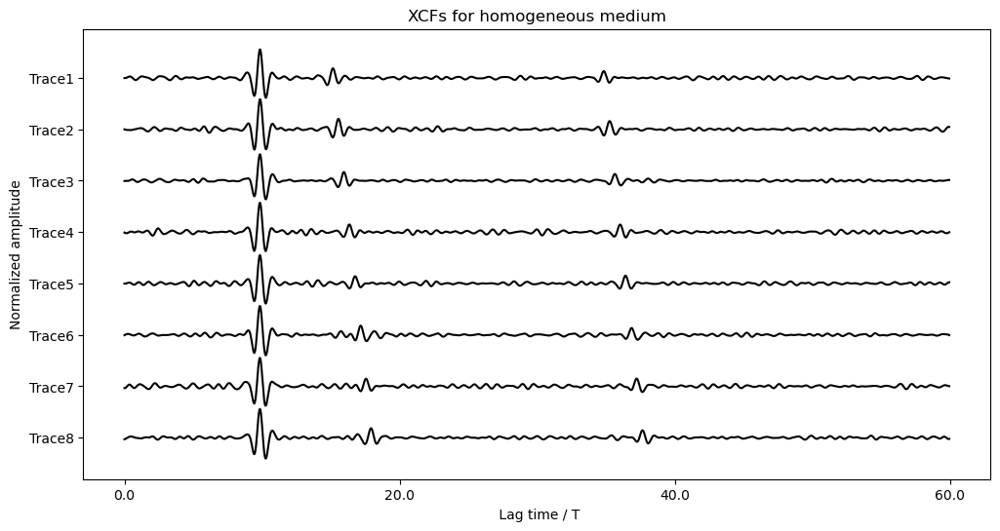

In [42]:
# For figure 11
fig_size = (12, 6)
fontsz = 14
ypos=np.arange(0,int(nt/2+1));yaxis = np.arange(nt/2+1)*0.002*20

f, ax = plt.subplots(1,1, figsize=fig_size)

for iv in range(0,8):
    ax.plot(shift_allAB[iv,0:1500]*5-(iv+1)*2,'k')#'#F97306')

ax.set_xticks(ypos[0:int(nt/2+1):int(nt/6)], labels=yaxis[0:int(nt/2+1):int(nt/6)])
ax.set_yticks([-2,-4,-6,-8,-10,-12,-14,-16], labels=['Trace1','Trace2','Trace3','Trace4','Trace5','Trace6','Trace7','Trace8'])
ax.set_ylabel('Normalized amplitude');ax.set_xlabel(' Lag time / T')
ax.set_title('XCFs for homogeneous medium')

Text(0.5, 1.0, 'XCFs for homogeneous medium')

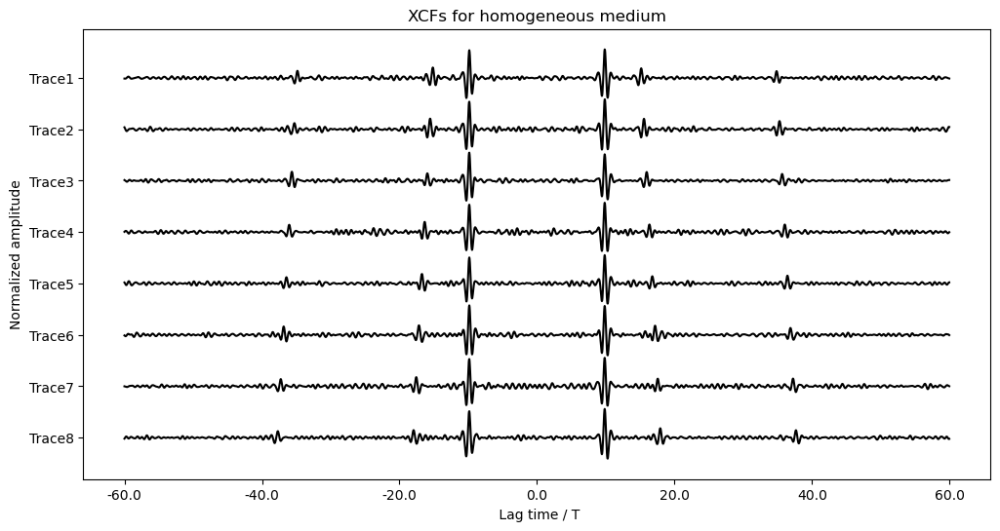

In [40]:
shift_allAB2 = np.zeros((Nshift,nauto))
shift_allAB2[:,0+int(nauto/2):1500+int(nauto/2)] = shift_allAB[:,0:1500]
shift_allAB2[:,0:1500] = shift_allAB[:,0+int(nauto/2):1500+int(nauto/2)]

fig_size = (12, 6)
fontsz = 14
ypos=np.arange(0,int(nt+1));yaxis = np.arange(nt+1)*0.002*20 - 60

f, ax = plt.subplots(1,1, figsize=fig_size)

for iv in range(0,8):
    ax.plot(shift_allAB2[iv,:]*5-(iv+1)*2,'k') #'#F97306')

ax.set_xticks(ypos[0:int(nt+1):int(nt/6)], labels=yaxis[0:int(nt+1):int(nt/6)])
ax.set_yticks([-2,-4,-6,-8,-10,-12,-14,-16], labels=['Trace1','Trace2','Trace3','Trace4','Trace5','Trace6','Trace7','Trace8'])
ax.set_ylabel('Normalized amplitude');ax.set_xlabel(' Lag time / T')
ax.set_title('XCFs for homogeneous medium')
#    ax.set_ylim(-0.8,1.2);ax.set_yticks([-0.5,0,0.5,1]) 
#plt.savefig('./Pic/Data/Timedelay-randomWaveshapeAB'+".png", bbox_inches='tight') 